- set-up of FWI using OBS stations only
- generation of synthetics to inspect adequacy of the input and FS code
- proj1-10: stability checks
- proj11: modified spread_bounce to pass true sea-surface position during backpropagation from airguns
- proj12: adapted the model from Ben
- proj13-16: a single line (S137, line 8)

##### *Notebook setup

###### Modules

In [3]:
%matplotlib inline 
%config IPCompleter.greedy=True 

import numpy as np

from pylab import pcolormesh
import matplotlib.pyplot as plt 
import matplotlib.cm as cm
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import Image # DISPLAYING .PNG FILES 

from scipy.special import i0 # MODIFIED ZERO-ORDER BESSEL FUNCTION OF THE FIRST KIND
from scipy import interpolate # FOR BENCHMARKING
from scipy.interpolate import griddata
from numpy.linalg import norm
import math

from lib_generic import *
from lib_generic_CONST import *
from lib_fwi_project_CLASS import Proj

from lib_math_generic import Normed
from lib_math_interp import Interpolate
from lib_math_num import Check_Stability, Check_Accuracy, Max_Resolution, Propagation_Dists
# from lib_signal_processing import *
from lib_io_su import SU_Supergather_Split_Lines  

from lib_io_fullwave import Read_vtr, Save_vtr, Convert_xyz2vtr
from lib_fwi_data import Picks_Prepare_For_Data
from lib_fwi_model import Model_Check_Highest_Topo, Model_Modify_Fill_Gaps, Model_Modify_Set_Air_Vel, Model_Modify_Add_Checker
from lib_fwi_project import Read_FWI_Project_Meta_Data, Project_Output
from lib_fwi_fs import *

from lib_generic_PLOTT import *
from lib_fwi_generic_PLOTT import * #Plot_SR, Plot_Trace
  
# AUTOMATICALLY RELOAD LIBRARIES BEFORE EXECUTION 
%load_ext autoreload 
%autoreload 2

###### Paths

In [3]:
# Copied from fwi3D-OBS_only (keep synced!)
machine = "kmc"

if machine == "hp":
    user = "kajetan"
elif machine == "kmc":
    user = "kmc3817"
elif machine == "toshiba":
    user = "chkajetan"
else:
    print "Error. Unknown machine"

home = "/home/" + user + "/"
ext_drive = "/media/" + user + "/TOSHIBA EXT/"

data_path = "/media/kmc3817/DATADRIVE1/heavy_PhD/DATA/Santorini_2015/seismic/OBS/segy_local_coords" #"BACKUP_data_PROTEUS_18-06-21/OBS/segy_local_coords/"
phd_local = home + 'heavy_PhD/' #ext_drive + "BACKUP_PhD_local_07-05-2018/"    
    
meta_path = phd_local + "meta_data/"
# stations_names_file_path = data_path
# stations_IDs_file_path = data_path
mod_path = phd_local + "start_mods/"

source_wavelet_path = phd_local + "source_wavelets/"
projects_path = phd_local + "PROJECTS/"
fs_path = projects_path + "topo/"
proteus_path = home + "Dropbox/PhD/team_PROTEUS/" # CAN"T BE ~/Dropbox
picks_path =  phd_local + "picks/OBS/first_arriv/UO/time_corrected/"
figs1_path = phd_local + "figures1_draft/"
figs2_path = phd_local + "figures2_better/"
figs3_path = phd_local + "figures3_best/"

# META DATA
stations_names_file = "stations_file_names.txt"
stations_IDs_file = "stations_IDs.txt"

picks_info_file = "Santorini_Station_Picks.csv"

# DATA ETC.
shot_info_file = "shot_info_16-08-19.csv"
shot_lines_file = "shot_lines_ranges.txt"

source_wavelet_file = "mp_source_3d_7.5Hz_17-10-17.sgy"

old_mod_file = "Model_170710_171413_it5_corr.sgy"
new_mod_file = "Ben_whole_model_24-04-18.sgy"
mod_file = new_mod_file # FIXME: TMP!

fs_file_grd = "santorini_merged_local_50.grd" 

# TEMPLATES
templates_path = home + 'Dropbox/light_PhD/fwi_templates/'
template_runfile = 'template-Runfile.key'

##### *Global parameters

In [4]:
# SPACE-TIME DISCRETIZATION
dx = 50.000 # m
dt = 0.0025 # s
dt_ms = dt * 1000 # ms

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# XY RANGES 
x1_box = -3e4 
x2_box = 3e4 
y1_box = -5e3 
y2_box =  15e3

# ROUNDING DOWN
x1_box, x2_box, y1_box, y2_box = [int(i / dx) * int(dx) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box
# NOTE: z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = (131 - 1) * dx # m # 131 IS NX3 OF THE MODEL FROM UO
ttime = 15 # s # 10 IS NOT ENOUGH TO INCLUDE ALL MANUAL PICKS!

# METRES->NODES CONVERSION
nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

# PLOTTING
minn = 0
maxx = 8000

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -30000 30000 -5000 15000
nx1 1201
nx2 401
nx3_original 131
ns 6000


In [4]:
z_sea = 12.5
nx3 = 113

xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)
zcoord = int(nx3 / 2)

# Proj 1 (regular geometry; Ricker)

- regular geometry of SR (NOT from segy)
- Ricker wavelet

In [3]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj1'
# !cd "{proj_path}" && pwd

## Input

### Basic parameters

In [56]:
# SPACE-TIME DISCRETIZATION
dx = 50.00 # m
dt = 0.001 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# CHOOSE OBSes AT THE EDGES OF THE MODEL
obs_leftmost_box = '143'
obs_rightmost_box = '138'
box_pad = 10 # FIXME: WHY 10?
box_width = 4000 # m

# XY RANGES 
x1_box = obs_list[obs_leftmost_box].x - box_pad * dx
x2_box = obs_list[obs_rightmost_box ].x + box_pad * dx

mean_y_box = (obs_list[obs_leftmost_box].y + obs_list[obs_rightmost_box ].y) / 2.
y1_box = mean_y_box - box_width / 2.
y2_box = mean_y_box + box_width / 2.

# METRES->NODES CONVERSION
x1_box, y1_box = [int(i / dx) * dx for i in [x1_box, y1_box]]
x2_box, y2_box = [int(i / dx) * dx for i in [x2_box, y2_box]] # FIXME: ROUNDING DOWN!!!
x1_box, x2_box, y1_box, y2_box = [int(i) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box

# z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = 130 * dx # m
ttime = 10 # s

nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# VELOCITY MODEL
# vel = 1500 # m/s
# vel_min = 1500
# vel_max = 1500

# SOURCE WAVELET
f_max = 4 # Hz
f_peak = f_max / 2.
f_min = 0.1 # ???????????????? IS IT SET BY FW3D?

# PLOTTING
minn = 0
maxx = 8000
xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

# FIXME: MUST BE THE SAME AS AFTER 'Set_Aux_Variables', NOT AS IN THE RUNFILE
etop = 2
eleft = 5
efront = 5

z_pad = 5 # PADDING ABOVE HIGHEST POINT OF FS

# CHECKS
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

Check_Stability(f, dx, dt, vel, 'low')
# Check_Accuracy(f, dx, vel, f_max, 'low')
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -13600 15100 2100 6100
nx1 575
nx2 81
nx3_original 131
ns 10000
lib_num.py/Check_Stability: Courant number, C: 0.03



### Model

#### Prepare

##### Cut in XY

In [48]:
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00143506 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000116261 s, 27,5 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 575
convert_sgy2vtr.sh: nx2= 81
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj1-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj1-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00255927 s, 1,3 MB/s
n1=131 n2=46575 d1=0.000050
nt=131 ntr=46575 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 1 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj1-TrueVp.bin
n=46575

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 8 s
lib_fwi_generic.py/Save_vtr: File to save:  proj1-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 81 575

con

In [25]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-TrueVp.sgy' | surange

##### Cut in Z

In [49]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = np.zeros(3)
z_topo_min = big # HIGHEST TOPOGR. PEAK MINIMIZES (!) Z BECAUSE VERTICAL AXIS IS FLIPPED
for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] > 0: # FIXME: IT ASSUMES vel=0 ABOVE FS
                break
        z_topo = iz
        if z_topo < z_topo_min:
            z_topo_min = z_topo
            topo_min = np.array([ix, iy, iz])

print 'topo_min (=highest peak coordinates)', topo_min


z_min = z_topo_min - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min #31 # IMPORTANT!!!
print 'nx3 (!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 131
topo_min (=highest peak coordinates) [340   0  23]
z_min 18
nx3 (!= nx3_original) 113
zcut_model.shape (575, 81, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


##### Sea level

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


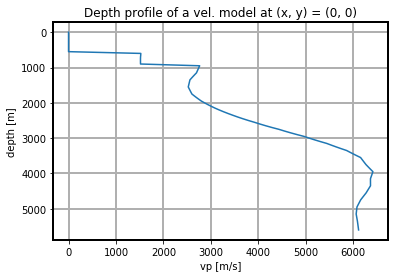

In [50]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, z in enumerate(sea_xy):
    if z != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps

In [51]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in np.arange(nx3_mod-1, -1, -1):
            if (iz + 1) >= fs_z[ix][iy][0]:
                if model[ix][iy][iz] == 0:
                    #print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
                    model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
lib_fwi_generic.py/Save_vtr: File to save:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

###### Plot

In [52]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
plt.xlim(375, 384)
plt.ylim(13, 11)
plt.grid()

NameError: name 'ycoord' is not defined

##### Set air velocity

In [58]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] == 0:
                model[ix][iy][iz] = 8000 # !!!

Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Save_vtr: File to save:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.4062
lib_fwi_generic.py/Read_vtr: max value:  8000.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (113, 575) (113, 575) (113, 575)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-FreeSurf.vtr


libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


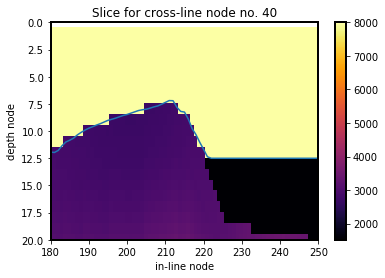

In [62]:
for ycoord in [int(nx2 / 2)]: #range(nx2):
    fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
    
#     plt.figure()
#     Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', zslice=16)
#     plt.plot([288], [41], '.', c='w') # PLOT A SOURCE AS WELL
    # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
    fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
    Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
    plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
    plt.xlim(180, 250)
    plt.ylim(20, 0)
    # plt.gca().set_aspect('equal')
    
    

# xcoord = 290
# plt.figure() # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cmap='nipy_spectral', minn=1400, maxx=7000)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# # plt.xlim(0, 81)
# # plt.ylim(131, 20)
# # plt.gca().set_aspect('equal')
# # plt.colorbar()

### Free surface

#### Prepare

In [46]:
fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
print fname_xyz

!gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

santorini_merged_local_50_-13600_15100_2100_6100.xyz


In [53]:
from lib_fwi_generic import Convert_xyz2vtr 

fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

Convert_xyz2vtr(fname, dx, z_origin=z_sea+0.5, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

lib_fwi_generic.py/Read_xyz: START
xmin, xmax -13600.0 15100.0
ymin, ymax 2100.0 6100.0
xdiff 28700.0
ydiff 4000.0
nx, ny 575 81
[-13600. -13550. -13500. -13450. -13400.]
[2100. 2100. 2100. 2100. 2100.]
[-368.08920288 -366.58273315 -365.13400269 -363.18637085 -361.83468628]
lib_fwi_generic.py/Read_xyz: END
lib_fwi_generic.py/Save_vtr: File to save:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/topo//santorini_merged_local_50_-13600_15100_2100_6100-FreeSurf.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  1 81 575


In [54]:
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(proj_path + proj_name + '-FreeSurf.vtr')


fs_z_min = np.min(fs_z)
fs_z_max = np.max(fs_z)

print 'fs_z_min', fs_z_min
print 'fs_z_max', fs_z_max

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
fs_z_min 5.6051607
fs_z_max 12.5


#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


0

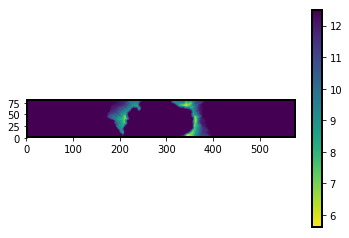

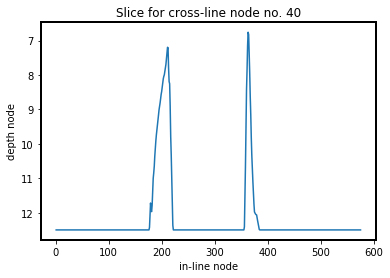

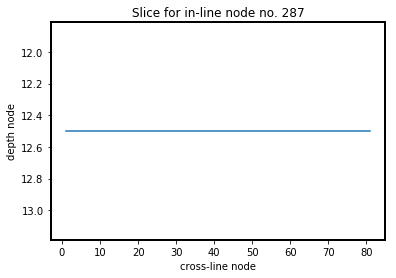

In [55]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### Source wavelet

In [248]:
!cd "{proj_path}" && su_ricker.sh {proj_name} {f_peak} {dt} {ns}
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000214271 s, 14.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00363388 s, 881 kB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 543 requests (543 known processed) with 0 events remaining.


### Observed data

* one component $>0.5$ Gb 
* we want to be highly flexible in the choice of input data (only certain fragments of certain profiles, e.g. only picked data)
* SegyPrep accepts only either a single file or a list of files
* two above bullet points imply that we HAVE TO chop station-files into smaller chunks 

#### Overview

In [63]:
!cd "{proj_path}"data/ && ls -lthr

total 52K
drwxrwxrwx 1 kajetan kajetan  44K Sep 27 22:55 stations_lines
drwxrwxrwx 1 kajetan kajetan 4,0K Oct 23 10:36 stations_full
drwxrwxrwx 1 kajetan kajetan 4,0K Oct 23 10:39 station_lines_filtered


In [66]:
!cd "{proj_path}"data/stations_full && ls -lthr

total 5,2G
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:40 MGL1521_S137_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:41 MGL1521_W138_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:41 MGL1521_W139_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:42 MGL1521_W140_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:42 MGL1521_S141_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:42 MGL1521_S142_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:43 MGL1521_S143_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:43 MGL1521_S160_4.segy


In [68]:
!cd "{proj_path}"data/stations_lines && ls -lthr *segy

-rwxrwxrwx 1 kajetan kajetan  14M Jul 25 19:43 MGL1521_S141_4_line19.segy
-rwxrwxrwx 1 kajetan kajetan  15M Jul 25 19:43 MGL1521_W138_4_line8.segy
-rwxrwxrwx 1 kajetan kajetan  14M Jul 25 19:43 MGL1521_W138_4_line19.segy
-rwxrwxrwx 1 kajetan kajetan  16M Jul 25 19:43 MGL1521_W138_4_line25.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25 19:43 MGL1521_W138_4_line26.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25 19:43 MGL1521_W138_4_line27.segy
-rwxrwxrwx 1 kajetan kajetan 1,4M Jul 25 19:43 MGL1521_W138_4_line28.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25 19:43 MGL1521_W138_4_line29.segy
-rwxrwxrwx 1 kajetan kajetan 7,5M Jul 25 19:43 MGL1521_W138_4_line35.segy
-rwxrwxrwx 1 kajetan kajetan 8,7M Jul 25 19:43 MGL1521_W138_4_line41.segy
-rwxrwxrwx 1 kajetan kajetan  15M Jul 25 19:43 MGL1521_W139_4_line8.segy
-rwxrwxrwx 1 kajetan kajetan  14M Jul 25 19:43 MGL1521_W139_4_line19.segy
-rwxrwxrwx 1 kajetan kajetan  16M Jul 25 19:43 MGL1521_W139_4_line25.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25

### SegyPrep

In [25]:
print proj_name

segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, fs_z_max=fs_z_max, nx1=nx1, nx2=nx2, nx3=nx3, dx=dx, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj1

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj1
 Preparing files for synthetics...

 Grid points in-line:                    575
 Grid points cross-line:                  81
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            28700.0000    
 Model width (metres):             4000.00000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         1.00000000    
 Output data delta-T (ms):         1.00000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):         10000
 Time steps to model:                  10000

 Receiver-array fixed in space:          yes
 Use composite shots:                     no

 Original sources in model:                1
 Original receivers i

#### Output

In [115]:
# !cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | surange
!cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157118 s, 2.0 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 2115 requests (2115 known processed) with 0 events remaining.


### Sources & receivers

In [4]:
nx1_sr, nx2_sr, nx3_sr, Ss, Rs = Read_SR(proj_name, adjust=False, proj_path=proj_path)

Plot_Points(Ss, plot_type='proj')
plt.figure()
Plot_Points(Rs, plot_type='proj')

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

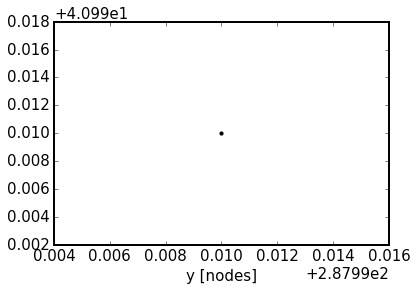

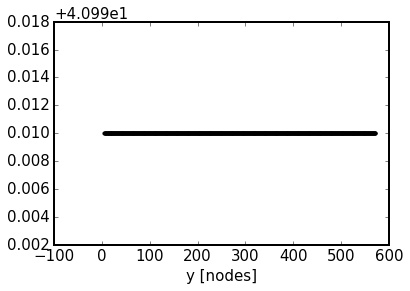

In [27]:

# plt.gca().invert_zaxis()

In [234]:
!cd "{proj_path}" && cat {proj_name}-PointSources.pgy

           1         113          81         575
           1   17.0000000       41.0000000       288.000000    


In [228]:
Check_SR(proj_name, adjust=False, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-PointReceivers.pgy
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [104.239998, 44.3400002, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 2 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [100.940002, 44.7400017, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [97.6600037, 44.7000008, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [94.3600006, 44.7200012, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 5 above FS + margin 4.
lib_fwi_ge

NameError: global name 'quit' is not defined

### Runfile

In [33]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]
Update_Runfile(fname, NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 567
MAXRC : 567
 MAXPS         : 1
 io            : fw3d 
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING

### PBS file

In [5]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="00:01:00", nnodes=1)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# A variable: 'project_name' is meant to be passed as a script argument:
#  $> qsub -v project_name=<project_name> this_script.pbs
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj1
#PBS -o proj1-Out.log
#PBS -e proj1-Err.log
#PBS -l walltime=00:01:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=1gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIE

## Run

### Locally

- one'd better run it in console - not to freeze the whole notebook

In [5]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
!cd "{proj_path}" && fwi_run_locally.sh synth '688_test' {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

^C


### cx1

In [18]:
dir_name = Path_Leave(proj_path[ :-len('/input/')])
!cd "{proj_path}" &&  ssh_sync_project.sh kmc cx1 {dir_name}

sending incremental file list
./
binary
            400 100%    0.00kB/s    0:00:00 (xfr#1, to-chk=457/459)
fname_segy
         23,840 100%    1.42MB/s    0:00:00 (xfr#2, to-chk=456/459)
fort.11
        180,000 100%    3.18MB/s    0:00:00 (xfr#3, to-chk=455/459)
gmt.history
             85 100%    1.54kB/s    0:00:00 (xfr#4, to-chk=454/459)
header
          3,200 100%   57.87kB/s    0:00:00 (xfr#5, to-chk=453/459)
jupy_fwi_3D_OBS_only.ipynb
        990,533 100%    9.84MB/s    0:00:00 (xfr#6, to-chk=452/459)
jupy_fwi_3D_OBS_only.ipynb_bckp
        988,461 100%    7.20MB/s    0:00:00 (xfr#7, to-chk=451/459)
proj1-Err.log
         14,810 100%  102.57kB/s    0:00:00 (xfr#8, to-chk=450/459)
proj1-FreeSurf.vtr
        558,940 100%    3.55MB/s    0:00:00 (xfr#9, to-chk=449/459)
proj1-FreeSurf_exten.vtr
        638,860 100%    3.63MB/s    0:00:00 (xfr#10, to-chk=448/459)
proj1-GhostData.bin
    274,747,664 100%   74.59MB/s    0:00:03 (xfr#11, to-chk=447/459)
proj1-NumChecks.log
             52

     12,765,715 100%    9.30MB/s    0:00:01 (xfr#85, to-chk=368/459)
data/stations_lines/MGL1521_S141_4_line29.segy
     16,887,600 100%   10.72MB/s    0:00:01 (xfr#86, to-chk=367/459)
data/stations_lines/MGL1521_S141_4_line35.png
         28,876 100%   54.97kB/s    0:00:00 (xfr#87, to-chk=366/459)
data/stations_lines/MGL1521_S141_4_line35.ps
      5,910,936 100%    8.23MB/s    0:00:00 (xfr#88, to-chk=365/459)
data/stations_lines/MGL1521_S141_4_line35.segy
      7,818,480 100%    6.23MB/s    0:00:01 (xfr#89, to-chk=364/459)
data/stations_lines/MGL1521_S141_4_line41.png
        106,309 100%  482.87kB/s    0:00:00 (xfr#90, to-chk=363/459)
data/stations_lines/MGL1521_S141_4_line41.ps
      6,907,527 100%    7.12MB/s    0:00:00 (xfr#91, to-chk=362/459)
data/stations_lines/MGL1521_S141_4_line41.segy
      9,120,960 100%    5.66MB/s    0:00:01 (xfr#92, to-chk=361/459)
data/stations_lines/MGL1521_S141_4_line8.png
         44,695 100%   80.09kB/s    0:00:00 (xfr#93, to-chk=360/459)
data/statio

     13,057,408 100%    9.94MB/s    0:00:01 (xfr#157, to-chk=296/459)
data/stations_lines/MGL1521_S160_4_line26.segy
     17,273,520 100%   10.15MB/s    0:00:01 (xfr#158, to-chk=295/459)
data/stations_lines/MGL1521_S160_4_line27.png
         94,867 100%  145.44kB/s    0:00:00 (xfr#159, to-chk=294/459)
data/stations_lines/MGL1521_S160_4_line27.ps
     13,252,043 100%    8.48MB/s    0:00:01 (xfr#160, to-chk=293/459)
data/stations_lines/MGL1521_S160_4_line27.segy
     17,514,720 100%    8.70MB/s    0:00:01 (xfr#161, to-chk=292/459)
data/stations_lines/MGL1521_S160_4_line28.png
         11,689 100%   12.26kB/s    0:00:00 (xfr#162, to-chk=291/459)
data/stations_lines/MGL1521_S160_4_line28.ps
      1,073,934 100%    1.04MB/s    0:00:00 (xfr#163, to-chk=290/459)
data/stations_lines/MGL1521_S160_4_line28.segy
      1,402,560 100%    1.22MB/s    0:00:01 (xfr#164, to-chk=289/459)
data/stations_lines/MGL1521_S160_4_line29.png
         98,901 100%  894.29kB/s    0:00:00 (xfr#165, to-chk=288/459)
d

      6,907,562 100%    5.07MB/s    0:00:01 (xfr#229, to-chk=224/459)
data/stations_lines/MGL1521_W139_4_line41.segy
      9,120,960 100%    7.70MB/s    0:00:01 (xfr#230, to-chk=223/459)
data/stations_lines/MGL1521_W139_4_line8.png
         49,868 100%  333.56kB/s    0:00:00 (xfr#231, to-chk=222/459)
data/stations_lines/MGL1521_W139_4_line8.ps
     11,428,752 100%   21.16MB/s    0:00:00 (xfr#232, to-chk=221/459)
data/stations_lines/MGL1521_W139_4_line8.segy
     15,102,720 100%    7.56MB/s    0:00:01 (xfr#233, to-chk=220/459)
data/stations_lines/MGL1521_W140_4_line19.png
         97,886 100%  104.02kB/s    0:00:00 (xfr#234, to-chk=219/459)
data/stations_lines/MGL1521_W140_4_line19.ps
     10,504,968 100%    5.58MB/s    0:00:01 (xfr#235, to-chk=218/459)
data/stations_lines/MGL1521_W140_4_line19.segy
     13,896,720 100%    6.42MB/s    0:00:02 (xfr#236, to-chk=217/459)
data/stations_lines/MGL1521_W140_4_line25.png
         81,473 100%  864.82kB/s    0:00:00 (xfr#237, to-chk=216/459)
data

     12,182,623 100%   10.83MB/s    0:00:01 (xfr#295, to-chk=157/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line25_bfilt.segy
     16,115,760 100%   17.52MB/s    0:00:00 (xfr#296, to-chk=156/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line26_bfilt.png
        163,741 100%  178.66kB/s    0:00:00 (xfr#297, to-chk=155/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line26_bfilt.ps
     13,057,546 100%    5.99MB/s    0:00:02 (xfr#298, to-chk=154/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line26_bfilt.segy
     17,273,520 100%   16.95MB/s    0:00:00 (xfr#299, to-chk=153/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line27_bfilt.png
        162,864 100%  160.65kB/s    0:00:00 (xfr#300, to-chk=152/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line27_bfilt.ps
     13,252,186 100%    5.73MB/s    0:00:02 (xfr#301, to-chk=151/459)
data/stations_lines_filtered/proj2-MGL1521_S142_4_line27_bfilt.segy
     17,514,720 100%   16.00MB/s    0:00

     13,252,003 100%    7.11MB/s    0:00:01 (xfr#355, to-chk=97/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line27_bfilt.segy
     17,514,720 100%   10.14MB/s    0:00:01 (xfr#356, to-chk=96/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line28_bfilt.png
         11,991 100%   17.64kB/s    0:00:00 (xfr#357, to-chk=95/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line28_bfilt.ps
      1,074,082 100%    1.45MB/s    0:00:00 (xfr#358, to-chk=94/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line28_bfilt.segy
      1,402,560 100%    1.69MB/s    0:00:00 (xfr#359, to-chk=93/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line29_bfilt.png
        124,862 100%  149.98kB/s    0:00:00 (xfr#360, to-chk=92/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line29_bfilt.ps
     12,765,677 100%    6.55MB/s    0:00:01 (xfr#361, to-chk=91/459)
data/stations_lines_filtered/proj2-MGL1521_S160_4_line29_bfilt.segy
     16,887,600 100%    9.31MB/s    0:00:01 (xf

## Output

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-FreeSurf_exten.vtr
lib_fwi_generic.py/Read_vtr: min value:  7.60516
lib_fwi_generic.py/Read_vtr: max value:  14.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 1
(585, 91)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj1-Observed-Time.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.45737
lib_fwi_generic.py/Read_vtr: max value:  6.55905
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  567 1 10000
libplot_generic.py/Plot_Slice:  (10000, 567) (10000, 567) (10000, 567)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj1-fw-001000-csref00001-iter00001-taskid00001.vtr
lib_fwi_generic.py/Read_vtr: min value:  -503.379
lib_fwi_generic.py/Read_vtr: max value:  419.216
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:

0

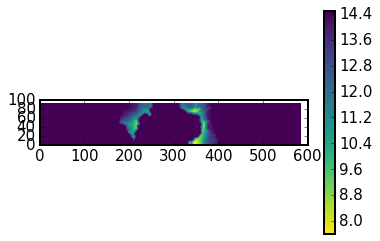

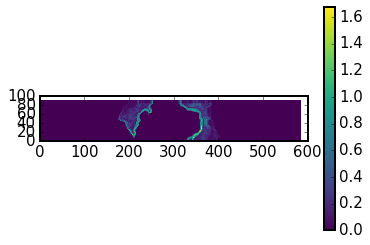

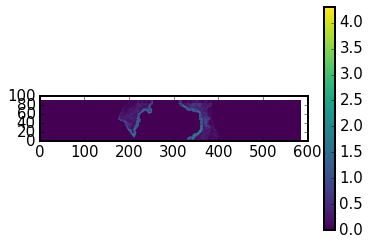

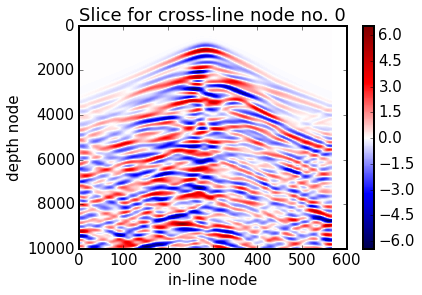

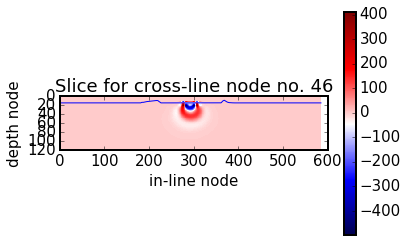

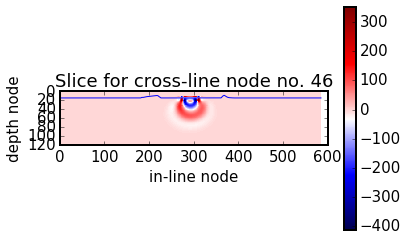

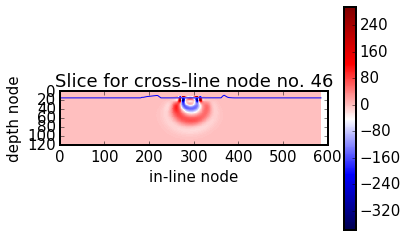

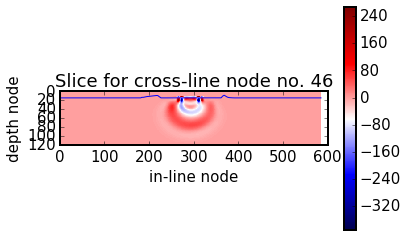

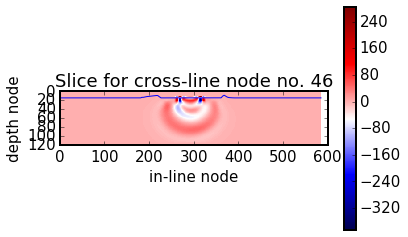

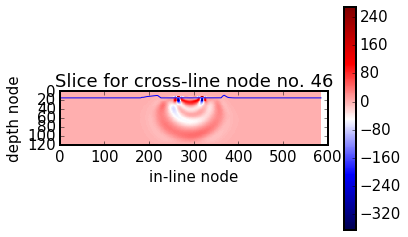

In [4]:
ycoord = 46
# !cd "{proj_path}" && convert_ttr2vtr {proj_name}
Plot_Project_Output(proj_name, proj_path=proj_path, yslice=ycoord, file_min=10, file_max=15, azim=0, elev=0)

# Proj 2 (segy geometry; MP wavelet; 1 line; dt=5ms => unstable)

UNSTABLE?
- geometry from segy
- real wavelet (from MP so that filtering is precisely known) with additional low (swell noise) and high-pass (1st iteration block) filter applied to match the data pre-processing
- no filtering (ridiculously high cut-off) within fullwave => only 1 block of iterations
- only 1 shot line and 1 OBS
- dt_ms set to 5 ms i.e. as in data files

UNSTABLE?

## Input

In [269]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj2'
# !cd "{proj_path}" && pwd

### Basic parameters

In [137]:
# SPACE-TIME DISCRETIZATION
dx = 50.00 # m
dt = 0.005 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# CHOOSE OBSes AT THE EDGES OF THE MODEL
obs_leftmost_box = '143'
obs_rightmost_box = '138'
box_pad = 10 # FIXME: WHY 10?
box_width = 4000 # m

# XY RANGES 
x1_box = obs_list[obs_leftmost_box].x - box_pad * dx
x2_box = obs_list[obs_rightmost_box ].x + box_pad * dx

mean_y_box = (obs_list[obs_leftmost_box].y + obs_list[obs_rightmost_box ].y) / 2.
y1_box = mean_y_box - box_width / 2.
y2_box = mean_y_box + box_width / 2.

# METRES->NODES CONVERSION
x1_box, y1_box = [int(i / dx) * dx for i in [x1_box, y1_box]]
x2_box, y2_box = [int(i / dx) * dx for i in [x2_box, y2_box]] # FIXME: ROUNDING DOWN!!!
x1_box, x2_box, y1_box, y2_box = [int(i) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box

# z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = 130 * dx # m
ttime = 10 # s

nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# VELOCITY MODEL
# vel = 1500 # m/s
# vel_min = 1500
# vel_max = 1500

# SOURCE WAVELET
f_max = 4 # Hz
f_peak = f_max / 2.
f_min = 0.1 # ???????????????? IS IT SET BY FW3D?

# PLOTTING
minn = 0
maxx = 8000

# FIXME: MUST BE THE SAME AS AFTER 'Set_Aux_Variables', NOT AS IN THE RUNFILE
etop = 2
eleft = 5
efront = 5

z_pad = 5 # PADDING ABOVE HIGHEST POINT OF FS

# CHECKS
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

Check_Stability(f, dx, dt, vel, 'low')
# Check_Accuracy(f, dx, vel, f_max, 'low')
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -13600 15100 2100 6100
nx1 575
nx2 81
nx3_original 131
ns 2000
lib_num.py/Check_Stability: Courant number, C: 0.15



### Model

#### Prepare

##### Cut in XY

In [15]:
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00399976 s, 800 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5236e-05 s, 49.1 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 575
convert_sgy2vtr.sh: nx2= 81
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj1-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj1-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00346859 s, 923 kB/s
n1=131 n2=46575 d1=0.000050
nt=131 ntr=46575 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 1 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj1-TrueVp.bin
n=46575

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 3 s
lib_fwi_generic.py/Save_vtr: File to save:  proj1-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 81 575

conv

In [25]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-TrueVp.sgy' | surange

##### Cut in Z

In [16]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = np.zeros(3)
z_topo_min = big # HIGHEST TOPOGR. PEAK MINIMIZES (!) Z BECAUSE VERTICAL AXIS IS FLIPPED
for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] > 0: # FIXME: IT ASSUMES vel=0 ABOVE FS
                break
        z_topo = iz
        if z_topo < z_topo_min:
            z_topo_min = z_topo
            topo_min = np.array([ix, iy, iz])

print 'topo_min (=highest peak coordinates)', topo_min


z_min = z_topo_min - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min #31 # IMPORTANT!!!
print 'nx3 (!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 131
topo_min (=highest peak coordinates) [340   0  23]
z_min 18
nx3 (!= nx3_original) 113
zcut_model.shape (575, 81, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/proj1-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


##### Sea level

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


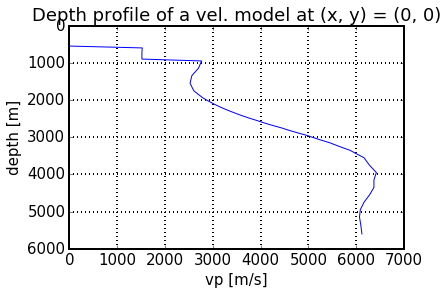

In [17]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, z in enumerate(sea_xy):
    if z != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps

In [18]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in np.arange(nx3_mod-1, -1, -1):
            if (iz + 1) >= fs_z[ix][iy][0]:
                if model[ix][iy][iz] == 0:
                    #print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
                    model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
173 46 12 11.8866
175 52 12 11.8869
179 48 11 10.9472
180 49 11 10.9779
182 61 12 11.9821
183 50 11 10.9014
185 45 10 9.92188
185 64 12 11.97
185 65 12 11.9936
186 46 10 9.91864
186 51 11 10.8999
189 54 11 10.946
189 66 12 11.9937
191 46 10 9.94771
191 47 10 9.95338
191 66 12 11.9653
192 24 12 11.9393
192 47 10 9.99989
192 67 12 11.994
193 27 11 10.892
193 54 11 10.9235
193 68 12 11.9851
194 23 11 10.8158
194 56 11 10.9375
19

0

###### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (113, 575) (113, 575) (113, 575)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-FreeSurf.vtr


libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


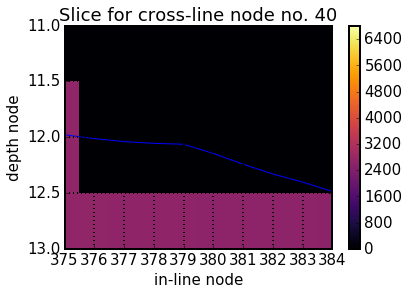

In [19]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
plt.xlim(375, 384)
plt.ylim(13, 11)
plt.grid()

##### Set air velocity

In [20]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] == 0:
                model[ix][iy][iz] = 8000 # !!!

Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only//proj1-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/proj1-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

#### Plot

In [6]:
for ycoord in [int(nx2 / 2)]: #range(nx2):
    fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
    
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', zslice=16)
    plt.plot([288], [41], '.', c='w') # PLOT A SOURCE AS WELL
    # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
    fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
    Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
    plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
    # plt.xlim(0, 20)
    # plt.ylim(14, 12)
    # plt.gca().set_aspect('equal')
    
    

# xcoord = 290
# plt.figure() # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cmap='nipy_spectral', minn=1400, maxx=7000)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# # plt.xlim(0, 81)
# # plt.ylim(131, 20)
# # plt.gca().set_aspect('equal')
# # plt.colorbar()

NameError: name 'nx2' is not defined

### Free surface

In [60]:
!cd "{proj_path}" && cp proj1'-FreeSurf.vtr' {proj_name}'-FreeSurf.vtr'

#### Prepare

In [58]:
fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
print fname_xyz

# !gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

santorini_merged_local_50_-13600_15100_2100_6100.xyz


In [59]:
from lib_fwi_generic import Convert_xyz2vtr 

fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

Convert_xyz2vtr(fname, dx, z_origin=z_sea+0.5, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(proj_path + proj_name + '-FreeSurf.vtr')


fs_z_min = np.min(fs_z)
fs_z_max = np.max(fs_z)

print 'fs_z_min', fs_z_min
print 'fs_z_max', fs_z_max

lib_fwi_generic.py/Read_xyz: START


ValueError: need more than 0 values to unpack

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


0

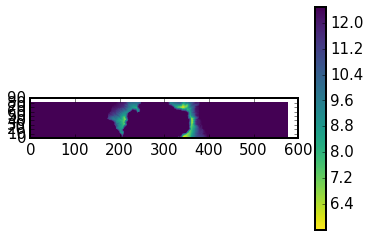

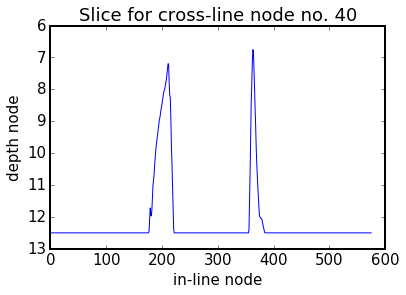

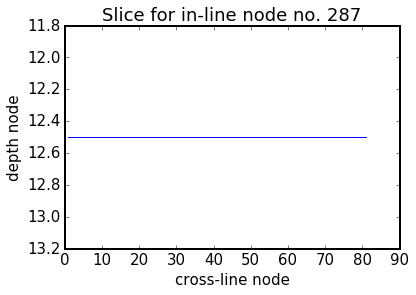

In [61]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### True Model

#### Prepare

##### Cut in XY

In [51]:
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0043685 s, 733 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000163262 s, 19.6 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 575
convert_sgy2vtr.sh: nx2= 81
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj2-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj2-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338028 s, 947 kB/s
n1=131 n2=46575 d1=0.000050
nt=131 ntr=46575 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 0 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj2-TrueVp.bin
n=46575

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 4 s
lib_fwi_generic.py/Save_vtr: File to save:  proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 81 575

conv

In [25]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-TrueVp.sgy' | surange

##### Cut in Z

In [52]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = np.zeros(3)
z_topo_min = big # HIGHEST TOPOGR. PEAK MINIMIZES (!) Z BECAUSE VERTICAL AXIS IS FLIPPED
for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] > 0: # FIXME: IT ASSUMES vel=0 ABOVE FS
                break
        z_topo = iz
        if z_topo < z_topo_min:
            z_topo_min = z_topo
            topo_min = np.array([ix, iy, iz])

print 'topo_min (=highest peak coordinates)', topo_min


z_min = z_topo_min - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min #31 # IMPORTANT!!!
print 'nx3 (!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 131
topo_min (=highest peak coordinates) [340   0  23]
z_min 18
nx3 (!= nx3_original) 113
zcut_model.shape (575, 81, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


##### Sea level

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


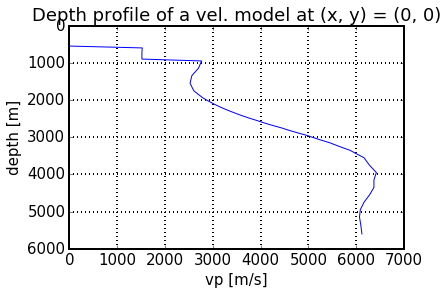

In [53]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, z in enumerate(sea_xy):
    if z != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps

In [54]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in np.arange(nx3_mod-1, -1, -1):
            if (iz + 1) >= fs_z[ix][iy][0]:
                if model[ix][iy][iz] == 0:
                    print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
                    model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  24.1052
lib_fwi_generic.py/Read_vtr: max value:  31.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

###### Plot

lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (114, 576) (114, 576) (113, 575)


liplot_generic/shift_colormap: WARNING! UNKOWN COLORMAP: inferno PROCEEDING WITHOUT SHIFT


lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


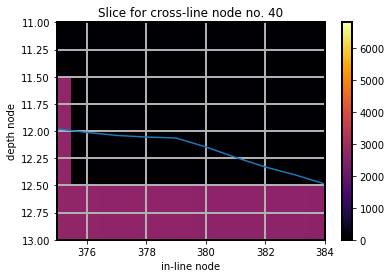

In [74]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
plt.xlim(375, 384)
plt.ylim(13, 11)
plt.grid()

##### Set air velocity

In [55]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] == 0:
                model[ix][iy][iz] = 8000 # !!!

Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  8000.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3: 

libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


 575 81 113
libplot_generic.py/Plot_Slice:  (113, 575) (113, 575) (113, 575)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


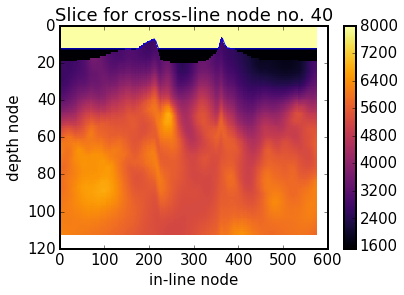

In [62]:
for ycoord in [int(nx2 / 2)]: #range(nx2):
    fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

    # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
    fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
    Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
    plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
    # plt.xlim(0, 20)
    # plt.ylim(14, 12)
    # plt.gca().set_aspect('equal')

# xcoord = 290
# plt.figure() # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cmap='nipy_spectral', minn=1400, maxx=7000)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# # plt.xlim(0, 81)
# # plt.ylim(131, 20)
# # plt.gca().set_aspect('equal')
# # plt.colorbar()

### Source wavelet

#### Prepare

In [73]:
!cd "{source_wavelet_path}" && ls -lthr

total 93K
-rwxrwxrwx 1 kajetan kajetan  24K Oct 17  2017 mp_source_3d_7.5Hz_17-10-17.sgy
-rwxrwxrwx 1 kajetan kajetan  24K Oct 17  2017 mp_source_3d_17-10-17.sgy
-rwxrwxrwx 1 kajetan kajetan  24K Feb 21  2018 mp_source_3d_2.2-6.5Hz_18-02-21.sgy
-rwxrwxrwx 1 kajetan kajetan  13K Apr 24 20:11 bh_source_3d_18-04-24.sgy
-rwxrwxrwx 1 kajetan kajetan  400 Oct 21 19:04 binary
-rwxrwxrwx 1 kajetan kajetan 3,2K Oct 21 19:04 header


In [130]:
!cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00237526 s, 1.3 MB/s
1 traces:
tracl    1
tracr    1
fldr     24208
tracf    123
ep       1
cdpt     1
trid     1
nhs      33
gelev    -268
selev    -12
sdepth   12
swdep    276
gwdep    268
scalel   1
scalco   1
sx       23216
sy       7044
gx       24030
gy       7042
counit   1
tstat    110
muts     2500
mute     2500
ns       5000
dt       3000
year     2015
day      334
hour     4
minute   6
sec      23
timbas   194

Shot coordinate limits:
	North(23216,7044) South(23216,7044) East(23216,7044) West(23216,7044)

Receiver coordinate limits:
	North(24030,7042) South(24030,7042) East(24030,7042) West(24030,7042)

Midpoint coordinate limits:
	North(23623,7043) South(23623,7043) East(23623,7043) West(23623,7043)


In [131]:
!cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153534 s, 2.1 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 134 requests (134 known processed) with 0 events remaining.


In [17]:
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

In [270]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00484498 s, 660 kB/s
1 traces:
tracl    1
tracr    1
fldr     24208
tracf    123
ep       1
cdpt     1
trid     1
nhs      33
gelev    -268
selev    -12
sdepth   12
swdep    276
gwdep    268
scalel   1
scalco   1
sx       23216
sy       7044
gx       24030
gy       7042
counit   1
tstat    110
muts     2500
mute     2500
ns       5000
dt       3000
year     2015
day      334
hour     4
minute   6
sec      23
timbas   194

Shot coordinate limits:
	North(23216,7044) South(23216,7044) East(23216,7044) West(23216,7044)

Receiver coordinate limits:
	North(24030,7042) South(24030,7042) East(24030,7042) West(24030,7042)

Midpoint coordinate limits:
	North(23623,7043) South(23623,7043) East(23623,7043) West(23623,7043)


In [271]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00185016 s, 1.7 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 457 requests (457 known processed) with 0 events remaining.


##### Filtering (additional high-pass to match the data pre-processing)

- get rid of the swell noise
- first block of iterations: max 3 Hz 

In [40]:
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

fname = proj_name + '-RawSign.sgy'
!cd "{proj_path}" && cp {fname} {fname}_raw

fname = proj_name + '-RawSign.sgy'
fname_segy = fname
!cd "{proj_path}" && sgyread.sh {fname} | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 |  subfilt locut=0 hicut=1 npoleshi=10 f3dbhi=3 | segyhdrs | segywrite tape={fname_segy}

# FIRST BLOCK OF ITERATIONS: MAX 3 Hz
# !cd "{proj_path}" && sgyread.sh {fname} |  subfilt zerophase=0 passhi=3 stophi=3.5 | segyhdrs | segywrite tape={fname_segy}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125403 s, 2.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4364e-05 s, 58.9 MB/s


In [250]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0025179 s, 1.3 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 142 requests (142 known processed) with 0 events remaining.


#### Plot

In [ ]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange

### Observed data

* one component $>0.5$ Gb 
* we want to be highly flexible in the choice of input data (only certain fragments of certain profiles, e.g. only picked data)
* SegyPrep accepts only either a single file or a list of files
* two above bullet points imply that we HAVE TO chop station-files into smaller chunks 

In [90]:
fname =  proj_name + '-RawSeis.txt'
!cd "{proj_path}" && ls data/stations_lines/*140*19*segy > {fname}
!cd "{proj_path}" && cat {fname}

data/stations_lines/MGL1521_W140_4_line19.segy


In [134]:
!cd "{proj_path}" && sgyread.sh data/stations_lines/MGL1521_W140_4_line19.segy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00164921 s, 1.9 MB/s
288 traces:
tracl    1656 1943 (1656 - 1943)
tracr    1 288 (1 - 288)
fldr     13215 13502 (13215 - 13502)
tracf    4140
ep       19
cdpt     1
trid     1
offset   8469 55751 (8469 - 55751)
gelev    -383
selev    -12
sdepth   12
swdep    180 956 (180 - 956)
gwdep    383
scalel   1
scalco   1
sx       -55723 -8438 (-8438 - -55723)
sy       4152 4290 (4267 - 4220)
gx       27
gy       4054
counit   1
tstat    17
delrt    1 5 (2 - 5)
ns       12000
dt       5000
year     2015
day      329
hour     2 10 (2 - 10)
minute   0 59 (56 - 12)
sec      0 59 (39 - 28)
timbas   1 996 (886 - 396)
f2       0.005000

Shot coordinate limits:
	North(-9096,4290) South(-37272,4152) East(-8438,4267) West(-55723,4220)

Receiver coordinate limits:
	North(27,4054) South(27,4054) East(27,4054) West(27,4054)

Midpoint coordinate limits:
	North(-4534.5,4172) South(-18622.5,4103) East(-4205.5,4160.5) West(-27848,4137)


#### Overview

In [63]:
!cd "{proj_path}"data/ && ls -lthr

total 52K
drwxrwxrwx 1 kajetan kajetan  44K Sep 27 22:55 stations_lines
drwxrwxrwx 1 kajetan kajetan 4,0K Oct 23 10:36 stations_full
drwxrwxrwx 1 kajetan kajetan 4,0K Oct 23 10:39 station_lines_filtered


In [66]:
!cd "{proj_path}"data/stations_full && ls -lthr

total 5,2G
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:40 MGL1521_S137_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:41 MGL1521_W138_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:41 MGL1521_W139_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:42 MGL1521_W140_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:42 MGL1521_S141_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:42 MGL1521_S142_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:43 MGL1521_S143_4.segy
-rwxrwxrwx 1 kajetan kajetan 655M Jul 25 19:43 MGL1521_S160_4.segy


In [68]:
!cd "{proj_path}"data/stations_lines && ls -lthr *segy

-rwxrwxrwx 1 kajetan kajetan  14M Jul 25 19:43 MGL1521_S141_4_line19.segy
-rwxrwxrwx 1 kajetan kajetan  15M Jul 25 19:43 MGL1521_W138_4_line8.segy
-rwxrwxrwx 1 kajetan kajetan  14M Jul 25 19:43 MGL1521_W138_4_line19.segy
-rwxrwxrwx 1 kajetan kajetan  16M Jul 25 19:43 MGL1521_W138_4_line25.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25 19:43 MGL1521_W138_4_line26.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25 19:43 MGL1521_W138_4_line27.segy
-rwxrwxrwx 1 kajetan kajetan 1,4M Jul 25 19:43 MGL1521_W138_4_line28.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25 19:43 MGL1521_W138_4_line29.segy
-rwxrwxrwx 1 kajetan kajetan 7,5M Jul 25 19:43 MGL1521_W138_4_line35.segy
-rwxrwxrwx 1 kajetan kajetan 8,7M Jul 25 19:43 MGL1521_W138_4_line41.segy
-rwxrwxrwx 1 kajetan kajetan  15M Jul 25 19:43 MGL1521_W139_4_line8.segy
-rwxrwxrwx 1 kajetan kajetan  14M Jul 25 19:43 MGL1521_W139_4_line19.segy
-rwxrwxrwx 1 kajetan kajetan  16M Jul 25 19:43 MGL1521_W139_4_line25.segy
-rwxrwxrwx 1 kajetan kajetan  17M Jul 25

#### Filtering

To match processing of the wavelet, sequence of three filters:
1. High-cut (low-pass) Butterworth filter:
    * 4 poles, cutoff frequency (3db point) 20 Hz; or equivalently:
    * not provided by MP
2. High-cut (low-pass) Butterworth filter:
    * 15 poles, cutoff frequency (3db point) 6.4866 Hz; or equivalently:
    * passhi 6 Hz, stophi 8 Hz
3. Low-cut (high-pass) Butterworth filter:
    * 9 poles, cutoff frequency (3db point) 2.1769 Hz; or equivalently:
    * stoplo 1.5 Hz, passlo 2.5 Hz
    
I am not sure why the filter no. 1 is necessary.

Remember that unless we turn off hi/locut=0, the subfilt will be a bandpass!

In [35]:
fnames = Get_Files(proj_path + 'data/stations_lines', 'MGL*segy')
path = proj_path + "/data/stations_lines/"
for fname in fnames:
    fname = Path_Leave(fname)
    fname_segy = "../stations_lines_filtered/" + proj_name + '-' + fname[ :-len('.segy')] + '_bfilt.segy'
    fname_ps = fname_segy[ :-len('.segy')] + '.ps'
    fname_png = fname_ps[ :-len('.ps')] + '.png'
    
    !cd "{path}" && sgyread.sh {fname} | subfilt locut=0 hicut=1 npoleshi=4 f3dbhi=20 | subfilt locut=0 hicut=1 npoleshi=15 f3dbhi=6.4866 | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 | segyhdrs | segywrite tape={fname_segy}
    !cd "{path}" && sgyread.sh {fname_segy} | supsimage legend=1 perc=99 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {fname_ps}
    !cd "{path}" && convert {fname_ps} {fname_png}
    
    # SPECTRUM
#     fname_ps = fname_segy[ :-len('.segy')] + '_spec.ps'
#     fname_png = fname_ps[ :-len('.ps')] + '.png'    
#     !cd "{path}" && sgyread.sh {fname_segy} | suspecfx | supsimage legend=1 perc=99 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {fname_ps}
#     !cd "{path}" && convert {fname_ps} {fname_png}    

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00237459 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000138346 s, 23,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00129602 s, 2,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33416.8 wclip=-33389.4
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019544 s, 1,6 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000120447 s, 26,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00172414 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=31966.9 wclip=-31918
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00180493 s, 1,8 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00114791 s, 2,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0023302 s, 1,

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00224821 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5464.09 wclip=-5403.14
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00147208 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000134756 s, 23,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00163589 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=68698.2 wclip=-69623.3
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00175839 s, 1,8 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000141954 s, 22,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00183395 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=39475.2 wclip=-39384
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00190315 s, 1,7 MB

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0021796 s, 1,5 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00014221 s, 22,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019052 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33.2032 wclip=-33.1432
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00145862 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000133791 s, 23,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019417 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=24.1262 wclip=-23.7197
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00131515 s, 2,4 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000121952 s, 26,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00181255 s, 

#### Choose the lines within the box

It is actually done by SegyPrep...

### SegyPrep

In [138]:
print proj_name

segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', x1_box=x1_box, y1_box=y1_box, nx1=nx1, nx2=nx2, nx3=nx3, dx=dx, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj2

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj2
 Preparing files for synthetics...

 Grid points in-line:                    575
 Grid points cross-line:                  81
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            28700.0000    
 Model width (metres):             4000.00000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         5.00000000    
 Output data delta-T (ms):         5.00000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):          2000
 Time steps to model:                   2000

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID numbers are uniq

In [139]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.pgy ARE MODIFIED)

for suffix in ['-PointSources', '-PointReceivers']:
    interfix = '_not_corrected'
    ext = '.pgy'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        z = line[1]
        y = line[2]
        x = line[3]
        z = str(z_sea + float(z))
        f.write(source_id + ' ' + z  + ' ' + y  + ' ' + x  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-PointSources
1 113 81 575 
4140 19.65999985 40.0800018 273.540009
-PointReceivers
32 113 81 575 
13215 12.239999995 44.3400002 104.239998
13216 12.239999995 44.7400017 100.940002
13217 12.239999995 44.7000008 97.6600037
13218 12.239999995 44.7200012 94.3600006
13219 12.239999995 44.7999992 91.0800018
13220 12.239999995 44.7999992 87.7799988
13221 12.239999995 44.7999992 84.4800034
13222 12.239999995 44.7599983 81.1999969
13223 12.239999995 44.7799988 77.8600006
13224 12.239999995 44.7799988 74.5800018
13225 12.239999995 44.7400017 71.2799988
13226 12.239999995 44.7400017 67.9800034
13227 12.239999995 44.7400017 64.6800003
13228 12.239999995 44.7400017 61.4000015
13229 12.239999995 44.7200012 58.0999985
13230 12.239999995 44.7200012 54.7999992
13231 12.239999995 44.6800003 51.5000000
13232 12.239999995 44.6399994 48.2200012
13233 12.239999995 44.6599998 44.9199982
13234 12.239999995 44.6399994 41.6199989
13235 12.239999995 44.6199989 38.3199997
13236 12.239999995 44.6199989 35.0400009


#### Output

In [141]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00169768 s, 1.9 MB/s
1 traces:
tracl    1
tracr    1
fldr     4140
tracf    4140
ep       4140
cdp      4140
cdpt     1
trid     1
nvs      1
nhs      1
duse     1
scalel   1
scalco   1
counit   1
ns       2000
dt       5000


In [159]:
!cd "{proj_path}" && sgyread.sh {proj_name}-OutSeis.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156883 s, 2.0 MB/s

segyread: discrepant tr.ns = 12000 with tape/user ns = 2000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (2000) was used to extract traces
32 traces:
tracl    1656 1687 (1656 - 1687)
tracr    1 32 (1 - 32)
fldr     13215 13246 (13215 - 13246)
tracf    4140
ep       19
cdpt     1
trid     1
offset   8469 13575 (8469 - 13575)
gelev    -383
selev    -12
sdepth   12
swdep    180 375 (180 - 375)
gwdep    383
scalel   1
scalco   1
sx       -13546 -8438 (-8438 - -13546)
sy       4267 4290 (4267 - 4285)
gx       27
gy       4054
counit   1
tstat    17
delrt    1 5 (2 - 3)
ns       2000
dt       5000
year     2015
day      329
hour     2 3 (2 - 3)
minute   1 59 (56 - 44)
sec      1 59 (39 - 29)
timbas   31 886 (886 - 746)
d1       0.000000
f1       514064.000000
d2       -0.000000
f2       -17362059533375886940249221276631040.000000 18012681203943025

In [146]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Template.sgy | suximage

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163854 s, 2.0 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1269 requests (1269 known processed) with 0 events remaining.


### Sources & receivers

In [106]:
nx1_sr, nx2_sr, nx3_sr, Ss, Rs = Read_SR(proj_name, adjust=False, proj_path=proj_path)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

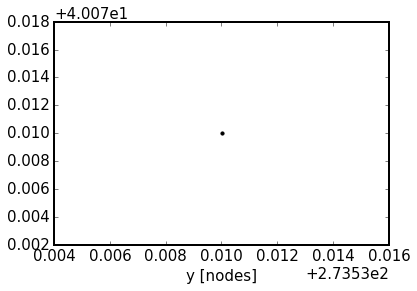

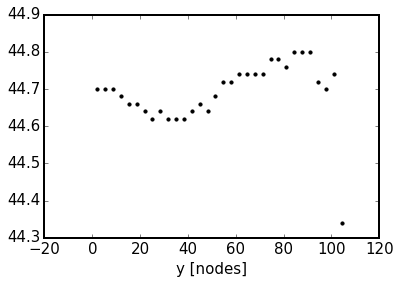

In [107]:
Plot_Points(Ss, plot_type='proj')
plt.figure()
Plot_Points(Rs, plot_type='proj')
# plt.gca().invert_zaxis()

In [108]:
Check_SR(proj_name, adjust=False, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-PointReceivers.pgy
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [104.239998, 44.3400002, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 2 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [100.940002, 44.7400017, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [97.6600037, 44.7000008, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [94.3600006, 44.7200012, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 5 above FS + margin 4.
lib_fwi_ge

NameError: global name 'quit' is not defined

### Runfile

In [109]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]
Update_Runfile(fname, NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 32
MAXRC : 32
 MAXPS         : 1
 io            : fw3d 
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOT

### PBS file

In [110]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="00:10:00", nnodes=1)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj2
#PBS -o proj2-Out.log
#PBS -e proj2-Err.log
#PBS -l walltime=00:10:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=1gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj2

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_name}-

## Run

### Locally

In [87]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
# !cd "{proj_path}" && fwi_run_locally.sh synth 671 {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

### cx1

In [111]:
dir_name = Path_Leave(proj_path[ :-len('/input/')])
!cd "{proj_path}" &&  ssh_sync_project.sh kmc cx1 {dir_name}

sending incremental file list
./
jupy_fwi_3D_OBS_only.ipynb
      1,078,078 100%   42.80MB/s    0:00:00 (xfr#1, to-chk=474/481)
proj2-ExtraPointReceivers.pgy
         16,433 100%  641.91kB/s    0:00:00 (xfr#2, to-chk=444/481)
proj2-ExtraReceivers.geo
         16,441 100%  617.53kB/s    0:00:00 (xfr#3, to-chk=443/481)
proj2-Missing-Receivers.ps
         13,459 100%  505.52kB/s    0:00:00 (xfr#4, to-chk=440/481)
proj2-Observed-0000.log
            851 100%   30.78kB/s    0:00:00 (xfr#5, to-chk=438/481)
proj2-Observed-0000.ttm
            536 100%   19.39kB/s    0:00:00 (xfr#6, to-chk=437/481)
proj2-Observed-0000.ttr
            536 100%   19.39kB/s    0:00:00 (xfr#7, to-chk=436/481)
proj2-Observed-0000.txt
            851 100%   30.78kB/s    0:00:00 (xfr#8, to-chk=435/481)
proj2-OutSeis.sgy
      1,291,280 100%    6.07MB/s    0:00:00 (xfr#9, to-chk=434/481)
proj2-PointReceivers.pgy
          1,327 100%    6.35kB/s    0:00:00 (xfr#10, to-chk=433/481)
proj2-PointReceivers_not_corrected.pgy

## Output

# Proj 3

- synth
- all shots but only 1 OBS
- io : segy
- geometry from segy
- real wavelet (from MP so that filtering is precisely known) with additional low (swell noise) and high-pass (1st iteration block) filter applied to match the data pre-processing
- no filtering (ridiculously high cut-off) within fullwave => only 1 block of iterations
- dt_ms set to 5 ms i.e. as in data files

## Input

In [206]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj3'
# !cd "{proj_path}" && pwd

### Basic parameters

In [148]:
# SPACE-TIME DISCRETIZATION
dx = 50.00 # m
dt = 0.005 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# CHOOSE OBSes AT THE EDGES OF THE MODEL
obs_leftmost_box = '143'
obs_rightmost_box = '138'
box_pad = 10 # FIXME: WHY 10?
box_width = 4000 # m

# XY RANGES 
x1_box = obs_list[obs_leftmost_box].x - box_pad * dx
x2_box = obs_list[obs_rightmost_box ].x + box_pad * dx

mean_y_box = (obs_list[obs_leftmost_box].y + obs_list[obs_rightmost_box ].y) / 2.
y1_box = mean_y_box - box_width / 2.
y2_box = mean_y_box + box_width / 2.

# METRES->NODES CONVERSION
x1_box, y1_box = [int(i / dx) * dx for i in [x1_box, y1_box]]
x2_box, y2_box = [int(i / dx) * dx for i in [x2_box, y2_box]] # FIXME: ROUNDING DOWN!!!
x1_box, x2_box, y1_box, y2_box = [int(i) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box

# z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = 130 * dx # m
ttime = 10 # s

nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# VELOCITY MODEL
# vel = 1500 # m/s
# vel_min = 1500
# vel_max = 1500

# SOURCE WAVELET
f_max = 4 # Hz
f_peak = f_max / 2.
f_min = 0.1 # ???????????????? IS IT SET BY FW3D?

# PLOTTING
minn = 0
maxx = 8000

# FIXME: MUST BE THE SAME AS AFTER 'Set_Aux_Variables', NOT AS IN THE RUNFILE
etop = 2
eleft = 5
efront = 5

z_pad = 5 # PADDING ABOVE HIGHEST POINT OF FS

# CHECKS
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

Check_Stability(f, dx, dt, vel, 'low')
# Check_Accuracy(f, dx, vel, f_max, 'low')
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -13600 15100 2100 6100
nx1 575
nx2 81
nx3_original 131
ns 2000
lib_num.py/Check_Stability: Courant number, C: 0.15



### Free surface

In [149]:
!cd "{proj_path}" && cp proj1'-FreeSurf.vtr' {proj_name}'-FreeSurf.vtr'

#### Prepare

In [58]:
fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
print fname_xyz

# !gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

santorini_merged_local_50_-13600_15100_2100_6100.xyz


In [59]:
from lib_fwi_generic import Convert_xyz2vtr 

fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

Convert_xyz2vtr(fname, dx, z_origin=z_sea+0.5, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(proj_path + proj_name + '-FreeSurf.vtr')


fs_z_min = np.min(fs_z)
fs_z_max = np.max(fs_z)

print 'fs_z_min', fs_z_min
print 'fs_z_max', fs_z_max

lib_fwi_generic.py/Read_xyz: START


ValueError: need more than 0 values to unpack

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


0

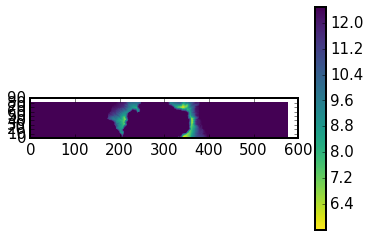

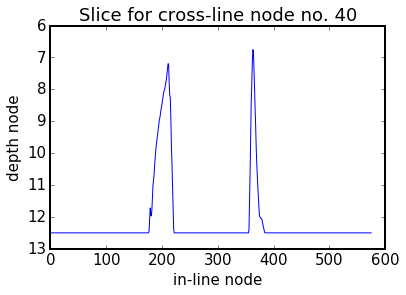

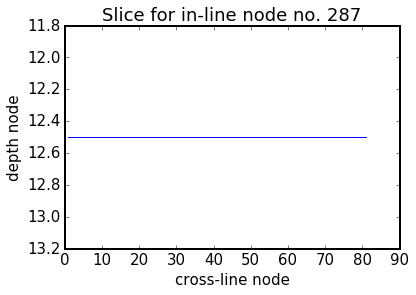

In [61]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### True Model

In [150]:
!cd "{proj_path}" && cp 'proj1-TrueVp.vtr' {proj_name}'-TrueVp.vtr'

In [153]:
!cd "{proj_path}" && vtr2sgy


VTR to SEG-Y file conversion  -  v1.31
****************************

Output traces by in-line then x-line? (default = yes) >> ^C


#### Prepare

##### Cut in XY

In [51]:
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0043685 s, 733 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000163262 s, 19.6 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 575
convert_sgy2vtr.sh: nx2= 81
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj2-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj2-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338028 s, 947 kB/s
n1=131 n2=46575 d1=0.000050
nt=131 ntr=46575 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 0 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj2-TrueVp.bin
n=46575

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 4 s
lib_fwi_generic.py/Save_vtr: File to save:  proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 81 575

conv

In [25]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-TrueVp.sgy' | surange

##### Cut in Z

In [52]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = np.zeros(3)
z_topo_min = big # HIGHEST TOPOGR. PEAK MINIMIZES (!) Z BECAUSE VERTICAL AXIS IS FLIPPED
for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] > 0: # FIXME: IT ASSUMES vel=0 ABOVE FS
                break
        z_topo = iz
        if z_topo < z_topo_min:
            z_topo_min = z_topo
            topo_min = np.array([ix, iy, iz])

print 'topo_min (=highest peak coordinates)', topo_min


z_min = z_topo_min - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min #31 # IMPORTANT!!!
print 'nx3 (!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 131
topo_min (=highest peak coordinates) [340   0  23]
z_min 18
nx3 (!= nx3_original) 113
zcut_model.shape (575, 81, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


##### Sea level

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


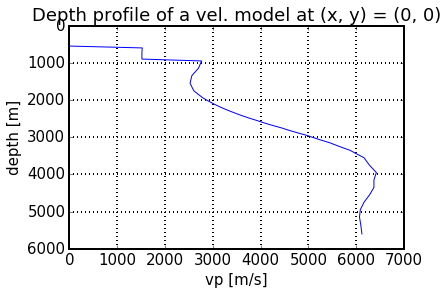

In [53]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, z in enumerate(sea_xy):
    if z != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps

In [54]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in np.arange(nx3_mod-1, -1, -1):
            if (iz + 1) >= fs_z[ix][iy][0]:
                if model[ix][iy][iz] == 0:
                    print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
                    model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  24.1052
lib_fwi_generic.py/Read_vtr: max value:  31.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

###### Plot

lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (114, 576) (114, 576) (113, 575)


liplot_generic/shift_colormap: WARNING! UNKOWN COLORMAP: inferno PROCEEDING WITHOUT SHIFT


lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


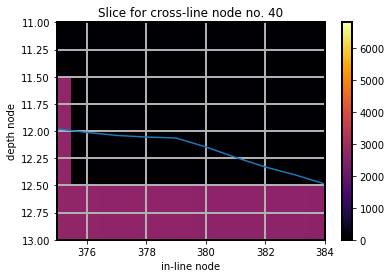

In [74]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
plt.xlim(375, 384)
plt.ylim(13, 11)
plt.grid()

##### Set air velocity

In [55]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] == 0:
                model[ix][iy][iz] = 8000 # !!!

Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj3-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  8000.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (113, 575) (113, 575) (113, 575)


libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj3-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


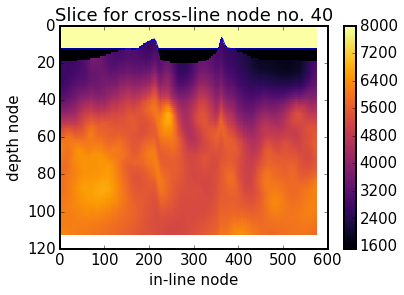

In [167]:
for ycoord in [int(nx2 / 2)]: #range(nx2):
    fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

    # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
    fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
    Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
    plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
    # plt.xlim(0, 20)
    # plt.ylim(14, 12)
    # plt.gca().set_aspect('equal')

# xcoord = 290
# plt.figure() # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cmap='nipy_spectral', minn=1400, maxx=7000)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# # plt.xlim(0, 81)
# # plt.ylim(131, 20)
# # plt.gca().set_aspect('equal')
# # plt.colorbar()

### Source wavelet

In [73]:
!cd "{source_wavelet_path}" && ls -lthr

total 93K
-rwxrwxrwx 1 kajetan kajetan  24K Oct 17  2017 mp_source_3d_7.5Hz_17-10-17.sgy
-rwxrwxrwx 1 kajetan kajetan  24K Oct 17  2017 mp_source_3d_17-10-17.sgy
-rwxrwxrwx 1 kajetan kajetan  24K Feb 21  2018 mp_source_3d_2.2-6.5Hz_18-02-21.sgy
-rwxrwxrwx 1 kajetan kajetan  13K Apr 24 20:11 bh_source_3d_18-04-24.sgy
-rwxrwxrwx 1 kajetan kajetan  400 Oct 21 19:04 binary
-rwxrwxrwx 1 kajetan kajetan 3,2K Oct 21 19:04 header


In [130]:
!cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00237526 s, 1.3 MB/s
1 traces:
tracl    1
tracr    1
fldr     24208
tracf    123
ep       1
cdpt     1
trid     1
nhs      33
gelev    -268
selev    -12
sdepth   12
swdep    276
gwdep    268
scalel   1
scalco   1
sx       23216
sy       7044
gx       24030
gy       7042
counit   1
tstat    110
muts     2500
mute     2500
ns       5000
dt       3000
year     2015
day      334
hour     4
minute   6
sec      23
timbas   194

Shot coordinate limits:
	North(23216,7044) South(23216,7044) East(23216,7044) West(23216,7044)

Receiver coordinate limits:
	North(24030,7042) South(24030,7042) East(24030,7042) West(24030,7042)

Midpoint coordinate limits:
	North(23623,7043) South(23623,7043) East(23623,7043) West(23623,7043)


In [131]:
!cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153534 s, 2.1 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 134 requests (134 known processed) with 0 events remaining.


In [161]:
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

In [36]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00332691 s, 962 kB/s
1 traces:
tracl    1
tracr    1
fldr     24208
tracf    123
ep       1
cdpt     1
trid     1
nhs      33
gelev    -268
selev    -12
sdepth   12
swdep    276
gwdep    268
scalel   1
scalco   1
sx       23216
sy       7044
gx       24030
gy       7042
counit   1
tstat    110
muts     2500
mute     2500
ns       5000
dt       3000
year     2015
day      334
hour     4
minute   6
sec      23
timbas   194

Shot coordinate limits:
	North(23216,7044) South(23216,7044) East(23216,7044) West(23216,7044)

Receiver coordinate limits:
	North(24030,7042) South(24030,7042) East(24030,7042) West(24030,7042)

Midpoint coordinate limits:
	North(23623,7043) South(23623,7043) East(23623,7043) West(23623,7043)


In [15]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00175385 s, 1.8 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1173 requests (1173 known processed) with 0 events remaining.


#### Filtering (additional high-pass to match the data pre-processing)

- get rid of the swell noise
- first block of iterations: max 3 Hz 

In [162]:
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

fname = proj_name + '-RawSign.sgy'
!cd "{proj_path}" && cp {fname} {fname}_raw

fname = proj_name + '-RawSign.sgy'
fname_segy = fname
!cd "{proj_path}" && sgyread.sh {fname} | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 |  subfilt locut=0 hicut=1 npoleshi=10 f3dbhi=3 | segyhdrs | segywrite tape={fname_segy}

# FIRST BLOCK OF ITERATIONS: MAX 3 Hz
# !cd "{proj_path}" && sgyread.sh {fname} |  subfilt zerophase=0 passhi=3 stophi=3.5 | segyhdrs | segywrite tape={fname_segy}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132183 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0454e-05 s, 52.9 MB/s


In [163]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0016875 s, 1.9 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 134 requests (134 known processed) with 0 events remaining.


### Observed data

* one component $>0.5$ Gb 
* we want to be highly flexible in the choice of input data (only certain fragments of certain profiles, e.g. only picked data)
* SegyPrep accepts only either a single file or a list of files
* two above bullet points imply that we HAVE TO chop station-files into smaller chunks 

In [164]:
fname =  proj_name + '-RawSeis.txt'
!cd "{proj_path}" && ls data/stations_lines/*140*segy > {fname}
!cd "{proj_path}" && cat {fname}

data/stations_lines/MGL1521_W140_4_line19.segy
data/stations_lines/MGL1521_W140_4_line25.segy
data/stations_lines/MGL1521_W140_4_line26.segy
data/stations_lines/MGL1521_W140_4_line27.segy
data/stations_lines/MGL1521_W140_4_line28.segy
data/stations_lines/MGL1521_W140_4_line29.segy
data/stations_lines/MGL1521_W140_4_line35.segy
data/stations_lines/MGL1521_W140_4_line41.segy
data/stations_lines/MGL1521_W140_4_line8.segy


In [165]:
# !cd "{proj_path}" && sgyread.sh data/stations_lines/MGL1521_W140_4_line19.segy | surange

#### Filtering

To match processing of the wavelet, sequence of three filters:
1. High-cut (low-pass) Butterworth filter:
    * 4 poles, cutoff frequency (3db point) 20 Hz; or equivalently:
    * not provided by MP
2. High-cut (low-pass) Butterworth filter:
    * 15 poles, cutoff frequency (3db point) 6.4866 Hz; or equivalently:
    * passhi 6 Hz, stophi 8 Hz
3. Low-cut (high-pass) Butterworth filter:
    * 9 poles, cutoff frequency (3db point) 2.1769 Hz; or equivalently:
    * stoplo 1.5 Hz, passlo 2.5 Hz
    
I am not sure why the filter no. 1 is necessary.

Remember that unless we turn off hi/locut=0, the subfilt will be a bandpass!

In [35]:
fnames = Get_Files(proj_path + 'data/stations_lines', 'MGL*segy')
path = proj_path + "/data/stations_lines/"
for fname in fnames:
    fname = Path_Leave(fname)
    fname_segy = "../stations_lines_filtered/" + proj_name + '-' + fname[ :-len('.segy')] + '_bfilt.segy'
    fname_ps = fname_segy[ :-len('.segy')] + '.ps'
    fname_png = fname_ps[ :-len('.ps')] + '.png'
    
    !cd "{path}" && sgyread.sh {fname} | subfilt locut=0 hicut=1 npoleshi=4 f3dbhi=20 | subfilt locut=0 hicut=1 npoleshi=15 f3dbhi=6.4866 | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 | segyhdrs | segywrite tape={fname_segy}
    !cd "{path}" && sgyread.sh {fname_segy} | supsimage legend=1 perc=99 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {fname_ps}
    !cd "{path}" && convert {fname_ps} {fname_png}
    
    # SPECTRUM
#     fname_ps = fname_segy[ :-len('.segy')] + '_spec.ps'
#     fname_png = fname_ps[ :-len('.ps')] + '.png'    
#     !cd "{path}" && sgyread.sh {fname_segy} | suspecfx | supsimage legend=1 perc=99 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {fname_ps}
#     !cd "{path}" && convert {fname_ps} {fname_png}    

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00237459 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000138346 s, 23,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00129602 s, 2,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33416.8 wclip=-33389.4
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019544 s, 1,6 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000120447 s, 26,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00172414 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=31966.9 wclip=-31918
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00180493 s, 1,8 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00114791 s, 2,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0023302 s, 1,

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00224821 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5464.09 wclip=-5403.14
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00147208 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000134756 s, 23,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00163589 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=68698.2 wclip=-69623.3
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00175839 s, 1,8 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000141954 s, 22,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00183395 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=39475.2 wclip=-39384
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00190315 s, 1,7 MB

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0021796 s, 1,5 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00014221 s, 22,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019052 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33.2032 wclip=-33.1432
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00145862 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000133791 s, 23,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019417 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=24.1262 wclip=-23.7197
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00131515 s, 2,4 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000121952 s, 26,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00181255 s, 

#### Choose the lines within the box

It is actually done by SegyPrep...

### SegyPrep

In [166]:
print proj_name

segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', x1_box=x1_box, y1_box=y1_box, nx1=nx1, nx2=nx2, nx3=nx3, dx=dx, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj3

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj3
 Preparing files for synthetics...

 Grid points in-line:                    575
 Grid points cross-line:                  81
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            28700.0000    
 Model width (metres):             4000.00000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         5.00000000    
 Output data delta-T (ms):         5.00000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):          2000
 Time steps to model:                   2000

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID numbers are uniq

In [207]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.pgy ARE MODIFIED)

for suffix in ['-PointSources', '-PointReceivers']:
    interfix = '_not_corrected'
    ext = '.pgy'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        z = line[1]
        y = line[2]
        x = line[3]
        z = str(z_sea + float(z))
        f.write(source_id + ' ' + z  + ' ' + y  + ' ' + x  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-PointSources
1 113 81 575 
4140 19.65999985 40.0800018 273.540009
-PointReceivers
293 113 81 575 
13215 12.239999995 44.3400002 104.239998
13216 12.239999995 44.7400017 100.940002
13217 12.239999995 44.7000008 97.6600037
13218 12.239999995 44.7200012 94.3600006
13219 12.239999995 44.7999992 91.0800018
13220 12.239999995 44.7999992 87.7799988
13221 12.239999995 44.7999992 84.4800034
13222 12.239999995 44.7599983 81.1999969
13223 12.239999995 44.7799988 77.8600006
13224 12.239999995 44.7799988 74.5800018
13225 12.239999995 44.7400017 71.2799988
13226 12.239999995 44.7400017 67.9800034
13227 12.239999995 44.7400017 64.6800003
13228 12.239999995 44.7400017 61.4000015
13229 12.239999995 44.7200012 58.0999985
13230 12.239999995 44.7200012 54.7999992
13231 12.239999995 44.6800003 51.5000000
13232 12.239999995 44.6399994 48.2200012
13233 12.239999995 44.6599998 44.9199982
13234 12.239999995 44.6399994 41.6199989
13235 12.239999995 44.6199989 38.3199997
13236 12.239999995 44.6199989 35.0400009

In [208]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.pgy ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 28700.0000 4000.0000 5600.0000 
4140 13627.0000 1954.00012 983.0
-Receivers
293 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 612.0
13216 4997.00000 2187.00000 612.0
13217 4833.00000 2185.00000 612.0
13218 4668.00000 2186.00000 612.0
13219 4504.00000 2190.00000 612.0
13220 4339.00000 2190.00000 612.0
13221 4174.00000 2190.00000 612.0
13222 4009.99976 2188.00000 612.0
13223 3843.00000 2189.00000 612.0
13224 3679.00000 2189.00000 612.0
13225 3514.00000 2187.00000 612.0
13226 3349.00024 2187.00000 612.0
13227 3184.00000 2187.00000 612.0
13228 3020.00000 2187.00000 612.0
13229 2855.00000 2186.00000 612.0
13230 2690.00000 2186.00000 612.0
13231 2525.00000 2184.00000 612.0
13232 2361.00000 2182.00000 612.0
13233 2196.00000 2183.00000 612.0
13234 2031.00000 2182.00000 612.0
13235 1866.00000 2181.00000 612.0
13236 1702.00000 2181.00000 612.0
13237 1537.00000 2181.00000 612.0
13238 1372.00000 2182.00000 612.0
13239 1208.00000 2181.00000 612.0
13240 1043.00000 2182.00000

#### Output

In [169]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00169168 s, 1.9 MB/s
1 traces:
tracl    1
tracr    1
fldr     4140
tracf    4140
ep       4140
cdp      4140
cdpt     1
trid     1
nvs      1
nhs      1
duse     1
scalel   1
scalco   1
counit   1
ns       2000
dt       5000


In [144]:
!cd "{proj_path}" && sgyread.sh {proj_name}-OutSeis.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297469 s, 1.1 MB/s

segyread: discrepant tr.ns = 12000 with tape/user ns = 2000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (2000) was used to extract traces
32 traces:
tracl    1656 1687 (1656 - 1687)
tracr    1 32 (1 - 32)
fldr     13215 13246 (13215 - 13246)
tracf    4140
ep       19
cdpt     1
trid     1
offset   8469 13575 (8469 - 13575)
gelev    -383
selev    -12
sdepth   12
swdep    180 375 (180 - 375)
gwdep    383
scalel   1
scalco   1
sx       -13546 -8438 (-8438 - -13546)
sy       4267 4290 (4267 - 4285)
gx       27
gy       4054
counit   1
tstat    17
delrt    1 5 (2 - 3)
ns       2000
dt       5000
year     2015
day      329
hour     2 3 (2 - 3)
minute   1 59 (56 - 44)
sec      1 59 (39 - 29)
timbas   31 886 (886 - 746)
d1       0.000000
f1       514064.000000
d2       -0.000000
f2       -17362059533375886940249221276631040.000000 18012681203943025

In [146]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Template.sgy | suximage

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163854 s, 2.0 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1269 requests (1269 known processed) with 0 events remaining.


### Sources & receivers

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj3-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj3-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

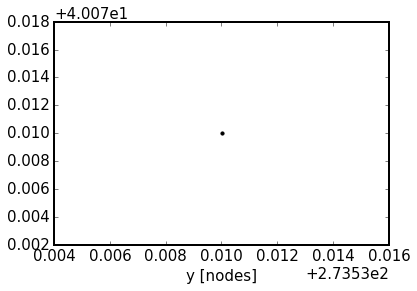

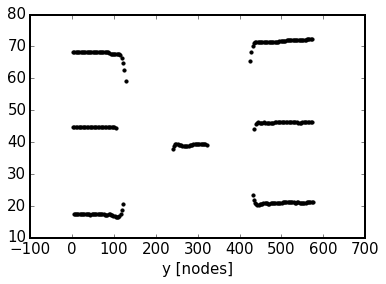

In [171]:
nx1_sr, nx2_sr, nx3_sr, Ss, Rs = Read_SR(proj_name, adjust=False, proj_path=proj_path)

Plot_Points(Ss, plot_type='proj')
plt.figure()
Plot_Points(Rs, plot_type='proj')

In [172]:
Check_SR(proj_name, adjust=False, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj3-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj3-PointReceivers.pgy
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj3-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [104.239998, 44.3400002, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 2 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [100.940002, 44.7400017, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [97.6600037, 44.7000008, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [94.3600006, 44.7200012, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 5 above FS + margin 4.
lib_fwi_ge

NameError: global name 'quit' is not defined

### Runfile

In [177]:
!cd "{proj_path}" && cat {proj_name}'-Skeleton.key'


 ! Skeleton Runfile for FULLWAVE3D
 ! Generated on November 01, 2018, at 21:26:47
 ! By SEGYPREP, Version 3.16.04
 ! For project proj3

 ! Problem type
 Problem         : synthetic
 Units           : metric
 Equation        : acoustic
 Domain          : time
 Kernel          : high     ! ** change for low kernel
 Anisotropy      : VTI
 TTI units       : fraction ! ** change for percent
 Probdims        : 3D
 IO              : SEGY

 ! Model size
 NX1             :          575
 NX2             :           81
 NX3             :          113
 DX              :    50.0000000  ! metres
 MAX TIME        :    10000.0000  ! ms
 FD time step    :    5.00000000  ! ms

 ! Numbers of shots and receivers
 NCOMP           :            1
 NSHOT           :            1
 MAXPS           :            1
 NRECS           :          293
 MAXRC           :          293

 ! Free surface boundary at top, absorbing elsewhere
 B top           : -99
 B left          : 40  ! ** could change for low kernel
 B r

In [179]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]
Update_Runfile(fname, io=params['IO'], NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj3-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 293
MAXRC : 293
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WIND

### PBS file

In [180]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="01:00:00", nnodes=1)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj3
#PBS -o proj3-Out.log
#PBS -e proj3-Err.log
#PBS -l walltime=01:00:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=1gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj3

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_name}-

## Run

### Locally

In [87]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
# !cd "{proj_path}" && fwi_run_locally.sh synth 671 {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

### cx1

In [182]:
dir_name = Path_Leave(proj_path[ :-len('/input/')])
!cd "{proj_path}" &&  ssh_sync_project.sh kmc cx1 {dir_name}

sending incremental file list
./
proj3-GhostData.bin
    274,747,664 100%  102.86MB/s    0:00:02 (xfr#1, to-chk=434/518)
receiving incremental file list
./
RUNTIME OF THE SCRIPT: 4 s


# Proj 4

- synth + inv
- all shots, all OBSes
- io : segy
- geometry from segy
- real wavelet (from MP so that filtering is precisely known) with additional low (swell noise) and high-pass (1st iteration block) filter applied to match the data pre-processing
- no filtering (ridiculously high cut-off) within fullwave => only 1 block of iterations
- dt_ms set to 5 ms i.e. as in data files

## Input

In [209]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj4'
# !cd "{proj_path}" && pwd

### Basic parameters

In [184]:
# SPACE-TIME DISCRETIZATION
dx = 50.00 # m
dt = 0.005 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# CHOOSE OBSes AT THE EDGES OF THE MODEL
obs_leftmost_box = '143'
obs_rightmost_box = '138'
box_pad = 10 # FIXME: WHY 10?
box_width = 4000 # m

# XY RANGES 
x1_box = obs_list[obs_leftmost_box].x - box_pad * dx
x2_box = obs_list[obs_rightmost_box ].x + box_pad * dx

mean_y_box = (obs_list[obs_leftmost_box].y + obs_list[obs_rightmost_box ].y) / 2.
y1_box = mean_y_box - box_width / 2.
y2_box = mean_y_box + box_width / 2.

# METRES->NODES CONVERSION
x1_box, y1_box = [int(i / dx) * dx for i in [x1_box, y1_box]]
x2_box, y2_box = [int(i / dx) * dx for i in [x2_box, y2_box]] # FIXME: ROUNDING DOWN!!!
x1_box, x2_box, y1_box, y2_box = [int(i) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box

# z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = 130 * dx # m
ttime = 10 # s

nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# VELOCITY MODEL
# vel = 1500 # m/s
# vel_min = 1500
# vel_max = 1500

# SOURCE WAVELET
f_max = 4 # Hz
f_peak = f_max / 2.
f_min = 0.1 # ???????????????? IS IT SET BY FW3D?

# PLOTTING
minn = 0
maxx = 8000

# FIXME: MUST BE THE SAME AS AFTER 'Set_Aux_Variables', NOT AS IN THE RUNFILE
etop = 2
eleft = 5
efront = 5

z_pad = 5 # PADDING ABOVE HIGHEST POINT OF FS

# CHECKS
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

Check_Stability(f, dx, dt, vel, 'low')
# Check_Accuracy(f, dx, vel, f_max, 'low')
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -13600 15100 2100 6100
nx1 575
nx2 81
nx3_original 131
ns 2000
lib_num.py/Check_Stability: Courant number, C: 0.15



### Free surface

In [185]:
!cd "{proj_path}" && cp proj1'-FreeSurf.vtr' {proj_name}'-FreeSurf.vtr'

#### Prepare

In [58]:
fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
print fname_xyz

# !gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

santorini_merged_local_50_-13600_15100_2100_6100.xyz


In [59]:
from lib_fwi_generic import Convert_xyz2vtr 

fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

Convert_xyz2vtr(fname, dx, z_origin=z_sea+0.5, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(proj_path + proj_name + '-FreeSurf.vtr')


fs_z_min = np.min(fs_z)
fs_z_max = np.max(fs_z)

print 'fs_z_min', fs_z_min
print 'fs_z_max', fs_z_max

lib_fwi_generic.py/Read_xyz: START


ValueError: need more than 0 values to unpack

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj4-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


0

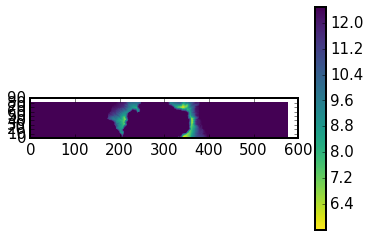

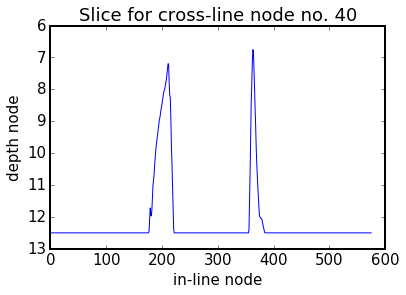

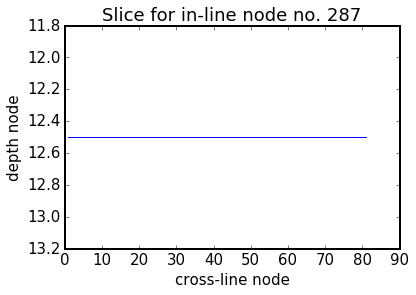

In [227]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### True Model

In [186]:
!cd "{proj_path}" && cp 'proj1-TrueVp.vtr' {proj_name}'-TrueVp.vtr'

In [187]:
!cd "{proj_path}" && cp 'proj3-TrueVp.sgy' {proj_name}'-TrueVp.sgy'

#### Prepare

##### Cut in XY

In [51]:
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0043685 s, 733 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000163262 s, 19.6 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 575
convert_sgy2vtr.sh: nx2= 81
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj2-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj2-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338028 s, 947 kB/s
n1=131 n2=46575 d1=0.000050
nt=131 ntr=46575 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 0 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj2-TrueVp.bin
n=46575

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 4 s
lib_fwi_generic.py/Save_vtr: File to save:  proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 81 575

conv

In [25]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-TrueVp.sgy' | surange

##### Cut in Z

In [52]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = np.zeros(3)
z_topo_min = big # HIGHEST TOPOGR. PEAK MINIMIZES (!) Z BECAUSE VERTICAL AXIS IS FLIPPED
for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] > 0: # FIXME: IT ASSUMES vel=0 ABOVE FS
                break
        z_topo = iz
        if z_topo < z_topo_min:
            z_topo_min = z_topo
            topo_min = np.array([ix, iy, iz])

print 'topo_min (=highest peak coordinates)', topo_min


z_min = z_topo_min - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min #31 # IMPORTANT!!!
print 'nx3 (!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 131
topo_min (=highest peak coordinates) [340   0  23]
z_min 18
nx3 (!= nx3_original) 113
zcut_model.shape (575, 81, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


##### Sea level

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


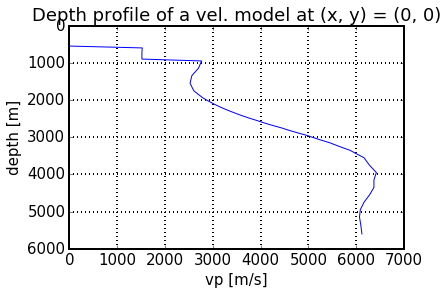

In [53]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, z in enumerate(sea_xy):
    if z != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps

In [54]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in np.arange(nx3_mod-1, -1, -1):
            if (iz + 1) >= fs_z[ix][iy][0]:
                if model[ix][iy][iz] == 0:
                    print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
                    model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  24.1052
lib_fwi_generic.py/Read_vtr: max value:  31.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

###### Plot

lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (114, 576) (114, 576) (113, 575)


liplot_generic/shift_colormap: WARNING! UNKOWN COLORMAP: inferno PROCEEDING WITHOUT SHIFT


lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


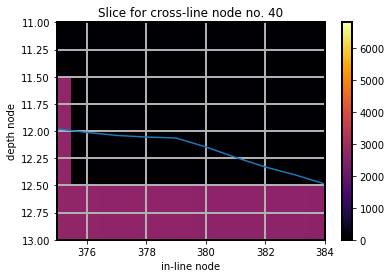

In [74]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
plt.xlim(375, 384)
plt.ylim(13, 11)
plt.grid()

##### Set air velocity

In [55]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] == 0:
                model[ix][iy][iz] = 8000 # !!!

Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj4-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  8000.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (113, 575) (113, 575) (113, 575)
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


 File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj4-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


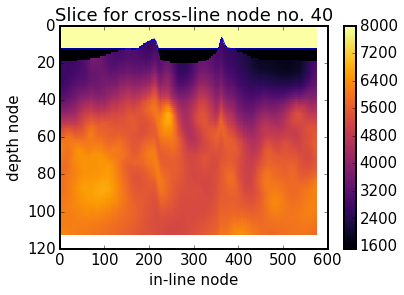

In [226]:
for ycoord in [int(nx2 / 2)]: #range(nx2):
    fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

    # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
    fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
    Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
    plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
    # plt.xlim(0, 20)
    # plt.ylim(14, 12)
    # plt.gca().set_aspect('equal')

# xcoord = 290
# plt.figure() # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cmap='nipy_spectral', minn=1400, maxx=7000)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# # plt.xlim(0, 81)
# # plt.ylim(131, 20)
# # plt.gca().set_aspect('equal')
# # plt.colorbar()

### Source wavelet

In [188]:
!cd "{proj_path}" && cp 'proj3-RawSign.sgy' {proj_name}'-RawSign.sgy'

In [130]:
!cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00237526 s, 1.3 MB/s
1 traces:
tracl    1
tracr    1
fldr     24208
tracf    123
ep       1
cdpt     1
trid     1
nhs      33
gelev    -268
selev    -12
sdepth   12
swdep    276
gwdep    268
scalel   1
scalco   1
sx       23216
sy       7044
gx       24030
gy       7042
counit   1
tstat    110
muts     2500
mute     2500
ns       5000
dt       3000
year     2015
day      334
hour     4
minute   6
sec      23
timbas   194

Shot coordinate limits:
	North(23216,7044) South(23216,7044) East(23216,7044) West(23216,7044)

Receiver coordinate limits:
	North(24030,7042) South(24030,7042) East(24030,7042) West(24030,7042)

Midpoint coordinate limits:
	North(23623,7043) South(23623,7043) East(23623,7043) West(23623,7043)


In [131]:
!cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153534 s, 2.1 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 134 requests (134 known processed) with 0 events remaining.


In [161]:
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

In [36]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00332691 s, 962 kB/s
1 traces:
tracl    1
tracr    1
fldr     24208
tracf    123
ep       1
cdpt     1
trid     1
nhs      33
gelev    -268
selev    -12
sdepth   12
swdep    276
gwdep    268
scalel   1
scalco   1
sx       23216
sy       7044
gx       24030
gy       7042
counit   1
tstat    110
muts     2500
mute     2500
ns       5000
dt       3000
year     2015
day      334
hour     4
minute   6
sec      23
timbas   194

Shot coordinate limits:
	North(23216,7044) South(23216,7044) East(23216,7044) West(23216,7044)

Receiver coordinate limits:
	North(24030,7042) South(24030,7042) East(24030,7042) West(24030,7042)

Midpoint coordinate limits:
	North(23623,7043) South(23623,7043) East(23623,7043) West(23623,7043)


In [15]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00175385 s, 1.8 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1173 requests (1173 known processed) with 0 events remaining.


#### Filtering (additional high-pass to match the data pre-processing)

- get rid of the swell noise
- first block of iterations: max 3 Hz 

In [162]:
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

fname = proj_name + '-RawSign.sgy'
!cd "{proj_path}" && cp {fname} {fname}_raw

fname = proj_name + '-RawSign.sgy'
fname_segy = fname
!cd "{proj_path}" && sgyread.sh {fname} | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 |  subfilt locut=0 hicut=1 npoleshi=10 f3dbhi=3 | segyhdrs | segywrite tape={fname_segy}

# FIRST BLOCK OF ITERATIONS: MAX 3 Hz
# !cd "{proj_path}" && sgyread.sh {fname} |  subfilt zerophase=0 passhi=3 stophi=3.5 | segyhdrs | segywrite tape={fname_segy}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132183 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0454e-05 s, 52.9 MB/s


In [163]:
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0016875 s, 1.9 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 134 requests (134 known processed) with 0 events remaining.


### Observed data

* one component $>0.5$ Gb 
* we want to be highly flexible in the choice of input data (only certain fragments of certain profiles, e.g. only picked data)
* SegyPrep accepts only either a single file or a list of files
* two above bullet points imply that we HAVE TO chop station-files into smaller chunks 

In [216]:
fname =  proj_name + '-RawSeis.txt'
!cd "{proj_path}" && trash {fname}
for station_no in [140, 142, 160, 139, 138, 137]: # 141 IS TOO SHALLOW!
    !cd "{proj_path}" && ls data/stations_lines/*{station_no}*segy >> {fname}

!cd "{proj_path}" && cat {fname}

ls: cannot access 'data/stations_lines/*137*segy': No such file or directory
data/stations_lines/MGL1521_W140_4_line19.segy
data/stations_lines/MGL1521_W140_4_line25.segy
data/stations_lines/MGL1521_W140_4_line26.segy
data/stations_lines/MGL1521_W140_4_line27.segy
data/stations_lines/MGL1521_W140_4_line28.segy
data/stations_lines/MGL1521_W140_4_line29.segy
data/stations_lines/MGL1521_W140_4_line35.segy
data/stations_lines/MGL1521_W140_4_line41.segy
data/stations_lines/MGL1521_W140_4_line8.segy
data/stations_lines/MGL1521_S142_4_line19.segy
data/stations_lines/MGL1521_S142_4_line25.segy
data/stations_lines/MGL1521_S142_4_line26.segy
data/stations_lines/MGL1521_S142_4_line27.segy
data/stations_lines/MGL1521_S142_4_line28.segy
data/stations_lines/MGL1521_S142_4_line29.segy
data/stations_lines/MGL1521_S142_4_line35.segy
data/stations_lines/MGL1521_S142_4_line41.segy
data/stations_lines/MGL1521_S142_4_line8.segy
data/stations_lines/MGL1521_S160_4_line19.segy
data/stations_lines/MGL1521_S160

In [165]:
# !cd "{proj_path}" && sgyread.sh data/stations_lines/MGL1521_W140_4_line19.segy | surange

#### Filtering

To match processing of the wavelet, sequence of three filters:
1. High-cut (low-pass) Butterworth filter:
    * 4 poles, cutoff frequency (3db point) 20 Hz; or equivalently:
    * not provided by MP
2. High-cut (low-pass) Butterworth filter:
    * 15 poles, cutoff frequency (3db point) 6.4866 Hz; or equivalently:
    * passhi 6 Hz, stophi 8 Hz
3. Low-cut (high-pass) Butterworth filter:
    * 9 poles, cutoff frequency (3db point) 2.1769 Hz; or equivalently:
    * stoplo 1.5 Hz, passlo 2.5 Hz
    
I am not sure why the filter no. 1 is necessary.

Remember that unless we turn off hi/locut=0, the subfilt will be a bandpass!

In [35]:
fnames = Get_Files(proj_path + 'data/stations_lines', 'MGL*segy')
path = proj_path + "/data/stations_lines/"
for fname in fnames:
    fname = Path_Leave(fname)
    fname_segy = "../stations_lines_filtered/" + proj_name + '-' + fname[ :-len('.segy')] + '_bfilt.segy'
    fname_ps = fname_segy[ :-len('.segy')] + '.ps'
    fname_png = fname_ps[ :-len('.ps')] + '.png'
    
    !cd "{path}" && sgyread.sh {fname} | subfilt locut=0 hicut=1 npoleshi=4 f3dbhi=20 | subfilt locut=0 hicut=1 npoleshi=15 f3dbhi=6.4866 | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 | segyhdrs | segywrite tape={fname_segy}
    !cd "{path}" && sgyread.sh {fname_segy} | supsimage legend=1 perc=99 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {fname_ps}
    !cd "{path}" && convert {fname_ps} {fname_png}
    
    # SPECTRUM
#     fname_ps = fname_segy[ :-len('.segy')] + '_spec.ps'
#     fname_png = fname_ps[ :-len('.ps')] + '.png'    
#     !cd "{path}" && sgyread.sh {fname_segy} | suspecfx | supsimage legend=1 perc=99 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {fname_ps}
#     !cd "{path}" && convert {fname_ps} {fname_png}    

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00237459 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000138346 s, 23,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00129602 s, 2,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33416.8 wclip=-33389.4
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019544 s, 1,6 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000120447 s, 26,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00172414 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=31966.9 wclip=-31918
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00180493 s, 1,8 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00114791 s, 2,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0023302 s, 1,

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00224821 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5464.09 wclip=-5403.14
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00147208 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000134756 s, 23,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00163589 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=68698.2 wclip=-69623.3
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00175839 s, 1,8 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000141954 s, 22,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00183395 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=39475.2 wclip=-39384
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00190315 s, 1,7 MB

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0021796 s, 1,5 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00014221 s, 22,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019052 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33.2032 wclip=-33.1432
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00145862 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000133791 s, 23,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019417 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=24.1262 wclip=-23.7197
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00131515 s, 2,4 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000121952 s, 26,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00181255 s, 

#### Choose the lines within the box

It is actually done by SegyPrep...

### SegyPrep

In [195]:
print proj_name

segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', x1_box=x1_box, y1_box=y1_box, nx1=nx1, nx2=nx2, nx3=nx3, dx=dx, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj4

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj4
 Unrecognised parameter                    !!! WARNING !!!
 Unrecognised parameter: zorigin
 Unrecognised parameter                    !!! WARNING !!!
 Unrecognised parameter: zshift
 Preparing files for synthetics...

 Grid points in-line:                    575
 Grid points cross-line:                  81
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            28700.0000    
 Model width (metres):             4000.00000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         5.00000000    
 Output data delta-T (ms):         5.00000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):          2000
 Time steps to model

 Traces read from file:                  334
 Reading: data/stations_lines/MGL1521_W138_4_line26.segy
 No of traces in SEG-Y datafile:         358
 Traces read from file:                  358
 Reading: data/stations_lines/MGL1521_W138_4_line27.segy
 No of traces in SEG-Y datafile:         363
 Traces read from file:                  363
 Reading: data/stations_lines/MGL1521_W138_4_line28.segy
 No of traces in SEG-Y datafile:          29
 Traces read from file:                   29
 Reading: data/stations_lines/MGL1521_W138_4_line29.segy
 No of traces in SEG-Y datafile:         350
 Traces read from file:                  350
 Reading: data/stations_lines/MGL1521_W138_4_line35.segy
 No of traces in SEG-Y datafile:         162
 Traces read from file:                  162
 Reading: data/stations_lines/MGL1521_W138_4_line41.segy
 No of traces in SEG-Y datafile:         189
 Traces read from file:                  189
 Reading: data/stations_lines/MGL1521_W138_4_line8.segy
 No of traces in 


 Creating VTR file from SEG-Y...
 Output file proj4-TrueVp.vtr already exists
 OK to overwrite? (no) >> ^C


In [217]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.pgy ARE MODIFIED)

for suffix in ['-PointSources', '-PointReceivers']:
    interfix = '_not_corrected'
    ext = '.pgy'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        z = line[1]
        y = line[2]
        x = line[3]
        z = str(z_sea + float(z))
        f.write(source_id + ' ' + z  + ' ' + y  + ' ' + x  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-PointSources
5 113 81 575 
4138 18.86000013 45.7999992 565.940002
4139 17.53999996 43.1599998 450.260010
4140 19.65999985 40.0800018 273.540009
4142 17.19999981 47.7200012 74.9599991
4160 19.65999985 12.3400002 246.979996
-PointReceivers
293 113 81 575 
13215 12.239999995 44.3400002 104.239998
13216 12.239999995 44.7400017 100.940002
13217 12.239999995 44.7000008 97.6600037
13218 12.239999995 44.7200012 94.3600006
13219 12.239999995 44.7999992 91.0800018
13220 12.239999995 44.7999992 87.7799988
13221 12.239999995 44.7999992 84.4800034
13222 12.239999995 44.7599983 81.1999969
13223 12.239999995 44.7799988 77.8600006
13224 12.239999995 44.7799988 74.5800018
13225 12.239999995 44.7400017 71.2799988
13226 12.239999995 44.7400017 67.9800034
13227 12.239999995 44.7400017 64.6800003
13228 12.239999995 44.7400017 61.4000015
13229 12.239999995 44.7200012 58.0999985
13230 12.239999995 44.7200012 54.7999992
13231 12.239999995 44.6800003 51.5000000
13232 12.239999995 44.6399994 48.2200012
13233 1

In [218]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
5 28700.0000 4000.0000 5600.0000 
4138 28247.0000 2240.00000 943.0
4139 22463.0000 2108.00000 877.0
4140 13627.0000 1954.00012 983.0
4142 3698.00000 2336.00000 860.0
4160 12299.0000 567.000000 983.0
-Receivers
293 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 612.0
13216 4997.00000 2187.00000 612.0
13217 4833.00000 2185.00000 612.0
13218 4668.00000 2186.00000 612.0
13219 4504.00000 2190.00000 612.0
13220 4339.00000 2190.00000 612.0
13221 4174.00000 2190.00000 612.0
13222 4009.99976 2188.00000 612.0
13223 3843.00000 2189.00000 612.0
13224 3679.00000 2189.00000 612.0
13225 3514.00000 2187.00000 612.0
13226 3349.00024 2187.00000 612.0
13227 3184.00000 2187.00000 612.0
13228 3020.00000 2187.00000 612.0
13229 2855.00000 2186.00000 612.0
13230 2690.00000 2186.00000 612.0
13231 2525.00000 2184.00000 612.0
13232 2361.00000 2182.00000 612.0
13233 2196.00000 2183.00000 612.0
13234 2031.00000 2182.00000 612.0
13235 1866.00000 2181.00000 612.0
13236 1702.00000 2181.00000 612

#### Output

In [212]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00181634 s, 1.8 MB/s
6 traces:
tracl    1 6 (1 - 6)
tracr    1 6 (1 - 6)
fldr     4138 4160 (4140 - 4138)
tracf    4138 4160 (4140 - 4138)
ep       4138 4160 (4140 - 4138)
cdp      4138 4160 (4140 - 4138)
cdpt     1
trid     1
nvs      1
nhs      1
duse     1
scalel   1
scalco   1
counit   1
ns       2000
dt       5000


In [144]:
!cd "{proj_path}" && sgyread.sh {proj_name}-OutSeis.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297469 s, 1.1 MB/s

segyread: discrepant tr.ns = 12000 with tape/user ns = 2000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (2000) was used to extract traces
32 traces:
tracl    1656 1687 (1656 - 1687)
tracr    1 32 (1 - 32)
fldr     13215 13246 (13215 - 13246)
tracf    4140
ep       19
cdpt     1
trid     1
offset   8469 13575 (8469 - 13575)
gelev    -383
selev    -12
sdepth   12
swdep    180 375 (180 - 375)
gwdep    383
scalel   1
scalco   1
sx       -13546 -8438 (-8438 - -13546)
sy       4267 4290 (4267 - 4285)
gx       27
gy       4054
counit   1
tstat    17
delrt    1 5 (2 - 3)
ns       2000
dt       5000
year     2015
day      329
hour     2 3 (2 - 3)
minute   1 59 (56 - 44)
sec      1 59 (39 - 29)
timbas   31 886 (886 - 746)
d1       0.000000
f1       514064.000000
d2       -0.000000
f2       -17362059533375886940249221276631040.000000 18012681203943025

In [146]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Template.sgy | suximage

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163854 s, 2.0 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1269 requests (1269 known processed) with 0 events remaining.


### Sources & receivers

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

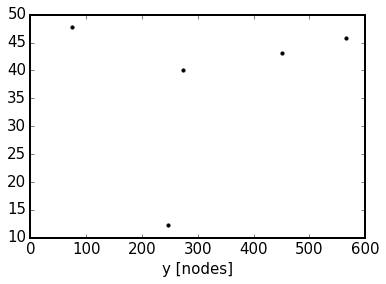

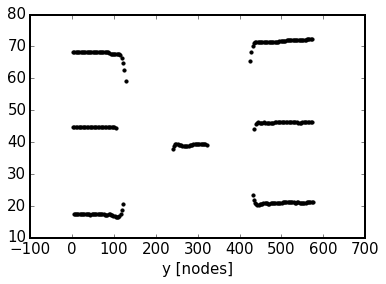

In [219]:
nx1_sr, nx2_sr, nx3_sr, Ss, Rs = Read_SR(proj_name, adjust=False, proj_path=proj_path)

Plot_Points(Ss, plot_type='proj')
plt.figure()
Plot_Points(Rs, plot_type='proj')

In [220]:
Check_SR(proj_name, adjust=False, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-PointReceivers.pgy
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj4-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [104.239998, 44.3400002, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 2 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [100.940002, 44.7400017, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [97.6600037, 44.7000008, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [94.3600006, 44.7200012, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 5 above FS + margin 4.
lib_fwi_ge

NameError: global name 'quit' is not defined

### Runfile

In [221]:
!cd "{proj_path}" && cat {proj_name}'-Skeleton.key'


 ! Skeleton Runfile for FULLWAVE3D
 ! Generated on November 01, 2018, at 22:04:56
 ! By SEGYPREP, Version 3.16.04
 ! For project proj4

 ! Problem type
 Problem         : synthetic
 Units           : metric
 Equation        : acoustic
 Domain          : time
 Kernel          : high     ! ** change for low kernel
 Anisotropy      : VTI
 TTI units       : fraction ! ** change for percent
 Probdims        : 3D
 IO              : SEGY

 ! Model size
 NX1             :          575
 NX2             :           81
 NX3             :          113
 DX              :    50.0000000  ! metres
 MAX TIME        :    10000.0000  ! ms
 FD time step    :    5.00000000  ! ms

 ! Numbers of shots and receivers
 NCOMP           :            5
 NSHOT           :            5
 MAXPS           :            1
 NRECS           :          293
 MAXRC           :          293

 ! Free surface boundary at top, absorbing elsewhere
 B top           : -99
 B left          : 40  ! ** could change for low kernel
 B r

In [222]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]
Update_Runfile(fname, io=params['IO'], NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj4-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 293
MAXRC : 293
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WIND

### PBS file

- more shots should have more nodes!

In [223]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="01:00:00", nnodes=1)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj4
#PBS -o proj4-Out.log
#PBS -e proj4-Err.log
#PBS -l walltime=01:00:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=1gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj4

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_name}-

## Run

### Locally

In [87]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
# !cd "{proj_path}" && fwi_run_locally.sh synth 671 {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

### cx1

In [225]:
dir_name = Path_Leave(proj_path[ :-len('/input/')])
!cd "{proj_path}" &&  cp proj1-GhostData.bin {proj_name}-GhostData.bin
!cd "{proj_path}" &&  ssh_sync_project.sh kmc cx1 {dir_name}

sending incremental file list
./
proj4-GhostData.bin
    274,747,664 100%  106.54MB/s    0:00:02 (xfr#1, to-chk=435/560)
receiving incremental file list
./
RUNTIME OF THE SCRIPT: 3 s


# Proj 5

- same as proj2 but wavelet from proj1

## Input

In [252]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj5'
# !cd "{proj_path}" && pwd

### Basic parameters

In [253]:
# SPACE-TIME DISCRETIZATION
dx = 50.00 # m
dt = 0.005 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# CHOOSE OBSes AT THE EDGES OF THE MODEL
obs_leftmost_box = '143'
obs_rightmost_box = '138'
box_pad = 10 # FIXME: WHY 10?
box_width = 4000 # m

# XY RANGES 
x1_box = obs_list[obs_leftmost_box].x - box_pad * dx
x2_box = obs_list[obs_rightmost_box ].x + box_pad * dx

mean_y_box = (obs_list[obs_leftmost_box].y + obs_list[obs_rightmost_box ].y) / 2.
y1_box = mean_y_box - box_width / 2.
y2_box = mean_y_box + box_width / 2.

# METRES->NODES CONVERSION
x1_box, y1_box = [int(i / dx) * dx for i in [x1_box, y1_box]]
x2_box, y2_box = [int(i / dx) * dx for i in [x2_box, y2_box]] # FIXME: ROUNDING DOWN!!!
x1_box, x2_box, y1_box, y2_box = [int(i) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box

# z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = 130 * dx # m
ttime = 10 # s

nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# VELOCITY MODEL
# vel = 1500 # m/s
# vel_min = 1500
# vel_max = 1500

# SOURCE WAVELET
f_max = 4 # Hz
f_peak = f_max / 2.
f_min = 0.1 # ???????????????? IS IT SET BY FW3D?

# PLOTTING
minn = 0
maxx = 8000

# FIXME: MUST BE THE SAME AS AFTER 'Set_Aux_Variables', NOT AS IN THE RUNFILE
etop = 2
eleft = 5
efront = 5

z_pad = 5 # PADDING ABOVE HIGHEST POINT OF FS

# CHECKS
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

Check_Stability(f, dx, dt, vel, 'low')
# Check_Accuracy(f, dx, vel, f_max, 'low')
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -13600 15100 2100 6100
nx1 575
nx2 81
nx3_original 131
ns 2000
lib_num.py/Check_Stability: Courant number, C: 0.15



### Free surface

In [254]:
!cd "{proj_path}" && cp proj1'-FreeSurf.vtr' {proj_name}'-FreeSurf.vtr'

#### Prepare

In [58]:
fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
print fname_xyz

# !gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

santorini_merged_local_50_-13600_15100_2100_6100.xyz


In [59]:
from lib_fwi_generic import Convert_xyz2vtr 

fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

Convert_xyz2vtr(fname, dx, z_origin=z_sea+0.5, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(proj_path + proj_name + '-FreeSurf.vtr')


fs_z_min = np.min(fs_z)
fs_z_max = np.max(fs_z)

print 'fs_z_min', fs_z_min
print 'fs_z_max', fs_z_max

lib_fwi_generic.py/Read_xyz: START


ValueError: need more than 0 values to unpack

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


0

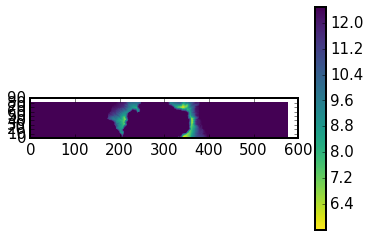

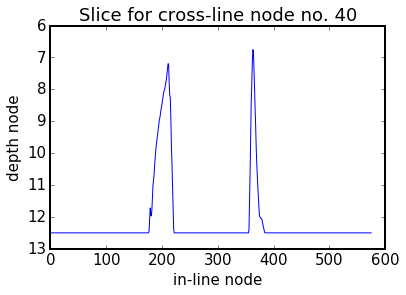

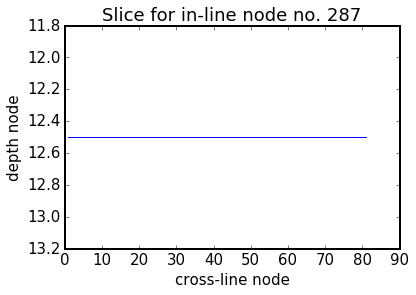

In [61]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### True Model

In [263]:
!cd "{proj_path}" && cp proj2'-TrueVp.vtr' {proj_name}'-TrueVp.vtr'

#### Prepare

##### Cut in XY

In [51]:
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0043685 s, 733 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000163262 s, 19.6 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 575
convert_sgy2vtr.sh: nx2= 81
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj2-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj2-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338028 s, 947 kB/s
n1=131 n2=46575 d1=0.000050
nt=131 ntr=46575 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 0 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj2-TrueVp.bin
n=46575

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 4 s
lib_fwi_generic.py/Save_vtr: File to save:  proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 81 575

conv

In [25]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-TrueVp.sgy' | surange

##### Cut in Z

In [52]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = np.zeros(3)
z_topo_min = big # HIGHEST TOPOGR. PEAK MINIMIZES (!) Z BECAUSE VERTICAL AXIS IS FLIPPED
for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] > 0: # FIXME: IT ASSUMES vel=0 ABOVE FS
                break
        z_topo = iz
        if z_topo < z_topo_min:
            z_topo_min = z_topo
            topo_min = np.array([ix, iy, iz])

print 'topo_min (=highest peak coordinates)', topo_min


z_min = z_topo_min - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min #31 # IMPORTANT!!!
print 'nx3 (!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 131
topo_min (=highest peak coordinates) [340   0  23]
z_min 18
nx3 (!= nx3_original) 113
zcut_model.shape (575, 81, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


##### Sea level

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


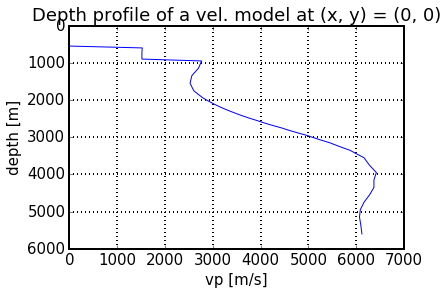

In [53]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, z in enumerate(sea_xy):
    if z != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps

In [54]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in np.arange(nx3_mod-1, -1, -1):
            if (iz + 1) >= fs_z[ix][iy][0]:
                if model[ix][iy][iz] == 0:
                    print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
                    model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  24.1052
lib_fwi_generic.py/Read_vtr: max value:  31.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

###### Plot

lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.4844
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
libplot_generic.py/Plot_Slice:  (114, 576) (114, 576) (113, 575)


liplot_generic/shift_colormap: WARNING! UNKOWN COLORMAP: inferno PROCEEDING WITHOUT SHIFT


lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


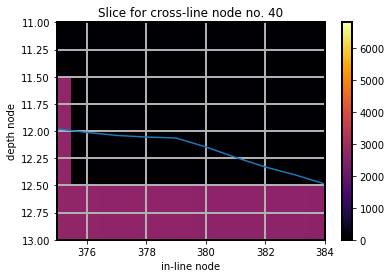

In [74]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
plt.xlim(375, 384)
plt.ylim(13, 11)
plt.grid()

##### Set air velocity

In [55]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

for ix in range(nx1_mod):
    for iy in range(nx2_mod):
        for iz in range(nx3_mod):
            if model[ix][iy][iz] == 0:
                model[ix][iy][iz] = 8000 # !!!

Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 113
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj2-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 81 575


0

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  8000.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3: 

libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


 575 81 113
libplot_generic.py/Plot_Slice:  (113, 575) (113, 575) (113, 575)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj2-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


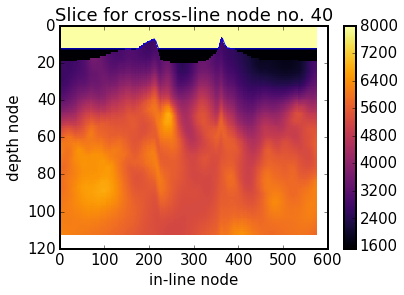

In [62]:
for ycoord in [int(nx2 / 2)]: #range(nx2):
    fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

    # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
    plt.figure()
    Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
    fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
    Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
    plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
    # plt.xlim(0, 20)
    # plt.ylim(14, 12)
    # plt.gca().set_aspect('equal')

# xcoord = 290
# plt.figure() # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cmap='nipy_spectral', minn=1400, maxx=7000)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# # plt.xlim(0, 81)
# # plt.ylim(131, 20)
# # plt.gca().set_aspect('equal')
# # plt.colorbar()

### Source wavelet

In [256]:
!cd "{proj_path}" && su_ricker.sh {proj_name} {f_peak} {dt} {ns}
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1875e-05 s, 34.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00174266 s, 1.8 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 480 requests (480 known processed) with 0 events remaining.


### Observed data

* one component $>0.5$ Gb 
* we want to be highly flexible in the choice of input data (only certain fragments of certain profiles, e.g. only picked data)
* SegyPrep accepts only either a single file or a list of files
* two above bullet points imply that we HAVE TO chop station-files into smaller chunks 

In [258]:
fname =  proj_name + '-RawSeis.txt'
!cd "{proj_path}" && ls data/stations_lines/*140*19*segy > {fname}
!cd "{proj_path}" && cat {fname}

data/stations_lines/MGL1521_W140_4_line19.segy


In [134]:
!cd "{proj_path}" && sgyread.sh data/stations_lines/MGL1521_W140_4_line19.segy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00164921 s, 1.9 MB/s
288 traces:
tracl    1656 1943 (1656 - 1943)
tracr    1 288 (1 - 288)
fldr     13215 13502 (13215 - 13502)
tracf    4140
ep       19
cdpt     1
trid     1
offset   8469 55751 (8469 - 55751)
gelev    -383
selev    -12
sdepth   12
swdep    180 956 (180 - 956)
gwdep    383
scalel   1
scalco   1
sx       -55723 -8438 (-8438 - -55723)
sy       4152 4290 (4267 - 4220)
gx       27
gy       4054
counit   1
tstat    17
delrt    1 5 (2 - 5)
ns       12000
dt       5000
year     2015
day      329
hour     2 10 (2 - 10)
minute   0 59 (56 - 12)
sec      0 59 (39 - 28)
timbas   1 996 (886 - 396)
f2       0.005000

Shot coordinate limits:
	North(-9096,4290) South(-37272,4152) East(-8438,4267) West(-55723,4220)

Receiver coordinate limits:
	North(27,4054) South(27,4054) East(27,4054) West(27,4054)

Midpoint coordinate limits:
	North(-4534.5,4172) South(-18622.5,4103) East(-4205.5,4160.5) West(-27848,4137)


### SegyPrep

In [264]:
print proj_name

segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', x1_box=x1_box, y1_box=y1_box, nx1=nx1, nx2=nx2, nx3=nx3, dx=dx, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj5

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj5
 Preparing files for synthetics...

 Grid points in-line:                    575
 Grid points cross-line:                  81
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            28700.0000    
 Model width (metres):             4000.00000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         5.00000000    
 Output data delta-T (ms):         5.00000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):          2000
 Time steps to model:                   2000

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID numbers are uniq

In [265]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.pgy ARE MODIFIED)

for suffix in ['-PointSources', '-PointReceivers']:
    interfix = '_not_corrected'
    ext = '.pgy'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        z = line[1]
        y = line[2]
        x = line[3]
        z = str(z_sea + float(z))
        f.write(source_id + ' ' + z  + ' ' + y  + ' ' + x  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-PointSources
1 113 81 575 
4140 19.65999985 40.0800018 273.540009
-PointReceivers
32 113 81 575 
13215 12.239999995 44.3400002 104.239998
13216 12.239999995 44.7400017 100.940002
13217 12.239999995 44.7000008 97.6600037
13218 12.239999995 44.7200012 94.3600006
13219 12.239999995 44.7999992 91.0800018
13220 12.239999995 44.7999992 87.7799988
13221 12.239999995 44.7999992 84.4800034
13222 12.239999995 44.7599983 81.1999969
13223 12.239999995 44.7799988 77.8600006
13224 12.239999995 44.7799988 74.5800018
13225 12.239999995 44.7400017 71.2799988
13226 12.239999995 44.7400017 67.9800034
13227 12.239999995 44.7400017 64.6800003
13228 12.239999995 44.7400017 61.4000015
13229 12.239999995 44.7200012 58.0999985
13230 12.239999995 44.7200012 54.7999992
13231 12.239999995 44.6800003 51.5000000
13232 12.239999995 44.6399994 48.2200012
13233 12.239999995 44.6599998 44.9199982
13234 12.239999995 44.6399994 41.6199989
13235 12.239999995 44.6199989 38.3199997
13236 12.239999995 44.6199989 35.0400009


#### Output

In [141]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-Signature.sgy | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00169768 s, 1.9 MB/s
1 traces:
tracl    1
tracr    1
fldr     4140
tracf    4140
ep       4140
cdp      4140
cdpt     1
trid     1
nvs      1
nhs      1
duse     1
scalel   1
scalco   1
counit   1
ns       2000
dt       5000


In [159]:
!cd "{proj_path}" && sgyread.sh {proj_name}-OutSeis.sgy | surange

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156883 s, 2.0 MB/s

segyread: discrepant tr.ns = 12000 with tape/user ns = 2000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (2000) was used to extract traces
32 traces:
tracl    1656 1687 (1656 - 1687)
tracr    1 32 (1 - 32)
fldr     13215 13246 (13215 - 13246)
tracf    4140
ep       19
cdpt     1
trid     1
offset   8469 13575 (8469 - 13575)
gelev    -383
selev    -12
sdepth   12
swdep    180 375 (180 - 375)
gwdep    383
scalel   1
scalco   1
sx       -13546 -8438 (-8438 - -13546)
sy       4267 4290 (4267 - 4285)
gx       27
gy       4054
counit   1
tstat    17
delrt    1 5 (2 - 3)
ns       2000
dt       5000
year     2015
day      329
hour     2 3 (2 - 3)
minute   1 59 (56 - 44)
sec      1 59 (39 - 29)
timbas   31 886 (886 - 746)
d1       0.000000
f1       514064.000000
d2       -0.000000
f2       -17362059533375886940249221276631040.000000 18012681203943025

In [146]:
!cd "{proj_path}" && sgyread.sh {proj_name}-Template.sgy | suximage

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163854 s, 2.0 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1269 requests (1269 known processed) with 0 events remaining.


### Sources & receivers

In [266]:
nx1_sr, nx2_sr, nx3_sr, Ss, Rs = Read_SR(proj_name, adjust=False, proj_path=proj_path)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj5-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj5-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

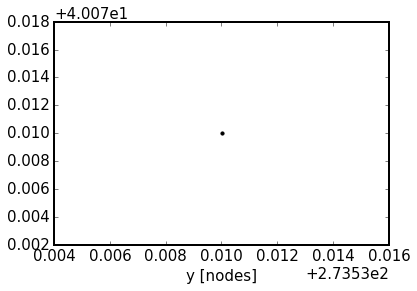

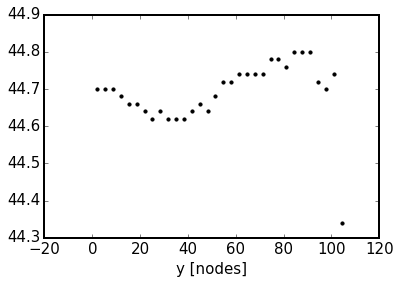

In [267]:
Plot_Points(Ss, plot_type='proj')
plt.figure()
Plot_Points(Rs, plot_type='proj')
# plt.gca().invert_zaxis()

In [268]:
Check_SR(proj_name, adjust=False, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj5-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj5-PointReceivers.pgy
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj5-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.60516
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [104.239998, 44.3400002, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 2 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [100.940002, 44.7400017, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [97.6600037, 44.7000008, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [94.3600006, 44.7200012, 12.239999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 5 above FS + margin 4.
lib_fwi_ge

NameError: global name 'quit' is not defined

### Runfile

In [269]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]
Update_Runfile(fname, NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj5-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 32
MAXRC : 32
 MAXPS         : 1
 io            : fw3d 
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOT

### PBS file

In [270]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="00:10:00", nnodes=1)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj5
#PBS -o proj5-Out.log
#PBS -e proj5-Err.log
#PBS -l walltime=00:10:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=1gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj5

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_name}-

## Run

### Locally

In [272]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
!cd "{proj_path}" && fwi_run_locally.sh synth 671 {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

### cx1

In [271]:
!cd "{proj_path}" && cp proj1-GhostData.bin {proj_name}'-GhostData.bin'
dir_name = Path_Leave(proj_path[ :-len('/input/')])
!cd "{proj_path}" &&  ssh_sync_project.sh kmc cx1 {dir_name}

sending incremental file list
./
binary
            400 100%    0.00kB/s    0:00:00 (xfr#1, to-chk=596/598)
header
          3,200 100%    3.05MB/s    0:00:00 (xfr#2, to-chk=592/598)
jupy_fwi_3D_OBS_only.ipynb
      2,031,496 100%   31.25MB/s    0:00:00 (xfr#3, to-chk=591/598)
proj1-RawSign.sgy
         11,840 100%  115.62kB/s    0:00:00 (xfr#4, to-chk=578/598)
proj2-Runfile.key
          1,455 100%   14.21kB/s    0:00:00 (xfr#5, to-chk=538/598)
proj5-ExtraPointReceivers.pgy
         16,433 100%  158.89kB/s    0:00:00 (xfr#6, to-chk=436/598)
proj5-ExtraReceivers.geo
         16,441 100%  158.97kB/s    0:00:00 (xfr#7, to-chk=435/598)
proj5-FreeSurf.vtr
        558,940 100%    4.72MB/s    0:00:00 (xfr#8, to-chk=434/598)
proj5-GhostData.bin
    274,747,664 100%   95.49MB/s    0:00:02 (xfr#9, to-chk=433/598)
proj5-Missing-Receivers.ps
         13,459 100%   17.60kB/s    0:00:00 (xfr#10, to-chk=432/598)
proj5-NumChecks.log
             52 100%    0.07kB/s    0:00:00 (xfr#11, to-chk=431/598)

## Output

# Proj 6 (same as proj1 but segy geometry; i/o fw3d; stable)

- proj1 but with geometry from SEGY headers of data
- RESULTS: proved to be stable => SR locations are not a problem!

## Input

In [3]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj6'
# !cd "{proj_path}" && pwd

In [70]:
# !cd "{proj_path}" && fwi_cp_project.sh -sp -cp proj1 {proj_name} .
!cd "{proj_path}" && ls -lthr {proj_name}*

-rwxrwxrwx 1 kajetan kajetan  452 Nov  2 18:09 proj6-SegyPrep.key
-rwxrwxrwx 1 kajetan kajetan  12K Nov  2 18:09 proj6-RawSign.sgy
-rwxrwxrwx 1 kajetan kajetan  21M Nov  2 18:09 proj6-TrueVp.vtr
-rwxrwxrwx 1 kajetan kajetan  34M Nov  2 18:09 proj6-TrueVp.sgy
-rwxrwxrwx 1 kajetan kajetan 546K Nov  2 18:09 proj6-FreeSurf.vtr
-rwxrwxrwx 1 kajetan kajetan 263M Nov  2 18:09 proj6-GhostData.bin


### Basic parameters

In [4]:
# SPACE-TIME DISCRETIZATION
dx = 50.00 # m
dt = 0.001 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# CHOOSE OBSes AT THE EDGES OF THE MODEL
obs_leftmost_box = '143'
obs_rightmost_box = '138'
box_pad = 10 # FIXME: WHY 10?
box_width = 4000 # m

# XY RANGES 
x1_box = obs_list[obs_leftmost_box].x - box_pad * dx
x2_box = obs_list[obs_rightmost_box ].x + box_pad * dx

mean_y_box = (obs_list[obs_leftmost_box].y + obs_list[obs_rightmost_box ].y) / 2.
y1_box = mean_y_box - box_width / 2.
y2_box = mean_y_box + box_width / 2.

# METRES->NODES CONVERSION
x1_box, y1_box = [int(i / dx) * dx for i in [x1_box, y1_box]]
x2_box, y2_box = [int(i / dx) * dx for i in [x2_box, y2_box]] # FIXME: ROUNDING DOWN!!!
x1_box, x2_box, y1_box, y2_box = [int(i) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box

# z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = 130 * dx # m
ttime = 10 # s

nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# VELOCITY MODEL
# vel = 1500 # m/s
# vel_min = 1500
# vel_max = 1500

# SOURCE WAVELET
f_max = 4 # Hz
f_peak = f_max / 2.
f_min = 0.1 # ???????????????? IS IT SET BY FW3D?

# PLOTTING
minn = 0
maxx = 8000
xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

# FIXME: MUST BE THE SAME AS AFTER 'Set_Aux_Variables', NOT AS IN THE RUNFILE
etop = 2
eleft = 5
efront = 5

z_pad = 5 # PADDING ABOVE HIGHEST POINT OF FS

# CHECKS
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

Check_Stability(f, dx, dt, vel, 'low')
# Check_Accuracy(f, dx, vel, f_max, 'low')
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -13600 15100 2100 6100
nx1 575
nx2 81
nx3_original 131
ns 10000
lib_num.py/Check_Stability: Courant number, C: 0.03



### Model

In [16]:
!cd "{proj_path}" && vtr2sgy


VTR to SEG-Y file conversion  -  v1.31
****************************

Output traces by in-line then x-line? (default = yes) >> ^C


### Source wavelet

In [44]:
# !cd "{proj_path}" && su_ricker.sh {proj_name} {f_peak} {dt} {ns}
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00140875 s, 2,3 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 849 requests (849 known processed) with 0 events remaining.


### Observed data

In [11]:
!cd "{proj_path}" && cp proj5-RawSeis.txt {proj_name}'-RawSeis.txt'
!cd "{proj_path}" && cat {proj_name}'-RawSeis.txt'

data/stations_lines/MGL1521_W140_4_line19.segy


### SegyPrep

In [17]:
print proj_name

nx3 = 113 # !!!
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj6

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj6
 Preparing files for synthetics...

 Grid points in-line:                    575
 Grid points cross-line:                  81
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            28700.0000    
 Model width (metres):             4000.00000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         1.00000000    
 Output data delta-T (ms):         1.00000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):         10000
 Time steps to model:                  10000

 Receiver-array fixed in space:          yes
 Renumber original channel numbers:       no
 Use FFID instead of SOURCE numbers:     yes
 FFID numbers are uniq

In [73]:
!cd "{proj_path}" && ls -lth

total 7,0G
-rwxrwxrwx 1 kajetan kajetan 2,0M Nov  2 18:11 jupy_fwi_3D_OBS_only.ipynb
-rwxrwxrwx 1 kajetan kajetan 1,6K Nov  2 18:11 proj6-SegyPrep.log
-rwxrwxrwx 1 kajetan kajetan 1,7K Nov  2 18:11 proj6-Skeleton.key
-rwxrwxrwx 1 kajetan kajetan  113 Nov  2 18:11 proj6-SourceSig-Time.log
-rwxrwxrwx 1 kajetan kajetan  40K Nov  2 18:11 proj6-SourceSig-Time.ttr
-rwxrwxrwx 1 kajetan kajetan   54 Nov  2 18:11 proj6-Observed-0000.log
-rwxrwxrwx 1 kajetan kajetan  113 Nov  2 18:11 proj6-PointSources.pgy
-rwxrwxrwx 1 kajetan kajetan  36K Nov  2 18:11 proj6-PointReceivers.pgy
-rwxrwxrwx 1 kajetan kajetan 8,9K Nov  2 18:11 proj6-Observed-0000.ttr
-rwxrwxrwx 1 kajetan kajetan  453 Nov  2 18:11 proj6-SegyPrep.key
-rwxrwxrwx 1 kajetan kajetan 263M Nov  2 18:09 proj6-GhostData.bin
-rwxrwxrwx 1 kajetan kajetan 546K Nov  2 18:09 proj6-FreeSurf.vtr
-rwxrwxrwx 1 kajetan kajetan  34M Nov  2 18:09 proj6-TrueVp.sgy
-rwxrwxrwx 1 kajetan kajetan  21M Nov  2 18:09 proj6-TrueVp.vtr
-rwxrwxrwx 1 kajetan kajetan

### Sources & receivers

lib_fwi_generic.py/Read_pgy:  File to read:  ./proj6-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  ./proj6-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

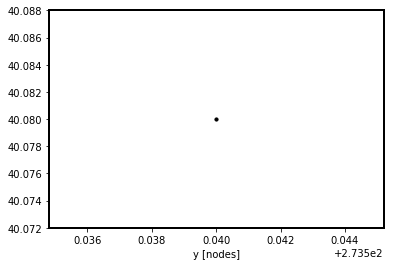

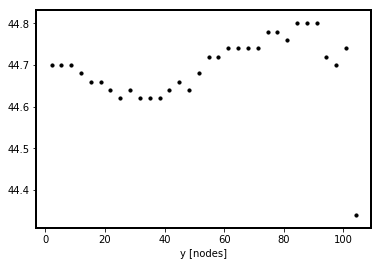

In [18]:
Plot_SR(proj_name)

In [39]:
z_sea = 12.5

In [40]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.pgy ARE MODIFIED)

for suffix in ['-PointSources', '-PointReceivers']:
    interfix = '_not_corrected'
    ext = '.pgy'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        z = line[1]
        y = line[2]
        x = line[3]
        z = str(z_sea + float(z))
        f.write(source_id + ' ' + z  + ' ' + y  + ' ' + x  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-PointSources
1 113 81 575 
4140 20.15999985 40.0800018 273.540009
-PointReceivers
32 113 81 575 
13215 12.739999995 44.3400002 104.239998
13216 12.739999995 44.7400017 100.940002
13217 12.739999995 44.7000008 97.6600037
13218 12.739999995 44.7200012 94.3600006
13219 12.739999995 44.7999992 91.0800018
13220 12.739999995 44.7999992 87.7799988
13221 12.739999995 44.7999992 84.4800034
13222 12.739999995 44.7599983 81.1999969
13223 12.739999995 44.7799988 77.8600006
13224 12.739999995 44.7799988 74.5800018
13225 12.739999995 44.7400017 71.2799988
13226 12.739999995 44.7400017 67.9800034
13227 12.739999995 44.7400017 64.6800003
13228 12.739999995 44.7400017 61.4000015
13229 12.739999995 44.7200012 58.0999985
13230 12.739999995 44.7200012 54.7999992
13231 12.739999995 44.6800003 51.5000000
13232 12.739999995 44.6399994 48.2200012
13233 12.739999995 44.6599998 44.9199982
13234 12.739999995 44.6399994 41.6199989
13235 12.739999995 44.6199989 38.3199997
13236 12.739999995 44.6199989 35.0400009


In [37]:
suffix = '-FreeSurf_exten.vtr'
!cd "{proj_path}" && cp proj1{suffix} {proj_name}{suffix}

In [41]:
Check_SR(proj_name, adjust=False, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_pgy:  File to read:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj6-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj6-PointReceivers.pgy
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj6-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.6051607
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  575 81 1


lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [104.239998, 44.3400002, 12.739999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 2 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [100.940002, 44.7400017, 12.739999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [97.6600037, 44.7000008, 12.739999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [94.3600006, 44.7200012, 12.739999995]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 5 above FS + margin 4.
lib_fwi_ge

NameError: global name 'quit' is not defined

### Runfile

In [42]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]
Update_Runfile(fname, NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj6-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 32
MAXRC : 32
 MAXPS         : 1
 io            : fw3d 
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOT

## Run

In [43]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
!cd "{proj_path}" && fwi_run_locally.sh synth 688_test {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

^C


# Proj 7 (-||- but i/o segy; stable)

- same as proj6 but run as SEGY.
- also stable, as expected.

## Input

In [4]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj7'
# !cd "{proj_path}" && pwd

In [47]:
!cd "{proj_path}" && fwi_cp_project.sh -p -cp proj6 {proj_name} . proj6-*


fwi_cp_project.sh: START

fwi_cp_project.sh: Files read as command line arguments...
fwi_cp_project.sh: List of processed files (without the project name):
-Err.log
-ExtraPointReceivers.pgy
-ExtraReceivers.geo
-FreeSurf.vtr
-FreeSurf_exten.vtr
-GhostData.bin
-Missing-Receivers.ps
-NumChecks.log
-Observed-0000.log
-Observed-0000.ttm
-Observed-0000.ttr
-Observed-0000.txt
-Out.log
-OutSeis.sgy
-PointReceivers.pgy
-PointReceivers_not_corrected.pgy
-PointSources.pgy
-PointSources_not_corrected.pgy
-RawSeis.txt
-RawSign.sgy
-Receivers.geo
-Retained-Receivers.ps
-Retained-Sources.ps
-Runfile.key
-Runfile_inv.key
-Runfile_synth.key
-SegyPrep.key
-SegyPrep.log
-Signature.hed
-Signature.idx
-Signature.sgy
-Skeleton.key
-SourceSig-Time.log
-SourceSig-Time.ttr
-Sources.geo
-Template.hed
-Template.idx
-Template.sgy
-TrueVp.sgy
-TrueVp.vtr
-fw-000200-csref00001-iter00001-taskid00001.vtr
-fw-000300-csref00001-iter00001-taskid00001.vtr
-fw-000400-csref00001-iter00001-taskid00001.vtr
-fw-000500-csref0

### SegyPrep

In [24]:
z_sea = 12.5 # nodes
dx = 50 # m

In [25]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 28700.0000 4000.0000 5600.0000 
4140 13627.0000 1954.00012 1008.0
-Receivers
32 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 637.0
13216 4997.00000 2187.00000 637.0
13217 4833.00000 2185.00000 637.0
13218 4668.00000 2186.00000 637.0
13219 4504.00000 2190.00000 637.0
13220 4339.00000 2190.00000 637.0
13221 4174.00000 2190.00000 637.0
13222 4009.99976 2188.00000 637.0
13223 3843.00000 2189.00000 637.0
13224 3679.00000 2189.00000 637.0
13225 3514.00000 2187.00000 637.0
13226 3349.00024 2187.00000 637.0
13227 3184.00000 2187.00000 637.0
13228 3020.00000 2187.00000 637.0
13229 2855.00000 2186.00000 637.0
13230 2690.00000 2186.00000 637.0
13231 2525.00000 2184.00000 637.0
13232 2361.00000 2182.00000 637.0
13233 2196.00000 2183.00000 637.0
13234 2031.00000 2182.00000 637.0
13235 1866.00000 2181.00000 637.0
13236 1702.00000 2181.00000 637.0
13237 1537.00000 2181.00000 637.0
13238 1372.00000 2182.00000 637.0
13239 1208.00000 2181.00000 637.0
13240 1043.00000 2182.00000

In [23]:
print (z_sea + 0.239999995) * dx 
print (z_sea + 7.65999985) * dx 

636.99999975
1007.9999925


In [22]:
!cd "{proj_path}" && cat {proj_name}'-PointSources.pgy'
!cd "{proj_path}" && cat {proj_name}'-PointReceivers.pgy'

           1         113          81         575
        4140   7.65999985       40.0800018       273.540009    
          32         113          81         575
       13215  0.239999995       44.3400002       104.239998    
       13216  0.239999995       44.7400017       100.940002    
       13217  0.239999995       44.7000008       97.6600037    
       13218  0.239999995       44.7200012       94.3600006    
       13219  0.239999995       44.7999992       91.0800018    
       13220  0.239999995       44.7999992       87.7799988    
       13221  0.239999995       44.7999992       84.4800034    
       13222  0.239999995       44.7599983       81.1999969    
       13223  0.239999995       44.7799988       77.8600006    
       13224  0.239999995       44.7799988       74.5800018    
       13225  0.239999995       44.7400017       71.2799988    
       13226  0.239999995       44.7400017       67.9800034    
       13227  0.239999995       44.7400017       64.6800003    
      

### Runfile

In [7]:
# !cd "{proj_path}" && cat {proj_name}-Runfile.key
!cd "{proj_path}" && sed -i -e 's/fw3d/segy/g' {proj_name}-Runfile.key
!cd "{proj_path}" && sed -i -e 's/fw3d/segy/g' {proj_name}-Runfile_synth.key
!cd "{proj_path}" && sed -i -e 's/fw3d/segy/g' {proj_name}-Runfile_inv.key
!cd "{proj_path}" && cat {proj_name}-Runfile_synth.key

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 32
MAXRC : 32
 MAXPS         : 1
 io            : segy 
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY MODEL
 velcut : 1542  ! 1542 BASED ON MP'S FILE wa

## Run

### Locally

In [ ]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
!cd "{proj_path}" && fwi_run_locally.sh synth 688_test {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

# Proj 8 (-||- but MP wavelet; stable)

- same as proj7 but a real (experimental) source wavelet
- ALSO STABLE!

## Input

In [4]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj8'
# !cd "{proj_path}" && pwd

In [28]:
old_proj = 'proj7'
!cd "{proj_path}" && fwi_cp_project.sh -p -cp {old_proj} {proj_name} . {old_proj}*


fwi_cp_project.sh: START

fwi_cp_project.sh: Files read as command line arguments...
fwi_cp_project.sh: List of processed files (without the project name):
-Err.log
-ExtraPointReceivers.pgy
-ExtraReceivers.geo
-FreeSurf.vtr
-FreeSurf_exten.vtr
-GhostData.bin
-Missing-Receivers.ps
-NumChecks.log
-Observed-0000.log
-Observed-0000.ttm
-Observed-0000.ttr
-Observed-0000.txt
-Out.log
-OutSeis.sgy
-PointReceivers.pgy
-PointReceivers_not_corrected.pgy
-PointSources.pgy
-PointSources_not_corrected.pgy
-RawSeis.txt
-RawSign.sgy
-Receivers.geo
-Receivers_not_corrected.geo
-Retained-Receivers.ps
-Retained-Sources.ps
-Runfile.key
-Runfile_inv.key
-Runfile_synth.key
-SegyPrep.key
-SegyPrep.log
-Signature.hed
-Signature.idx
-Signature.sgy
-Skeleton.key
-SourceSig-Time.log
-SourceSig-Time.ttr
-Sources.geo
-Sources_not_corrected.geo
-Template.hed
-Template.idx
-Template.sgy
-TrueVp.sgy
-TrueVp.vtr
-fw-000100-csref04140-iter00001-taskid00001.vtr
-fw-000200-csref04140-iter00001-taskid00001.vtr
-fw-00030

### Basic parameters

In [52]:
dx = 50 # m
dt = 0.005 # s # IT' UNSTABLE FOR 
vel_min = 1500 # m/s
vel_max = 8000 # m/s
f_max = 7 # Hz
f = open(proj_path + proj_name + '-NumChecks.log', 'w')

In [53]:
Check_Stability(f, dx, dt, vel_max, 'low')

lib_num.py/Check_Stability: C_max = 0.5, C = 0.8
lib_num.py/Check_Stability: Error! Unstable for low kernel.
lib_num.py/Check_Stability: Possible solutions which will work independently: 
lib_num.py/Check_Stability: 1. Decrease v_max of the model below: 5000.0 m/s
lib_num.py/Check_Stability: 2. Increase grid cell above: 80.0 m
lib_num.py/Check_Stability: 3. Decrease time step below: 0.003125 s


NameError: global name 'quit' is not defined

In [54]:
Check_Accuracy(f, dx, vel_min, f_max, 'low')

lib_num.py/Check_Accuracy: f_allowed = 6, f_max = 7
lib_num.py/Check_Accuracy: Error! Inaccurate for low kernel
lib_num.py/Check_Accuracy: Possible solutions which will work independently: 
lib_num.py/Check_Accuracy: 1. Decrease f_max below: 6 Hz
lib_num.py/Check_Accuracy:   (Decrease f_peak below: 3.0 Hz)
lib_num.py/Check_Accuracy: 2. Decrease grid cell below: 42 m
lib_num.py/Check_Accuracy: 3. Increase v_min of the model above: 1750 m/s


NameError: global name 'quit' is not defined

In [ ]:
# Max_Resolution(f, dx, vel, f_max)
# Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

f.close()

### Source wavelet

In [30]:
suffix = "-RawSign.sgy"
!cd "{proj_path}" && cp proj4{suffix} {proj_name}{suffix} 

In [34]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-RawSign.sgy' | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}'-RawSign.sgy' | suxwigb
!cd "{proj_path}" && sgyread.sh {proj_name}'-RawSign.sgy' | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00138071 s, 2,3 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 4427 requests (4427 known processed) with 0 events remaining.


### SegyPrep

In [35]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 28700.0000 4000.0000 5600.0000 
4140 13627.0000 1954.00012 1008.0
-Receivers
32 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 637.0
13216 4997.00000 2187.00000 637.0
13217 4833.00000 2185.00000 637.0
13218 4668.00000 2186.00000 637.0
13219 4504.00000 2190.00000 637.0
13220 4339.00000 2190.00000 637.0
13221 4174.00000 2190.00000 637.0
13222 4009.99976 2188.00000 637.0
13223 3843.00000 2189.00000 637.0
13224 3679.00000 2189.00000 637.0
13225 3514.00000 2187.00000 637.0
13226 3349.00024 2187.00000 637.0
13227 3184.00000 2187.00000 637.0
13228 3020.00000 2187.00000 637.0
13229 2855.00000 2186.00000 637.0
13230 2690.00000 2186.00000 637.0
13231 2525.00000 2184.00000 637.0
13232 2361.00000 2182.00000 637.0
13233 2196.00000 2183.00000 637.0
13234 2031.00000 2182.00000 637.0
13235 1866.00000 2181.00000 637.0
13236 1702.00000 2181.00000 637.0
13237 1537.00000 2181.00000 637.0
13238 1372.00000 2182.00000 637.0
13239 1208.00000 2181.00000 637.0
13240 1043.00000 2182.00000

In [41]:
# !cd "{proj_path}" && sgyread.sh {proj_name}'-Signature.sgy' | surange
# !cd "{proj_path}" && sgyread.sh {proj_name}'-Signature.sgy' | suxwigb
!cd "{proj_path}" && sgyread.sh {proj_name}'-Signature.sgy' | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00248871 s, 1,3 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1150 requests (1150 known processed) with 0 events remaining.


## Run

## Output

lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-000100-csref04140-iter00001-taskid00001.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3838.5066
lib_fwi_generic.py/Read_vtr: max value:  15.843356
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-000600-csref04140-iter00001-taskid00001.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1108.1348
lib_fwi_generic.py/Read_vtr: max value:  6330.2354
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-001100-csref04140-iter00001-taskid00001.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -563.23627
lib_fwi_generic.py/Read_vtr: max value:  558.7918
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-001600-csref04140-iter00001-taskid00001.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -565.7193
lib_fwi_generic.py/Read_vtr: max value:  688.74506
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-002100-csref04140-iter00001-taskid00001.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -703.6681
lib_fwi_generic.py/Read_vtr: max value:  619.36725
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-002600-csref04140-iter00001-taskid00001.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -656.85376
lib_fwi_generic.py/Read_vtr: max value:  592.3839
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)
lib_fwi_generic.py/Read_vtr:  File:  /media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj8-fw-003100-csref04140-iter00001-taskid00001.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -601.4946
lib_fwi_generic.py/Read_vtr: max value:  668.2312
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  585 91 120
libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


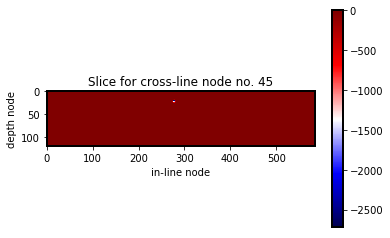

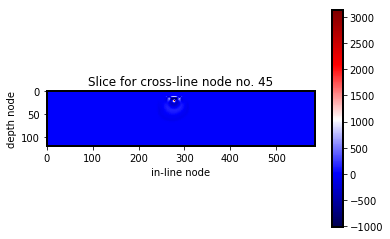

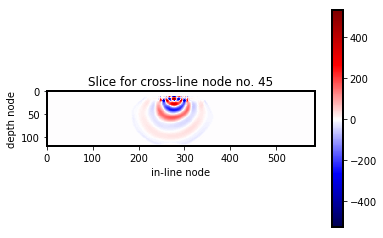

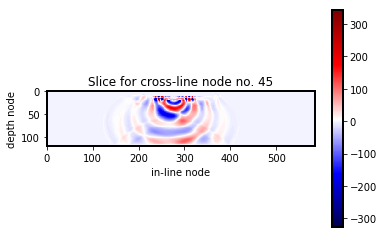

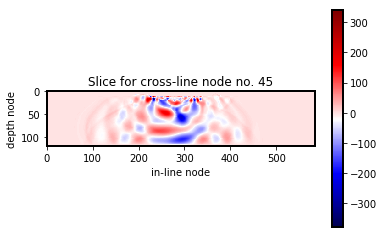

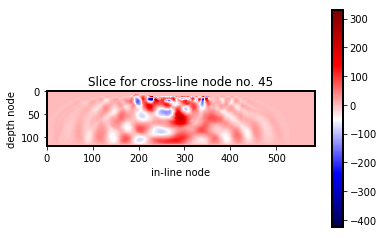

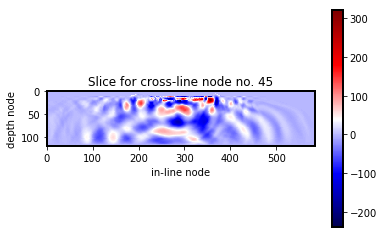

In [8]:
fnames = Get_Files(proj_path, proj_name + '-fw*vtr')
i = -1
for fname in fnames:
    i += 1
    
    if not i % 5 == 0:
        continue
    plt.figure()
    Plot_Gridded_Data_From_File(fname, yslice=45, cmap='seismic0', aspect='equal')

# Proj 9  (PROOF that too high $dt \Rightarrow$ instability)

- same as proj8 but dt = 5 ms
- UNSTABLE => this was the reason!!!!

## Input

In [9]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj9'
# !cd "{proj_path}" && pwd

In [15]:
old_proj = 'proj8'
!cd "{proj_path}" && fwi_cp_project.sh -p -cp {old_proj} {proj_name} . {old_proj}*


fwi_cp_project.sh: START

fwi_cp_project.sh: Files read as command line arguments...
fwi_cp_project.sh: List of processed files (without the project name):
-Err.log
-ExtraPointReceivers.pgy
-ExtraReceivers.geo
-FreeSurf.vtr
-FreeSurf_exten.vtr
-GhostData.bin
-Missing-Receivers.ps
-NumChecks.log
-Observed-0000.log
-Observed-0000.ttm
-Observed-0000.ttr
-Observed-0000.txt
-Out.log
-OutSeis.sgy
-PointReceivers.pgy
-PointReceivers_not_corrected.pgy
-PointSources.pgy
-PointSources_not_corrected.pgy
-RawSeis.txt
-RawSign.sgy
-Receivers.geo
-Receivers_not_corrected.geo
-Retained-Receivers.ps
-Retained-Sources.ps
-Runfile.key
-Runfile_inv.key
-Runfile_synth.key
-SegyPrep.key
-SegyPrep.log
-Signature.hed
-Signature.idx
-Signature.sgy
-Skeleton.key
-SourceSig-Time.log
-SourceSig-Time.ttr
-Sources.geo
-Sources_not_corrected.geo
-Template.hed
-Template.idx
-Template.sgy
-TrueVp.sgy
-TrueVp.vtr

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 3 s


### SegyPrep

In [17]:
!cd "{proj_path}" && sed -i -e "s/dtms : 1.0/dtms : 5.0/g" {proj_name}-SegyPrep.key
!cd "{proj_path}" && cat {proj_name}-SegyPrep.key

y origin : 2100
fixed array : yes
dtms : 5.0
io api : both
nx1 : 575
x origin : -13600
nx2 : 81
z type : elevation
reciprocity : yes
text : yes
ttime : 10000.0
x shift : 0
y shift : 0
dx : 50.0
unique : yes
FFID : yes
nx3 : 113
geometry : segy
debug : yes
retain : yes
problem : synthetic
outseis : yes


In [ ]:
# run segyprep_v3.16 in the console

In [22]:
z_sea = 12.5
dx = 50 # m

In [24]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 28700.0000 4000.0000 5600.0000 
4140 13627.0000 1954.00012 1008.0
-Receivers
32 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 637.0
13216 4997.00000 2187.00000 637.0
13217 4833.00000 2185.00000 637.0
13218 4668.00000 2186.00000 637.0
13219 4504.00000 2190.00000 637.0
13220 4339.00000 2190.00000 637.0
13221 4174.00000 2190.00000 637.0
13222 4009.99976 2188.00000 637.0
13223 3843.00000 2189.00000 637.0
13224 3679.00000 2189.00000 637.0
13225 3514.00000 2187.00000 637.0
13226 3349.00024 2187.00000 637.0
13227 3184.00000 2187.00000 637.0
13228 3020.00000 2187.00000 637.0
13229 2855.00000 2186.00000 637.0
13230 2690.00000 2186.00000 637.0
13231 2525.00000 2184.00000 637.0
13232 2361.00000 2182.00000 637.0
13233 2196.00000 2183.00000 637.0
13234 2031.00000 2182.00000 637.0
13235 1866.00000 2181.00000 637.0
13236 1702.00000 2181.00000 637.0
13237 1537.00000 2181.00000 637.0
13238 1372.00000 2182.00000 637.0
13239 1208.00000 2181.00000 637.0
13240 1043.00000 2182.00000

## Run

# Proj 10 ($dt = 2.5$ ms; stable)

- same as proj9 and proj8 but dtms = 2.5 ms (same as Jo's)

## Input

In [25]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj10'
# !cd "{proj_path}" && pwd

In [26]:
old_proj = 'proj8'
!cd "{proj_path}" && fwi_cp_project.sh -p -cp {old_proj} {proj_name} . {old_proj}*


fwi_cp_project.sh: START

fwi_cp_project.sh: Files read as command line arguments...
fwi_cp_project.sh: List of processed files (without the project name):
-Err.log
-ExtraPointReceivers.pgy
-ExtraReceivers.geo
-FreeSurf.vtr
-FreeSurf_exten.vtr
-GhostData.bin
-Missing-Receivers.ps
-NumChecks.log
-Observed-0000.log
-Observed-0000.ttm
-Observed-0000.ttr
-Observed-0000.txt
-Out.log
-OutSeis.sgy
-PointReceivers.pgy
-PointReceivers_not_corrected.pgy
-PointSources.pgy
-PointSources_not_corrected.pgy
-RawSeis.txt
-RawSign.sgy
-Receivers.geo
-Receivers_not_corrected.geo
-Retained-Receivers.ps
-Retained-Sources.ps
-Runfile.key
-Runfile_inv.key
-Runfile_synth.key
-SegyPrep.key
-SegyPrep.log
-Signature.hed
-Signature.idx
-Signature.sgy
-Skeleton.key
-SourceSig-Time.log
-SourceSig-Time.ttr
-Sources.geo
-Sources_not_corrected.geo
-Template.hed
-Template.idx
-Template.sgy
-TrueVp.sgy
-TrueVp.vtr

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 3 s


### SegyPrep

In [27]:
!cd "{proj_path}" && sed -i -e "s/dtms : 1.0/dtms : 2.5/g" {proj_name}-SegyPrep.key
!cd "{proj_path}" && cat {proj_name}-SegyPrep.key

y origin : 2100
fixed array : yes
dtms : 2.5
io api : both
nx1 : 575
x origin : -13600
nx2 : 81
z type : elevation
reciprocity : yes
text : yes
ttime : 10000.0
x shift : 0
y shift : 0
dx : 50.0
unique : yes
FFID : yes
nx3 : 113
geometry : segy
debug : yes
retain : yes
problem : synthetic
outseis : yes


In [ ]:
# run segyprep_v3.16 in the console

In [29]:
z_sea = 12.5
dx = 50 # m

# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 28700.0000 4000.0000 5600.0000 
4140 13627.0000 1954.00012 1008.0
-Receivers
32 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 637.0
13216 4997.00000 2187.00000 637.0
13217 4833.00000 2185.00000 637.0
13218 4668.00000 2186.00000 637.0
13219 4504.00000 2190.00000 637.0
13220 4339.00000 2190.00000 637.0
13221 4174.00000 2190.00000 637.0
13222 4009.99976 2188.00000 637.0
13223 3843.00000 2189.00000 637.0
13224 3679.00000 2189.00000 637.0
13225 3514.00000 2187.00000 637.0
13226 3349.00024 2187.00000 637.0
13227 3184.00000 2187.00000 637.0
13228 3020.00000 2187.00000 637.0
13229 2855.00000 2186.00000 637.0
13230 2690.00000 2186.00000 637.0
13231 2525.00000 2184.00000 637.0
13232 2361.00000 2182.00000 637.0
13233 2196.00000 2183.00000 637.0
13234 2031.00000 2182.00000 637.0
13235 1866.00000 2181.00000 637.0
13236 1702.00000 2181.00000 637.0
13237 1537.00000 2181.00000 637.0
13238 1372.00000 2182.00000 637.0
13239 1208.00000 2181.00000 637.0
13240 1043.00000 2182.00000

## Run

# Proj 11 (=> spread_bounce works)

- just checking if my modification of spread_bounce and a new runfile keyword (seaLevel) work
- same as proj8 but this time source (OBS) moved at the same Z-coord as shots to see if spread_bounce works correctly

## Input

In [4]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj11'
# !cd "{proj_path}" && pwd

In [5]:
old_proj = 'proj8'
!cd "{proj_path}" && fwi_cp_project.sh -p -cp {old_proj} {proj_name} . {old_proj}*


fwi_cp_project.sh: START

fwi_cp_project.sh: Files read as command line arguments...
fwi_cp_project.sh: List of processed files (without the project name):
-Err.log
-ExtraPointReceivers.pgy
-ExtraReceivers.geo
-FreeSurf.vtr
-FreeSurf_exten.vtr
-GhostData.bin
-Missing-Receivers.ps
-NumChecks.log
-Observed-0000.log
-Observed-0000.ttm
-Observed-0000.ttr
-Observed-0000.txt
-Out.log
-OutSeis.sgy
-PointReceivers.pgy
-PointReceivers_not_corrected.pgy
-PointSources.pgy
-PointSources_not_corrected.pgy
-RawSeis.txt
-RawSign.sgy
-Receivers.geo
-Receivers_not_corrected.geo
-Retained-Receivers.ps
-Retained-Sources.ps
-Runfile.key
-Runfile_inv.key
-Runfile_synth.key
-SegyPrep.key
-SegyPrep.log
-Signature.hed
-Signature.idx
-Signature.sgy
-Skeleton.key
-SourceSig-Time.log
-SourceSig-Time.ttr
-Sources.geo
-Sources_not_corrected.geo
-Template.hed
-Template.idx
-Template.sgy
-TrueVp.sgy
-TrueVp.vtr

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 9 s


### Sources & receivers

In [6]:
seaLevel = 12.5 * 50 
print seaLevel

625.0


In [10]:
!cd "{proj_path}" && cat {proj_name}'-Sources.geo' 
!cd "{proj_path}" && sed -i -e "s/1008.0/637.0/g" {proj_name}'-Sources.geo' 
!cd "{proj_path}" && cat {proj_name}'-Receivers.geo'

1 28700.0000 4000.0000 5600.0000 
4140 13627.0000 1954.00012 637.0
32 28700.0000 4000.0000 5600.0000 
13215 5162.00000 2167.00000 637.0
13216 4997.00000 2187.00000 637.0
13217 4833.00000 2185.00000 637.0
13218 4668.00000 2186.00000 637.0
13219 4504.00000 2190.00000 637.0
13220 4339.00000 2190.00000 637.0
13221 4174.00000 2190.00000 637.0
13222 4009.99976 2188.00000 637.0
13223 3843.00000 2189.00000 637.0
13224 3679.00000 2189.00000 637.0
13225 3514.00000 2187.00000 637.0
13226 3349.00024 2187.00000 637.0
13227 3184.00000 2187.00000 637.0
13228 3020.00000 2187.00000 637.0
13229 2855.00000 2186.00000 637.0
13230 2690.00000 2186.00000 637.0
13231 2525.00000 2184.00000 637.0
13232 2361.00000 2182.00000 637.0
13233 2196.00000 2183.00000 637.0
13234 2031.00000 2182.00000 637.0
13235 1866.00000 2181.00000 637.0
13236 1702.00000 2181.00000 637.0
13237 1537.00000 2181.00000 637.0
13238 1372.00000 2182.00000 637.0
13239 1208.00000 2181.00000 637.0
13240 1043.00000 2182.00000 637.0
13241 878.0000

### Runfile

In [13]:
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 575
NX2 : 81
NX3 : 113
 DX            : 50.0
 etime         : 10
! X. FREE SURFACE
 ibfs          : 1
 vacuum        : 0
 seaLevel      : 12.5
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
 NCOMP         : 1
 NSHOTS        : 1
NRECS : 32
MAXRC : 32
 MAXPS         : 1
 io            : segy 
! D. BOUNDARY CONDITIONS
 btop          : 0
 bbot          : 0
 bleft         : 0
 bright        : 0
 bfront        : 0
 bback         : 0
 extratop      : 0
 extrabot      : 5
 extraleft     : 5
 extraright    : 5
 extrafront    : 5
 extraback     : 5
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY MODEL
 velcut : 1542  ! 1542

## Run

## Output

In [27]:
# TRANSCRIBED FROM RUNFILE
srcx = 273.540009
srcy = 40.0800018 
srcz = 637 / 50.

# CORRECTED WITH EXTRA NODES
etop = 0
efront = 0 
eleft = 5

srcx += eleft
srcy += efront
srcz = srcz + etop + 2

In [24]:
# !cd "{proj_path}" && ls -lthr
v = 1e-30

# from lib_fwi_generic import read_wavefield
from libplot_generic import Plot_Gridded_Data

fnames = Get_Files(proj_path, proj_name +'-snap*txt')
for fname in fnames:
    print fname 
    c = Read_File(fname)
#     print c
#     continue
    extn1, extn2, extn3 = [int(i) for i in c[0]]
    data = [float(i[0]) for i in c[1: ]]
    model = []
    i = 0
    for x in range(extn1):
        xslice = []
        for y in range(extn2):
            trace = []
            for z in range(extn3):
                trace.append(data[i])
                i += 1
            xslice.append(trace)
        model.append(xslice)
#     print len(model), len(model[0]), len(model[0][0])
    model = np.array(model)
#     fsiz = 7
#     plt.figure(figsize = [fsiz, fsiz])
#     Plot_Gridded_Data(model, data_type='model', plot_type='slice', yslice=0, cmap='seismic0', minn=-v, maxx=v)
#     r = 8
#     plt.xlim(srcx - r, srcx + r)
#     plt.ylim(srcz + r, srcz - r)
#     plt.grid()
#     plt.gca().set_aspect('equal')
# #     plt.xticks(range(srcx - r, srcx + r + 1))
# #     plt.yticks(range(srcz - r, srcz + r + 1))
#     break

/media/kajetan/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj11-snap000010.txt


libplot_generic.py/Plot_Slice:  (120, 585) (120, 585) (120, 585)


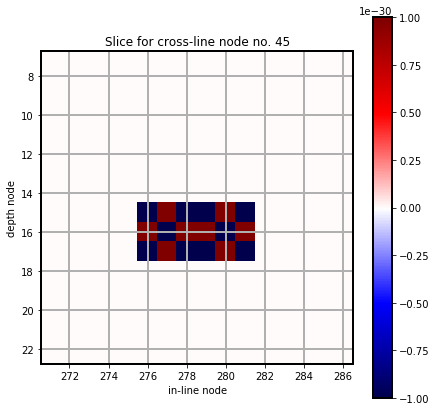

In [29]:
fsiz = 7
plt.figure(figsize = [fsiz, fsiz])
Plot_Gridded_Data(model, data_type='model', plot_type='slice', yslice=45, cmap='seismic0', minn=-v, maxx=v)
r = 8
plt.xlim(srcx - r, srcx + r)
plt.ylim(srcz + r, srcz - r)
plt.grid()
plt.gca().set_aspect('equal')
#     plt.xticks(range(srcx - r, srcx + r + 1))
#     plt.yticks(range(srcz - r, srcz + r + 1))
#     break

# Proj 12 (improved, full workflow)

## About

- geometry from Jo's synthetic project (a hand-out for Jack)

- at the moment only OBS stations are used because this approach doesn't require: 
    - matching $p$ and $\vec{v}$ data, in particular simulating sources that sit exactly at FS
    - a new source wavelet for land stations (which is more tricky since we can't use direct water-waves)
    - in the synthetic run, accounting for reciprocal sources which are close to FS (but in inversion we have to do it anyway, during the backpropagation)
    
- a few problems had to be solved:
    - sources close to FS - after noticing that all proximal sources are (backpropagated) airgun shots which sit below FLAT sea surface, I decided to tweak Adrian's procedure 'spread_bounce' so that the default FS at node z=0 (or z=1 when btop=-99) is moved to z=sea_level. 
        - this change is limited to the source-injection procedures and does not affect the further propagation of the wavefield.
        - the motivation was to have an identical scheme for all the sources and the easiest way to ensure this is to use already implemented method.
        - a completely new iterative scheme which I created exists at the moment in 2 versions ready to merge as soon as it is needed: 
            - the older already plugged into my local copy of Fullwave3D. It is probably not efficient enough for real problems
            - the newer, implemented in Python, more thoroughly tested. It needs to be transcribed to Fortran. In particular we need to pass source coefficients.
    - reading from disk in multi-node jobs

## Input

In [6]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj12'
# !cd "{proj_path}" && pwd

### Basic parameters

In [326]:
# SPACE-TIME DISCRETIZATION
dx = 50.000 # m
dt = 0.0025 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# XY RANGES 
x1_box = -3e4 
x2_box = 3e4 
y1_box = -5e3 
y2_box =  15e3

# ROUNDING DOWN
x1_box, x2_box, y1_box, y2_box = [int(i / dx) * int(dx) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box
# NOTE: z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = (131 - 1) * dx # m # 131 IS NX3 OF THE MODEL FROM UO
ttime = 15 # s # 10 IS NOT ENOUGH TO INCLUDE ALL MANUAL PICKS!

# METRES->NODES CONVERSION
nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# ABSORBING BOUNDARIES
b_abs = 40 # VALUES FROM DEFAULT -Skeleton.key GENERATED
e_abs = 50 # BY SegyPrep 3.16

# VELOCITY MODEL
v_air_ben = 0 # VELOCITY OF THE AIR LAYER IN BEN'S MODEL
z_pad = 5 # NO. OF NODES LEFT BETWEEN THE HIGHEST POINT OF THE FREE SURFACE AND 1ST NODE OF THE GRID

# SOURCE WAVELET (TO BE READ FROM FILE)

# PLOTTING
minn = 0
maxx = 8000
xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -30000 30000 -5000 15000
nx1 1201
nx2 401
nx3_original 131
ns 6000


### Model

- some of the cells need FS data (e.g. to fill up the gaps) => the order is wrong (but some FS cells need model data too)

#### Prepare

##### Cut in both XY and Z

In [65]:
# CUT IN XY
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

# CUT IN Z (MUST BE PROCEEDED WITH XY-CUTTING EVERY TIME)
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = Model_Check_Highest_Topo(model, v_air_ben)
z_min = topo_min[-1] - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min # IMPORTANT!
print 'nx3 after the cut(!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00175841 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2674e-05 s, 44.0 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 1201
convert_sgy2vtr.sh: nx2= 401
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj12-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj12-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00176052 s, 1.8 MB/s
n1=131 n2=481601 d1=0.000050
nt=131 ntr=481601 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 4 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj12-TrueVp.bin
n=481601

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 40 s
lib_fwi_generic.py/Save_vtr: File to save:  proj12-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 40

##### Determine the sea level

- free surface can only be determined from the model with the accuracy dx
- any value between n_air (no. of nodes of air) and (n_air+dx) is then equally justified
- therefore natural seems to be the choice of z_sea = n_air + 0.5*dx
- spread_bounce, however, requires integer values of FS => z_sea = n_air or z_sea = n_air + dx
- inspection of synthetics can help choosing one of the two.

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


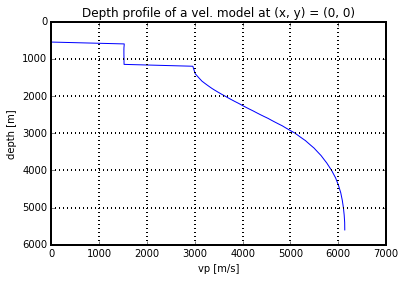

In [66]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, v in enumerate(sea_xy):
    if v != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps below finer FS with non-air velocities

- apparently in Ben's model there are rock-gaps below FS due to coarser sampling (200 m) of FS used in tomography 

In [70]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

model = Model_Modify_Fill_Gaps(model, v_air_ben, proj_name)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0] # FIXME: NEEDS FS 
# nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

# for ix in range(nx1_mod):
#     for iy in range(nx2_mod):
#         for iz in np.arange(nx3_mod-1, -1, -1):
#             if (iz + 1) >= fs_z[ix][iy][0]:
#                 if model[ix][iy][iz] == 0:
#                     #print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
#                     model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  .//proj12-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
lib_fwi_generic.py/Save_vtr: File to save:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj12-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 401 1201


0

###### Plot

In [37]:
# fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# plt.xlim(375, 384)
# plt.ylim(13, 11)
# plt.grid()

##### Set air velocity

- extrapolate above FS to avoid, just in case, possible 'air leaks' below FS
- it needs to be done after two previous steps because we exploit the v_air_ben = 0.

In [75]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

model = Modify_Model_Set_Air_Vel(model, v_air_ben, 'extrapol')
        
Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Save_vtr: File to save:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj12-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 401 1201


0

##### Convert vtr2segy

In [109]:
# !cd "{proj_path}" && vtr2sgy # DO IT IN THE CONSOLE INSTEAD

fname = proj_name + '-TrueVp.sgy'
fname_tmp = fname + '_tmp' # OTHERWISE SU FAILS TO SAVE CORRECTLY
!cd "{proj_path}" && sgyread.sh {fname} | sushw key=dt,ns a={int(dx)},{nx3} | segyhdrs | segywrite tape={fname_tmp}
!cd "{proj_path}" && mv {fname_tmp} {fname}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160963 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2338e-05 s, 34.7 MB/s


In [110]:
!cd "{proj_path}" && sgyread.sh proj12-TrueVp.sgy | suwind key=ep min={ycoord} max={ycoord} | suximage

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00200884 s, 1.6 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 960 requests (960 known processed) with 0 events remaining.


#### Plot

In [ ]:
# COLORMAPS: 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice:  (113, 1201) (113, 1201) (113, 1201)
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-FreeSurf.vtr


libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice:  (113, 401) (113, 401) (113, 401)
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-FreeSurf.vtr


libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


libplot_generic.py/Plot_Slice:  (401, 1201) (401, 1201) (401, 1201)


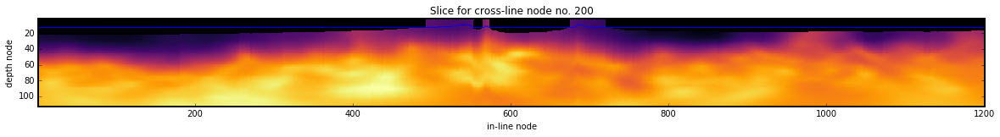

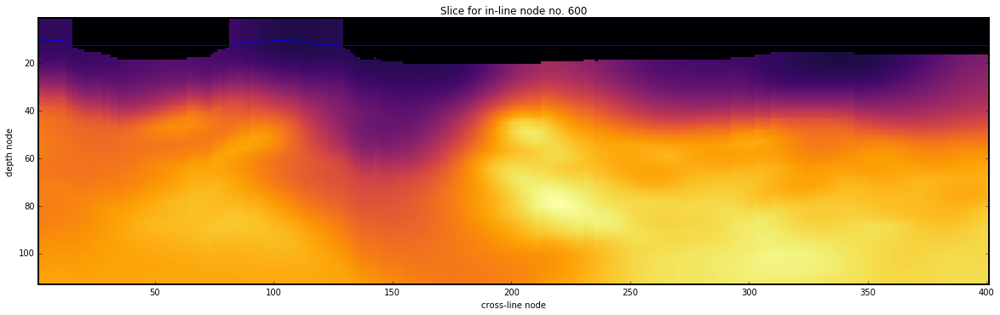

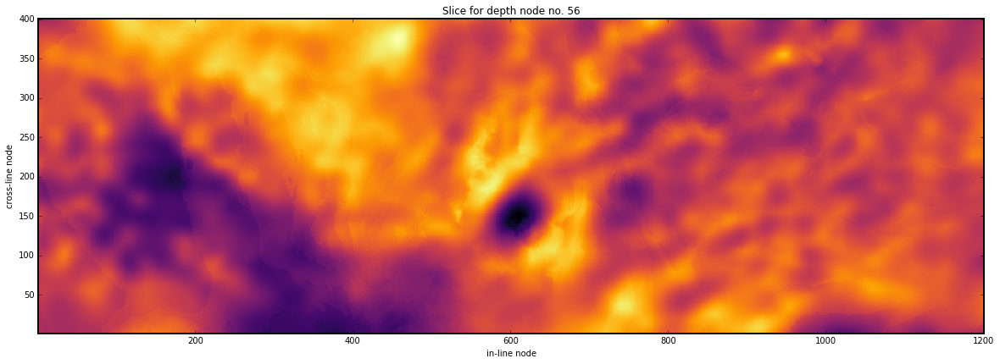

In [77]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
fname_fs = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

# Y-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord, cbar=0)
Plot_Gridded_Data_From_File(fname_fs, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx1)
plt.ylim(nx3, 1)
plt.gca().set_aspect('equal')
    
# X-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', xslice=xcoord, cbar=0)
Plot_Gridded_Data_From_File(fname_fs, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx2)
plt.ylim(nx3, 1)
plt.gca().set_aspect('equal')

# Z-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', zslice=zcoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx1)
plt.ylim(1, nx2)
plt.gca().set_aspect('equal')

### Free surface

- it needs z_sea => can't be before sect. 'Model'

#### Prepare

##### Cut in XY

In [111]:
# fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
# print fname_xyz

# !gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

In [30]:
# AT THE MOMENT THERE IS NO gmt INSTALLED ON UBUNTU SO WE CAN'T RUN ABOVE CELL
# INSTEAD, HERE IS THE WORK-AROUND WHICH USES PREVIOUSLY CUT MODEL WHICH EMBRACES OUR BOX:

orig_fname_xyz = "santorini_merged_local_50_-60000_60000_-20000_20000.xyz"
fname = Get_Files(fs_path, orig_fname_xyz)[0]
c = Read_File(fname)

fname_xyz = 'santorini_merged_local_50' + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
f = open(fs_path + fname_xyz, 'w')
print fname_xyz
for l in c:
    x = int(l[0])
    y = int(l[1])
    if x < x1_box or x > x2_box or y < y1_box or y > y2_box:
        continue
    line = ''
    for col in l:
        line += str(col) + ' '
    f.write(line + '\n')
    
f.close()

santorini_merged_local_50_-30000_30000_-5000_15000.xyz


In [32]:
# !cd "{fs_path}" && cat {fname_xyz}

##### Convert xyz2vtr

- this is not trivial; for details see the source code (lib_fwi_generic.py/Convert_xyz2vtr)
- among others, it needs to be provided with correct z_sea which is a Z coordinate of the sea surface in nodes
- it should be consistent with FS defined through air-velocity in the model file
- to ensure this, 2 things need to be considered:
    - FS of the model is defined only with accuracy dx, i.e. if z_sea determined in the Sect. 'Model' is equal to e.g. 12, then FS may be anywhere between 12 and 13. Value 12.5 is most obvious but...
    - ... Fullwave's spread_bounce procedure takes only integers 
- therefore it needs to be tuned through synthetic tests
- otherwise we risk an error of $\Delta t = \frac{\Delta x}{v} = \frac{50}{1500} = 1/30 \approx 0.033$ s $=33$ ms.

In [33]:
fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

# NOTE: WE START WITH z_origin=z_sea BUT IT CAN BE LATER CHANGED TO ANY VALUE [z_sea, z_sea+1]
Convert_xyz2vtr(fname, dx, z_origin=z_sea, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

lib_fwi_generic.py/Read_xyz: START
xmin, xmax -30000.0 30000.0
ymin, ymax -5000.0 15000.0
xdiff 60000.0
ydiff 20000.0
nx, ny 1201 401
[-30000. -29950. -29900. -29850. -29800.]
[-5000. -5000. -5000. -5000. -5000.]
[-599.55975342 -598.2456665  -595.11602783 -592.92224121 -591.63623047]
lib_fwi_generic.py/Read_xyz: END
lib_fwi_generic.py/Save_vtr: File to save:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/topo//santorini_merged_local_50_-30000_30000_-5000_15000-FreeSurf.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  1 401 1201


#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj12-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1


0

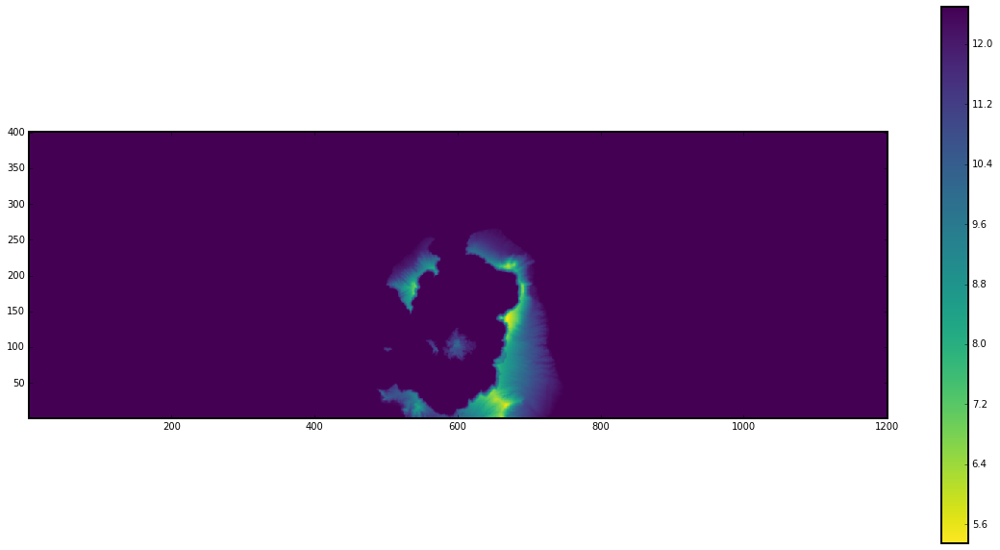

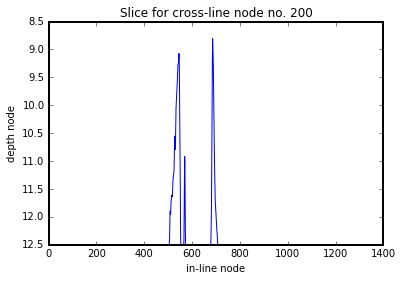

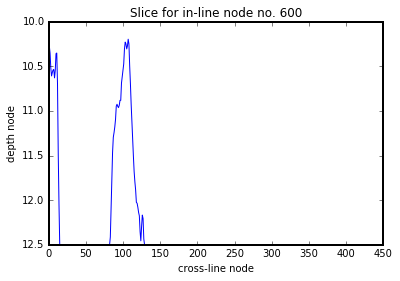

In [115]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

plt.figure(figsize=[20, 10])
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.xlim(1, nx1)
plt.ylim(1, nx2)

plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### Source wavelet

- Michele's source has a negative first swing whereas Jo's a positive one!
- all filters applied should be minimum-phase (be careful: ZERO-phase is default in SU) 

#### Prepare

File "mp_source_3d_7.5Hz_17-10-17.sgy" has had a sequence of 2 filters applied:
1. Low-pass Butterworth filter:
    * 4 poles, cutoff frequency (3db point) 20 Hz; or equivalently:
    * not provided by MP
2. Low-pass Butterworth filter:
    * 15 poles, cutoff frequency (3db point) 6.4866 Hz; or equivalently:
    * passhi 6 Hz, stophi 8 Hz

and "should be good as it is without any additional shift as long as you filter the data
with the same filter". I am not sure why the filter no. 1 is necessary.

In [119]:
# !cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_7.5Hz_17-10-17.sgy" | suspecfx | suxwigb
# !cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_17-10-17.sgy" | suxwigb
# !cd "{source_wavelet_path}" && sgyread.sh "mp_source_3d_2.2-6.5Hz_18-02-21.sgy" | suxwigb

##### Copy

In [ ]:
# NOT TO FILTER TWICE
fname = "mp_source_3d_7.5Hz_17-10-17.sgy"
!cp "{source_wavelet_path}"{fname} "{proj_path}"{proj_name}"-RawSign.sgy"

fname = proj_name + '-RawSign.sgy'
!cd "{proj_path}" && cp {fname} {fname}'_raw'

##### High-pass filter

Additionally, one needs to remove the swell noise from the data with a low-cut filter which has to be applied to the wavelet too ("I definitely filtered the data when preparing them for the inversion, using the
same filter as the source but with an extra low-cut filter with lowcut:"

1. Low-cut (high-pass) Butterworth filter:
    * 9 poles, cutoff frequency (3db point) 2.1769 Hz; or equivalently:
    * stoplo 1.5 Hz, passlo 2.5 Hz
    

Remember that unless we turn off hi/locut=0, the subfilt will be a bandpass!

In [152]:
fname = proj_name + '-RawSign.sgy_raw'
fname_tmp = proj_name + '-RawSign.sgy_hpass'
!cd "{proj_path}" && sgyread.sh {fname} | subfilt zerophase=0 hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 | segyhdrs | segywrite tape={fname_tmp}


segyread: syscalls.c: eopen: open failed (No such file or directory)

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7583e-05 s, 36.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 5000: trace 1


In [131]:
!cd "{proj_path}" && sgyread.sh {proj_name + '-RawSign.sgy_hpass'} | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0018188 s, 1.8 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 778 requests (778 known processed) with 0 events remaining.


##### Low-pass filter (for 1st block of inversion)

- just for the first block of iterations: max 3 Hz 
- NOTE: despite the larger no. of poles it's hard to cut high frequencies

In [137]:
fname = proj_name + '-RawSign.sgy_hpass'
fname_tmp = fname + '_lpass'
!cd "{proj_path}" && sgyread.sh {fname} | subfilt zerophase=0 locut=0 hicut=1 npoleshi=15 f3dbhi=3 | segyhdrs | segywrite tape={fname_tmp}
!cd "{proj_path}" && cp {fname_tmp} {proj_name + '-RawSign.sgy'}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00176651 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000105448 s, 30.3 MB/s


In [138]:
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy_raw | suxwigb
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00180469 s, 1.8 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 466 requests (466 known processed) with 0 events remaining.


#### Plot

In [116]:
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00180606 s, 1.8 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 783 requests (783 known processed) with 0 events remaining.


### Observed data

In [15]:
obs_list = [108, 106, 105, 104, 109, 110, 112, 113, 114, 115, 117, 131, 130, 128, 127, 125, 124, 123, 136, 137, 138, 139, 140, 141, 142, 144, 145, 146, 147, 168, 167, 166, 165, 164, 163, 162, 161, 160, 158, 157, 176, 177, 178, 179, 181, 183, 184, 185, 186, 188]
# print obs_list

In [17]:
# !cd "{proj_path}" && ls data/stations_full/
# !cd "{proj_path}" && ls data/stations_lines

In [14]:
# COPY => HEAVY OPERATION

# for obs in obs_list:
#     print obs
#     !cd "{proj_path}" && cp "{data_path}"/MGL*{obs}*.segy data/stations_full/

#### Split into lines

In [70]:
!cd "{proj_path}" && ls data/stations_full | wc -l

51


In [16]:
path = proj_path + 'data/stations_full'
fnames = Get_Files(path, 'MGL*.segy')
for fname in fnames:
    fname = Path_Leave(fname)
    for ep in range(1, 60 + 1):
        new_fname = '../stations_lines/' + fname[ :-len('.segy')] + '_line' + str(ep) + '.segy'
        print new_fname
        ep = str(ep)
        !cd "{path}" && sgyread.sh {fname} | suwind key=ep min={ep} max={ep} | segyhdrs | segywrite tape="{new_fname}"

../stations_lines/MGL1521_S104_4_line1.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00174155 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0577e-05 s, 39.7 MB/s
../stations_lines/MGL1521_S104_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370903 s, 863 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7168e-05 s, 47.6 MB/s
../stations_lines/MGL1521_S104_4_line3.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00421385 s, 759 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2356e-05 s, 51.3 MB/s
../stations_lines/MGL1521_S104_4_line4.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314811 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000214707 s, 14.9 MB/s
../stations_lines/MGL1521_S104_4_line5.segy
3200+0 records in
6+1 records out
3

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.658e-05 s, 48.1 MB/s
../stations_lines/MGL1521_S104_4_line37.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337343 s, 949 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5977e-05 s, 48.5 MB/s
../stations_lines/MGL1521_S104_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00382964 s, 836 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4283e-05 s, 49.8 MB/s
../stations_lines/MGL1521_S104_4_line39.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00212679 s, 1.5 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5382e-05 s, 33.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S104_4_line40.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00359037 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00417025 s, 767 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.757e-05 s, 41.3 MB/s
../stations_lines/MGL1521_S106_4_line10.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00166231 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.194e-05 s, 51.7 MB/s
../stations_lines/MGL1521_S106_4_line11.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035953 s, 890 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6574e-05 s, 56.6 MB/s
../stations_lines/MGL1521_S106_4_line12.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151337 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.231e-05 s, 51.4 MB/s
../stations_lines/MGL1521_S106_4_line13.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030646


segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000120553 s, 26.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S106_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00393448 s, 813 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3202e-05 s, 38.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S106_4_line46.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00404435 s, 791 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6244e-05 s, 42.0 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S106_4_line47.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00313128 s, 1.0 MB/s

segyhdrs: can't get first trace
6+1 re

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0718e-05 s, 45.3 MB/s
../stations_lines/MGL1521_S109_4_line18.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00172127 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5771e-05 s, 48.7 MB/s
../stations_lines/MGL1521_S109_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130579 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0892e-05 s, 45.1 MB/s
../stations_lines/MGL1521_S109_4_line20.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152613 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9917e-05 s, 45.8 MB/s
../stations_lines/MGL1521_S109_4_line21.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00183572 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9734e-


segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.811e-05 s, 36.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S109_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00319999 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3217e-05 s, 50.6 MB/s
../stations_lines/MGL1521_S109_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311708 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0815e-05 s, 45.2 MB/s
../stations_lines/MGL1521_S109_4_line53.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325593 s, 983 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0079e-05 s, 35.5 MB/s
../stations_lines/MGL1521_S109_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340906 

../stations_lines/MGL1521_S112_4_line26.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188541 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7918e-05 s, 55.3 MB/s
../stations_lines/MGL1521_S112_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332112 s, 964 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5886e-05 s, 48.6 MB/s
../stations_lines/MGL1521_S112_4_line28.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292173 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7944e-05 s, 47.1 MB/s
../stations_lines/MGL1521_S112_4_line29.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330856 s, 967 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9147e-05 s, 32.3 MB/s
../stations_lines/MGL1521_S112_4_line30.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7134e-05 s, 47.7 MB/s
../stations_lines/MGL1521_S112_4_line59.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342284 s, 935 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.761e-05 s, 47.3 MB/s
../stations_lines/MGL1521_S112_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322942 s, 991 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3935e-05 s, 50.1 MB/s
../stations_lines/MGL1521_S113_4_line1.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311793 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4009e-05 s, 50.0 MB/s
../stations_lines/MGL1521_S113_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00345239 s, 927 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4077e-05 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144556 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2301e-05 s, 51.4 MB/s
../stations_lines/MGL1521_S113_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318297 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.697e-05 s, 56.2 MB/s
../stations_lines/MGL1521_S113_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300169 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2729e-05 s, 51.0 MB/s
../stations_lines/MGL1521_S113_4_line37.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00317884 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0612e-05 s, 45.3 MB/s
../stations_lines/MGL1521_S113_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034

../stations_lines/MGL1521_S114_4_line7.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0062023 s, 516 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6264e-05 s, 48.3 MB/s
../stations_lines/MGL1521_S114_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149505 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000320169 s, 10.0 MB/s
../stations_lines/MGL1521_S114_4_line9.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333047 s, 961 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0207e-05 s, 35.5 MB/s
../stations_lines/MGL1521_S114_4_line10.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330738 s, 968 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0737e-05 s, 45.2 MB/s
../stations_lines/MGL1521_S114_4_line11.segy
3200+0 records in
6+1 records out


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00366302 s, 874 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1787e-05 s, 39.1 MB/s
../stations_lines/MGL1521_S114_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292105 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000119953 s, 26.7 MB/s
../stations_lines/MGL1521_S114_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00324951 s, 985 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5956e-05 s, 48.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S114_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00155332 s, 2.1 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5074e-05 s, 58.1 MB/

../stations_lines/MGL1521_S124_4_line15.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00341874 s, 936 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5939e-05 s, 37.2 MB/s
../stations_lines/MGL1521_S124_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321939 s, 994 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5847e-05 s, 48.6 MB/s
../stations_lines/MGL1521_S124_4_line17.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132063 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6758e-05 s, 47.9 MB/s
../stations_lines/MGL1521_S124_4_line18.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00222099 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8299e-05 s, 54.9 MB/s
../stations_lines/MGL1521_S124_4_line19.segy
3200+0 records in
6+1 records o


segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.977e-05 s, 53.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S124_4_line49.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00359493 s, 890 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000129323 s, 24.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S124_4_line50.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00656426 s, 487 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4923e-05 s, 49.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S124_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00301845 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 byte

../stations_lines/MGL1521_S125_4_line23.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156962 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8073e-05 s, 47.0 MB/s
../stations_lines/MGL1521_S125_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00439281 s, 728 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5496e-05 s, 57.7 MB/s
../stations_lines/MGL1521_S125_4_line25.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00323616 s, 989 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0175e-05 s, 53.2 MB/s
../stations_lines/MGL1521_S125_4_line26.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00294063 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3764e-05 s, 50.2 MB/s
../stations_lines/MGL1521_S125_4_line27.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.041e-05 s, 45.4 MB/s
../stations_lines/MGL1521_S125_4_line56.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332669 s, 962 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1832e-05 s, 51.8 MB/s
../stations_lines/MGL1521_S125_4_line57.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322815 s, 991 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8371e-05 s, 54.8 MB/s
../stations_lines/MGL1521_S125_4_line58.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134143 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151922 s, 21.1 MB/s
../stations_lines/MGL1521_S125_4_line59.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00365544 s, 875 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1045e-

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00317234 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.188e-05 s, 44.5 MB/s
../stations_lines/MGL1521_S128_4_line32.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00319289 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.218e-05 s, 51.5 MB/s
../stations_lines/MGL1521_S128_4_line33.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161854 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000150879 s, 21.2 MB/s
../stations_lines/MGL1521_S128_4_line34.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00309839 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3977e-05 s, 50.0 MB/s
../stations_lines/MGL1521_S128_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.966e-05 s, 32.1 MB/s
../stations_lines/MGL1521_S130_4_line4.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00319972 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151559 s, 21.1 MB/s
../stations_lines/MGL1521_S130_4_line5.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00329084 s, 972 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000121282 s, 26.4 MB/s
../stations_lines/MGL1521_S130_4_line6.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00336528 s, 951 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9499e-05 s, 40.3 MB/s
../stations_lines/MGL1521_S130_4_line7.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292526 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5163e-05 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325853 s, 982 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000115313 s, 27.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S130_4_line40.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300901 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4027e-05 s, 50.0 MB/s
../stations_lines/MGL1521_S130_4_line41.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00313799 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000145791 s, 21.9 MB/s
../stations_lines/MGL1521_S130_4_line42.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00371319 s, 862 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1032e-05 s, 52.4 MB/s
../stations_lines/MGL1521_S130

../stations_lines/MGL1521_S131_4_line12.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370625 s, 863 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6288e-05 s, 41.9 MB/s
../stations_lines/MGL1521_S131_4_line13.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0032165 s, 995 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0628e-05 s, 52.8 MB/s
../stations_lines/MGL1521_S131_4_line14.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00316119 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6423e-05 s, 41.9 MB/s
../stations_lines/MGL1521_S131_4_line15.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314679 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4519e-05 s, 42.9 MB/s
../stations_lines/MGL1521_S131_4_line16.segy
3200+0 records in
6+1 records ou


segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000183403 s, 17.4 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S131_4_line47.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322862 s, 991 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0181e-05 s, 53.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S131_4_line48.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00368036 s, 869 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000119529 s, 26.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S131_4_line49.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00347836 s, 920 kB/s

segyhdrs: can't get first trace
6+1 r

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003174 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1628e-05 s, 51.9 MB/s
../stations_lines/MGL1521_S136_4_line21.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00446157 s, 717 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000195357 s, 16.4 MB/s
../stations_lines/MGL1521_S136_4_line22.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314797 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6831e-05 s, 47.9 MB/s
../stations_lines/MGL1521_S136_4_line23.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332057 s, 964 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000134185 s, 23.8 MB/s
../stations_lines/MGL1521_S136_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8672e-05 s, 46.6 MB/s
../stations_lines/MGL1521_S136_4_line53.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030639 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9708e-05 s, 45.9 MB/s
../stations_lines/MGL1521_S136_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035464 s, 902 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5273e-05 s, 42.5 MB/s
../stations_lines/MGL1521_S136_4_line55.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00389002 s, 823 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8068e-05 s, 47.0 MB/s
../stations_lines/MGL1521_S136_4_line56.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306998 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00015257

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325494 s, 983 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8563e-05 s, 46.7 MB/s
../stations_lines/MGL1521_S137_4_line29.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342181 s, 935 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0388e-05 s, 45.5 MB/s
../stations_lines/MGL1521_S137_4_line30.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00335966 s, 952 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1832e-05 s, 34.8 MB/s
../stations_lines/MGL1521_S137_4_line31.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00324865 s, 985 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1742e-05 s, 51.8 MB/s
../stations_lines/MGL1521_S137_4_line32.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003

../stations_lines/MGL1521_S141_4_line1.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00346296 s, 924 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00018482 s, 17.3 MB/s
../stations_lines/MGL1521_S141_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00366671 s, 873 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9733e-05 s, 53.6 MB/s
../stations_lines/MGL1521_S141_4_line3.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161952 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2129e-05 s, 51.5 MB/s
../stations_lines/MGL1521_S141_4_line4.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0029175 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000123519 s, 25.9 MB/s
../stations_lines/MGL1521_S141_4_line5.segy
3200+0 records in
6+1 records out
32

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5175e-05 s, 49.1 MB/s
../stations_lines/MGL1521_S141_4_line37.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00335615 s, 953 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1538e-05 s, 52.0 MB/s
../stations_lines/MGL1521_S141_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00295382 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8589e-05 s, 40.7 MB/s
../stations_lines/MGL1521_S141_4_line39.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00362101 s, 884 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6808e-05 s, 56.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S141_4_line40.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307979

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292919 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000146587 s, 21.8 MB/s
../stations_lines/MGL1521_S142_4_line10.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297638 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9619e-05 s, 46.0 MB/s
../stations_lines/MGL1521_S142_4_line11.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00328835 s, 973 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2277e-05 s, 44.3 MB/s
../stations_lines/MGL1521_S142_4_line12.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136342 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3508e-05 s, 50.4 MB/s
../stations_lines/MGL1521_S142_4_line13.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00


segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1474e-05 s, 44.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S142_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125158 s, 2.6 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4893e-05 s, 42.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S142_4_line46.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332307 s, 963 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8157e-05 s, 40.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S142_4_line47.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182176 s, 1.8 MB/s

segyhdrs: can't get first trace
6+1 rec

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000145248 s, 22.0 MB/s
../stations_lines/MGL1521_S144_4_line18.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00345908 s, 925 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7287e-05 s, 55.9 MB/s
../stations_lines/MGL1521_S144_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00328417 s, 974 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5021e-05 s, 49.2 MB/s
../stations_lines/MGL1521_S144_4_line20.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00365652 s, 875 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1013e-05 s, 52.4 MB/s
../stations_lines/MGL1521_S144_4_line21.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160763 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7176e


segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.398e-05 s, 59.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S144_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00296522 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5339e-05 s, 49.0 MB/s
../stations_lines/MGL1521_S144_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00304782 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1463e-05 s, 52.1 MB/s
../stations_lines/MGL1521_S144_4_line53.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00323691 s, 989 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.826e-05 s, 36.3 MB/s
../stations_lines/MGL1521_S144_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00390198 s

../stations_lines/MGL1521_S145_4_line26.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00394737 s, 811 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3227e-05 s, 43.7 MB/s
../stations_lines/MGL1521_S145_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337665 s, 948 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000197965 s, 16.2 MB/s
../stations_lines/MGL1521_S145_4_line28.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00329459 s, 971 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6364e-05 s, 41.9 MB/s
../stations_lines/MGL1521_S145_4_line29.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00344224 s, 930 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7629e-05 s, 41.2 MB/s
../stations_lines/MGL1521_S145_4_line30.segy
3200+0 records in
6+1 records 

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5476e-05 s, 57.7 MB/s
../stations_lines/MGL1521_S145_4_line59.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00309158 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8696e-05 s, 54.5 MB/s
../stations_lines/MGL1521_S145_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00176163 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9285e-05 s, 46.2 MB/s
../stations_lines/MGL1521_S157_4_line1.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00327694 s, 977 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161729 s, 19.8 MB/s
../stations_lines/MGL1521_S157_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00391618 s, 817 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1875e-0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00402995 s, 794 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1056e-05 s, 52.4 MB/s
../stations_lines/MGL1521_S157_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00294634 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9839e-05 s, 45.8 MB/s
../stations_lines/MGL1521_S157_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318006 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6305e-05 s, 48.3 MB/s
../stations_lines/MGL1521_S157_4_line37.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0023179 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2114e-05 s, 51.5 MB/s
../stations_lines/MGL1521_S157_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034

../stations_lines/MGL1521_S158_4_line7.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0032107 s, 997 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.293e-05 s, 50.9 MB/s
../stations_lines/MGL1521_S158_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00345422 s, 926 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5701e-05 s, 42.3 MB/s
../stations_lines/MGL1521_S158_4_line9.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321749 s, 995 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4313e-05 s, 49.8 MB/s
../stations_lines/MGL1521_S158_4_line10.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305736 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1299e-05 s, 52.2 MB/s
../stations_lines/MGL1521_S158_4_line11.segy
3200+0 records in
6+1 records out
32

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035191 s, 909 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4544e-05 s, 49.6 MB/s
../stations_lines/MGL1521_S158_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031835 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8793e-05 s, 40.6 MB/s
../stations_lines/MGL1521_S158_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00273338 s, 1.2 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.854e-05 s, 54.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S158_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163979 s, 2.0 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6894e-05 s, 47.8 MB/s

s

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333338 s, 960 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5321e-05 s, 49.0 MB/s
../stations_lines/MGL1521_S160_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00295948 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.434e-05 s, 58.9 MB/s
../stations_lines/MGL1521_S160_4_line17.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00348548 s, 918 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4681e-05 s, 42.8 MB/s
../stations_lines/MGL1521_S160_4_line18.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188283 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9605e-05 s, 53.7 MB/s
../stations_lines/MGL1521_S160_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034

../stations_lines/MGL1521_S160_4_line49.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031266 s, 1.0 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.793e-05 s, 55.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S160_4_line50.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00393262 s, 814 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2016e-05 s, 51.6 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S160_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00243203 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2117e-05 s, 51.5 MB/s
../stations_lines/MGL1521_S160_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00327825 s, 9

../stations_lines/MGL1521_S161_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340323 s, 940 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6844e-05 s, 56.3 MB/s
../stations_lines/MGL1521_S161_4_line25.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003894 s, 822 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4321e-05 s, 49.8 MB/s
../stations_lines/MGL1521_S161_4_line26.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003154 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8161e-05 s, 46.9 MB/s
../stations_lines/MGL1521_S161_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330586 s, 968 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9807e-05 s, 53.5 MB/s
../stations_lines/MGL1521_S161_4_line28.segy
3200+0 records in
6+1 records out
3

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2925e-05 s, 50.9 MB/s
../stations_lines/MGL1521_S161_4_line57.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00346007 s, 925 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4822e-05 s, 49.4 MB/s
../stations_lines/MGL1521_S161_4_line58.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325359 s, 984 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000110364 s, 29.0 MB/s
../stations_lines/MGL1521_S161_4_line59.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00319757 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5886e-05 s, 48.6 MB/s
../stations_lines/MGL1521_S161_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031185 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.7488e-

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00241059 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000100343 s, 31.9 MB/s
../stations_lines/MGL1521_S163_4_line33.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135485 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000226882 s, 14.1 MB/s
../stations_lines/MGL1521_S163_4_line34.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00124503 s, 2.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2322e-05 s, 51.3 MB/s
../stations_lines/MGL1521_S163_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00303056 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1339e-05 s, 52.2 MB/s
../stations_lines/MGL1521_S163_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0

../stations_lines/MGL1521_S165_4_line5.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292895 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8215e-05 s, 46.9 MB/s
../stations_lines/MGL1521_S165_4_line6.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340629 s, 939 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2053e-05 s, 51.6 MB/s
../stations_lines/MGL1521_S165_4_line7.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318164 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6258e-05 s, 48.3 MB/s
../stations_lines/MGL1521_S165_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340571 s, 940 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7105e-05 s, 56.0 MB/s
../stations_lines/MGL1521_S165_4_line9.segy
3200+0 records in
6+1 records out
32

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292451 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0347e-05 s, 53.0 MB/s
../stations_lines/MGL1521_S165_4_line41.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320697 s, 998 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7507e-05 s, 41.3 MB/s
../stations_lines/MGL1521_S165_4_line42.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00355215 s, 901 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2193e-05 s, 51.5 MB/s
../stations_lines/MGL1521_S165_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00392302 s, 816 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1054e-05 s, 45.0 MB/s
../stations_lines/MGL1521_S165_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.002

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00327949 s, 976 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8873e-05 s, 40.6 MB/s
../stations_lines/MGL1521_S166_4_line14.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300137 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7542e-05 s, 47.4 MB/s
../stations_lines/MGL1521_S166_4_line15.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334289 s, 957 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6604e-05 s, 56.5 MB/s
../stations_lines/MGL1521_S166_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334024 s, 958 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6519e-05 s, 37.0 MB/s
../stations_lines/MGL1521_S166_4_line17.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330424 s, 968 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5645e-05 s, 48.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S166_4_line48.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00335859 s, 953 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6851e-05 s, 47.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S166_4_line49.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00358168 s, 893 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2755e-05 s, 51.0 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S166_4_line50.segy
3200+0 records in
6+1 records out
3200 b

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00341941 s, 936 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9898e-05 s, 53.4 MB/s
../stations_lines/MGL1521_S167_4_line22.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00352402 s, 908 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0812e-05 s, 45.2 MB/s
../stations_lines/MGL1521_S167_4_line23.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00316234 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6867e-05 s, 47.9 MB/s
../stations_lines/MGL1521_S167_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00459899 s, 696 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8824e-05 s, 46.5 MB/s
../stations_lines/MGL1521_S167_4_line25.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.546e-05 s, 48.9 MB/s
../stations_lines/MGL1521_S167_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182915 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2915e-05 s, 50.9 MB/s
../stations_lines/MGL1521_S167_4_line55.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00196348 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4057e-05 s, 50.0 MB/s
../stations_lines/MGL1521_S167_4_line56.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00389818 s, 821 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.898e-05 s, 36.0 MB/s
../stations_lines/MGL1521_S167_4_line57.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334915 s, 955 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9731e-05

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00386316 s, 828 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7885e-05 s, 36.4 MB/s
../stations_lines/MGL1521_S168_4_line30.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00298522 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3025e-05 s, 43.8 MB/s
../stations_lines/MGL1521_S168_4_line31.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00316232 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1776e-05 s, 51.8 MB/s
../stations_lines/MGL1521_S168_4_line32.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00399117 s, 802 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8379e-05 s, 46.8 MB/s
../stations_lines/MGL1521_S168_4_line33.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.002

../stations_lines/MGL1521_S177_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342811 s, 933 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6898e-05 s, 56.2 MB/s
../stations_lines/MGL1521_S177_4_line3.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00354561 s, 903 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.667e-05 s, 56.5 MB/s
../stations_lines/MGL1521_S177_4_line4.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334865 s, 956 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000206318 s, 15.5 MB/s
../stations_lines/MGL1521_S177_4_line5.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00362662 s, 882 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3785e-05 s, 50.2 MB/s
../stations_lines/MGL1521_S177_4_line6.segy
3200+0 records in
6+1 records out
32

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.114e-05 s, 45.0 MB/s
../stations_lines/MGL1521_S177_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00331532 s, 965 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0528e-05 s, 45.4 MB/s
../stations_lines/MGL1521_S177_4_line39.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0037271 s, 859 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7382e-05 s, 47.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S177_4_line40.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003168 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.409e-05 s, 49.9 MB/s
../stations_lines/MGL1521_S177_4_line41.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00427968 s, 7

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360205 s, 888 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000142384 s, 22.5 MB/s
../stations_lines/MGL1521_S178_4_line11.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00323185 s, 990 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0612e-05 s, 52.8 MB/s
../stations_lines/MGL1521_S178_4_line12.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349901 s, 915 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4143e-05 s, 43.2 MB/s
../stations_lines/MGL1521_S178_4_line13.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305064 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1897e-05 s, 44.5 MB/s
../stations_lines/MGL1521_S178_4_line14.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00

../stations_lines/MGL1521_S178_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034207 s, 935 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9774e-05 s, 40.1 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S178_4_line46.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306588 s, 1.0 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3561e-05 s, 34.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S178_4_line47.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00386804 s, 827 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2378e-05 s, 51.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S178_4_line48.s

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00252152 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7073e-05 s, 47.7 MB/s
../stations_lines/MGL1521_S179_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00347717 s, 920 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0814e-05 s, 45.2 MB/s
../stations_lines/MGL1521_S179_4_line20.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00221712 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4657e-05 s, 49.5 MB/s
../stations_lines/MGL1521_S179_4_line21.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035374 s, 905 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4345e-05 s, 58.9 MB/s
../stations_lines/MGL1521_S179_4_line22.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0021

../stations_lines/MGL1521_S179_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337336 s, 949 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7218e-05 s, 55.9 MB/s
../stations_lines/MGL1521_S179_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00315031 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1381e-05 s, 44.8 MB/s
../stations_lines/MGL1521_S179_4_line53.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035698 s, 896 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000132428 s, 24.2 MB/s
../stations_lines/MGL1521_S179_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00396559 s, 807 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1031e-05 s, 45.1 MB/s
../stations_lines/MGL1521_S179_4_line55.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6019e-05 s, 48.5 MB/s
../stations_lines/MGL1521_S181_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00363239 s, 881 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.778e-05 s, 47.2 MB/s
../stations_lines/MGL1521_S181_4_line28.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00351229 s, 911 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7287e-05 s, 41.4 MB/s
../stations_lines/MGL1521_S181_4_line29.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00302514 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6211e-05 s, 56.9 MB/s
../stations_lines/MGL1521_S181_4_line30.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00353244 s, 906 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0001020

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00329686 s, 971 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4613e-05 s, 49.5 MB/s
../stations_lines/MGL1521_S181_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00195043 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3724e-05 s, 50.2 MB/s
../stations_lines/MGL1521_S184_4_line1.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321456 s, 995 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000137448 s, 23.3 MB/s
../stations_lines/MGL1521_S184_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00366496 s, 873 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9414e-05 s, 32.2 MB/s
../stations_lines/MGL1521_S184_4_line3.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306

../stations_lines/MGL1521_S184_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00350425 s, 913 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3407e-05 s, 43.6 MB/s
../stations_lines/MGL1521_S184_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00327553 s, 977 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000129038 s, 24.8 MB/s
../stations_lines/MGL1521_S184_4_line37.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342679 s, 934 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.423e-05 s, 49.8 MB/s
../stations_lines/MGL1521_S184_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343433 s, 932 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000127992 s, 25.0 MB/s
../stations_lines/MGL1521_S184_4_line39.segy
3200+0 records in
6+1 records 

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000149874 s, 21.4 MB/s
../stations_lines/MGL1521_S185_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0042762 s, 748 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5252e-05 s, 49.0 MB/s
../stations_lines/MGL1521_S185_4_line9.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0037491 s, 854 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6192e-05 s, 48.3 MB/s
../stations_lines/MGL1521_S185_4_line10.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00357517 s, 895 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9079e-05 s, 46.3 MB/s
../stations_lines/MGL1521_S185_4_line11.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00192308 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1878e-05 

../stations_lines/MGL1521_S185_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00387173 s, 827 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9234e-05 s, 54.0 MB/s
../stations_lines/MGL1521_S185_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00308047 s, 1.0 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.11e-05 s, 52.4 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S185_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297501 s, 1.1 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4022e-05 s, 50.0 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_S185_4_line46.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00210295 s, 1

../stations_lines/MGL1521_W105_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0396083 s, 80.8 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.754e-05 s, 47.4 MB/s
../stations_lines/MGL1521_W105_4_line17.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00414955 s, 771 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8755e-05 s, 54.5 MB/s
../stations_lines/MGL1521_W105_4_line18.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314313 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000103942 s, 30.8 MB/s
../stations_lines/MGL1521_W105_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349318 s, 916 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9345e-05 s, 32.2 MB/s
../stations_lines/MGL1521_W105_4_line20.segy
3200+0 records in
6+1 records o

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300746 s, 1.1 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1356e-05 s, 44.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W105_4_line50.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00323016 s, 991 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2452e-05 s, 51.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W105_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337723 s, 948 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2474e-05 s, 44.2 MB/s
../stations_lines/MGL1521_W105_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00173425 s, 1.8 MB/s
6+1 records in
1+0 records out
3200

../stations_lines/MGL1521_W108_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340214 s, 941 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3303e-05 s, 43.7 MB/s
../stations_lines/MGL1521_W108_4_line25.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00357764 s, 894 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8506e-05 s, 46.7 MB/s
../stations_lines/MGL1521_W108_4_line26.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00303152 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7571e-05 s, 55.6 MB/s
../stations_lines/MGL1521_W108_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00345398 s, 926 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3096e-05 s, 38.5 MB/s
../stations_lines/MGL1521_W108_4_line28.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.474e-05 s, 42.8 MB/s
../stations_lines/MGL1521_W108_4_line57.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00358024 s, 894 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5915e-05 s, 48.5 MB/s
../stations_lines/MGL1521_W108_4_line58.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0017222 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0616e-05 s, 45.3 MB/s
../stations_lines/MGL1521_W108_4_line59.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00192785 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3622e-05 s, 50.3 MB/s
../stations_lines/MGL1521_W108_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00331724 s, 965 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9129e-05

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00339376 s, 943 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9309e-05 s, 54.0 MB/s
../stations_lines/MGL1521_W110_4_line33.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00198965 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000101265 s, 31.6 MB/s
../stations_lines/MGL1521_W110_4_line34.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00341699 s, 936 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8261e-05 s, 46.9 MB/s
../stations_lines/MGL1521_W110_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00386226 s, 829 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.309e-05 s, 43.8 MB/s
../stations_lines/MGL1521_W110_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003

../stations_lines/MGL1521_W115_4_line5.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333362 s, 960 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9672e-05 s, 35.7 MB/s
../stations_lines/MGL1521_W115_4_line6.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035598 s, 899 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4893e-05 s, 49.3 MB/s
../stations_lines/MGL1521_W115_4_line7.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00174763 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3706e-05 s, 50.2 MB/s
../stations_lines/MGL1521_W115_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0029414 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9176e-05 s, 54.1 MB/s
../stations_lines/MGL1521_W115_4_line9.segy
3200+0 records in
6+1 records out
3200

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00186081 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0255e-05 s, 35.5 MB/s
../stations_lines/MGL1521_W115_4_line41.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00185267 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5602e-05 s, 42.3 MB/s
../stations_lines/MGL1521_W115_4_line42.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334602 s, 956 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1378e-05 s, 52.1 MB/s
../stations_lines/MGL1521_W115_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330897 s, 967 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3612e-05 s, 43.5 MB/s
../stations_lines/MGL1521_W115_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360479 s, 888 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.3687e-05 s, 59.6 MB/s
../stations_lines/MGL1521_W117_4_line14.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00326107 s, 981 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0185e-05 s, 53.2 MB/s
../stations_lines/MGL1521_W117_4_line15.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0038798 s, 825 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7164e-05 s, 41.5 MB/s
../stations_lines/MGL1521_W117_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00170531 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5293e-05 s, 49.0 MB/s
../stations_lines/MGL1521_W117_4_line17.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0017

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034897 s, 917 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2562e-05 s, 44.1 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W117_4_line48.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00189574 s, 1.7 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.133e-05 s, 52.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W117_4_line49.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00389545 s, 821 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6328e-05 s, 56.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W117_4_line50.segy
3200+0 records in
6+1 records out
3200 byt

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00379141 s, 844 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7711e-05 s, 47.3 MB/s
../stations_lines/MGL1521_W123_4_line22.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00308723 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9836e-05 s, 32.1 MB/s
../stations_lines/MGL1521_W123_4_line23.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00191121 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4885e-05 s, 49.3 MB/s
../stations_lines/MGL1521_W123_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00351693 s, 910 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.075e-05 s, 45.2 MB/s
../stations_lines/MGL1521_W123_4_line25.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0046

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5652e-05 s, 57.5 MB/s
../stations_lines/MGL1521_W123_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00361019 s, 886 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9742e-05 s, 53.6 MB/s
../stations_lines/MGL1521_W123_4_line55.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00390464 s, 820 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5423e-05 s, 48.9 MB/s
../stations_lines/MGL1521_W123_4_line56.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00402503 s, 795 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5003e-05 s, 49.2 MB/s
../stations_lines/MGL1521_W123_4_line57.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0036805 s, 869 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0002336

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188668 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.422e-05 s, 49.8 MB/s
../stations_lines/MGL1521_W127_4_line30.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306408 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7724e-05 s, 47.3 MB/s
../stations_lines/MGL1521_W127_4_line31.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00287702 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3495e-05 s, 50.4 MB/s
../stations_lines/MGL1521_W127_4_line32.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00195561 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00015652 s, 20.4 MB/s
../stations_lines/MGL1521_W127_4_line33.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0036

../stations_lines/MGL1521_W138_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360581 s, 887 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.17e-05 s, 34.9 MB/s
../stations_lines/MGL1521_W138_4_line3.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00170689 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8168e-05 s, 46.9 MB/s
../stations_lines/MGL1521_W138_4_line4.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00388507 s, 824 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000214175 s, 14.9 MB/s
../stations_lines/MGL1521_W138_4_line5.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00393547 s, 813 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.924e-05 s, 54.0 MB/s
../stations_lines/MGL1521_W138_4_line6.segy
3200+0 records in
6+1 records out
3200

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8845e-05 s, 46.5 MB/s
../stations_lines/MGL1521_W138_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00399639 s, 801 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7424e-05 s, 55.7 MB/s
../stations_lines/MGL1521_W138_4_line39.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00364237 s, 879 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5991e-05 s, 57.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W138_4_line40.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0039632 s, 807 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9667e-05 s, 45.9 MB/s
../stations_lines/MGL1521_W138_4_line41.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00345076 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00190926 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3004e-05 s, 50.8 MB/s
../stations_lines/MGL1521_W139_4_line11.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343864 s, 931 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6468e-05 s, 37.0 MB/s
../stations_lines/MGL1521_W139_4_line12.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154294 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4313e-05 s, 49.8 MB/s
../stations_lines/MGL1521_W139_4_line13.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00335035 s, 955 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5126e-05 s, 49.1 MB/s
../stations_lines/MGL1521_W139_4_line14.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003

../stations_lines/MGL1521_W139_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125242 s, 2.6 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1622e-05 s, 51.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W139_4_line46.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00378737 s, 845 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5518e-05 s, 42.4 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W139_4_line47.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00358361 s, 893 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5121e-05 s, 58.1 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W139_4_line48.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00192912 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8062e-05 s, 55.1 MB/s
../stations_lines/MGL1521_W140_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360189 s, 888 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8296e-05 s, 54.9 MB/s
../stations_lines/MGL1521_W140_4_line20.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00336001 s, 952 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.8044e-05 s, 36.3 MB/s
../stations_lines/MGL1521_W140_4_line21.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00375571 s, 852 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4006e-05 s, 50.0 MB/s
../stations_lines/MGL1521_W140_4_line22.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.004

../stations_lines/MGL1521_W140_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00287527 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0595e-05 s, 45.3 MB/s
../stations_lines/MGL1521_W140_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00234134 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8593e-05 s, 46.7 MB/s
../stations_lines/MGL1521_W140_4_line53.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00171761 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9692e-05 s, 40.2 MB/s
../stations_lines/MGL1521_W140_4_line54.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00341947 s, 936 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7329e-05 s, 41.4 MB/s
../stations_lines/MGL1521_W140_4_line55.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7928e-05 s, 55.2 MB/s
../stations_lines/MGL1521_W146_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0021533 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8041e-05 s, 55.1 MB/s
../stations_lines/MGL1521_W146_4_line28.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00183557 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000228524 s, 14.0 MB/s
../stations_lines/MGL1521_W146_4_line29.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034875 s, 918 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6377e-05 s, 48.2 MB/s
../stations_lines/MGL1521_W146_4_line30.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330806 s, 967 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4268e-0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00448105 s, 714 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8011e-05 s, 47.1 MB/s
../stations_lines/MGL1521_W146_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030667 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5077e-05 s, 42.6 MB/s
../stations_lines/MGL1521_W147_4_line1.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00357705 s, 895 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00013502 s, 23.7 MB/s
../stations_lines/MGL1521_W147_4_line2.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00224625 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3885e-05 s, 50.1 MB/s
../stations_lines/MGL1521_W147_4_line3.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031693

../stations_lines/MGL1521_W147_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305972 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8975e-05 s, 40.5 MB/s
../stations_lines/MGL1521_W147_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00225556 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6256e-05 s, 48.3 MB/s
../stations_lines/MGL1521_W147_4_line37.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00363291 s, 881 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6497e-05 s, 56.6 MB/s
../stations_lines/MGL1521_W147_4_line38.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00378742 s, 845 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1324e-05 s, 52.2 MB/s
../stations_lines/MGL1521_W147_4_line39.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4756e-05 s, 42.8 MB/s
../stations_lines/MGL1521_W162_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00317073 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00013221 s, 24.2 MB/s
../stations_lines/MGL1521_W162_4_line9.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00416964 s, 767 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7082e-05 s, 47.7 MB/s
../stations_lines/MGL1521_W162_4_line10.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00171546 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1834e-05 s, 51.8 MB/s
../stations_lines/MGL1521_W162_4_line11.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00249229 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6829e-05

../stations_lines/MGL1521_W162_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342898 s, 933 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8523e-05 s, 46.7 MB/s
../stations_lines/MGL1521_W162_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00186053 s, 1.7 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8802e-05 s, 46.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W162_4_line45.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00366322 s, 874 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.2294e-05 s, 61.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W162_4_line46.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00362595 s,

../stations_lines/MGL1521_W164_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0029923 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6989e-05 s, 36.8 MB/s
../stations_lines/MGL1521_W164_4_line17.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310667 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8269e-05 s, 40.9 MB/s
../stations_lines/MGL1521_W164_4_line18.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00228938 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0561e-05 s, 52.8 MB/s
../stations_lines/MGL1521_W164_4_line19.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349353 s, 916 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2399e-05 s, 38.8 MB/s
../stations_lines/MGL1521_W164_4_line20.segy
3200+0 records in
6+1 records ou

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00363495 s, 880 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.79e-05 s, 55.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W164_4_line50.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00382564 s, 836 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7699e-05 s, 55.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W164_4_line51.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00327 s, 979 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5865e-05 s, 48.6 MB/s
../stations_lines/MGL1521_W164_4_line52.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00373132 s, 858 kB/s
6+1 records in
1+0 records out
3200 byte

../stations_lines/MGL1521_W176_4_line24.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322312 s, 993 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000105553 s, 30.3 MB/s
../stations_lines/MGL1521_W176_4_line25.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035792 s, 894 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7775e-05 s, 36.5 MB/s
../stations_lines/MGL1521_W176_4_line26.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00313123 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6621e-05 s, 56.5 MB/s
../stations_lines/MGL1521_W176_4_line27.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00219044 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4406e-05 s, 43.0 MB/s
../stations_lines/MGL1521_W176_4_line28.segy
3200+0 records in
6+1 records o

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9329e-05 s, 46.2 MB/s
../stations_lines/MGL1521_W176_4_line57.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307531 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000122743 s, 26.1 MB/s
../stations_lines/MGL1521_W176_4_line58.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318578 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1535e-05 s, 52.0 MB/s
../stations_lines/MGL1521_W176_4_line59.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00312709 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9275e-05 s, 46.2 MB/s
../stations_lines/MGL1521_W176_4_line60.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00378719 s, 845 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00013

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292135 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9526e-05 s, 32.2 MB/s
../stations_lines/MGL1521_W183_4_line33.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00207786 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2468e-05 s, 34.6 MB/s
../stations_lines/MGL1521_W183_4_line34.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00289949 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2027e-05 s, 39.0 MB/s
../stations_lines/MGL1521_W183_4_line35.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349069 s, 917 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000125919 s, 25.4 MB/s
../stations_lines/MGL1521_W183_4_line36.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00

../stations_lines/MGL1521_W186_4_line5.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149551 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6742e-05 s, 47.9 MB/s
../stations_lines/MGL1521_W186_4_line6.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003162 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4321e-05 s, 49.8 MB/s
../stations_lines/MGL1521_W186_4_line7.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00351781 s, 910 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1976e-05 s, 39.0 MB/s
../stations_lines/MGL1521_W186_4_line8.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00414046 s, 773 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7645e-05 s, 47.3 MB/s
../stations_lines/MGL1521_W186_4_line9.segy
3200+0 records in
6+1 records out
3200

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00346833 s, 923 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8047e-05 s, 47.0 MB/s
../stations_lines/MGL1521_W186_4_line41.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00199035 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2667e-05 s, 51.1 MB/s
../stations_lines/MGL1521_W186_4_line42.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292676 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5299e-05 s, 57.9 MB/s
../stations_lines/MGL1521_W186_4_line43.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00382361 s, 837 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.778e-05 s, 55.4 MB/s
../stations_lines/MGL1521_W186_4_line44.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0036

../stations_lines/MGL1521_W188_4_line13.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00400605 s, 799 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0122e-05 s, 53.2 MB/s
../stations_lines/MGL1521_W188_4_line14.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00364619 s, 878 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5274e-05 s, 49.0 MB/s
../stations_lines/MGL1521_W188_4_line15.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00402752 s, 795 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.389e-05 s, 50.1 MB/s
../stations_lines/MGL1521_W188_4_line16.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00386195 s, 829 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.291e-05 s, 50.9 MB/s
../stations_lines/MGL1521_W188_4_line17.segy
3200+0 records in
6+1 records out

../stations_lines/MGL1521_W188_4_line47.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305777 s, 1.0 MB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6715e-05 s, 56.4 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W188_4_line48.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00382349 s, 837 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2785e-05 s, 44.0 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W188_4_line49.segy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00346964 s, 922 kB/s

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7993e-05 s, 55.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
../stations_lines/MGL1521_W188_4_line50.

#### Filter

- we could taper as well but we mute the top and bottom of the gather anyway!

In [29]:
!sutaper

								
 SUTAPER - Taper the edge traces of a data panel to zero.	
								
								
 sutaper <stdin >stdout [optional parameters]		  
								
 Optional Parameters:					  
 ntr=tr.ntr	number of traces. If tr.ntr is not set, then	
 		ntr is mandatory				
 tr1=0	 number of traces to be tapered at beginning	
 tr2=tr1	number of traces to be tapered at end		
 min=0.		minimum amplitude factor of taper		
 tbeg=0		length of taper (ms) at trace start		
 tend=0		length of taper (ms) at trace end		
 taper=1	taper type					
		 =1 linear (default)			   
		 =2 sine					
		 =3 cosine					
		 =4 gaussian (+/-3.8)			  
		 =5 gaussian (+/-2.0)			  
								
 Notes:							
   To eliminate the taper, choose tbeg=0. and tend=0. and tr1=0
								


In [39]:
path = proj_path + 'data/stations_lines'
fnames = Get_Files(path, 'MGL*line*.segy')
for fname in fnames:
    fname = Path_Leave(fname)
    new_fname = fname[ :-len('.segy')] + '_filt.segy'
    
    #sutaper ntr=223 taper=4 tend=10000 
    !cd "{path}"  && sgyread.sh {fname} | subfilt locut=0 hicut=1 npoleshi=4 f3dbhi=20 | subfilt locut=0 hicut=1 npoleshi=15 f3dbhi=6.4866 | subfilt locut=0 hicut=1 npoleshi=15 f3dbhi=3 | subfilt hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 | segyhdrs | segywrite tape={new_fname}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014959 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000216881 s, 14.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00397167 s, 806 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6699e-05 s, 36.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0032097 s, 997 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000170341 s, 18.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305838 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000204916 s, 15.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321732 s, 995 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000328677 s, 9.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343834 s, 931 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000268488 s, 11.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00286457 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00111567 s, 2.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00304347 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000198924 s, 16.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00359985 s, 889 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161514 s, 19.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307602 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000206749 s, 15.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00379983 s, 842 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000192015 s, 16.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00295105 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00348856 s, 917 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000202187 s, 15.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00274215 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000174265 s, 18.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333087 s, 961 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy fou

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000669623 s, 4.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00379567 s, 843 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000180967 s, 17.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00291932 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000222234 s, 14.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00302045 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00036745 s, 8.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00293556 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000160776 s, 19.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00238744 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000292819 s, 10.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340771 s, 939 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012508 s, 2.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00336031 s, 952 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5024e-05 s, 33.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00341294 s, 938 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000110651 s, 28.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003643 s, 878 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7787e-05 s, 41.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297846 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035368 s, 905 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000112762 s, 28.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00316319 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000136461 s, 23.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370047 s, 865 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000187237 s, 17.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0037128 s, 862 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000213895 s, 15.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00375128 s, 853 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000147744 s, 21.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000131821 s, 24.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00369628 s, 866 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000168006 s, 19.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00319181 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000133271 s, 24.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306322 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000207445 s, 15.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00328359 s, 975 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000149062 s, 21.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00350653 s, 913 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321275 s, 996 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000171468 s, 18.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00344736 s, 928 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00308137 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000453703 s, 7.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0032469 s, 986 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000210483 s, 15.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00298704 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000149712 s, 21.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334493 s, 957 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00019787 s, 16.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325836 s, 982 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000190625 s, 16.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334666 s, 956 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000190088 s, 16.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333277 s, 960 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000158336 s, 20.2 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0018935 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1867e-05 s, 34.8 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314381 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000157376 s, 20.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310004 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000148001 s, 21.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00291787 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000446066 s, 7.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342916 s, 933 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000179604 s, 17.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00295352 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00021332 s, 15.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00356389 s, 898 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1154e-05 s, 35.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305619 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00010651 s, 30.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318577 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.997e-05 s, 32.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157708 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0497e-05 s, 35.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320834 s, 997 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000178412 s, 17.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342337 s, 935 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000180641 s, 17.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311552 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000148951 s, 21.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00347031 s, 922 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00020503 s, 15.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00356727 s, 897 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000189911 s, 16.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00331234 s, 966 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (120

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000212675 s, 15.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00295908 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000235769 s, 13.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318579 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000214811 s, 14.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342931 s, 933 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6595e-05 s, 33.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0036672 s, 873 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3878e-05 s, 34.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333316 s, 960 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00291594 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000190378 s, 16.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00302359 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300926 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000237344 s, 13.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343379 s, 932 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0016731 s, 1.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322396 s, 993 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000199134 s, 16.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031171 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000305089 s, 10.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00350361 s, 913 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000222256 s, 14.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00315151 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000470985 s, 6.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00326502 s, 980 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000129461 s, 24.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00309936 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8599e-05 s, 32.5 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320459 s, 999 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6609e-05 s, 36.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00312505 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000210417 s, 15.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003238 s, 988 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000200654 s, 15.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318156 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000296099 s, 10.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00379336 s, 844 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00168247 s, 1.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00299166 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000160378 s, 20.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00326575 s, 980 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151818 s, 21.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00194538 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000602554 s, 5.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00317803 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00206668 s, 1.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00339415 s, 943 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000354908 s, 9.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337426 s, 948 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00022955 s, 13.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00357077 s, 896 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000173145 s, 18.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00164299 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000242667 s, 13.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00368239 s, 869 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000345764 s, 9.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034386 s, 931 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000147094 s, 21.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349731 s, 915 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00020744 s, 15.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00329314 s, 972 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000183298 s, 17.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00324424 s, 986 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000176957 s, 18.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00292751 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151788 s, 21.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00308425 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156861 s, 2.0 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7683e-05 s, 47.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00389988 s, 821 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace



3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311084 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000173679 s, 18.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307316 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000233999 s, 13.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00301206 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000166063 s, 19.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0029676 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00018631 s, 17.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003094 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000142546 s, 22.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00158692 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5986e-05 s, 37.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338703 s, 945 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000200908 s, 15.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332912 s, 961 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5578e-05 s, 42.3 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031514 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00012295 s, 26.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00339746 s, 942 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000145828 s, 21.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00304911 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00021962 s, 14.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034479 s, 928 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000133854 s, 23.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00369934 s, 865 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000167841 s, 19.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00328133 s, 975 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000139544 s, 22.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00347761 s, 920 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151343 s, 21.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030959 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000100413 s, 31.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343552 s, 931 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000134651 s, 23.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307725 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000101747 s, 31.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00348588 s, 918 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000211787 s, 15.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321676 s, 995 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000179888 s, 17.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134112 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0297e-05 s, 39.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00185778 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.7461e-05 s, 32.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0050046 s, 639 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00538063 s, 595 kB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00199863 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000121901 s, 26.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0824166 s, 38.8 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000320616 s, 10.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332951 s, 961 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000169728 s, 18.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00385746 s, 830 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000146506 s, 21.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0026955 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00364883 s, 877 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000226274 s, 14.1 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325437 s, 983 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163111 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.206e-05 s, 34.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135619 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00023862 s, 13.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0267469 s, 120 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000208217 s, 15.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0253196 s, 126 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000264536 s, 12.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00408772 s, 783 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000349198 s, 9.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0046728 s, 685 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3349e-05 s, 43.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138077 s, 2.3 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8008e-05 s, 32.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00261708 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000107021 s, 29.9 MB/s
3200+0 records in
6+1 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.033151 s, 96.5 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00041206 s, 7.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370268 s, 864 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000246456 s, 13.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00336731 s, 950 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000250221 s, 12.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00457695 s, 699 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000271519 s, 11.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00525102 s, 609 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000217512 s, 14.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00173099 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6616e-05 s, 33.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00417407 s, 767 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000184055 s, 17.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00301869 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000212962 s, 15.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138945 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000107518 s, 29.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325222 s, 984 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000468651 s, 6.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0117758 s, 272 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000252534 s, 12.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0759233 s, 42.1 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.101989 s, 31.4 kB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00359496 s, 890 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00020731 s, 15.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00432429 s, 740 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000182137 s, 17.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00543853 s, 588 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) 

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000529448 s, 6.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00411282 s, 778 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000283662 s, 11.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00350814 s, 912 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000401725 s, 8.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0249729 s, 128 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000224335 s, 14.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00400204 s, 800 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000203622 s, 15.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00194302 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00245999 s, 1.3 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000114646 s, 27.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00205913 s, 1.6 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0206032 s, 155 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000284527 s, 11.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00324949 s, 985 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000207464 s, 15.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00189875 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000275888 s, 11.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00263185 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000194194 s, 16.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00195754 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3469e-05 s, 34.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00258286 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3934e-05 s, 38.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00396903 s, 806 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000177278 s, 18.1 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00354081 s, 904 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000236603 s, 13.5 MB/s
3200+0 records in
6+

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314791 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000153556 s, 20.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00339203 s, 943 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000118904 s, 26.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00308277 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000153138 s, 20.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00351852 s, 909 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000171606 s, 18.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00194214 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000137197 s, 23.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) co

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370045 s, 865 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000145864 s, 21.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00470093 s, 681 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.543e-05 s, 37.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00344954 s, 928 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000103325 s, 31.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143354 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000118906 s, 26.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337901 s, 947 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000213632 s, 15.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00358658 s, 892 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161057 s, 19.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00303377 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000166345 s, 19.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00368264 s, 869 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000171204 s, 18.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00441315 s, 725 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000108691 s, 29.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00374428 s, 855 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6625e-05 s, 48.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307086 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000173211 s, 18.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00294299 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000268115 s, 11.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300814 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00017441 s, 18.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321042 s, 997 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000144972 s, 22.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0033292 s, 961 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330123 s, 969 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000228261 s, 14.0 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00331889 s, 964 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00356748 s, 897 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000320791 s, 10.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125542 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.795e-05 s, 32.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00323052 s, 991 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00019246 s, 16.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00302603 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000179715 s, 17.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00301975 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000113289 s, 28.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie


segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0034559 s, 926 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000130352 s, 24.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00291673 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000179746 s, 17.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0037812 s, 846 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000164004 s, 19.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00378605 s, 845 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.104e-05 s, 39.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343109 s, 933 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00035382 s, 9.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320174 s, 999 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5365e-05 s, 33.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0039821 s, 804 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000158214 s, 20.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00439201 s, 729 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2866e-05 s, 38.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337203 s, 949 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000159671 s, 20.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00405965 s, 788 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161843 s, 19.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00326367 s, 980 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000145525 s, 22.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163073 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0914e-05 s, 39.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00295475 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000193212 s, 16.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310823 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161297 s, 19.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00372776 s, 858 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000254897 s, 12.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340916 s, 939 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000215178 s, 14.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00344253 s, 930 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000264857 s, 12.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00289384 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... fi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00367344 s, 871 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000212975 s, 15.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300078 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000153385 s, 20.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310406 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000157639 s, 20.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325481 s, 983 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000178529 s, 17.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00309558 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000146426 s, 21.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) co

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00359857 s, 889 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000240894 s, 13.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00195986 s, 1.6 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318792 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000196389 s, 16.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00353313 s, 906 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1875e-05 s, 34.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00330103 s, 969 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000176608 s, 18.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00302127 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000329863 s, 9.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307225 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00013982 s, 22.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie


segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000305478 s, 10.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0037693 s, 849 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2702e-05 s, 51.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035653 s, 898 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297605 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000293609 s, 10.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0031131 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000104282 s, 30.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0226547 s, 141 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0180301 s, 177 kB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129746 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000184813 s, 17.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0038664 s, 828 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000186245 s, 17.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030259 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000208847 s, 15.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00334013 s, 958 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00105493 s, 3.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318053 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000233588 s, 13.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00436862 s, 732 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000119435 s, 26.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00316778 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000146254 s, 21.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307401 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.8561e-05 s, 36.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311682 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000153283 s, 20.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030652 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000181389 s, 17.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306059 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000178689 s, 17.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00291504 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000241815 s, 13.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000121772 s, 26.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030793 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9972e-05 s, 35.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300764 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00025334 s, 12.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00377277 s, 848 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2277e-05 s, 34.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310975 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6866e-05 s, 36.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035944 s, 890 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00352412 s, 908 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000129768 s, 24.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00372053 s, 860 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00315882 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.4892e-05 s, 37.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00367907 s, 870 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000143438 s, 22.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00365375 s, 876 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000145848 s, 21.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00314209 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000147938 s, 21.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00326761 s, 979 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000293682 s, 10.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00325733 s, 982 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5618e-05 s, 33.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310968 s, 1.0 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000203527 s, 15.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00316708 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6438e-05 s, 41.9 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00366842 s, 872 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000107789 s, 29.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00401776 s, 796 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000184713 s, 17.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00398309 s, 803 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00011249 s, 28.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338837 s, 944 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000380275 s, 8.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337272 s, 949 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.7925e-05 s, 32.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00362902 s, 882 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000179057 s, 17.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00376795 s, 849 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3952e-05 s, 50.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00268699 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151514 s, 21.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00351341 s, 911 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6311e-05 s, 33.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307634 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00014753 s, 21.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00392303 s, 816 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116835 s, 27.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333802 s, 959 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000207342 s, 15.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311625 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000215201 s, 14.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035444 s, 903 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000177122 s, 18.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320617 s, 998 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (120

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00011724 s, 27.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00362318 s, 883 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000375883 s, 8.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360692 s, 887 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5471e-05 s, 37.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00377129 s, 849 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000182712 s, 17.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00339294 s, 943 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000119567 s, 26.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00319166 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00399032 s, 802 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00018785 s, 17.0 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00419732 s, 762 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace



3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307166 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000181427 s, 17.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00390658 s, 819 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000198671 s, 16.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00155502 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000115607 s, 27.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342586 s, 934 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000174205 s, 18.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00346837 s, 923 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161624 s, 19.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) co

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00357687 s, 895 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0038e-05 s, 40.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161538 s, 2.0 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5278e-05 s, 42.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00313384 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000134991 s, 23.7 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00363842 s, 880 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.154e-05 s, 39.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00304176 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000143042 s, 22.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370845 s, 863 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000194642 s, 16.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00382208 s, 837 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000195775 s, 16.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00317064 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000279425 s, 11.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00194219 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8769e-05 s, 46.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370526 s, 864 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000100205 s, 31.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349238 s, 916 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000172098 s, 18.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343129 s, 933 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000188019 s, 17.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337689 s, 948 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000196627 s, 16.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322402 s, 993 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000288239 s, 11.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00361578 s, 885 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000288262 s, 11.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00359096 s, 891 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000148224 s, 21.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00364532 s, 878 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000282324 s, 11.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.004119 s, 777 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (1200

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000537372 s, 6.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00354658 s, 902 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000241222 s, 13.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360583 s, 887 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116208 s, 27.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340339 s, 940 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000209691 s, 15.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00406828 s, 787 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000484752 s, 6.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00393962 s, 812 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00464861 s, 688 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000223078 s, 14.3 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00155213 s, 2.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00376553 s, 850 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000337281 s, 9.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00399308 s, 801 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00015085 s, 21.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00365652 s, 875 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000148232 s, 21.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00424441 s, 754 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000155887 s, 20.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332727 s, 962 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000152331 s, 21.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00377736 s, 847 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000157241 s, 20.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306998 s, 1.0 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000132859 s, 24.1 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297124 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.639e-05 s, 33.2 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00311341 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000152408 s, 21.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321706 s, 995 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.4628e-05 s, 37.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00357974 s, 894 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00019392 s, 16.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00360607 s, 887 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000133878 s, 23.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320603 s, 998 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000125943 s, 25.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030272 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9006e-05 s, 32.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00345123 s, 927 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5005e-05 s, 33.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00310299 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000115434 s, 27.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340964 s, 939 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1728e-05 s, 34.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00353954 s, 904 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000242758 s, 13.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00312142 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00017414 s, 18.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0029608 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000661862 s, 4.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00202761 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8827e-05 s, 40.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00320492 s, 998 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000165553 s, 19.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00272617 s, 1.2 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000)

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000318007 s, 10.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00298259 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000187353 s, 17.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00296495 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000244958 s, 13.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003168 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000190956 s, 16.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00291095 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00042742 s, 7.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00446842 s, 716 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00344505 s, 929 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000135294 s, 23.7 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00340275 s, 940 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338111 s, 946 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000232442 s, 13.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00215315 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000111752 s, 28.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00394064 s, 812 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000148823 s, 21.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156528 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000210312 s, 15.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00370596 s, 863 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.674e-05 s, 33.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00338743 s, 945 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9346e-05 s, 35.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00298557 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161383 s, 19.8 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322206 s, 993 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.8509e-05 s, 36.2 MB/s
3200+0 records in
6+1

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00308467 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000188247 s, 17.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318126 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000132703 s, 24.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00349468 s, 916 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000156952 s, 20.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00307628 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000112211 s, 28.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332427 s, 963 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00015692 s, 20.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00356905 s, 897 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2037e-05 s, 34.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00333919 s, 958 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.4275e-05 s, 33.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00337671 s, 948 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000189796 s, 16.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00331458 s, 965 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000146793 s, 21.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00397163 s, 806 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000143562 s, 22.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00332353 s, 963 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000188595 s, 17.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300252 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000177825 s, 18.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00326607 s, 980 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000150068 s, 21.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00347591 s, 921 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000147008 s, 21.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322771 s, 991 kB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00015114 s, 21.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297745 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000163756 s, 19.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00354738 s, 902 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000221854 s, 14.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161107 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000100853 s, 31.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300464 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000353899 s, 9.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0033572 s, 953 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00203552 s, 1.6 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.916e-05 s, 35.9 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00211433 s, 1.5 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

s

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00259462 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000162644 s, 19.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.003579 s, 894 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167618 s, 1.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0035412 s, 904 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000192577 s, 16.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305976 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000216578 s, 14.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0030236 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000200913 s, 15.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00183239 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6358e-05 s, 37.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300473 s, 1.1 MB/s

segyread: discrepant tr.ns = 0 with tape/user ns = 12000
	... first noted on trace 1

segyread: discrepancy found in header and trace ns values
the value (12000) was used to extract traces

subfilt: dt field is zero and not getparred

subfilt: can't get first trace

subfilt: can't get first trace

subfilt: can't get first trace

segyhdrs: can't get first trace
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000130447 s, 24.5 MB/s

segywrite: conflict: tr.ns = 0, bh.ns = 12000: trace 1
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00221578 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000150173 s, 21.3 MB/s
3200+0 records in
6+

#### Picks into headers

In [ ]:
path = proj_path + 'data/stations_lines'
fnames = Get_Files(path, 'MGL*line*.segy')

#### Mute

- only lines within box to save time

In [4]:
shot_lines_list = [38, 54, 31, 6, 37, 60, 7, 8, 26, 27, 41, 42, 9, 23, 43, 10, 22, 11, 5, 30, 20, 36, 29, 35, 55, 19, 28, 57, 52, 56, 34, 18, 24, 33, 58, 16]
shot_lines_list = sorted(shot_lines_list)
print shot_lines_list 

[5, 6, 7, 8, 9, 10, 11, 16, 18, 19, 20, 22, 23, 24, 26, 27, 28, 29, 30, 31, 33, 34, 35, 36, 37, 38, 41, 42, 43, 52, 54, 55, 56, 57, 58, 60]


In [10]:
t_window_ms = 1000 # ms 
path = proj_path + "/data/stations_lines/"
fnames = Get_Files(path, "MGL*line*t1.bin") # => PICKS ARE ALREADY IN THE HEADER

i = 1
for fname in fnames:
    print '\n \n'
    print 'Iteration', i

    fname_bin = Path_Leave(fname)
    fname = fname_bin[ :-len('_t1.bin')] + '_filt.segy'
    print 'fname', fname
    new_fname = fname[ :-len('_filt.segy')] + '_filt_m' + str(t_window_ms) + '.segy'
    print 'new_fname', new_fname
    new_fname_ps = new_fname[ :-len('.segy')] + '.ps'
    new_fname_png = new_fname_ps[ :-len('.ps')] + '.png'            
    print 'new_fname_ps', new_fname_ps            
    
    !cd "{path}" && sgyread.sh {fname} | sumute mode=0 hmute=muts | sumute mode=1 hmute=mute | segyhdrs | segywrite tape={new_fname}
    !cd "{path}" && sgyread.sh {new_fname} | supsimage legend=1 wrgb=1.0,0,0 grgb=1.0,1.0,1.0 brgb=0,0,1.0 > {new_fname_ps}
    !cd "{path}" && convert {new_fname_ps} {new_fname_png} && trash {new_fname_ps}
    
    i += 1



 

fname MGL1521_S104_4_line10_filt.segy
new_fname MGL1521_S104_4_line10_filt_m1000.segy
new_fname_ps MGL1521_S104_4_line10_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0150864 s, 212 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000344515 s, 9,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0509972 s, 62,7 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4537.83 wclip=-4432.79

Iteration 1

 

fname MGL1521_S104_4_line11_filt.segy
new_fname MGL1521_S104_4_line11_filt_m1000.segy
new_fname_ps MGL1521_S104_4_line11_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,013238 s, 242 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000629821 s, 5,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0634578 s, 50,4 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5556.


Iteration 16

 

fname MGL1521_S104_4_line30_filt.segy
new_fname MGL1521_S104_4_line30_filt_m1000.segy
new_fname_ps MGL1521_S104_4_line30_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00344086 s, 930 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000222328 s, 14,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00159893 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=16965.8 wclip=-23475.5

Iteration 17

 

fname MGL1521_S104_4_line31_filt.segy
new_fname MGL1521_S104_4_line31_filt_m1000.segy
new_fname_ps MGL1521_S104_4_line31_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00349396 s, 916 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000230814 s, 13,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00182807 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/


Iteration 32

 

fname MGL1521_S106_4_line15_filt.segy
new_fname MGL1521_S106_4_line15_filt_m1000.segy
new_fname_ps MGL1521_S106_4_line15_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00315833 s, 1,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000163097 s, 19,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00203264 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4015.49 wclip=-4119.64

Iteration 33

 

fname MGL1521_S106_4_line16_filt.segy
new_fname MGL1521_S106_4_line16_filt_m1000.segy
new_fname_ps MGL1521_S106_4_line16_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0032952 s, 971 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000330224 s, 9,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00178767 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/ps


/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2152.99 wclip=-2071.78

Iteration 48

 

fname MGL1521_S106_4_line2_filt.segy
new_fname MGL1521_S106_4_line2_filt_m1000.segy
new_fname_ps MGL1521_S106_4_line2_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00242261 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000332888 s, 9,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00189608 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1975.6 wclip=-1967.18

Iteration 49

 

fname MGL1521_S106_4_line30_filt.segy
new_fname MGL1521_S106_4_line30_filt_m1000.segy
new_fname_ps MGL1521_S106_4_line30_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00333889 s, 958 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000287254 s, 11,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB


/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=263285 wclip=-244567

Iteration 64

 

fname MGL1521_S106_4_line7_filt.segy
new_fname MGL1521_S106_4_line7_filt_m1000.segy
new_fname_ps MGL1521_S106_4_line7_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00336224 s, 952 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00028761 s, 11,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00210084 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5015.15 wclip=-6287.74

Iteration 65

 

fname MGL1521_S106_4_line8_filt.segy
new_fname MGL1521_S106_4_line8_filt_m1000.segy
new_fname_ps MGL1521_S106_4_line8_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00343166 s, 932 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000272665 s, 11,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) co


/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=101212 wclip=-75350.2

Iteration 80

 

fname MGL1521_S109_4_line8_filt.segy
new_fname MGL1521_S109_4_line8_filt_m1000.segy
new_fname_ps MGL1521_S109_4_line8_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0035968 s, 890 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000330865 s, 9,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00202447 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=6343.26 wclip=-6534.04

Iteration 81

 

fname MGL1521_S109_4_line9_filt.segy
new_fname MGL1521_S109_4_line9_filt_m1000.segy
new_fname_ps MGL1521_S109_4_line9_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00323913 s, 988 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000326225 s, 9,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) cop

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019079 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2292.38 wclip=-2273.31

Iteration 96

 

fname MGL1521_S112_4_line25_filt.segy
new_fname MGL1521_S112_4_line25_filt_m1000.segy
new_fname_ps MGL1521_S112_4_line25_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00275942 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000267603 s, 12,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00161489 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1701.54 wclip=-1685.85

Iteration 97

 

fname MGL1521_S112_4_line28_filt.segy
new_fname MGL1521_S112_4_line28_filt_m1000.segy
new_fname_ps MGL1521_S112_4_line28_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00244121 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 K

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00138261 s, 2,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=829353 wclip=-878374

Iteration 112

 

fname MGL1521_S113_4_line31_filt.segy
new_fname MGL1521_S113_4_line31_filt_m1000.segy
new_fname_ps MGL1521_S113_4_line31_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00252583 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000170774 s, 18,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00149139 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=591547 wclip=-596640

Iteration 113

 

fname MGL1521_S113_4_line4_filt.segy
new_fname MGL1521_S113_4_line4_filt_m1000.segy
new_fname_ps MGL1521_S113_4_line4_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00403903 s, 792 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00141222 s, 2,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1376.02 wclip=-1379.92

Iteration 128

 

fname MGL1521_S114_4_line20_filt.segy
new_fname MGL1521_S114_4_line20_filt_m1000.segy
new_fname_ps MGL1521_S114_4_line20_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00421441 s, 759 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000199151 s, 16,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0023904 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=12594.1 wclip=-10894.7

Iteration 129

 

fname MGL1521_S114_4_line21_filt.segy
new_fname MGL1521_S114_4_line21_filt_m1000.segy
new_fname_ps MGL1521_S114_4_line21_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00361225 s, 886 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1

6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000174334 s, 18,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00324066 s, 987 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4774.03 wclip=-4619.8

Iteration 144

 

fname MGL1521_S114_4_line35_filt.segy
new_fname MGL1521_S114_4_line35_filt_m1000.segy
new_fname_ps MGL1521_S114_4_line35_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00138211 s, 2,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000381203 s, 8,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00172046 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=3706.57 wclip=-3823.6

Iteration 145

 

fname MGL1521_S114_4_line36_filt.segy
new_fname MGL1521_S114_4_line36_filt_m1000.segy
new_fname_ps MGL1521_S114_4_line36_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1

6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000131626 s, 24,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00202664 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4374.81 wclip=-3871.02

Iteration 160

 

fname MGL1521_S124_4_line16_filt.segy
new_fname MGL1521_S124_4_line16_filt_m1000.segy
new_fname_ps MGL1521_S124_4_line16_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00188932 s, 1,7 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000254004 s, 12,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0019886 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2682.18 wclip=-3088.53

Iteration 161

 

fname MGL1521_S124_4_line17_filt.segy
new_fname MGL1521_S124_4_line17_filt_m1000.segy
new_fname_ps MGL1521_S124_4_line17_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00332411 s, 963 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000221119 s, 14,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00146383 s, 2,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=6186.63 wclip=-5648.31

Iteration 176

 

fname MGL1521_S124_4_line6_filt.segy
new_fname MGL1521_S124_4_line6_filt_m1000.segy
new_fname_ps MGL1521_S124_4_line6_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00297958 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000284788 s, 11,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00166976 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=390732 wclip=-516829

Iteration 177

 

fname MGL1521_S124_4_line7_filt.segy
new_fname MGL1521_S124_4_line7_filt_m1000.segy
new_fname_ps MGL

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00246461 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00140092 s, 2,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00317825 s, 1,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=3386.96 wclip=-3222.91

Iteration 192

 

fname MGL1521_S125_4_line22_filt.segy
new_fname MGL1521_S125_4_line22_filt_m1000.segy
new_fname_ps MGL1521_S125_4_line22_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00289973 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000187068 s, 17,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00226677 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4797.81 wclip=-4834.92

Iteration 193

 

fname MGL1521_S125_4_line23_filt.segy
new_fname MGL1521_S125_4_line23_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00453312 s, 706 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000208643 s, 15,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00224658 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4374.52 wclip=-4385.56

Iteration 208

 

fname MGL1521_S125_4_line42_filt.segy
new_fname MGL1521_S125_4_line42_filt_m1000.segy
new_fname_ps MGL1521_S125_4_line42_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00145662 s, 2,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00031737 s, 10,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,002912 s, 1,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=3472.47 wclip=-3121.62

Iteration 209

 

fname MGL1521_S125_4_line4_filt.segy
new_fname MGL1521_S125_4_line4_filt_m1000.segy
new_fname_ps M

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00172011 s, 1,9 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000351226 s, 9,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00249511 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=180052 wclip=-179058

Iteration 224

 

fname MGL1521_S128_4_line28_filt.segy
new_fname MGL1521_S128_4_line28_filt_m1000.segy
new_fname_ps MGL1521_S128_4_line28_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00347371 s, 921 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00018374 s, 17,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00197507 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4778.86 wclip=-4161.42

Iteration 225

 

fname MGL1521_S128_4_line29_filt.segy
new_fname MGL1521_S128_4_line29_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00221491 s, 1,4 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000259346 s, 12,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,04137 s, 77,4 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4090.89 wclip=-4411.31

Iteration 240

 

fname MGL1521_S130_4_line16_filt.segy
new_fname MGL1521_S130_4_line16_filt_m1000.segy
new_fname_ps MGL1521_S130_4_line16_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00306446 s, 1,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000168759 s, 19,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00150137 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5046.97 wclip=-5881.13

Iteration 241

 

fname MGL1521_S130_4_line17_filt.segy
new_fname MGL1521_S130_4_line17_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00403608 s, 793 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000172412 s, 18,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00168859 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4262.02 wclip=-4195.65

Iteration 256

 

fname MGL1521_S130_4_line34_filt.segy
new_fname MGL1521_S130_4_line34_filt_m1000.segy
new_fname_ps MGL1521_S130_4_line34_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00581374 s, 550 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000205487 s, 15,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00157221 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=161120 wclip=-126561

Iteration 257

 

fname MGL1521_S130_4_line35_filt.segy
new_fname MGL1521_S130_4_line35_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00483433 s, 662 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000222217 s, 14,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00174074 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=587999 wclip=-620594

Iteration 272

 

fname MGL1521_S131_4_line2_filt.segy
new_fname MGL1521_S131_4_line2_filt_m1000.segy
new_fname_ps MGL1521_S131_4_line2_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00398548 s, 803 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000435362 s, 7,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00145168 s, 2,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1936.02 wclip=-1903.74

Iteration 273

 

fname MGL1521_S131_4_line30_filt.segy
new_fname MGL1521_S131_4_line30_filt_m1000.segy
new_fname_ps MG

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00288668 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000451798 s, 7,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00164551 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=396384 wclip=-300718

Iteration 288

 

fname MGL1521_S136_4_line9_filt.segy
new_fname MGL1521_S136_4_line9_filt_m1000.segy
new_fname_ps MGL1521_S136_4_line9_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0060377 s, 530 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000157046 s, 20,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0021211 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=305682 wclip=-293266

Iteration 289

 

fname MGL1521_S137_4_line10_filt.segy
new_fname MGL1521_S137_4_line10_filt_m1000.segy
new_fname_ps MGL152

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0018735 s, 1,7 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000275883 s, 11,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00222897 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2906.53 wclip=-2900.73

Iteration 304

 

fname MGL1521_S137_4_line6_filt.segy
new_fname MGL1521_S137_4_line6_filt_m1000.segy
new_fname_ps MGL1521_S137_4_line6_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00514012 s, 623 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0014138 s, 2,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00270378 s, 1,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4248.91 wclip=-4193.18

Iteration 305

 

fname MGL1521_S137_4_line7_filt.segy
new_fname MGL1521_S137_4_line7_filt_m1000.segy
new_fname_ps MGL15

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00486905 s, 657 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0271459 s, 118 kB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00268891 s, 1,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=3804.98 wclip=-3692.99

Iteration 320

 

fname MGL1521_S141_4_line5_filt.segy
new_fname MGL1521_S141_4_line5_filt_m1000.segy
new_fname_ps MGL1521_S141_4_line5_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00568653 s, 563 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000375751 s, 8,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00150569 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=8346.99 wclip=-8353.97

Iteration 321

 

fname MGL1521_S141_4_line6_filt.segy
new_fname MGL1521_S141_4_line6_filt_m1000.segy
new_fname_ps MGL15

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00348345 s, 919 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000168695 s, 19,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00329614 s, 971 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1206.45 wclip=-1345.56

Iteration 336

 

fname MGL1521_S142_4_line4_filt.segy
new_fname MGL1521_S142_4_line4_filt_m1000.segy
new_fname_ps MGL1521_S142_4_line4_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00362666 s, 882 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000187867 s, 17,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00279587 s, 1,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1595.19 wclip=-1621.01

Iteration 337

 

fname MGL1521_S142_4_line5_filt.segy
new_fname MGL1521_S142_4_line5_filt_m1000.segy
new_fname_ps M

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00361016 s, 886 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000238938 s, 13,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0077586 s, 412 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=719704 wclip=-771380

Iteration 352

 

fname MGL1521_S144_4_line29_filt.segy
new_fname MGL1521_S144_4_line29_filt_m1000.segy
new_fname_ps MGL1521_S144_4_line29_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00385401 s, 830 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000355768 s, 9,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00228899 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=724326 wclip=-721216

Iteration 353

 

fname MGL1521_S144_4_line2_filt.segy
new_fname MGL1521_S144_4_line2_filt_m1000.segy
new_fname_ps MGL1

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00418554 s, 765 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000146149 s, 21,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00245215 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5641.38 wclip=-5536.49

Iteration 368

 

fname MGL1521_S145_4_line17_filt.segy
new_fname MGL1521_S145_4_line17_filt_m1000.segy
new_fname_ps MGL1521_S145_4_line17_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00429739 s, 745 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00024758 s, 12,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00243151 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=85130.6 wclip=-64544.3

Iteration 369

 

fname MGL1521_S145_4_line18_filt.segy
new_fname MGL1521_S145_4_line18_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0038325 s, 835 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000466933 s, 6,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00371208 s, 862 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2409.02 wclip=-2418.07

Iteration 384

 

fname MGL1521_S157_4_line5_filt.segy
new_fname MGL1521_S157_4_line5_filt_m1000.segy
new_fname_ps MGL1521_S157_4_line5_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,538622 s, 5,9 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000228376 s, 14,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,004121 s, 777 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4346.06 wclip=-3778.64

Iteration 385

 

fname MGL1521_S157_4_line6_filt.segy
new_fname MGL1521_S157_4_line6_filt_m1000.segy
new_fname_ps MGL1521

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00343207 s, 932 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00138462 s, 2,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00193741 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2247.34 wclip=-2338.48

Iteration 400

 

fname MGL1521_S158_4_line22_filt.segy
new_fname MGL1521_S158_4_line22_filt_m1000.segy
new_fname_ps MGL1521_S158_4_line22_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00592863 s, 540 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000178403 s, 17,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00251062 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=113154 wclip=-88122.1

Iteration 401

 

fname MGL1521_S158_4_line23_filt.segy
new_fname MGL1521_S158_4_line23_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00320451 s, 999 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000293646 s, 10,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00141522 s, 2,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2849.64 wclip=-2571.59

Iteration 413

 

fname MGL1521_S158_4_line3_filt.segy
new_fname MGL1521_S158_4_line3_filt_m1000.segy
new_fname_ps MGL1521_S158_4_line3_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00362146 s, 884 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000497139 s, 6,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00330133 s, 969 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=538.652 wclip=-549.517

Iteration 414

 

fname MGL1521_S158_4_line5_filt.segy
new_fname MGL1521_S158_4_line5_filt_m1000.segy
new_fname_ps MG

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00232354 s, 1,4 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000175043 s, 18,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00181186 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=3695.18 wclip=-3616.07

Iteration 429

 

fname MGL1521_S160_4_line3_filt.segy
new_fname MGL1521_S160_4_line3_filt_m1000.segy
new_fname_ps MGL1521_S160_4_line3_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00278543 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000409303 s, 7,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00231713 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1365.45 wclip=-1248.32

Iteration 430

 

fname MGL1521_S160_4_line4_filt.segy
new_fname MGL1521_S160_4_line4_filt_m1000.segy
new_fname_ps MG

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00576629 s, 555 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00243671 s, 1,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0346916 s, 92,2 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=951712 wclip=-921411

Iteration 445

 

fname MGL1521_S163_4_line19_filt.segy
new_fname MGL1521_S163_4_line19_filt_m1000.segy
new_fname_ps MGL1521_S163_4_line19_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0495946 s, 64,5 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000275054 s, 11,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00176227 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5200.03 wclip=-6840.47

Iteration 446

 

fname MGL1521_S163_4_line20_filt.segy
new_fname MGL1521_S163_4_line20_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00497143 s, 644 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000234874 s, 13,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00238916 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5210.8 wclip=-5191.32

Iteration 461

 

fname MGL1521_S165_4_line6_filt.segy
new_fname MGL1521_S165_4_line6_filt_m1000.segy
new_fname_ps MGL1521_S165_4_line6_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00458094 s, 699 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00044565 s, 7,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00289614 s, 1,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5155.56 wclip=-5060.19

Iteration 462

 

fname MGL1521_S166_4_line11_filt.segy
new_fname MGL1521_S166_4_line11_filt_m1000.segy
new_fname_ps MG

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00282386 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000245411 s, 13,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00157748 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2451.79 wclip=-2452.87

Iteration 477

 

fname MGL1521_S166_4_line38_filt.segy
new_fname MGL1521_S166_4_line38_filt_m1000.segy
new_fname_ps MGL1521_S166_4_line38_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00276263 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000134321 s, 23,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00152776 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=4549.86 wclip=-4261.91

Iteration 478

 

fname MGL1521_S166_4_line3_filt.segy
new_fname MGL1521_S166_4_line3_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00403626 s, 793 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000190635 s, 16,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00179449 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=75421.3 wclip=-126499

Iteration 493

 

fname MGL1521_S167_4_line2_filt.segy
new_fname MGL1521_S167_4_line2_filt_m1000.segy
new_fname_ps MGL1521_S167_4_line2_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00369779 s, 865 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000274728 s, 11,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00185201 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1074.22 wclip=-1147.36

Iteration 494

 

fname MGL1521_S167_4_line30_filt.segy
new_fname MGL1521_S167_4_line30_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00362804 s, 882 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000217742 s, 14,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00153255 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=320712 wclip=-372882

Iteration 509

 

fname MGL1521_S168_4_line20_filt.segy
new_fname MGL1521_S168_4_line20_filt_m1000.segy
new_fname_ps MGL1521_S168_4_line20_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00361889 s, 884 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000309272 s, 10,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00151682 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=53414.7 wclip=-25979.4

Iteration 510

 

fname MGL1521_S168_4_line3_filt.segy
new_fname MGL1521_S168_4_line3_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0033964 s, 942 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000446484 s, 7,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00295683 s, 1,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=379.884 wclip=-390.586

Iteration 525

 

fname MGL1521_S177_4_line2_filt.segy
new_fname MGL1521_S177_4_line2_filt_m1000.segy
new_fname_ps MGL1521_S177_4_line2_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00313497 s, 1,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000215826 s, 14,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00244858 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=581.52 wclip=-582.239

Iteration 526

 

fname MGL1521_S177_4_line30_filt.segy
new_fname MGL1521_S177_4_line30_filt_m1000.segy
new_fname_ps MG

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00379189 s, 844 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000317859 s, 10,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00146779 s, 2,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=6499.7 wclip=-6789.64

Iteration 541

 

fname MGL1521_S178_4_line14_filt.segy
new_fname MGL1521_S178_4_line14_filt_m1000.segy
new_fname_ps MGL1521_S178_4_line14_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00342271 s, 935 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000257924 s, 12,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00186041 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=9404.39 wclip=-9563.75

Iteration 542

 

fname MGL1521_S178_4_line15_filt.segy
new_fname MGL1521_S178_4_line15_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00452867 s, 707 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000286417 s, 11,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00169537 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2286.29 wclip=-2213.5

Iteration 557

 

fname MGL1521_S179_4_line13_filt.segy
new_fname MGL1521_S179_4_line13_filt_m1000.segy
new_fname_ps MGL1521_S179_4_line13_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00368608 s, 868 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000262671 s, 12,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00228632 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2657.8 wclip=-2155.86

Iteration 558

 

fname MGL1521_S179_4_line14_filt.segy
new_fname MGL1521_S179_4_line14_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00337359 s, 949 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000281751 s, 11,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00173394 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1258.66 wclip=-1295.94

Iteration 573

 

fname MGL1521_S179_4_line35_filt.segy
new_fname MGL1521_S179_4_line35_filt_m1000.segy
new_fname_ps MGL1521_S179_4_line35_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00358137 s, 894 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000284369 s, 11,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00239714 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1527.05 wclip=-1390.66

Iteration 574

 

fname MGL1521_S179_4_line36_filt.segy
new_fname MGL1521_S179_4_line36_filt_m1000.segy
new_fname

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00420307 s, 761 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00017629 s, 18,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00210619 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=822464 wclip=-876560

Iteration 589

 

fname MGL1521_S181_4_line18_filt.segy
new_fname MGL1521_S181_4_line18_filt_m1000.segy
new_fname_ps MGL1521_S181_4_line18_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00341924 s, 936 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000318324 s, 10,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00174449 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=211771 wclip=-268521

Iteration 590

 

fname MGL1521_S181_4_line19_filt.segy
new_fname MGL1521_S181_4_line19_filt_m1000.segy
new_fname_ps M

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00542024 s, 590 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000330012 s, 9,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00238006 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=446862 wclip=-415992

Iteration 605

 

fname MGL1521_S184_4_line17_filt.segy
new_fname MGL1521_S184_4_line17_filt_m1000.segy
new_fname_ps MGL1521_S184_4_line17_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00355003 s, 901 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000224309 s, 14,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00244913 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=817907 wclip=-793153

Iteration 606

 

fname MGL1521_S184_4_line18_filt.segy
new_fname MGL1521_S184_4_line18_filt_m1000.segy
new_fname_ps M

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00335217 s, 955 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000149685 s, 21,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0018383 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=3817.15 wclip=-3850.44

Iteration 621

 

fname MGL1521_W105_4_line10_filt.segy
new_fname MGL1521_W105_4_line10_filt_m1000.segy
new_fname_ps MGL1521_W105_4_line10_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00364177 s, 879 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000636609 s, 5,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00182521 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=34.6733 wclip=-34.2749

Iteration 622

 

fname MGL1521_W105_4_line14_filt.segy
new_fname MGL1521_W105_4_line14_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00254999 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000524012 s, 6,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00215484 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=35.894 wclip=-32.0052

Iteration 637

 

fname MGL1521_W105_4_line33_filt.segy
new_fname MGL1521_W105_4_line33_filt_m1000.segy
new_fname_ps MGL1521_W105_4_line33_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00220028 s, 1,5 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000355496 s, 9,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00259836 s, 1,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=17.4119 wclip=-19.0717

Iteration 638

 

fname MGL1521_W105_4_line34_filt.segy
new_fname MGL1521_W105_4_line34_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00270528 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000190593 s, 16,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00160547 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=26.6174 wclip=-26.2203

Iteration 653

 

fname MGL1521_W108_4_line13_filt.segy
new_fname MGL1521_W108_4_line13_filt_m1000.segy
new_fname_ps MGL1521_W108_4_line13_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00400703 s, 799 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000333585 s, 9,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00150318 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=18.3502 wclip=-18.2259

Iteration 654

 

fname MGL1521_W108_4_line14_filt.segy
new_fname MGL1521_W108_4_line14_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00237688 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000161337 s, 19,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00164371 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=16.9375 wclip=-19.3559

Iteration 669

 

fname MGL1521_W108_4_line4_filt.segy
new_fname MGL1521_W108_4_line4_filt_m1000.segy
new_fname_ps MGL1521_W108_4_line4_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00270309 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000164657 s, 19,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00151515 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=141.059 wclip=-139.679

Iteration 670

 

fname MGL1521_W108_4_line59_filt.segy
new_fname MGL1521_W108_4_line59_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00336154 s, 952 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000336481 s, 9,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00172736 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=12.879 wclip=-11.5575

Iteration 685

 

fname MGL1521_W110_4_line25_filt.segy
new_fname MGL1521_W110_4_line25_filt_m1000.segy
new_fname_ps MGL1521_W110_4_line25_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00141905 s, 2,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0002445 s, 13,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00313136 s, 1,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=13.8488 wclip=-13.4485

Iteration 686

 

fname MGL1521_W110_4_line27_filt.segy
new_fname MGL1521_W110_4_line27_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00315285 s, 1,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000285538 s, 11,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00224863 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=48.6693 wclip=-44.7012

Iteration 701

 

fname MGL1521_W115_4_line11_filt.segy
new_fname MGL1521_W115_4_line11_filt_m1000.segy
new_fname_ps MGL1521_W115_4_line11_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00301427 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000224154 s, 14,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00188355 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33.2681 wclip=-33.0553

Iteration 702

 

fname MGL1521_W115_4_line12_filt.segy
new_fname MGL1521_W115_4_line12_filt_m1000.segy
new_fname

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0043608 s, 734 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000281919 s, 11,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00264184 s, 1,2 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=737.594 wclip=-568.327

Iteration 717

 

fname MGL1521_W115_4_line38_filt.segy
new_fname MGL1521_W115_4_line38_filt_m1000.segy
new_fname_ps MGL1521_W115_4_line38_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00158033 s, 2,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000560952 s, 5,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00171451 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=411.396 wclip=-351.376

Iteration 718

 

fname MGL1521_W115_4_line3_filt.segy
new_fname MGL1521_W115_4_line3_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00352512 s, 908 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000282159 s, 11,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00294779 s, 1,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=95.0884 wclip=-92.421

Iteration 733

 

fname MGL1521_W117_4_line20_filt.segy
new_fname MGL1521_W117_4_line20_filt_m1000.segy
new_fname_ps MGL1521_W117_4_line20_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00334564 s, 956 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000312956 s, 10,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00199887 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=601.323 wclip=-716.136

Iteration 734

 

fname MGL1521_W117_4_line21_filt.segy
new_fname MGL1521_W117_4_line21_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00356958 s, 896 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000286695 s, 11,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00150561 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=38.3473 wclip=-36.7495

Iteration 749

 

fname MGL1521_W123_4_line11_filt.segy
new_fname MGL1521_W123_4_line11_filt_m1000.segy
new_fname_ps MGL1521_W123_4_line11_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00362029 s, 884 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000297345 s, 10,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00213343 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=27.4219 wclip=-25.4208

Iteration 750

 

fname MGL1521_W123_4_line13_filt.segy
new_fname MGL1521_W123_4_line13_filt_m1000.segy
new_fname

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0034 s, 941 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000285666 s, 11,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0021546 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=29.4563 wclip=-30.8088

Iteration 765

 

fname MGL1521_W123_4_line37_filt.segy
new_fname MGL1521_W123_4_line37_filt_m1000.segy
new_fname_ps MGL1521_W123_4_line37_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,003374 s, 948 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000294268 s, 10,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00158639 s, 2,0 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=185.82 wclip=-116.942

Iteration 766

 

fname MGL1521_W123_4_line38_filt.segy
new_fname MGL1521_W123_4_line38_filt_m1000.segy
new_fname_ps MGL1

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00342402 s, 935 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000294649 s, 10,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00237277 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=743.299 wclip=-707.3

Iteration 781

 

fname MGL1521_W127_4_line1_filt.segy
new_fname MGL1521_W127_4_line1_filt_m1000.segy
new_fname_ps MGL1521_W127_4_line1_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00263293 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000126448 s, 25,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00223264 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=5.87334 wclip=-6.09535

Iteration 782

 

fname MGL1521_W127_4_line20_filt.segy
new_fname MGL1521_W127_4_line20_filt_m1000.segy
new_fname_ps M

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00351431 s, 911 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000313618 s, 10,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0015317 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=40.9101 wclip=-47.7496

Iteration 797

 

fname MGL1521_W138_4_line11_filt.segy
new_fname MGL1521_W138_4_line11_filt_m1000.segy
new_fname_ps MGL1521_W138_4_line11_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00349027 s, 917 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000285863 s, 11,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00210564 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33.7871 wclip=-36.5834

Iteration 798

 

fname MGL1521_W138_4_line12_filt.segy
new_fname MGL1521_W138_4_line12_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00356241 s, 898 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000322765 s, 9,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00154493 s, 2,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=442.939 wclip=-483.539

Iteration 813

 

fname MGL1521_W138_4_line31_filt.segy
new_fname MGL1521_W138_4_line31_filt_m1000.segy
new_fname_ps MGL1521_W138_4_line31_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00388224 s, 824 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000322393 s, 9,9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00217627 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=92.5469 wclip=-89.7179

Iteration 814

 

fname MGL1521_W138_4_line32_filt.segy
new_fname MGL1521_W138_4_line32_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00363268 s, 881 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000416006 s, 7,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00214574 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=32.1499 wclip=-36.3845

Iteration 829

 

fname MGL1521_W139_4_line12_filt.segy
new_fname MGL1521_W139_4_line12_filt_m1000.segy
new_fname_ps MGL1521_W139_4_line12_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00334078 s, 958 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000246624 s, 13,0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00202714 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=39.2535 wclip=-38.6614

Iteration 830

 

fname MGL1521_W139_4_line13_filt.segy
new_fname MGL1521_W139_4_line13_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00339937 s, 941 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000479809 s, 6,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00171747 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=847.178 wclip=-843.727

Iteration 845

 

fname MGL1521_W139_4_line9_filt.segy
new_fname MGL1521_W139_4_line9_filt_m1000.segy
new_fname_ps MGL1521_W139_4_line9_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00317388 s, 1,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000253789 s, 12,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00208158 s, 1,5 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=1060.3 wclip=-1046.18

Iteration 846

 

fname MGL1521_W140_4_line10_filt.segy
new_fname MGL1521_W140_4_line10_filt_m1000.segy
new_fname_ps M

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00343244 s, 932 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0002629 s, 12,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00170779 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=30.8863 wclip=-41.7223

Iteration 861

 

fname MGL1521_W140_4_line25_filt.segy
new_fname MGL1521_W140_4_line25_filt_m1000.segy
new_fname_ps MGL1521_W140_4_line25_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00433732 s, 738 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000314546 s, 10,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,002418 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=18.8655 wclip=-18.5014

Iteration 862

 

fname MGL1521_W140_4_line26_filt.segy
new_fname MGL1521_W140_4_line26_filt_m1000.segy
new_fname_ps 

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00333616 s, 959 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00016149 s, 19,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00198102 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=21.6378 wclip=-19.7873

Iteration 877

 

fname MGL1521_W140_4_line41_filt.segy
new_fname MGL1521_W140_4_line41_filt_m1000.segy
new_fname_ps MGL1521_W140_4_line41_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00256476 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000318118 s, 10,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00200258 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=20.0806 wclip=-21.8852

Iteration 878

 

fname MGL1521_W140_4_line4_filt.segy
new_fname MGL1521_W140_4_line4_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00254494 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000271367 s, 11,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00249556 s, 1,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=900.403 wclip=-906.276

Iteration 893

 

fname MGL1521_W146_4_line19_filt.segy
new_fname MGL1521_W146_4_line19_filt_m1000.segy
new_fname_ps MGL1521_W146_4_line19_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00344409 s, 929 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000312565 s, 10,2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00198473 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=2284.75 wclip=-2402.77

Iteration 894

 

fname MGL1521_W146_4_line1_filt.segy
new_fname MGL1521_W146_4_line1_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00338847 s, 944 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000305359 s, 10,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00171805 s, 1,9 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=179.784 wclip=-158.902

Iteration 909

 

fname MGL1521_W146_4_line7_filt.segy
new_fname MGL1521_W146_4_line7_filt_m1000.segy
new_fname_ps MGL1521_W146_4_line7_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00388005 s, 825 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000252135 s, 12,7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00299334 s, 1,1 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=33.5456 wclip=-32.7092

Iteration 910

 

fname MGL1521_W147_4_line16_filt.segy
new_fname MGL1521_W147_4_line16_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00270684 s, 1,2 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000196361 s, 16,3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00183862 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=319.694 wclip=-228.065

Iteration 925

 

fname MGL1521_W162_4_line17_filt.segy
new_fname MGL1521_W162_4_line17_filt_m1000.segy
new_fname_ps MGL1521_W162_4_line17_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00325318 s, 984 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000326021 s, 9,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00196641 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=937.501 wclip=-895.625

Iteration 926

 

fname MGL1521_W162_4_line18_filt.segy
new_fname MGL1521_W162_4_line18_filt_m1000.segy
new_fname_

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00246752 s, 1,3 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00033302 s, 9,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00140338 s, 2,3 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=13.2521 wclip=-13.0158

Iteration 941

 

fname MGL1521_W162_4_line4_filt.segy
new_fname MGL1521_W162_4_line4_filt_m1000.segy
new_fname_ps MGL1521_W162_4_line4_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00305165 s, 1,0 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000289041 s, 11,1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00233903 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=12.3231 wclip=-12.9286

Iteration 942

 

fname MGL1521_W162_4_line5_filt.segy
new_fname MGL1521_W162_4_line5_filt_m1000.segy
new_fname_ps MGL

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00330789 s, 967 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000428564 s, 7,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00232016 s, 1,4 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=69.7741 wclip=-76.0229

Iteration 957

 

fname MGL1521_W176_4_line30_filt.segy
new_fname MGL1521_W176_4_line30_filt_m1000.segy
new_fname_ps MGL1521_W176_4_line30_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0033973 s, 942 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000325189 s, 9,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00354476 s, 903 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=59.6996 wclip=-53.2572

Iteration 958

 

fname MGL1521_W176_4_line31_filt.segy
new_fname MGL1521_W176_4_line31_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00394228 s, 812 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00020275 s, 15,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00173512 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=31.5461 wclip=-32.2035

Iteration 973

 

fname MGL1521_W183_4_line13_filt.segy
new_fname MGL1521_W183_4_line13_filt_m1000.segy
new_fname_ps MGL1521_W183_4_line13_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00371202 s, 862 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000179742 s, 17,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00173026 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=25.9097 wclip=-25.045

Iteration 974

 

fname MGL1521_W183_4_line14_filt.segy
new_fname MGL1521_W183_4_line14_filt_m1000.segy
new_fname_p

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00284575 s, 1,1 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000372434 s, 8,6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0017437 s, 1,8 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=14.9021 wclip=-16.4377

Iteration 989

 

fname MGL1521_W186_4_line14_filt.segy
new_fname MGL1521_W186_4_line14_filt_m1000.segy
new_fname_ps MGL1521_W186_4_line14_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00206469 s, 1,5 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000729161 s, 4,4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00205355 s, 1,6 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=28.5435 wclip=-23.0126

Iteration 990

 

fname MGL1521_W186_4_line16_filt.segy
new_fname MGL1521_W186_4_line16_filt_m1000.segy
new_fname_ps

3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00367757 s, 870 kB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000305579 s, 10,5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,0115617 s, 277 kB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=29.0338 wclip=-29.891

Iteration 1005

 

fname MGL1521_W186_4_line6_filt.segy
new_fname MGL1521_W186_4_line6_filt_m1000.segy
new_fname_ps MGL1521_W186_4_line6_filt_m1000.ps
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00225188 s, 1,4 MB/s
6+1 records in
1+0 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,000294974 s, 10,8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3,2 kB, 3,1 KiB) copied, 0,00187616 s, 1,7 MB/s

/home/kajetan/software/seismic-unix/44R11/bin/psimage: bclip=92.1878 wclip=-91.4679

Iteration 1006

 

fname MGL1521_W188_4_line16_filt.segy
new_fname MGL1521_W188_4_line16_filt_m1000.segy
new_fname_ps

#### RawSeis.txt

In [10]:
# !cd "{proj_path}"/data/stations_lines && ls *png | wc -l

In [ ]:
# IT DOESN'T WORK IN JUPYTER
# !file=${pname}-RawSeis.txt; trash $file; for f in data/stations_lines/*png; do ls ${f%.png}.segy >> $file; done

In [11]:
!cd "{proj_path}" && cat {proj_name}'-RawSeis.txt'

data/stations_lines/MGL1521_S104_4_line10_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line11_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line12_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line17_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line18_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line20_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line21_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line22_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line23_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line24_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line25_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line26_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line27_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line28_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line29_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line2_filt_m1000.segy
data/stations_lines/MGL1521_S104_4_line30_filt_m1000.segy
data/stations_l

### SegyPrep

In [22]:
print proj_name

nx3 = 113 # !!!
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)

!cd "{proj_path}" && cat {proj_name}'-SegyPrep.key'

# !cd "{proj_path}" && segyprep_v3.16 {proj_name}

proj12
y origin : -5000
fixed array : yes
dtms : 2.5
io api : both
nx1 : 1201
x origin : -30000
nx2 : 401
z type : elevation
reciprocity : yes
text : yes
ttime : 15000.0
x shift : 0
y shift : 0
dx : 50.0
unique : yes
FFID : yes
nx3 : 113
geometry : segy
debug : yes
retain : yes
problem : synthetic
outseis : yes


In [24]:
!cd "{proj_path}" && cat {proj_name}'-Receivers.geo' {proj_name}'-Sources.geo' 

        5401  60000.0000      20000.0000       5600.0000
       12582   29909.0000       19845.0000       12.0000000    
       12583   29910.9980       19680.0000       12.0000000    
       12584   29910.9980       19515.0000       12.0000000    
       12585   29913.0000       19350.0000       12.0000000    
       12586   29914.0020       19184.0000       12.0000000    
       12587   29915.0000       19019.0000       12.0000000    
       12588   29917.0020       18854.0000       12.0000000    
       12589   29920.0020       18689.0000       12.0000000    
       12590   29921.0000       18524.0000       12.0000000    
       12591   29923.0020       18359.0000       12.0000000    
       12592   29924.0000       18193.0000       12.0000000    
       12593   29925.0000       18028.0000       12.0000000    
       12594   29926.9980       17863.0000       12.0000000    
       12595   29935.9980       17698.0000       12.0000000    
       12596   29939.0020       17533.0000     

In [25]:
z_sea = 12.5
dx = 50 # m

# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
48 60000.0000 20000.0000 5600.0000 
4104 48674.0000 18806.0000 1042.0
4105 42107.0000 18590.0000 1024.0
4106 36395.0000 18689.0000 981.0
4108 19396.0000 18344.0000 751.0
4109 52968.0000 15614.9990 1081.0
4110 48939.0000 15285.0010 1006.0
4112 39410.0000 15378.0000 960.0
4113 34067.0000 15474.0010 859.999985
4114 29901.0000 15906.0000 766.0
4115 23066.0000 15028.0000 806.0
4117 8104.00000 15169.0000 1106.0
4123 54030.0000 12042.0000 893.0
4124 47754.0000 11945.0000 991.0
4125 39146.0000 11925.0000 923.0
4127 13055.0000 11852.0000 1048.999969
4128 10252.0000 12086.0000 1089.0
4130 3616.00000 11864.0000 1132.000031
4131 417.000000 11748.0000 1144.0
4136 57389.0000 9308.00000 950.0
4137 51062.0000 9307.00000 956.0
4138 44647.0000 9340.00000 968.0
4139 38863.0000 9208.00000 902.0
4140 30026.9980 9054.00000 1008.0
4141 23047.0000 8956.00000 697.0
4142 20098.0000 9436.00000 885.0
4144 12460.0000 9329.00000 1057.000031
4145 8982.00000 9281.00000 1100.0
4146 7033.00000 9260.00000 1117.

### Sources & receivers

lib_fwi_generic.py/Read_geo:  File to read:  ./proj12-Sources.geo
lib_fwi_generic.py/Read_geo:  File to read:  ./proj12-Receivers.geo


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

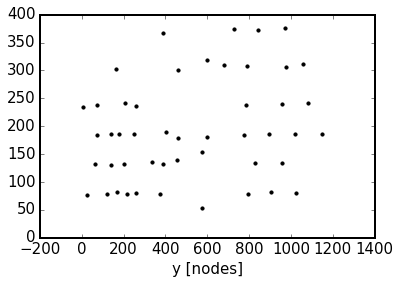

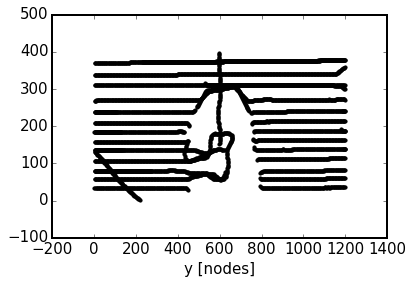

In [50]:
Plot_SR(proj_name, ext='geo', dx=dx)

In [37]:
suffix = '-FreeSurf_exten.vtr'
!cd "{proj_path}" && cp proj1{suffix} {proj_name}{suffix}

In [54]:
Check_SR(proj_name, adjust=False, ext='geo', dx=dx, proj_path=proj_path, margin_z=4)

lib_fwi_generic.py/Read_geo:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj12-Sources.geo
lib_fwi_generic.py/Read_geo:  File to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj12-Receivers.geo
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj12-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1


lib_fwi_generic.py/Check_SR: Warning. Source no. 4 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Source: [387.92, 366.88, 15.02]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Source no. 9 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Source: [598.02, 318.12, 15.32]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Source no. 10 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Source: [461.32, 300.56, 16.12]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Source no. 24 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Source: [460.94, 179.12, 13.94]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Source no. 33 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Source: [456.78, 139.6000098, 13.100000038000001]
lib_fw

lib_fwi_generic.py/Check_SR: Receiver: [818.8, 136.6000098, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1567 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [815.5, 136.56, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1568 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [812.2, 136.64, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1569 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [808.9, 136.66, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 1570 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [805.62, 136.64, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this poi

lib_fwi_generic.py/Check_SR: Receiver: [192.1, 269.84, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3740 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [194.98, 269.85998, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3741 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [197.86, 269.88, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3742 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [200.74, 269.9, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this point: 12.5
lib_fwi_generic.py/Check_SR: Warning. Receiver no. 3743 above FS + margin 4.
lib_fwi_generic.py/Check_SR: Receiver: [203.6, 269.92002, 12.74]
lib_fwi_generic.py/Check_SR: Z-coord of the free surface at this p

NameError: global name 'quit' is not defined

### Runfile

- manual changes applied afterwards too!

In [55]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]

Update_Runfile(fname, io=params['IO'], bbot=str(b_abs), bleft=str(b_abs), bright=str(b_abs), bfront=str(b_abs), bback=str(b_abs), extrabot=str(e_abs), extraleft=str(e_abs), extraright=str(e_abs), extrafront=str(e_abs), extraback=str(e_abs), seaLevel=str(z_sea), etime=str(ttime), NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'], NCOMP=params['NCOMP'], NSHOTS=params['NSHOT'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//proj12-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 15
! X. FREE SURFACE
 ibfs          : 1
seaLevel : 12.5
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 48
NSHOTS : 48
NRECS : 5401
MAXRC : 5207
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE

### PBS file

In [73]:
Make_pbs_File(proj_name, problem='inv', code='rev688_test', time="16:00:00", nnodes=11, mem_gb=120)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj12
#PBS -o proj12-Out.log
#PBS -e proj12-Err.log
#PBS -l walltime=16:00:00
#PBS -l select=11:mpiprocs=2:ompthreads=20:ncpus=40:mem=1gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export l_MPI_PIN=0
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj12

start=`date +%s`


#
# INVERSION-RUN FLOW
#

unset SLAVES_WAVEFIELDSVTR # OTHERWISE TOO MANY SNAPSHOTS 

# CHOOSE THE APPROPRIATE RUNFILE FOR INVERSION 
cp $PBS_O_WORKDIR/${project_name}-Runfile_inv.key $P

### Final checks

In [ ]:
# # CHECKS
# f = open(proj_path + proj_name + '-NumChecks.log', 'w')

# Check_Stability(f, dx, dt, vel, 'low')
# # Check_Accuracy(f, dx, vel, f_max, 'low')
# # Max_Resolution(f, dx, vel, f_max)
# # Propagation_Dists(f, dx, nx1, nx2, nx3, vel_min, vel_max, f_min, f_max)

# f.close()

## Run

### Locally

In [43]:
# !cd "{proj_path}" && trash {proj_name}-GhostData*
!cd "{proj_path}" && fwi_run_locally.sh synth 688_test {proj_name} 1> {proj_name}-Out.log 2> {proj_name}-Err.log 

^C


## Output

In [43]:
print 9054 / 20000. * 501

226.8027


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input/proj12-FreeSurf_exten.vtr
lib_fwi_generic.py/Read_vtr: min value:  7.35126
lib_fwi_generic.py/Read_vtr: max value:  14.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1301 501 1
(1301, 501)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//fw-000100-csref04140-iter00001-taskid00001.vtr
lib_fwi_generic.py/Read_vtr: min value:  -169.128
lib_fwi_generic.py/Read_vtr: max value:  1398.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1301 501 165
libplot_generic.py/Plot_Slice:  (165, 1301) (165, 1301) (165, 1301)
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/TOSHIBA EXT/BACKUP_PhD_local_07-05-2018/PROJECTS/fwi_3D_OBS_only/input//fw-000200-csref04140-iter00001-taskid00001.vtr
lib_fwi_generic.py/Read_vtr: min value:  -378.685
lib_fwi_generic.py/Read_vtr: max value:  175.466
lib_fwi_generic.py/Read

0

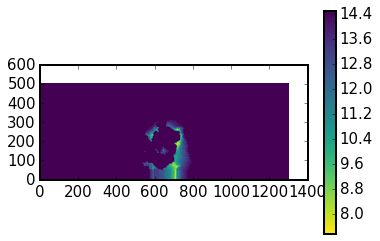

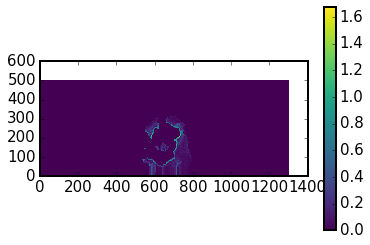

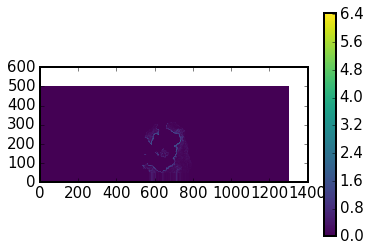

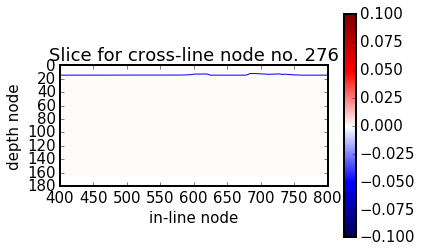

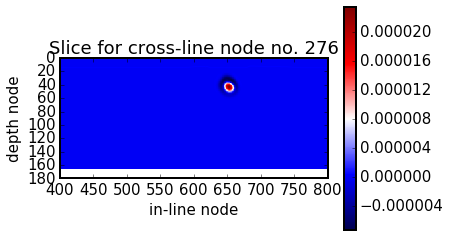

...

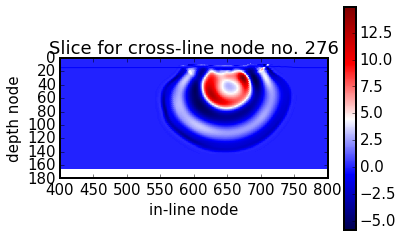

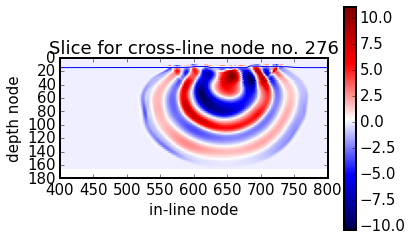

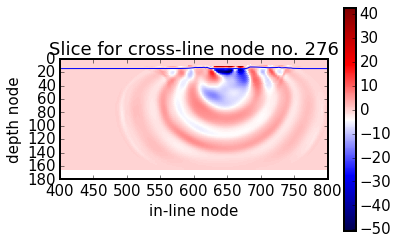

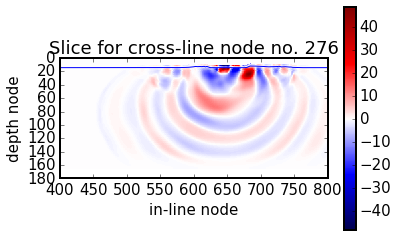

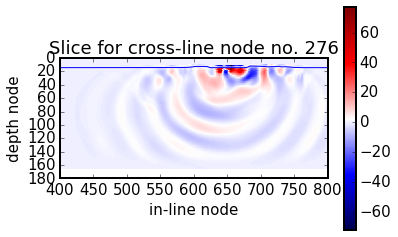

In [62]:
ycoord = 226 + 50
Plot_Project_Output(proj_name, proj_path=proj_path, yslice=ycoord, file_min=0, file_max=10, azim=0, elev=0, xlim=[400, 800])

## Conclusions

# Proj 13 (OBS137, L8; flat FS; MP wavelet)

- same as proj12 but only SYNTHETIC run for a SINGLE GATHER is investigated: OBS 137, line 8
- it has good, clean data
- both line and OBS are on the same side of the caldera in the sedimentary basin with sea surface as FS => checking the source wavelet and simulation in general

## Input

In [258]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj13'
# !cd "{proj_path}" && pwd

In [10]:
OBS = '137'
line = '8'

In [143]:
# !cd "{proj_path}" && fwi_cp_project.sh -sp -cp 'proj12' {proj_name} .
# !cd "{proj_path}" && fwi_cp_project.sh -ss -cp 'proj12' {proj_name} .

### Model

In [32]:
OBS_xyz = [51062.0000, 9307.00000, 931.0]
OBS_xyz = [i / 50. for i in OBS_xyz]
print OBS_xyz

xsl = int(OBS_xyz[0])
ysl = int(OBS_xyz[1])
zsl = int(OBS_xyz[2])

[1021.24, 186.14, 18.62]


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj13-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice:  (113, 1201) (113, 1201) (113, 1201)
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj13-FreeSurf.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1


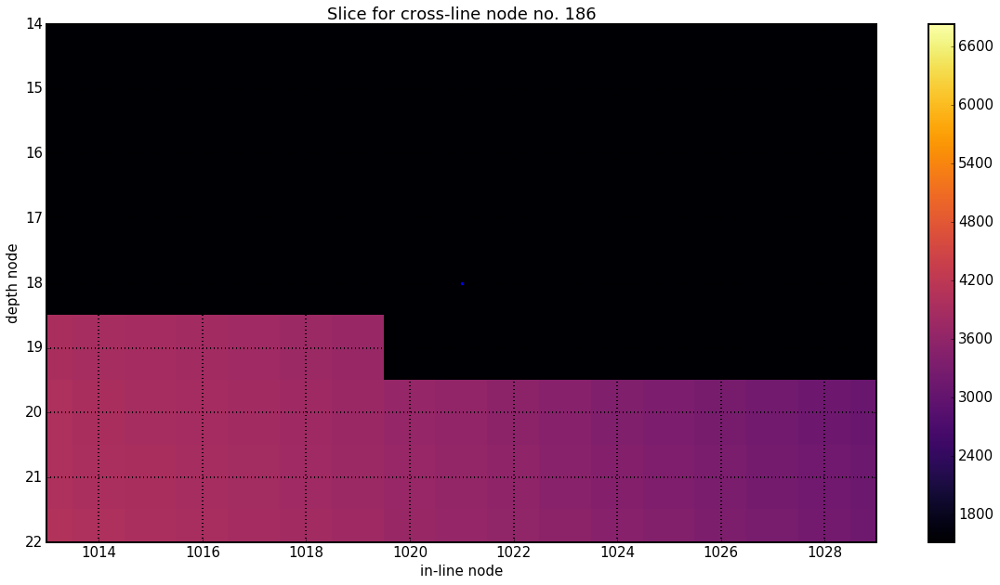

In [31]:
ax = 8
ay = 4
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
Plot_Gridded_Data_From_File(fname, yslice=ysl,  xlim=[xsl-ax, xsl+ax], ylim=[zsl-ay, zsl+ay], fig_size=[20, 10])
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ysl, xlim=[xsl-ax, xsl+ax], ylim=[zsl-ay, zsl+ay], cbar=0)
plt.gca().invert_yaxis()
plt.scatter([xsl], [zsl])
plt.grid()

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj13-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice:  (113, 401) (113, 401) (113, 401)
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj13-FreeSurf.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: inferno proceeding without a shift. 


lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1


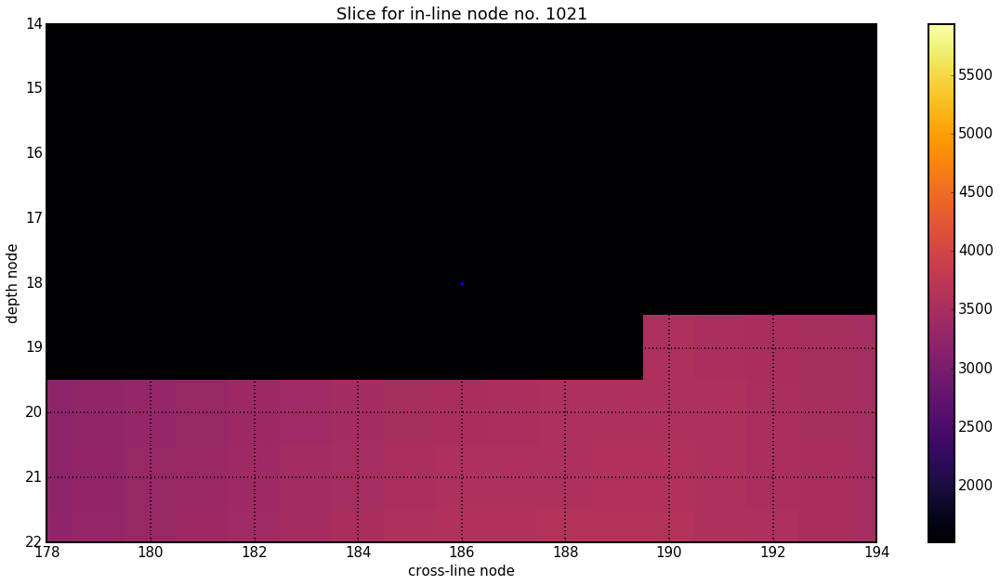

In [33]:
ax = 8
ay = 4
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
Plot_Gridded_Data_From_File(fname, xslice=xsl,  xlim=[ysl-ax, ysl+ax], ylim=[zsl-ay, zsl+ay], fig_size=[20, 10])
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', xslice=xsl, xlim=[ysl-ax, ysl+ax], ylim=[zsl-ay, zsl+ay], cbar=0)
plt.gca().invert_yaxis()
plt.scatter([ysl], [zsl])
plt.grid()

### Source wavelet

In [48]:
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | surange
!cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suxwigb
# !cd "{proj_path}" && sgyread.sh {proj_name}-RawSign.sgy | suspecfx | suxwigb

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00170661 s, 1.9 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 1788 requests (1788 known processed) with 0 events remaining.


### Observed data

#### Prepare

In [12]:
# path = proj_path + 'data/stations_lines/'
# fname_full = Get_Files(path, 'MGL*' + obs + '*line' + line + '.segy')[0]
# fname = Path_Leave(fname_full)
# fname_tmp = fname + '_tmp'
# !cd "{path}" && sgyread.sh {fname} | subfilt zerophase=0 hicut=1 locut=0 npoleslo=15 f3dblo=6.4866 | subfilt zerophase=0 hicut=0 locut=1 npoleslo=9 f3dblo=2.1769 | segyhdrs | segywrite tape={fname_tmp}
# !cd "{path}" && sgyread.sh {fname_tmp} | convert_sgy2vtr.sh 313 1 12000 {fname_tmp} 

#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/data/stations_lines//MGL1521_S137_4_line8.segy_tmp.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.27042e+07
lib_fwi_generic.py/Read_vtr: max value:  1.5819e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  313 1 12000
libplot_generic.py/Plot_Slice:  (12000, 313) (12000, 313) (12000, 313)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Shifted_Colormap: Warning. Unknown colormap: seismic proceeding without a shift. 


(500, 0)

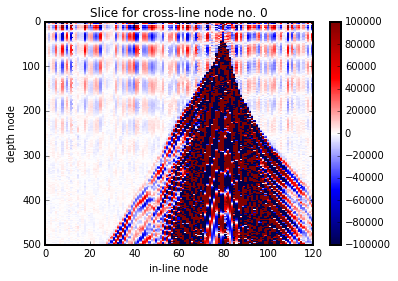

In [86]:
fname = Get_Files(path, 'MGL1521_S137_4_line8.segy_tmp.vtr')[0]
a = 1e5
Plot_Gridded_Data_From_File(fname, yslice=0, cmap='seismic', minn=-a, maxx=a)
plt.xlim(0, 120)
plt.ylim(500, 0)

#### RawSeis.txt

In [160]:
fname = proj_name + '-RawSeis.txt'
!cd "{proj_path}" && trash {fname}; ls data/stations_lines/MGL*{obs}*line{line}.segy >> {fname} 
!cd "{proj_path}" && cat {fname}

data/stations_lines/MGL1521_S137_4_line8.segy


### SegyPrep

In [162]:
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
!cd "{proj_path}" && cat {proj_name}'-SegyPrep.key'
# !cd "{proj_path}" && segyprep_v3.16 {proj_name} # INTERACTIVE => RUN IN CONSOLE

proj13
y origin : -5000
fixed array : yes
dtms : 2.5
io api : both
nx1 : 1201
x origin : -30000
nx2 : 401
z type : elevation
reciprocity : yes
text : yes
ttime : 15000.0
x shift : 0
y shift : 0
dx : 50.0
unique : yes
FFID : yes
nx3 : 113
geometry : segy
debug : yes
retain : yes
problem : synthetic
outseis : yes


In [163]:
# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 60000.0000 20000.0000 5600.0000 
4137 51062.0000 9307.00000 931.0
-Receivers
134 60000.0000 20000.0000 5600.0000 
21024 38105.0000 9259.00000 612.0
21025 38258.0000 9327.00000 612.0
21026 38416.0000 9358.00000 612.0
21027 38578.0000 9361.00000 612.0
21028 38744.0000 9352.00000 612.0
21029 38909.0000 9347.00000 612.0
21030 39075.0000 9354.00000 612.0
21031 39237.0000 9360.00000 612.0
21032 39401.0000 9352.00000 612.0
21033 39567.0000 9345.00000 612.0
21034 39732.0000 9350.00000 612.0
21035 39897.0000 9353.00000 612.0
21036 40063.0000 9353.00000 612.0
21037 40228.0000 9354.00000 612.0
21038 40393.0000 9356.00000 612.0
21039 40558.0000 9361.00000 612.0
21040 40721.0000 9367.00000 612.0
21041 40886.0000 9368.00000 612.0
21042 41050.0000 9368.00000 612.0
21043 41215.0000 9368.00000 612.0
21044 41380.0000 9367.00000 612.0
21045 41544.0000 9365.00000 612.0
21046 41709.0000 9361.00000 612.0
21047 41874.0000 9361.00000 612.0
21048 42039.0000 9360.00000 612.0
21049 42203.0000 9360.000

### Sources & receivers

lib_fwi_generic.py/Read_pgy:  File to read:  ./proj13-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  ./proj13-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

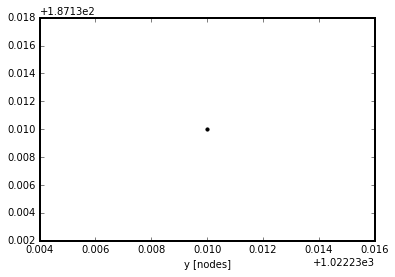

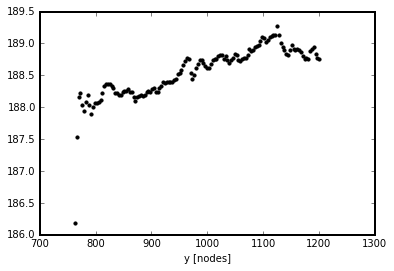

In [164]:
Plot_SR(proj_name, ext='geo', dx=dx)

In [83]:
!cd "{proj_path}" && cat {proj_name}-Sources.geo

1 60000.0000 20000.0000 5600.0000 
4137 51062.0000 9307.00000 931.0


In [84]:
!cd "{proj_path}" && cat {proj_name}-Receivers.geo

134 60000.0000 20000.0000 5600.0000 
21024 38105.0000 9259.00000 612.0
21025 38258.0000 9327.00000 612.0
21026 38416.0000 9358.00000 612.0
21027 38578.0000 9361.00000 612.0
21028 38744.0000 9352.00000 612.0
21029 38909.0000 9347.00000 612.0
21030 39075.0000 9354.00000 612.0
21031 39237.0000 9360.00000 612.0
21032 39401.0000 9352.00000 612.0
21033 39567.0000 9345.00000 612.0
21034 39732.0000 9350.00000 612.0
21035 39897.0000 9353.00000 612.0
21036 40063.0000 9353.00000 612.0
21037 40228.0000 9354.00000 612.0
21038 40393.0000 9356.00000 612.0
21039 40558.0000 9361.00000 612.0
21040 40721.0000 9367.00000 612.0
21041 40886.0000 9368.00000 612.0
21042 41050.0000 9368.00000 612.0
21043 41215.0000 9368.00000 612.0
21044 41380.0000 9367.00000 612.0
21045 41544.0000 9365.00000 612.0
21046 41709.0000 9361.00000 612.0
21047 41874.0000 9361.00000 612.0
21048 42039.0000 9360.00000 612.0
21049 42203.0000 9360.00000 612.0
21050 42368.0000 9362.00000 612.0
21051 42532.0000 9363.00000 612.0
21052 42697

### Runfile

In [184]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]

Update_Runfile(fname, io=params['IO'], bbot=str(b_abs), bleft=str(b_abs), bright=str(b_abs), bfront=str(b_abs), bback=str(b_abs), extrabot=str(e_abs), extraleft=str(e_abs), extraright=str(e_abs), extrafront=str(e_abs), extraback=str(e_abs), seaLevel=str(z_sea), etime=str(ttime), NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'], NCOMP=params['NCOMP'], NSHOTS=params['NSHOT'])
print 
# !cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
# !cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj13-Skeleton.key


! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 15
! X. FREE SURFACE
 ibfs          : 1
seaLevel : 12
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 1
NSHOTS : 1
NRECS : 134
MAXRC : 134
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY

### PBS file

In [194]:
# !fullwave3D.exe -env # SHOW ENVIROMENTAL VARS

In [36]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="00:30:00", nnodes=2, nprocesses=4, nlogic_cores=40, mem_gb=120)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

!cd "{proj_path}" && ssh_sync_project.sh kmc cx1 fwi_3D_OBS_only

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj13
#PBS -o proj13-Out.log
#PBS -e proj13-Err.log
#PBS -l walltime=00:30:00
#PBS -l select=2:mpiprocs=4:ompthreads=10:ncpus=40:mem=120gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj13

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_

## Run

### Locally

In [186]:
# IN CONSOLE!
#  !cd "{proj_path}" && fwi_run_locally.sh synth '688_test' {proj_name}


fwi_run_locally: START

fwi_run_locally: Error. Re-run with required arguments: 
fwi_run_locally: problem=$1   # synth / inv 
fwi_run_locally: code=$2 # wf2d 671 688
fwi_run_locally: project=$3 
fwi_run_locally: clean=$4 


### Remotely

In [175]:
# !cd "{proj_path}" && ssh_sync_project.sh kmc cx1 fwi_3D_OBS_only

sending incremental file list
./
jupy_fwi_3D_OBS_only.ipynb
      8,433,165 100%  129.67MB/s    0:00:00 (xfr#1, ir-chk=14010/14041)
proj1-GhostData.txt
    553,808,204 100%  137.71MB/s    0:00:03 (xfr#2, ir-chk=14005/14041)
proj1-InextNodes.txt
    313,021,837 100%   96.48MB/s    0:00:03 (xfr#3, ir-chk=14004/14041)
proj1-NumChecks.log
             52 100%    0.52kB/s    0:00:00 (xfr#4, ir-chk=14003/14041)
proj1-Observed-0000.log
             54 100%    0.54kB/s    0:00:00 (xfr#5, ir-chk=14002/14041)
proj1-Observed-0000.ttr
          9,096 100%   83.02kB/s    0:00:00 (xfr#6, ir-chk=14001/14041)
proj1-Observed-Time.vtr
     22,684,572 100%   71.63MB/s    0:00:00 (xfr#7, ir-chk=14000/14041)
proj1-Out.log
        263,287 100%  811.09kB/s    0:00:00 (xfr#8, ir-chk=13999/14041)
proj1-PointReceivers.pgy
         36,337 100%  108.52kB/s    0:00:00 (xfr#9, ir-chk=13998/14041)
proj1-PointSources.pgy
            113 100%    0.34kB/s    0:00:00 (xfr#10, ir-chk=13997/14041)
proj1-RawSign.sgy
      

         26,171 100%   52.16kB/s    0:00:00 (xfr#87, ir-chk=13920/14041)
proj10-fw-001700-csref04140-iter00001-taskid00001.png
         28,651 100%   56.64kB/s    0:00:00 (xfr#88, ir-chk=13919/14041)
proj10-fw-001800-csref04140-iter00001-taskid00001.png
         29,891 100%   58.38kB/s    0:00:00 (xfr#89, ir-chk=13918/14041)
proj10-fw-001900-csref04140-iter00001-taskid00001.png
         30,633 100%   58.54kB/s    0:00:00 (xfr#90, ir-chk=13917/14041)
proj10-fw-002000-csref04140-iter00001-taskid00001.png
         30,019 100%   56.16kB/s    0:00:00 (xfr#91, ir-chk=13916/14041)
proj10-fw-002100-csref04140-iter00001-taskid00001.png
         31,526 100%   58.42kB/s    0:00:00 (xfr#92, ir-chk=13915/14041)
proj10-fw-002200-csref04140-iter00001-taskid00001.png
         33,172 100%   60.33kB/s    0:00:00 (xfr#93, ir-chk=13914/14041)
proj10-fw-002300-csref04140-iter00001-taskid00001.png
         30,219 100%   53.95kB/s    0:00:00 (xfr#94, ir-chk=13913/14041)
proj10-fw-002400-csref04140-iter00001-

    252,358,924 100%   25.30MB/s    0:00:09 (xfr#165, ir-chk=13842/14041)
proj12-TrueVp.headers
    115,584,240 100%   67.13MB/s    0:00:01 (xfr#166, ir-chk=13841/14041)
proj12-TrueVp.sgy
    333,271,492 100%  106.98MB/s    0:00:02 (xfr#167, ir-chk=13840/14041)
proj12-TrueVp.txt
  1,073,007,028 100%   31.00MB/s    0:00:33 (xfr#168, ir-chk=13839/14041)
proj12-TrueVp.vtr
    221,536,500 100%   19.68MB/s    0:00:10 (xfr#169, ir-chk=13838/14041)
proj12-TrueVp_uncut.vtr
    256,211,772 100%   26.30MB/s    0:00:09 (xfr#170, ir-chk=13837/14041)
proj12-TrueVp_zcut.vtr
    221,536,500 100%   21.51MB/s    0:00:09 (xfr#171, ir-chk=13836/14041)
proj12-fsErr.log
  3,311,242,992 100%  141.96MB/s    0:00:22 (xfr#172, ir-chk=13835/14041)
proj12-snap000010.txt
  1,935,849,007 100%  143.61MB/s    0:00:12 (xfr#173, ir-chk=13834/14041)
proj13-ExtraPointReceivers.pgy
         11,505 100%   12.97kB/s    0:00:00 (xfr#174, ir-chk=13833/14041)
proj13-ExtraReceivers.geo
         11,513 100%   12.97kB/s    0:00:

     11,178,000 100%   20.15MB/s    0:00:00 (xfr#250, ir-chk=13757/14041)
proj2-TrueVp.txt
    103,769,100 100%   73.03MB/s    0:00:01 (xfr#251, ir-chk=13756/14041)
proj2-TrueVp.vtr
     21,424,540 100%   38.26MB/s    0:00:00 (xfr#252, ir-chk=13755/14041)
proj2-TrueVp_uncut.vtr
     24,777,940 100%   31.68MB/s    0:00:00 (xfr#253, ir-chk=13754/14041)
proj2-TrueVp_zcut.vtr
     21,424,540 100%   21.76MB/s    0:00:00 (xfr#254, ir-chk=13753/14041)
proj3-ExtraPointReceivers.pgy
        134,001 100%  137.60kB/s    0:00:00 (xfr#255, ir-chk=13752/14041)
proj3-ExtraReceivers.geo
        134,009 100%  136.18kB/s    0:00:00 (xfr#256, ir-chk=13751/14041)
proj3-FreeSurf.vtr
        558,940 100%  556.98kB/s    0:00:00 (xfr#257, ir-chk=13750/14041)
proj3-GhostData.bin
    274,747,664 100%   83.23MB/s    0:00:03 (xfr#258, ir-chk=13749/14041)
proj3-Missing-Receivers.ps
         68,305 100%  430.35kB/s    0:00:00 (xfr#259, ir-chk=13748/14041)
proj3-NumChecks.log
             52 100%    0.33kB/s    0:00

     21,424,540 100%   23.35MB/s    0:00:00 (xfr#335, ir-chk=13672/14041)
proj5-Err.log
          2,536 100%    2.80kB/s    0:00:00 (xfr#336, ir-chk=13671/14041)
proj5-ExtraPointReceivers.pgy
         16,433 100%   17.93kB/s    0:00:00 (xfr#337, ir-chk=13670/14041)
proj5-ExtraReceivers.geo
         16,441 100%   17.76kB/s    0:00:00 (xfr#338, ir-chk=13669/14041)
proj5-FreeSurf.vtr
        558,940 100%  595.25kB/s    0:00:00 (xfr#339, ir-chk=13668/14041)
proj5-GhostData.bin
    274,747,664 100%   84.66MB/s    0:00:03 (xfr#340, ir-chk=13667/14041)
proj5-Missing-Receivers.ps
         13,459 100%  127.61kB/s    0:00:00 (xfr#341, ir-chk=13666/14041)
proj5-NumChecks.log
             52 100%    0.49kB/s    0:00:00 (xfr#342, ir-chk=13665/14041)
proj5-Observed-0000.log
            851 100%    7.77kB/s    0:00:00 (xfr#343, ir-chk=13664/14041)
proj5-Observed-0000.ttm
            536 100%    4.89kB/s    0:00:00 (xfr#344, ir-chk=13663/14041)
proj5-Observed-0000.ttr
            536 100%    4.89kB/s 

        638,860 100%  655.34kB/s    0:00:00 (xfr#423, ir-chk=13584/14041)
proj7-GhostData.bin
    274,747,664 100%   70.25MB/s    0:00:03 (xfr#424, ir-chk=13583/14041)
proj7-Missing-Receivers.ps
         13,459 100%   17.71kB/s    0:00:00 (xfr#425, ir-chk=13582/14041)
proj7-NumChecks.log
             52 100%    0.07kB/s    0:00:00 (xfr#426, ir-chk=13581/14041)
proj7-Observed-0000.log
            851 100%    1.11kB/s    0:00:00 (xfr#427, ir-chk=13580/14041)
proj7-Observed-0000.ttm
            536 100%    0.70kB/s    0:00:00 (xfr#428, ir-chk=13579/14041)
proj7-Observed-0000.ttr
            536 100%    0.70kB/s    0:00:00 (xfr#429, ir-chk=13578/14041)
proj7-Observed-0000.txt
            851 100%    1.10kB/s    0:00:00 (xfr#430, ir-chk=13577/14041)
proj7-Out.log
        423,121 100%  536.63kB/s    0:00:00 (xfr#431, ir-chk=13576/14041)
proj7-OutSeis.sgy
      1,291,280 100%    1.46MB/s    0:00:00 (xfr#432, ir-chk=13575/14041)
proj7-PointReceivers.pgy
          2,097 100%    2.41kB/s    0:00

    274,747,664 100%   72.50MB/s    0:00:03 (xfr#508, ir-chk=13499/14041)
proj9-Missing-Receivers.ps
         13,459 100%   21.20kB/s    0:00:00 (xfr#509, ir-chk=13498/14041)
proj9-NumChecks.log
              0 100%    0.00kB/s    0:00:00 (xfr#510, ir-chk=13497/14041)
proj9-Observed-0000.log
            851 100%    1.32kB/s    0:00:00 (xfr#511, ir-chk=13496/14041)
proj9-Observed-0000.ttm
            536 100%    0.83kB/s    0:00:00 (xfr#512, ir-chk=13495/14041)
proj9-Observed-0000.ttr
            536 100%    0.83kB/s    0:00:00 (xfr#513, ir-chk=13494/14041)
proj9-Observed-0000.txt
            851 100%    1.31kB/s    0:00:00 (xfr#514, ir-chk=13493/14041)
proj9-Out.log
         13,125 100%   19.90kB/s    0:00:00 (xfr#515, ir-chk=13492/14041)
proj9-OutSeis.sgy
        267,280 100%  390.74kB/s    0:00:00 (xfr#516, ir-chk=13491/14041)
proj9-PointReceivers.pgy
          2,097 100%    3.05kB/s    0:00:00 (xfr#517, ir-chk=13490/14041)
proj9-PointReceivers_not_corrected.pgy
          2,097 100% 

     13,896,720 100%   11.93MB/s    0:00:01 (xfr#652, to-chk=13732/14423)
data/stations_lines/MGL1521_S104_4_line19_filt.segy
     13,896,720 100%   16.30MB/s    0:00:00 (xfr#653, to-chk=13731/14423)
data/stations_lines/MGL1521_S104_4_line19_filt_m1000.ps
     10,504,586 100%   11.24MB/s    0:00:00 (xfr#654, to-chk=13730/14423)
data/stations_lines/MGL1521_S104_4_line19_filt_m1000.segy
     13,896,720 100%   13.33MB/s    0:00:00 (xfr#655, to-chk=13729/14423)
data/stations_lines/MGL1521_S104_4_line1_filt.segy
     10,761,120 100%    6.69MB/s    0:00:01 (xfr#656, to-chk=13728/14423)
data/stations_lines/MGL1521_S104_4_line2.segy
     12,449,520 100%    8.00MB/s    0:00:01 (xfr#657, to-chk=13727/14423)
data/stations_lines/MGL1521_S104_4_line20.segy
     15,054,480 100%    9.70MB/s    0:00:01 (xfr#658, to-chk=13726/14423)
data/stations_lines/MGL1521_S104_4_line20_filt.segy
     15,054,480 100%   11.74MB/s    0:00:01 (xfr#659, to-chk=13725/14423)
data/stations_lines/MGL1521_S104_4_line20_filt

     17,514,720 100%   14.68MB/s    0:00:01 (xfr#718, to-chk=13666/14423)
data/stations_lines/MGL1521_S104_4_line27_t1.ascii
          1,290 100%    9.06kB/s    0:00:00 (xfr#719, to-chk=13665/14423)
data/stations_lines/MGL1521_S104_4_line27_t1.bin
          1,452 100%    9.52kB/s    0:00:00 (xfr#720, to-chk=13664/14423)
data/stations_lines/MGL1521_S104_4_line27_t2.ascii
          1,290 100%    8.08kB/s    0:00:00 (xfr#721, to-chk=13663/14423)
data/stations_lines/MGL1521_S104_4_line27_t2.bin
          1,452 100%    8.81kB/s    0:00:00 (xfr#722, to-chk=13662/14423)
data/stations_lines/MGL1521_S104_4_line28.segy
      1,402,560 100%    4.85MB/s    0:00:00 (xfr#723, to-chk=13661/14423)
data/stations_lines/MGL1521_S104_4_line28_filt.segy
      1,402,560 100%    3.79MB/s    0:00:00 (xfr#724, to-chk=13660/14423)
data/stations_lines/MGL1521_S104_4_line28_filt_m1000.png
          7,188 100%   19.28kB/s    0:00:00 (xfr#725, to-chk=13659/14423)
data/stations_lines/MGL1521_S104_4_line28_filt_m1000

      1,933,200 100%    3.56MB/s    0:00:00 (xfr#848, to-chk=13536/14423)
data/stations_lines/MGL1521_S104_4_line53.segy
     10,905,840 100%    8.20MB/s    0:00:01 (xfr#849, to-chk=13535/14423)
data/stations_lines/MGL1521_S104_4_line53_filt.segy
     10,905,840 100%   12.75MB/s    0:00:00 (xfr#850, to-chk=13534/14423)
data/stations_lines/MGL1521_S104_4_line54.segy
      5,068,800 100%    4.10MB/s    0:00:01 (xfr#851, to-chk=13533/14423)
data/stations_lines/MGL1521_S104_4_line54_filt.segy
      5,068,800 100%   10.91MB/s    0:00:00 (xfr#852, to-chk=13532/14423)
data/stations_lines/MGL1521_S104_4_line54_filt_m1000.ps
      3,844,651 100%    7.54MB/s    0:00:00 (xfr#853, to-chk=13531/14423)
data/stations_lines/MGL1521_S104_4_line54_filt_m1000.segy
      5,068,800 100%    9.16MB/s    0:00:00 (xfr#854, to-chk=13530/14423)
data/stations_lines/MGL1521_S104_4_line55.segy
      4,296,960 100%    5.10MB/s    0:00:00 (xfr#855, to-chk=13529/14423)
data/stations_lines/MGL1521_S104_4_line55_filt.se

     16,694,640 100%   12.40MB/s    0:00:01 (xfr#978, to-chk=13406/14423)
data/stations_lines/MGL1521_S106_4_line17_filt_m1000.png
          8,356 100%   28.53kB/s    0:00:00 (xfr#979, to-chk=13405/14423)
data/stations_lines/MGL1521_S106_4_line17_filt_m1000.segy
     16,694,640 100%   39.12MB/s    0:00:00 (xfr#980, to-chk=13404/14423)
data/stations_lines/MGL1521_S106_4_line17_t1.ascii
          1,082 100%    2.60kB/s    0:00:00 (xfr#981, to-chk=13403/14423)
data/stations_lines/MGL1521_S106_4_line17_t1.bin
          1,384 100%    3.30kB/s    0:00:00 (xfr#982, to-chk=13402/14423)
data/stations_lines/MGL1521_S106_4_line17_t2.ascii
          1,082 100%    2.55kB/s    0:00:00 (xfr#983, to-chk=13401/14423)
data/stations_lines/MGL1521_S106_4_line17_t2.bin
          1,384 100%    3.19kB/s    0:00:00 (xfr#984, to-chk=13400/14423)
data/stations_lines/MGL1521_S106_4_line18.segy
     16,839,360 100%   10.31MB/s    0:00:01 (xfr#985, to-chk=13399/14423)
data/stations_lines/MGL1521_S106_4_line18_filt

     17,370,000 100%   27.65MB/s    0:00:00 (xfr#1043, to-chk=13341/14423)
data/stations_lines/MGL1521_S106_4_line24_t1.ascii
            888 100%    1.44kB/s    0:00:00 (xfr#1044, to-chk=13340/14423)
data/stations_lines/MGL1521_S106_4_line24_t1.bin
          1,440 100%    2.30kB/s    0:00:00 (xfr#1045, to-chk=13339/14423)
data/stations_lines/MGL1521_S106_4_line24_t2.ascii
            888 100%    1.41kB/s    0:00:00 (xfr#1046, to-chk=13338/14423)
data/stations_lines/MGL1521_S106_4_line24_t2.bin
          1,440 100%    2.26kB/s    0:00:00 (xfr#1047, to-chk=13337/14423)
data/stations_lines/MGL1521_S106_4_line25.segy
     16,115,760 100%    8.62MB/s    0:00:01 (xfr#1048, to-chk=13336/14423)
data/stations_lines/MGL1521_S106_4_line25_filt.segy
     16,115,760 100%    9.67MB/s    0:00:01 (xfr#1049, to-chk=13335/14423)
data/stations_lines/MGL1521_S106_4_line25_t1.ascii
            905 100%    1.49kB/s    0:00:00 (xfr#1050, to-chk=13334/14423)
data/stations_lines/MGL1521_S106_4_line25_t1.bin
 

      7,336,080 100%    6.35MB/s    0:00:01 (xfr#1108, to-chk=13276/14423)
data/stations_lines/MGL1521_S106_4_line32_filt.segy
      7,336,080 100%   15.72MB/s    0:00:00 (xfr#1109, to-chk=13275/14423)
data/stations_lines/MGL1521_S106_4_line32_t1.ascii
            760 100%    1.63kB/s    0:00:00 (xfr#1110, to-chk=13274/14423)
data/stations_lines/MGL1521_S106_4_line32_t1.bin
            608 100%    1.29kB/s    0:00:00 (xfr#1111, to-chk=13273/14423)
data/stations_lines/MGL1521_S106_4_line32_t2.ascii
            760 100%    1.60kB/s    0:00:00 (xfr#1112, to-chk=13272/14423)
data/stations_lines/MGL1521_S106_4_line32_t2.bin
            608 100%    1.25kB/s    0:00:00 (xfr#1113, to-chk=13271/14423)
data/stations_lines/MGL1521_S106_4_line33.segy
      9,603,360 100%    8.33MB/s    0:00:01 (xfr#1114, to-chk=13270/14423)
data/stations_lines/MGL1521_S106_4_line33_filt.segy
      9,603,360 100%   15.85MB/s    0:00:00 (xfr#1115, to-chk=13269/14423)
data/stations_lines/MGL1521_S106_4_line33_filt_m1

      9,120,960 100%    7.38MB/s    0:00:01 (xfr#1173, to-chk=13211/14423)
data/stations_lines/MGL1521_S106_4_line41_filt_m1000.png
          8,119 100%   43.56kB/s    0:00:00 (xfr#1174, to-chk=13210/14423)
data/stations_lines/MGL1521_S106_4_line41_filt_m1000.segy
      9,120,960 100%   34.38MB/s    0:00:00 (xfr#1175, to-chk=13209/14423)
data/stations_lines/MGL1521_S106_4_line41_t1.ascii
            609 100%    2.29kB/s    0:00:00 (xfr#1176, to-chk=13208/14423)
data/stations_lines/MGL1521_S106_4_line41_t1.bin
            756 100%    2.78kB/s    0:00:00 (xfr#1177, to-chk=13207/14423)
data/stations_lines/MGL1521_S106_4_line41_t2.ascii
            626 100%    2.23kB/s    0:00:00 (xfr#1178, to-chk=13206/14423)
data/stations_lines/MGL1521_S106_4_line41_t2.bin
            756 100%    2.63kB/s    0:00:00 (xfr#1179, to-chk=13205/14423)
data/stations_lines/MGL1521_S106_4_line42.segy
      8,783,280 100%    9.80MB/s    0:00:00 (xfr#1180, to-chk=13204/14423)
data/stations_lines/MGL1521_S106_4_lin

      3,332,160 100%   18.26MB/s    0:00:00 (xfr#1239, to-chk=13145/14423)
data/stations_lines/MGL1521_S106_4_line59.segy
      1,450,800 100%    4.91MB/s    0:00:00 (xfr#1240, to-chk=13144/14423)
data/stations_lines/MGL1521_S106_4_line59_filt.segy
      1,450,800 100%    3.77MB/s    0:00:00 (xfr#1241, to-chk=13143/14423)
data/stations_lines/MGL1521_S106_4_line5_filt.segy
     30,491,280 100%   15.71MB/s    0:00:01 (xfr#1242, to-chk=13142/14423)
data/stations_lines/MGL1521_S106_4_line5_filt_m1000.png
          6,948 100%    7.90kB/s    0:00:00 (xfr#1243, to-chk=13141/14423)
data/stations_lines/MGL1521_S106_4_line5_filt_m1000.segy
     30,491,280 100%   26.68MB/s    0:00:01 (xfr#1244, to-chk=13140/14423)
data/stations_lines/MGL1521_S106_4_line5_t1.ascii
          2,156 100%   20.85kB/s    0:00:00 (xfr#1245, to-chk=13139/14423)
data/stations_lines/MGL1521_S106_4_line5_t1.bin
          2,528 100%   22.86kB/s    0:00:00 (xfr#1246, to-chk=13138/14423)
data/stations_lines/MGL1521_S106_4_line

     10,471,680 100%    8.61MB/s    0:00:01 (xfr#1304, to-chk=13080/14423)
data/stations_lines/MGL1521_S109_4_line12_filt.segy
     10,471,680 100%   14.41MB/s    0:00:00 (xfr#1305, to-chk=13079/14423)
data/stations_lines/MGL1521_S109_4_line12_t1.ascii
            560 100%    0.78kB/s    0:00:00 (xfr#1306, to-chk=13078/14423)
data/stations_lines/MGL1521_S109_4_line12_t1.bin
            868 100%    1.20kB/s    0:00:00 (xfr#1307, to-chk=13077/14423)
data/stations_lines/MGL1521_S109_4_line12_t2.ascii
            560 100%    0.77kB/s    0:00:00 (xfr#1308, to-chk=13076/14423)
data/stations_lines/MGL1521_S109_4_line12_t2.bin
            868 100%    1.18kB/s    0:00:00 (xfr#1309, to-chk=13075/14423)
data/stations_lines/MGL1521_S109_4_line13.segy
     11,436,480 100%    6.98MB/s    0:00:01 (xfr#1310, to-chk=13074/14423)
data/stations_lines/MGL1521_S109_4_line13_filt.segy
     11,436,480 100%    9.48MB/s    0:00:01 (xfr#1311, to-chk=13073/14423)
data/stations_lines/MGL1521_S109_4_line13_t1.asci

      1,402,560 100%    2.10MB/s    0:00:00 (xfr#1372, to-chk=13012/14423)
data/stations_lines/MGL1521_S109_4_line28_filt.segy
      1,402,560 100%    1.87MB/s    0:00:00 (xfr#1373, to-chk=13011/14423)
data/stations_lines/MGL1521_S109_4_line28_filt_m1000.ps
      1,073,547 100%    1.39MB/s    0:00:00 (xfr#1374, to-chk=13010/14423)
data/stations_lines/MGL1521_S109_4_line28_filt_m1000.segy
      1,402,560 100%    1.77MB/s    0:00:00 (xfr#1375, to-chk=13009/14423)
data/stations_lines/MGL1521_S109_4_line29.segy
     16,887,600 100%    7.97MB/s    0:00:02 (xfr#1376, to-chk=13008/14423)
data/stations_lines/MGL1521_S109_4_line29_filt.segy
     16,887,600 100%   18.66MB/s    0:00:00 (xfr#1377, to-chk=13007/14423)
data/stations_lines/MGL1521_S109_4_line29_filt_m1000.ps
     12,765,328 100%   12.68MB/s    0:00:00 (xfr#1378, to-chk=13006/14423)
data/stations_lines/MGL1521_S109_4_line29_filt_m1000.segy
     16,887,600 100%   14.71MB/s    0:00:01 (xfr#1379, to-chk=13005/14423)
data/stations_lines/M

      9,120,960 100%   17.75MB/s    0:00:00 (xfr#1437, to-chk=12947/14423)
data/stations_lines/MGL1521_S109_4_line42.segy
      8,783,280 100%    7.95MB/s    0:00:01 (xfr#1438, to-chk=12946/14423)
data/stations_lines/MGL1521_S109_4_line42_filt.segy
      8,783,280 100%   16.30MB/s    0:00:00 (xfr#1439, to-chk=12945/14423)
data/stations_lines/MGL1521_S109_4_line42_filt_m1000.ps
      6,639,787 100%   11.17MB/s    0:00:00 (xfr#1440, to-chk=12944/14423)
data/stations_lines/MGL1521_S109_4_line42_filt_m1000.segy
      8,783,280 100%   13.09MB/s    0:00:00 (xfr#1441, to-chk=12943/14423)
data/stations_lines/MGL1521_S109_4_line43.segy
      8,493,840 100%    6.61MB/s    0:00:01 (xfr#1442, to-chk=12942/14423)
data/stations_lines/MGL1521_S109_4_line43_filt.segy
      8,493,840 100%   12.39MB/s    0:00:00 (xfr#1443, to-chk=12941/14423)
data/stations_lines/MGL1521_S109_4_line43_filt_m1000.ps
      6,421,008 100%    8.66MB/s    0:00:00 (xfr#1444, to-chk=12940/14423)
data/stations_lines/MGL1521_S109

          2,528 100%    3.29kB/s    0:00:00 (xfr#1502, to-chk=12882/14423)
data/stations_lines/MGL1521_S109_4_line6.segy
     33,482,160 100%   10.84MB/s    0:00:02 (xfr#1503, to-chk=12881/14423)
data/stations_lines/MGL1521_S109_4_line60.segy
      1,161,360 100%    1.06MB/s    0:00:01 (xfr#1504, to-chk=12880/14423)
data/stations_lines/MGL1521_S109_4_line60_filt.segy
      1,161,360 100%   10.07MB/s    0:00:00 (xfr#1505, to-chk=12879/14423)
data/stations_lines/MGL1521_S109_4_line60_filt_m1000.ps
        878,935 100%    6.71MB/s    0:00:00 (xfr#1506, to-chk=12878/14423)
data/stations_lines/MGL1521_S109_4_line60_filt_m1000.segy
      1,161,360 100%    7.86MB/s    0:00:00 (xfr#1507, to-chk=12877/14423)
data/stations_lines/MGL1521_S109_4_line6_filt.segy
     33,482,160 100%   18.17MB/s    0:00:01 (xfr#1508, to-chk=12876/14423)
data/stations_lines/MGL1521_S109_4_line6_filt_m1000.png
          7,371 100%    9.46kB/s    0:00:00 (xfr#1509, to-chk=12875/14423)
data/stations_lines/MGL1521_S109_4

     14,379,120 100%    7.02MB/s    0:00:01 (xfr#1570, to-chk=12814/14423)
data/stations_lines/MGL1521_S112_4_line14_filt.segy
     14,379,120 100%    8.17MB/s    0:00:01 (xfr#1571, to-chk=12813/14423)
data/stations_lines/MGL1521_S112_4_line14_t1.ascii
            947 100%    1.34kB/s    0:00:00 (xfr#1572, to-chk=12812/14423)
data/stations_lines/MGL1521_S112_4_line14_t1.bin
          1,192 100%    1.67kB/s    0:00:00 (xfr#1573, to-chk=12811/14423)
data/stations_lines/MGL1521_S112_4_line14_t2.ascii
            947 100%    1.31kB/s    0:00:00 (xfr#1574, to-chk=12810/14423)
data/stations_lines/MGL1521_S112_4_line14_t2.bin
          1,192 100%    1.63kB/s    0:00:00 (xfr#1575, to-chk=12809/14423)
data/stations_lines/MGL1521_S112_4_line15.segy
      2,946,240 100%    3.05MB/s    0:00:00 (xfr#1576, to-chk=12808/14423)
data/stations_lines/MGL1521_S112_4_line15_filt.segy
      2,946,240 100%    2.61MB/s    0:00:01 (xfr#1577, to-chk=12807/14423)
data/stations_lines/MGL1521_S112_4_line16.segy
  

     17,032,320 100%   21.46MB/s    0:00:00 (xfr#1635, to-chk=12749/14423)
data/stations_lines/MGL1521_S112_4_line23_t1.ascii
            901 100%    1.15kB/s    0:00:00 (xfr#1636, to-chk=12748/14423)
data/stations_lines/MGL1521_S112_4_line23_t1.bin
          1,412 100%    1.80kB/s    0:00:00 (xfr#1637, to-chk=12747/14423)
data/stations_lines/MGL1521_S112_4_line23_t2.ascii
            901 100%    1.13kB/s    0:00:00 (xfr#1638, to-chk=12746/14423)
data/stations_lines/MGL1521_S112_4_line23_t2.bin
          1,412 100%    1.75kB/s    0:00:00 (xfr#1639, to-chk=12745/14423)
data/stations_lines/MGL1521_S112_4_line24.segy
     17,370,000 100%    8.46MB/s    0:00:01 (xfr#1640, to-chk=12744/14423)
data/stations_lines/MGL1521_S112_4_line24_filt.segy
     17,370,000 100%    8.99MB/s    0:00:01 (xfr#1641, to-chk=12743/14423)
data/stations_lines/MGL1521_S112_4_line24_filt_m1000.png
          7,480 100%    8.56kB/s    0:00:00 (xfr#1642, to-chk=12742/14423)
data/stations_lines/MGL1521_S112_4_line24_fi

      7,271,777 100%   25.78MB/s    0:00:00 (xfr#1700, to-chk=12684/14423)
data/stations_lines/MGL1521_S112_4_line33_filt_m1000.segy
      9,603,360 100%   26.78MB/s    0:00:00 (xfr#1701, to-chk=12683/14423)
data/stations_lines/MGL1521_S112_4_line34.segy
      8,397,360 100%    8.59MB/s    0:00:00 (xfr#1702, to-chk=12682/14423)
data/stations_lines/MGL1521_S112_4_line34_filt.segy
      8,397,360 100%    5.88MB/s    0:00:01 (xfr#1703, to-chk=12681/14423)
data/stations_lines/MGL1521_S112_4_line34_filt_m1000.png
          7,586 100%   19.86kB/s    0:00:00 (xfr#1704, to-chk=12680/14423)
data/stations_lines/MGL1521_S112_4_line34_filt_m1000.segy
      8,397,360 100%   18.20MB/s    0:00:00 (xfr#1705, to-chk=12679/14423)
data/stations_lines/MGL1521_S112_4_line34_t1.ascii
            426 100%    0.95kB/s    0:00:00 (xfr#1706, to-chk=12678/14423)
data/stations_lines/MGL1521_S112_4_line34_t1.bin
            696 100%    1.52kB/s    0:00:00 (xfr#1707, to-chk=12677/14423)
data/stations_lines/MGL1521_

data/stations_lines/MGL1521_S112_4_line4_t2.bin
          2,488 100%   12.21kB/s    0:00:00 (xfr#1768, to-chk=12616/14423)
data/stations_lines/MGL1521_S112_4_line5.segy
     30,491,280 100%   13.32MB/s    0:00:02 (xfr#1769, to-chk=12615/14423)
data/stations_lines/MGL1521_S112_4_line50.segy
         51,840 100%  263.67kB/s    0:00:00 (xfr#1770, to-chk=12614/14423)
data/stations_lines/MGL1521_S112_4_line50_filt.segy
         51,840 100%  248.16kB/s    0:00:00 (xfr#1771, to-chk=12613/14423)
data/stations_lines/MGL1521_S112_4_line51.segy
      1,354,320 100%    4.22MB/s    0:00:00 (xfr#1772, to-chk=12612/14423)
data/stations_lines/MGL1521_S112_4_line51_filt.segy
      1,354,320 100%    3.44MB/s    0:00:00 (xfr#1773, to-chk=12611/14423)
data/stations_lines/MGL1521_S112_4_line52.segy
      1,933,200 100%    3.46MB/s    0:00:00 (xfr#1774, to-chk=12610/14423)
data/stations_lines/MGL1521_S112_4_line52_filt.segy
      1,933,200 100%    2.91MB/s    0:00:00 (xfr#1775, to-chk=12609/14423)
data/stat

     17,370,000 100%   32.17MB/s    0:00:00 (xfr#1897, to-chk=12487/14423)
data/stations_lines/MGL1521_S113_4_line25.segy
     16,115,760 100%    8.82MB/s    0:00:01 (xfr#1898, to-chk=12486/14423)
data/stations_lines/MGL1521_S113_4_line25_filt.segy
     16,115,760 100%    9.55MB/s    0:00:01 (xfr#1899, to-chk=12485/14423)
data/stations_lines/MGL1521_S113_4_line26.segy
     17,273,520 100%    9.16MB/s    0:00:01 (xfr#1900, to-chk=12484/14423)
data/stations_lines/MGL1521_S113_4_line26_filt.segy
     17,273,520 100%    9.62MB/s    0:00:01 (xfr#1901, to-chk=12483/14423)
data/stations_lines/MGL1521_S113_4_line26_filt_m1000.ps
     13,057,020 100%   15.26MB/s    0:00:00 (xfr#1902, to-chk=12482/14423)
data/stations_lines/MGL1521_S113_4_line26_filt_m1000.segy
     17,273,520 100%   16.91MB/s    0:00:00 (xfr#1903, to-chk=12481/14423)
data/stations_lines/MGL1521_S113_4_line27.segy
     17,514,720 100%    7.59MB/s    0:00:02 (xfr#1904, to-chk=12480/14423)
data/stations_lines/MGL1521_S113_4_line27

     14,223,779 100%   50.80MB/s    0:00:00 (xfr#1962, to-chk=12422/14423)
data/stations_lines/MGL1521_S113_4_line38_filt_m1000.segy
     18,817,200 100%   42.42MB/s    0:00:00 (xfr#1963, to-chk=12421/14423)
data/stations_lines/MGL1521_S113_4_line39.segy
         51,840 100%  116.92kB/s    0:00:00 (xfr#1964, to-chk=12420/14423)
data/stations_lines/MGL1521_S113_4_line39_filt.segy
         51,840 100%  115.85kB/s    0:00:00 (xfr#1965, to-chk=12419/14423)
data/stations_lines/MGL1521_S113_4_line3_filt.segy
     16,019,280 100%   11.71MB/s    0:00:01 (xfr#1966, to-chk=12418/14423)
data/stations_lines/MGL1521_S113_4_line4.segy
     30,008,880 100%   12.64MB/s    0:00:02 (xfr#1967, to-chk=12417/14423)
data/stations_lines/MGL1521_S113_4_line40.segy
      8,928,000 100%   10.06MB/s    0:00:00 (xfr#1968, to-chk=12416/14423)
data/stations_lines/MGL1521_S113_4_line40_filt.segy
      8,928,000 100%    6.61MB/s    0:00:01 (xfr#1969, to-chk=12415/14423)
data/stations_lines/MGL1521_S113_4_line41.segy


      3,332,160 100%    5.13MB/s    0:00:00 (xfr#2027, to-chk=12357/14423)
data/stations_lines/MGL1521_S113_4_line58_filt_m1000.ps
      2,531,781 100%    3.70MB/s    0:00:00 (xfr#2028, to-chk=12356/14423)
data/stations_lines/MGL1521_S113_4_line58_filt_m1000.segy
      3,332,160 100%    4.66MB/s    0:00:00 (xfr#2029, to-chk=12355/14423)
data/stations_lines/MGL1521_S113_4_line59.segy
      1,450,800 100%    1.74MB/s    0:00:00 (xfr#2030, to-chk=12354/14423)
data/stations_lines/MGL1521_S113_4_line59_filt.segy
      1,450,800 100%    1.59MB/s    0:00:00 (xfr#2031, to-chk=12353/14423)
data/stations_lines/MGL1521_S113_4_line5_filt.segy
     30,491,280 100%   12.49MB/s    0:00:02 (xfr#2032, to-chk=12352/14423)
data/stations_lines/MGL1521_S113_4_line5_filt_m1000.png
          7,990 100%   23.22kB/s    0:00:00 (xfr#2033, to-chk=12351/14423)
data/stations_lines/MGL1521_S113_4_line5_filt_m1000.segy
     30,491,280 100%   51.65MB/s    0:00:00 (xfr#2034, to-chk=12350/14423)
data/stations_lines/MGL

## Output

### Gather

lib_fwi_generic.py/Read_vtr:  File:  proj13-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.701766
lib_fwi_generic.py/Read_vtr: max value:  0.726602
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 6000
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.001 0.001 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 134) (6000, 134) (6000, 134)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(750, 250)

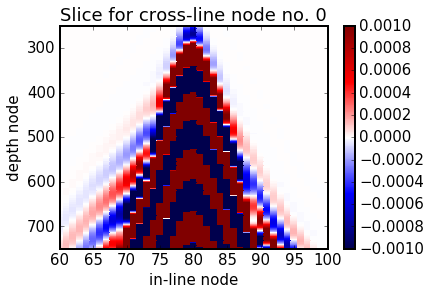

In [238]:
a = 0.001
Plot_Gridded_Data_From_File('proj13-Synthetic.vtr', yslice=0, cmap='seismic', minn=-a, maxx=a)
plt.xlim(60, 100)
plt.ylim(750, 250)

### Wavefield snapshots

In [39]:
eall = 50 # extra nodes

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj13-Runfile.key
lib_fwi_generic.py/Set_Extra_Nodes:  extratop, extraleft, extrafront 2.0 50.0 50.0
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj13-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj13-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha 1517.41 6160.23 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 401 113
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shap

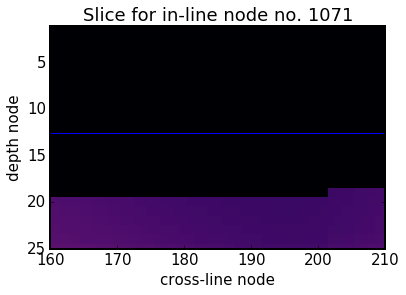

In [268]:
Plot_Project_Output(proj_name, proj_path=proj_path, gather=False, plot_mod=True, plot_fs=True, xslice=xsl+eall, file_min=10, file_max=10)  #, xlim=[ysl+eall-50, ysl+eall+50], ylim=[zsl+2+10, zsl+2-10])
plt.xlim(160, 210)#nx2)#, 22)
plt.ylim(1, 25)#113)
plt.gca().invert_yaxis()

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj13-Runfile.key
lib_fwi_generic.py/Set_Extra_Nodes:  extratop, extraleft, extrafront 2.0 50.0 50.0
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj13-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj13-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (113, 401) (113, 401) (113, 401)
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha 1517.41 6160.23 1
0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
0 8
0 9
0 10
0 11
0 12
0 13
0 14
0 15
0 16
0 17
0 18
0 19

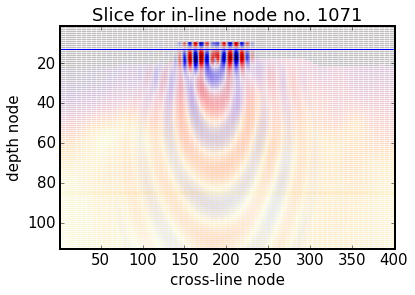

In [162]:
Plot_Project_Output(proj_name, proj_path=proj_path, gather=False, plot_mod=True, plot_fs=True, xslice=xsl+eall, file_min=10, file_max=10)  #, xlim=[ysl+eall-50, ysl+eall+50], ylim=[zsl+2+10, zsl+2-10])
plt.xlim(1, nx2)#, 22)
plt.ylim(1, 113)
plt.gca().invert_yaxis()

# Proj 14 (-||- but FS=0 <= speed benchmark)

- same as proj13 but FS was switched off to investigate why it is so slow
- it seems I aborted it myself after a minute?

## Input

In [65]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj14'
# !cd "{proj_path}" && pwd

In [38]:
obs = '137'
line = '8'

In [39]:
!cd "{proj_path}" && fwi_cp_project.sh -ss -cp 'proj13' {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
-Template.sgy
-TrueVp.sgy
-TrueVs.sgy
cp: cannot stat 'proj13-TrueVs.sgy': No such file or directory
-StartVp.sgy
cp: cannot stat 'proj13-StartVp.sgy': No such file or directory
-StartVs.sgy
cp: cannot stat 'proj13-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 43 s


### Runfile

In [45]:
!cd "{proj_path}" && fwi_cp_project.sh -p -cp 'proj13' {proj_name} . proj13*Runfile*


fwi_cp_project.sh: START

fwi_cp_project.sh: Files read as command line arguments...
fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_inv.key
-Runfile_synth.key

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 0 s


In [63]:
fnames = Get_Files(proj_path, proj_name + '*Runfile*key')
for fname in fnames:
    fname = Path_Leave(fname)
    !cd "{proj_path}" && sed -i -e  "s/ibfs          : 1/ibfs          : 0/g" {fname}

In [64]:
!cd "{proj_path}" && cat {proj_name + '-Runfile.key'}

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 15
! X. FREE SURFACE
 ibfs          : 0
seaLevel : 12
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 1
NSHOTS : 1
NRECS : 134
MAXRC : 134
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY MODEL
 velcut : 1542  ! 1542 BASED ON MP'S FILE water_vp_50_deep.txt
! I. DENSITY MODEL
 water velocity          : 1542 !
 Gardne

### PBS file

In [194]:
# !fullwave3D.exe -env # SHOW ENVIROMENTAL VARS

In [66]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="00:30:00", nnodes=1, nprocesses=4, nlogic_cores=40, mem_gb=120)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

!cd "{proj_path}" && ssh_sync_project.sh kmc cx1 fwi_3D_OBS_only

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj14
#PBS -o proj14-Out.log
#PBS -e proj14-Err.log
#PBS -l walltime=00:30:00
#PBS -l select=1:mpiprocs=4:ompthreads=10:ncpus=40:mem=120gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj14

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_

## Run

## Output

# Proj 15 (-||- but model cut to sea surface)

- same as proj13 but no FS and model cut to sea surface => compare synthetic and observed gathers
- vanilla rev688 was used, no FS implemented
- it took a bit less than 1h on 2 nodes
- due to the cutting the time-save just from the smaller model should be around  $12/113\approx10\%$
- the gather is very similar to proj13 (=> very different from observed one):
    - it starts late
    - it has a weird diagonal feature

In [272]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj15'
# !cd "{proj_path}" && pwd

In [256]:
print 12 / 113.

0.106194690265


## Input

### Basic parameters

In [192]:
# SPACE-TIME DISCRETIZATION
dx = 50.000 # m
dt = 0.0025 # s

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# XY RANGES 
x1_box = -3e4 
x2_box = 3e4 
y1_box = -5e3 
y2_box =  15e3

# ROUNDING DOWN
x1_box, x2_box, y1_box, y2_box = [int(i / dx) * int(dx) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box
# NOTE: z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = (131 - 1) * dx # m # 131 IS NX3 OF THE MODEL FROM UO
ttime = 15 # s # 10 IS NOT ENOUGH TO INCLUDE ALL MANUAL PICKS!

# METRES->NODES CONVERSION
nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

dt_ms = dt * 1000. # ms
ttime_ms = ttime * 1000. # ms

# ABSORBING BOUNDARIES
b_abs = 40 # VALUES FROM DEFAULT -Skeleton.key GENERATED
e_abs = 50 # BY SegyPrep 3.16

# VELOCITY MODEL
v_air_ben = 0 # VELOCITY OF THE AIR LAYER IN BEN'S MODEL
z_pad = 5 # NO. OF NODES LEFT BETWEEN THE HIGHEST POINT OF THE FREE SURFACE AND 1ST NODE OF THE GRID

# SOURCE WAVELET (TO BE READ FROM FILE)

# PLOTTING
minn = 0
maxx = 8000
xcoord = int(nx1 / 2)
ycoord = int(nx2 / 2)

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -30000 30000 -5000 15000
nx1 1201
nx2 401
nx3_original 131
ns 6000


### Model

#### Prepare

##### Cut in both XY and Z

In [193]:
# CUT IN XY
cut_mod_path = mod_path 
cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
!segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# !ls "{cut_mod_path}"{cut_mod_file}

!cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# FULL CONVERSION sgy TO vtr
!cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

# CUT IN Z (MUST BE PROCEEDED WITH XY-CUTTING EVERY TIME)
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

topo_min = Check_Model_Highest_Topo(model, v_air_ben)
z_min = topo_min[-1] - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min # IMPORTANT!
print 'nx3 after the cut(!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00168877 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.88e-05 s, 32.4 MB/s

convert_sgy2vtr.sh: START

convert_sgy2vtr.sh: nx1= 1201
convert_sgy2vtr.sh: nx2= 401
convert_sgy2vtr.sh: nx3= 131
SEG-Y file to convert: proj15-TrueVp.sgy

convert_sgy2bin.sh: START

convert_sgy2bin.sh: SEG-Y file to convert: proj15-TrueVp.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00172836 s, 1.9 MB/s
n1=131 n2=481601 d1=0.000050
nt=131 ntr=481601 dt=0.000050
ns=131

convert_sgy2bin.sh: END
Runtime of the convert_sgy2bin.sh: 4 s

convert_bin2txt.sh: START

convert_bin2txt.sh: No. of samples (z nodes): 131
.bin file to convert: proj15-TrueVp.bin
n=481601

convert_bin2txt.sh: END
Runtime of the convert_bin2txt.sh: 43 s
lib_fwi_generic.py/Save_vtr: File to save:  proj15-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  131 401 

##### Determine the sea level

- free surface can only be determined from the model with the accuracy dx
- any value between n_air (no. of nodes of air) and (n_air+dx) is then equally justified
- therefore natural seems to be the choice of z_sea = n_air + 0.5*dx
- spread_bounce, however, requires integer values of FS => z_sea = n_air or z_sea = n_air + dx
- inspection of synthetics can help choosing one of the two.

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj15-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


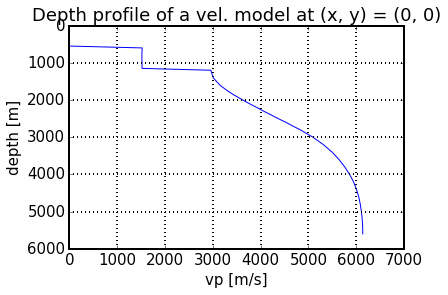

In [194]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, v in enumerate(sea_xy):
    if v != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Additionally cut to sea surface

In [195]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_m, nx2_m, nx3_m, model = Read_vtr(fname)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj15-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


In [197]:
print z_sea

12


In [198]:
print model.shape
nx1_m, nx2_m, nx3_m, model = cut_model(nx1_m, nx2_m, nx3_m, model, [], [], [z_sea + 1, nx3_m])

(1201, 401, 113)


AttributeError: 'list' object has no attribute 'shape'

In [200]:
I, J, K = np.array(model).shape

In [201]:
for i in range(I):
    for j in range(J):
        for k in range(K):
            if model[i][j][k] == 0:
                print 'error: zero for i, j, k', i, j, k

In [205]:
print np.min(model)
print np.max(model)

1517.41
7213.48


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha 1517.41 6727.46 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 401 101
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (101, 401) (101, 401) (101, 401)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

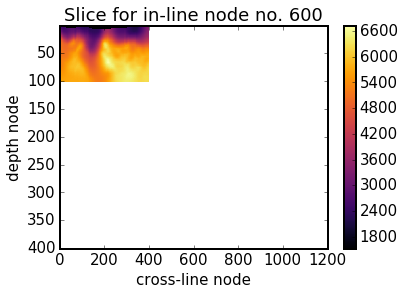

In [203]:
Plot_Gridded_Data(model, xslice=nx1/2)

In [207]:
Save_vtr(proj_name + '-TrueVp', nx1_m, nx2_m, nx3_m, model)

lib_fwi_generic.py/Save_vtr: File to save:  proj15-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  101 401 1201


0

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj15-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 101
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha 1517.41 6727.46 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 401 101
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (101, 401) (101, 401) (101, 401)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(101, 1)

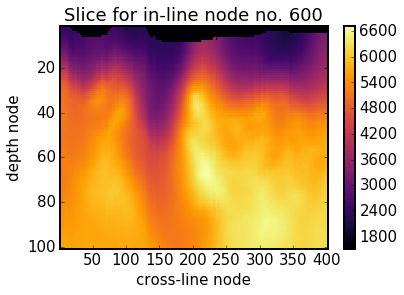

In [213]:
Plot_Gridded_Data_From_File(fname, xslice=nx1/2)
plt.xlim(1, nx2_m)
plt.ylim(nx3_m, 1)

In [217]:
# !cd "{proj_path}" && vtr2sgy

### SegyPrep

In [218]:
!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp.vtr_tmp'
!cd "{proj_path}" && fwi_cp_project.sh -sp -cp 'proj13' {proj_name} . 
!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr_tmp' {proj_name}'-TrueVp.vtr'


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-SegyPrep.key
-RawSign.sgy
-StartVp.vtr
cp: cannot stat 'proj13-StartVp.vtr': No such file or directory
-StartVs.vtr
cp: cannot stat 'proj13-StartVs.vtr': No such file or directory
-StartVp.sgy
cp: cannot stat 'proj13-StartVp.sgy': No such file or directory
-StartVs.sgy
cp: cannot stat 'proj13-StartVs.sgy': No such file or directory
-RawSeis.sgy
cp: cannot stat 'proj13-RawSeis.sgy': No such file or directory
-RawSeis.txt
-TrueVp.vtr
-TrueVs.vtr
cp: cannot stat 'proj13-TrueVs.vtr': No such file or directory
-TrueVp.sgy
-TrueVs.sgy
cp: cannot stat 'proj13-TrueVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 60 s


In [219]:
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1_m, nx2=nx2_m, nx3=nx3_m, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
!cd "{proj_path}" && cat {proj_name}'-SegyPrep.key'
# !cd "{proj_path}" && segyprep_v3.16 {proj_name} # INTERACTIVE => RUN IN CONSOLE

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj15-SegyPrep.key
y origin : -5000
fixed array : yes
dtms : 2.5
io api : both
nx1 : 1201
x origin : -30000
nx2 : 401
z type : elevation
reciprocity : yes
text : yes
ttime : 15000.0
x shift : 0
y shift : 0
dx : 50.0
unique : yes
FFID : yes
nx3 : 101
geometry : segy
debug : yes
retain : yes
problem : synthetic
outseis : yes


In [ ]:
# !segyprep_v...

No corrections needed <= z_FS = 0 (<= first node is already water)

### Runfile

- manual changes applied afterwards too!

In [222]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]

Update_Runfile(fname, io=params['IO'], ibfs='0', bbot=str(b_abs), bleft=str(b_abs), bright=str(b_abs), bfront=str(b_abs), bback=str(b_abs), extrabot=str(e_abs), extraleft=str(e_abs), extraright=str(e_abs), extrafront=str(e_abs), extraback=str(e_abs), seaLevel=str(z_sea), etime=str(ttime), NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'], NCOMP=params['NCOMP'], NSHOTS=params['NSHOT'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
# print 
# !cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
# print 
# !cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj15-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 101
 DX            : 50.0
etime : 15
! X. FREE SURFACE
ibfs : 0
seaLevel : 12
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 1
NSHOTS : 1
NRECS : 134
MAXRC : 134
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY MODEL
 velc

### PBS file

In [225]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', time="02:00:00", nnodes=2, nprocesses=4, nlogic_cores=40, mem_gb=120)
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj15
#PBS -o proj15-Out.log
#PBS -e proj15-Err.log
#PBS -l walltime=02:00:00
#PBS -l select=2:mpiprocs=4:ompthreads=10:ncpus=40:mem=120gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD= 

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj15

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_

## Run

In [227]:
!cd {proj_path} && ssh_sync_project.sh kmc cx1 fwi_3D_OBS_only

sending incremental file list
./
binary
            400 100%    0.00kB/s    0:00:00 (xfr#1, ir-chk=14091/14093)
header
          3,200 100%    3.05MB/s    0:00:00 (xfr#2, ir-chk=14048/14093)
jupy_fwi_3D_OBS_only.ipynb
      9,284,187 100%   78.35MB/s    0:00:00 (xfr#3, ir-chk=14047/14093)
proj14-Err.log
         47,040 100%  356.10kB/s    0:00:00 (xfr#4, ir-chk=13860/14093)
proj14-Out.log
          2,643 100%   18.57kB/s    0:00:00 (xfr#5, ir-chk=13857/14093)
proj14-Runfile.key
          1,376 100%    9.08kB/s    0:00:00 (xfr#6, ir-chk=13854/14093)
proj15-ExtraPointReceivers.pgy
         11,505 100%   75.91kB/s    0:00:00 (xfr#7, ir-chk=13844/14093)
proj15-ExtraReceivers.geo
         11,513 100%   75.46kB/s    0:00:00 (xfr#8, ir-chk=13843/14093)
proj15-FreeSurf.vtr
      5,779,252 100%   26.00MB/s    0:00:00 (xfr#9, ir-chk=13842/14093)
proj15-GhostData.bin
  3,363,413,584 100%  102.16MB/s    0:00:31 (xfr#10, ir-chk=13841/14093)
proj15-Missing-Receivers.ps
         11,212 100%   25.95kB

## Output

In [232]:
path = proj_path + '/../output/'
# !cd "{path}" && ls -lth

### Gather

- max amplitude is 4x as high as ibfs=1...
    - it might be due to different spread_receiver
    - it can be checked by:
        - comparing wavefields' amplitudes
        - putting receivers deeper below the sea surface
- apart from that they're similar

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//../output/proj15-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.998
lib_fwi_generic.py/Read_vtr: max value:  3.26448
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 6000
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.001 0.001 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 134) (6000, 134) (6000, 134)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(750, 150)

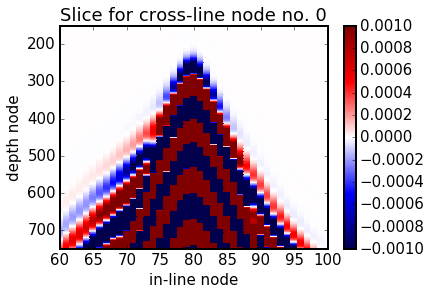

In [274]:
a = 0.001
Plot_Gridded_Data_From_File(path + 'proj15-Synthetic.vtr', yslice=0, cmap='seismic', minn=-a, maxx=a)
plt.xlim(60, 100)
plt.ylim(750, 150)

In [242]:
nx1_w1, nx2_w1, nx3_w1, fw1 = Read_vtr(path + 'proj13-Synthetic.vtr')
nx1_w1, nx2_w1, nx3_w1, fw2 = Read_vtr(path + 'proj15-Synthetic.vtr')

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//../output/proj13-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.701766
lib_fwi_generic.py/Read_vtr: max value:  0.726602
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 6000
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//../output/proj15-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.998
lib_fwi_generic.py/Read_vtr: max value:  3.26448
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 6000


In [248]:
print np.max(abs(fw1))
print np.max(abs(fw2))
print np.max(abs(fw_diff))

0.726602
3.26448
2.56486


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.001 0.001 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 134) (6000, 134) (6000, 134)


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(750, 250)

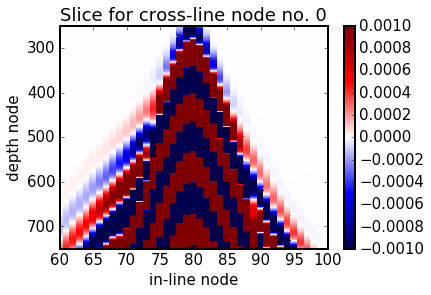

In [255]:
fw_diff = fw2 - fw1
a = 0.001
Plot_Gridded_Data(fw_diff, yslice=0, cmap='seismic', minn=-a, maxx=a)
plt.xlim(60, 100)
plt.ylim(750, 250)

### Wavefield snapshots

In [ ]:
Plot_Project_Output(proj_name, proj_path=proj_path, gather=False, plot_mod=True, plot_fs=True, xslice=xsl+eall, file_min=10, file_max=10)  #, xlim=[ysl+eall-50, ysl+eall+50], ylim=[zsl+2+10, zsl+2-10])
# plt.xlim(160, 210)#nx2)#, 22)
# plt.ylim(1, 25)#113)
# plt.gca().invert_yaxis()

# Proj 16  (-||- but JM wavelet)

- MAIN CONCLUSION: my synthetics are good at least for native FS at node=0
- same as proj15 (i.e. built-in FS on top of the model) but Jo's, not Michele's wavelet
- wavelet with no additional filtering => spectrum 2-6 Hz
- there might be problems with dispersion ("Low kernel OK below (Hz): 4.9")

In [221]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj16'
# !cd "{proj_path}" && pwd

## Input

In [278]:
# !cd {proj_path} && fwi_cp_project.sh -sp -cp proj15 {proj_name} .

### Model

- my model is a bit faster, including water velocity 
- but it shouldn't matter since: $\Delta t = s \frac{\Delta v}{v_1v_2}$
- I used btop=0 (imposed by fsprep part, even if ibfs=0), while Jo -99 (FS at 1st cell)
    - max diff. = $\Delta t = \Delta x / v = 50 / v$
    - in water it's 50 / 1500 s = 30 ms
    - water surface is lower in JM => all arrivals should be earlier this 30 ms AND THEY ARE!

In [254]:
print 50 / 1500.

0.0333333333333


In [240]:
v1 = 1517.41 # m/s
v2 = 1517.19 
dv = v1 - v2
print 'Difference in water velocity:', dv, 'm/s'
s = 1000. # m
dt = s * dv / (v1 * v2)
print 'Time mismatch due to different water vel:', dt * 1000, 'ms'

Difference in water velocity: 0.22 m/s
Time mismatch due to different water vel: 0.0955607979344 ms


#### JM

In [217]:
print 481601 / 1201 # Jo

401


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/forwardcheck/sant01-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.19
lib_fwi_generic.py/Read_vtr: max value:  6849.23
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 121
libplot_generic.py/Plot_Cube:  slice_coord x
libplot_generic.py/Plot_Cube:  coord_value 0
libplot_generic.py/Plot_Cube:  slice_coord y
libplot_generic.py/Plot_Cube:  coord_value 0
libplot_generic.py/Plot_Cube:  slice_coord z
libplot_generic.py/Plot_Cube:  coord_value 0
libplot_generic.py/Plot_Cube:  face.shape (401, 121)
libplot_generic.py/Plot_Cube:  face.shape (1201, 121)
libplot_generic.py/Plot_Cube:  face.shape (1201, 401)


0

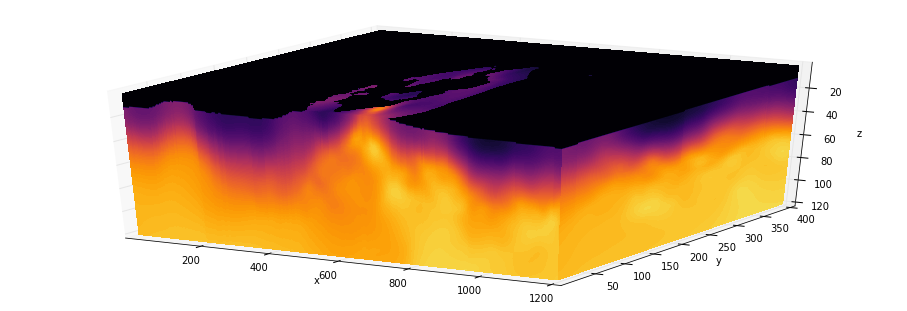

In [224]:
path = "/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/forwardcheck"
fname_jm = Get_Files(path, 'sant01-TrueVp.vtr')[0]
slices = [0, 0, 0]
Plot_Gridded_Data_From_File(fname_jm, data_type='model', plot_type='cube', slices=slices, cbar=0)

#### kmc

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj16-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 101
libplot_generic.py/Plot_Cube:  slice_coord x
libplot_generic.py/Plot_Cube:  coord_value 0
libplot_generic.py/Plot_Cube:  slice_coord y
libplot_generic.py/Plot_Cube:  coord_value 0
libplot_generic.py/Plot_Cube:  slice_coord z
libplot_generic.py/Plot_Cube:  coord_value 0
libplot_generic.py/Plot_Cube:  face.shape (401, 101)
libplot_generic.py/Plot_Cube:  face.shape (1201, 101)
libplot_generic.py/Plot_Cube:  face.shape (1201, 401)


0

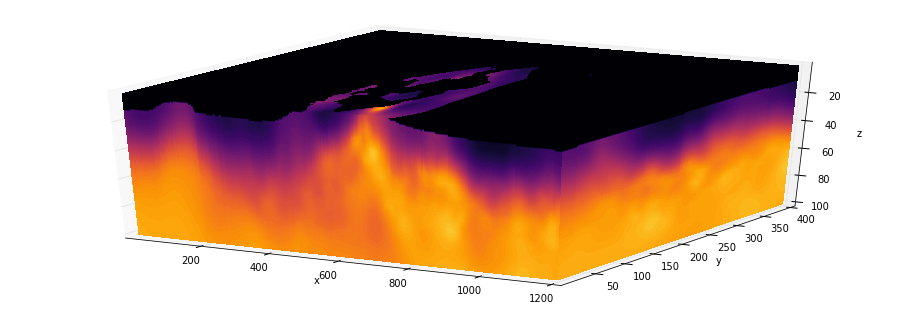

In [223]:
fname_kmc = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
slices = [0, 0, 0]
Plot_Gridded_Data_From_File(fname_kmc, data_type='model', plot_type='cube', slices=slices, cbar=0)

#### Juxta

In [230]:
# Gather_Plot(fname_kmc, file2=fname_jm, juxt='diff', norm='none', data_type='model')#, plot_type='slice', slices=slices, cbar=0)

### Source wavelet

In [287]:
# !cd {proj_path} && cp {source_wavelet_path}/jm_source_Xd_2-6Hz_17_01_01.sgy {proj_name}'-RawSign.sgy'

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj16-RawSign.vtr
lib_fwi_generic.py/Read_vtr: min value:  -482082.0
lib_fwi_generic.py/Read_vtr: max value:  507185.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2401


0

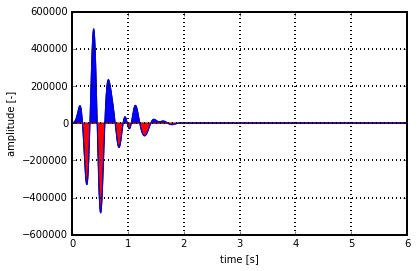

In [241]:
fname = Get_Files(proj_path, 'proj16-RawSign.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='wavelet', dt=0.0025)
# plt.xlim([0,2])

In [42]:
# !cd {proj_path} && surange.sh {proj_name}'-RawSign.sgy'

### SegyPrep

- model cut to FS => no corrrections needed

In [242]:
# !cd {proj_path} && segyprep.sh {proj_name}

### Runfile

In [288]:
!cd {proj_path} && cat {proj_name}-Runfile_synth.key

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 101
 DX            : 50.0
etime : 15
! X. FREE SURFACE
ibfs : 0
seaLevel : 12
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 1
NSHOTS : 1
NRECS : 134
MAXRC : 134
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY MODEL
 velcut : 1542  ! 1542 BASED ON MP'S FILE water_vp_50_deep.txt
! I. DENSITY MODEL
 water velocity          : 1542 !
 Gardner cutoff v

### PBS file

In [197]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', nnodes=1, nprocesses=2, mem_gb=50)

0

In [198]:
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj16
#PBS -o proj16-Out.log
#PBS -e proj16-Err.log
#PBS -l walltime=01:00:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=50gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=10

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj16

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_

## Run

In [295]:
# run locally due to cx1 problems

## Output

In [243]:
path = proj_path + '../output/'

In [70]:
# a = 5
# Project_Output(proj_name, minn=-a, maxx=a)
# plt.ylim(2000, 0)

### Gathers

In [134]:

# fnames = Get_Files(path, '*sgy')
# for fname in fnames:
#     !su_supergather_split_lines.sh ep 1 60 {fname}

In [244]:
# !cd {proj_path} && surange.sh {proj_name + '-OutSeis.sgy'}

In [245]:
# !cd {path} && surange.sh '4137obs_line8.sgy'

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj16-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.00464e+06
lib_fwi_generic.py/Read_vtr: max value:  7.76443e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 6000
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4137obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18078e+09
lib_fwi_generic.py/Read_vtr: max value:  1.27131e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 134 6000 131 2400
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 131 2400 131 2400
libplot_generic.py/Plot_Slice:  Zi.shape (131, 2400)
libplot_generic.py/Plot_Slice:  Zi.shape (131, 2400)
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2 2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Vo

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

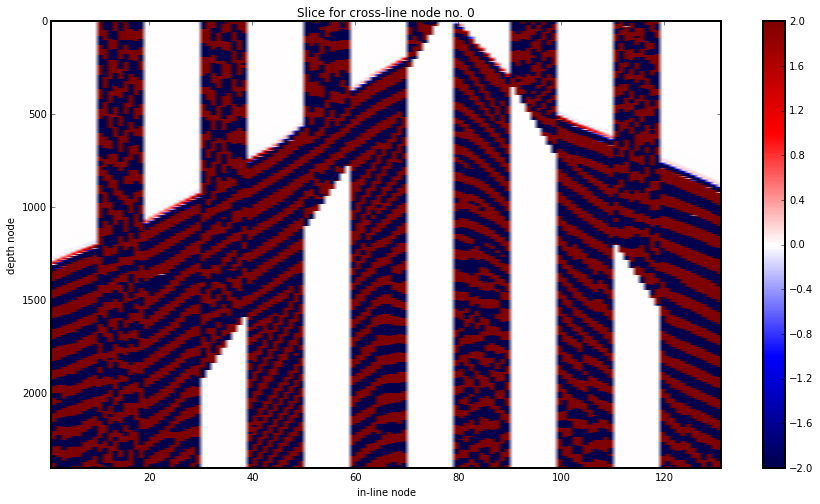

In [259]:
path = '/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/'

a = 2
file1 = proj_path + proj_name + '-Synthetic.vtr'
# file1 = proj_path + proj_name + '-OutSeis.vtr'
# file1 = path + '4137syn_line8.vtr'
# file1 = path + '4137obs_line8.vtr'
# file1 = path + '../input/kmcsant01-Synthetic.vtr'

# file2 = proj_path + proj_name + '-OutSeis.vtr'
# file2 = path + '4137syn_line8.vtr'
file2 = path + '4137obs_line8.vtr'
# Gather_Plot(file1, minn=-a, maxx=a)
Gather_Plot(file1, file2=file2, norm='none', minn=-a, maxx=a)
# plt.xlim(105, 115)
# plt.ylim(800, 600)

In [ ]:
a = 0.1
Plot_Gridded_Data(g_syn / max_abs_syn, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)

Plot_Gridded_Data(g_obs / max_abs_obs, cmap='seismic', plt_func='imsh', alpha=0.5, cbar=0, minn=-a, maxx=a)
# plt.xlim(60, 100)
plt.ylim(2000, 1000)

# Proj 17 (OBS160, L26, across caldera, JM wavelet)

- same as proj13 but OBS 160 line 26 and Jo's wavelet from proj16
- probably 6-8 ghost iterations

In [263]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj17'
# !cd "{proj_path}" && pwd
OBS = '160'
line = '26'

## Input

In [455]:
# !cd {proj_path} && fwi_cp_project.sh -sp -cp proj13 {proj_name} .
# !cd {proj_path} && cp {source_wavelet_path}/jm_source_Xd_2-6Hz_17_01_01.sgy {proj_name}'-RawSign.sgy'

### Model (cube)

#### Plot cube

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Cube:  slice_coord x
libplot_generic.py/Plot_Cube:  coord_value 600
libplot_generic.py/Plot_Cube:  slice_coord y
libplot_generic.py/Plot_Cube:  coord_value 200
libplot_generic.py/Plot_Cube:  slice_coord z
libplot_generic.py/Plot_Cube:  coord_value 56
libplot_generic.py/Plot_Cube:  face.shape (401, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 401)


0

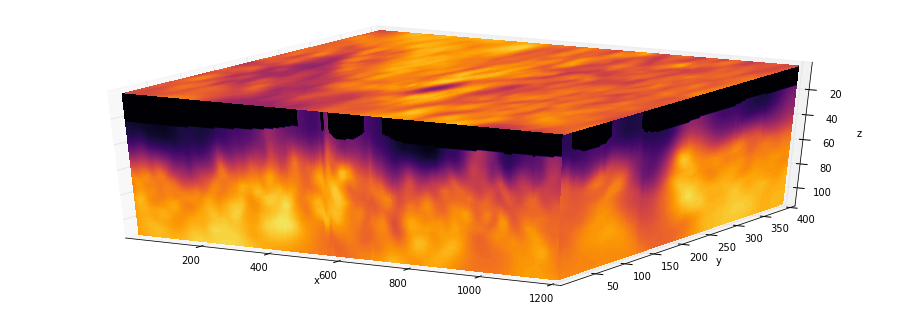

In [489]:
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

#### Plot slices separately

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha 1517.41 6811.36 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 1201 113
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (113, 1201) (113, 1201) (113, 1201)
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41

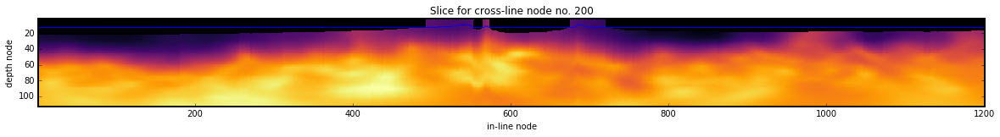

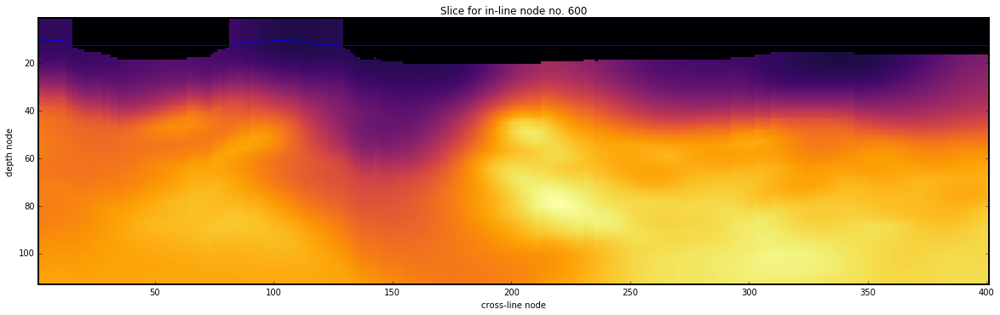

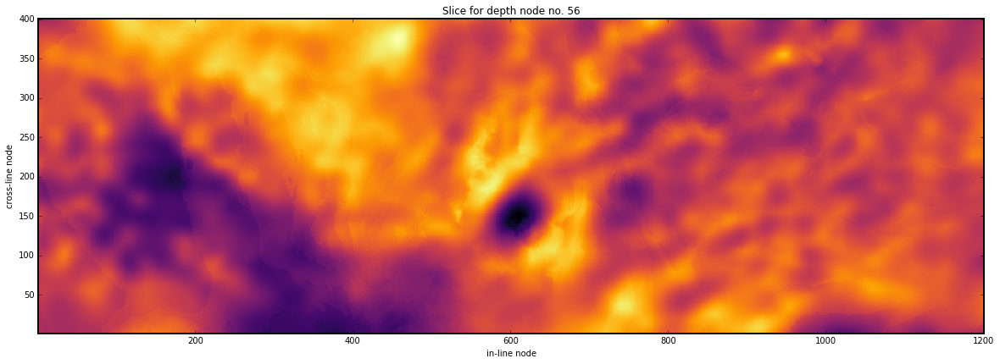

In [463]:
zcoord = nx3 / 2

fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
fname_fs = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

# Y-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', slice_coord='y', coord_value=ycoord, cbar=0)
Plot_Gridded_Data_From_File(fname_fs, data_type='FS', plot_type='slice', slice_coord='y', coord_value=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx1)
plt.ylim(nx3, 1)
plt.gca().set_aspect('equal')
    
# X-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', slice_coord='x', coord_value=xcoord, cbar=0)
Plot_Gridded_Data_From_File(fname_fs, data_type='FS', plot_type='slice', slice_coord='x', coord_value=xcoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx2)
plt.ylim(nx3, 1)
plt.gca().set_aspect('equal')

# Z-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', slice_coord='z', coord_value=zcoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx1)
plt.ylim(1, nx2)
plt.gca().set_aspect('equal')

### Observed data

In [400]:
fname = proj_name + '-RawSeis.txt'
!cd {proj_path} && trash {fname}; ls data/stations_lines/MGL*{OBS}*line{line}.segy >> {fname} 
!cd {proj_path} && cat {fname} 

data/stations_lines/MGL1521_S160_4_line26.segy


### SegyPrep

In [379]:
# in console

In [401]:
z_sea = 12.5
dx = 50 # m

# NOTE: IT NEEDS SEGYPREP RE-RUN EVERYTIME (.geo ARE MODIFIED)

for suffix in ['-Sources', '-Receivers']:
    interfix = '_not_corrected'
    ext = '.geo'
    !cd "{proj_path}" && cp {proj_name}{suffix}{ext} {proj_name}{suffix}{interfix}{ext} 
    # !cd "{proj_path}" && ls -lth

    fname = Get_Files(proj_path, proj_name + suffix + ext)[0]
    fname_nc = Get_Files(proj_path, proj_name + suffix + interfix + ext)[0]
#     print fname
#     print fname_nc
    c = Read_File(fname_nc)
    header = c[0]
    header_str = ''
    for word in header:
        header_str += word + ' ' # FIXME: BETTER FORMATTING
#     print header_str
    data = c[1: ]
    f = open(fname, 'w')
    f.write(header_str + '\n')

    for line in data:
#         print line
        source_id = line[0]
        x = line[1]
        y = line[2]
        z = line[3]        
        z = str(z_sea * dx + float(z))
        f.write(source_id + ' ' + x  + ' ' + y  + ' ' + z  + '\n')
    f.close()
    print suffix
    !cd "{proj_path}" && cat {proj_name}{suffix}{ext}

-Sources
1 60000.0000 20000.0000 5600.0000 
4160 28699.0000 7667.00000 1008.0
-Receivers
154 60000.0000 20000.0000 5600.0000 
33366 37918.0000 8221.00000 637.0
33367 38056.0000 8149.00000 637.0
33368 38196.0000 8099.00000 637.0
33369 38339.0000 8075.00000 637.0
33370 38482.0000 8069.99951 637.0
33371 38626.0000 8072.00000 637.0
33372 38770.0000 8073.00049 637.0
33373 38914.0000 8076.99951 637.0
33374 39058.0000 8083.99951 637.0
33375 39201.0000 8089.00000 637.0
33376 39345.0000 8094.00000 637.0
33377 39488.0000 8097.00000 637.0
33378 39633.0000 8091.00049 637.0
33379 39777.0000 8086.00000 637.0
33380 39921.0000 8086.00000 637.0
33381 40065.0000 8089.00000 637.0
33382 40209.0000 8092.00000 637.0
33383 40352.0000 8096.00000 637.0
33384 40496.0000 8098.00049 637.0
33385 40640.0000 8098.00049 637.0
33386 40784.0000 8100.00000 637.0
33387 40928.0000 8099.00000 637.0
33388 41072.0000 8098.00049 637.0
33389 41216.0000 8098.00049 637.0
33390 41360.0000 8097.00000 637.0
33391 41503.0000 8104.00

### Runfile

In [27]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]

Update_Runfile(fname, io=params['IO'], bbot=str(b_abs), bleft=str(b_abs), bright=str(b_abs), bfront=str(b_abs), bback=str(b_abs), extrabot=str(e_abs), extraleft=str(e_abs), extraright=str(e_abs), extrafront=str(e_abs), extraback=str(e_abs), seaLevel=str(z_sea), etime=str(ttime), NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'], NCOMP=params['NCOMP'], NSHOTS=params['NSHOT'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj19-Skeleton.key


NameError: name 'b_abs' is not defined

### PBS file

In [214]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', nnodes=2, nprocesses=2, mem_gb=50)

0

In [215]:
!cd "{proj_path}" && cat {proj_name}'-Run.pbs'

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj17
#PBS -o proj17-Out.log
#PBS -e proj17-Err.log
#PBS -l walltime=01:00:00
#PBS -l select=2:mpiprocs=2:ompthreads=20:ncpus=40:mem=50gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=20

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj17

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/${project_

### Check input

This will be in 1 procedure soon.

In [402]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)
print np.max(fs_z)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1
12.5


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha 1517.41 6814.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 1201 113
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (113, 1201) (113, 1201) (113, 1201)
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-FreeSurf.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  5.35126
lib_fwi_generic.py/Read_vtr: max value:  12.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 1


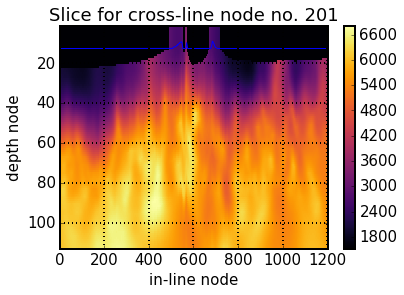

In [405]:
# ax = 8
# ay = 4
ysl = 201
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
Plot_Gridded_Data_From_File(fname, yslice=201)#,  xlim=[ysl-ax, ysl+ax], ylim=[zsl-ay, zsl+ay], fig_size=[20, 10])
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ysl, cbar=0)#, xlim=[ysl-ax, ysl+ax], ylim=[zsl-ay, zsl+ay], cbar=0)
# plt.ylim(10, 20)
plt.gca().invert_yaxis()
# plt.scatter([ysl], [zsl])

plt.grid()

lib_fwi_generic.py/Read_pgy:  File to read:  ./proj17-PointSources.pgy
lib_fwi_generic.py/Read_pgy:  File to read:  ./proj17-PointReceivers.pgy


libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 
libplot_generic.py/Plot_Points_3D_Projection_2D: Warning. plane not specified - assuming 'XY'. 


0

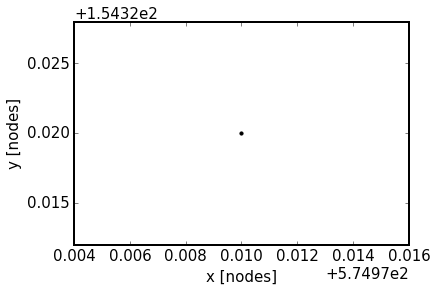

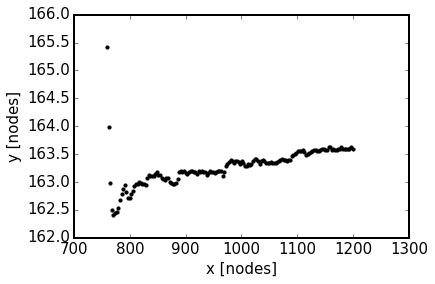

In [407]:
Plot_SR(proj_name)

## Run

### Locally

- it took 8.5 h using K=4 MPI processes. Not bad. 
- it should be much quicker on 40-CPU node. But I didn't see it for proj15-FS... Suboptimal mpiprocs? 

### Remotely

In [530]:
print 'No. of hours requested (excluding grace period): ', 31200 / 3600.

No. of hours requested (excluding grace period):  8.66666666667


- in almost 9 hours it finished only 5700 out of 6000 steps and terminated
- so it needed extra $300/6000 * 9 h = 1/20 * 1 h * 9 = 3 * 9 min = 27 min$ to finish
- this is worse than locally!!! despite using same no. of MPI ranks/processes i.e. mpiprocs=4

 Job resource usage summary

                 Memory (GB)    NCPUs
 Requested  :       120            40
 
 Used       :         6 (peak)   2.37 (ave)


## Output

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4160obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55891e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41394e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj17-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297315.0
lib_fwi_generic.py/Read_vtr: max value:  292742.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 6000
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 76 2400 154 6000
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 76 2400 76 2400
libplot_generic.py/Plot_Slice:  Zi.shape (76, 2400)
libplot_generic.py/Plot_Slice:  Zi.shape (76, 2400)
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2 2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

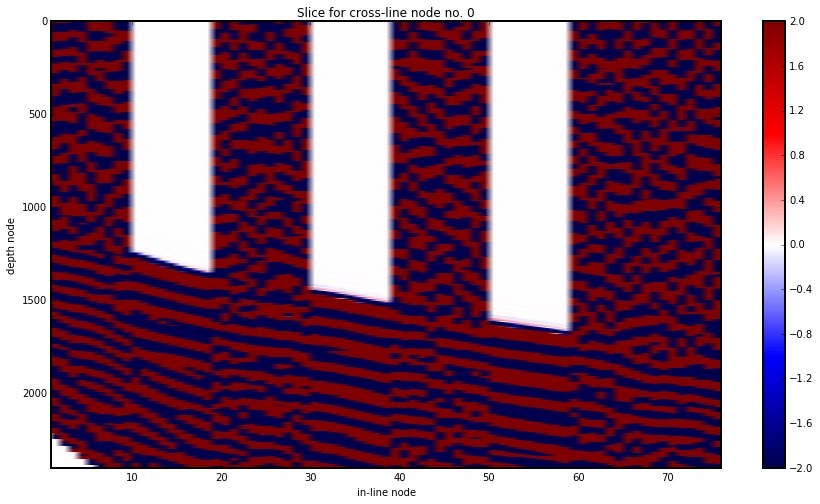

In [267]:
path = '/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/'

a = 2
# file1 = proj_path + proj_name + '-Synthetic.vtr'
# file1 = proj_path + proj_name + '-OutSeis.vtr'
# file1 = path + '4' + OBS + 'syn_line' + line + '.vtr'
file1 = path + '4' + OBS + 'obs_line' + line + '.vtr'

file2 = proj_path + proj_name + '-Synthetic.vtr'
# file2 = proj_path + proj_name + '-OutSeis.vtr'
# file2 = path + '4' + OBS + 'syn_line' + line + '.vtr'
# file2 = path + '4' + OBS + 'obs_line' + line + '.vtr'
# Gather_Plot(file1, minn=-a, maxx=a)
Gather_Plot(file1, file2=file2, norm='none', minn=-a, maxx=a)
# plt.xlim(105, 115)
# plt.ylim(800, 600)

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4160obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55891e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41394e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4160syn_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -117404.0
lib_fwi_generic.py/Read_vtr: max value:  133013.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 76 2400 76 2400
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 76 2400 76 2400
libplot_generic.py/Plot_Slice:  Zi.shape (76, 2400)
libplot_generic.py/Plot_Slice:  Zi.shape (76, 2400)
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2 2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

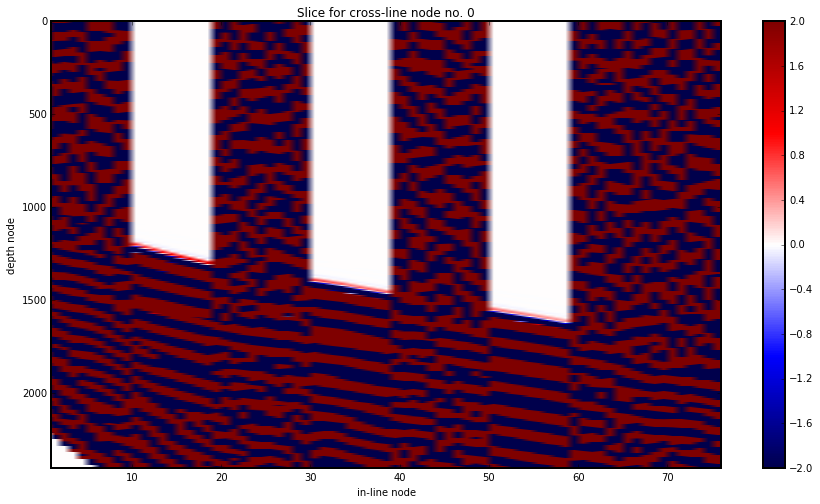

In [268]:
path = '/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/'

a = 2
# file1 = proj_path + proj_name + '-Synthetic.vtr'
# file1 = proj_path + proj_name + '-OutSeis.vtr'
# file1 = path + '4' + OBS + 'syn_line' + line + '.vtr'
file1 = path + '4' + OBS + 'obs_line' + line + '.vtr'

# file2 = proj_path + proj_name + '-Synthetic.vtr'
# file2 = proj_path + proj_name + '-OutSeis.vtr'
file2 = path + '4' + OBS + 'syn_line' + line + '.vtr'
# file2 = path + '4' + OBS + 'obs_line' + line + '.vtr'
# Gather_Plot(file1, minn=-a, maxx=a)
Gather_Plot(file1, file2=file2, norm='none', minn=-a, maxx=a)
# plt.xlim(105, 115)
# plt.ylim(800, 600)

### OLD

#### Synthetic

In [414]:
nx1_syn, nx1_syn, nx1_syn, g_syn = Read_vtr(path + proj_name + '-Synthetic.vtr')
max_abs_syn = max(abs(np.min(g_syn)), abs(np.max(g_syn)))

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj17-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297315.0
lib_fwi_generic.py/Read_vtr: max value:  292742.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 6000


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

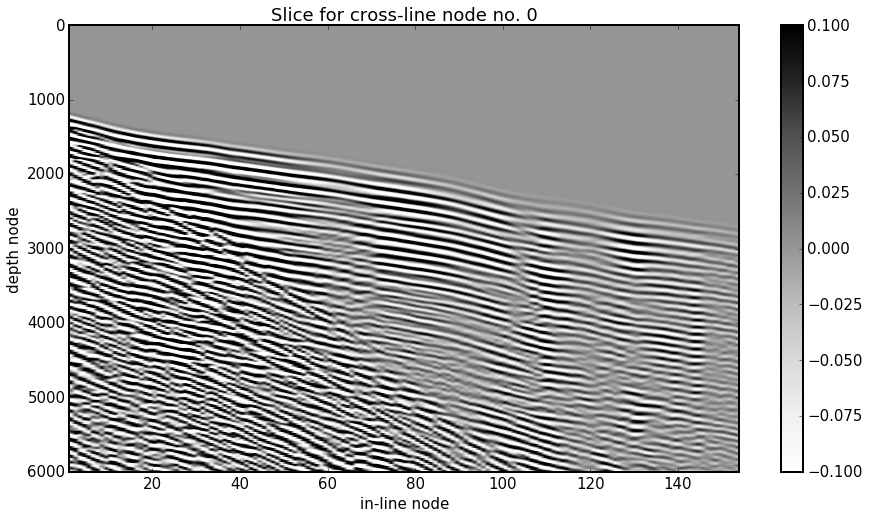

In [419]:
a = 0.1
Plot_Gridded_Data(g_syn / max_abs_syn, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)
# Plot_Gridded_Data(g_obs / max_abs_obs, yslice=0, cmap='seismic', plt_func='imsh', alpha=0.3, cbar=0, minn=-a, maxx=a)
# plt.xlim(60, 100)
# plt.ylim(1000, 0)

libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

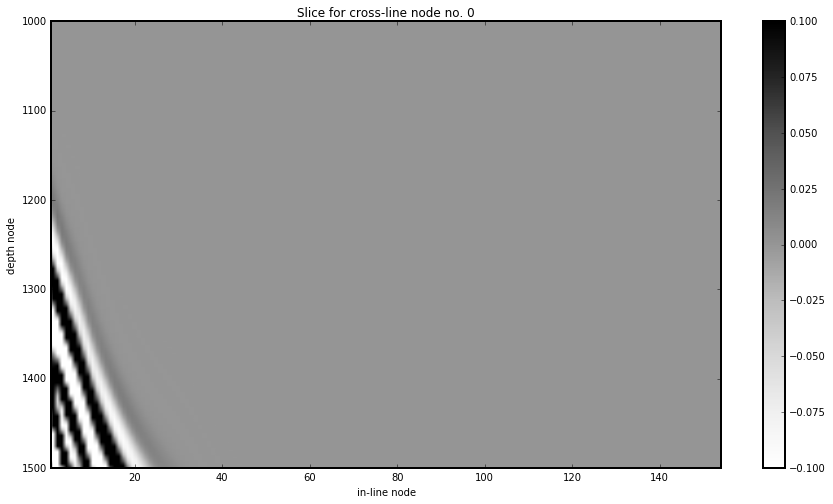

In [621]:
a = 0.1
Plot_Gridded_Data(g_syn / max_abs_syn, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)
plt.ylim(1500, 1000)

#### Observed

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/../input/test.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.71082
lib_fwi_generic.py/Read_vtr: max value:  7.59155
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 6000


0

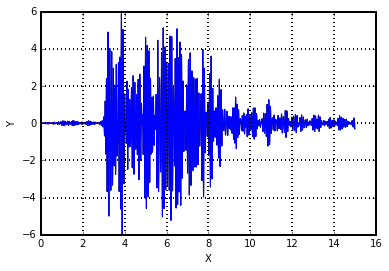

In [623]:
a, b, c, test = Read_vtr(path + '../input/test.vtr')
Plot_Trace(test[0][0], dt=dt)
# plt.xlim(0, 4)

libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1 1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

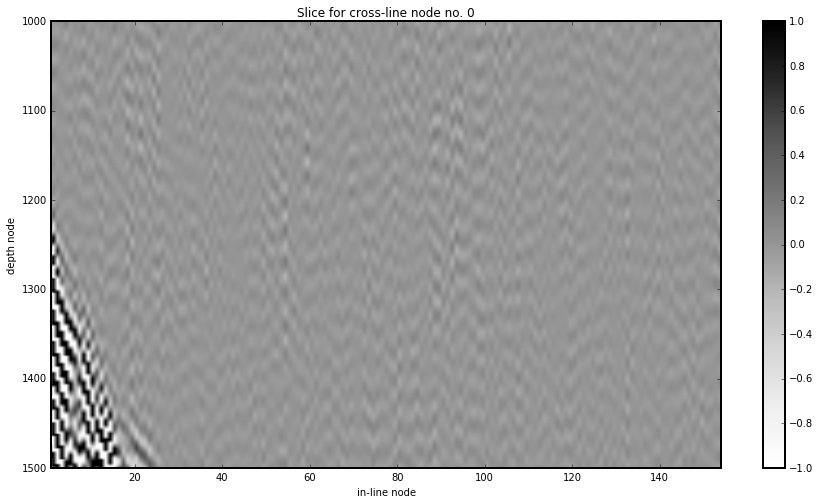

In [624]:
a = 1
Plot_Gridded_Data(test, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)
plt.ylim(1500, 1000)

In [416]:
nx1_obs, nx1_obs, nx1_obs, g_obs = Read_vtr(path + proj_name + '-OutSeis.vtr')
max_abs_obs = max(abs(np.min(g_obs)), abs(np.max(g_obs)))

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj17-OutSeis.vtr
lib_fwi_generic.py/Read_vtr: min value:  -240102.0
lib_fwi_generic.py/Read_vtr: max value:  213882.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 6000


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

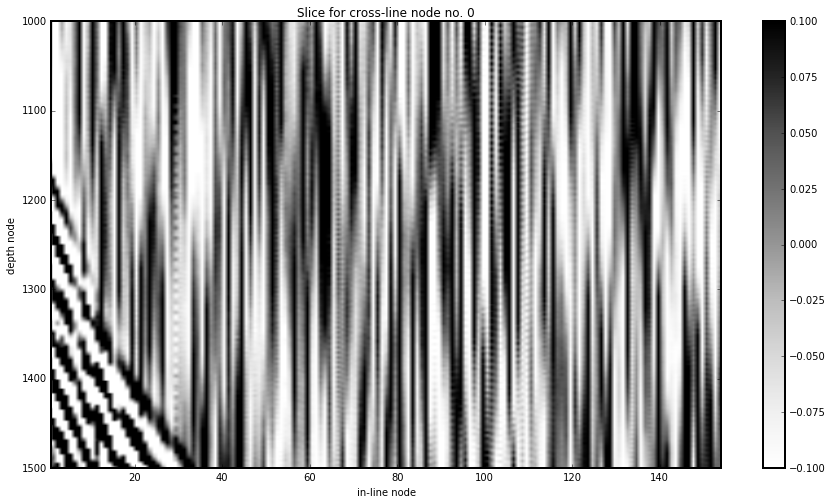

In [620]:
a = 0.1
Plot_Gridded_Data(g_obs / max_abs_obs, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)
plt.ylim(1500, 1000)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/projects/jm_checkerboard/forwardcheck/sant01-OutSeis_160_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.04456e+09
lib_fwi_generic.py/Read_vtr: max value:  8.17773e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.04456e+09 8.17773e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 76 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 76) (2400, 76) (2400, 76)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 76, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

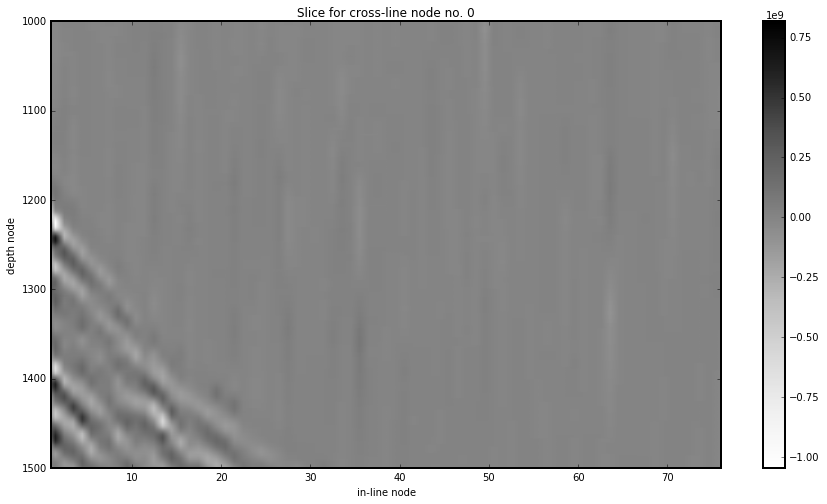

In [619]:
fname = '/home/kmc3817/projects/jm_checkerboard/forwardcheck/sant01-OutSeis_160_line26.vtr'
Plot_Gridded_Data_From_File(fname, cmap='Greys', fig_size=[15,8], plt_func='imsh')#, alpha=1., minn=-a, maxx=a)
plt.ylim(1500, 1000)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/projects/jm_checkerboard/sant01-RawSeis_160_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.77406e+09
lib_fwi_generic.py/Read_vtr: max value:  1.35543e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 8001
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.77406e+09 1.35543e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 8001
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (8001, 151) (8001, 151) (8001, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 8001]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

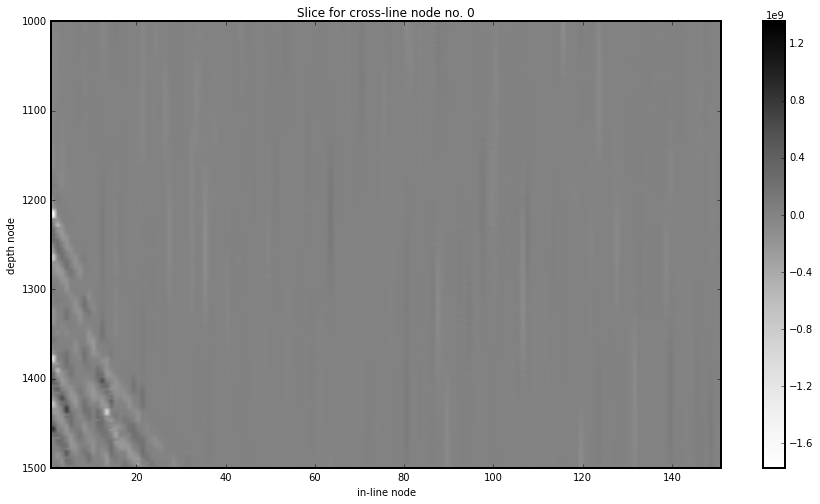

In [625]:
fname = '/home/kmc3817/projects/jm_checkerboard/sant01-RawSeis_160_line26.vtr'
Plot_Gridded_Data_From_File(fname, cmap='Greys', fig_size=[15,8], plt_func='imsh')#, alpha=1., minn=-a, maxx=a)
plt.ylim(1500, 1000)

#### Juxtaposition

libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 0.5
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(2000, 1000)

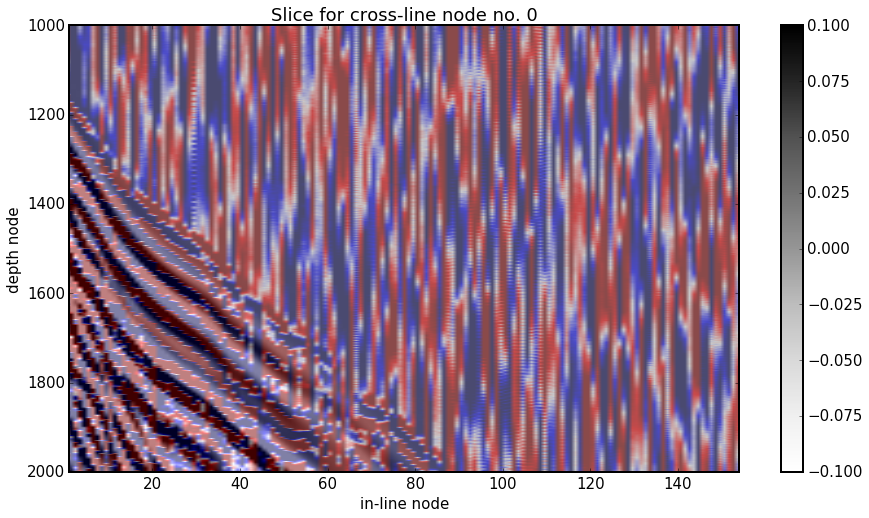

In [424]:
a = 0.1
Plot_Gridded_Data(g_syn / max_abs_syn, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)

Plot_Gridded_Data(g_obs / max_abs_obs, cmap='seismic', plt_func='imsh', alpha=0.5, cbar=0, minn=-a, maxx=a)
# plt.xlim(60, 100)
plt.ylim(2000, 1000)

libplot_generic.py/Plot_Slice:  Zi.shape (154, 6000)
libplot_generic.py/Plot_Slice:  Zi.shape (154, 6000)
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

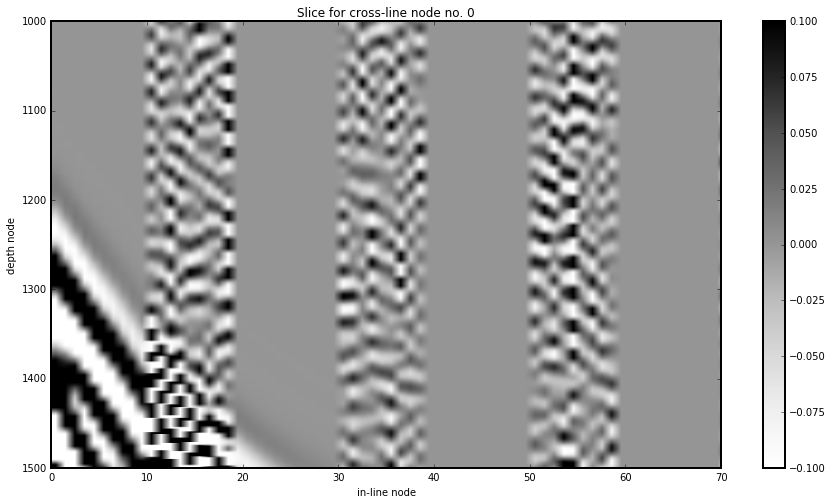

In [632]:
a = 0.1
Plot_Gridded_Data(g_syn / max_abs_syn, interleave=[test], slice_coord='y', slice_value=0, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)
plt.xlim(0, 70)
plt.ylim(1500, 1000)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/projects/jm_checkerboard/forwardcheck/sant01-OutSeis_160_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.04456e+09
lib_fwi_generic.py/Read_vtr: max value:  8.17773e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.1 0.1 1.0
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 76 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 76) (2400, 76) (2400, 76)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 76, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


(1500, 1000)

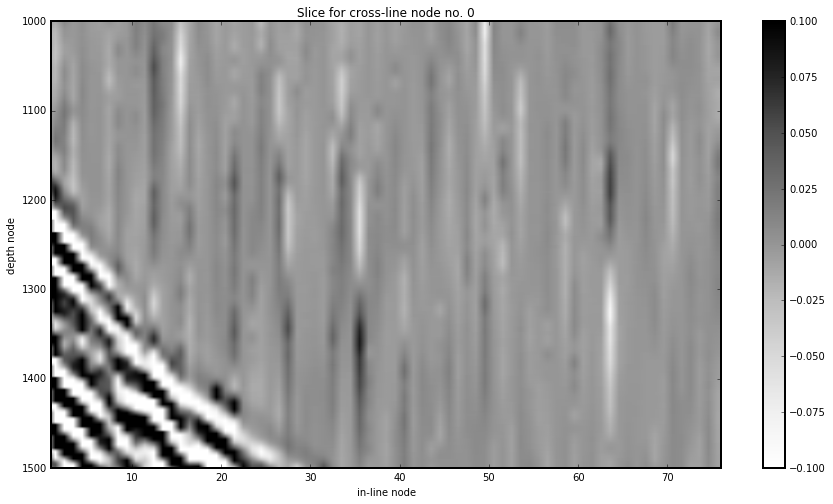

In [630]:
a = 0.1
fname = '/home/kmc3817/projects/jm_checkerboard/forwardcheck/sant01-OutSeis_160_line26.vtr'
nx1_g, nx2_g, nx3_g, jm = Read_vtr(fname)
max_abs_jm = max(abs(np.min(jm)), abs(np.max(jm)))
jm_normed = jm / max_abs_jm
Plot_Gridded_Data(jm_normed, cmap='Greys', fig_size=[15,8], plt_func='imsh', alpha=1., minn=-a, maxx=a)
plt.xlim(0, 70)
plt.ylim(1500, 1000)

# Proj 18 (full data set; synth; 2 ghost iters)

- all synthetic at once 
- FS=1
- all input from successful proj 17 except RawSeis.txt from proj12 
    - these are the profiles containing Ben's picks 

In [66]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj18'
# !cd "{proj_path}" && pwd

## Input

In [539]:
# !cd {proj_path} && fwi_cp_project.sh -sp -cp proj17 {proj_name} .

### Observed data

This is the list from proj12. Although we could leave it for SegyPrep to determine which are within the model. But IT SEEMS some of them had to be excludeded due to bad data etc. DOUBLE-CHECK.

In [705]:
obs_list = [108, 106, 105, 104, 109, 110, 112, 113, 114, 115, 117, 131, 130, 128, 127, 125, 124, 123, 136, 137, 138, 139, 140, 141, 142, 144, 145, 146, 147, 168, 167, 166, 165, 164, 163, 162, 161, 160, 158, 157, 176, 177, 178, 179, 181, 183, 184, 185, 186, 188]
print len(obs_list)

50


In [711]:
# fname = proj_name + '-RawSeis.txt'
# !cd "{proj_path}" && trash {fname}
# for obs in obs_list:
#     !cd "{proj_path}" && ls data/stations_full/*{obs}_4.sgy >> {fname}
# !cd "{proj_path}" && cat {fname}

### SegyPrep

- it takes > 20 min

In [712]:
# z_sea = 12.5
# nx3 = 113
# ttime_ms = 6e3
# segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
# Segyprep_Run(proj_name, z_sea, dx)

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj18-SegyPrep.key

segyprep.sh: START

Overwrite the TrueVp.vtr model? no

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj18
 Preparing files for synthetics...

 Grid points in-line:                   1201
 Grid points cross-line:                 401
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            60000.0000    
 Model width (metres):             20000.0000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          6000.00000    
 Output data length (samples):          2400
 Time steps to model:                   2

lib_fwi_generic.py/Segyprep_Run:  Contents of proj18-Sources.geo 

49 60000.0000 20000.0000 5600.0000 
4104 48674.0000 18806.0000 1042.0
4105 42107.0000 18590.0000 1024.0
4106 36395.0000 18689.0000 981.0
4108 19396.0000 18344.0000 751.0
4109 52968.0000 15614.9990 1081.0
4110 48939.0000 15285.0010 1006.0
4112 39410.0000 15378.0000 960.0
4113 34067.0000 15474.0010 859.999985
4114 29901.0000 15906.0000 766.0
4115 23066.0000 15028.0000 806.0
4117 8104.00000 15169.0000 1106.0
4123 54030.0000 12042.0000 893.0
4124 47754.0000 11945.0000 991.0
4125 39146.0000 11925.0000 923.0
4127 13055.0000 11852.0000 1048.999969
4128 10252.0000 12086.0000 1089.0
4130 3616.00000 11864.0000 1132.000031
4131 417.000000 11748.0000 1144.0
4136 57389.0000 9308.00000 950.0
4137 51062.0000 9307.00000 956.0
4138 44647.0000 9340.00000 968.0
4139 38863.0000 9208.00000 902.0
4140 30026.9980 9054.00000 1008.0
4141 23047.0000 8956.00000 697.0
4142 20098.0000 9436.00000 885.0
4144 12460.0000 9329.00000 1057.000031
4145 898

0

### Runfile

In [715]:
# Runfile_Prepare(proj_name, machine, z_sea, b_abs=40, e_abs=50)

### PBS file

In [772]:
# PBS_Script_Create(proj_name, problem='synth', code='rev688_test', snap_step=0, hours=4, q='debug', nnodes=1, nprocesses=4, ncpus=8)
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', snap_step=0, hours=4, q='mrwarn', nnodes=5, nprocesses=10)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj18

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj18
#PBS -o proj18-Out.log
#PBS -e proj18-Err.log
#PBS -l walltime=04:00:00
#PBS -l select=5:mpiprocs=10:ompthreads=4:ncpus=40:mem=62gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=4 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj18

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/../output/fw*vtr


lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus...


0

## Run

- it took 6110 s (100 min. - 1.5 h) on cx1: select=5:mpiprocs=10:ompthreads=4:ncpus=40:mem=62gb
    - 2 ghost iterations only
    - b_abs = 40, e_abs=50

## Output

In [69]:
# ! # THIS WORKS ONLY FOR 1 OBS cd ../output && su_supergather_split_lines.sh ep 1 60 {proj_name}-Synthetic.sgy

# Proj 19 (-||- but cut to the sea surface)

In [15]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj19'
# !cd "{proj_path}" && pwd

## Input

### Model

- we want a model from proj16 (cut)

In [560]:
# !cd "{proj_path}" && fwi_cp_project.sh -sp -cp proj16  {proj_name} . 

### Observed data

- data, in turn, we want from proj18 (full)

In [562]:
# !cd "{proj_path}" && fwi_cp_project.sh -p -cp proj18  {proj_name} . proj18-RawSeis.txt 
# !cd "{proj_path}" && cat {proj_name}-RawSeis.txt 

### SegyPrep

In [286]:
# in console (note: no corrrections needed)

### Runfile

In [567]:
fname = Get_Files(proj_path, proj_name + '-Skeleton.key')[0]
params = Read_Runfile(fname)

!cd "{proj_path}" && cp "{templates_path}"/{template_runfile} ./{proj_name}'-Runfile.key'

fname = Get_Files(proj_path, proj_name + '-Runfile.key')[0]

Update_Runfile(fname, io=params['IO'], ibfs='0', bbot=str(b_abs), bleft=str(b_abs), bright=str(b_abs), bfront=str(b_abs), bback=str(b_abs), extrabot=str(e_abs), extraleft=str(e_abs), extraright=str(e_abs), extrafront=str(e_abs), extraback=str(e_abs), seaLevel=str(z_sea), etime=str(ttime), NX1=params['NX1'], NX2=params['NX2'], NX3=params['NX3'], NRECS=params['NRECS'], MAXRC=params['MAXRC'], NCOMP=params['NCOMP'], NSHOTS=params['NSHOT'])
!cd "{proj_path}" && cat {proj_name}'-Runfile.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_synth.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_synth.key'

!cd "{proj_path}" && cp {proj_name}'-Runfile.key' {proj_name}'-Runfile_inv.key'
!cd "{proj_path}" && sed -i -e 's/synthetic/tomography/g' {proj_name}'-Runfile_inv.key'
print 
!cd "{proj_path}" && cat {proj_name}'-Runfile_inv.key'

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj19-Skeleton.key
! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 101
 DX            : 50.0
etime : 15
! X. FREE SURFACE
ibfs : 0
seaLevel : 12.5
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 49
NSHOTS : 49
NRECS : 5401
MAXRC : 5401
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smooth  : 
! H. P-WAVE VELOCITY MODEL

### PBS file

In [21]:
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', snap_step=-100, hours=10, q='mrwarn', nnodes=6, nprocesses=8, mem_gb=120)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj19

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj19
#PBS -o proj19-Out.log
#PBS -e proj19-Err.log
#PBS -l walltime=10:00:00
#PBS -l select=6:mpiprocs=8:ompthreads=5:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

# PROJECT INFO
project_name=proj19

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=5 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=40 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 
export SCHEDULER_DUMPRAWGRAD="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/ful

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40 and mem_gb to 128


0

## Run

## Output

# Proj 20 (OBS160, all lines; b_abs=40,e_abs=50)

- it's the same as proj17 except for RawSeis.txt (full OBS instead of just a single profile)
- note that it's the same overhead, the only increase is in the size of Synthetic.sgy
- finished both remotely and locally
- b_all=40, e_all=50
- the question is how many ghost iterations were involved (*log files got overwritten): 6 or 2?

In [64]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj20'
# !cd "{proj_path}" && pwd

## Input

In [272]:
# !cd "{proj_path}" && fwi_cp_project.sh -sp -cp proj17 {proj_name} .

### Basic parameters

### Observed data

In [274]:
 !cd "{proj_path}" && ls data/stations_full/MGL1521_S160_4.segy > {proj_name}'-RawSeis.txt'

In [275]:
 !cd "{proj_path}" && cat {proj_name}'-RawSeis.txt'

data/stations_full/MGL1521_S160_4.segy


### SegyPrep

In [353]:
z_sea = 12.5
nx3 = 113
ttime_ms = 1e4
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
Segyprep_Run(proj_name, z_sea, dx)

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj20-SegyPrep.key

segyprep.sh: START

Overwrite the TrueVp.vtr model? no

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj20
 Preparing files for synthetics...

 Grid points in-line:                   1201
 Grid points cross-line:                 401
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            60000.0000    
 Model width (metres):             20000.0000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          10000.0000    
 Output data length (samples):          4000
 Time steps to model:                   4

0

### Runfile

In [5]:
# !cat {proj_name}-Runfile.key

In [354]:
Runfile_Prepare(proj_name, machine, z_sea, b_abs=40, e_abs=50)

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj20-Skeleton.key
lib_fwi_generic.py/Runfile_Prepare:  Contents of ./proj20-Runfile_synth.key:

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 10.0
! X. FREE SURFACE
 ibfs          : 1
seaLevel : 12.5
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 1
NSHOTS : 1
NRECS : 5401
MAXRC : 5401
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 40
bleft : 40
bright : 40
bfront : 40
bback : 40
 extratop      : 0
extrabot : 50
extraleft : 50
extraright : 50
extrafront : 50
extraback : 50
! F. INVERSION PARAMATERS 
! G. GRADIENT SMOOTHING & WINDOWING
 !usewin : 
 !win1
 !win2
 !win3
 !win4 ! OR WITH SPACE?
 !smo

0

### PBS file

In [544]:
Make_pbs_File(proj_name, problem='synth', code='rev688_test', hours=4, nnodes=1, nprocesses=2, mem_gb=40)

lib_fwi_generic.py/Make_pbs_File: proj_name: proj20

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/Make_pbs_File_Header.
#
##

#PBS -N proj20
#PBS -o proj20-Out.log
#PBS -e proj20-Err.log
#PBS -l walltime=04:00:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=40gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=20

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj20

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DETERMINE TIMESTEPS TO OUTPUT AS WAVEFIELD SNAPSHOTS
export SLAVES_WAVEFIELDSVTR=-100

# DELETE OBSERVED DATA, OT

0

## Run

- it took 6000 s on cx1 
- it took 8500 s locally (no. of threads: -n 4)

## Output

In [387]:
# !su_supergather_split_lines.sh ep 1 60 {proj_name}-Synthetic.sgy

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj20-Synthetic_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297162.0
lib_fwi_generic.py/Read_vtr: max value:  292683.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 4000
lib_signal_proc.py/Gather_Modify_Normalize:  Max amplitude after normalization:  5.44021
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297315.0
lib_fwi_generic.py/Read_vtr: max value:  292742.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 6000
lib_signal_proc.py/Gather_Modify_Normalize:  Max amplitude after normalization:  5.51678
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.55691 2.55691 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 4000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shap

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

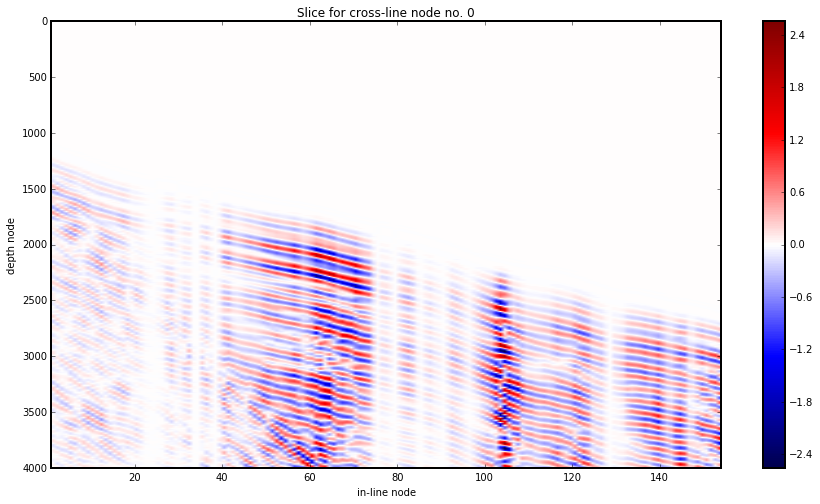

In [410]:
line = '26'
file1 = Get_Files(proj_path, proj_name + '-Synthetic_line' + line + '.vtr')[0]
file2 = Get_Files(proj_path, 'proj17-Synthetic.vtr')[0]
# file2 = Get_Files(proj_path, '4160syn_line26.vtr')[0]
# Gather_Plot(fname, file2=file2, juxt='diff') 
Gather_Plot(file1, file2=file2, juxt='diff')

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj20-Synthetic_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297162.0
lib_fwi_generic.py/Read_vtr: max value:  292683.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 4000
lib_signal_proc.py/Gather_Modify_Normalize:  Max amplitude after normalization:  5.44021
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.44021 5.44021 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 4000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (4000, 154) (4000, 154) (4000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 4000]
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297315.0
lib_fwi_generic.py/Read_vtr: max value:  292742.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_signal_proc.py/Gather_Modify_Normalize:  Max amplitude after normalization:  5.51678
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.51678 5.51678 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 6000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (6000, 154) (6000, 154) (6000, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 6000]
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj20-Synthetic_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297162.0
lib_fwi_generic.py/Read_vtr: max value:  292683.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 4000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_signal_proc.py/Gather_Modify_Normalize:  Max amplitude after normalization:  5.44021
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj17-Synthetic.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297315.0
lib_fwi_generic.py/Read_vtr: max value:  292742.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 6000
lib_signal_proc.py/Gather_Modify_Normalize:  Max amplitude after normalization:  5.51678
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 154 4000 154 6000
libplot_generic.py/Plot_Slice:  Z1_nx, Z1_ny, Z2_nx, Z2_ny 154 4000 154 4000
libplot_generic.py/Plot_Slice:  Zi.shape (154, 4000)
libplot_generic.py/Plot_Slice:  Zi.shape (154, 4000)
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.49578 5.49578 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 4000
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (4000, 154) (400

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

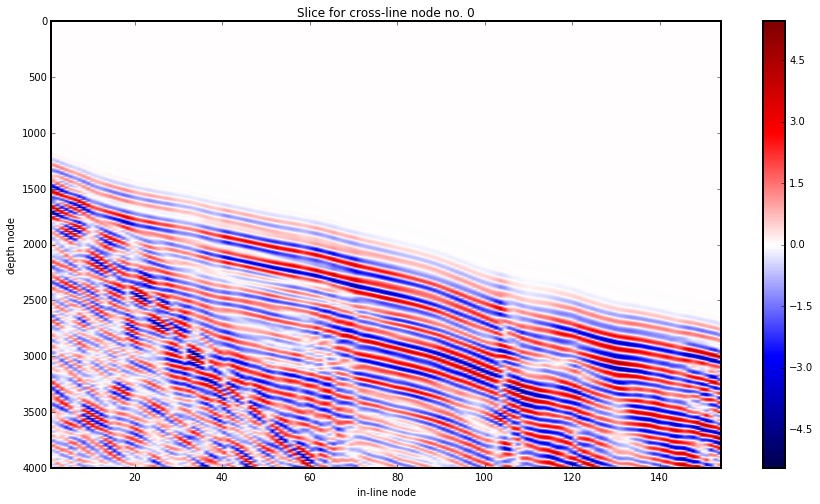

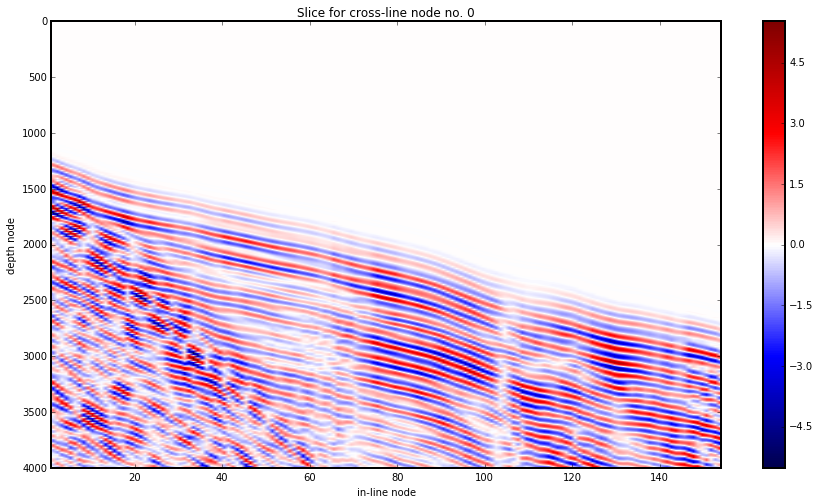

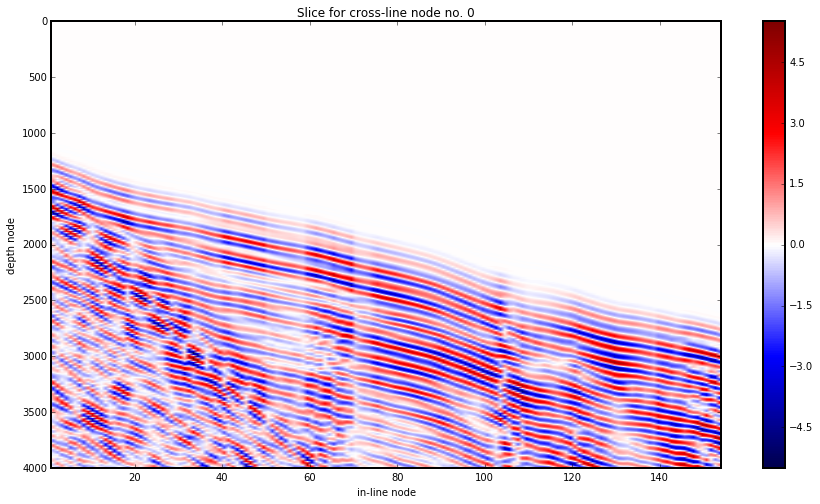

In [414]:
line = '26'
file1 = Get_Files(proj_path, proj_name + '-Synthetic_line' + line + '.vtr')[0]
file2 = Get_Files(proj_path, 'proj17-Synthetic.vtr')[0]
# file2 = Get_Files(proj_path, '4160syn_line26.vtr')[0]
# Gather_Plot(fname, file2=file2, juxt='diff') 
Gather_Plot(file1)
Gather_Plot(file2)
plt.ylim(4000, 0)
Gather_Plot(file1, file2=file2)

# Proj 21 (reliable data: filtered by Jo, picked by Ben; e_abs=20)

- data limited to non-zero profiles from Jo's dataset
- possibly time-windowed using Ben's picks
    - synth or manual?
- the rest copied from trustworthy proj17

In [64]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj21'
# !cd "{proj_path}" && pwd

## Input

In [416]:
# !fwi_cp_project.sh -sp -cp proj17 {proj_name} .

### Observed data

#### Select files

In [448]:
path_sgy = "/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/"
fnames = Get_Files(path_sgy, '4???obs_line*.sgy')

In [379]:
from lib_su import SU_Get_Traces_No
# IT TAKES A WHILE
# fnames_not_empty = []
# for fname in fnames:
#     n = SU_Get_Traces_No(fname)
#     if n > 1:
#         fnames_not_empty.append(fname)

In [382]:
print 'Total no. of profiles in Jo dataset', len(fnames)
print 'No. of non-zero profiles in Jo dataset', len(fnames_not_empty)

Total no. of profiles in Jo dataset 2820
No. of non-zero profiles in Jo dataset 1196


#### Add picks

In [533]:
# !cd {path_sgy} && sugethw.sh {key_shot_id} 4*obs*line*.sgy

In [637]:
t_shift = -50 # ms PICKING ERROR 5-30 ms ACCORDING TO UO
for t_window in [500]:#, 1000, 1500, 2000]:
    Picks_Prepare_For_Data(fnames_not_empty, picks_path, name_format='jm', t_shift=t_shift, t_window=t_window)

lib_fwi_picks.py/Picks_Prepare_For_Data:  No. of picked 608
lib_fwi_picks.py/Picks_Prepare_For_Data:  No. of skipped 50
lib_fwi_picks.py/Picks_Prepare_For_Data:  No. of not picked 588


In [638]:
!cd "{path_sgy}" && su_put_picks_into_headers.sh *t1.ascii


su_put_picks_into_headers.sh: START

File processed: 4104obs_line10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0019585 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3717e-05 s, 38.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00150812 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.182e-05 s, 44.6 MB/s
File processed: 4104obs_line11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139849 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1627e-05 s, 44.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131909 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6343e-05 s, 41.9 MB/s
File processed: 4104obs_line22.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012922 s, 2.5 MB/s
6+1 records in
1+0 rec

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00257948 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000102787 s, 31.1 MB/s
File processed: 4105obs_line31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00239555 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000126782 s, 25.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128512 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.318e-05 s, 60.2 MB/s
File processed: 4105obs_line38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149153 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000112034 s, 28.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148546 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.261e-05 s, 44.1 MB/s

File processed: 4106obs_line28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00229552 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5699e-05 s, 37.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146152 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8554e-05 s, 46.7 MB/s
File processed: 4106obs_line29.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160797 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5084e-05 s, 37.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145865 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6586e-05 s, 48.1 MB/s
File processed: 4106obs_line30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149249 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 Ki

File processed: 4109obs_line10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139934 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3942e-05 s, 38.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134567 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4306e-05 s, 58.9 MB/s
File processed: 4109obs_line11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128332 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.804e-05 s, 55.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128724 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2523e-05 s, 51.2 MB/s
File processed: 4109obs_line26.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130895 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145874 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5553e-05 s, 57.6 MB/s
File processed: 4110obs_line8.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138249 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3758e-05 s, 50.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129097 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5517e-05 s, 57.6 MB/s
File processed: 4110obs_line9.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126429 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2776e-05 s, 44.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012631 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.994e-05 s, 53.4 MB/s
File

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00174423 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2424e-05 s, 38.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00186114 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3415e-05 s, 43.6 MB/s
File processed: 4113obs_line27.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00234569 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000100041 s, 32.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00170329 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5174e-05 s, 49.1 MB/s
File processed: 4113obs_line30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00166017 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0586e-05 s, 35.3 MB/s

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00205415 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000105619 s, 30.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177317 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.4483e-05 s, 37.9 MB/s
File processed: 4114obs_line28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00175909 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000102962 s, 31.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177393 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2698e-05 s, 44.0 MB/s
File processed: 4114obs_line29.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00181951 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8052e-05 s, 32.6 MB/

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161143 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.4034e-05 s, 34.0 MB/s
File processed: 4115obs_line31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001548 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6326e-05 s, 41.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127447 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5596e-05 s, 57.6 MB/s
File processed: 4115obs_line37.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134067 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000177602 s, 18.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143257 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1838e-05 s, 51.7 MB/s
F

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000111751 s, 28.6 MB/s
File processed: 4117obs_line38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136803 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8097e-05 s, 47.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144899 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8548e-05 s, 40.7 MB/s
File processed: 4117obs_line5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139159 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0712e-05 s, 45.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149288 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1783e-05 s, 39.1 MB/s
File processed: 4117obs_line6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 Ki

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188626 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116577 s, 27.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00176649 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6265e-05 s, 37.1 MB/s
File processed: 4124obs_line21.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00306252 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000122362 s, 26.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00249123 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000305651 s, 10.5 MB/s
File processed: 4124obs_line28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182875 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000115067 s, 27.8 M

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00176426 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3938e-05 s, 43.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142741 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6694e-05 s, 41.7 MB/s
File processed: 4125obs_line27.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133044 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8452e-05 s, 54.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140799 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4359e-05 s, 49.7 MB/s
File processed: 4125obs_line28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136879 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7571e-05 s, 36.5 MB/s


6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8018e-05 s, 47.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137112 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7563e-05 s, 47.4 MB/s
File processed: 4128obs_line25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154524 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2429e-05 s, 38.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141031 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9885e-05 s, 53.4 MB/s
File processed: 4128obs_line28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134893 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0839e-05 s, 35.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137071 s, 2.3 MB/s


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00175451 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7994e-05 s, 47.1 MB/s
File processed: 4130obs_line30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00193217 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000117195 s, 27.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00181009 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000142557 s, 22.4 MB/s
File processed: 4130obs_line31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0020951 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000117819 s, 27.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00184514 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3945e-05 s, 38.1 MB/

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00256896 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8009e-05 s, 32.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0018512 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000469115 s, 6.8 MB/s
File processed: 4136obs_line6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00238136 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000176705 s, 18.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00197112 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000102318 s, 31.3 MB/s
File processed: 4136obs_line7.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00185669 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000140178 s, 22.8 MB/s


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00297512 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000144722 s, 22.1 MB/s
File processed: 4138obs_line23.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00198198 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.048e-05 s, 35.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00296594 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151043 s, 21.2 MB/s
File processed: 4138obs_line26.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00366645 s, 873 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000194883 s, 16.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167042 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1989e-05 s, 44.5 MB/

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00174199 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1759e-05 s, 39.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00186139 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1767e-05 s, 39.1 MB/s
File processed: 4139obs_line30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135361 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000523054 s, 6.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130269 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7872e-05 s, 47.1 MB/s
File processed: 4139obs_line31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140525 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4231e-05 s, 49.8 MB/s


6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00018791 s, 17.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00343623 s, 931 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000161782 s, 19.8 MB/s
File processed: 4140obs_line26.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305579 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000165347 s, 19.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00322032 s, 994 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000129542 s, 24.7 MB/s
File processed: 4140obs_line27.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00200102 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1904e-05 s, 34.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00210063 s, 1.5 MB

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000121936 s, 26.2 MB/s
File processed: 4141obs_line18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00183628 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2714e-05 s, 34.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154238 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.372e-05 s, 50.2 MB/s
File processed: 4141obs_line19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132734 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8464e-05 s, 54.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125956 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1511e-05 s, 44.7 MB/s
File processed: 4141obs_line20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 K

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00193287 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000147551 s, 21.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00193044 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000120436 s, 26.6 MB/s
File processed: 4144obs_line24.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177333 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4174e-05 s, 43.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137543 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6887e-05 s, 56.3 MB/s
File processed: 4144obs_line25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147377 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4653e-05 s, 58.6 MB/

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000395432 s, 8.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0027548 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000133979 s, 23.9 MB/s
File processed: 4146obs_line17.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188509 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00017283 s, 18.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00175786 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000102977 s, 31.1 MB/s
File processed: 4146obs_line18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00223449 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000333387 s, 9.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00195815 s, 1.6 MB/s

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00328313 s, 975 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00014828 s, 21.6 MB/s
File processed: 4157obs_line6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129475 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9538e-05 s, 53.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135346 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7206e-05 s, 55.9 MB/s
File processed: 4157obs_line7.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014412 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0581e-05 s, 39.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00287235 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000124009 s, 25.8 MB/s
Fi

File processed: 4158obs_line32.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128874 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3738e-05 s, 50.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138732 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8547e-05 s, 54.7 MB/s
File processed: 4158obs_line38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125237 s, 2.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3676e-05 s, 34.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137314 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4098e-05 s, 59.2 MB/s
File processed: 4158obs_line5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152409 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00207887 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000107031 s, 29.9 MB/s
File processed: 4162obs_line19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00217966 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6675e-05 s, 33.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00206343 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0949e-05 s, 35.2 MB/s
File processed: 4162obs_line20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00213782 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8385e-05 s, 32.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127526 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4814e-05 s, 58.4 MB/s

File processed: 4165obs_line16.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167335 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000194198 s, 16.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138855 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7861e-05 s, 55.3 MB/s
File processed: 4165obs_line17.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141807 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3692e-05 s, 50.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131321 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.558e-05 s, 48.8 MB/s
File processed: 4165obs_line18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130244 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 Ki

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00016086 s, 19.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0067078 s, 477 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000235775 s, 13.6 MB/s
File processed: 4167obs_line19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00373826 s, 856 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000165173 s, 19.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00303688 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000136644 s, 23.4 MB/s
File processed: 4167obs_line20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00321008 s, 997 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000174199 s, 18.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300437 s, 1.1 MB

File processed: 4176obs_line6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136302 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1871e-05 s, 44.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00305612 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000150938 s, 21.2 MB/s
File processed: 4176obs_line7.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00318473 s, 1.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000231544 s, 13.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00300475 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000176296 s, 18.2 MB/s
File processed: 4176obs_line8.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00336272 s, 952 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 Ki

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000164862 s, 19.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00477402 s, 670 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000250109 s, 12.8 MB/s
File processed: 4178obs_line16.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00779891 s, 410 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000137352 s, 23.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137908 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.245e-05 s, 44.2 MB/s
File processed: 4178obs_line17.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00301994 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000191698 s, 16.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00342955 s, 933 kB

File processed: 4179obs_line25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156243 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7957e-05 s, 41.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167944 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3708e-05 s, 50.2 MB/s
File processed: 4179obs_line29.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161529 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.214e-05 s, 39.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00255728 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3722e-05 s, 50.2 MB/s
File processed: 4179obs_line32.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00193667 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139141 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7214e-05 s, 55.9 MB/s
File processed: 4183obs_line18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00184399 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000103987 s, 30.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00223233 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000136003 s, 23.5 MB/s
File processed: 4183obs_line19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00201666 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00011199 s, 28.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00180917 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000123732 s, 25.9 MB

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6126e-05 s, 42.0 MB/s
File processed: 4186obs_line18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00150312 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000104376 s, 30.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136155 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0041e-05 s, 53.3 MB/s
File processed: 4186obs_line19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134033 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0458e-05 s, 45.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138485 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3317e-05 s, 50.5 MB/s
File processed: 4186obs_line20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 

In [604]:
# fname_vtr = '4137obs_line8_m_taper20.vtr'
# fname = path_sgy + fname_vtr

# a = 0.1
# Gather_Plot(fname, minn=-a, maxx=a)
# Picks_Plot(fname) # REMEMBER THEY ARE LIFTED 200 ms UP

#### Mute

In [614]:
# !sumute

In [613]:
# !sutaper

In [642]:
ntaper = int(abs(t_shift) / dt_ms)
print ntaper
!cd {path_sgy} && sumute.sh {ntaper} *_t1.bin

20

sumute.sh: START

Input file:  4104obs_line10.sgy
Output file: 4104obs_line10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00165014 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.8293e-05 s, 36.2 MB/s
Input file:  4104obs_line11.sgy
Output file: 4104obs_line11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00159827 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.436e-05 s, 43.0 MB/s
Input file:  4104obs_line22.sgy
Output file: 4104obs_line22_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142582 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000126675 s, 25.3 MB/s
Input file:  4104obs_line23.sgy
Output file: 4104obs_line23_m_taper20.sgy
No. of samples of taper: 20
3200+0 recor

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00270863 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000107158 s, 29.9 MB/s
Input file:  4106obs_line19.sgy
Output file: 4106obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00158368 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9263e-05 s, 35.8 MB/s
Input file:  4106obs_line20.sgy
Output file: 4106obs_line20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148324 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0961e-05 s, 45.1 MB/s
Input file:  4106obs_line21.sgy
Output file: 4106obs_line21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156083 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013733 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9747e-05 s, 40.1 MB/s
Input file:  4108obs_line6.sgy
Output file: 4108obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143238 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3288e-05 s, 43.7 MB/s
Input file:  4109obs_line10.sgy
Output file: 4109obs_line10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132534 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.4165e-05 s, 38.0 MB/s
Input file:  4109obs_line11.sgy
Output file: 4109obs_line11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135701 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00214958 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9737e-05 s, 32.1 MB/s
Input file:  4112obs_line20.sgy
Output file: 4112obs_line20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00410765 s, 779 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000130099 s, 24.6 MB/s
Input file:  4112obs_line21.sgy
Output file: 4112obs_line21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0018125 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000246042 s, 13.0 MB/s
Input file:  4112obs_line22.sgy
Output file: 4112obs_line22_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00439995 s, 727 kB/s
6+1 records in
1+0 records out
3200 bytes

Input file:  4114obs_line21.sgy
Output file: 4114obs_line21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0139407 s, 230 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001012 s, 3.2 MB/s
Input file:  4114obs_line22.sgy
Output file: 4114obs_line22_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00556015 s, 576 kB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000134201 s, 23.8 MB/s
Input file:  4114obs_line23.sgy
Output file: 4114obs_line23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00178604 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000275478 s, 11.6 MB/s
Input file:  4114obs_line24.sgy
Output file: 4114obs_line24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
32

Input file:  4115obs_line5.sgy
Output file: 4115obs_line5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00170524 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0424e-05 s, 39.8 MB/s
Input file:  4115obs_line6.sgy
Output file: 4115obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00200409 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9409e-05 s, 35.8 MB/s
Input file:  4115obs_line7.sgy
Output file: 4115obs_line7_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00211541 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000168115 s, 19.0 MB/s
Input file:  4115obs_line8.sgy
Output file: 4115obs_line8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 by

Input file:  4123obs_line5.sgy
Output file: 4123obs_line5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00192224 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000143813 s, 22.3 MB/s
Input file:  4123obs_line6.sgy
Output file: 4123obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00196234 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000169635 s, 18.9 MB/s
Input file:  4123obs_line7.sgy
Output file: 4123obs_line7_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00221383 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9894e-05 s, 32.0 MB/s
Input file:  4123obs_line8.sgy
Output file: 4123obs_line8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 b

Input file:  4125obs_line28.sgy
Output file: 4125obs_line28_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129924 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8215e-05 s, 40.9 MB/s
Input file:  4125obs_line29.sgy
Output file: 4125obs_line29_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131431 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0868e-05 s, 52.6 MB/s
Input file:  4125obs_line30.sgy
Output file: 4125obs_line30_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130913 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9122e-05 s, 35.9 MB/s
Input file:  4125obs_line31.sgy
Output file: 4125obs_line31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out


Input file:  4128obs_line6.sgy
Output file: 4128obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00214129 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6107e-05 s, 33.3 MB/s
Input file:  4130obs_line16.sgy
Output file: 4130obs_line16_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00250214 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5127e-05 s, 33.6 MB/s
Input file:  4130obs_line17.sgy
Output file: 4130obs_line17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00211949 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000110322 s, 29.0 MB/s
Input file:  4130obs_line18.sgy
Output file: 4130obs_line18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00183804 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2361e-05 s, 38.9 MB/s
Input file:  4136obs_line6.sgy
Output file: 4136obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00217799 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6392e-05 s, 37.0 MB/s
Input file:  4136obs_line7.sgy
Output file: 4136obs_line7_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177455 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000147071 s, 21.8 MB/s
Input file:  4136obs_line8.sgy
Output file: 4136obs_line8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00187171 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 

Input file:  4138obs_line40.sgy
Output file: 4138obs_line40_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00209369 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8663e-05 s, 32.4 MB/s
Input file:  4138obs_line41.sgy
Output file: 4138obs_line41_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188106 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000105961 s, 30.2 MB/s
Input file:  4138obs_line5.sgy
Output file: 4138obs_line5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00179403 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.149e-05 s, 35.0 MB/s
Input file:  4138obs_line6.sgy
Output file: 4138obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154727 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.55e-05 s, 37.4 MB/s
Input file:  4140obs_line23.sgy
Output file: 4140obs_line23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012831 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0331e-05 s, 53.0 MB/s
Input file:  4140obs_line24.sgy
Output file: 4140obs_line24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139164 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0513e-05 s, 45.4 MB/s
Input file:  4140obs_line25.sgy
Output file: 4140obs_line25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00172523 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00171952 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000140218 s, 22.8 MB/s
Input file:  4142obs_line17.sgy
Output file: 4142obs_line17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00193872 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6279e-05 s, 37.1 MB/s
Input file:  4142obs_line18.sgy
Output file: 4142obs_line18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00189107 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000100608 s, 31.8 MB/s
Input file:  4142obs_line19.sgy
Output file: 4142obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140742 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 byte

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130266 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8591e-05 s, 40.7 MB/s
Input file:  4145obs_line19.sgy
Output file: 4145obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188953 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9625e-05 s, 40.2 MB/s
Input file:  4145obs_line20.sgy
Output file: 4145obs_line20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00181945 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116932 s, 27.4 MB/s
Input file:  4145obs_line5.sgy
Output file: 4145obs_line5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154948 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (

Input file:  4158obs_line10.sgy
Output file: 4158obs_line10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142093 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5545e-05 s, 37.4 MB/s
Input file:  4158obs_line11.sgy
Output file: 4158obs_line11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00200548 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9589e-05 s, 32.1 MB/s
Input file:  4158obs_line16.sgy
Output file: 4158obs_line16_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00186302 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.7222e-05 s, 32.9 MB/s
Input file:  4158obs_line17.sgy
Output file: 4158obs_line17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out


Input file:  4160obs_line5.sgy
Output file: 4160obs_line5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00159135 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000268863 s, 11.9 MB/s
Input file:  4160obs_line6.sgy
Output file: 4160obs_line6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160887 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7027e-05 s, 47.7 MB/s
Input file:  4160obs_line7.sgy
Output file: 4160obs_line7_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00257735 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000202048 s, 15.8 MB/s
Input file:  4160obs_line9.sgy
Output file: 4160obs_line9_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 b

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.82e-05 s, 36.3 MB/s
Input file:  4165obs_line18.sgy
Output file: 4165obs_line18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157629 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6241e-05 s, 33.2 MB/s
Input file:  4165obs_line19.sgy
Output file: 4165obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0015789 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.227e-05 s, 38.9 MB/s
Input file:  4165obs_line20.sgy
Output file: 4165obs_line20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00186613 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00014329 s, 22.3 MB/s
Input file:  4165obs_line5.sgy
Output file: 4165

3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00283803 s, 1.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000124421 s, 25.7 MB/s
Input file:  4176obs_line23.sgy
Output file: 4176obs_line23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00198956 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000108626 s, 29.5 MB/s
Input file:  4176obs_line26.sgy
Output file: 4176obs_line26_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00165632 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.4216e-05 s, 34.0 MB/s
Input file:  4176obs_line27.sgy
Output file: 4176obs_line27_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148065 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7369

Input file:  4178obs_line16.sgy
Output file: 4178obs_line16_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00178129 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4402e-05 s, 43.0 MB/s
Input file:  4178obs_line17.sgy
Output file: 4178obs_line17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145393 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7625e-05 s, 36.5 MB/s
Input file:  4178obs_line18.sgy
Output file: 4178obs_line18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00184803 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.834e-05 s, 36.2 MB/s
Input file:  4178obs_line19.sgy
Output file: 4178obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0015982 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2628e-05 s, 34.5 MB/s
Input file:  4181obs_line18.sgy
Output file: 4181obs_line18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129554 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2377e-05 s, 51.3 MB/s
Input file:  4181obs_line19.sgy
Output file: 4181obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130023 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9413e-05 s, 53.9 MB/s
Input file:  4181obs_line20.sgy
Output file: 4181obs_line20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134834 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (

Input file:  4186obs_line18.sgy
Output file: 4186obs_line18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128767 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6578e-05 s, 56.6 MB/s
Input file:  4186obs_line19.sgy
Output file: 4186obs_line19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131744 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8301e-05 s, 46.9 MB/s
Input file:  4186obs_line20.sgy
Output file: 4186obs_line20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0015786 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000146343 s, 21.9 MB/s
Input file:  4186obs_line31.sgy
Output file: 4186obs_line31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out


##### Plot

In [643]:
fnames = Get_Files(path_sgy, '*m_taper20.sgy')
print len(fnames)

for i, fname in enumerate(fnames):
    cor = fname[ :-len('.sgy')]
    fname_vtr = cor + '.vtr'
    Gather_Plot(fname_vtr, norm='none')
    plt.savefig(cor + '.png')
    plt.close()

608
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72184e+09
lib_fwi_generic.py/Read_vtr: max value:  1.69986e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.72184e+09 1.72184e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55638e+09
lib_fwi_generic.py/Read_vtr: max value:  1.35242e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  118 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.55638e+09 1.55638e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 118 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 118) (2400, 118) (2400, 118)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 118, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35784e+08
lib_fwi_generic.py/Read_vtr: max value:  1.40024e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.40024e+08 1.40024e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.4483e+08
lib_fwi_generic.py/Read_vtr: max value:  1.65494e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.65494e+08 1.65494e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 143 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 143) (2400, 143) (2

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.30047e+08
lib_fwi_generic.py/Read_vtr: max value:  1.40093e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.40093e+08 1.40093e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.23407e+08
lib_fwi_generic.py/Read_vtr: max value:  3.03835e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.23407e+08 3.23407e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 9 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 9) (2400, 9) (2400, 9)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 9, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.31742e+08
lib_fwi_generic.py/Read_vtr: max value:  3.65648e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.31742e+08 4.31742e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 212 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 212) (2400, 212) (2400, 212)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 212, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.23174e+09
lib_fwi_generic.py/Read_vtr: max value:  9.49053e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.23174e+09 1.23174e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 214 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 214) (2400, 214) (2400, 214)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 214, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.32432e+09
lib_fwi_generic.py/Read_vtr: max value:  1.65608e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.65608e+09 1.65608e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35827e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46205e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.46205e+09 1.46205e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 187 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 187) (2400, 187) (2400, 187)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 187, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.87383e+09
lib_fwi_generic.py/Read_vtr: max value:  3.39563e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.87383e+09 3.87383e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 185 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 185) (2400, 185) (2400, 185)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 185, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.93555e+08
lib_fwi_generic.py/Read_vtr: max value:  4.34567e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.93555e+08 4.93555e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.65624e+09
lib_fwi_generic.py/Read_vtr: max value:  2.69056e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.69056e+09 2.69056e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.97866e+09
lib_fwi_generic.py/Read_vtr: max value:  1.7603e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.97866e+09 1.97866e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5336.84
lib_fwi_generic.py/Read_vtr: max value:  5400.87
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  98 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5400.87 5400.87 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 98 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 98) (2400, 98) (2400, 98)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 98, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 11 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 11) (2400, 11) (2400, 11)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 11, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 30 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 30) (2400, 30) (2400, 30)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 30, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  6 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 6 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 6) (2400, 6) (2400, 6)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 6, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400


libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 10 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 10) (2400, 10) (2400, 10)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 10, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 256 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 256) (2400, 256) (2400, 256)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 256, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  260 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 260 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 260) (2400, 260) (2400, 260)
libplot_generic.py/Plot_Slice_Volume: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  227 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 227 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 227) (2400, 227) (2400, 227)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 227, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -117508.0
lib_fwi_generic.py/Read_vtr: max value:  144828.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  227 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -144828.0 144828.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 227 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 227) (2400, 227) (2400, 227)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 227, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -75026.1
lib_fwi_generic.py/Read_vtr: max value:  139566.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  225 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -139566.0 139566.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 225 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 225) (2400, 225) (2400, 225)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 225, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -64087.3
lib_fwi_generic.py/Read_vtr: max value:  61518.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -64087.3 64087.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7369.3
lib_fwi_generic.py/Read_vtr: max value:  7230.68
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7369.3 7369.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3927.32
lib_fwi_generic.py/Read_vtr: max value:  2987.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  123 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3927.32 3927.32 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 123 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 123) (2400, 123) (2400, 123)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 123, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.82982e+09
lib_fwi_generic.py/Read_vtr: max value:  2.24874e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.24874e+09 2.24874e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 63 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 63) (2400, 63) (2400, 63)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 63, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98196e+09
lib_fwi_generic.py/Read_vtr: max value:  1.947e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  45 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.98196e+09 1.98196e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 45 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 45) (2400, 45) (2400, 45)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 45, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.84896e+09
lib_fwi_generic.py/Read_vtr: max value:  1.54351e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.84896e+09 1.84896e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 50 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 50) (2400, 50) (2400, 50)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 50, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.33044e+09
lib_fwi_generic.py/Read_vtr: max value:  1.38297e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.38297e+09 1.38297e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 66 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 66) (2400, 66) (2400, 66)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 66, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.73578e+07
lib_fwi_generic.py/Read_vtr: max value:  4.07962e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.07962e+07 4.07962e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 18 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 18) (2400, 18) (2400, 18)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 18, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.75229e+08
lib_fwi_generic.py/Read_vtr: max value:  3.97336e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.97336e+08 3.97336e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12265e+08
lib_fwi_generic.py/Read_vtr: max value:  1.05611e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  52 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.12265e+08 1.12265e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 52 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 52) (2400, 52) (2400, 52)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 52, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.60898e+08
lib_fwi_generic.py/Read_vtr: max value:  1.31866e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.60898e+08 1.60898e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 64 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 64) (2400, 64) (2400, 64)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 64, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.6282e+07
lib_fwi_generic.py/Read_vtr: max value:  9.51531e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.6282e+07 9.6282e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 88 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 88) (2400, 88) (2400, 88)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 88, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.59004e+07
lib_fwi_generic.py/Read_vtr: max value:  6.58184e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.59004e+07 7.59004e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 35 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 35) (2400, 35) (2400, 35)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 35, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.80342e+07
lib_fwi_generic.py/Read_vtr: max value:  7.43283e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8.80342e+07 8.80342e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 20 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 20) (2400, 20) (2400, 20)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 20, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.28614e+08
lib_fwi_generic.py/Read_vtr: max value:  2.56648e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.56648e+08 2.56648e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 108 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 108) (2400, 108) (2400, 108)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 108, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.09238e+08
lib_fwi_generic.py/Read_vtr: max value:  3.0368e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  119 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.09238e+08 3.09238e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 119 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 119) (2400, 119) (2

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.6487e+08
lib_fwi_generic.py/Read_vtr: max value:  1.30362e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.6487e+08 1.6487e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.90356e+07
lib_fwi_generic.py/Read_vtr: max value:  4.25596e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.25596e+07 4.25596e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 32 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 32) (2400, 32) (2400, 32)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 32, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.2315e+08
lib_fwi_generic.py/Read_vtr: max value:  5.37097e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  269 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.37097e+08 5.37097e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 269 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 269) (2400, 269) (2400, 269)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 269, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53813e+09
lib_fwi_generic.py/Read_vtr: max value:  1.73118e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.73118e+09 1.73118e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 278 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 278) (2400, 278) (2400, 278)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 278, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.29354e+08
lib_fwi_generic.py/Read_vtr: max value:  5.9713e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.9713e+08 5.9713e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.09164e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30117e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.30117e+08 5.30117e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 180 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 180) (2400, 180) (2400, 180)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 180, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.6827e+09
lib_fwi_generic.py/Read_vtr: max value:  2.60139e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.6827e+09 2.6827e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 242 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 242) (2400, 242) (2400, 242)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 242, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.16232e+09
lib_fwi_generic.py/Read_vtr: max value:  2.75087e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.16232e+09 3.16232e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 243 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 243) (2400, 243) (2400, 243)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 243, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49189e+09
lib_fwi_generic.py/Read_vtr: max value:  1.39576e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.49189e+09 1.49189e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 240 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 240) (2400, 240) (2400, 240)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 240, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.87079e+08
lib_fwi_generic.py/Read_vtr: max value:  3.12519e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.12519e+08 3.12519e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 108 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 108) (2400, 108) (2400, 108)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 108, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.24193e+09
lib_fwi_generic.py/Read_vtr: max value:  1.83759e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  98 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.24193e+09 2.24193e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 98 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 98) (2400, 98) (2400, 98)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 98, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.67699e+09
lib_fwi_generic.py/Read_vtr: max value:  1.66403e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.67699e+09 1.67699e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 88 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 88) (2400, 88) (2400, 88)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 88, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2899.26
lib_fwi_generic.py/Read_vtr: max value:  2960.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2960.2 2960.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 86 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 86) (2400, 86) (2400, 86)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 86, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4772.77
lib_fwi_generic.py/Read_vtr: max value:  4270.24
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  171 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4772.77 4772.77 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 171 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 171) (2400, 171) (2400, 171)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 171, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4072.59
lib_fwi_generic.py/Read_vtr: max value:  3591.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  122 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4072.59 4072.59 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 122 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 122) (2400, 122) (2400, 122)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 122, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15892.7
lib_fwi_generic.py/Read_vtr: max value:  14481.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -15892.7 15892.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -263.121
lib_fwi_generic.py/Read_vtr: max value:  210.996
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -263.121 263.121 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 2 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 2) (2400, 2) (2400, 2)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 2, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -552097.0
lib_fwi_generic.py/Read_vtr: max value:  258923.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -552097.0 552097.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 271 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 271) (2400, 271) (2400, 271)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 271, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -733592.0
lib_fwi_generic.py/Read_vtr: max value:  917149.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -917149.0 917149.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 170 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 170) (2400, 170) (2400, 170)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 170, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12545e+06
lib_fwi_generic.py/Read_vtr: max value:  452066.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  236 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.12545e+06 1.12545e+06 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 236 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 236) (2400, 236) (2400, 236)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 236, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -401849.0
lib_fwi_generic.py/Read_vtr: max value:  441815.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  235 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -441815.0 441815.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 235 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 235) (2400, 235) (2400, 235)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 235, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.10882e+08
lib_fwi_generic.py/Read_vtr: max value:  2.05424e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.10882e+08 2.10882e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.5223e+08
lib_fwi_generic.py/Read_vtr: max value:  1.53131e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.53131e+08 1.53131e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.52186e+08
lib_fwi_generic.py/Read_vtr: max value:  3.51954e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.52186e+08 3.52186e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.6151e+08
lib_fwi_generic.py/Read_vtr: max value:  7.80812e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.80812e+08 7.80812e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.67646e+09
lib_fwi_generic.py/Read_vtr: max value:  3.05364e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.05364e+09 3.05364e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 185 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 185) (2400, 185) (2400, 185)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 185, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.67162e+09
lib_fwi_generic.py/Read_vtr: max value:  6.46274e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.46274e+09 6.46274e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 185 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 185) (2400, 185) (2400, 185)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 185, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.31904e+09
lib_fwi_generic.py/Read_vtr: max value:  1.28285e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.31904e+09 1.31904e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 160 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 160) (2400, 160) (2400, 160)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 160, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.59035e+09
lib_fwi_generic.py/Read_vtr: max value:  2.49636e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.49636e+09 2.49636e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 161 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 161) (2400, 161) (2400, 161)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 161, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.2729e+09
lib_fwi_generic.py/Read_vtr: max value:  3.21936e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.2729e+09 3.2729e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.33053e+08
lib_fwi_generic.py/Read_vtr: max value:  7.49629e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8.33053e+08 8.33053e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.60556e+08
lib_fwi_generic.py/Read_vtr: max value:  2.67619e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.67619e+08 2.67619e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -54652.2
lib_fwi_generic.py/Read_vtr: max value:  46929.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -54652.2 54652.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6202.53
lib_fwi_generic.py/Read_vtr: max value:  7189.98
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7189.98 7189.98 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 2 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 2) (2400, 2) (2400, 2)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 2, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -148700.0
lib_fwi_generic.py/Read_vtr: max value:  143240.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -148700.0 148700.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -61942.2
lib_fwi_generic.py/Read_vtr: max value:  60842.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -61942.2 61942.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 213 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 213) (2400, 213) (2400, 213)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 213, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74717.4
lib_fwi_generic.py/Read_vtr: max value:  68616.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -74717.4 74717.4 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 212 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 212) (2400, 212) (2400, 212)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 212, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 64 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 64) (2400, 64) (2400, 64)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 64, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -112145.0
lib_fwi_generic.py/Read_vtr: max value:  94882.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -112145.0 112145.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 184 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 184) (2400, 184) (2400, 184)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 184, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -135419.0
lib_fwi_generic.py/Read_vtr: max value:  102456.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -135419.0 135419.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 185 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 185) (2400, 185) (2400, 185)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 185, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -103266.0
lib_fwi_generic.py/Read_vtr: max value:  113275.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -113275.0 113275.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -177688.0
lib_fwi_generic.py/Read_vtr: max value:  151878.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -177688.0 177688.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33330.1
lib_fwi_generic.py/Read_vtr: max value:  32556.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -33330.1 33330.1 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.25134e+09
lib_fwi_generic.py/Read_vtr: max value:  2.83304e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  99 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.83304e+09 2.83304e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 99 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 99) (2400, 99) (2400, 99)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 99, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.84906e+09
lib_fwi_generic.py/Read_vtr: max value:  2.01119e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.01119e+09 2.01119e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 87 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 87) (2400, 87) (2400, 87)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 87, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.29976e+09
lib_fwi_generic.py/Read_vtr: max value:  1.32027e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.32027e+09 1.32027e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 50 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 50) (2400, 50) (2400, 50)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 50, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.64144e+08
lib_fwi_generic.py/Read_vtr: max value:  2.86816e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.86816e+08 2.86816e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 60 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 60) (2400, 60) (2400, 60)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 60, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 8 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 8) (2400, 8) (2400, 8)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 8, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.36466e+08
lib_fwi_generic.py/Read_vtr: max value:  2.50922e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.50922e+08 2.50922e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 27 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 27) (2400, 27) (2400, 27)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 27, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.95926e+07
lib_fwi_generic.py/Read_vtr: max value:  7.70242e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.70242e+07 7.70242e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 53 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 53) (2400, 53) (2400, 53)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 53, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.51744e+08
lib_fwi_generic.py/Read_vtr: max value:  3.56516e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.56516e+08 3.56516e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 108 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 108) (2400, 108) (2400, 108)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 108, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.85887e+08
lib_fwi_generic.py/Read_vtr: max value:  3.39297e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.39297e+08 3.39297e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 125 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 125) (2400, 125) (

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.6551e+07
lib_fwi_generic.py/Read_vtr: max value:  6.77088e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.77088e+07 6.77088e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 30 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 30) (2400, 30) (2400, 30)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 30, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.22067e+07
lib_fwi_generic.py/Read_vtr: max value:  2.70824e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.22067e+07 3.22067e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 11 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 11) (2400, 11) (2400, 11)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 11, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.2832e+07
lib_fwi_generic.py/Read_vtr: max value:  3.8492e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.2832e+07 4.2832e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.90172e+07
lib_fwi_generic.py/Read_vtr: max value:  3.00642e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.00642e+07 3.00642e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 19 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 19) (2400, 19) (2400, 19)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 19, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.11169e+08
lib_fwi_generic.py/Read_vtr: max value:  1.03369e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.11169e+08 1.11169e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 277 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 277) (2400, 277) (2400, 277)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 277, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.54732e+08
lib_fwi_generic.py/Read_vtr: max value:  7.52065e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8.54732e+08 8.54732e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 239 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 239) (2400, 239) (2400, 239)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 239, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.6024e+09
lib_fwi_generic.py/Read_vtr: max value:  1.57609e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.6024e+09 1.6024e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 243 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 243) (2400, 243) (2400, 243)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 243, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.38184e+08
lib_fwi_generic.py/Read_vtr: max value:  2.51391e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.51391e+08 2.51391e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.70916e+09
lib_fwi_generic.py/Read_vtr: max value:  1.85204e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.85204e+09 1.85204e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 124 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 124) (2400, 124) (2400, 124)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 124, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.09861e+09
lib_fwi_generic.py/Read_vtr: max value:  2.11903e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  118 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.11903e+09 2.11903e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 118 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 118) (2400, 118) (2400, 118)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 118, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.25465e+08
lib_fwi_generic.py/Read_vtr: max value:  3.79888e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  111 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.25465e+08 4.25465e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 111 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 111) (2400, 111) (2400, 111)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 111, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.19472e+08
lib_fwi_generic.py/Read_vtr: max value:  1.67631e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.19472e+08 2.19472e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 277 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 277) (2400, 277) (2400, 277)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 277, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.93213e+08
lib_fwi_generic.py/Read_vtr: max value:  6.63877e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.93213e+08 6.93213e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 277 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 277) (2400, 277) (2400, 277)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 277, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.80845e+08
lib_fwi_generic.py/Read_vtr: max value:  1.00366e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.00366e+09 1.00366e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 239 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 239) (2400, 239) (2400, 239)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 239, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49622e+09
lib_fwi_generic.py/Read_vtr: max value:  1.22078e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.49622e+09 1.49622e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 243 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 243) (2400, 243) (2400, 243)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 243, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.7605e+08
lib_fwi_generic.py/Read_vtr: max value:  1.79044e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  99 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.79044e+08 1.79044e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 99 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 99) (2400, 99) (2400, 99)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 99, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.14688e+09
lib_fwi_generic.py/Read_vtr: max value:  1.61625e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  92 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.61625e+09 1.61625e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 92 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 92) (2400, 92) (2400, 92)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 92, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.67558e+10
lib_fwi_generic.py/Read_vtr: max value:  1.75013e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.75013e+10 1.75013e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 38 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 38) (2400, 38) (2400, 38)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 38, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.59623e+09
lib_fwi_generic.py/Read_vtr: max value:  2.08367e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.59623e+09 2.59623e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 26 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 26) (2400, 26) (2400, 26)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 26, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.46331e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46047e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.46331e+09 1.46331e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.39539e+09
lib_fwi_generic.py/Read_vtr: max value:  1.35834e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  107 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.39539e+09 1.39539e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 107 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 107) (2400, 107) (2400, 107)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 107, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.76112e+08
lib_fwi_generic.py/Read_vtr: max value:  3.89226e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.89226e+08 3.89226e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 116 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 116) (2400, 116) (2400, 116)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 116, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.24433e+07
lib_fwi_generic.py/Read_vtr: max value:  1.31786e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.31786e+07 1.31786e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 64 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 64) (2400, 64) (2400, 64)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 64, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.90339e+08
lib_fwi_generic.py/Read_vtr: max value:  2.9723e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.9723e+08 2.9723e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 84 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 84) (2400, 84) (2400, 84)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 84, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.84814e+08
lib_fwi_generic.py/Read_vtr: max value:  1.6157e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  114 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.84814e+08 1.84814e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 114 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 114) (2400, 114) (2400, 114)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 114, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.66759e+07
lib_fwi_generic.py/Read_vtr: max value:  8.53175e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.66759e+07 9.66759e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 39 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 39) (2400, 39) (2400, 39)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 39, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47281e+08
lib_fwi_generic.py/Read_vtr: max value:  1.24232e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.47281e+08 1.47281e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 56 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 56) (2400, 56) (2400, 56)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 56, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.291e+08
lib_fwi_generic.py/Read_vtr: max value:  1.50457e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  94 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.50457e+08 1.50457e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 94 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 94) (2400, 94) (2400, 94)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 94, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.68331e+08
lib_fwi_generic.py/Read_vtr: max value:  1.94977e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.94977e+08 1.94977e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 76 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 76) (2400, 76) (2400, 76)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 76, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.37129e+08
lib_fwi_generic.py/Read_vtr: max value:  1.51316e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.51316e+08 1.51316e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 73 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 73) (2400, 73) (2400, 73)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 73, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49078e+08
lib_fwi_generic.py/Read_vtr: max value:  1.30472e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  81 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.49078e+08 1.49078e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 81 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 81) (2400, 81) (2400, 81)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 81, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.53187e+08
lib_fwi_generic.py/Read_vtr: max value:  2.15962e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.53187e+08 2.53187e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98591e+08
lib_fwi_generic.py/Read_vtr: max value:  1.91888e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.98591e+08 1.98591e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 84 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 84) (2400, 84) (2400, 84)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 84, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.9831e+08
lib_fwi_generic.py/Read_vtr: max value:  3.77198e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  276 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.77198e+08 3.77198e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 276 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 276) (2400, 276) (2400, 276)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 276, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.4065e+08
lib_fwi_generic.py/Read_vtr: max value:  3.27801e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.4065e+08 3.4065e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 278 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 278) (2400, 278) (2400, 278)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 278, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.30271e+08
lib_fwi_generic.py/Read_vtr: max value:  2.82153e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.82153e+08 2.82153e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.5491e+08
lib_fwi_generic.py/Read_vtr: max value:  1.48628e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  142 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.5491e+08 1.5491e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 142 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 142) (2400, 142) (2400, 142)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 142, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.59366e+08
lib_fwi_generic.py/Read_vtr: max value:  2.7905e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  233 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.59366e+08 3.59366e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 233 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 233) (2400, 233) (2400, 233)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 233, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.79296e+09
lib_fwi_generic.py/Read_vtr: max value:  2.03351e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.03351e+09 2.03351e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 240 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 240) (2400, 240) (2400, 240)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 240, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.31278e+09
lib_fwi_generic.py/Read_vtr: max value:  1.33206e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.31278e+09 2.31278e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 243 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 243) (2400, 243) (2400, 243)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 243, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35028e+08
lib_fwi_generic.py/Read_vtr: max value:  1.3757e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.3757e+08 1.3757e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 73 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 73) (2400, 73) (2400, 73)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 73, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.27487e+09
lib_fwi_generic.py/Read_vtr: max value:  1.3266e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.3266e+09 1.3266e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 66 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 66) (2400, 66) (2400, 66)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 66, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.64294e+09
lib_fwi_generic.py/Read_vtr: max value:  1.64776e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.64776e+09 1.64776e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 59 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 59) (2400, 59) (2400, 59)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 59, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12013.5
lib_fwi_generic.py/Read_vtr: max value:  8679.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -12013.5 12013.5 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -89919.6
lib_fwi_generic.py/Read_vtr: max value:  94968.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -94968.6 94968.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 160 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 160) (2400, 160) (2400, 160)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 160, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -49039.7
lib_fwi_generic.py/Read_vtr: max value:  44724.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -49039.7 49039.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 108 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 108) (2400, 108) (2400, 108)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 108, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -790318.0
lib_fwi_generic.py/Read_vtr: max value:  590382.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -790318.0 790318.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 127 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 127) (2400, 127) (2400, 127)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 127, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -411.033
lib_fwi_generic.py/Read_vtr: max value:  448.653
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -448.653 448.653 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 12 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 12) (2400, 12) (2400, 12)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 12, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1709.32
lib_fwi_generic.py/Read_vtr: max value:  1894.45
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1894.45 1894.45 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 28 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 28) (2400, 28) (2400, 28)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 28, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -741.037
lib_fwi_generic.py/Read_vtr: max value:  702.424
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -741.037 741.037 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 35 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 35) (2400, 35) (2400, 35)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 35, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 278 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 278) (2400, 278) (2400, 278)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 278, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -338545.0
lib_fwi_generic.py/Read_vtr: max value:  551025.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -551025.0 551025.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 277 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 277) (2400, 277) (2400, 277)
libplot_generic.p

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -107197.0
lib_fwi_generic.py/Read_vtr: max value:  104465.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  101 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -107197.0 107197.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 101 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 101) (2400, 101) (2400, 101)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 101, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -442158.0
lib_fwi_generic.py/Read_vtr: max value:  373917.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  190 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -442158.0 442158.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 190 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 190) (2400, 190) (2400, 190)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 190, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -640589.0
lib_fwi_generic.py/Read_vtr: max value:  531498.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -640589.0 640589.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 239 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 239) (2400, 239) (2400, 239)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 239, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -183866.0
lib_fwi_generic.py/Read_vtr: max value:  180950.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -183866.0 183866.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 242 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 242) (2400, 242) (2400, 242)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 242, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1038.44
lib_fwi_generic.py/Read_vtr: max value:  1136.76
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1136.76 1136.76 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 32 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 32) (2400, 32) (2400, 32)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 32, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4706.41
lib_fwi_generic.py/Read_vtr: max value:  4394.09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4706.41 4706.41 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 26 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 26) (2400, 26) (2400, 26)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 26, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3667.19
lib_fwi_generic.py/Read_vtr: max value:  3252.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3667.19 3667.19 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 20 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 20) (2400, 20) (2400, 20)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 20, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3899.58
lib_fwi_generic.py/Read_vtr: max value:  3875.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3899.58 3899.58 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7971.73
lib_fwi_generic.py/Read_vtr: max value:  7095.08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7971.73 7971.73 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 146 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 146) (2400, 146) (2400, 146)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 146, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -42125.6
lib_fwi_generic.py/Read_vtr: max value:  37834.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -42125.6 42125.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -88071.0
lib_fwi_generic.py/Read_vtr: max value:  72106.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -88071.0 88071.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -110976.0
lib_fwi_generic.py/Read_vtr: max value:  127840.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -127840.0 127840.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -801.353
lib_fwi_generic.py/Read_vtr: max value:  869.757
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -869.757 869.757 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 165 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 165) (2400, 165) (2400, 165)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 165, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2107.04
lib_fwi_generic.py/Read_vtr: max value:  2260.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2260.59 2260.59 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 176 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 176) (2400, 176) (2400, 176)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 176, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5417.82
lib_fwi_generic.py/Read_vtr: max value:  5486.17
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5486.17 5486.17 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5701.75
lib_fwi_generic.py/Read_vtr: max value:  6709.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6709.9 6709.9 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2306.75
lib_fwi_generic.py/Read_vtr: max value:  1971.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2306.75 2306.75 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 192 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 192) (2400, 192) (2400, 192)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 192, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9681.27
lib_fwi_generic.py/Read_vtr: max value:  7756.16
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9681.27 9681.27 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 192 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 192) (2400, 192) (2400, 192)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 192, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -800.218
lib_fwi_generic.py/Read_vtr: max value:  737.871
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -800.218 800.218 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 80 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 80) (2400, 80) (2400, 80)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 80, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6566.86
lib_fwi_generic.py/Read_vtr: max value:  8023.41
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  100 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8023.41 8023.41 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 100 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 100) (2400, 100) (2400, 100)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 100, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -155846.0
lib_fwi_generic.py/Read_vtr: max value:  302688.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -302688.0 302688.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 165 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 165) (2400, 165) (2400, 165)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 165, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -232121.0
lib_fwi_generic.py/Read_vtr: max value:  176838.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -232121.0 232121.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 168 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 168) (2400, 168) (2400, 168)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 168, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9685.61
lib_fwi_generic.py/Read_vtr: max value:  7942.39
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9685.61 9685.61 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2168.77
lib_fwi_generic.py/Read_vtr: max value:  2099.54
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2168.77 2168.77 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45899.5
lib_fwi_generic.py/Read_vtr: max value:  47923.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -47923.2 47923.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 143 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 143) (2400, 143) (2400, 143)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 143, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70832.6
lib_fwi_generic.py/Read_vtr: max value:  54288.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -70832.6 70832.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -268308.0
lib_fwi_generic.py/Read_vtr: max value:  629642.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -629642.0 629642.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -193795.0
lib_fwi_generic.py/Read_vtr: max value:  156554.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -193795.0 193795.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 176 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 176) (2400, 176) (2400, 176)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 176, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -183895.0
lib_fwi_generic.py/Read_vtr: max value:  183828.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -183895.0 183895.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 173 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 173) (2400, 173) (2400, 173)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 173, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -916132.0
lib_fwi_generic.py/Read_vtr: max value:  752109.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -916132.0 916132.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 147 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 147) (2400, 147) (2400, 147)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 147, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -55427.7
lib_fwi_generic.py/Read_vtr: max value:  56466.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -56466.9 56466.9 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 148 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 148) (2400, 148) (2400, 148)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 148, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -560172.0
lib_fwi_generic.py/Read_vtr: max value:  338045.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -560172.0 560172.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.22297e+06
lib_fwi_generic.py/Read_vtr: max value:  697082.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.22297e+06 3.22297e+06 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -125324.0
lib_fwi_generic.py/Read_vtr: max value:  116012.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -125324.0 125324.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71107.3
lib_fwi_generic.py/Read_vtr: max value:  69890.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -71107.3 71107.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.11656e+09
lib_fwi_generic.py/Read_vtr: max value:  2.02031e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.11656e+09 2.11656e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.59925e+09
lib_fwi_generic.py/Read_vtr: max value:  1.70297e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.70297e+09 1.70297e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.38192e+08
lib_fwi_generic.py/Read_vtr: max value:  3.38432e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.38432e+08 3.38432e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 9 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 9) (2400, 9) (2400, 9)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 9, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.20348e+09
lib_fwi_generic.py/Read_vtr: max value:  1.37409e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.37409e+09 1.37409e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 17 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 17) (2400, 17) (2400, 17)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 17, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.0562e+07
lib_fwi_generic.py/Read_vtr: max value:  2.9162e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.0562e+07 3.0562e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 8 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 8) (2400, 8) (2400, 8)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 8, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.11013e+07
lib_fwi_generic.py/Read_vtr: max value:  3.12058e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.12058e+07 3.12058e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.70587e+08
lib_fwi_generic.py/Read_vtr: max value:  3.76127e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  220 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.70587e+08 4.70587e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 220 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 220) (2400, 220) (2400, 220)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 220, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.78513e+08
lib_fwi_generic.py/Read_vtr: max value:  3.56299e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.78513e+08 3.78513e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 217 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 217) (2400, 217) (2400, 217)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 217, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.91765e+08
lib_fwi_generic.py/Read_vtr: max value:  4.35931e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.35931e+08 4.35931e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.98282e+08
lib_fwi_generic.py/Read_vtr: max value:  6.03251e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.03251e+08 6.03251e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 191 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 191) (2400, 191) (2400, 191)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 191, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.65237e+08
lib_fwi_generic.py/Read_vtr: max value:  5.40518e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.40518e+08 5.40518e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.94781e+09
lib_fwi_generic.py/Read_vtr: max value:  3.0615e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.0615e+09 3.0615e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.32567e+09
lib_fwi_generic.py/Read_vtr: max value:  2.39075e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.39075e+09 2.39075e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.25915e+09
lib_fwi_generic.py/Read_vtr: max value:  1.30673e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  109 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.30673e+09 1.30673e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 109 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 109) (2400, 109) (2400, 109)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 109, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.54276e+08
lib_fwi_generic.py/Read_vtr: max value:  1.07081e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  101 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.07081e+09 1.07081e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 101 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 101) (2400, 101) (2400, 101)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 101, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 3 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 3) (2400, 3) (2400, 3)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 3, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.79989e+08
lib_fwi_generic.py/Read_vtr: max value:  3.70289e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.70289e+08 3.70289e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 65 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 65) (2400, 65) (2400, 65)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 65, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.24958e+08
lib_fwi_generic.py/Read_vtr: max value:  2.62745e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  69 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.24958e+08 3.24958e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 69 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 69) (2400, 69) (2400, 69)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 69, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 14 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 14) (2400, 14) (2400, 14)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 14, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.79346e+08
lib_fwi_generic.py/Read_vtr: max value:  2.08725e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.08725e+08 2.08725e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 30 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 30) (2400, 30) (2400, 30)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 30, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.12941e+07
lib_fwi_generic.py/Read_vtr: max value:  2.06258e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  68 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.12941e+07 2.12941e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 68 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 68) (2400, 68) (2400, 68)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 68, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.45842e+08
lib_fwi_generic.py/Read_vtr: max value:  1.54e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  122 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.54e+08 1.54e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 122 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 122) (2400, 122) (2400, 122)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 122, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.13055e+08
lib_fwi_generic.py/Read_vtr: max value:  2.48508e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.48508e+08 2.48508e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35821e+07
lib_fwi_generic.py/Read_vtr: max value:  1.85916e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.85916e+07 1.85916e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 20 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 20) (2400, 20) (2400, 20)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 20, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.19991e+08
lib_fwi_generic.py/Read_vtr: max value:  2.27188e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.27188e+08 2.27188e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 146 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 146) (2400, 146) (2400, 146)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 146, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.03278e+08
lib_fwi_generic.py/Read_vtr: max value:  1.81418e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.03278e+08 2.03278e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 150 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 150) (2400, 150) (2400, 150)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 150, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.20326e+07
lib_fwi_generic.py/Read_vtr: max value:  3.13509e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.20326e+07 3.20326e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98996e+07
lib_fwi_generic.py/Read_vtr: max value:  1.83912e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.98996e+07 1.98996e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 25 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 25) (2400, 25) (2400, 25)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 25, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.08672e+07
lib_fwi_generic.py/Read_vtr: max value:  7.07833e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.07833e+07 7.07833e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 278 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 278) (2400, 278) (2400, 278)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 278, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.58129e+08
lib_fwi_generic.py/Read_vtr: max value:  3.7384e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  269 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.7384e+08 3.7384e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 269 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 269) (2400, 269) (2400, 269)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 269, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.8186e+07
lib_fwi_generic.py/Read_vtr: max value:  1.90591e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.90591e+07 1.90591e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.25042e+08
lib_fwi_generic.py/Read_vtr: max value:  3.4158e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.4158e+08 3.4158e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 197 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 197) (2400, 197) (2400, 197)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 197, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.00259e+08
lib_fwi_generic.py/Read_vtr: max value:  2.22839e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  229 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.22839e+08 2.22839e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 229 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 229) (2400, 229) (2400, 229)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 229, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.87079e+08
lib_fwi_generic.py/Read_vtr: max value:  4.21593e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  228 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.21593e+08 4.21593e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 228 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 228) (2400, 228) (2400, 228)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 228, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.61723e+08
lib_fwi_generic.py/Read_vtr: max value:  4.29097e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.29097e+08 4.29097e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 239 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 239) (2400, 239) (2400, 239)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 239, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.49945e+08
lib_fwi_generic.py/Read_vtr: max value:  2.55043e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.55043e+08 2.55043e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.31187e+08
lib_fwi_generic.py/Read_vtr: max value:  3.45903e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.31187e+08 4.31187e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 127 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 127) (2400, 127) (2400, 127)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 127, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13198e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46367e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.46367e+09 1.46367e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 124 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 124) (2400, 124) (2400, 124)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 124, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.78491e+09
lib_fwi_generic.py/Read_vtr: max value:  1.7671e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.78491e+09 1.78491e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.7089e+09
lib_fwi_generic.py/Read_vtr: max value:  4.47229e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.7089e+09 4.7089e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 169 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 169) (2400, 169) (2400, 169)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 169, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.05378e+09
lib_fwi_generic.py/Read_vtr: max value:  2.5292e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.05378e+09 3.05378e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 176 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 176) (2400, 176) (2400, 176)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 176, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.6291e+08
lib_fwi_generic.py/Read_vtr: max value:  1.64435e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.64435e+08 1.64435e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.38534e+09
lib_fwi_generic.py/Read_vtr: max value:  3.10843e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.10843e+09 3.10843e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.26927e+08
lib_fwi_generic.py/Read_vtr: max value:  1.24872e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.26927e+08 1.26927e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 192 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 192) (2400, 192) (2400, 192)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 192, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.00123e+08
lib_fwi_generic.py/Read_vtr: max value:  7.11631e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.11631e+08 7.11631e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 181 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 181) (2400, 181) (2400, 181)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 181, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.10623e+09
lib_fwi_generic.py/Read_vtr: max value:  2.16427e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.16427e+09 2.16427e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.82599e+07
lib_fwi_generic.py/Read_vtr: max value:  7.78226e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.82599e+07 7.82599e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 12 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 12) (2400, 12) (2400, 12)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 12, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.4372e+08
lib_fwi_generic.py/Read_vtr: max value:  3.95658e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.4372e+08 4.4372e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.24685e+09
lib_fwi_generic.py/Read_vtr: max value:  1.67725e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  206 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.67725e+09 1.67725e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 206 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 206) (2400, 206) (2400, 206)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 206, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.47126e+09
lib_fwi_generic.py/Read_vtr: max value:  5.88959e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  203 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.88959e+09 5.88959e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 203 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 203) (2400, 203) (2400, 203)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 203, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.27078e+07
lib_fwi_generic.py/Read_vtr: max value:  9.80396e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.80396e+07 9.80396e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 80 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 80) (2400, 80) (2400, 80)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 80, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.70936e+09
lib_fwi_generic.py/Read_vtr: max value:  1.41522e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.70936e+09 2.70936e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.95196e+08
lib_fwi_generic.py/Read_vtr: max value:  6.93337e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.93337e+08 6.93337e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 37 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 37) (2400, 37) (2400, 37)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 37, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.41474e+08
lib_fwi_generic.py/Read_vtr: max value:  1.94407e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.41474e+08 2.41474e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 30 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 30) (2400, 30) (2400, 30)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 30, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.51765e+08
lib_fwi_generic.py/Read_vtr: max value:  6.25932e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.25932e+08 6.25932e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 173 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 173) (2400, 173) (2400, 173)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 173, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.89361e+09
lib_fwi_generic.py/Read_vtr: max value:  2.87157e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.89361e+09 4.89361e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 179 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 179) (2400, 179) (2400, 179)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 179, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.77831e+09
lib_fwi_generic.py/Read_vtr: max value:  1.82235e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.82235e+09 1.82235e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 124 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 124) (2400, 124) (2400, 124)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 124, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.95914e+10
lib_fwi_generic.py/Read_vtr: max value:  1.81678e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.95914e+10 1.95914e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.87963e+08
lib_fwi_generic.py/Read_vtr: max value:  5.29489e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.29489e+08 5.29489e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 136 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 136) (2400, 136) (2400, 136)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 136, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.9002e+08
lib_fwi_generic.py/Read_vtr: max value:  3.413e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.9002e+08 3.9002e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.66116e+08
lib_fwi_generic.py/Read_vtr: max value:  2.37508e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.66116e+08 2.66116e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 141 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 141) (2400, 141) (2400, 141)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 141, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.18011e+08
lib_fwi_generic.py/Read_vtr: max value:  2.06884e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.18011e+08 2.18011e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 146 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 146) (2400, 146) (2400, 146)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 146, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.93993e+08
lib_fwi_generic.py/Read_vtr: max value:  2.7991e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.93993e+08 2.93993e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 154) (2400, 154) (2400, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.18808e+08
lib_fwi_generic.py/Read_vtr: max value:  5.49464e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.18808e+08 6.18808e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.30319e+07
lib_fwi_generic.py/Read_vtr: max value:  1.04367e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.04367e+08 1.04367e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.11698e+08
lib_fwi_generic.py/Read_vtr: max value:  1.15582e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.15582e+08 1.15582e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 160 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 160) (2400, 160) (2400, 160)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 160, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.05536e+08
lib_fwi_generic.py/Read_vtr: max value:  1.93184e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.05536e+08 2.05536e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 157 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 157) (2400, 157) (2400, 157)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 157, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.23648e+07
lib_fwi_generic.py/Read_vtr: max value:  4.14654e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.23648e+07 4.23648e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 80 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 80) (2400, 80) (2400, 80)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 80, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.67037e+08
lib_fwi_generic.py/Read_vtr: max value:  3.58195e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.67037e+08 3.67037e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1334e+08
lib_fwi_generic.py/Read_vtr: max value:  1.36956e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.36956e+08 1.36956e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 37 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 37) (2400, 37) (2400, 37)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 37, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.14113e+06
lib_fwi_generic.py/Read_vtr: max value:  5.31483e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.31483e+06 5.31483e+06 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 30 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 30) (2400, 30) (2400, 30)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 30, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.19811e+07
lib_fwi_generic.py/Read_vtr: max value:  2.04374e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.19811e+07 2.19811e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 67 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 67) (2400, 67) (2400, 67)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 67, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.14969e+09
lib_fwi_generic.py/Read_vtr: max value:  1.56363e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.56363e+09 1.56363e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 67 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 67) (2400, 67) (2400, 67)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 67, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.66042e+08
lib_fwi_generic.py/Read_vtr: max value:  5.77252e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.66042e+08 6.66042e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.30153e+08
lib_fwi_generic.py/Read_vtr: max value:  2.89804e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  138 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.30153e+08 3.30153e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 138 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 138) (2400, 138) (2400, 138)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 138, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.42856e+09
lib_fwi_generic.py/Read_vtr: max value:  1.5363e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  105 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.5363e+09 1.5363e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 105 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 105) (2400, 105) (2400, 105)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 105, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.1815e+08
lib_fwi_generic.py/Read_vtr: max value:  3.71335e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  117 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.71335e+08 3.71335e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 117 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 117) (2400, 117) (2400, 117)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 117, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.03718e+08
lib_fwi_generic.py/Read_vtr: max value:  1.91097e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.03718e+08 2.03718e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.02897e+08
lib_fwi_generic.py/Read_vtr: max value:  3.09326e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.09326e+08 3.09326e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.08313e+08
lib_fwi_generic.py/Read_vtr: max value:  2.75439e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.75439e+08 2.75439e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.98242e+08
lib_fwi_generic.py/Read_vtr: max value:  2.73851e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  138 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.98242e+08 3.98242e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 138 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 138) (2400, 138) (2400, 138)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 138, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53998e+09
lib_fwi_generic.py/Read_vtr: max value:  9.6049e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.53998e+09 1.53998e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 113 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 113) (2400, 113) (2400, 113)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 113, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.7103e+08
lib_fwi_generic.py/Read_vtr: max value:  5.04401e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  119 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.04401e+08 5.04401e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 119 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 119) (2400, 119) (2400, 119)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 119, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.91751e+08
lib_fwi_generic.py/Read_vtr: max value:  3.61229e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.91751e+08 3.91751e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.62637e+08
lib_fwi_generic.py/Read_vtr: max value:  3.27785e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.62637e+08 3.62637e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.87461e+08
lib_fwi_generic.py/Read_vtr: max value:  1.7864e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.87461e+08 1.87461e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.24799e+08
lib_fwi_generic.py/Read_vtr: max value:  4.98838e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.98838e+08 4.98838e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.66008e+09
lib_fwi_generic.py/Read_vtr: max value:  2.37509e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.37509e+09 2.37509e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.53599e+08
lib_fwi_generic.py/Read_vtr: max value:  3.63863e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.63863e+08 3.63863e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.32922e+08
lib_fwi_generic.py/Read_vtr: max value:  6.1531e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.32922e+08 6.32922e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.13149e+08
lib_fwi_generic.py/Read_vtr: max value:  4.81472e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.13149e+08 5.13149e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.68875e+08
lib_fwi_generic.py/Read_vtr: max value:  1.68766e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.68875e+08 1.68875e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.26517e+08
lib_fwi_generic.py/Read_vtr: max value:  3.18055e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.18055e+08 3.18055e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 192 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 192) (2400, 192) (2400, 192)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 192, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.56417e+07
lib_fwi_generic.py/Read_vtr: max value:  7.27597e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.27597e+07 7.27597e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 187 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 187) (2400, 187) (2400, 187)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 187, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.75927e+08
lib_fwi_generic.py/Read_vtr: max value:  4.33929e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.33929e+08 4.33929e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 167 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 167) (2400, 167) (2400, 167)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 167, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.45114e+07
lib_fwi_generic.py/Read_vtr: max value:  3.66889e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.66889e+07 3.66889e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 158 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 158) (2400, 158) (2400, 158)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 158, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 39 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 39) (2400, 39) (2400, 39)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 39, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.02126e+08
lib_fwi_generic.py/Read_vtr: max value:  1.13209e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.13209e+08 1.13209e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 159 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 159) (2400, 159) (2400, 159)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 159, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.51556e+08
lib_fwi_generic.py/Read_vtr: max value:  4.23277e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  166 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.51556e+08 4.51556e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 166 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 166) (2400, 166) (2400, 166)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 166, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.37657e+08
lib_fwi_generic.py/Read_vtr: max value:  3.17624e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.37657e+08 3.37657e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18078e+09
lib_fwi_generic.py/Read_vtr: max value:  1.27131e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.27131e+09 1.27131e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.92741e+08
lib_fwi_generic.py/Read_vtr: max value:  5.71886e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.92741e+08 6.92741e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10431.9
lib_fwi_generic.py/Read_vtr: max value:  11169.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -11169.7 11169.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9947.93
lib_fwi_generic.py/Read_vtr: max value:  10761.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -10761.8 10761.8 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3943.29
lib_fwi_generic.py/Read_vtr: max value:  3974.76
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3974.76 3974.76 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 36 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 36) (2400, 36) (2400, 36)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 36, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19255.3
lib_fwi_generic.py/Read_vtr: max value:  18678.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -19255.3 19255.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -86017.7
lib_fwi_generic.py/Read_vtr: max value:  88768.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -88768.2 88768.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 143 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 143) (2400, 143) (2400, 143)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 143, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -79799.4
lib_fwi_generic.py/Read_vtr: max value:  74015.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -79799.4 79799.4 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17369.6
lib_fwi_generic.py/Read_vtr: max value:  15887.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -17369.6 17369.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16215.9
lib_fwi_generic.py/Read_vtr: max value:  12428.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -16215.9 16215.9 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 240 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 240) (2400, 240) (2400, 240)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 240, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -22897.5
lib_fwi_generic.py/Read_vtr: max value:  25174.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  232 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -25174.0 25174.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 232 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 232) (2400, 232) (2400, 232)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 232, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11335.8
lib_fwi_generic.py/Read_vtr: max value:  11498.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -11498.4 11498.4 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 201 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 201) (2400, 201) (2400, 201)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 201, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 197 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 197) (2400, 197) (2400, 197)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 197, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line40_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -666.339
lib_fwi_generic.py/Read_vtr: max value:  790.961
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -790.961 790.961 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 2 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 2) (2400, 2) (2400, 2)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 2, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line41_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2572.99
lib_fwi_generic.py/Read_vtr: max value:  2646.15
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2646.15 2646.15 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 4 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 4) (2400, 4) (2400, 4)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 4, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  198 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 198 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 198) (2400, 198) (2400, 198)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 198, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15731.0
lib_fwi_generic.py/Read_vtr: max value:  13127.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  205 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -15731.0 15731.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 205 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 205) (2400, 205) (2400, 205)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 205, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -41283.2
lib_fwi_generic.py/Read_vtr: max value:  32767.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -41283.2 41283.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -40696.6
lib_fwi_generic.py/Read_vtr: max value:  30382.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -40696.6 40696.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -82094.8
lib_fwi_generic.py/Read_vtr: max value:  98634.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -98634.6 98634.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -155478.0
lib_fwi_generic.py/Read_vtr: max value:  145116.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -155478.0 155478.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 113 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 113) (2400, 113) (2400, 113)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 113, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9031.18
lib_fwi_generic.py/Read_vtr: max value:  8993.15
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9031.18 9031.18 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 108 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 108) (2400, 108) (2400, 108)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 108, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 13 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 13) (2400, 13) (2400, 13)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 13, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  31 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 31 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 31) (2400, 31) (2400, 31)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 31, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 78 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 78) (2400, 78) (2400, 78)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 78, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 50 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 50) (2400, 50) (2400, 50)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 50, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  272 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 272 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 272) (2400, 272) (2400, 272)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 272, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 256 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 256) (2400, 256) (2400, 256)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 256, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 213 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 213) (2400, 213) (2400, 213)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 213, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5399.07
lib_fwi_generic.py/Read_vtr: max value:  5261.31
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5399.07 5399.07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 214 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 214) (2400, 214) (2400, 214)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 214, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7418.89
lib_fwi_generic.py/Read_vtr: max value:  7358.21
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7418.89 7418.89 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 230 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 230) (2400, 230) (2400, 230)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 230, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25163.5
lib_fwi_generic.py/Read_vtr: max value:  18910.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  129 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -25163.5 25163.5 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 129 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 129) (2400, 129) (2400, 129)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 129, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11671.1
lib_fwi_generic.py/Read_vtr: max value:  11941.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -11941.9 11941.9 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 127 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 127) (2400, 127) (2400, 127)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 127, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23382.4
lib_fwi_generic.py/Read_vtr: max value:  26706.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -26706.3 26706.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 126 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 126) (2400, 126) (2400, 126)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 126, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2064.3
lib_fwi_generic.py/Read_vtr: max value:  1795.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2064.3 2064.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 59 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 59) (2400, 59) (2400, 59)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 59, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1526.03
lib_fwi_generic.py/Read_vtr: max value:  1643.23
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  54 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1643.23 1643.23 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 54 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 54) (2400, 54) (2400, 54)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 54, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1686.76
lib_fwi_generic.py/Read_vtr: max value:  1184.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1686.76 1686.76 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 67 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 67) (2400, 67) (2400, 67)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 67, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -138034.0
lib_fwi_generic.py/Read_vtr: max value:  143172.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -143172.0 143172.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 126 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 126) (2400, 126) (2400, 126)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 126, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -144101.0
lib_fwi_generic.py/Read_vtr: max value:  128328.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -144101.0 144101.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7922.59
lib_fwi_generic.py/Read_vtr: max value:  8072.84
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8072.84 8072.84 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 71 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 71) (2400, 71) (2400, 71)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 71, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32933.1
lib_fwi_generic.py/Read_vtr: max value:  39068.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -39068.8 39068.8 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 85 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 85) (2400, 85) (2400, 85)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 85, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -127229.0
lib_fwi_generic.py/Read_vtr: max value:  139494.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  140 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -139494.0 139494.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 140 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 140) (2400, 140) (2400, 140)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 140, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2625.51
lib_fwi_generic.py/Read_vtr: max value:  1106.01
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2625.51 2625.51 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 66 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 66) (2400, 66) (2400, 66)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 66, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -901.257
lib_fwi_generic.py/Read_vtr: max value:  974.905
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  75 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -974.905 974.905 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 75 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 75) (2400, 75) (2400, 75)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 75, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18699.9
lib_fwi_generic.py/Read_vtr: max value:  31087.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -31087.0 31087.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 112 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 112) (2400, 112) (2400, 112)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 112, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26453.0
lib_fwi_generic.py/Read_vtr: max value:  26571.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -26571.0 26571.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 86 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 86) (2400, 86) (2400, 86)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 86, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1312.74
lib_fwi_generic.py/Read_vtr: max value:  1465.85
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1465.85 1465.85 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 85 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 85) (2400, 85) (2400, 85)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 85, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1574.82
lib_fwi_generic.py/Read_vtr: max value:  1984.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1984.02 1984.02 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 86 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 86) (2400, 86) (2400, 86)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 86, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10187.6
lib_fwi_generic.py/Read_vtr: max value:  14381.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -14381.7 14381.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6802.68
lib_fwi_generic.py/Read_vtr: max value:  6176.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6802.68 6802.68 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 88 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 88) (2400, 88) (2400, 88)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 88, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -645875.0
lib_fwi_generic.py/Read_vtr: max value:  646546.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -646546.0 646546.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 271 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 271) (2400, 271) (2400, 271)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 271, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -65432.0
lib_fwi_generic.py/Read_vtr: max value:  64382.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  255 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -65432.0 65432.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 255 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 255) (2400, 255) (2400, 255)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 255, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -83557.4
lib_fwi_generic.py/Read_vtr: max value:  90866.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -90866.2 90866.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -270.41
lib_fwi_generic.py/Read_vtr: max value:  240.841
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -270.41 270.41 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 19 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 19) (2400, 19) (2400, 19)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 19, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -125741.0
lib_fwi_generic.py/Read_vtr: max value:  122875.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -125741.0 125741.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 137 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 137) (2400, 137) (2400, 137)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 137, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18033.0
lib_fwi_generic.py/Read_vtr: max value:  15955.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -18033.0 18033.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 212 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 212) (2400, 212) (2400, 212)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 212, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -140208.0
lib_fwi_generic.py/Read_vtr: max value:  117760.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -140208.0 140208.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -339204.0
lib_fwi_generic.py/Read_vtr: max value:  628115.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -628115.0 628115.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23335.5
lib_fwi_generic.py/Read_vtr: max value:  24328.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -24328.0 24328.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 213 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 213) (2400, 213) (2400, 213)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 213, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -113721.0
lib_fwi_generic.py/Read_vtr: max value:  125102.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -125102.0 125102.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 230 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 230) (2400, 230) (2400, 230)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 230, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2918.14
lib_fwi_generic.py/Read_vtr: max value:  2911.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  75 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2918.14 2918.14 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 75 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 75) (2400, 75) (2400, 75)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 75, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4670.17
lib_fwi_generic.py/Read_vtr: max value:  4327.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4670.17 4670.17 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 73 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 73) (2400, 73) (2400, 73)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 73, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3763.08
lib_fwi_generic.py/Read_vtr: max value:  4619.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4619.29 4619.29 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.87144e+10
lib_fwi_generic.py/Read_vtr: max value:  1.75759e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.87144e+10 1.87144e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 12 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 12) (2400, 12) (2400, 12)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 12, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.86213e+11
lib_fwi_generic.py/Read_vtr: max value:  2.76108e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  109 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.86213e+11 3.86213e+11 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 109 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 109) (2400, 109) (2400, 109)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 109, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.75046e+10
lib_fwi_generic.py/Read_vtr: max value:  1.97201e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.97201e+10 1.97201e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 169 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 169) (2400, 169) (2400, 169)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 169, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.99843e+09
lib_fwi_generic.py/Read_vtr: max value:  3.80115e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.99843e+09 3.99843e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 170 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 170) (2400, 170) (2400, 170)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 170, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.31369e+09
lib_fwi_generic.py/Read_vtr: max value:  1.9643e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.31369e+09 2.31369e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 113 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 113) (2400, 113) (2400, 113)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 113, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22331e+10
lib_fwi_generic.py/Read_vtr: max value:  8.28381e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.22331e+10 1.22331e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 127 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 127) (2400, 127) (2400, 127)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 127, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.28252e+10
lib_fwi_generic.py/Read_vtr: max value:  2.5916e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.5916e+10 2.5916e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 212 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 212) (2400, 212) (2400, 212)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 212, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.16384e+10
lib_fwi_generic.py/Read_vtr: max value:  2.29148e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.29148e+10 2.29148e+10 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 230 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 230) (2400, 230) (2400, 230)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 230, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35184e+09
lib_fwi_generic.py/Read_vtr: max value:  1.10598e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.35184e+09 1.35184e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 32 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 32) (2400, 32) (2400, 32)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 32, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.65243e+09
lib_fwi_generic.py/Read_vtr: max value:  1.75963e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.75963e+09 1.75963e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 126 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 126) (2400, 126) (2400, 126)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 126, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.83722e+09
lib_fwi_generic.py/Read_vtr: max value:  1.94747e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.94747e+09 1.94747e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.56402e+08
lib_fwi_generic.py/Read_vtr: max value:  1.05595e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.05595e+09 1.05595e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.06507e+09
lib_fwi_generic.py/Read_vtr: max value:  1.31627e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.31627e+09 1.31627e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.75057e+09
lib_fwi_generic.py/Read_vtr: max value:  9.53092e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.53092e+09 9.53092e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.89959e+08
lib_fwi_generic.py/Read_vtr: max value:  4.26666e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.26666e+08 4.26666e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 216 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 216) (2400, 216) (2400, 216)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 216, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.22013e+08
lib_fwi_generic.py/Read_vtr: max value:  5.0423e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  232 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.22013e+08 5.22013e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 232 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 232) (2400, 232) (2400, 232)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 232, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.05991e+08
lib_fwi_generic.py/Read_vtr: max value:  1.07607e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.07607e+08 1.07607e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 15 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 15) (2400, 15) (2400, 15)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 15, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.28437e+08
lib_fwi_generic.py/Read_vtr: max value:  2.86551e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.86551e+08 2.86551e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 13 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 13) (2400, 13) (2400, 13)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 13, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.51146e+09
lib_fwi_generic.py/Read_vtr: max value:  2.69734e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.69734e+09 2.69734e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.81827e+09
lib_fwi_generic.py/Read_vtr: max value:  4.0459e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.81827e+09 4.81827e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 188 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 188) (2400, 188) (2400, 188)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 188, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.72844e+08
lib_fwi_generic.py/Read_vtr: max value:  8.57793e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.72844e+08 9.72844e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.40412e+08
lib_fwi_generic.py/Read_vtr: max value:  7.37381e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8.40412e+08 8.40412e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.07945e+09
lib_fwi_generic.py/Read_vtr: max value:  2.04671e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.07945e+09 2.07945e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.49483e+08
lib_fwi_generic.py/Read_vtr: max value:  1.01928e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.01928e+09 1.01928e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 213 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 213) (2400, 213) (2400, 213)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 213, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.03021e+08
lib_fwi_generic.py/Read_vtr: max value:  3.90319e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.03021e+08 4.03021e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 181 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 181) (2400, 181) (2400, 181)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 181, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.68505e+08
lib_fwi_generic.py/Read_vtr: max value:  4.43225e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.68505e+08 4.68505e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.27173e+09
lib_fwi_generic.py/Read_vtr: max value:  9.68687e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.27173e+09 1.27173e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.97098e+08
lib_fwi_generic.py/Read_vtr: max value:  5.6352e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.97098e+08 6.97098e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 216 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 216) (2400, 216) (2400, 216)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 216, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53688e+08
lib_fwi_generic.py/Read_vtr: max value:  1.25274e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.53688e+08 1.53688e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 212 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 212) (2400, 212) (2400, 212)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 212, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  70 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 70 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 70) (2400, 70) (2400, 70)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 70, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.72318e+08
lib_fwi_generic.py/Read_vtr: max value:  3.68282e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.72318e+08 3.72318e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 40 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 40) (2400, 40) (2400, 40)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 40, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49995e+09
lib_fwi_generic.py/Read_vtr: max value:  1.54067e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.54067e+09 1.54067e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 30 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 30) (2400, 30) (2400, 30)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 30, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  114 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 114 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 114) (2400, 114) (2400, 114)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 114, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.46534e+08
lib_fwi_generic.py/Read_vtr: max value:  3.34726e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.46534e+08 5.46534e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 67 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 67) (2400, 67) (2400, 67)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 67, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.28241e+08
lib_fwi_generic.py/Read_vtr: max value:  2.94082e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.28241e+08 3.28241e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 179 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 179) (2400, 179) (2400, 179)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 179, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.78187e+08
lib_fwi_generic.py/Read_vtr: max value:  5.09935e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.09935e+08 5.09935e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 188 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 188) (2400, 188) (2400, 188)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 188, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.68524e+09
lib_fwi_generic.py/Read_vtr: max value:  1.69435e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.69435e+09 1.69435e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.80717e+09
lib_fwi_generic.py/Read_vtr: max value:  2.62068e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.80717e+09 2.80717e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 168 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 168) (2400, 168) (2400, 168)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 168, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.9641e+08
lib_fwi_generic.py/Read_vtr: max value:  6.33544e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  171 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.33544e+08 6.33544e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 171 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 171) (2400, 171) (2400, 171)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 171, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.36937e+08
lib_fwi_generic.py/Read_vtr: max value:  3.68715e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.68715e+08 3.68715e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.68832e+08
lib_fwi_generic.py/Read_vtr: max value:  3.26258e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.68832e+08 3.68832e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.03198e+08
lib_fwi_generic.py/Read_vtr: max value:  6.36717e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.36717e+08 6.36717e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 158 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 158) (2400, 158) (2400, 158)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 158, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.64896e+08
lib_fwi_generic.py/Read_vtr: max value:  6.59385e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.59385e+08 6.59385e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 167 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 167) (2400, 167) (2400, 167)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 167, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21577.0
lib_fwi_generic.py/Read_vtr: max value:  18398.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -21577.0 21577.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -82322.2
lib_fwi_generic.py/Read_vtr: max value:  91184.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  156 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -91184.8 91184.8 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 156 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 156) (2400, 156) (2400, 156)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 156, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -137175.0
lib_fwi_generic.py/Read_vtr: max value:  125741.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -137175.0 137175.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 159 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 159) (2400, 159) (2400, 159)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 159, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66154.0
lib_fwi_generic.py/Read_vtr: max value:  74843.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -74843.0 74843.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -166208.0
lib_fwi_generic.py/Read_vtr: max value:  164042.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -166208.0 166208.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -79933.8
lib_fwi_generic.py/Read_vtr: max value:  67323.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  174 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -79933.8 79933.8 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 174 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 174) (2400, 174) (2400, 174)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 174, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7628.2
lib_fwi_generic.py/Read_vtr: max value:  7660.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  81 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7660.7 7660.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 81 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 81) (2400, 81) (2400, 81)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 81, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29617.7
lib_fwi_generic.py/Read_vtr: max value:  28834.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -29617.7 29617.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 146 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 146) (2400, 146) (2400, 146)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 146, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -118297.0
lib_fwi_generic.py/Read_vtr: max value:  120168.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -120168.0 120168.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35131.0
lib_fwi_generic.py/Read_vtr: max value:  33554.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -35131.0 35131.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -96387.6
lib_fwi_generic.py/Read_vtr: max value:  94098.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  135 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -96387.6 96387.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 135 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 135) (2400, 135) (2400, 135)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 135, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -228331.0
lib_fwi_generic.py/Read_vtr: max value:  386544.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -386544.0 386544.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -65088.4
lib_fwi_generic.py/Read_vtr: max value:  76959.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -76959.2 76959.2 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -120312.0
lib_fwi_generic.py/Read_vtr: max value:  96382.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -120312.0 120312.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5920.24
lib_fwi_generic.py/Read_vtr: max value:  5556.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5920.24 5920.24 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 125 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 125) (2400, 125) (2400, 125)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 125, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -80767.6
lib_fwi_generic.py/Read_vtr: max value:  75495.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -80767.6 80767.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.46377e+08
lib_fwi_generic.py/Read_vtr: max value:  3.1931e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.46377e+08 3.46377e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.52024e+08
lib_fwi_generic.py/Read_vtr: max value:  6.83592e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.83592e+08 6.83592e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.91455e+07
lib_fwi_generic.py/Read_vtr: max value:  1.19686e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.19686e+08 1.19686e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 21 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 21) (2400, 21) (2400, 21)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 21, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.29842e+08
lib_fwi_generic.py/Read_vtr: max value:  1.26841e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.29842e+08 1.29842e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 21 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 21) (2400, 21) (2400, 21)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 21, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.20296e+07
lib_fwi_generic.py/Read_vtr: max value:  8.84884e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8.84884e+07 8.84884e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 168 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 168) (2400, 168) (2400, 168)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 168, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.18552e+08
lib_fwi_generic.py/Read_vtr: max value:  3.79019e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.18552e+08 4.18552e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 180 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 180) (2400, 180) (2400, 180)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 180, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.6393e+08
lib_fwi_generic.py/Read_vtr: max value:  6.76002e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.76002e+08 6.76002e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.64088e+09
lib_fwi_generic.py/Read_vtr: max value:  1.21668e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.64088e+09 1.64088e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.26081e+08
lib_fwi_generic.py/Read_vtr: max value:  2.82093e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.26081e+08 3.26081e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.74165e+08
lib_fwi_generic.py/Read_vtr: max value:  4.04486e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.74165e+08 5.74165e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.7466e+08
lib_fwi_generic.py/Read_vtr: max value:  5.69025e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.7466e+08 5.7466e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 2 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 2) (2400, 2) (2400, 2)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 2, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98842e+08
lib_fwi_generic.py/Read_vtr: max value:  2.3919e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.3919e+08 2.3919e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 60 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 60) (2400, 60) (2400, 60)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 60, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.91354e+08
lib_fwi_generic.py/Read_vtr: max value:  2.53605e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.91354e+08 2.91354e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 59 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 59) (2400, 59) (2400, 59)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 59, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.36676e+08
lib_fwi_generic.py/Read_vtr: max value:  1.33868e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.36676e+08 1.36676e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 12 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 12) (2400, 12) (2400, 12)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 12, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.07861e+07
lib_fwi_generic.py/Read_vtr: max value:  3.44568e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.44568e+07 3.44568e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 65 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 65) (2400, 65) (2400, 65)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 65, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03194e+09
lib_fwi_generic.py/Read_vtr: max value:  1.4025e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.4025e+09 1.4025e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.65431e+08
lib_fwi_generic.py/Read_vtr: max value:  5.37103e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.37103e+08 5.37103e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 143 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 143) (2400, 143) (2400, 143)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 143, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.54481e+07
lib_fwi_generic.py/Read_vtr: max value:  1.99288e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.99288e+07 1.99288e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 35 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 35) (2400, 35) (2400, 35)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 35, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.14769e+07
lib_fwi_generic.py/Read_vtr: max value:  1.38579e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.38579e+07 1.38579e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 7 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 7) (2400, 7) (2400, 7)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 7, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.29338e+08
lib_fwi_generic.py/Read_vtr: max value:  4.59837e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.59837e+08 4.59837e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.09627e+08
lib_fwi_generic.py/Read_vtr: max value:  5.38439e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.38439e+08 5.38439e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.09934e+07
lib_fwi_generic.py/Read_vtr: max value:  1.05925e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.09934e+07 1.09934e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 7 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 7) (2400, 7) (2400, 7)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 7, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.3029e+08
lib_fwi_generic.py/Read_vtr: max value:  2.45846e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  257 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.45846e+08 2.45846e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 257 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 257) (2400, 257) (2400, 257)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 257, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.17229e+08
lib_fwi_generic.py/Read_vtr: max value:  2.45878e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  237 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.45878e+08 2.45878e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 237 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 237) (2400, 237) (2400, 237)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 237, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 194 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 194) (2400, 194) (2400, 194)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 194, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.41946e+08
lib_fwi_generic.py/Read_vtr: max value:  2.34599e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.41946e+08 2.41946e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 193 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 193) (2400, 193) (2400, 193)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 193, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.66609e+08
lib_fwi_generic.py/Read_vtr: max value:  2.79875e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.79875e+08 2.79875e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 217 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 217) (2400, 217) (2400, 217)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 217, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.61911e+08
lib_fwi_generic.py/Read_vtr: max value:  4.00323e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.00323e+08 4.00323e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.78151e+09
lib_fwi_generic.py/Read_vtr: max value:  1.44174e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.78151e+09 1.78151e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.30473e+08
lib_fwi_generic.py/Read_vtr: max value:  4.26788e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.30473e+08 4.30473e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.65767e+08
lib_fwi_generic.py/Read_vtr: max value:  1.3783e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.65767e+08 1.65767e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 53 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 53) (2400, 53) (2400, 53)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 53, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.40494e+07
lib_fwi_generic.py/Read_vtr: max value:  1.04132e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  49 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.04132e+08 1.04132e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 49 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 49) (2400, 49) (2400, 49)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 49, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.32739e+08
lib_fwi_generic.py/Read_vtr: max value:  1.35708e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.35708e+08 1.35708e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 78 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 78) (2400, 78) (2400, 78)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 78, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.85406e+09
lib_fwi_generic.py/Read_vtr: max value:  7.29985e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.29985e+09 7.29985e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 136 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 136) (2400, 136) (2400, 136)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 136, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.97209e+09
lib_fwi_generic.py/Read_vtr: max value:  4.61208e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.97209e+09 4.97209e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 137 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 137) (2400, 137) (2400, 137)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 137, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.59782e+07
lib_fwi_generic.py/Read_vtr: max value:  9.8042e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.8042e+07 9.8042e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 78 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 78) (2400, 78) (2400, 78)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 78, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.20356e+08
lib_fwi_generic.py/Read_vtr: max value:  1.22693e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  91 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.22693e+08 1.22693e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 91 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 91) (2400, 91) (2400, 91)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 91, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.78649e+07
lib_fwi_generic.py/Read_vtr: max value:  4.58548e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  203 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.78649e+07 5.78649e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 203 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 203) (2400, 203) (2400, 203)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 203, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.68441e+08
lib_fwi_generic.py/Read_vtr: max value:  2.75651e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  224 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.75651e+08 2.75651e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 224 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 224) (2400, 224) (2400, 224)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 224, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.81424e+07
lib_fwi_generic.py/Read_vtr: max value:  3.87803e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.87803e+07 3.87803e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 65 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 65) (2400, 65) (2400, 65)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 65, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.21428e+08
lib_fwi_generic.py/Read_vtr: max value:  3.48845e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.48845e+08 3.48845e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 64 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 64) (2400, 64) (2400, 64)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 64, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -420811.0
lib_fwi_generic.py/Read_vtr: max value:  308150.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -420811.0 420811.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -179077.0
lib_fwi_generic.py/Read_vtr: max value:  181994.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -181994.0 181994.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 188 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 188) (2400, 188) (2400, 188)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 188, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -155995.0
lib_fwi_generic.py/Read_vtr: max value:  140117.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -155995.0 155995.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -163262.0
lib_fwi_generic.py/Read_vtr: max value:  144190.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -163262.0 163262.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -86163.8
lib_fwi_generic.py/Read_vtr: max value:  87404.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -87404.8 87404.8 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -112486.0
lib_fwi_generic.py/Read_vtr: max value:  118856.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -118856.0 118856.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 213 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 213) (2400, 213) (2400, 213)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 213, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -286408.0
lib_fwi_generic.py/Read_vtr: max value:  302461.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -302461.0 302461.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 181 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 181) (2400, 181) (2400, 181)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 181, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -304962.0
lib_fwi_generic.py/Read_vtr: max value:  241809.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -304962.0 304962.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 153 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 153) (2400, 153) (2400, 153)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 153, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5136.7
lib_fwi_generic.py/Read_vtr: max value:  5597.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5597.8 5597.8 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -135658.0
lib_fwi_generic.py/Read_vtr: max value:  142953.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -142953.0 142953.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  261 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 261 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 261) (2400, 261) (2400, 261)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 261, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  238 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 238 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 238) (2400, 238) (2400, 238)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 238, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 66 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 66) (2400, 66) (2400, 66)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 66, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 145 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 145) (2400, 145) (2400, 145)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 145, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9837.47
lib_fwi_generic.py/Read_vtr: max value:  8495.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9837.47 9837.47 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 194 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 194) (2400, 194) (2400, 194)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 194, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -22251.6
lib_fwi_generic.py/Read_vtr: max value:  26322.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -26322.1 26322.1 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 217 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 217) (2400, 217) (2400, 217)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 217, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.4107e+09
lib_fwi_generic.py/Read_vtr: max value:  1.28255e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.4107e+09 1.4107e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.87561e+09
lib_fwi_generic.py/Read_vtr: max value:  1.74079e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.87561e+09 1.87561e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 188 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 188) (2400, 188) (2400, 188)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 188, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.10944e+08
lib_fwi_generic.py/Read_vtr: max value:  6.50047e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.50047e+08 6.50047e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.06338e+08
lib_fwi_generic.py/Read_vtr: max value:  6.76171e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.76171e+08 6.76171e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.72799e+08
lib_fwi_generic.py/Read_vtr: max value:  5.69837e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.69837e+08 5.69837e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.62709e+08
lib_fwi_generic.py/Read_vtr: max value:  2.88543e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  196 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.88543e+08 2.88543e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 196 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 196) (2400, 196) (2400, 196)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 196, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.08386e+08
lib_fwi_generic.py/Read_vtr: max value:  3.01169e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  208 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.08386e+08 3.08386e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 208 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 208) (2400, 208) (2400, 208)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 208, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53938e+09
lib_fwi_generic.py/Read_vtr: max value:  1.4136e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.53938e+09 1.53938e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.41045e+09
lib_fwi_generic.py/Read_vtr: max value:  4.04575e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.04575e+09 4.04575e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 178 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 178) (2400, 178) (2400, 178)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 178, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.35079e+08
lib_fwi_generic.py/Read_vtr: max value:  2.57897e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.35079e+08 4.35079e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 180 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 180) (2400, 180) (2400, 180)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 180, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.54986e+08
lib_fwi_generic.py/Read_vtr: max value:  3.23557e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.54986e+08 3.54986e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.93383e+08
lib_fwi_generic.py/Read_vtr: max value:  6.07659e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.93383e+08 6.93383e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.27789e+08
lib_fwi_generic.py/Read_vtr: max value:  3.35457e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  156 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.35457e+08 3.35457e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 156 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 156) (2400, 156) (2400, 156)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 156, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.69173e+08
lib_fwi_generic.py/Read_vtr: max value:  3.2987e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.2987e+08 3.2987e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 168 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 168) (2400, 168) (2400, 168)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 168, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.15558e+09
lib_fwi_generic.py/Read_vtr: max value:  2.248e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.248e+09 2.248e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.41742e+09
lib_fwi_generic.py/Read_vtr: max value:  3.83544e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.83544e+09 3.83544e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 160 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 160) (2400, 160) (2400, 160)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 160, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.58188e+08
lib_fwi_generic.py/Read_vtr: max value:  5.92246e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.92246e+08 5.92246e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 161 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 161) (2400, 161) (2400, 161)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 161, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.72703e+08
lib_fwi_generic.py/Read_vtr: max value:  5.8444e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.8444e+08 5.8444e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50239e+09
lib_fwi_generic.py/Read_vtr: max value:  1.0849e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.50239e+09 1.50239e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 176 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 176) (2400, 176) (2400, 176)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 176, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.9226e+08
lib_fwi_generic.py/Read_vtr: max value:  1.76367e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.9226e+08 1.9226e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 165 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 165) (2400, 165) (2400, 165)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 165, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.66455e+07
lib_fwi_generic.py/Read_vtr: max value:  3.50808e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.66455e+07 3.66455e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 71 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 71) (2400, 71) (2400, 71)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 71, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 11 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 11) (2400, 11) (2400, 11)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 11, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line5_m_taper20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.91215e+08
lib_fwi_generic.py/Read_vtr: max value:  2.66684e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.91215e+08 3.91215e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 136 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 136) (2400, 136) (2400, 136)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 136, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.14169e+08
lib_fwi_generic.py/Read_vtr: max value:  3.21919e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.21919e+08 3.21919e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 148 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 148) (2400, 148) (2400, 148)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 148, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.18413e+09
lib_fwi_generic.py/Read_vtr: max value:  3.41052e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.41052e+09 3.41052e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.85005e+09
lib_fwi_generic.py/Read_vtr: max value:  4.14642e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.14642e+09 4.14642e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 136 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 136) (2400, 136) (2400, 136)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 136, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.41992e+08
lib_fwi_generic.py/Read_vtr: max value:  5.481e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.481e+08 5.481e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 137 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 137) (2400, 137) (2400, 137)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 137, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.2736e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46996e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.46996e+09 1.46996e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.04519e+08
lib_fwi_generic.py/Read_vtr: max value:  3.44778e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.44778e+08 3.44778e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  149 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 149 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 149) (2400, 149) (2400, 149)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 149, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 137 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 137) (2400, 137) (2400, 137)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 137, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  47 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 47 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 47) (2400, 47) (2400, 47)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 47, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47512e+09
lib_fwi_generic.py/Read_vtr: max value:  1.36126e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.47512e+09 1.47512e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 112 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 112) (2400, 112) (2400, 112)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 112, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.17771e+08
lib_fwi_generic.py/Read_vtr: max value:  2.30603e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.30603e+08 2.30603e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 124 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 124) (2400, 124) (2400, 124)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 124, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -800700.0
lib_fwi_generic.py/Read_vtr: max value:  564116.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -800700.0 800700.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -144806.0
lib_fwi_generic.py/Read_vtr: max value:  204243.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -204243.0 204243.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -523.216
lib_fwi_generic.py/Read_vtr: max value:  501.03
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -523.216 523.216 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 2 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 2) (2400, 2) (2400, 2)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 2, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line22_m_taper20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -581708.0
lib_fwi_generic.py/Read_vtr: max value:  535960.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -581708.0 581708.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 139 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 139) (2400, 139) (2400, 139)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 139, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -812160.0
lib_fwi_generic.py/Read_vtr: max value:  851867.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -851867.0 851867.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 143 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 143) (2400, 143) (2400, 143)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 143, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -153281.0
lib_fwi_generic.py/Read_vtr: max value:  143551.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -153281.0 153281.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -109980.0
lib_fwi_generic.py/Read_vtr: max value:  117604.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -117604.0 117604.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 152 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 152) (2400, 152) (2400, 152)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 152, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8671.98
lib_fwi_generic.py/Read_vtr: max value:  7818.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8671.98 8671.98 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 176 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 176) (2400, 176) (2400, 176)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 176, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2527.89
lib_fwi_generic.py/Read_vtr: max value:  2583.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2583.81 2583.81 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 165 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 165) (2400, 165) (2400, 165)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 165, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1282.35
lib_fwi_generic.py/Read_vtr: max value:  1492.68
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1492.68 1492.68 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 151 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 151) (2400, 151) (2400, 151)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 151, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3493.79
lib_fwi_generic.py/Read_vtr: max value:  3173.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3493.79 3493.79 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line41_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14025.6
lib_fwi_generic.py/Read_vtr: max value:  14106.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -14106.1 14106.1 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 4 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 4) (2400, 4) (2400, 4)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 4, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2644.22
lib_fwi_generic.py/Read_vtr: max value:  2901.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2901.4 2901.4 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2965.97
lib_fwi_generic.py/Read_vtr: max value:  2383.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2965.97 2965.97 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 150 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 150) (2400, 150) (2400, 150)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 150, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10104.9
lib_fwi_generic.py/Read_vtr: max value:  10960.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -10960.0 10960.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -148918.0
lib_fwi_generic.py/Read_vtr: max value:  131796.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -148918.0 148918.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -114907.0
lib_fwi_generic.py/Read_vtr: max value:  152882.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -152882.0 152882.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.78191e+09
lib_fwi_generic.py/Read_vtr: max value:  1.41584e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.78191e+09 1.78191e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.3822e+08
lib_fwi_generic.py/Read_vtr: max value:  2.71514e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.3822e+08 3.3822e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.51539e+08
lib_fwi_generic.py/Read_vtr: max value:  1.37436e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.51539e+08 1.51539e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 38 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 38) (2400, 38) (2400, 38)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 38, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.27137e+08
lib_fwi_generic.py/Read_vtr: max value:  1.27941e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.27941e+08 1.27941e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 36 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 36) (2400, 36) (2400, 36)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 36, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.53795e+07
lib_fwi_generic.py/Read_vtr: max value:  4.13853e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  41 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.53795e+07 4.53795e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 41 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 41) (2400, 41) (2400, 41)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 41, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18005e+07
lib_fwi_generic.py/Read_vtr: max value:  1.47974e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.47974e+07 1.47974e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 8 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 8) (2400, 8) (2400, 8)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 8, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.69528e+07
lib_fwi_generic.py/Read_vtr: max value:  3.96658e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.69528e+07 4.69528e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 217 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 217) (2400, 217) (2400, 217)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 217, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13934e+08
lib_fwi_generic.py/Read_vtr: max value:  1.11911e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  206 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.13934e+08 1.13934e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 206 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 206) (2400, 206) (2400, 206)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 206, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.9936e+07
lib_fwi_generic.py/Read_vtr: max value:  3.60858e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.9936e+07 3.9936e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 187 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 187) (2400, 187) (2400, 187)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 187, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.6811e+07
lib_fwi_generic.py/Read_vtr: max value:  2.55909e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.6811e+07 2.6811e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 165 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 165) (2400, 165) (2400, 165)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 165, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.08683e+07
lib_fwi_generic.py/Read_vtr: max value:  4.7277e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.7277e+07 4.7277e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 165 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 165) (2400, 165) (2400, 165)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 165, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.77974e+07
lib_fwi_generic.py/Read_vtr: max value:  1.03255e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.03255e+08 1.03255e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.5324e+08
lib_fwi_generic.py/Read_vtr: max value:  2.58119e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.58119e+08 2.58119e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 134 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 134) (2400, 134) (2400, 134)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 134, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.10748e+08
lib_fwi_generic.py/Read_vtr: max value:  4.07932e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.10748e+08 4.10748e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.94717e+08
lib_fwi_generic.py/Read_vtr: max value:  3.48539e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.48539e+08 3.48539e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.68941e+08
lib_fwi_generic.py/Read_vtr: max value:  5.11522e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.11522e+08 5.11522e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.09054e+08
lib_fwi_generic.py/Read_vtr: max value:  6.18447e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.18447e+08 6.18447e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 120 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 120) (2400, 120) (2400, 120)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 120, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.31591e+08
lib_fwi_generic.py/Read_vtr: max value:  1.46008e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.46008e+08 1.46008e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 15 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 15) (2400, 15) (2400, 15)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 15, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.59151e+08
lib_fwi_generic.py/Read_vtr: max value:  4.12739e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.12739e+08 4.12739e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 71 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 71) (2400, 71) (2400, 71)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 71, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.45977e+08
lib_fwi_generic.py/Read_vtr: max value:  2.24327e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  68 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.45977e+08 2.45977e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 68 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 68) (2400, 68) (2400, 68)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 68, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.34282e+06
lib_fwi_generic.py/Read_vtr: max value:  5.40774e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.40774e+06 5.40774e+06 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 7 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 7) (2400, 7) (2400, 7)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 7, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.83698e+08
lib_fwi_generic.py/Read_vtr: max value:  1.55821e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.83698e+08 1.83698e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 16 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 16) (2400, 16) (2400, 16)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 16, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.94253e+08
lib_fwi_generic.py/Read_vtr: max value:  3.38274e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.38274e+08 3.38274e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 164 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 164) (2400, 164) (2400, 164)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 164, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.63013e+08
lib_fwi_generic.py/Read_vtr: max value:  1.70533e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  198 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.70533e+08 1.70533e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 198 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 198) (2400, 198) (2400, 198)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 198, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.22573e+08
lib_fwi_generic.py/Read_vtr: max value:  3.58876e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.58876e+08 3.58876e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 125 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 125) (2400, 125) (2400, 125)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 125, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line8_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.09782e+08
lib_fwi_generic.py/Read_vtr: max value:  6.66049e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.66049e+08 6.66049e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.57066e+08
lib_fwi_generic.py/Read_vtr: max value:  9.62199e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.62199e+08 9.62199e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 130 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 130) (2400, 130) (2400, 130)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 130, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.68388e+07
lib_fwi_generic.py/Read_vtr: max value:  3.59781e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.68388e+07 4.68388e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 56 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 56) (2400, 56) (2400, 56)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 56, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.4453e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41407e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.4453e+08 1.4453e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 56 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 56) (2400, 56) (2400, 56)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 56, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.97138e+08
lib_fwi_generic.py/Read_vtr: max value:  3.53008e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  82 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.97138e+08 3.97138e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 82 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 82) (2400, 82) (2400, 82)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 82, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.63319e+09
lib_fwi_generic.py/Read_vtr: max value:  6.78644e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.78644e+09 6.78644e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 137 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 137) (2400, 137) (2400, 137)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 137, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.72757e+08
lib_fwi_generic.py/Read_vtr: max value:  4.20216e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.72757e+08 4.72757e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.78552e+06
lib_fwi_generic.py/Read_vtr: max value:  5.14493e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.14493e+06 5.14493e+06 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 71 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 71) (2400, 71) (2400, 71)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 71, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.66652e+07
lib_fwi_generic.py/Read_vtr: max value:  2.64382e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  79 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.66652e+07 2.66652e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 79 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 79) (2400, 79) (2400, 79)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 79, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 65 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 65) (2400, 65) (2400, 65)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 65, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  90 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 90 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 90) (2400, 90) (2400, 90)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 90, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 86 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 86) (2400, 86) (2400, 86)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 86, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03031e+08
lib_fwi_generic.py/Read_vtr: max value:  1.49816e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.49816e+08 1.49816e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 72 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 72) (2400, 72) (2400, 72)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 72, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 29 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 29) (2400, 29) (2400, 29)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 29, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 7 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 7) (2400, 7) (2400, 7)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 7, 0, 2400]
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.5137e+07
lib_fwi_generic.py/Read_vtr: max value:  3.35413e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, m

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.77991e+07
lib_fwi_generic.py/Read_vtr: max value:  1.70379e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.77991e+07 1.77991e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line7_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50006e+07
lib_fwi_generic.py/Read_vtr: max value:  1.79448e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  55 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.79448e+07 1.79448e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 55 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 55) (2400, 55) (2400, 55)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 55, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_line9_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.88527e+08
lib_fwi_generic.py/Read_vtr: max value:  1.85789e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.88527e+08 1.88527e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 63 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 63) (2400, 63) (2400, 63)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 63, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.3769e+08
lib_fwi_generic.py/Read_vtr: max value:  9.40102e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -9.40102e+08 9.40102e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.7998e+09
lib_fwi_generic.py/Read_vtr: max value:  1.72516e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.7998e+09 1.7998e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 188 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 188) (2400, 188) (2400, 188)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 188, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.7443e+08
lib_fwi_generic.py/Read_vtr: max value:  4.06836e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.06836e+08 4.06836e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.31132e+08
lib_fwi_generic.py/Read_vtr: max value:  1.29799e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.31132e+08 1.31132e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.57591e+08
lib_fwi_generic.py/Read_vtr: max value:  2.90672e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.57591e+08 3.57591e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.69644e+07
lib_fwi_generic.py/Read_vtr: max value:  3.80629e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  210 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.80629e+07 3.80629e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 210 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 210) (2400, 210) (2400, 210)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 210, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.33468e+07
lib_fwi_generic.py/Read_vtr: max value:  5.58046e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  52 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.33468e+07 6.33468e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 52 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 52) (2400, 52) (2400, 52)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 52, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.85256e+07
lib_fwi_generic.py/Read_vtr: max value:  2.86653e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.86653e+07 2.86653e+07 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 126 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 126) (2400, 126) (2400, 126)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 126, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.58861e+08
lib_fwi_generic.py/Read_vtr: max value:  1.81277e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.81277e+08 1.81277e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 164 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 164) (2400, 164) (2400, 164)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 164, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.51561e+08
lib_fwi_generic.py/Read_vtr: max value:  1.60921e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.60921e+08 1.60921e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 197 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 197) (2400, 197) (2400, 197)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 197, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -104801.0
lib_fwi_generic.py/Read_vtr: max value:  134238.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -134238.0 134238.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -80899.0
lib_fwi_generic.py/Read_vtr: max value:  81050.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -81050.6 81050.6 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 188 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 188) (2400, 188) (2400, 188)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 188, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -68261.9
lib_fwi_generic.py/Read_vtr: max value:  66089.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -68261.9 68261.9 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 186 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 186) (2400, 186) (2400, 186)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 186, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -178591.0
lib_fwi_generic.py/Read_vtr: max value:  197195.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -197195.0 197195.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -73563.3
lib_fwi_generic.py/Read_vtr: max value:  80741.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -80741.5 80741.5 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 193 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 193) (2400, 193) (2400, 193)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 193, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.06642e+09
lib_fwi_generic.py/Read_vtr: max value:  1.92989e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.06642e+09 2.06642e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.14255e+09
lib_fwi_generic.py/Read_vtr: max value:  3.39561e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -4.14255e+09 4.14255e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 184 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 184) (2400, 184) (2400, 184)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 184, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.89064e+08
lib_fwi_generic.py/Read_vtr: max value:  3.13677e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  182 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.13677e+08 3.13677e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 182 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 182) (2400, 182) (2400, 182)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 182, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.34979e+08
lib_fwi_generic.py/Read_vtr: max value:  1.24777e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.34979e+08 2.34979e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.9136e+08
lib_fwi_generic.py/Read_vtr: max value:  2.00927e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.00927e+08 2.00927e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.86091e+08
lib_fwi_generic.py/Read_vtr: max value:  6.90018e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -6.90018e+08 6.90018e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.02078e+08
lib_fwi_generic.py/Read_vtr: max value:  2.33314e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.33314e+08 2.33314e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 161 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 161) (2400, 161) (2400, 161)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 161, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.0634e+09
lib_fwi_generic.py/Read_vtr: max value:  2.12882e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -2.12882e+09 2.12882e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.04517e+09
lib_fwi_generic.py/Read_vtr: max value:  3.19451e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -3.19451e+09 3.19451e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 169 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 169) (2400, 169) (2400, 169)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 169, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.04339e+09
lib_fwi_generic.py/Read_vtr: max value:  4.80709e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.04339e+09 1.04339e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 168 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 168) (2400, 168) (2400, 168)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 168, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.71717e+08
lib_fwi_generic.py/Read_vtr: max value:  7.29846e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7.29846e+08 7.29846e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.58518e+08
lib_fwi_generic.py/Read_vtr: max value:  5.67208e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5.67208e+08 5.67208e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.37147e+09
lib_fwi_generic.py/Read_vtr: max value:  1.4065e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -1.4065e+09 1.4065e+09 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 131 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 131) (2400, 131) (2400, 131)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 131, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.0456e+08
lib_fwi_generic.py/Read_vtr: max value:  8.6012e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -8.6012e+08 8.6012e+08 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 147 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 147) (2400, 147) (2400, 147)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 147, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -67476.4
lib_fwi_generic.py/Read_vtr: max value:  74103.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -74103.9 74103.9 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -61140.6
lib_fwi_generic.py/Read_vtr: max value:  63724.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -63724.1 63724.1 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 155 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 155) (2400, 155) (2400, 155)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 155, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39422.0
lib_fwi_generic.py/Read_vtr: max value:  38701.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -39422.0 39422.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 154 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 154) (2400, 154) (2400, 154)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 154, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -137772.0
lib_fwi_generic.py/Read_vtr: max value:  110484.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -137772.0 137772.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 128 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 128) (2400, 128) (2400, 128)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 128, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12451.7
lib_fwi_generic.py/Read_vtr: max value:  13686.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -13686.4 13686.4 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 144 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 144) (2400, 144) (2400, 144)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 144, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 145 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 145) (2400, 145) (2400, 145)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 145, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -0.0 0.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 50 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 50) (2400, 50) (2400, 50)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 50, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5560.27
lib_fwi_generic.py/Read_vtr: max value:  7008.17
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7008.17 7008.17 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 116 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 116) (2400, 116) (2400, 116)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 116, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7682.95
lib_fwi_generic.py/Read_vtr: max value:  7094.54
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7682.95 7682.95 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 133 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 133) (2400, 133) (2400, 133)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 133, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -22116.7
lib_fwi_generic.py/Read_vtr: max value:  17388.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -22116.7 22116.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 125 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 125) (2400, 125) (2400, 125)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 125, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -72486.3
lib_fwi_generic.py/Read_vtr: max value:  67482.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -72486.3 72486.3 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 126 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 126) (2400, 126) (2400, 126)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 126, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -419236.0
lib_fwi_generic.py/Read_vtr: max value:  416165.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -419236.0 419236.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 124 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 124) (2400, 124) (2400, 124)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 124, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -124709.0
lib_fwi_generic.py/Read_vtr: max value:  108326.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -124709.0 124709.0 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 121 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 121) (2400, 121) (2400, 121)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 121, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -40492.7
lib_fwi_generic.py/Read_vtr: max value:  36546.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  115 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -40492.7 40492.7 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 115 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 115) (2400, 115) (2400, 115)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 115, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5134.61
lib_fwi_generic.py/Read_vtr: max value:  5017.87
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -5134.61 5134.61 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 86 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 86) (2400, 86) (2400, 86)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 86, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_line6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6499.02
lib_fwi_generic.py/Read_vtr: max value:  7481.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2400
libplot_generic.py/Plot_Slice_Volume:  minn, maxx, alpha -7481.66 7481.66 1
libplot_generic.py/Plot_Slice_Volume:  shift_x, shift_y, shift_z 0 0 0
libplot_generic.py/Plot_Slice_Volume:  len(x), len(y) 103 2400
libplot_generic.py/Plot_Slice_Volume:  X.shape, Y.shape, Z.shape (2400, 103) (2400, 103) (2400, 103)
libplot_generic.py/Plot_Slice_Volume:  extent [0, 103, 0, 2400]


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


##### Detailed study of tapering 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4104obs_line10_m_taper0.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72184e+09
lib_fwi_generic.py/Read_vtr: max value:  1.69986e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4104obs_line10_m_taper10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72184e+09
lib_fwi_generic.py/Read_vtr: max value:  1.69986e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/4104obs_line10_m_taper100.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72184e+09
lib_fwi_generic.py/Read_vtr: max value:  1.69986e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PRO

(2100, 2200)

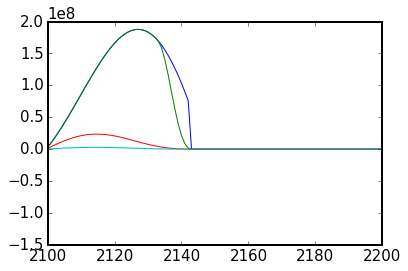

In [612]:
fname_bin = '4104obs_line10_t1.bin'
core = '4104obs_line10'

for ntaper in [0, 10, 100, 300]:
#     !cd {path_sgy} && sumute.sh {ntaper} *_t1.bin  #{fname_bin} && cp {core}_m.sgy  
    fname = path_sgy+'4104obs_line10_m_taper' + str(ntaper) + '.vtr'
#     Gather_Plot(fname)

    n1, n2, n3, g = Read_vtr(fname)

    plt.plot(g[0][0], label=ntaper)

plt.xlim(2100, 2200)
# plt.legend()    

#### RawSeis.txt

- just prepare - the rest is done by SegyPrep

In [112]:
# !ls "{path_sgy}"/*_m_taper20.sgy > {proj_name}-RawSeis.txt
!cat {proj_name}-RawSeis.txt

/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line10_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line11_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line22_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line23_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line26_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line27_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line28_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line30_m_taper20.sgy
/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_line31_m_taper20.sgy
/media/kmc3817/DATA

In [656]:
c = Read_File(proj_name + '-RawSeis.txt')
obses = []
for l in c:
    i = len('/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4')
    obs = l[0][i:i+3]
    obses.append(obs)

In [658]:
print len(set(obses))
print set(obses)

46
set(['179', '157', '158', '178', '115', '114', '117', '130', '137', '136', '113', '112', '177', '176', '139', '138', '160', '183', '181', '186', '162', '184', '185', '188', '163', '146', '147', '144', '145', '142', '140', '141', '108', '123', '124', '125', '128', '165', '166', '167', '106', '104', '105', '131', '109', '110'])


### SegyPrep

In [113]:
z_sea = 12.5
nx3 = 113
ttime_ms = 6e3 # 6s - 2400 time steps
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
Segyprep_Run(proj_name, z_sea, dx)

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj21-SegyPrep.key

segyprep.sh: START

Overwrite the TrueVp.vtr model? no

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj21
 Preparing files for synthetics...

 Grid points in-line:                   1201
 Grid points cross-line:                 401
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            60000.0000    
 Model width (metres):             20000.0000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          6000.00000    
 Output data length (samples):          2400
 Time steps to model:                   2

0

### Runfile

In [116]:
Runfile_Prepare(proj_name, machine, z_sea, ibfs=1, b_abs=10, e_abs=20)

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj21-Skeleton.key
lib_fwi_generic.py/Runfile_Prepare:  Contents of ./proj21-Runfile_synth.key:

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 6.0
! X. FREE SURFACE
ibfs : 1
seaLevel : 12.5
 maxGhostIter  : 2
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 46
NSHOTS : 46
NRECS : 5224
MAXRC : 3066
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 10
bleft : 10
bright : 10
bfront : 10
bback : 10
 extratop      : 0
extrabot : 20
extraleft : 20
extraright : 20
extrafront : 20
extraback : 20
! F. INVERSION PARAMATERS (copied from Jo!!!)
 Slowness               : yes
 Normalise              : yes
 Amplitud

0

### PBS file

In [5]:
# PBS_Script_Create(proj_name, problem='inv', code='rev688_test', q='mrwarn', hours=1, nnodes=1, nprocesses=2) # WORKED, TERMINATED AFTER 3603 s WITHOUT THE MESSAGE OF TIME EXCEEDED BUT THIS MUST HAVE BEEN THE CASE'
PBS_Script_Create(proj_name, problem='inv', code='rev688_test', q='mrwarn', hours=10, max_ram=2, nnodes=6, nprocesses=8)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj21

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj21
#PBS -o proj21-Out.log
#PBS -e proj21-Err.log
#PBS -l walltime=10:00:00
#PBS -l select=6:mpiprocs=8:ompthreads=5:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=5 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=2 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT 

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40 and mem_gb to 128


0

## Run

## Output

### Models

['/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output//proj21-CP00001-Vp.sgy', '/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output//proj21-CP00002-Vp.sgy', '/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output//proj21-CP00003-Vp.sgy', '/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output//proj21-CP00004-Vp.sgy']
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output//proj21-CP00004-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7480.16
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


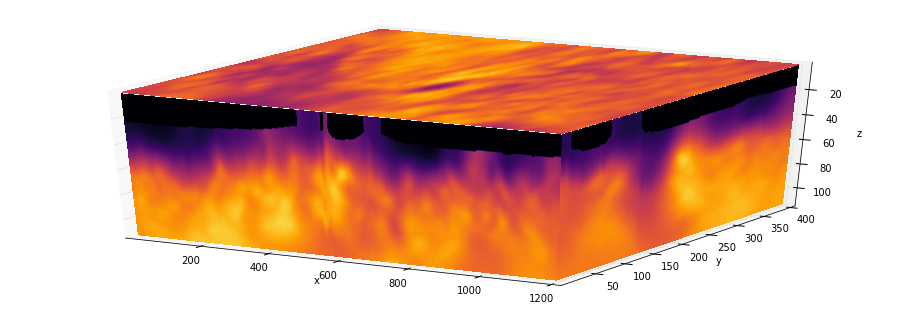

In [88]:
xcoord, ycoord, zcoord = nx1/2, nx2/2, nx3/2
fnames = Get_Files(proj_path+'../output/', proj_name+'-CP*sgy')
print fnames
for fname in [fnames[3]]:
    fname_vtr = fname[ :-(len('sgy'))] + 'vtr'
    Plot_Gridded_Data_From_File(fname_vtr, data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)
    break

# Proj 22 (like proj20 but b_abs=2, e_abs=0)

In [52]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj22'
# !cd "{proj_path}" && pwd

- needs a re-run of fsprep (NOT segyprep)

## Input

In [55]:
# !fwi_cp_project.sh -sf -cp proj20 {proj_name} .
!cp proj23-GhostData.bin {proj_name}-GhostData.bin

### Runfile

In [56]:
# !cp proj20-Skeleton.key {proj_name}-Skeleton.key
Runfile_Prepare(proj_name, machine, z_sea, b_abs=2, e_abs=0)

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj22-Skeleton.key
lib_fwi_generic.py/Runfile_Prepare:  Contents of ./proj22-Runfile_synth.key:

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 10.0
! X. FREE SURFACE
 ibfs          : 1
seaLevel : 12.5
 maxGhostIter  : 2
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 1
NSHOTS : 1
NRECS : 5401
MAXRC : 5401
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 2
bleft : 2
bright : 2
bfront : 2
bback : 2
 extratop      : 0
extrabot : 0
extraleft : 0
extraright : 0
extrafront : 0
extraback : 0
! F. INVERSION PARAMATERS (copied from Jo!!!)
 Slowness               : yes
 Normalise              : yes
 Amplitude

0

### PBS file

In [60]:
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', snap_step=0, q='mrwarn', hours=3, nnodes=1, nprocesses=2)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj22

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj22
#PBS -o proj22-Out.log
#PBS -e proj22-Err.log
#PBS -l walltime=03:00:00
#PBS -l select=1:mpiprocs=2:ompthreads=20:ncpus=40:mem=62gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=20 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJECT INFO
project_name=proj22

start=`date +%s`


#
# SYNTHETIC-RUN FLOW
#

# DELETE OBSERVED DATA, OTHERWISE SYNTH WOULD FAIL
rm $PBS_O_WORKDIR/../output/fw*vtr

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40


0

## Run

## Output

# Proj 23 (checkerboard 1km, 1%)

- check if the data from proj21 constrain the model sufficiently
- crashed - memory exceeded 120 Gb / node
    - only 3 nodes for 46 shots => 15 slaves per node
    - ghosts = 15 * 3 = 45 Gb
    - model = 15 * 0.3 Gb = 5 Gb
    - so where is this overhead??!!
    - maybe when passing to scheduler (peak value was 125 Gb)

In [91]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj23'
# !cd "{proj_path}" && pwd

## Input

In [683]:
# !fwi_cp_project.sh -is -cp proj21 {proj_name} .

### Model

In [16]:
!cp proj21-TrueVp.sgy {proj_name}-StartVp.sgy

In [8]:
# fname = proj_name + '-TrueVp.vtr'

# sizes_km = [1]
# sizes = (1000. / dx) * np.array(sizes_km)
# sizes = sizes.astype(int)
# # pads = []

# for size in sizes: 
#     size_list = size * np.ones(3).astype(int)
#     for ampl in [0.01]:
#         fname_new = fname[ :-len('.vtr')] + '_s' + str(size) + '_a' + str(ampl) + '.vtr'
#         print fname_new
#         Model_Modify_Add_Checker(fname, fname_new=fname_new, sizes=size_list, ampl=ampl, sparsity=1)
        
# !vtr2sgy.sh
# !cp fname_new[vtr]sgy truevpsgy

In [7]:
# Plot_Gridded_Data_From_File('proj23-TrueVp_s20_a0.01_chckr.vtr', data_type='model', cmap='seismic', plot_type='slice', slice_coord='z', coord_value=zcoord)#, cbar=0)

lib_fwi_generic.py/Read_vtr:  File:  proj23-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1502.23
lib_fwi_generic.py/Read_vtr: max value:  7285.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Cube:  slice_coord x
libplot_generic.py/Plot_Cube:  coord_value 600
libplot_generic.py/Plot_Cube:  slice_coord y
libplot_generic.py/Plot_Cube:  coord_value 200
libplot_generic.py/Plot_Cube:  slice_coord z
libplot_generic.py/Plot_Cube:  coord_value 56
libplot_generic.py/Plot_Cube:  face.shape (401, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 401)


/usr/local/lib/python2.7/dist-packages/numpy/ma/core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
/usr/local/lib/python2.7/dist-packages/numpy/ma/core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


0

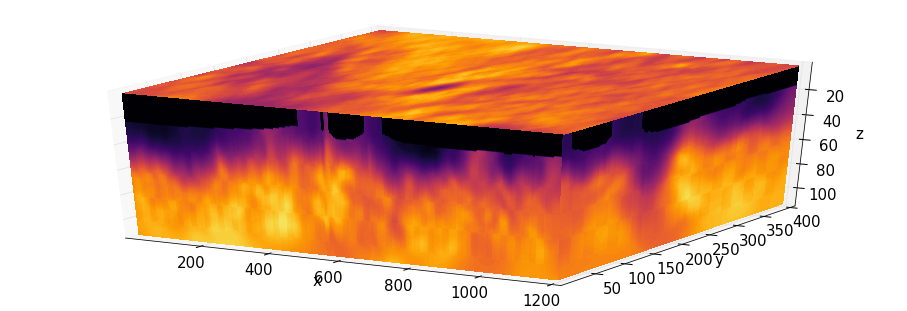

In [17]:
Plot_Gridded_Data_From_File('proj23-TrueVp.vtr', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

lib_fwi_generic.py/Read_vtr:  File:  proj23-TrueVp_s20_a0.01.vtr
lib_fwi_generic.py/Read_vtr: min value:  1502.23
lib_fwi_generic.py/Read_vtr: max value:  7285.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Cube:  slice_coord x
libplot_generic.py/Plot_Cube:  coord_value 600
libplot_generic.py/Plot_Cube:  slice_coord y
libplot_generic.py/Plot_Cube:  coord_value 200
libplot_generic.py/Plot_Cube:  slice_coord z
libplot_generic.py/Plot_Cube:  coord_value 56
libplot_generic.py/Plot_Cube:  face.shape (401, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 401)


0

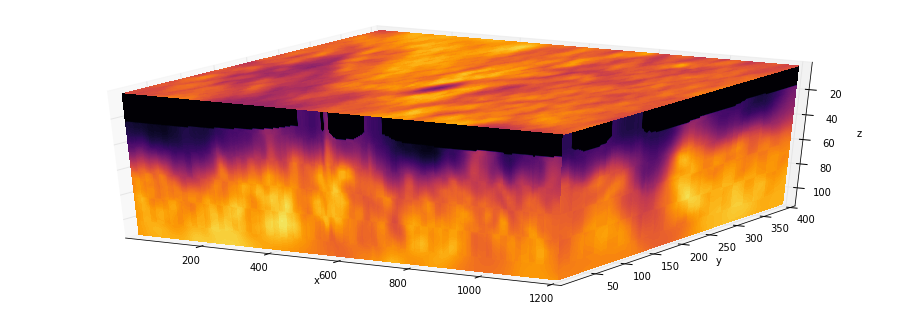

In [750]:
xcoord, ycoord, zcoord = nx1/2, nx2/2, nx3/2
Plot_Gridded_Data_From_File('proj23-TrueVp_s20_a0.01.vtr', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

lib_fwi_generic.py/Read_vtr:  File:  proj23-TrueVp_s20_a0.01_chckr.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.01
lib_fwi_generic.py/Read_vtr: max value:  0.01
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
libplot_generic.py/Plot_Cube:  slice_coord x
libplot_generic.py/Plot_Cube:  coord_value 600
libplot_generic.py/Plot_Cube:  slice_coord y
libplot_generic.py/Plot_Cube:  coord_value 200
libplot_generic.py/Plot_Cube:  slice_coord z
libplot_generic.py/Plot_Cube:  coord_value 56
libplot_generic.py/Plot_Cube:  face.shape (401, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 113)
libplot_generic.py/Plot_Cube:  face.shape (1201, 401)


0

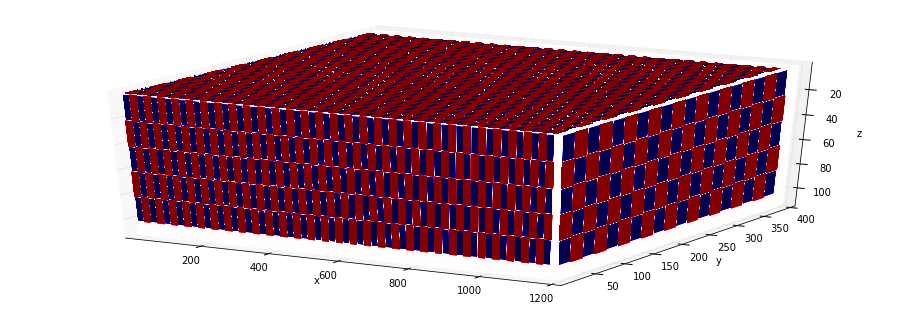

In [749]:
xcoord, ycoord, zcoord = nx1/2, nx2/2, nx3/2
Plot_Gridded_Data_From_File('proj23-TrueVp_s20_a0.01_chckr.vtr', cmap='seismic', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

### Source wavelet

In [29]:
!cp proj20-RawSign.sgy {proj_name}-RawSign.sgy # BECAUSE proj21 HAD NONE ('inv')

### Observed data

In [25]:
# !cp proj21-RawSeis.txt {proj_name}-RawSeis.txt
# !cat {proj_name}-RawSeis.txt

### SegyPrep

In [35]:
ttime_ms = 6e3
dt_ms = 2.5
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
Segyprep_Run(proj_name, z_sea, dx)

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj23-SegyPrep.key

segyprep.sh: START

Overwrite the TrueVp.vtr model? no

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj23
 Preparing files for synthetics...

 Grid points in-line:                   1201
 Grid points cross-line:                 401
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            60000.0000    
 Model width (metres):             20000.0000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          6000.00000    
 Output data length (samples):          2400
 Time steps to model:                   2

0

### Runfile

In [36]:
Runfile_Prepare(proj_name, machine, z_sea, b_abs=2, e_abs=0)

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj23-Skeleton.key
lib_fwi_generic.py/Runfile_Prepare:  Contents of ./proj23-Runfile_synth.key:

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 6.0
! X. FREE SURFACE
 ibfs          : 1
seaLevel : 12.5
 maxGhostIter  : 2
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 46
NSHOTS : 46
NRECS : 5224
MAXRC : 3066
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 2
bleft : 2
bright : 2
bfront : 2
bback : 2
 extratop      : 0
extrabot : 0
extraleft : 0
extraright : 0
extrafront : 0
extraback : 0
! F. INVERSION PARAMATERS (copied from Jo!!!)
 Slowness               : yes
 Normalise              : yes
 Amplitud

0

### PBS file

In [ ]:
# PBS_Script_Create(proj_name, problem='both', code='rev688_test', snap_step=0, hours=4, q='debug', nnodes=1, nprocesses=4, ncpus=8)
# PBS_Script_Create(proj_name, problem='both', code='rev688_test', snap_step=0, hours=50, q='mrwarn', node_type='mrwarn_new', nnodes=3, nprocesses=16)

After failed inversion (memory demand > requested):
- 62 Gb -> 120 Gb (Mike's script)
    - it didn't help => added env vars slaves_localstore...
- problem 'inv'

In [95]:
PBS_Script_Create(proj_name, problem='inv', code='rev688_test', snap_step=0, hours=40, q='mrwarn', node_type='mrwarn_new', nnodes=3, nprocesses=16)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj23

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj23
#PBS -o proj23-Out.log
#PBS -e proj23-Err.log
#PBS -l walltime=40:00:00
#PBS -l select=3:mpiprocs=16:ompthreads=3:ncpus=48:mem=128gb
#PBS -l place=scatter:excl

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=3 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=50 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/fullwave3D.exe
echo 'path to the code-executable: '${code_path}

# PROJEC

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 48 and mem_gb to 128


0

## Run

- job terminated just after synthetic run due to memory exceeded the limit (64 Gb / node).
    - PBS: job killed: mem 65033128kb exceeded limit 65011712kb
    - Job resource usage summary

                 Memory (GB)    NCPUs
 Requested  :       186           144
 
 Used       :        56 (peak)  33.19 (ave)

    - maybe too few nodes for these files? #PBS -l select=3:mpiprocs=16:ompthreads=3:ncpus=48:mem=62gb
    - if each rank has to allocate model, ghostdata and synthetic it might be the case!

## Output

# Proj 24 (Jo's data; synthetic picks)

- use Jo's files phase-comparisons to ensure correct filtering of data
    - offsets < 20 km
    - ttime = 6 s (CHANGED TO 5 s)

In [1]:
print'distance covered by a waterwave in 6 s:', 6 * 1.5,' km'
print'distance covered by a refracted arrival (3 km / s) in 6 s:', 6 * 3,' km'

distance covered by a waterwave in 6 s: 9.0  km
distance covered by a refracted arrival (3 km / s) in 6 s: 18  km


In [5]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj24'
# !cd "{proj_path}" && pwd

## Input

In [86]:
# !fwi_cp_project.sh -sp -cp proj20 {proj_name} .

### Observed data

In [6]:
path = "/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/"
# !cd {path} && su_supergather_split_key.sh ep ????obs.sgy
fnames = Get_Files(path, "????obs_*.sgy")

#### Add picks

In [25]:
picks_path = "/home/kmc3817/heavy_PhD/picks/OBS/first_arriv/UO/picks_synthetics_180105_110405/"

In [111]:
t_shift = -50 # ms PICKING ERROR 5-30 ms ACCORDING TO UO
split_picks = False # ALREADY SPLIT
for t_window in [500]: #, 1000, 1500]:#, 2000]: # UNIT: TIME-SAMPLES (D-Cs)
    Picks_Prepare_For_Data(fnames, picks_path, split_picks=split_picks, name_format='jm', t_shift=t_shift, t_window=t_window, verbos=100)

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_10.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_11.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_22.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_23.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_26.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_27.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_28.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_30.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_31.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_32.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_37.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_38.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_40.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_41.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4104obs_5.sgy
lib_fwi_picks.py/Picks_Pre

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_28.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_29.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_30.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_31.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_32.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_37.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_38.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_5.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_52.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_55.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_56.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_57.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_6.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_7.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4113obs_8.sgy
lib_fwi_picks.py/Picks_Prepar

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4125obs_7.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4125obs_8.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4125obs_9.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_16.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_17.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_18.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_19.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_20.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_21.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_24.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_25.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_28.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_29.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_30.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4128obs_31.sgy
lib_fwi_picks.py/Picks_Prepa

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4138obs_8.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4138obs_9.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_10.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_11.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_16.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_17.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_18.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_19.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_20.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_21.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_22.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_23.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_24.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_25.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4139obs_26.sgy
lib_fwi_picks.py/Picks_Prep

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_16.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_17.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_18.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_19.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_20.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_21.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_24.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_25.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_28.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_29.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_30.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_31.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_32.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_33.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4144obs_34.sgy
lib_fwi_picks.py/Picks_Pr

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_27.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_28.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_29.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_30.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_31.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_32.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_37.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_38.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_40.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_41.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_5.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_52.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_55.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_56.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4158obs_57.sgy
lib_fwi_picks.py/Picks_Pre

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4164obs_52.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4164obs_53.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4164obs_55.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4164obs_56.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4164obs_57.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4164obs_6.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_16.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_17.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_18.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_19.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_20.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_21.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_24.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_25.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4165obs_28.sgy
lib_fwi_picks.py/Picks_Pre

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_22.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_23.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_24.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_25.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_26.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_27.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_28.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_29.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_30.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_31.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_32.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_37.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_38.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_41.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4178obs_5.sgy
lib_fwi_picks.py/Picks_Pre

lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4184obs_5.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4184obs_52.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4184obs_53.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4184obs_55.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4184obs_56.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4184obs_6.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_16.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_17.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_18.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_19.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_20.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_21.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_24.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_25.sgy
lib_fwi_picks.py/Picks_Prepare_For_Data:  fname:  4185obs_29.sgy
lib_fwi_picks.py/Picks_Prep

In [112]:
!cd "{path}" && su_put_picks_into_headers.sh *t1.ascii


su_put_picks_into_headers.sh: START

File processed: 4104obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147149 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000109756 s, 29.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129093 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0806e-05 s, 52.6 MB/s
File processed: 4104obs_11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149218 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6562e-05 s, 41.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014444 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9684e-05 s, 53.6 MB/s
File processed: 4104obs_22.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014898 s, 2.1 MB/s
6+1 records in
1+0 records out
3

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143645 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8139e-05 s, 41.0 MB/s
File processed: 4105obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139046 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0667e-05 s, 39.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151744 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3646e-05 s, 50.3 MB/s
File processed: 4105obs_11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160575 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6165e-05 s, 48.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00150169 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7753e-05 s, 47.2 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149809 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9517e-05 s, 40.2 MB/s
File processed: 4105obs_57.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151927 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7277e-05 s, 47.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156483 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3337e-05 s, 43.6 MB/s
File processed: 4105obs_5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146825 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0339e-05 s, 45.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012742 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8867e-05 s, 54.4 MB/s
File proce

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.0223e-05 s, 35.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145453 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6345e-05 s, 48.2 MB/s
File processed: 4106obs_30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157704 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7018e-05 s, 47.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00261034 s, 1.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1398e-05 s, 39.3 MB/s
File processed: 4106obs_31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151909 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000159485 s, 20.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013109 s, 2.4 MB/s
6+1 reco

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116182 s, 27.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151098 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4931e-05 s, 42.7 MB/s
File processed: 4108obs_25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140123 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1498e-05 s, 44.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147032 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7993e-05 s, 47.1 MB/s
File processed: 4108obs_27.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130185 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8304e-05 s, 54.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134197 s, 2.4 MB/s
6+1 rec

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00107825 s, 3.0 MB/s
File processed: 4109obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0017107 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00013164 s, 24.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153251 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7912e-05 s, 47.1 MB/s
File processed: 4109obs_11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182507 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000120378 s, 26.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177541 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.4532e-05 s, 33.9 MB/s
File processed: 4109obs_22.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128638 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1636e-05 s, 51.9 MB/s
File processed: 4110obs_23.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137961 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7025e-05 s, 47.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145307 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.593e-05 s, 37.2 MB/s
File processed: 4110obs_26.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00165955 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5224e-05 s, 49.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141982 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116784 s, 27.4 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143242 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9165e-05 s, 54.1 MB/s
File processed: 4112obs_18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140964 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.166e-05 s, 44.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152286 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.871e-05 s, 46.6 MB/s
File processed: 4112obs_19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130664 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7572e-05 s, 55.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013862 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2675e-05 s, 38.7 MB/s
File proces

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8441e-05 s, 54.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014738 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7273e-05 s, 36.7 MB/s
File processed: 4112obs_5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145733 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8481e-05 s, 46.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126712 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6497e-05 s, 33.2 MB/s
File processed: 4112obs_6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136818 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3489e-05 s, 38.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130207 s, 2.5 MB/s
6+1 records

File processed: 4113obs_30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135705 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.794e-05 s, 55.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00166209 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0593e-05 s, 52.8 MB/s
File processed: 4113obs_31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00162217 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9536e-05 s, 46.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128113 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8699e-05 s, 54.5 MB/s
File processed: 4113obs_32.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00189631 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00168865 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7479e-05 s, 55.7 MB/s
File processed: 4114obs_22.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133685 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6316e-05 s, 41.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145222 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5757e-05 s, 57.4 MB/s
File processed: 4114obs_23.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147183 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4702e-05 s, 49.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136177 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1183e-05 s, 52.3 MB/s
File pro

File processed: 4114obs_8.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140119 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4058e-05 s, 43.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137739 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6692e-05 s, 41.7 MB/s
File processed: 4114obs_9.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137681 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8328e-05 s, 46.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163445 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000155034 s, 20.6 MB/s
File processed: 4115obs_16.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139919 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143248 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.186e-05 s, 34.8 MB/s
File processed: 4115obs_36.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134314 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3025e-05 s, 50.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014492 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.912e-05 s, 40.4 MB/s
File processed: 4115obs_37.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134202 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2414e-05 s, 51.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141623 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0651e-05 s, 45.3 MB/s
File proces

File processed: 4117obs_25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130545 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1838e-05 s, 51.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127465 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.3956e-05 s, 59.3 MB/s
File processed: 4117obs_29.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012804 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.3973e-05 s, 59.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126183 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8441e-05 s, 54.8 MB/s
File processed: 4117obs_30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130646 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137641 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6934e-05 s, 36.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135934 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3118e-05 s, 50.7 MB/s
File processed: 4123obs_31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132889 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7118e-05 s, 56.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137557 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6364e-05 s, 48.2 MB/s
File processed: 4123obs_37.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148021 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1607e-05 s, 39.2 MB/s
3200+0 r

File processed: 4124obs_28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148785 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1106e-05 s, 52.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132619 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5905e-05 s, 48.6 MB/s
File processed: 4124obs_30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001464 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5001e-05 s, 49.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147821 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2571e-05 s, 51.1 MB/s
File processed: 4124obs_31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146724 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.494e-05 s, 42.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146723 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8408e-05 s, 40.8 MB/s
File processed: 4125obs_19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141328 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6486e-05 s, 41.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141617 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4709e-05 s, 42.8 MB/s
File processed: 4125obs_20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143455 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1921e-05 s, 51.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146101 s, 2.2 MB/s
6+1 recor

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125882 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0233e-05 s, 53.1 MB/s
File processed: 4125obs_6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130051 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5874e-05 s, 48.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140248 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5425e-05 s, 57.7 MB/s
File processed: 4125obs_7.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130478 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.4366e-05 s, 33.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134147 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.489e-05 s, 58.3 MB/s
File proces

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014096 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.257e-05 s, 44.1 MB/s
File processed: 4128obs_37.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013928 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1122e-05 s, 52.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149732 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9617e-05 s, 40.2 MB/s
File processed: 4128obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00171383 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7831e-05 s, 47.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157104 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000114421 s, 28.0 MB/s
File proce

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7777e-05 s, 47.2 MB/s
File processed: 4130obs_35.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142163 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9371e-05 s, 32.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141393 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9361e-05 s, 40.3 MB/s
File processed: 4130obs_36.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152383 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000116557 s, 27.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149626 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8982e-05 s, 46.4 MB/s
File processed: 4130obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138629 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0428e-05 s, 53.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145344 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0411e-05 s, 53.0 MB/s
File processed: 4131obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00219668 s, 1.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7724e-05 s, 47.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161463 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000197562 s, 16.2 MB/s
File processed: 4131obs_53.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154215 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5939e-05 s, 42.1 MB/s
3200+0 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142415 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0576e-05 s, 45.3 MB/s
File processed: 4136obs_9.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143387 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9204e-05 s, 46.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139746 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4359e-05 s, 49.7 MB/s
File processed: 4137obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012598 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3214e-05 s, 50.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129347 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2351e-05 s, 51.3 MB/s
File proce

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2663e-05 s, 34.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147789 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2826e-05 s, 50.9 MB/s
File processed: 4138obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160992 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0999e-05 s, 45.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0019264 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6922e-05 s, 47.8 MB/s
File processed: 4138obs_11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142001 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3866e-05 s, 50.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148106 s, 2.2 MB/s
6+1 recor

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000124718 s, 25.7 MB/s
File processed: 4138obs_56.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129361 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8068e-05 s, 55.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001445 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1914e-05 s, 44.5 MB/s
File processed: 4138obs_57.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00166789 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000218458 s, 14.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136385 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.3348e-05 s, 60.0 MB/s
File processed: 4138obs_5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000166474 s, 19.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145632 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3722e-05 s, 50.2 MB/s
File processed: 4139obs_28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149654 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.958e-05 s, 46.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00154184 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6394e-05 s, 41.9 MB/s
File processed: 4139obs_29.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148898 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9685e-05 s, 53.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148812 s, 2.2 MB/s
6+1 reco

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136049 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2125e-05 s, 34.7 MB/s
File processed: 4140obs_19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147446 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0037e-05 s, 53.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00184287 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0455e-05 s, 45.4 MB/s
File processed: 4140obs_20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00172271 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1959e-05 s, 39.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137789 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6314e-05 s, 56.8 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144019 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6579e-05 s, 48.1 MB/s
File processed: 4140obs_5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0018407 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2483e-05 s, 51.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138314 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4105e-05 s, 59.1 MB/s
File processed: 4140obs_6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151524 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7815e-05 s, 55.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126833 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5894e-05 s, 57.3 MB/s
File proces

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144126 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2067e-05 s, 51.6 MB/s
File processed: 4141obs_30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140129 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9594e-05 s, 53.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146345 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3698e-05 s, 34.2 MB/s
File processed: 4141obs_31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143216 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4075e-05 s, 59.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141447 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9184e-05 s, 54.1 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00189814 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7386e-05 s, 47.5 MB/s
File processed: 4142obs_18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129148 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.2524e-05 s, 60.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130731 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8137e-05 s, 55.0 MB/s
File processed: 4142obs_19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129899 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.0759e-05 s, 63.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00229007 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.512e-05 s, 49.1 MB/s
File proc

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139362 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2326e-05 s, 44.2 MB/s
File processed: 4142obs_53.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138015 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5524e-05 s, 48.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140606 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9976e-05 s, 45.7 MB/s
File processed: 4142obs_55.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144693 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3152e-05 s, 38.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125642 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.1974e-05 s, 61.6 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130092 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5094e-05 s, 33.7 MB/s
File processed: 4144obs_32.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149659 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7804e-05 s, 55.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014186 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1429e-05 s, 39.3 MB/s
File processed: 4144obs_33.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140091 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4677e-05 s, 49.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141017 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3887e-05 s, 50.1 MB/s
File proc

File processed: 4145obs_24.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141101 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3846e-05 s, 50.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138251 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000459547 s, 7.0 MB/s
File processed: 4145obs_25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138785 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2597e-05 s, 44.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00158753 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2903e-05 s, 43.9 MB/s
File processed: 4145obs_28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127221 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6

File processed: 4146obs_19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125829 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6912e-05 s, 56.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129216 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1497e-05 s, 52.0 MB/s
File processed: 4146obs_20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127675 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6405e-05 s, 48.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126066 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5768e-05 s, 57.4 MB/s
File processed: 4146obs_21.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130878 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6

File processed: 4147obs_19.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130837 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0153e-05 s, 53.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012655 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1181e-05 s, 39.4 MB/s
File processed: 4147obs_20.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125084 s, 2.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.4549e-05 s, 33.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126787 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5085e-05 s, 58.1 MB/s
File processed: 4147obs_21.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138291 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134149 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6285e-05 s, 48.3 MB/s
File processed: 4157obs_23.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126291 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5124e-05 s, 49.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125878 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.512e-05 s, 42.6 MB/s
File processed: 4157obs_26.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134971 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4916e-05 s, 49.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144762 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9369e-05 s, 46.1 MB/s
File proc

File processed: 4158obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129514 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1365e-05 s, 44.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132607 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1055e-05 s, 39.5 MB/s
File processed: 4158obs_11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00156605 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1378e-05 s, 39.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00164807 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4997e-05 s, 42.7 MB/s
File processed: 4158obs_16.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167287 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00245918 s, 1.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3036e-05 s, 50.8 MB/s
File processed: 4158obs_41.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138205 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0493e-05 s, 52.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145678 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9988e-05 s, 53.3 MB/s
File processed: 4158obs_52.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149386 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8724e-05 s, 54.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133627 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8963e-05 s, 54.3 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126343 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5345e-05 s, 42.5 MB/s
File processed: 4160obs_25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128771 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8238e-05 s, 54.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136485 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.095e-05 s, 52.5 MB/s
File processed: 4160obs_26.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013371 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6117e-05 s, 57.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146019 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6624e-05 s, 48.0 MB/s
File proce

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163335 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000150375 s, 21.3 MB/s
File processed: 4162obs_17.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167665 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.5929e-05 s, 33.4 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182186 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000113783 s, 28.1 MB/s
File processed: 4162obs_18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00190902 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000178196 s, 18.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00188707 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1164e-05 s, 45.0 MB/s
File 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130621 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.04e-05 s, 63.5 MB/s
File processed: 4162obs_52.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129657 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00010219 s, 31.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014319 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1623e-05 s, 44.7 MB/s
File processed: 4162obs_53.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143869 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.214e-05 s, 39.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136472 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2441e-05 s, 51.2 MB/s
File process

File processed: 4163obs_30.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00205414 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000176846 s, 18.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00189004 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000114498 s, 27.9 MB/s
File processed: 4163obs_31.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182112 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000123252 s, 26.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00179811 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4961e-05 s, 42.7 MB/s
File processed: 4163obs_32.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00236804 s, 1.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136965 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.32e-05 s, 38.5 MB/s
File processed: 4164obs_21.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127813 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9855e-05 s, 53.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138362 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8176e-05 s, 55.0 MB/s
File processed: 4164obs_24.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127639 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6546e-05 s, 48.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136924 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4199e-05 s, 49.8 MB/s
File proce

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134105 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000182084 s, 17.6 MB/s
File processed: 4165obs_16.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138109 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4138e-05 s, 59.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135271 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.054e-05 s, 52.9 MB/s
File processed: 4165obs_17.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130509 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0349e-05 s, 45.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128169 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.345e-05 s, 50.4 MB/s
File proc

File processed: 4165obs_55.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00136455 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3764e-05 s, 50.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014345 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2285e-05 s, 44.3 MB/s
File processed: 4165obs_56.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139121 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8362e-05 s, 46.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144314 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6844e-05 s, 36.8 MB/s
File processed: 4165obs_5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147863 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7571e-05 s, 47.4 MB/s
File processed: 4166obs_53.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141379 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1034e-05 s, 45.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142905 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3601e-05 s, 43.5 MB/s
File processed: 4166obs_55.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141392 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6202e-05 s, 48.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014211 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1469e-05 s, 52.1 MB/s
File processed: 4166obs_56.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00163316 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000101058 s, 31.7 MB/s
File processed: 4167obs_52.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139113 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5621e-05 s, 48.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146849 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6729e-05 s, 41.7 MB/s
File processed: 4167obs_53.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00168075 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.173e-05 s, 39.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131712 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.284e-05 s, 50.9 MB/s
File proc

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145452 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0045e-05 s, 53.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012734 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2796e-05 s, 51.0 MB/s
File processed: 4176obs_6.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138164 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0592e-05 s, 45.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129184 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6146e-05 s, 57.0 MB/s
File processed: 4176obs_7.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126294 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8811e-05 s, 40.6 MB/s
3200+0 reco

File processed: 4177obs_40.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014165 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.347e-05 s, 43.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127746 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.446e-05 s, 49.6 MB/s
File processed: 4177obs_41.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138149 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4481e-05 s, 49.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013742 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.558e-05 s, 42.3 MB/s
File processed: 4177obs_52.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00138471 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7763

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149373 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9023e-05 s, 32.3 MB/s
File processed: 4178obs_24.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153083 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5341e-05 s, 42.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149562 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1462e-05 s, 44.8 MB/s
File processed: 4178obs_25.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00172767 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000103291 s, 31.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00176209 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0145e-05 s, 39.9 MB/s
File pr

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.791e-05 s, 55.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149108 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9692e-05 s, 45.9 MB/s
File processed: 4179obs_10.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134021 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8353e-05 s, 46.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137568 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000104761 s, 30.5 MB/s
File processed: 4179obs_11.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152391 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.596e-05 s, 57.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00168049 s, 1.9 MB/s
6+1 recor

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148318 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9155e-05 s, 46.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001463 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0981e-05 s, 52.5 MB/s
File processed: 4179obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182648 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4419e-05 s, 49.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142235 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000101688 s, 31.5 MB/s
File processed: 4179obs_52.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125467 s, 2.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.386e-05 s, 50.1 MB/s
3200+0 rec

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148142 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2961e-05 s, 43.9 MB/s
File processed: 4181obs_27.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151454 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5595e-05 s, 48.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133344 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9253e-05 s, 40.4 MB/s
File processed: 4181obs_28.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152972 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151975 s, 21.1 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014349 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3632e-05 s, 50.3 MB/s
File pro

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141558 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8779e-05 s, 54.4 MB/s
File processed: 4183obs_17.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144086 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5787e-05 s, 42.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142347 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8079e-05 s, 55.1 MB/s
File processed: 4183obs_18.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140097 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.7275e-05 s, 36.7 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128007 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0934e-05 s, 52.5 MB/s
File pro

File processed: 4183obs_56.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00149935 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000124184 s, 25.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145383 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.1074e-05 s, 35.1 MB/s
File processed: 4183obs_57.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014853 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6983e-05 s, 41.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153658 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3921e-05 s, 38.1 MB/s
File processed: 4183obs_5.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151791 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00155734 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000113057 s, 28.3 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00203379 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5342e-05 s, 49.0 MB/s
File processed: 4184obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145612 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000107109 s, 29.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148492 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.461e-05 s, 49.5 MB/s
File processed: 4184obs_52.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151291 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000106449 s, 30.1 MB/s
3200+0

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014084 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000151382 s, 21.1 MB/s
File processed: 4185obs_36.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142844 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000109696 s, 29.2 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00162101 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1926e-05 s, 44.5 MB/s
File processed: 4185obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00180273 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6362e-05 s, 41.9 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00178732 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000111117 s, 28.8 MB/s
File p

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00167964 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0345e-05 s, 45.5 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00187742 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8432e-05 s, 46.8 MB/s
File processed: 4186obs_36.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157711 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9963e-05 s, 40.0 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00161657 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000104186 s, 30.7 MB/s
File processed: 4186obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00190224 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5918e-05 s, 42.2 MB/s
3200+0 

File processed: 4188obs_36.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00170541 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8196e-05 s, 32.6 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0017009 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5942e-05 s, 42.1 MB/s
File processed: 4188obs_38.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177866 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4703e-05 s, 42.8 MB/s
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153229 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8551e-05 s, 40.7 MB/s
File processed: 4188obs_53.sgy
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153459 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.

In [604]:
# fname_vtr = '4137obs_line8_m_taper20.vtr'
# fname = path_sgy + fname_vtr

# a = 0.1
# Gather_Plot(fname, minn=-a, maxx=a)
# Picks_Plot(fname) # REMEMBER THEY ARE LIFTED 200 ms UP

#### Mute

In [614]:
# !sumute

In [613]:
# !sutaper

In [114]:
ntaper = int(abs(t_shift) / dt_ms)
print ntaper
!cd {path} && sumute.sh {ntaper} *_t1.bin

20

sumute.sh: START

Input file:  4104obs_10.sgy
Output file: 4104obs_10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160919 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.8395e-05 s, 32.5 MB/s
Input file:  4104obs_11.sgy
Output file: 4104obs_11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00197636 s, 1.6 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5526e-05 s, 37.4 MB/s
Input file:  4104obs_22.sgy
Output file: 4104obs_22_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177402 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.5206e-05 s, 37.6 MB/s
Input file:  4104obs_23.sgy
Output file: 4104obs_23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes

Input file:  4105obs_27.sgy
Output file: 4105obs_27_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135626 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1198e-05 s, 52.3 MB/s
Input file:  4105obs_28.sgy
Output file: 4105obs_28_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133359 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4645e-05 s, 49.5 MB/s
Input file:  4105obs_30.sgy
Output file: 4105obs_30_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125627 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5549e-05 s, 57.6 MB/s
Input file:  4105obs_31.sgy
Output file: 4105obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145171 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2348e-05 s, 34.7 MB/s
Input file:  4106obs_29.sgy
Output file: 4106obs_29_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0015147 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4144e-05 s, 43.2 MB/s
Input file:  4106obs_30.sgy
Output file: 4106obs_30_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146978 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000104994 s, 30.5 MB/s
Input file:  4106obs_31.sgy
Output file: 4106obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146528 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

Input file:  4108obs_33.sgy
Output file: 4108obs_33_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142717 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3222e-05 s, 50.6 MB/s
Input file:  4108obs_34.sgy
Output file: 4108obs_34_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146422 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3896e-05 s, 38.1 MB/s
Input file:  4108obs_35.sgy
Output file: 4108obs_35_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145752 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8324e-05 s, 46.8 MB/s
Input file:  4108obs_36.sgy
Output file: 4108obs_36_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

Input file:  4110obs_10.sgy
Output file: 4110obs_10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00182765 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4507e-05 s, 42.9 MB/s
Input file:  4110obs_11.sgy
Output file: 4110obs_11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0018645 s, 1.7 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.63e-05 s, 37.1 MB/s
Input file:  4110obs_18.sgy
Output file: 4110obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0017424 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4935e-05 s, 42.7 MB/s
Input file:  4110obs_22.sgy
Output file: 4110obs_22_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

Input file:  4112obs_23.sgy
Output file: 4112obs_23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00178565 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000108096 s, 29.6 MB/s
Input file:  4112obs_24.sgy
Output file: 4112obs_24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00180825 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3361e-05 s, 34.3 MB/s
Input file:  4112obs_25.sgy
Output file: 4112obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00177711 s, 1.8 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.3379e-05 s, 34.3 MB/s
Input file:  4112obs_26.sgy
Output file: 4112obs_26_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) co

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00148202 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.6229e-05 s, 48.3 MB/s
Input file:  4113obs_24.sgy
Output file: 4113obs_24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142676 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.9601e-05 s, 35.7 MB/s
Input file:  4113obs_25.sgy
Output file: 4113obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00155518 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9651e-05 s, 40.2 MB/s
Input file:  4113obs_26.sgy
Output file: 4113obs_26_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00160864 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3599e-05 s, 38.3 MB/s
Input file:  4114obs_23.sgy
Output file: 4114obs_23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144709 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4381e-05 s, 43.0 MB/s
Input file:  4114obs_24.sgy
Output file: 4114obs_24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145966 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.234e-05 s, 51.3 MB/s
Input file:  4114obs_25.sgy
Output file: 4114obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143821 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1231e-05 s, 52.3 MB/s
Input file:  4114obs_26.sgy
Output file: 4114obs_26_m_taper20.sgy
No.

Input file:  4115obs_26.sgy
Output file: 4115obs_26_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133919 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.2565e-05 s, 38.8 MB/s
Input file:  4115obs_27.sgy
Output file: 4115obs_27_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143826 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.4712e-05 s, 37.8 MB/s
Input file:  4115obs_28.sgy
Output file: 4115obs_28_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144806 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8504e-05 s, 40.8 MB/s
Input file:  4115obs_29.sgy
Output file: 4115obs_29_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

Input file:  4117obs_25.sgy
Output file: 4117obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0015256 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4139e-05 s, 59.1 MB/s
Input file:  4117obs_29.sgy
Output file: 4117obs_29_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012989 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5671e-05 s, 48.7 MB/s
Input file:  4117obs_30.sgy
Output file: 4117obs_30_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129579 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.3444e-05 s, 59.9 MB/s
Input file:  4117obs_31.sgy
Output file: 4117obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131143 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9812e-05 s, 53.5 MB/s
Input file:  4123obs_8.sgy
Output file: 4123obs_8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139166 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.5792e-05 s, 42.2 MB/s
Input file:  4123obs_9.sgy
Output file: 4123obs_9_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143392 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9788e-05 s, 53.5 MB/s
Input file:  4124obs_10.sgy
Output file: 4124obs_10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132587 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126213 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9193e-05 s, 54.1 MB/s
Input file:  4125obs_18.sgy
Output file: 4125obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134439 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5968e-05 s, 48.5 MB/s
Input file:  4125obs_19.sgy
Output file: 4125obs_19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140245 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.815e-05 s, 55.0 MB/s
Input file:  4125obs_20.sgy
Output file: 4125obs_20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133016 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128519 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.9905e-05 s, 32.0 MB/s
Input file:  4128obs_21.sgy
Output file: 4128obs_21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147061 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8863e-05 s, 46.5 MB/s
Input file:  4128obs_24.sgy
Output file: 4128obs_24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132946 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0109e-05 s, 39.9 MB/s
Input file:  4128obs_25.sgy
Output file: 4128obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135848 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

Input file:  4130obs_31.sgy
Output file: 4130obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013254 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0624e-05 s, 52.8 MB/s
Input file:  4130obs_33.sgy
Output file: 4130obs_33_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125863 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7495e-05 s, 55.7 MB/s
Input file:  4130obs_34.sgy
Output file: 4130obs_34_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00143783 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7288e-05 s, 55.9 MB/s
Input file:  4130obs_35.sgy
Output file: 4130obs_35_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copi

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132805 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.2295e-05 s, 34.7 MB/s
Input file:  4136obs_22.sgy
Output file: 4136obs_22_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135187 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1532e-05 s, 52.0 MB/s
Input file:  4136obs_23.sgy
Output file: 4136obs_23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132798 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7161e-05 s, 47.6 MB/s
Input file:  4136obs_26.sgy
Output file: 4136obs_26_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.001326 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

Input file:  4137obs_6.sgy
Output file: 4137obs_6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129703 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8548e-05 s, 54.7 MB/s
Input file:  4137obs_7.sgy
Output file: 4137obs_7_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137952 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.49e-05 s, 37.7 MB/s
Input file:  4137obs_8.sgy
Output file: 4137obs_8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00157593 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.835e-05 s, 40.8 MB/s
Input file:  4137obs_9.sgy
Output file: 4137obs_9_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012

Input file:  4139obs_11.sgy
Output file: 4139obs_11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153777 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8854e-05 s, 46.5 MB/s
Input file:  4139obs_16.sgy
Output file: 4139obs_16_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135777 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5757e-05 s, 48.7 MB/s
Input file:  4139obs_17.sgy
Output file: 4139obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140806 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8366e-05 s, 46.8 MB/s
Input file:  4139obs_18.sgy
Output file: 4139obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.3258e-05 s, 43.7 MB/s
Input file:  4140obs_16.sgy
Output file: 4140obs_16_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135242 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.386e-05 s, 34.1 MB/s
Input file:  4140obs_17.sgy
Output file: 4140obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145593 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.0677e-05 s, 39.7 MB/s
Input file:  4140obs_18.sgy
Output file: 4140obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013711 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4626e-05 s, 58.6 MB/s
Input file:  4140obs_19.sgy
Output file: 4140obs_19_m_taper20.sgy
No. 

Input file:  4141obs_17.sgy
Output file: 4141obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014656 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9395e-05 s, 40.3 MB/s
Input file:  4141obs_18.sgy
Output file: 4141obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014299 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.2149e-05 s, 44.4 MB/s
Input file:  4141obs_19.sgy
Output file: 4141obs_19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012748 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.4178e-05 s, 59.1 MB/s
Input file:  4141obs_20.sgy
Output file: 4141obs_20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

Input file:  4141obs_8.sgy
Output file: 4141obs_8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012695 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5926e-05 s, 57.2 MB/s
Input file:  4141obs_9.sgy
Output file: 4141obs_9_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126645 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000106458 s, 30.1 MB/s
Input file:  4142obs_16.sgy
Output file: 4142obs_16_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128365 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2283e-05 s, 51.4 MB/s
Input file:  4142obs_17.sgy
Output file: 4142obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

Input file:  4142obs_6.sgy
Output file: 4142obs_6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139273 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9877e-05 s, 45.8 MB/s
Input file:  4142obs_7.sgy
Output file: 4142obs_7_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134268 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.905e-05 s, 46.3 MB/s
Input file:  4142obs_8.sgy
Output file: 4142obs_8_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129629 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8903e-05 s, 54.3 MB/s
Input file:  4142obs_9.sgy
Output file: 4142obs_9_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6221e-05 s, 56.9 MB/s
Input file:  4145obs_18.sgy
Output file: 4145obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142535 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0986e-05 s, 45.1 MB/s
Input file:  4145obs_19.sgy
Output file: 4145obs_19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135335 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3709e-05 s, 50.2 MB/s
Input file:  4145obs_20.sgy
Output file: 4145obs_20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130664 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.7483e-05 s, 32.8 MB/s
Input file:  4145obs_21.sgy
Output file: 4145obs_21_m_taper20.sgy
No

Input file:  4146obs_29.sgy
Output file: 4146obs_29_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139711 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8611e-05 s, 46.6 MB/s
Input file:  4146obs_30.sgy
Output file: 4146obs_30_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140725 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3731e-05 s, 50.2 MB/s
Input file:  4146obs_31.sgy
Output file: 4146obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130078 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6681e-05 s, 56.5 MB/s
Input file:  4146obs_33.sgy
Output file: 4146obs_33_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

Input file:  4147obs_6.sgy
Output file: 4147obs_6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139928 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.6263e-05 s, 33.2 MB/s
Input file:  4157obs_10.sgy
Output file: 4157obs_10_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00150222 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6498e-05 s, 56.6 MB/s
Input file:  4157obs_11.sgy
Output file: 4157obs_11_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127209 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0545e-05 s, 52.9 MB/s
Input file:  4157obs_17.sgy
Output file: 4157obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131083 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.87e-05 s, 54.5 MB/s
Input file:  4158obs_17.sgy
Output file: 4158obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139337 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.6746e-05 s, 36.9 MB/s
Input file:  4158obs_18.sgy
Output file: 4158obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133089 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.3525e-05 s, 59.8 MB/s
Input file:  4158obs_20.sgy
Output file: 4158obs_20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131482 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00152235 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4957e-05 s, 49.3 MB/s
Input file:  4160obs_17.sgy
Output file: 4160obs_17_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00145812 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1194e-05 s, 52.3 MB/s
Input file:  4160obs_18.sgy
Output file: 4160obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00141515 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.3273e-05 s, 38.4 MB/s
Input file:  4160obs_19.sgy
Output file: 4160obs_19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137282 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131745 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7318e-05 s, 55.8 MB/s
Input file:  4162obs_19.sgy
Output file: 4162obs_19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013078 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7289e-05 s, 47.6 MB/s
Input file:  4162obs_20.sgy
Output file: 4162obs_20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0012721 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.427e-05 s, 59.0 MB/s
Input file:  4162obs_21.sgy
Output file: 4162obs_21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132619 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5

Input file:  4163obs_18.sgy
Output file: 4163obs_18_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014032 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.4691e-05 s, 49.5 MB/s
Input file:  4163obs_19.sgy
Output file: 4163obs_19_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128002 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2436e-05 s, 51.3 MB/s
Input file:  4163obs_20.sgy
Output file: 4163obs_20_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00133723 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.263e-05 s, 44.1 MB/s
Input file:  4163obs_21.sgy
Output file: 4163obs_21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copie

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.9747e-05 s, 53.6 MB/s
Input file:  4164obs_24.sgy
Output file: 4164obs_24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00169007 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.8382e-05 s, 54.8 MB/s
Input file:  4164obs_25.sgy
Output file: 4164obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128089 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0828e-05 s, 52.6 MB/s
Input file:  4164obs_28.sgy
Output file: 4164obs_28_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127983 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9815e-05 s, 45.8 MB/s
Input file:  4164obs_29.sgy
Output file: 4164obs_29_m_taper20.sgy
No

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127196 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.1975e-05 s, 51.6 MB/s
Input file:  4165obs_32.sgy
Output file: 4165obs_32_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140315 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.8437e-05 s, 46.8 MB/s
Input file:  4165obs_33.sgy
Output file: 4165obs_33_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00128905 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2602e-05 s, 51.1 MB/s
Input file:  4165obs_34.sgy
Output file: 4165obs_34_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0014352 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

Input file:  4166obs_52.sgy
Output file: 4166obs_52_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00139103 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.6756e-05 s, 41.7 MB/s
Input file:  4166obs_53.sgy
Output file: 4166obs_53_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00140095 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.0809e-05 s, 52.6 MB/s
Input file:  4166obs_55.sgy
Output file: 4166obs_55_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00142122 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9788e-05 s, 40.1 MB/s
Input file:  4166obs_56.sgy
Output file: 4166obs_56_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

Input file:  4176obs_23.sgy
Output file: 4176obs_23_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00155205 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000131048 s, 24.4 MB/s
Input file:  4176obs_26.sgy
Output file: 4176obs_26_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131386 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1426e-05 s, 44.8 MB/s
Input file:  4176obs_27.sgy
Output file: 4176obs_27_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126389 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.2064e-05 s, 61.5 MB/s
Input file:  4176obs_28.sgy
Output file: 4176obs_28_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) co

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.7541e-05 s, 41.3 MB/s
Input file:  4177obs_38.sgy
Output file: 4177obs_38_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00169182 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9743e-05 s, 45.9 MB/s
Input file:  4177obs_40.sgy
Output file: 4177obs_40_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130144 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5313e-05 s, 49.0 MB/s
Input file:  4177obs_41.sgy
Output file: 4177obs_41_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00131356 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.1132e-05 s, 39.4 MB/s
Input file:  4177obs_52.sgy
Output file: 4177obs_52_m_taper20.sgy
No

Input file:  4178obs_31.sgy
Output file: 4178obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00144509 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.0603e-05 s, 45.3 MB/s
Input file:  4178obs_32.sgy
Output file: 4178obs_32_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127261 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5458e-05 s, 57.7 MB/s
Input file:  4178obs_37.sgy
Output file: 4178obs_37_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00132029 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 8.8083e-05 s, 36.3 MB/s
Input file:  4178obs_38.sgy
Output file: 4178obs_38_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

Input file:  4179obs_31.sgy
Output file: 4179obs_31_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00150837 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.3063e-05 s, 50.7 MB/s
Input file:  4179obs_32.sgy
Output file: 4179obs_32_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00147252 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.7181e-05 s, 56.0 MB/s
Input file:  4179obs_33.sgy
Output file: 4179obs_33_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00135908 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.5152e-05 s, 49.1 MB/s
Input file:  4179obs_37.sgy
Output file: 4179obs_37_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) cop

6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000108014 s, 29.6 MB/s
Input file:  4181obs_35.sgy
Output file: 4181obs_35_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00153071 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000104488 s, 30.6 MB/s
Input file:  4181obs_36.sgy
Output file: 4181obs_36_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00151717 s, 2.1 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.9822e-05 s, 40.1 MB/s
Input file:  4181obs_37.sgy
Output file: 4181obs_37_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00162574 s, 2.0 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.8986e-05 s, 40.5 MB/s
Input file:  4181obs_38.sgy
Output file: 4181obs_38_m_taper20.sgy


3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013738 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.2978e-05 s, 50.8 MB/s
Input file:  4183obs_38.sgy
Output file: 4183obs_38_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.0013382 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.000109837 s, 29.1 MB/s
Input file:  4183obs_52.sgy
Output file: 4183obs_52_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00146816 s, 2.2 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.6876e-05 s, 56.3 MB/s
Input file:  4183obs_53.sgy
Output file: 4183obs_53_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137845 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

Input file:  4184obs_55.sgy
Output file: 4184obs_55_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134548 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.696e-05 s, 47.8 MB/s
Input file:  4184obs_56.sgy
Output file: 4184obs_56_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00137254 s, 2.3 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.4998e-05 s, 42.7 MB/s
Input file:  4184obs_5.sgy
Output file: 4184obs_5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134187 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 7.1856e-05 s, 44.5 MB/s
Input file:  4184obs_6.sgy
Output file: 4184obs_6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00127768 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.7069e-05 s, 47.7 MB/s
Input file:  4186obs_21.sgy
Output file: 4186obs_21_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00125664 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.222e-05 s, 61.3 MB/s
Input file:  4186obs_24.sgy
Output file: 4186obs_24_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00134472 s, 2.4 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 5.5027e-05 s, 58.2 MB/s
Input file:  4186obs_25.sgy
Output file: 4186obs_25_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00130004 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied,

Input file:  4188obs_5.sgy
Output file: 4188obs_5_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00126019 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9977e-05 s, 45.7 MB/s
Input file:  4188obs_6.sgy
Output file: 4188obs_6_m_taper20.sgy
No. of samples of taper: 20
3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00129164 s, 2.5 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 6.9256e-05 s, 46.2 MB/s

sumute.sh: END
Runtime of the sumute.sh: 22 s


##### Plot

In [120]:
fnames = Get_Files(path, '*m_taper20.sgy')
print len(fnames)

for i, fname in enumerate(fnames):
    cor = fname[ :-len('.sgy')]
    fname_vtr = cor + '.vtr'
    Plot_Gather(fname_vtr, norm='none', verbos=0)
    plt.savefig(cor + '.png')
    plt.close()

1199
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.68904e+09
lib_fwi_generic.py/Read_vtr: max value:  1.49514e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55638e+09
lib_fwi_generic.py/Read_vtr: max value:  1.35242e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  118 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4104obs_22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13927e+08
lib_fwi_generic.py/Read_vtr: max value:  1.29118e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECT

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1680.45
lib_fwi_generic.py/Read_vtr: max value:  2200.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4154.42
lib_fwi_generic.py/Read_vtr: max value:  4721.39
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4105obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10132.5
lib_fwi_generic.py/Read_vtr: max value:  6965.47
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compar

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.32629e+09
lib_fwi_generic.py/Read_vtr: max value:  1.38297e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.05152e+07
lib_fwi_generic.py/Read_vtr: max value:  2.27493e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.65734e+07
lib_fwi_generic.py/Read_vtr: max value:  1.04806e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4106obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03259e+08
lib_fwi_generic.py/Read_vtr: max value:  9.7383e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compa

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -552097.0
lib_fwi_generic.py/Read_vtr: max value:  254814.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108obs_32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1598.8
lib_fwi_generic.py/Read_vtr: max value:  2177.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4108o

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.46344e+08
lib_fwi_generic.py/Read_vtr: max value:  2.31212e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4109obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.65656e+08
lib_fwi_generic.py/Read_vtr: max value:  5.54786e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-co

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9536.05
lib_fwi_generic.py/Read_vtr: max value:  11444.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -101390.0
lib_fwi_generic.py/Read_vtr: max value:  63205.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4110

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.4448e+09
lib_fwi_generic.py/Read_vtr: max value:  1.32027e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.43924e+08
lib_fwi_generic.py/Read_vtr: max value:  1.18222e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compa

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.06928e+08
lib_fwi_generic.py/Read_vtr: max value:  3.33856e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4112obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.42345e+07
lib_fwi_generic.py/Read_vtr: max value:  1.69615e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.46121e+07
lib_fwi_generic.py/Read_vtr: max value:  1.74328e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4113obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22599e+08
lib_fwi_generic.py/Read_vtr: max value:  1.13333e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.63611e+10
lib_fwi_generic.py/Read_vtr: max value:  1.25472e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.88619e+09
lib_fwi_generic.py/Read_vtr: max value:  2.25764e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.20365e+08
lib_fwi_generic.py/Read_vtr: max value:  2.83441e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  142 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4114obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.59366e+08
lib_fwi_generic.py/Read_vtr: max value:  2.08382e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  233 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-co

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10340.9
lib_fwi_generic.py/Read_vtr: max value:  8504.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1147.43
lib_fwi_generic.py/Read_vtr: max value:  1054.53
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115ob

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70105.6
lib_fwi_generic.py/Read_vtr: max value:  129750.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -81250.4
lib_fwi_generic.py/Read_vtr: max value:  180950.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4115obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21114.6
lib_fwi_generic.py/Read_vtr: max value:  18599.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2619.83
lib_fwi_generic.py/Read_vtr: max value:  1860.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4117obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_41_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_41_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9264.87
lib_fwi_generic.py/Read_vtr: max value:  8604.63
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -898.731
lib_fwi_generic.py/Read_vtr: max value:  376.781
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4123obs_

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.28436e+07
lib_fwi_generic.py/Read_vtr: max value:  1.55478e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.37595e+08
lib_fwi_generic.py/Read_vtr: max value:  3.74851e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

/usr/lib/python2.7/dist-packages/matplotlib/axes/_base.py:2787: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=1, right=1
  'left=%s, right=%s') % (left, right))


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.06425e+08
lib_fwi_generic.py/Read_vtr: max value:  1.00161e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4124obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.45101e+06
lib_fwi_generic.py/Read_vtr: max value:  1.38783e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compa

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.44254e+06
lib_fwi_generic.py/Read_vtr: max value:  6.37097e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4125obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.40829e+08
lib_fwi_generic.py/Read_vtr: max value:  1.78218e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.77843e+09
lib_fwi_generic.py/Read_vtr: max value:  1.7671e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.9563e+09
lib_fwi_generic.py/Read_vtr: max value:  2.85369e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.7069e+07
lib_fwi_generic.py/Read_vtr: max value:  1.76378e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4128obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.83074e+08
lib_fwi_generic.py/Read_vtr: max value:  6.67804e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compa

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1334e+08
lib_fwi_generic.py/Read_vtr: max value:  1.36956e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  0.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4130obs_3

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.68822e+08
lib_fwi_generic.py/Read_vtr: max value:  1.53654e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4131obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.31077e+08
lib_fwi_generic.py/Read_vtr: max value:  3.4554e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compa

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.2531e+08
lib_fwi_generic.py/Read_vtr: max value:  1.53922e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4136obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.27716e+08
lib_fwi_generic.py/Read_vtr: max value:  1.63084e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compari

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.81985e+07
lib_fwi_generic.py/Read_vtr: max value:  1.6062e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  34 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4137obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.49469e+07
lib_fwi_generic.py/Read_vtr: max value:  7.96101e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compar

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_32_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -417.698
lib_fwi_generic.py/Read_vtr: max value:  384.642
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11335.8
lib_fwi_generic.py/Read_vtr: max value:  11498.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4138ob

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1971.87
lib_fwi_generic.py/Read_vtr: max value:  1263.47
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1465.31
lib_fwi_generic.py/Read_vtr: max value:  899.953
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  31 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21101.6
lib_fwi_generic.py/Read_vtr: max value:  22906.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4298.2
lib_fwi_generic.py/Read_vtr: max value:  2856.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4139obs_6_

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1925.79
lib_fwi_generic.py/Read_vtr: max value:  1281.26
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10187.6
lib_fwi_generic.py/Read_vtr: max value:  6282.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4140obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.5983e+10
lib_fwi_generic.py/Read_vtr: max value:  2.44392e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.77878e+11
lib_fwi_generic.py/Read_vtr: max value:  1.0054e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  109 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compa

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.43281e+07
lib_fwi_generic.py/Read_vtr: max value:  6.21817e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  24 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4141obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.87412e+07
lib_fwi_generic.py/Read_vtr: max value:  1.29167e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.28864e+09
lib_fwi_generic.py/Read_vtr: max value:  3.24724e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50537e+08
lib_fwi_generic.py/Read_vtr: max value:  1.88116e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  208 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-co

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.91355e+08
lib_fwi_generic.py/Read_vtr: max value:  3.71167e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4142obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.00055e+08
lib_fwi_generic.py/Read_vtr: max value:  4.23694e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_30_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.13749e+08
lib_fwi_generic.py/Read_vtr: max value:  5.6352e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4144obs_31_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.05109e+08
lib_fwi_generic.py/Read_vtr: max value:  1.25274e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.24284e+08
lib_fwi_generic.py/Read_vtr: max value:  5.06228e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.21045e+08
lib_fwi_generic.py/Read_vtr: max value:  5.22105e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-co

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.05214e+08
lib_fwi_generic.py/Read_vtr: max value:  3.40774e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4145obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.00714e+08
lib_fwi_generic.py/Read_vtr: max value:  3.8523e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compar

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8301.05
lib_fwi_generic.py/Read_vtr: max value:  7248.96
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7962.62
lib_fwi_generic.py/Read_vtr: max value:  5142.21
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4146obs_

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7180.91
lib_fwi_generic.py/Read_vtr: max value:  4347.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -348.805
lib_fwi_generic.py/Read_vtr: max value:  391.481
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4147obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.61475e+07
lib_fwi_generic.py/Read_vtr: max value:  2.91847e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_40_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4157obs_40_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98831e+07
lib_fwi_generic.py/Read_vtr: max value:  2.43639e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.26555e+08
lib_fwi_generic.py/Read_vtr: max value:  2.63478e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.1402e+08
lib_fwi_generic.py/Read_vtr: max value:  5.37103e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.66967e+08
lib_fwi_generic.py/Read_vtr: max value:  1.62092e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4158obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.03843e+08
lib_fwi_generic.py/Read_vtr: max value:  2.36772e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compar

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.48492e+08
lib_fwi_generic.py/Read_vtr: max value:  3.29932e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4160obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.26144e+07
lib_fwi_generic.py/Read_vtr: max value:  3.85482e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  96 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -46728.6
lib_fwi_generic.py/Read_vtr: max value:  53265.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -38971.1
lib_fwi_generic.py/Read_vtr: max value:  138058.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_38_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4267.05
lib_fwi_generic.py/Read_vtr: max value:  2591.08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162obs_52_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -69147.2
lib_fwi_generic.py/Read_vtr: max value:  68574.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4162ob

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.5166e+07
lib_fwi_generic.py/Read_vtr: max value:  8.523e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4163obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.74142e+08
lib_fwi_generic.py/Read_vtr: max value:  2.67121e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compar

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -77422.1
lib_fwi_generic.py/Read_vtr: max value:  69562.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -134631.0
lib_fwi_generic.py/Read_vtr: max value:  104884.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//416

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_53_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3239.29
lib_fwi_generic.py/Read_vtr: max value:  3009.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs_55_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2801.66
lib_fwi_generic.py/Read_vtr: max value:  1709.16
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  46 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4164obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.37508e+08
lib_fwi_generic.py/Read_vtr: max value:  4.47195e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4165obs_34_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.89476e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30729e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.05924e+08
lib_fwi_generic.py/Read_vtr: max value:  5.63571e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4166obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.33522e+09
lib_fwi_generic.py/Read_vtr: max value:  7.31564e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-co

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_20_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.58726e+08
lib_fwi_generic.py/Read_vtr: max value:  3.44778e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4167obs_21_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.07525e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30594e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-co

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_22_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -153710.0
lib_fwi_generic.py/Read_vtr: max value:  112479.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4176obs_23_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -151972.0
lib_fwi_generic.py/Read_vtr: max value:  123690.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.38568e+08
lib_fwi_generic.py/Read_vtr: max value:  2.44066e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_17_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.6651e+08
lib_fwi_generic.py/Read_vtr: max value:  1.92803e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_56_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.73768e+07
lib_fwi_generic.py/Read_vtr: max value:  1.19786e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4177obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.94428e+07
lib_fwi_generic.py/Read_vtr: max value:  1.65421e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_26_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.15289e+08
lib_fwi_generic.py/Read_vtr: max value:  3.0785e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4178obs_27_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.69074e+08
lib_fwi_generic.py/Read_vtr: max value:  1.92952e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_10_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.64211e+07
lib_fwi_generic.py/Read_vtr: max value:  1.13798e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_11_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.06642e+08
lib_fwi_generic.py/Read_vtr: max value:  1.06386e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_33_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.92008e+07
lib_fwi_generic.py/Read_vtr: max value:  2.51449e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4179obs_37_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.46709e+06
lib_fwi_generic.py/Read_vtr: max value:  7.83743e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_24_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.40148e+08
lib_fwi_generic.py/Read_vtr: max value:  1.24256e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_25_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.99642e+08
lib_fwi_generic.py/Read_vtr: max value:  2.8209e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_57_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.38116e+07
lib_fwi_generic.py/Read_vtr: max value:  3.18356e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55784e+08
lib_fwi_generic.py/Read_vtr: max value:  1.49163e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4181obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-compar

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_35_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4480.14
lib_fwi_generic.py/Read_vtr: max value:  2246.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs_36_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -562.867
lib_fwi_generic.py/Read_vtr: max value:  840.613
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4183obs

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_28_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.7457e+07
lib_fwi_generic.py/Read_vtr: max value:  8.08643e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4184obs_29_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.93328e+08
lib_fwi_generic.py/Read_vtr: max value:  2.44046e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comp

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_18_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.31352e+09
lib_fwi_generic.py/Read_vtr: max value:  1.27949e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_19_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.56965e+08
lib_fwi_generic.py/Read_vtr: max value:  5.1513e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-com

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4185obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.14449e+08
lib_fwi_generic.py/Read_vtr: max value:  8.6012e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_16_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -67476.4
lib_fwi_generic.py/Read_vtr: max value:  74103.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5486.18
lib_fwi_generic.py/Read_vtr: max value:  5278.14
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4186obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6212.71
lib_fwi_generic.py/Read_vtr: max value:  4835.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_1

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_5_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2081.55
lib_fwi_generic.py/Read_vtr: max value:  2182.87
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons//4188obs_6_m_taper20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5052.1
lib_fwi_generic.py/Read_vtr: max value:  3256.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2400


#### RawSeis.txt

In [16]:
path = "/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/"
fname = proj_name + '-RawSeis.txt'
# !ls {path}????obs_*m*taper*.sgy > {proj_path+fname}
# !cat {proj_name}'-RawSeis.txt'

### SegyPrep

In [20]:
z_sea = 12.5
nx3 = 113
ttime_ms = 5000 # ms !!!!!!!
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
Segyprep_Run(proj_name, z_sea, dx)

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-SegyPrep.key

segyprep.sh: START

Overwrite the TrueVp.vtr model? no

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj24
 Preparing files for synthetics...

 Grid points in-line:                   1201
 Grid points cross-line:                 401
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            60000.0000    
 Model width (metres):             20000.0000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          5000.00000    
 Output data length (samples):          2000
 Time steps to model:                   2

0

In [108]:
# !cat 'proj24-Observed-0000.txt'

In [21]:
!mv {proj_name}'-OutSeis.sgy' {proj_name}'-Observed.sgy' 
!mv {proj_name}'-Template.idx' {proj_name}'-Observed.idx'

In [23]:
!mv 'proj21-StartVp.sgy' {proj_name}'-StartVp.sgy'

### Runfile

In [30]:
Runfile_Prepare(proj_name, machine, z_sea, ibfs=1, b_abs=2, e_abs=20)

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj24-Skeleton.key
lib_fwi_generic.py/Runfile_Prepare:  Contents of ./proj24-Runfile_synth.key:

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 1201
NX2 : 401
NX3 : 113
 DX            : 50.0
etime : 5.0
! X. FREE SURFACE
ibfs : 1
seaLevel : 12.5
 maxGhostIter  : 2
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 47
NSHOTS : 47
NRECS : 5282
MAXRC : 3299
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 2
bleft : 2
bright : 2
bfront : 2
bback : 2
 extratop      : 0
extrabot : 20
extraleft : 20
extraright : 20
extrafront : 20
extraback : 20
! F. INVERSION PARAMATERS (copied from Jo!!!)
 Slowness               : yes
 Normalise              : yes
 Amplitude    

0

### PBS file

In [77]:
par_pbs = {'problem': 'inv', 'code': 'rev688_test', 'q': 'mrwarn', 
           'hours': 24, 'max_ram': 2, 'nnodes': 6, 'nprocesses': 8}
PBS_Script_Create(proj_name, par_pbs=par_pbs)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj24

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj24
#PBS -o proj24-Out.log
#PBS -e proj24-Err.log
#PBS -l walltime=24:00:00
#PBS -l select=6:mpiprocs=8:ompthreads=5:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

# PROJECT INFO
project_name=proj24

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=5 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=2 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 
export SCHEDULER_DUMPRAWGRAD="yes"

# LOAD MODULES
module load mpi
module load intel-suite

# PATHS
code_path=/home/kmc3817/PhD/rev688_test/bin/full

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40 and mem_gb to 128


0

## Run

## Output

In [22]:
!fwi_plot_output.py 

Usage:
  fwi_plot_output.py <proj_name>
  fwi_plot_output.py (-h | --help)
  fwi_plot_output.py --version


### Synth

#### Gathers

In [44]:
# !surange.sh proj24-Synthetic_4188_31.sgy

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14670.3
lib_fwi_generic.py/Read_vtr: max value:  17919.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  110 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

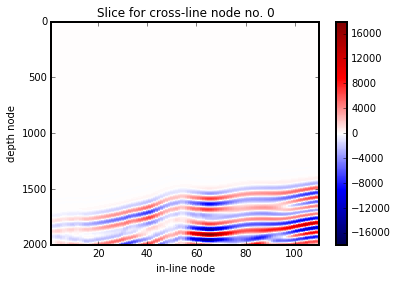

In [45]:
Plot_Gridded_Data_From_File(proj_path+'proj24-Synthetic_4188_31.vtr', cmap='seismic')

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -36807.9
lib_fwi_generic.py/Read_vtr: max value:  57134.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -312024.0
lib_fwi_generic.py/Read_vtr: max value:  329998.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

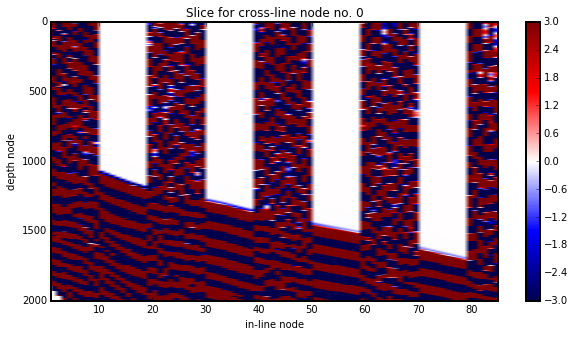

In [141]:
path = '/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/'

shot_id = '4140'
line = '26'

file1 = path + shot_id + 'obs_line' + line + '.vtr'
file2 = proj_path + proj_name + '-Synthetic_' + shot_id + '_' + line + '.vtr'
Plot_Gridded_Data_From_File(file1, file2=file2, cmap='seismic', fig_size=fig_size, norm='rms', minn=-a, maxx=a)

##### Plot all - with amplitude clipping (obs >> synth)

In [163]:
path = '/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/'

fnames = Get_Files(proj_path, proj_name + '-Synthetic_*_*.sgy')
i = 0
for full_fname in fnames:
    i += 1
    fname = Path_Leave(full_fname)
    shot_id, line = Split(core(fname, 'proj24-Synthetic_', '.sgy'), '_')
    print '\n', shot_id, line, '\n'
    file1 = path + shot_id + 'obs_line' + line + '.vtr'
    file2 = proj_path + proj_name + '-Synthetic_' + shot_id + '_' + line + '.vtr'
    save_as = fname[ :-len('.sgy')] + '_vs_jm_observed.png'
    Plot_Gridded_Data_From_File(file1, file2=file2, cmap='seismic', fig_size=fig_size, norm='rms', minn=-a, maxx=a, save=True, save_as=save_as)


4104 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.60365e+09
lib_fwi_generic.py/Read_vtr: max value:  4.37988e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25600.0
lib_fwi_generic.py/Read_vtr: max value:  18041.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_10_vs_jm_observed.png

4104 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.59577e+09
lib_fwi_generic.py/Read_vtr: max value:  5.66931e+09
lib_fwi_generic.py/Read_vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_11_vs_jm_observed.png

4104 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.05098e+08
lib_fwi_generic.py/Read_vtr: max value:  3.5496e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14044.9
lib_fwi_generic.py/Read_vtr: max value:  17528.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_22_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.70906e+08
lib_fwi_generic.py/Read_vtr: max value:  2.27375e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26389.9
lib_fwi_generic.py/Read_vtr: max value:  30838.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_23_vs_jm_observed.png

4104 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.1521e+08
lib_fwi_generic.py/Read_vtr: max value:  2.41923e+08
lib_fwi_generic.py/Read_vtr:

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.43313e+08
lib_fwi_generic.py/Read_vtr: max value:  3.31729e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -173399.0
lib_fwi_generic.py/Read_vtr: max value:  178726.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_27_vs_jm_observed.png

4104 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.72788e+07
lib_fwi_generic.py/Read_vtr: max value:  9.18853e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4731.13
lib_fwi_generic.py/Read_vtr: max value:  3521.32
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_28_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.31742e+08
lib_fwi_generic.py/Read_vtr: max value:  4.89904e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -380481.0
lib_fwi_generic.py/Read_vtr: max value:  455710.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.23174e+09
lib_fwi_generic.py/Read_vtr: max value:  9.49053e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -572086.0
lib_fwi_generic.py/Read_vtr: max value:  601862.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2000

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_31_vs_jm_observed.png

4104 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.63394e+07
lib_fwi_generic.py/Read_vtr: max value:  2.01102e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  42 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10047.9
lib_fwi_generic.py/Read_vtr: max value:  7236.45
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  42 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_32_vs_jm_observed.png

4104 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.32432e+09
lib_fwi_generic.py/Read_vtr: max value:  1.65608e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -646607.0
lib_fwi_generic.py/Read_vtr: max value:  588663.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.14264e+08
lib_fwi_generic.py/Read_vtr: max value:  7.78872e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.89139e+06
lib_fwi_generic.py/Read_vtr: max value:  3.45477e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35181e+08
lib_fwi_generic.py/Read_vtr: max value:  1.46214e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15554.1
lib_fwi_generic.py/Read_vtr: max value:  18444.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_40_vs_jm_observed.png

4104 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.17017e+08
lib_fwi_generic.py/Read_vtr: max value:  1.90719e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29167.3
lib_fwi_generic.py/Read_vtr: max value:  24169.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_41_vs_jm_observed.png

4104 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.35827e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46205e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.8531e+06
lib_fwi_generic.py/Read_vtr: max value:  3.42333e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.61578e+08
lib_fwi_generic.py/Read_vtr: max value:  3.92573e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8103.55
lib_fwi_generic.py/Read_vtr: max value:  8689.04
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_55_vs_jm_observed.png

4104 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.34287e+07
lib_fwi_generic.py/Read_vtr: max value:  1.1507e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5473.95
lib_fwi_generic.py/Read_vtr: max value:  3955.65
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_57_vs_jm_observed.png

4104 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.87383e+09
lib_fwi_generic.py/Read_vtr: max value:  3.39563e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -663642.0
lib_fwi_generic.py/Read_vtr: max value:  605799.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.93555e+08
lib_fwi_generic.py/Read_vtr: max value:  5.38141e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -154328.0
lib_fwi_generic.py/Read_vtr: max value:  144861.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_7_vs_jm_observed.png

4104 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.9443e+09
lib_fwi_generic.py/Read_vtr: max value:  6.20162e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -149264.0
lib_fwi_generic.py/Read_vtr: max value:  171875.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4104 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4104obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.85224e+09
lib_fwi_generic.py/Read_vtr: max value:  7.88638e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4104_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45749.4
lib_fwi_generic.py/Read_vtr: max value:  46017.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4104_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9144.74
lib_fwi_generic.py/Read_vtr: max value:  8164.79
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  98 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25173.2
lib_fwi_generic.py/Read_vtr: max value:  30467.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  98 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_10_vs_jm_observed.png

4105 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7601.05
lib_fwi_generic.py/Read_vtr: max value:  8823.01
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9715.77
lib_fwi_generic.py/Read_vtr: max value:  7444.92
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_11_vs_jm_observed.png

4105

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8623.23
lib_fwi_generic.py/Read_vtr: max value:  10464.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4894.48
lib_fwi_generic.py/Read_vtr: max value:  4688.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_17_vs_jm_observed.png

4105 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5911.61
lib_fwi_generic.py/Read_vtr: max value:  5829.27
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12916.0
lib_fwi_generic.py/Read_vtr: max value:  17908.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -777.173
lib_fwi_generic.py/Read_vtr: max value:  742.103
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  6 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3116.13
lib_fwi_generic.py/Read_vtr: max value:  1547.73
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  6 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_20_vs_jm_observed.png

4105 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -442.154
lib_fwi_generic.py/Read_vtr: max value:  413.317
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3596.07
lib_fwi_generic.py/Read_vtr: max value:  2540.51
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_21_vs_jm_observed.png

4105 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2196.77
lib_fwi_generic.py/Read_vtr: max value:  2200.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  105 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32175.5
lib_fwi_generic.py/Read_vtr: max value:  29507.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  105 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_22_vs_jm_observed.png

4105 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8208.03
lib_fwi_generic.py/Read_vtr: max value:  7934.79
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21913.8
lib_fwi_generic.py/Read_vtr: max value:  27333.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_23_vs_jm_observed.png

4105 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10797.2
lib_fwi_generic.py/Read_vtr: max value:  9896.97
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30527.1
lib_fwi_generic.py/Read_vtr: max value:  36343.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -78879.9
lib_fwi_generic.py/Read_vtr: max value:  51322.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -164651.0
lib_fwi_generic.py/Read_vtr: max value:  144709.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_27_vs_jm_observed.png

4105 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -713.854
lib_fwi_generic.py/Read_vtr: max value:  688.51
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19370.4
lib_fwi_generic.py/Read_vtr: max value:  19005.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_28_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -90538.2
lib_fwi_generic.py/Read_vtr: max value:  335067.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -914199.0
lib_fwi_generic.py/Read_vtr: max value:  776864.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -102044.0
lib_fwi_generic.py/Read_vtr: max value:  102344.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  260 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.09467e+06
lib_fwi_generic.py/Read_vtr: max value:  1.0932e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  260 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_31_vs_jm_observed.png

4105 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7022.36
lib_fwi_generic.py/Read_vtr: max value:  5628.86
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31370.7
lib_fwi_generic.py/Read_vtr: max value:  28690.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_32_vs_jm_observed.png

4105 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/D

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -133938.0
lib_fwi_generic.py/Read_vtr: max value:  447818.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.10709e+06
lib_fwi_generic.py/Read_vtr: max value:  1.26548e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_37_vs_jm_observed.png

4105 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -434894.0
lib_fwi_generic.py/Read_vtr: max value:  2.74449e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  227 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.45019e+06
lib_fwi_generic.py/Read_vtr: max value:  4.79534e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  227 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1160.63
lib_fwi_generic.py/Read_vtr: max value:  1353.39
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5148.97
lib_fwi_generic.py/Read_vtr: max value:  3799.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_40_vs_jm_observed.png

4105 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -560.55
lib_fwi_generic.py/Read_vtr: max value:  716.989
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1655.62
lib_fwi_generic.py/Read_vtr: max value:  3371.53
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_41_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -743523.0
lib_fwi_generic.py/Read_vtr: max value:  4.11931e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  227 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.38055e+06
lib_fwi_generic.py/Read_vtr: max value:  4.7358e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  227 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_5_vs_jm_observed.png

4105 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -368.479
lib_fwi_generic.py/Read_vtr: max value:  330.024
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -753.397
lib_fwi_generic.py/Read_vtr: max value:  525.74
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_52_vs_jm_observed.png

4105 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DAT

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -261224.0
lib_fwi_generic.py/Read_vtr: max value:  595841.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -147507.0
lib_fwi_generic.py/Read_vtr: max value:  182952.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_55_vs_jm_observed.png

4105 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -509.813
lib_fwi_generic.py/Read_vtr: max value:  456.233
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -944.924
lib_fwi_generic.py/Read_vtr: max value:  783.439
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_56_vs_jm_observed.png

4105 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1077.54
lib_fwi_generic.py/Read_vtr: max value:  967.603
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23973.1
lib_fwi_generic.py/Read_vtr: max value:  29643.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_57_vs_jm_observed.png

4105 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DA

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -155388.0
lib_fwi_generic.py/Read_vtr: max value:  342419.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  225 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12475e+06
lib_fwi_generic.py/Read_vtr: max value:  1.24544e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  225 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4105 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -64087.3
lib_fwi_generic.py/Read_vtr: max value:  61518.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -386946.0
lib_fwi_generic.py/Read_vtr: max value:  475346.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_7_vs_jm_observed.png

4105 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4105obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -41618.1
lib_fwi_generic.py/Read_vtr: max value:  45769.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -64844.0
lib_fwi_generic.py/Read_vtr: max value:  65622.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_8_vs_jm_observed.png

4105 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADR

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -12794.5
lib_fwi_generic.py/Read_vtr: max value:  14761.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  123 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4105_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29562.5
lib_fwi_generic.py/Read_vtr: max value:  28196.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  123 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4105_9_vs_jm_observed.png

4106 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.09089e+09
lib_fwi_generic.py/Read_vtr: max value:  2.58886e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17578.3
lib_fwi_generic.py/Read_vtr: max value:  20272.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98196e+09
lib_fwi_generic.py/Read_vtr: max value:  1.947e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  45 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5905.92
lib_fwi_generic.py/Read_vtr: max value:  6149.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  45 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_11_vs_jm_observed.png

4106 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.02974e+09
lib_fwi_generic.py/Read_vtr: max value:  3.9401e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3342.4
lib_fwi_generic.py/Read_vtr: max value:  3298.96
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_17_vs_jm_observed.png

4106 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.57519e+09
lib_fwi_generic.py/Read_vtr: max value:  1.6006e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8478.6
lib_fwi_generic.py/Read_vtr: max value:  10412.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_18_vs_jm_observed.png

4106 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.73578e+07
lib_fwi_generic.py/Read_vtr: max value:  4.07962e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6864.06
lib_fwi_generic.py/Read_vtr: max value:  7679.72
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.58666e+08
lib_fwi_generic.py/Read_vtr: max value:  6.05868e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15029.6
lib_fwi_generic.py/Read_vtr: max value:  17312.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_20_vs_jm_observed.png

4106 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.43044e+08
lib_fwi_generic.py/Read_vtr: max value:  2.4099e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  52 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2655.84
lib_fwi_generic.py/Read_vtr: max value:  3285.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  52 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_21_vs_jm_observed.png

4106 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/km

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.76278e+08
lib_fwi_generic.py/Read_vtr: max value:  2.75085e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14037.4
lib_fwi_generic.py/Read_vtr: max value:  13151.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_22_vs_jm_observed.png

4106 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.54106e+08
lib_fwi_generic.py/Read_vtr: max value:  2.758e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19102.9
lib_fwi_generic.py/Read_vtr: max value:  22626.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_23_vs_jm_observed.png

4106 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.63458e+07
lib_fwi_generic.py/Read_vtr: max value:  9.9417e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3128.08
lib_fwi_generic.py/Read_vtr: max value:  3135.43
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.80342e+07
lib_fwi_generic.py/Read_vtr: max value:  7.43283e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10132.7
lib_fwi_generic.py/Read_vtr: max value:  9753.28
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_25_vs_jm_observed.png

4106 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.80108e+08
lib_fwi_generic.py/Read_vtr: max value:  4.15459e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29947.8
lib_fwi_generic.py/Read_vtr: max value:  28497.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_26_vs_jm_observed.png

4106 27 

lib_fwi_generic.py/Read_vtr:  File:  /media

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.21114e+08
lib_fwi_generic.py/Read_vtr: max value:  4.58672e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  119 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -88792.9
lib_fwi_generic.py/Read_vtr: max value:  95864.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  119 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_27_vs_jm_observed.png

4106 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.91358e+08
lib_fwi_generic.py/Read_vtr: max value:  1.30362e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31463.0
lib_fwi_generic.py/Read_vtr: max value:  60664.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_28_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.40315e+08
lib_fwi_generic.py/Read_vtr: max value:  1.60177e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11130.3
lib_fwi_generic.py/Read_vtr: max value:  11242.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_29_vs_jm_observed.png

4106 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.2315e+08
lib_fwi_generic.py/Read_vtr: max value:  5.37097e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  269 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -501672.0
lib_fwi_generic.py/Read_vtr: max value:  630461.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  269 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53813e+09
lib_fwi_generic.py/Read_vtr: max value:  1.73118e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -803305.0
lib_fwi_generic.py/Read_vtr: max value:  924314.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.29354e+08
lib_fwi_generic.py/Read_vtr: max value:  5.9713e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -383125.0
lib_fwi_generic.py/Read_vtr: max value:  305926.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_32_vs_jm_observed.png

4106 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.09164e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30117e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -767894.0
lib_fwi_generic.py/Read_vtr: max value:  666868.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_37_vs_jm_observed.png

4106 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.6827e+09
lib_fwi_generic.py/Read_vtr: max value:  2.60139e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.46958e+06
lib_fwi_generic.py/Read_vtr: max value:  4.80925e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.16232e+09
lib_fwi_generic.py/Read_vtr: max value:  2.75087e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.72105e+06
lib_fwi_generic.py/Read_vtr: max value:  5.04408e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.33073e+07
lib_fwi_generic.py/Read_vtr: max value:  3.07355e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7514.26
lib_fwi_generic.py/Read_vtr: max value:  9638.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_52_vs_jm_observed.png

4106 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.14514e+08
lib_fwi_generic.py/Read_vtr: max value:  6.50734e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -549788.0
lib_fwi_generic.py/Read_vtr: max value:  663433.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_55_vs_jm_observed.png

4106 56 

lib_fwi_generic.py/Read_vtr:  File:  /media

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.29644e+08
lib_fwi_generic.py/Read_vtr: max value:  1.62044e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10363.5
lib_fwi_generic.py/Read_vtr: max value:  10373.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_56_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4106 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.39395e+08
lib_fwi_generic.py/Read_vtr: max value:  1.45663e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23220.2
lib_fwi_generic.py/Read_vtr: max value:  41693.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_57_vs_jm_observed.png

4106 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50317e+09
lib_fwi_generic.py/Read_vtr: max value:  1.4839e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -764561.0
lib_fwi_generic.py/Read_vtr: max value:  672313.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_6_vs_jm_observed.png

4106 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.49304e+08
lib_fwi_generic.py/Read_vtr: max value:  6.41795e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -188629.0
lib_fwi_generic.py/Read_vtr: max value:  166132.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_7_vs_jm_observed.png

4106 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4106obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.9222e+09
lib_fwi_generic.py/Read_vtr: max value:  3.54849e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  98 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53568.3
lib_fwi_generic.py/Read_vtr: max value:  46101.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  98 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_8_vs_jm_observed.png

4106 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/D

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.98651e+09
lib_fwi_generic.py/Read_vtr: max value:  3.92105e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4106_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -28839.0
lib_fwi_generic.py/Read_vtr: max value:  33006.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4106_9_vs_jm_observed.png

4108 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32739.4
lib_fwi_generic.py/Read_vtr: max value:  26511.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13743.9
lib_fwi_generic.py/Read_vtr: max value:  12187.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9796.15
lib_fwi_generic.py/Read_vtr: max value:  11948.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -49961.3
lib_fwi_generic.py/Read_vtr: max value:  55997.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4772.77
lib_fwi_generic.py/Read_vtr: max value:  4270.24
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  171 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -102995.0
lib_fwi_generic.py/Read_vtr: max value:  107501.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  171 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4072.59
lib_fwi_generic.py/Read_vtr: max value:  4461.23
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  122 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48975.8
lib_fwi_generic.py/Read_vtr: max value:  48122.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  122 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30826.1
lib_fwi_generic.py/Read_vtr: max value:  42240.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -251922.0
lib_fwi_generic.py/Read_vtr: max value:  246274.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_20_vs_jm_observed.png

4108 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -663.02
lib_fwi_generic.py/Read_vtr: max value:  681.632
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23633.0
lib_fwi_generic.py/Read_vtr: max value:  28611.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1805.23
lib_fwi_generic.py/Read_vtr: max value:  1881.36
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74183.6
lib_fwi_generic.py/Read_vtr: max value:  76438.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_24_vs_jm_observed.png

4108 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7830.23
lib_fwi_generic.py/Read_vtr: max value:  7925.18
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  140 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -65560.3
lib_fwi_generic.py/Read_vtr: max value:  71875.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  140 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -275.042
lib_fwi_generic.py/Read_vtr: max value:  246.907
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7435.93
lib_fwi_generic.py/Read_vtr: max value:  9638.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_27_vs_jm_observed.png

4108 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2954.99
lib_fwi_generic.py/Read_vtr: max value:  3444.07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -220841.0
lib_fwi_generic.py/Read_vtr: max value:  179854.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_28_vs_jm_observed.png

4108 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -35047.7
lib_fwi_generic.py/Read_vtr: max value:  26710.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -105101.0
lib_fwi_generic.py/Read_vtr: max value:  103807.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_29_vs_jm_observed.png

4108 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32574.2
lib_fwi_generic.py/Read_vtr: max value:  32017.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  267 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.14678e+06
lib_fwi_generic.py/Read_vtr: max value:  1.25688e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  267 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -552097.0
lib_fwi_generic.py/Read_vtr: max value:  258923.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.34434e+06
lib_fwi_generic.py/Read_vtr: max value:  5.1684e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3923.11
lib_fwi_generic.py/Read_vtr: max value:  4617.84
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -141902.0
lib_fwi_generic.py/Read_vtr: max value:  117348.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_32_vs_jm_observed.png

4108 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -709.92
lib_fwi_generic.py/Read_vtr: max value:  600.635
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17115.8
lib_fwi_generic.py/Read_vtr: max value:  16436.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_33_vs_jm_observed.png

4108 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DA

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15918.6
lib_fwi_generic.py/Read_vtr: max value:  18782.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  24 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_34_vs_jm_observed.png

4108 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4517.23
lib_fwi_generic.py/Read_vtr: max value:  4089.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19104.5
lib_fwi_generic.py/Read_vtr: max value:  18564.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_35_vs_jm_observed.png

4108 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2976.5
lib_fwi_generic.py/Read_vtr: max value:  3481.76
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20346.5
lib_fwi_generic.py/Read_vtr: max value:  17889.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_36_vs_jm_observed.png

4108 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31195.9
lib_fwi_generic.py/Read_vtr: max value:  47488.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  77 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -344045.0
lib_fwi_generic.py/Read_vtr: max value:  336975.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  77 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_37_vs_jm_observed.png

4108 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -733592.0
lib_fwi_generic.py/Read_vtr: max value:  917149.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55208e+07
lib_fwi_generic.py/Read_vtr: max value:  1.58094e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_38_vs_jm_observed.png

4108 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12545e+06
lib_fwi_generic.py/Read_vtr: max value:  452066.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  236 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.57981e+07
lib_fwi_generic.py/Read_vtr: max value:  1.59982e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  236 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3723.59
lib_fwi_generic.py/Read_vtr: max value:  3901.11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -118804.0
lib_fwi_generic.py/Read_vtr: max value:  128108.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_52_vs_jm_observed.png

4108 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10446.6
lib_fwi_generic.py/Read_vtr: max value:  11561.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -290608.0
lib_fwi_generic.py/Read_vtr: max value:  275899.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1957.14
lib_fwi_generic.py/Read_vtr: max value:  2420.53
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -154770.0
lib_fwi_generic.py/Read_vtr: max value:  150811.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_56_vs_jm_observed.png

4108 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -975.957
lib_fwi_generic.py/Read_vtr: max value:  1159.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29927.7
lib_fwi_generic.py/Read_vtr: max value:  28775.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_57_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -401849.0
lib_fwi_generic.py/Read_vtr: max value:  441815.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  235 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.83431e+06
lib_fwi_generic.py/Read_vtr: max value:  1.92266e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  235 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4108 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4108obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -317.067
lib_fwi_generic.py/Read_vtr: max value:  318.79
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4108_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7108.88
lib_fwi_generic.py/Read_vtr: max value:  7553.45
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4108_7_vs_jm_observed.png

4109 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.84636e+08
lib_fwi_generic.py/Read_vtr: max value:  7.03912e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -81196.0
lib_fwi_generic.py/Read_vtr: max value:  72767.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4109 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.4087e+08
lib_fwi_generic.py/Read_vtr: max value:  5.24501e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25045.6
lib_fwi_generic.py/Read_vtr: max value:  27941.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_11_vs_jm_observed.png

4109 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50425e+08
lib_fwi_generic.py/Read_vtr: max value:  1.64805e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -58302.9
lib_fwi_generic.py/Read_vtr: max value:  44278.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_22_vs_jm_observed.png

4109 23 

lib_fwi_generic.py/Read_vtr:  File:  /media

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.58356e+08
lib_fwi_generic.py/Read_vtr: max value:  2.29157e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -78513.3
lib_fwi_generic.py/Read_vtr: max value:  91052.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_23_vs_jm_observed.png

4109 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.52186e+08
lib_fwi_generic.py/Read_vtr: max value:  3.51954e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -164196.0
lib_fwi_generic.py/Read_vtr: max value:  150008.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4109 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.6151e+08
lib_fwi_generic.py/Read_vtr: max value:  7.80812e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -356517.0
lib_fwi_generic.py/Read_vtr: max value:  340187.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4109 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.67646e+09
lib_fwi_generic.py/Read_vtr: max value:  3.05364e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -736796.0
lib_fwi_generic.py/Read_vtr: max value:  682830.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_30_vs_jm_observed.png

4109 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.67162e+09
lib_fwi_generic.py/Read_vtr: max value:  6.46274e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18626e+06
lib_fwi_generic.py/Read_vtr: max value:  1.12607e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_31_vs_jm_observed.png

4109 37 

lib_fwi_generic.py/Read_vtr:  File:

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.23109e+09
lib_fwi_generic.py/Read_vtr: max value:  1.94305e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.12619e+06
lib_fwi_generic.py/Read_vtr: max value:  3.66652e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_37_vs_jm_observed.png

4109 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.95367e+09
lib_fwi_generic.py/Read_vtr: max value:  1.74369e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -567283.0
lib_fwi_generic.py/Read_vtr: max value:  525686.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_38_vs_jm_observed.png

4109 40 

lib_fwi_generic.py/Read_vtr:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.64352e+07
lib_fwi_generic.py/Read_vtr: max value:  4.52355e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -28813.5
lib_fwi_generic.py/Read_vtr: max value:  28718.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_40_vs_jm_observed.png

4109 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.20191e+08
lib_fwi_generic.py/Read_vtr: max value:  1.83247e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26272.8
lib_fwi_generic.py/Read_vtr: max value:  25725.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_41_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4109 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.9133e+09
lib_fwi_generic.py/Read_vtr: max value:  1.56409e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -559886.0
lib_fwi_generic.py/Read_vtr: max value:  518993.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_5_vs_jm_observed.png

4109 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.94403e+07
lib_fwi_generic.py/Read_vtr: max value:  7.77492e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  33 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14763.2
lib_fwi_generic.py/Read_vtr: max value:  14622.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  33 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_55_vs_jm_observed.png

4109 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.59035e+09
lib_fwi_generic.py/Read_vtr: max value:  2.49636e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.13986e+06
lib_fwi_generic.py/Read_vtr: max value:  3.6763e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_6_vs_jm_observed.png

4109 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.2729e+09
lib_fwi_generic.py/Read_vtr: max value:  3.21936e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -501222.0
lib_fwi_generic.py/Read_vtr: max value:  449703.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4109 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.16243e+09
lib_fwi_generic.py/Read_vtr: max value:  1.18963e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -227094.0
lib_fwi_generic.py/Read_vtr: max value:  233720.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_8_vs_jm_observed.png

4109 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4109obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.7815e+08
lib_fwi_generic.py/Read_vtr: max value:  8.68345e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4109_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -109370.0
lib_fwi_generic.py/Read_vtr: max value:  114949.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4109_9_vs_jm_observed.png



libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


4110 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -54652.2
lib_fwi_generic.py/Read_vtr: max value:  46929.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -114815.0
lib_fwi_generic.py/Read_vtr: max value:  128330.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_10_vs_jm_observed.png

4110 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6202.53
lib_fwi_generic.py/Read_vtr: max value:  7189.98
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -55456.8
lib_fwi_generic.py/Read_vtr: max value:  50898.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_11_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1390.02
lib_fwi_generic.py/Read_vtr: max value:  1367.71
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1666.09
lib_fwi_generic.py/Read_vtr: max value:  1252.35
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_18_vs_jm_observed.png

4110 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -40737.9
lib_fwi_generic.py/Read_vtr: max value:  40291.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -114017.0
lib_fwi_generic.py/Read_vtr: max value:  112272.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_22_vs_jm_observed.png

4110 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc38

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -14810.9
lib_fwi_generic.py/Read_vtr: max value:  14302.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -184588.0
lib_fwi_generic.py/Read_vtr: max value:  164229.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_23_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -132752.0
lib_fwi_generic.py/Read_vtr: max value:  179987.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -395650.0
lib_fwi_generic.py/Read_vtr: max value:  369434.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -148700.0
lib_fwi_generic.py/Read_vtr: max value:  218233.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13496e+06
lib_fwi_generic.py/Read_vtr: max value:  1.13043e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -714.077
lib_fwi_generic.py/Read_vtr: max value:  624.604
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7774.47
lib_fwi_generic.py/Read_vtr: max value:  6276.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_28_vs_jm_observed.png

4110 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -160757.0
lib_fwi_generic.py/Read_vtr: max value:  94215.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.87928e+06
lib_fwi_generic.py/Read_vtr: max value:  1.6558e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74717.4
lib_fwi_generic.py/Read_vtr: max value:  68616.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.62052e+06
lib_fwi_generic.py/Read_vtr: max value:  1.59798e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -982.616
lib_fwi_generic.py/Read_vtr: max value:  895.083
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12960.2
lib_fwi_generic.py/Read_vtr: max value:  10197.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_32_vs_jm_observed.png

4110 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -332094.0
lib_fwi_generic.py/Read_vtr: max value:  384333.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.75067e+06
lib_fwi_generic.py/Read_vtr: max value:  5.93687e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_37_vs_jm_observed.png

4110 38 

lib_fwi_generic.py/Read_vtr:  File:  /med

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -118744.0
lib_fwi_generic.py/Read_vtr: max value:  94774.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.28234e+06
lib_fwi_generic.py/Read_vtr: max value:  1.43781e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_38_vs_jm_observed.png

4110 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1214.0
lib_fwi_generic.py/Read_vtr: max value:  1301.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25600.5
lib_fwi_generic.py/Read_vtr: max value:  25125.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_40_vs_jm_observed.png

4110 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATA

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1167.3
lib_fwi_generic.py/Read_vtr: max value:  1438.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -34091.9
lib_fwi_generic.py/Read_vtr: max value:  33900.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_41_vs_jm_observed.png

4110 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -118796.0
lib_fwi_generic.py/Read_vtr: max value:  94882.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.29353e+06
lib_fwi_generic.py/Read_vtr: max value:  1.39563e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4110 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2772.25
lib_fwi_generic.py/Read_vtr: max value:  2925.45
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  57 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30282.1
lib_fwi_generic.py/Read_vtr: max value:  36379.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  57 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_55_vs_jm_observed.png

4110 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -637.336
lib_fwi_generic.py/Read_vtr: max value:  597.037
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8090.38
lib_fwi_generic.py/Read_vtr: max value:  7374.15
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_57_vs_jm_observed.png

4110 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DA

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.67034e+06
lib_fwi_generic.py/Read_vtr: max value:  5.86916e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_6_vs_jm_observed.png

4110 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -103266.0
lib_fwi_generic.py/Read_vtr: max value:  113275.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.24257e+06
lib_fwi_generic.py/Read_vtr: max value:  1.25493e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_7_vs_jm_observed.png

4110 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4110obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -177688.0
lib_fwi_generic.py/Read_vtr: max value:  151878.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -844580.0
lib_fwi_generic.py/Read_vtr: max value:  765018.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_8_vs_jm_observed.png

4110 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DA

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -45756.5
lib_fwi_generic.py/Read_vtr: max value:  32651.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4110_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -209321.0
lib_fwi_generic.py/Read_vtr: max value:  211776.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4110_9_vs_jm_observed.png

4112 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.43302e+09
lib_fwi_generic.py/Read_vtr: max value:  4.93613e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  99 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -111124.0
lib_fwi_generic.py/Read_vtr: max value:  115353.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  99 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.14764e+09
lib_fwi_generic.py/Read_vtr: max value:  6.08227e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37902.0
lib_fwi_generic.py/Read_vtr: max value:  31806.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_11_vs_jm_observed.png

4112 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.26522e+09
lib_fwi_generic.py/Read_vtr: max value:  4.38126e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15010.5
lib_fwi_generic.py/Read_vtr: max value:  14708.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_17_vs_jm_observed.png

4112 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.88953e+09
lib_fwi_generic.py/Read_vtr: max value:  1.89771e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -108050.0
lib_fwi_generic.py/Read_vtr: max value:  115675.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_18_vs_jm_observed.png

4112 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.39059e+07
lib_fwi_generic.py/Read_vtr: max value:  2.17055e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5488.26
lib_fwi_generic.py/Read_vtr: max value:  5269.64
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.14721e+08
lib_fwi_generic.py/Read_vtr: max value:  3.41651e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18914.8
lib_fwi_generic.py/Read_vtr: max value:  22503.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_20_vs_jm_observed.png

4112 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.08318e+08
lib_fwi_generic.py/Read_vtr: max value:  1.01391e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13925.5
lib_fwi_generic.py/Read_vtr: max value:  15396.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_21_vs_jm_observed.png

4112 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.51744e+08
lib_fwi_generic.py/Read_vtr: max value:  3.56516e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -52393.2
lib_fwi_generic.py/Read_vtr: max value:  51742.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_22_vs_jm_observed.png

4112 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.10369e+08
lib_fwi_generic.py/Read_vtr: max value:  4.03318e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71295.4
lib_fwi_generic.py/Read_vtr: max value:  57670.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_23_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53915e+08
lib_fwi_generic.py/Read_vtr: max value:  1.78097e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15095.4
lib_fwi_generic.py/Read_vtr: max value:  23725.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_24_vs_jm_observed.png

4112 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.17374e+07
lib_fwi_generic.py/Read_vtr: max value:  4.95873e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4969.29
lib_fwi_generic.py/Read_vtr: max value:  5149.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_25_vs_jm_observed.png

4112 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.46742e+08
lib_fwi_generic.py/Read_vtr: max value:  3.46382e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -472530.0
lib_fwi_generic.py/Read_vtr: max value:  453277.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_26_vs_jm_observed.png

4112 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.91809e+08
lib_fwi_generic.py/Read_vtr: max value:  3.55367e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12035e+06
lib_fwi_generic.py/Read_vtr: max value:  1.18724e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.06227e+08
lib_fwi_generic.py/Read_vtr: max value:  2.11374e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -106737.0
lib_fwi_generic.py/Read_vtr: max value:  119296.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_28_vs_jm_observed.png

4112 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.72806e+07
lib_fwi_generic.py/Read_vtr: max value:  4.89446e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5999.36
lib_fwi_generic.py/Read_vtr: max value:  6059.61
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_29_vs_jm_observed.png

4112 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.03176e+06
lib_fwi_generic.py/Read_vtr: max value:  1.92086e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.97093e+08
lib_fwi_generic.py/Read_vtr: max value:  5.02284e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12835e+06
lib_fwi_generic.py/Read_vtr: max value:  1.26853e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.43264e+07
lib_fwi_generic.py/Read_vtr: max value:  5.67679e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -257953.0
lib_fwi_generic.py/Read_vtr: max value:  179994.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_32_vs_jm_observed.png

4112 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.19643e+08
lib_fwi_generic.py/Read_vtr: max value:  2.40102e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  200 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.46115e+06
lib_fwi_generic.py/Read_vtr: max value:  6.74803e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  200 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_37_vs_jm_observed.png

4112 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.27638e+08
lib_fwi_generic.py/Read_vtr: max value:  3.00216e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.23502e+06
lib_fwi_generic.py/Read_vtr: max value:  1.225e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.21093e+08
lib_fwi_generic.py/Read_vtr: max value:  8.66681e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22957e+06
lib_fwi_generic.py/Read_vtr: max value:  1.22623e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.86341e+07
lib_fwi_generic.py/Read_vtr: max value:  2.73029e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66552.6
lib_fwi_generic.py/Read_vtr: max value:  42384.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_52_vs_jm_observed.png

4112 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.68878e+08
lib_fwi_generic.py/Read_vtr: max value:  4.61782e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -984743.0
lib_fwi_generic.py/Read_vtr: max value:  1.04809e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_55_vs_jm_observed.png

4112 56 

lib_fwi_generic.py/Read_vtr:  File:  /me

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.13049e+07
lib_fwi_generic.py/Read_vtr: max value:  8.12145e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30973.3
lib_fwi_generic.py/Read_vtr: max value:  27020.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_56_vs_jm_observed.png

4112 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.7661e+08
lib_fwi_generic.py/Read_vtr: max value:  5.11385e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -124168.0
lib_fwi_generic.py/Read_vtr: max value:  130574.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_57_vs_jm_observed.png

4112 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.81595e+09
lib_fwi_generic.py/Read_vtr: max value:  3.19417e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.33004e+06
lib_fwi_generic.py/Read_vtr: max value:  6.61545e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.2023e+08
lib_fwi_generic.py/Read_vtr: max value:  4.17883e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35245e+06
lib_fwi_generic.py/Read_vtr: max value:  1.36304e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.98288e+09
lib_fwi_generic.py/Read_vtr: max value:  6.18561e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -838050.0
lib_fwi_generic.py/Read_vtr: max value:  829913.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4112 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4112obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.40342e+09
lib_fwi_generic.py/Read_vtr: max value:  9.85774e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  118 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4112_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -184368.0
lib_fwi_generic.py/Read_vtr: max value:  193863.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  118 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4112_9_vs_jm_observed.png

4113 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.59803e+09
lib_fwi_generic.py/Read_vtr: max value:  1.69473e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -40214.5
lib_fwi_generic.py/Read_vtr: max value:  40020.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_10_vs_jm_observed.png

4113 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.59695e+09
lib_fwi_generic.py/Read_vtr: max value:  1.51623e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  54 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21944.0
lib_fwi_generic.py/Read_vtr: max value:  21084.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  54 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_11_vs_jm_observed.png

4113 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5919.66
lib_fwi_generic.py/Read_vtr: max value:  2942.91
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_16_vs_jm_observed.png

4113 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.786e+09
lib_fwi_generic.py/Read_vtr: max value:  1.64832e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -42344.5
lib_fwi_generic.py/Read_vtr: max value:  49076.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_17_vs_jm_observed.png

4113 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.27168e+08
lib_fwi_generic.py/Read_vtr: max value:  6.54519e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  92 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -559111.0
lib_fwi_generic.py/Read_vtr: max value:  532338.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  92 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_18_vs_jm_observed.png

4113 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.17497e+07
lib_fwi_generic.py/Read_vtr: max value:  3.96399e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11797.5
lib_fwi_generic.py/Read_vtr: max value:  11730.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_19_vs_jm_observed.png

4113 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.3852e+08
lib_fwi_generic.py/Read_vtr: max value:  5.8047e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74491.7
lib_fwi_generic.py/Read_vtr: max value:  99554.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.25507e+08
lib_fwi_generic.py/Read_vtr: max value:  1.12225e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33391.5
lib_fwi_generic.py/Read_vtr: max value:  37257.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_21_vs_jm_observed.png

4113 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line22.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -38587.3
lib_fwi_generic.py/Read_vtr: max value:  38779.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  70 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_22_vs_jm_observed.png

4113 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.18131e+08
lib_fwi_generic.py/Read_vtr: max value:  2.70116e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31871.7
lib_fwi_generic.py/Read_vtr: max value:  78704.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_23_vs_jm_observed.png

4113 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.45796e+08
lib_fwi_generic.py/Read_vtr: max value:  1.17372e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18011.7
lib_fwi_generic.py/Read_vtr: max value:  18277.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_24_vs_jm_observed.png

4113 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.26041e+07
lib_fwi_generic.py/Read_vtr: max value:  3.9358e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29707.7
lib_fwi_generic.py/Read_vtr: max value:  42127.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.18864e+08
lib_fwi_generic.py/Read_vtr: max value:  2.41552e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -446422.0
lib_fwi_generic.py/Read_vtr: max value:  472348.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_26_vs_jm_observed.png

4113 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line27.vtr
lib_fwi_gen

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -427259.0
lib_fwi_generic.py/Read_vtr: max value:  415751.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  111 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.02402e+09
lib_fwi_generic.py/Read_vtr: max value:  1.00152e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -634598.0
lib_fwi_generic.py/Read_vtr: max value:  494344.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_28_vs_jm_observed.png

4113 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.56754e+07
lib_fwi_generic.py/Read_vtr: max value:  9.77326e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31037.7
lib_fwi_generic.py/Read_vtr: max value:  24828.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_29_vs_jm_observed.png

4113 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.38124e+08
lib_fwi_generic.py/Read_vtr: max value:  2.65955e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.24113e+06
lib_fwi_generic.py/Read_vtr: max value:  3.80278e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.93213e+08
lib_fwi_generic.py/Read_vtr: max value:  6.63877e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.26018e+06
lib_fwi_generic.py/Read_vtr: max value:  2.47001e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.80899e+08
lib_fwi_generic.py/Read_vtr: max value:  2.87942e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.11119e+06
lib_fwi_generic.py/Read_vtr: max value:  2.0209e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.50303e+08
lib_fwi_generic.py/Read_vtr: max value:  3.10448e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.23918e+07
lib_fwi_generic.py/Read_vtr: max value:  1.10342e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_37_vs_jm_observed.png

4113 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.32345e+08
lib_fwi_generic.py/Read_vtr: max value:  7.49362e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.17838e+06
lib_fwi_generic.py/Read_vtr: max value:  2.05358e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.80845e+08
lib_fwi_generic.py/Read_vtr: max value:  1.00366e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.17546e+06
lib_fwi_generic.py/Read_vtr: max value:  2.02032e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.68212e+07
lib_fwi_generic.py/Read_vtr: max value:  5.9462e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -81041.7
lib_fwi_generic.py/Read_vtr: max value:  76709.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_52_vs_jm_observed.png

4113 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.78019e+08
lib_fwi_generic.py/Read_vtr: max value:  3.64327e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.22181e+06
lib_fwi_generic.py/Read_vtr: max value:  7.69758e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4113 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03398e+08
lib_fwi_generic.py/Read_vtr: max value:  1.03921e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -160860.0
lib_fwi_generic.py/Read_vtr: max value:  155411.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_56_vs_jm_observed.png

4113 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72849e+09
lib_fwi_generic.py/Read_vtr: max value:  1.22062e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -432484.0
lib_fwi_generic.py/Read_vtr: max value:  410517.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_57_vs_jm_observed.png

4113 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.50552e+09
lib_fwi_generic.py/Read_vtr: max value:  1.50065e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.19704e+07
lib_fwi_generic.py/Read_vtr: max value:  1.07824e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_6_vs_jm_observed.png

4113 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.132e+08
lib_fwi_generic.py/Read_vtr: max value:  3.21602e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  99 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35232e+06
lib_fwi_generic.py/Read_vtr: max value:  1.47539e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  99 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_7_vs_jm_observed.png

4113 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4113obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.2475e+09
lib_fwi_generic.py/Read_vtr: max value:  2.03335e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  92 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -413716.0
lib_fwi_generic.py/Read_vtr: max value:  410557.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  92 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_8_vs_jm_observed.png

4113 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.56748e+09
lib_fwi_generic.py/Read_vtr: max value:  1.6538e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4113_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -204104.0
lib_fwi_generic.py/Read_vtr: max value:  131164.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4113_9_vs_jm_observed.png

4114 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.78668e+10
lib_fwi_generic.py/Read_vtr: max value:  2.70374e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25787.1
lib_fwi_generic.py/Read_vtr: max value:  31211.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.80653e+10
lib_fwi_generic.py/Read_vtr: max value:  1.66362e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11988.9
lib_fwi_generic.py/Read_vtr: max value:  12752.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_11_vs_jm_observed.png

4114 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.6897e+10
lib_fwi_generic.py/Read_vtr: max value:  1.63275e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7649.03
lib_fwi_generic.py/Read_vtr: max value:  6429.33
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.83286e+09
lib_fwi_generic.py/Read_vtr: max value:  2.17962e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  107 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -38437.1
lib_fwi_generic.py/Read_vtr: max value:  46324.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  107 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_17_vs_jm_observed.png

4114 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8.11932e+08
lib_fwi_generic.py/Read_vtr: max value:  6.8392e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -105397.0
lib_fwi_generic.py/Read_vtr: max value:  107208.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_18_vs_jm_observed.png

4114 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.46507e+08
lib_fwi_generic.py/Read_vtr: max value:  1.20188e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -117933.0
lib_fwi_generic.py/Read_vtr: max value:  58994.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_19_vs_jm_observed.png

4114 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.00701e+08
lib_fwi_generic.py/Read_vtr: max value:  6.14408e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.33994e+06
lib_fwi_generic.py/Read_vtr: max value:  1.39061e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_20_vs_jm_observed.png

4114 21 

lib_fwi_generic.py/Read_vtr:  File:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.27028e+08
lib_fwi_generic.py/Read_vtr: max value:  3.93413e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  114 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -38898.0
lib_fwi_generic.py/Read_vtr: max value:  46167.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  114 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_21_vs_jm_observed.png

4114 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.45343e+08
lib_fwi_generic.py/Read_vtr: max value:  1.5845e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -22667.9
lib_fwi_generic.py/Read_vtr: max value:  22505.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_22_vs_jm_observed.png

4114 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/km

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.91956e+08
lib_fwi_generic.py/Read_vtr: max value:  2.71373e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14909.5
lib_fwi_generic.py/Read_vtr: max value:  14014.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_23_vs_jm_observed.png

4114 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.79319e+08
lib_fwi_generic.py/Read_vtr: max value:  3.14302e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  94 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -61034.3
lib_fwi_generic.py/Read_vtr: max value:  49310.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  94 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_24_vs_jm_observed.png

4114 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/k

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.4056e+08
lib_fwi_generic.py/Read_vtr: max value:  4.30839e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -307949.0
lib_fwi_generic.py/Read_vtr: max value:  298271.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_25_vs_jm_observed.png

4114 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.90076e+08
lib_fwi_generic.py/Read_vtr: max value:  3.761e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -62175.0
lib_fwi_generic.py/Read_vtr: max value:  75401.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_26_vs_jm_observed.png

4114 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.64526e+08
lib_fwi_generic.py/Read_vtr: max value:  4.46724e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  81 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -180865.0
lib_fwi_generic.py/Read_vtr: max value:  209222.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  81 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_27_vs_jm_observed.png

4114 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.53187e+08
lib_fwi_generic.py/Read_vtr: max value:  2.69554e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -282978.0
lib_fwi_generic.py/Read_vtr: max value:  301078.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_28_vs_jm_observed.png

4114 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.7237e+08
lib_fwi_generic.py/Read_vtr: max value:  2.95832e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -437987.0
lib_fwi_generic.py/Read_vtr: max value:  337456.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  84 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_29_vs_jm_observed.png

4114 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.9831e+08
lib_fwi_generic.py/Read_vtr: max value:  3.77198e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  276 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.44309e+06
lib_fwi_generic.py/Read_vtr: max value:  2.24531e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  276 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.47382e+08
lib_fwi_generic.py/Read_vtr: max value:  7.68249e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.69583e+06
lib_fwi_generic.py/Read_vtr: max value:  2.77162e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.30271e+08
lib_fwi_generic.py/Read_vtr: max value:  2.82153e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.9066e+07
lib_fwi_generic.py/Read_vtr: max value:  1.80908e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.20365e+08
lib_fwi_generic.py/Read_vtr: max value:  2.83441e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  142 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.16572e+06
lib_fwi_generic.py/Read_vtr: max value:  5.90366e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  142 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.27409e+08
lib_fwi_generic.py/Read_vtr: max value:  4.04042e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  233 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.82954e+06
lib_fwi_generic.py/Read_vtr: max value:  1.85997e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  233 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_38_vs_jm_observed.png

4114 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.75452e+09
lib_fwi_generic.py/Read_vtr: max value:  3.9e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.84693e+06
lib_fwi_generic.py/Read_vtr: max value:  1.83668e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_5_vs_jm_observed.png

4114 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.07076e+07
lib_fwi_generic.py/Read_vtr: max value:  6.23971e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -279996.0
lib_fwi_generic.py/Read_vtr: max value:  247051.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_52_vs_jm_observed.png

4114 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.05178e+08
lib_fwi_generic.py/Read_vtr: max value:  5.83882e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.75256e+06
lib_fwi_generic.py/Read_vtr: max value:  3.28892e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4114 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.0027e+08
lib_fwi_generic.py/Read_vtr: max value:  5.25615e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -145631.0
lib_fwi_generic.py/Read_vtr: max value:  138321.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_56_vs_jm_observed.png

4114 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.13147e+08
lib_fwi_generic.py/Read_vtr: max value:  3.47963e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -239012.0
lib_fwi_generic.py/Read_vtr: max value:  218213.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_57_vs_jm_observed.png

4114 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.96704e+09
lib_fwi_generic.py/Read_vtr: max value:  5.81333e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.54332e+06
lib_fwi_generic.py/Read_vtr: max value:  6.12138e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_6_vs_jm_observed.png

4114 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.16769e+08
lib_fwi_generic.py/Read_vtr: max value:  2.96274e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -100321.0
lib_fwi_generic.py/Read_vtr: max value:  125501.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_7_vs_jm_observed.png

4114 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.42586e+09
lib_fwi_generic.py/Read_vtr: max value:  9.17722e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
lib_fwi_gene

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -124325.0
lib_fwi_generic.py/Read_vtr: max value:  81618.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_8_vs_jm_observed.png

4114 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4114obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.01653e+09
lib_fwi_generic.py/Read_vtr: max value:  9.68337e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4114_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -50006.8
lib_fwi_generic.py/Read_vtr: max value:  61738.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4114_9_vs_jm_observed.png

4115 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9714.04
lib_fwi_generic.py/Read_vtr: max value:  7760.64
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25203.6
lib_fwi_generic.py/Read_vtr: max value:  18865.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  87 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_16_vs_jm_observed.png

4115 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12013.5
lib_fwi_generic.py/Read_vtr: max value:  8679.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -46794.4
lib_fwi_generic.py/Read_vtr: max value:  46103.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -135970.0
lib_fwi_generic.py/Read_vtr: max value:  103999.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -128757.0
lib_fwi_generic.py/Read_vtr: max value:  92871.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -72264.1
lib_fwi_generic.py/Read_vtr: max value:  63925.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.39858e+06
lib_fwi_generic.py/Read_vtr: max value:  1.51128e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_19_vs_jm_observed.png

4115 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -790318.0
lib_fwi_generic.py/Read_vtr: max value:  590382.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.14031e+06
lib_fwi_generic.py/Read_vtr: max value:  3.22969e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_20_vs_jm_observed.png

4115 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6603.55
lib_fwi_generic.py/Read_vtr: max value:  5741.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  166 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53032.8
lib_fwi_generic.py/Read_vtr: max value:  49130.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  166 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_21_vs_jm_observed.png

4115 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -563.662
lib_fwi_generic.py/Read_vtr: max value:  582.611
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3830.65
lib_fwi_generic.py/Read_vtr: max value:  6018.68
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_23_vs_jm_observed.png

4115 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -68751.3
lib_fwi_generic.py/Read_vtr: max value:  69710.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -57185.7
lib_fwi_generic.py/Read_vtr: max value:  63052.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -43957.8
lib_fwi_generic.py/Read_vtr: max value:  38926.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -115643.0
lib_fwi_generic.py/Read_vtr: max value:  129654.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1709.32
lib_fwi_generic.py/Read_vtr: max value:  1894.45
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9317.65
lib_fwi_generic.py/Read_vtr: max value:  7349.89
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_26_vs_jm_observed.png

4115 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line27.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10233.3
lib_fwi_generic.py/Read_vtr: max value:  9868.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_27_vs_jm_observed.png

4115 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9303.44
lib_fwi_generic.py/Read_vtr: max value:  8368.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -290637.0
lib_fwi_generic.py/Read_vtr: max value:  422406.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_28_vs_jm_observed.png

4115 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -812090.0
lib_fwi_generic.py/Read_vtr: max value:  942176.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.36044e+06
lib_fwi_generic.py/Read_vtr: max value:  3.53091e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -617579.0
lib_fwi_generic.py/Read_vtr: max value:  328982.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.01745e+06
lib_fwi_generic.py/Read_vtr: max value:  3.87626e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -338545.0
lib_fwi_generic.py/Read_vtr: max value:  551025.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.233e+06
lib_fwi_generic.py/Read_vtr: max value:  3.62862e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  277 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -95074.4
lib_fwi_generic.py/Read_vtr: max value:  91574.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.56726e+06
lib_fwi_generic.py/Read_vtr: max value:  1.45322e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2121.47
lib_fwi_generic.py/Read_vtr: max value:  1897.35
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  45 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6469.71
lib_fwi_generic.py/Read_vtr: max value:  5253.96
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  45 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_33_vs_jm_observed.png

4115 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line34.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2522.39
lib_fwi_generic.py/Read_vtr: max value:  5373.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_34_vs_jm_observed.png

4115 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1780.34
lib_fwi_generic.py/Read_vtr: max value:  1766.56
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3966.17
lib_fwi_generic.py/Read_vtr: max value:  8283.72
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_35_vs_jm_observed.png

4115 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3292.79
lib_fwi_generic.py/Read_vtr: max value:  3267.67
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4115.07
lib_fwi_generic.py/Read_vtr: max value:  7722.15
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_36_vs_jm_observed.png

4115 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -107197.0
lib_fwi_generic.py/Read_vtr: max value:  104465.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  101 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.20988e+06
lib_fwi_generic.py/Read_vtr: max value:  2.05768e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  101 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -442158.0
lib_fwi_generic.py/Read_vtr: max value:  373917.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  190 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.88886e+06
lib_fwi_generic.py/Read_vtr: max value:  3.27658e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  190 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -640589.0
lib_fwi_generic.py/Read_vtr: max value:  531498.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.83787e+06
lib_fwi_generic.py/Read_vtr: max value:  3.2912e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21252.5
lib_fwi_generic.py/Read_vtr: max value:  23272.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -146860.0
lib_fwi_generic.py/Read_vtr: max value:  135307.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_52_vs_jm_observed.png

4115 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line53.vtr
lib_fwi_generic.py/Re

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3369.78
lib_fwi_generic.py/Read_vtr: max value:  2543.36
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_53_vs_jm_observed.png

4115 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -335593.0
lib_fwi_generic.py/Read_vtr: max value:  315869.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.31048e+06
lib_fwi_generic.py/Read_vtr: max value:  2.19293e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_55_vs_jm_observed.png

4115 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6780.98
lib_fwi_generic.py/Read_vtr: max value:  7707.77
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -247007.0
lib_fwi_generic.py/Read_vtr: max value:  400286.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_56_vs_jm_observed.png

4115 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5769.43
lib_fwi_generic.py/Read_vtr: max value:  5342.69
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -47403.5
lib_fwi_generic.py/Read_vtr: max value:  39992.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_57_vs_jm_observed.png

4115 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -317381.0
lib_fwi_generic.py/Read_vtr: max value:  180950.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.63276e+06
lib_fwi_generic.py/Read_vtr: max value:  5.47515e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1464.94
lib_fwi_generic.py/Read_vtr: max value:  1836.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9334.53
lib_fwi_generic.py/Read_vtr: max value:  9717.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4115 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6688.03
lib_fwi_generic.py/Read_vtr: max value:  7774.89
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16156.9
lib_fwi_generic.py/Read_vtr: max value:  16535.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_8_vs_jm_observed.png

4115 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4115obs_line9.vtr
lib_fwi_generic.py/Read_vtr: m

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4115_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9106.35
lib_fwi_generic.py/Read_vtr: max value:  9623.22
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4115_9_vs_jm_observed.png

4117 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4519.83
lib_fwi_generic.py/Read_vtr: max value:  5466.84
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16883.0
lib_fwi_generic.py/Read_vtr: max value:  18145.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12569.6
lib_fwi_generic.py/Read_vtr: max value:  11502.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23178.4
lib_fwi_generic.py/Read_vtr: max value:  25318.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -110469.0
lib_fwi_generic.py/Read_vtr: max value:  130950.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -78933.1
lib_fwi_generic.py/Read_vtr: max value:  153662.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_18_vs_jm_observed.png

4117 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -353571.0
lib_fwi_generic.py/Read_vtr: max value:  208370.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -686241.0
lib_fwi_generic.py/Read_vtr: max value:  782422.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_19_vs_jm_observed.png

4117 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -117282.0
lib_fwi_generic.py/Read_vtr: max value:  127840.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47772e+06
lib_fwi_generic.py/Read_vtr: max value:  1.653e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -932.433
lib_fwi_generic.py/Read_vtr: max value:  888.142
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16695.4
lib_fwi_generic.py/Read_vtr: max value:  20778.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_21_vs_jm_observed.png

4117 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6329.25
lib_fwi_generic.py/Read_vtr: max value:  7318.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -36482.2
lib_fwi_generic.py/Read_vtr: max value:  53479.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -153712.0
lib_fwi_generic.py/Read_vtr: max value:  78585.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -356962.0
lib_fwi_generic.py/Read_vtr: max value:  327591.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.95999e+06
lib_fwi_generic.py/Read_vtr: max value:  3.50863e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01176e+06
lib_fwi_generic.py/Read_vtr: max value:  1.02399e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -734544.0
lib_fwi_generic.py/Read_vtr: max value:  717502.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22858e+06
lib_fwi_generic.py/Read_vtr: max value:  1.269e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_30_vs_jm_observed.png

4117 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -522798.0
lib_fwi_generic.py/Read_vtr: max value:  296681.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50981e+06
lib_fwi_generic.py/Read_vtr: max value:  1.72674e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3710.88
lib_fwi_generic.py/Read_vtr: max value:  3082.45
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -22969.0
lib_fwi_generic.py/Read_vtr: max value:  25161.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_33_vs_jm_observed.png

4117 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -107803.0
lib_fwi_generic.py/Read_vtr: max value:  89729.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -57094.9
lib_fwi_generic.py/Read_vtr: max value:  46670.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_34_vs_jm_observed.png

4117 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 -256366.0
lib_fwi_generic.py/Read_vtr: max value:  107581.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -549685.0
lib_fwi_generic.py/Read_vtr: max value:  667787.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_35_vs_jm_observed.png

4117 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48307.5
lib_fwi_generic.py/Read_vtr: max value:  68909.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -815872.0
lib_fwi_generic.py/Read_vtr: max value:  795779.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_36_vs_jm_observed.png

4117 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2860.4
lib_fwi_generic.py/Read_vtr: max value:  3015.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17457.4
lib_fwi_generic.py/Read_vtr: max value:  13004.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_37_vs_jm_observed.png

4117 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -671520.0
lib_fwi_generic.py/Read_vtr: max value:  839722.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  100 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -976371.0
lib_fwi_generic.py/Read_vtr: max value:  924442.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  100 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -239239.0
lib_fwi_generic.py/Read_vtr: max value:  538007.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.29904e+06
lib_fwi_generic.py/Read_vtr: max value:  1.35263e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4117 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3679.53
lib_fwi_generic.py/Read_vtr: max value:  3446.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -50041.5
lib_fwi_generic.py/Read_vtr: max value:  44380.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_52_vs_jm_observed.png

4117 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line53.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16932.6
lib_fwi_generic.py/Read_vtr: max value:  17868.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_53_vs_jm_observed.png

4117 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3819.81
lib_fwi_generic.py/Read_vtr: max value:  3736.16
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17573.4
lib_fwi_generic.py/Read_vtr: max value:  20173.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_55_vs_jm_observed.png

4117 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4117obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -459206.0
lib_fwi_generic.py/Read_vtr: max value:  305923.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4117_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.43126e+06
lib_fwi_generic.py/Read_vtr: max value:  4.73454e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4117_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -213014.0
lib_fwi_generic.py/Read_vtr: max value:  397200.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37775.9
lib_fwi_generic.py/Read_vtr: max value:  37365.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5183.77
lib_fwi_generic.py/Read_vtr: max value:  4939.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33135.9
lib_fwi_generic.py/Read_vtr: max value:  32828.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_11_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29530.3
lib_fwi_generic.py/Read_vtr: max value:  29178.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29622.6
lib_fwi_generic.py/Read_vtr: max value:  31275.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_22_vs_jm_observed.png

4123 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -55548.6
lib_fwi_generic.py/Read_vtr: max value:  69341.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -118640.0
lib_fwi_generic.py/Read_vtr: max value:  147928.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_23_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70832.6
lib_fwi_generic.py/Read_vtr: max value:  62294.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -209093.0
lib_fwi_generic.py/Read_vtr: max value:  215288.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_26_vs_jm_observed.png

4123 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line27.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -268308.0
lib_fwi_generic.py/Read_vtr: max value:  629642.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -397189.0
lib_fwi_generic.py/Read_vtr: max value:  363687.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -215310.0
lib_fwi_generic.py/Read_vtr: max value:  408930.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -427484.0
lib_fwi_generic.py/Read_vtr: max value:  435957.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -183895.0
lib_fwi_generic.py/Read_vtr: max value:  183828.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -153248.0
lib_fwi_generic.py/Read_vtr: max value:  173926.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -916132.0
lib_fwi_generic.py/Read_vtr: max value:  752109.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -573465.0
lib_fwi_generic.py/Read_vtr: max value:  602357.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_37_vs_jm_observed.png

4123 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -703124.0
lib_fwi_generic.py/Read_vtr: max value:  211714.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -38520.0
lib_fwi_generic.py/Read_vtr: max value:  43122.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -82495.7
lib_fwi_generic.py/Read_vtr: max value:  71613.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -214624.0
lib_fwi_generic.py/Read_vtr: max value:  178303.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_40_vs_jm_observed.png

4123 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line41.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -121954.0
lib_fwi_generic.py/Read_vtr: max value:  128691.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_41_vs_jm_observed.png

4123 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -294963.0
lib_fwi_generic.py/Read_vtr: max value:  289744.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39501.4
lib_fwi_generic.py/Read_vtr: max value:  44047.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1634.65
lib_fwi_generic.py/Read_vtr: max value:  1707.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2023.5
lib_fwi_generic.py/Read_vtr: max value:  1530.55
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_55_vs_jm_observed.png

4123 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line6.vtr
lib_fwi_generic.py/Read_vt

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -578725.0
lib_fwi_generic.py/Read_vtr: max value:  528033.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.94545e+06
lib_fwi_generic.py/Read_vtr: max value:  697082.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.48869e+06
lib_fwi_generic.py/Read_vtr: max value:  3.08083e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -125324.0
lib_fwi_generic.py/Read_vtr: max value:  116012.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -262358.0
lib_fwi_generic.py/Read_vtr: max value:  226118.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4123 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4123obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71107.3
lib_fwi_generic.py/Read_vtr: max value:  69890.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4123_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -196108.0
lib_fwi_generic.py/Read_vtr: max value:  179418.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4123_9_vs_jm_observed.png

4124 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.25924e+09
lib_fwi_generic.py/Read_vtr: max value:  6.71305e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -41974.2
lib_fwi_generic.py/Read_vtr: max value:  53334.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_10_vs_jm_observed.png

4124 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.6954e+09
lib_fwi_generic.py/Read_vtr: max value:  2.51921e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -52892.6
lib_fwi_generic.py/Read_vtr: max value:  47330.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_11_vs_jm_observed.png

4124 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.21425e+08
lib_fwi_generic.py/Read_vtr: max value:  9.91594e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2104.83
lib_fwi_generic.py/Read_vtr: max value:  1555.87
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_17_vs_jm_observed.png

4124 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.20348e+09
lib_fwi_generic.py/Read_vtr: max value:  1.37409e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1919.82
lib_fwi_generic.py/Read_vtr: max value:  2485.27
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_18_vs_jm_observed.png

4124 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.0562e+07
lib_fwi_generic.py/Read_vtr: max value:  2.9162e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2288.32
lib_fwi_generic.py/Read_vtr: max value:  1693.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4124 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.01401e+08
lib_fwi_generic.py/Read_vtr: max value:  4.45402e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -73150.9
lib_fwi_generic.py/Read_vtr: max value:  63948.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_22_vs_jm_observed.png

4124 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.73759e+08
lib_fwi_generic.py/Read_vtr: max value:  6.9758e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -138261.0
lib_fwi_generic.py/Read_vtr: max value:  123406.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_23_vs_jm_observed.png

4124 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.45666e+08
lib_fwi_generic.py/Read_vtr: max value:  5.65432e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -336506.0
lib_fwi_generic.py/Read_vtr: max value:  348451.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4124 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.58443e+08
lib_fwi_generic.py/Read_vtr: max value:  4.62346e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -652553.0
lib_fwi_generic.py/Read_vtr: max value:  632706.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_27_vs_jm_observed.png

4124 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.62585e+07
lib_fwi_generic.py/Read_vtr: max value:  5.18633e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3309.68
lib_fwi_generic.py/Read_vtr: max value:  3329.56
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_28_vs_jm_observed.png

4124 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.70587e+08
lib_fwi_generic.py/Read_vtr: max value:  3.76127e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  220 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -646690.0
lib_fwi_generic.py/Read_vtr: max value:  658999.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  220 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4124 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.78513e+08
lib_fwi_generic.py/Read_vtr: max value:  3.56299e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -293050.0
lib_fwi_generic.py/Read_vtr: max value:  293406.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4124 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.45065e+07
lib_fwi_generic.py/Read_vtr: max value:  2.88053e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5909.91
lib_fwi_generic.py/Read_vtr: max value:  5453.67
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_32_vs_jm_observed.png

4124 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.86764e+08
lib_fwi_generic.py/Read_vtr: max value:  3.74851e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -462443.0
lib_fwi_generic.py/Read_vtr: max value:  453522.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_37_vs_jm_observed.png

4124 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.87607e+08
lib_fwi_generic.py/Read_vtr: max value:  4.48578e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -179172.0
lib_fwi_generic.py/Read_vtr: max value:  171825.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_38_vs_jm_observed.png

4124 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.39941e+08
lib_fwi_generic.py/Read_vtr: max value:  1.31818e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4528.08
lib_fwi_generic.py/Read_vtr: max value:  4943.56
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_40_vs_jm_observed.png

4124 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line41.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.92819e+08
lib_fwi_generic.py/Read_vtr: max value:  1.67762e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17016.9
lib_fwi_generic.py/Read_vtr: max value:  16946.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_41_vs_jm_observed.png

4124 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.7325e+08
lib_fwi_generic.py/Read_vtr: max value:  6.47756e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -172570.0
lib_fwi_generic.py/Read_vtr: max value:  171566.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4124 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.85469e+06
lib_fwi_generic.py/Read_vtr: max value:  4.38694e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -377.063
lib_fwi_generic.py/Read_vtr: max value:  84.8776
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_52_vs_jm_observed.png

4124 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line55.vtr
lib_fwi_generic.p

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
/usr/lib/python2.7/dist-packages/matplotlib/axes/_base.py:2787: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=1, right=1
  'left=%s, right=%s') % (left, right))


File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14027.2
lib_fwi_generic.py/Read_vtr: max value:  17312.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4124 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.49604e+06
lib_fwi_generic.py/Read_vtr: max value:  1.05561e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1200.65
lib_fwi_generic.py/Read_vtr: max value:  915.668
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_56_vs_jm_observed.png

4124 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line57.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.35042e+07
lib_fwi_generic.py/Read_vtr: max value:  5.67667e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4793.41
lib_fwi_generic.py/Read_vtr: max value:  8059.08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_57_vs_jm_observed.png

4124 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.08323e+08
lib_fwi_generic.py/Read_vtr: max value:  6.03251e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -453001.0
lib_fwi_generic.py/Read_vtr: max value:  464454.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_6_vs_jm_observed.png

4124 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.38033e+08
lib_fwi_generic.py/Read_vtr: max value:  5.40518e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.56444e+06
lib_fwi_generic.py/Read_vtr: max value:  3.16026e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_7_vs_jm_observed.png

4124 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.33007e+09
lib_fwi_generic.py/Read_vtr: max value:  3.33649e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -500257.0
lib_fwi_generic.py/Read_vtr: max value:  479311.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_8_vs_jm_observed.png

4124 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4124obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.32567e+09
lib_fwi_generic.py/Read_vtr: max value:  2.39075e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4124_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -211378.0
lib_fwi_generic.py/Read_vtr: max value:  208035.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4124_9_vs_jm_observed.png

4125 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.46277e+09
lib_fwi_generic.py/Read_vtr: max value:  1.39991e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  109 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -92211.6
lib_fwi_generic.py/Read_vtr: max value:  96310.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  109 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_10_vs_jm_observed.png

4125 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.10866e+09
lib_fwi_generic.py/Read_vtr: max value:  1.10731e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  101 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -57594.4
lib_fwi_generic.py/Read_vtr: max value:  48094.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  101 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_11_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.46966e+08
lib_fwi_generic.py/Read_vtr: max value:  6.44997e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -119.581
lib_fwi_generic.py/Read_vtr: max value:  57.3265
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_16_vs_jm_observed.png

4125 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.00976e+08
lib_fwi_generic.py/Read_vtr: max value:  8.03113e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29437.3
lib_fwi_generic.py/Read_vtr: max value:  25814.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_17_vs_jm_observed.png

4125 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.06303e+08
lib_fwi_generic.py/Read_vtr: max value:  7.0283e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  69 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -230999.0
lib_fwi_generic.py/Read_vtr: max value:  234303.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  69 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_18_vs_jm_observed.png

4125 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.1907e+07
lib_fwi_generic.py/Read_vtr: max value:  1.18893e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8498.93
lib_fwi_generic.py/Read_vtr: max value:  6814.68
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.47441e+08
lib_fwi_generic.py/Read_vtr: max value:  2.49389e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -22831.5
lib_fwi_generic.py/Read_vtr: max value:  23623.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_20_vs_jm_observed.png

4125 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.4475e+07
lib_fwi_generic.py/Read_vtr: max value:  3.35608e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  68 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23690.9
lib_fwi_generic.py/Read_vtr: max value:  29188.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  68 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_21_vs_jm_observed.png

4125 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line22.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.76589e+08
lib_fwi_generic.py/Read_vtr: max value:  2.01655e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  122 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -146582.0
lib_fwi_generic.py/Read_vtr: max value:  198999.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  122 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_22_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.99876e+08
lib_fwi_generic.py/Read_vtr: max value:  2.48508e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12658e+06
lib_fwi_generic.py/Read_vtr: max value:  924852.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_23_vs_jm_observed.png

4125 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line24.vtr
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17272.8
lib_fwi_generic.py/Read_vtr: max value:  16220.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  43 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_24_vs_jm_observed.png

4125 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.6368e+07
lib_fwi_generic.py/Read_vtr: max value:  1.85916e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19404.9
lib_fwi_generic.py/Read_vtr: max value:  14923.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_25_vs_jm_observed.png

4125 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.19991e+08
lib_fwi_generic.py/Read_vtr: max value:  2.27188e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.02061e+06
lib_fwi_generic.py/Read_vtr: max value:  1.0713e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.3916e+08
lib_fwi_generic.py/Read_vtr: max value:  3.3917e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.30991e+06
lib_fwi_generic.py/Read_vtr: max value:  1.32011e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_27_vs_jm_observed.png

4125 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.57742e+08
lib_fwi_generic.py/Read_vtr: max value:  8.3466e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -178884.0
lib_fwi_generic.py/Read_vtr: max value:  165366.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_28_vs_jm_observed.png

4125 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.47526e+07
lib_fwi_generic.py/Read_vtr: max value:  2.44523e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8793.38
lib_fwi_generic.py/Read_vtr: max value:  8450.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_29_vs_jm_observed.png

4125 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03256e+08
lib_fwi_generic.py/Read_vtr: max value:  1.09647e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2400
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22444e+06
lib_fwi_generic.py/Read_vtr: max value:  1.47856e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  278 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.58129e+08
lib_fwi_generic.py/Read_vtr: max value:  3.7384e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  269 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -545392.0
lib_fwi_generic.py/Read_vtr: max value:  587928.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  269 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.55404e+07
lib_fwi_generic.py/Read_vtr: max value:  7.85193e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -117289.0
lib_fwi_generic.py/Read_vtr: max value:  111938.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_32_vs_jm_observed.png

4125 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.25042e+08
lib_fwi_generic.py/Read_vtr: max value:  3.4158e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -905719.0
lib_fwi_generic.py/Read_vtr: max value:  914455.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_37_vs_jm_observed.png

4125 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.76947e+08
lib_fwi_generic.py/Read_vtr: max value:  2.46392e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  229 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -355152.0
lib_fwi_generic.py/Read_vtr: max value:  260832.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  229 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_38_vs_jm_observed.png

4125 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line41.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.18382e+08
lib_fwi_generic.py/Read_vtr: max value:  1.20901e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1473.5
lib_fwi_generic.py/Read_vtr: max value:  2953.01
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_41_vs_jm_observed.png

4125 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.13328e+08
lib_fwi_generic.py/Read_vtr: max value:  5.65818e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  228 1 2400
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -362779.0
lib_fwi_generic.py/Read_vtr: max value:  226170.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  228 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.681e+07
lib_fwi_generic.py/Read_vtr: max value:  7.4808e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -99736.4
lib_fwi_generic.py/Read_vtr: max value:  104409.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_52_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.18875e+08
lib_fwi_generic.py/Read_vtr: max value:  1.88891e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.26658e+06
lib_fwi_generic.py/Read_vtr: max value:  1.41344e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_55_vs_jm_observed.png

4125 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.24517e+08
lib_fwi_generic.py/Read_vtr: max value:  1.06281e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -28502.6
lib_fwi_generic.py/Read_vtr: max value:  28303.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_56_vs_jm_observed.png

4125 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.67934e+08
lib_fwi_generic.py/Read_vtr: max value:  7.70943e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -888712.0
lib_fwi_generic.py/Read_vtr: max value:  879098.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  239 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_6_vs_jm_observed.png

4125 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.62566e+08
lib_fwi_generic.py/Read_vtr: max value:  2.60547e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.33892e+06
lib_fwi_generic.py/Read_vtr: max value:  7.31482e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4125 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.08072e+09
lib_fwi_generic.py/Read_vtr: max value:  1.02289e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.02194e+06
lib_fwi_generic.py/Read_vtr: max value:  1.00246e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_8_vs_jm_observed.png

4125 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4125obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.24719e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46367e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4125_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.08328e+06
lib_fwi_generic.py/Read_vtr: max value:  982599.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4125_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.53435e+09
lib_fwi_generic.py/Read_vtr: max value:  2.54585e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13846.0
lib_fwi_generic.py/Read_vtr: max value:  12572.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1129e+10
lib_fwi_generic.py/Read_vtr: max value:  9.91017e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -106329.0
lib_fwi_generic.py/Read_vtr: max value:  81861.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.05378e+09
lib_fwi_generic.py/Read_vtr: max value:  2.5292e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -371352.0
lib_fwi_generic.py/Read_vtr: max value:  358916.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_18_vs_jm_observed.png

4128 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.2219e+09
lib_fwi_generic.py/Read_vtr: max value:  1.31049e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -343932.0
lib_fwi_generic.py/Read_vtr: max value:  356316.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_19_vs_jm_observed.png

4128 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.38534e+09
lib_fwi_generic.py/Read_vtr: max value:  3.10843e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.91595e+06
lib_fwi_generic.py/Read_vtr: max value:  2.57352e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_20_vs_jm_observed.png

4128 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.63592e+08
lib_fwi_generic.py/Read_vtr: max value:  5.34334e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -27461.3
lib_fwi_generic.py/Read_vtr: max value:  23783.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_21_vs_jm_observed.png

4128 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.00123e+08
lib_fwi_generic.py/Read_vtr: max value:  7.11631e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -107840.0
lib_fwi_generic.py/Read_vtr: max value:  110205.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.63161e+09
lib_fwi_generic.py/Read_vtr: max value:  2.16427e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -411204.0
lib_fwi_generic.py/Read_vtr: max value:  367070.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.22721e+07
lib_fwi_generic.py/Read_vtr: max value:  8.69272e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2097.21
lib_fwi_generic.py/Read_vtr: max value:  1636.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_28_vs_jm_observed.png

4128 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line29.vtr
lib_fwi_generic.

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -401342.0
lib_fwi_generic.py/Read_vtr: max value:  433639.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_29_vs_jm_observed.png

4128 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.24685e+09
lib_fwi_generic.py/Read_vtr: max value:  1.67725e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  206 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -411175.0
lib_fwi_generic.py/Read_vtr: max value:  424134.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  206 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_30_vs_jm_observed.png

4128 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.47126e+09
lib_fwi_generic.py/Read_vtr: max value:  5.88959e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  203 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -483643.0
lib_fwi_generic.py/Read_vtr: max value:  428087.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  203 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.19617e+07
lib_fwi_generic.py/Read_vtr: max value:  3.53561e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8527.21
lib_fwi_generic.py/Read_vtr: max value:  8012.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.24138e+08
lib_fwi_generic.py/Read_vtr: max value:  5.2395e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -104019.0
lib_fwi_generic.py/Read_vtr: max value:  81537.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.70936e+09
lib_fwi_generic.py/Read_vtr: max value:  1.41522e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -165543.0
lib_fwi_generic.py/Read_vtr: max value:  197720.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_34_vs_jm_observed.png

4128 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line35.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -302098.0
lib_fwi_generic.py/Read_vtr: max value:  324036.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_35_vs_jm_observed.png

4128 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.41474e+08
lib_fwi_generic.py/Read_vtr: max value:  1.94407e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -386247.0
lib_fwi_generic.py/Read_vtr: max value:  392891.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_36_vs_jm_observed.png

4128 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.19571e+08
lib_fwi_generic.py/Read_vtr: max value:  2.71284e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8951.46
lib_fwi_generic.py/Read_vtr: max value:  13450.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.33549e+08
lib_fwi_generic.py/Read_vtr: max value:  5.74051e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -128718.0
lib_fwi_generic.py/Read_vtr: max value:  107522.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18482e+09
lib_fwi_generic.py/Read_vtr: max value:  1.16348e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -128019.0
lib_fwi_generic.py/Read_vtr: max value:  169344.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4128 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.06125e+07
lib_fwi_generic.py/Read_vtr: max value:  3.28008e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10545.8
lib_fwi_generic.py/Read_vtr: max value:  16699.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_52_vs_jm_observed.png

4128 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line53.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6252.52
lib_fwi_generic.py/Read_vtr: max value:  6811.33
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_53_vs_jm_observed.png

4128 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.15389e+08
lib_fwi_generic.py/Read_vtr: max value:  2.2085e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12841.0
lib_fwi_generic.py/Read_vtr: max value:  11846.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_55_vs_jm_observed.png

4128 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.79339e+08
lib_fwi_generic.py/Read_vtr: max value:  3.0591e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_gen

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5030.28
lib_fwi_generic.py/Read_vtr: max value:  3953.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_56_vs_jm_observed.png

4128 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4128obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.89361e+09
lib_fwi_generic.py/Read_vtr: max value:  2.87157e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4128_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -521204.0
lib_fwi_generic.py/Read_vtr: max value:  502403.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4128_6_vs_jm_observed.png

4130 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.66876e+09
lib_fwi_generic.py/Read_vtr: max value:  5.68622e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15735.9
lib_fwi_generic.py/Read_vtr: max value:  15383.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.69606e+10
lib_fwi_generic.py/Read_vtr: max value:  2.39063e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39660.5
lib_fwi_generic.py/Read_vtr: max value:  42531.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.8137e+08
lib_fwi_generic.py/Read_vtr: max value:  6.09378e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -522601.0
lib_fwi_generic.py/Read_vtr: max value:  541649.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_18_vs_jm_observed.png

4130 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.13064e+08
lib_fwi_generic.py/Read_vtr: max value:  4.23349e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -645350.0
lib_fwi_generic.py/Read_vtr: max value:  812138.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_19_vs_jm_observed.png

4130 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.39916e+08
lib_fwi_generic.py/Read_vtr: max value:  4.41755e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.87671e+06
lib_fwi_generic.py/Read_vtr: max value:  3.39884e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.81501e+08
lib_fwi_generic.py/Read_vtr: max value:  3.77391e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19153.9
lib_fwi_generic.py/Read_vtr: max value:  17654.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_21_vs_jm_observed.png

4130 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.08628e+08
lib_fwi_generic.py/Read_vtr: max value:  5.29034e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -264081.0
lib_fwi_generic.py/Read_vtr: max value:  203312.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_24_vs_jm_observed.png

4130 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.08487e+08
lib_fwi_generic.py/Read_vtr: max value:  7.22461e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -780606.0
lib_fwi_generic.py/Read_vtr: max value:  943893.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.64339e+09
lib_fwi_generic.py/Read_vtr: max value:  7.68868e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -655310.0
lib_fwi_generic.py/Read_vtr: max value:  794696.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_29_vs_jm_observed.png

4130 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.73696e+08
lib_fwi_generic.py/Read_vtr: max value:  3.04645e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -724552.0
lib_fwi_generic.py/Read_vtr: max value:  887713.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.24944e+08
lib_fwi_generic.py/Read_vtr: max value:  6.63594e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -437487.0
lib_fwi_generic.py/Read_vtr: max value:  429992.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_31_vs_jm_observed.png

4130 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.67515e+08
lib_fwi_generic.py/Read_vtr: max value:  7.38968e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39428.2
lib_fwi_generic.py/Read_vtr: max value:  42579.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_33_vs_jm_observed.png

4130 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.67037e+08
lib_fwi_generic.py/Read_vtr: max value:  3.58195e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -517109.0
lib_fwi_generic.py/Read_vtr: max value:  530077.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_34_vs_jm_observed.png

4130 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1334e+08
lib_fwi_generic.py/Read_vtr: max value:  1.36956e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -536960.0
lib_fwi_generic.py/Read_vtr: max value:  615221.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_35_vs_jm_observed.png

4130 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.2384e+08
lib_fwi_generic.py/Read_vtr: max value:  8.93278e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.82642e+06
lib_fwi_generic.py/Read_vtr: max value:  3.35578e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_36_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.50186e+07
lib_fwi_generic.py/Read_vtr: max value:  4.55384e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8495.52
lib_fwi_generic.py/Read_vtr: max value:  7897.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.23538e+09
lib_fwi_generic.py/Read_vtr: max value:  8.88522e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -131352.0
lib_fwi_generic.py/Read_vtr: max value:  134101.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.50929e+07
lib_fwi_generic.py/Read_vtr: max value:  3.02637e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9881.83
lib_fwi_generic.py/Read_vtr: max value:  9615.88
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  14 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_52_vs_jm_observed.png

4130 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line53.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -178614.0
lib_fwi_generic.py/Read_vtr: max value:  268084.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_53_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4130 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4130obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.86654e+08
lib_fwi_generic.py/Read_vtr: max value:  8.18086e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  138 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4130_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -659518.0
lib_fwi_generic.py/Read_vtr: max value:  763516.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  138 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4130_6_vs_jm_observed.png

4131 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.86402e+09
lib_fwi_generic.py/Read_vtr: max value:  3.45453e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  105 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19811.4
lib_fwi_generic.py/Read_vtr: max value:  22069.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  105 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.08726e+10
lib_fwi_generic.py/Read_vtr: max value:  1.81394e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70585.5
lib_fwi_generic.py/Read_vtr: max value:  67858.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.44846e+08
lib_fwi_generic.py/Read_vtr: max value:  6.18826e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  117 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -386896.0
lib_fwi_generic.py/Read_vtr: max value:  354916.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  117 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.0701e+08
lib_fwi_generic.py/Read_vtr: max value:  5.97818e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -292534.0
lib_fwi_generic.py/Read_vtr: max value:  312118.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_19_vs_jm_observed.png

4131 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.35356e+08
lib_fwi_generic.py/Read_vtr: max value:  4.65549e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.07497e+06
lib_fwi_generic.py/Read_vtr: max value:  1.82686e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_20_vs_jm_observed.png

4131 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.48213e+08
lib_fwi_generic.py/Read_vtr: max value:  1.91854e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29742.4
lib_fwi_generic.py/Read_vtr: max value:  21600.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_21_vs_jm_observed.png

4131 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.05926e+08
lib_fwi_generic.py/Read_vtr: max value:  9.382e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  132 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -144846.0
lib_fwi_generic.py/Read_vtr: max value:  160910.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  132 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.84248e+08
lib_fwi_generic.py/Read_vtr: max value:  3.5955e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -367199.0
lib_fwi_generic.py/Read_vtr: max value:  387340.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_25_vs_jm_observed.png

4131 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.77476e+08
lib_fwi_generic.py/Read_vtr: max value:  4.21538e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -440444.0
lib_fwi_generic.py/Read_vtr: max value:  427442.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_29_vs_jm_observed.png

4131 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.98242e+08
lib_fwi_generic.py/Read_vtr: max value:  2.73851e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  138 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -412494.0
lib_fwi_generic.py/Read_vtr: max value:  469759.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  138 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_30_vs_jm_observed.png

4131 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.21696e+08
lib_fwi_generic.py/Read_vtr: max value:  4.84764e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -417577.0
lib_fwi_generic.py/Read_vtr: max value:  353580.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.22919e+08
lib_fwi_generic.py/Read_vtr: max value:  8.98138e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71371.2
lib_fwi_generic.py/Read_vtr: max value:  69471.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.36759e+08
lib_fwi_generic.py/Read_vtr: max value:  2.00875e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -385151.0
lib_fwi_generic.py/Read_vtr: max value:  356427.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_34_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4131 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.37515e+08
lib_fwi_generic.py/Read_vtr: max value:  3.4554e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -297185.0
lib_fwi_generic.py/Read_vtr: max value:  317527.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_35_vs_jm_observed.png

4131 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line36.vtr
lib_fwi_generi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.96253e+06
lib_fwi_generic.py/Read_vtr: max value:  1.72768e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_36_vs_jm_observed.png

4131 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.311e+07
lib_fwi_generic.py/Read_vtr: max value:  3.27498e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2615.43
lib_fwi_generic.py/Read_vtr: max value:  2956.14
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_38_vs_jm_observed.png

4131 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53998e+09
lib_fwi_generic.py/Read_vtr: max value:  1.57468e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74244.2
lib_fwi_generic.py/Read_vtr: max value:  76608.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_5_vs_jm_observed.png

4131 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.58225e+09
lib_fwi_generic.py/Read_vtr: max value:  1.59397e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -181006.0
lib_fwi_generic.py/Read_vtr: max value:  166981.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_53_vs_jm_observed.png

4131 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4131obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.32509e+08
lib_fwi_generic.py/Read_vtr: max value:  6.94159e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  119 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4131_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -352928.0
lib_fwi_generic.py/Read_vtr: max value:  335919.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  119 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4131_6_vs_jm_observed.png

4136 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.09155e+09
lib_fwi_generic.py/Read_vtr: max value:  1.11545e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -793105.0
lib_fwi_generic.py/Read_vtr: max value:  689992.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_10_vs_jm_observed.png

4136 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.59285e+08
lib_fwi_generic.py/Read_vtr: max value:  8.00165e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -177902.0
lib_fwi_generic.py/Read_vtr: max value:  172805.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_11_vs_jm_observed.png

4136 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.02211e+08
lib_fwi_generic.py/Read_vtr: max value:  2.72235e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -469865.0
lib_fwi_generic.py/Read_vtr: max value:  399885.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_22_vs_jm_observed.png

4136 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.47959e+08
lib_fwi_generic.py/Read_vtr: max value:  2.94911e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01939e+06
lib_fwi_generic.py/Read_vtr: max value:  1.12505e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_23_vs_jm_observed.png

4136 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.03818e+08
lib_fwi_generic.py/Read_vtr: max value:  3.85578e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.74109e+06
lib_fwi_generic.py/Read_vtr: max value:  2.95333e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4136 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.70162e+09
lib_fwi_generic.py/Read_vtr: max value:  1.62278e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.58413e+06
lib_fwi_generic.py/Read_vtr: max value:  2.89316e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4136 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.64198e+08
lib_fwi_generic.py/Read_vtr: max value:  8.49956e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53041e+06
lib_fwi_generic.py/Read_vtr: max value:  1.56992e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_30_vs_jm_observed.png

4136 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.76456e+08
lib_fwi_generic.py/Read_vtr: max value:  1.22452e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -159064.0
lib_fwi_generic.py/Read_vtr: max value:  161311.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_31_vs_jm_observed.png

4136 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.70492e+08
lib_fwi_generic.py/Read_vtr: max value:  1.98057e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  129 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.05785e+06
lib_fwi_generic.py/Read_vtr: max value:  1.82244e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  129 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_37_vs_jm_observed.png

4136 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.548e+08
lib_fwi_generic.py/Read_vtr: max value: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 1.81183e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -413993.0
lib_fwi_generic.py/Read_vtr: max value:  427178.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_38_vs_jm_observed.png

4136 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line40.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.28784e+09
lib_fwi_generic.py/Read_vtr: max value:  1.31727e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.20457e+06
lib_fwi_generic.py/Read_vtr: max value:  1.29595e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_40_vs_jm_observed.png

4136 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.14593e+07
lib_fwi_generic.py/Read_vtr: max value:  2.72532e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.9124e+06
lib_fwi_generic.py/Read_vtr: max value:  2.26124e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_41_vs_jm_observed.png

4136 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.55363e+08
lib_fwi_generic.py/Read_vtr: max value:  2.48388e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -412002.0
lib_fwi_generic.py/Read_vtr: max value:  420188.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_5_vs_jm_observed.png

4136 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.24799e+08
lib_fwi_generic.py/Read_vtr: max value:  4.98838e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.74495e+06
lib_fwi_generic.py/Read_vtr: max value:  1.1993e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_6_vs_jm_observed.png

4136 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.66008e+09
lib_fwi_generic.py/Read_vtr: max value:  2.37509e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.58713e+06
lib_fwi_generic.py/Read_vtr: max value:  1.61152e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_7_vs_jm_observed.png

4136 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.67647e+08
lib_fwi_generic.py/Read_vtr: max value:  7.42621e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01488e+07
lib_fwi_generic.py/Read_vtr: max value:  9.29334e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_8_vs_jm_observed.png

4136 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4136obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.6374e+08
lib_fwi_generic.py/Read_vtr: max value:  7.08882e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4136_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.58504e+06
lib_fwi_generic.py/Read_vtr: max value:  1.57501e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4136_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4137 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.35766e+08
lib_fwi_generic.py/Read_vtr: max value:  6.30923e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -688332.0
lib_fwi_generic.py/Read_vtr: max value:  905746.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4137 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.06583e+08
lib_fwi_generic.py/Read_vtr: max value:  6.30818e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -240379.0
lib_fwi_generic.py/Read_vtr: max value:  239060.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_11_vs_jm_observed.png

4137 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line22.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.99418e+08
lib_fwi_generic.py/Read_vtr: max value:  2.11103e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -610863.0
lib_fwi_generic.py/Read_vtr: max value:  636245.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_22_vs_jm_observed.png

4137 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.94602e+08
lib_fwi_generic.py/Read_vtr: max value:  3.27302e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.30579e+06
lib_fwi_generic.py/Read_vtr: max value:  1.35278e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_23_vs_jm_observed.png

4137 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.18922e+09
lib_fwi_generic.py/Read_vtr: max value:  6.34617e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.61864e+06
lib_fwi_generic.py/Read_vtr: max value:  2.57224e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_26_vs_jm_observed.png

4137 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line27.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8.20735e+08
lib_fwi_generic.py/Read_vtr: max value:  5.38265e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.63431e+06
lib_fwi_generic.py/Read_vtr: max value:  1.93059e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_27_vs_jm_observed.png

4137 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.63188e+07
lib_fwi_generic.py/Read_vtr: max value:  3.24404e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3114.89
lib_fwi_generic.py/Read_vtr: max value:  2664.33
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_28_vs_jm_observed.png

4137 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.26517e+08
lib_fwi_generic.py/Read_vtr: max value:  3.18055e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22398e+06
lib_fwi_generic.py/Read_vtr: max value:  1.08604e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4137 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.98596e+08
lib_fwi_generic.py/Read_vtr: max value:  5.53101e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -167470.0
lib_fwi_generic.py/Read_vtr: max value:  129864.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_31_vs_jm_observed.png

4137 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.75927e+08
lib_fwi_generic.py/Read_vtr: max value:  4.33929e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -390468.0
lib_fwi_generic.py/Read_vtr: max value:  456006.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_37_vs_jm_observed.png

4137 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.83052e+07
lib_fwi_generic.py/Read_vtr: max value:  7.59627e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -160606.0
lib_fwi_generic.py/Read_vtr: max value:  178009.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_38_vs_jm_observed.png

4137 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.17161e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41156e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fw

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -64044.4
lib_fwi_generic.py/Read_vtr: max value:  73270.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_40_vs_jm_observed.png

4137 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line41.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.64188e+08
lib_fwi_generic.py/Read_vtr: max value:  9.80861e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -315543.0
lib_fwi_generic.py/Read_vtr: max value:  307768.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_41_vs_jm_observed.png

4137 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49245e+08
lib_fwi_generic.py/Read_vtr: max value:  1.36068e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -159012.0
lib_fwi_generic.py/Read_vtr: max value:  171390.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_5_vs_jm_observed.png

4137 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.08332e+08
lib_fwi_generic.py/Read_vtr: max value:  1.10453e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18391.0
lib_fwi_generic.py/Read_vtr: max value:  19346.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_55_vs_jm_observed.png

4137 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.66884e+07
lib_fwi_generic.py/Read_vtr: max value:  2.48491e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  34 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7774.31
lib_fwi_generic.py/Read_vtr: max value:  8282.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  34 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_57_vs_jm_observed.png

4137 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.51556e+08
lib_fwi_generic.py/Read_vtr: max value:  4.23277e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  166 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -389090.0
lib_fwi_generic.py/Read_vtr: max value:  453381.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  166 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_6_vs_jm_observed.png

4137 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.92108e+08
lib_fwi_generic.py/Read_vtr: max value:  3.89589e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1858e+06
lib_fwi_generic.py/Read_vtr: max value:  1.09848e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4137 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18078e+09
lib_fwi_generic.py/Read_vtr: max value:  1.27131e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22675e+07
lib_fwi_generic.py/Read_vtr: max value:  1.04106e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4137 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4137obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.74472e+08
lib_fwi_generic.py/Read_vtr: max value:  7.37694e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4137_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.12536e+06
lib_fwi_generic.py/Read_vtr: max value:  2.02676e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4137_9_vs_jm_observed.png

4138 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -25253.3
lib_fwi_generic.py/Read_vtr: max value:  19023.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -488846.0
lib_fwi_generic.py/Read_vtr: max value:  493834.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_10_vs_jm_observed.png

4138 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -64918.9
lib_fwi_generic.py/Read_vtr: max value:  26101.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -189359.0
lib_fwi_generic.py/Read_vtr: max value:  188517.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_11_vs_jm_observed.png

4138 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -11966.5
lib_fwi_generic.py/Read_vtr: max value:  9770.51
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6674.82
lib_fwi_generic.py/Read_vtr: max value:  9403.89
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_17_vs_jm_observed.png

4138 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6773.12
lib_fwi_generic.py/Read_vtr: max value:  6423.36
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
lib_fwi_generic.py/Read_v

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10829.1
lib_fwi_generic.py/Read_vtr: max value:  10965.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1490.96
lib_fwi_generic.py/Read_vtr: max value:  1444.75
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7564.59
lib_fwi_generic.py/Read_vtr: max value:  8533.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  39 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_21_vs_jm_observed.png

4138 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line22.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -42914.1
lib_fwi_generic.py/Read_vtr: max value:  23844.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -481521.0
lib_fwi_generic.py/Read_vtr: max value:  391833.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_22_vs_jm_observed.png

4138 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -86017.7
lib_fwi_generic.py/Read_vtr: max value:  88768.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01161e+06
lib_fwi_generic.py/Read_vtr: max value:  952945.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_23_vs_jm_observed.png

4138 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 -495.095
lib_fwi_generic.py/Read_vtr: max value:  521.282
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3138.69
lib_fwi_generic.py/Read_vtr: max value:  2962.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_24_vs_jm_observed.png

4138 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -113675.0
lib_fwi_generic.py/Read_vtr: max value:  110528.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.64556e+06
lib_fwi_generic.py/Read_vtr: max value:  1.55942e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70826.1
lib_fwi_generic.py/Read_vtr: max value:  60469.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.43907e+06
lib_fwi_generic.py/Read_vtr: max value:  1.38155e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6681.78
lib_fwi_generic.py/Read_vtr: max value:  7435.75
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9411.68
lib_fwi_generic.py/Read_vtr: max value:  9629.28
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_28_vs_jm_observed.png

4138 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -66470.8
lib_fwi_generic.py/Read_vtr: max value:  45621.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.00191e+06
lib_fwi_generic.py/Read_vtr: max value:  1.03771e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  240 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66196.9
lib_fwi_generic.py/Read_vtr: max value:  38337.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  232 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -314970.0
lib_fwi_generic.py/Read_vtr: max value:  270621.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  232 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2455.54
lib_fwi_generic.py/Read_vtr: max value:  2487.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15142.8
lib_fwi_generic.py/Read_vtr: max value:  17765.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -114770.0
lib_fwi_generic.py/Read_vtr: max value:  136815.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -584210.0
lib_fwi_generic.py/Read_vtr: max value:  553854.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9025.41
lib_fwi_generic.py/Read_vtr: max value:  9241.24
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66829.4
lib_fwi_generic.py/Read_vtr: max value:  63107.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_38_vs_jm_observed.png

4138 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line40.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -666.339
lib_fwi_generic.py/Read_vtr: max value:  790.961
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4806.32
lib_fwi_generic.py/Read_vtr: max value:  4555.63
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_40_vs_jm_observed.png

4138 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2572.99
lib_fwi_generic.py/Read_vtr: max value:  2646.15
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8117.71
lib_fwi_generic.py/Read_vtr: max value:  8539.55
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_41_vs_jm_observed.png

4138 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9911.16
lib_fwi_generic.py/Read_vtr: max value:  9478.95
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  198 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -67948.9
lib_fwi_generic.py/Read_vtr: max value:  63716.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  198 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_5_vs_jm_observed.png

4138 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -772.507
lib_fwi_generic.py/Read_vtr: max value:  888.435
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5406.25
lib_fwi_generic.py/Read_vtr: max value:  5137.98
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_52_vs_jm_observed.png

4138 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -63607.7
lib_fwi_generic.py/Read_vtr: max value:  87640.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53886.4
lib_fwi_generic.py/Read_vtr: max value:  43016.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1618.34
lib_fwi_generic.py/Read_vtr: max value:  1444.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7961.85
lib_fwi_generic.py/Read_vtr: max value:  7622.52
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_56_vs_jm_observed.png

4138 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line57.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 -4384.26
lib_fwi_generic.py/Read_vtr: max value:  5076.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29717.7
lib_fwi_generic.py/Read_vtr: max value:  30033.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_57_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -98201.2
lib_fwi_generic.py/Read_vtr: max value:  113331.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  205 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -576482.0
lib_fwi_generic.py/Read_vtr: max value:  556730.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  205 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_6_vs_jm_observed.png

4138 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -67037.2
lib_fwi_generic.py/Read_vtr: max value:  62549.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.10712e+06
lib_fwi_generic.py/Read_vtr: max value:  1.16439e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4138 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -449384.0
lib_fwi_generic.py/Read_vtr: max value:  2.04339e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.39797e+06
lib_fwi_generic.py/Read_vtr: max value:  7.31024e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_8_vs_jm_observed.png

4138 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4138obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -82094.8
lib_fwi_generic.py/Read_vtr: max value:  98634.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4138_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47762e+06
lib_fwi_generic.py/Read_vtr: max value:  1.57627e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4138_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -155478.0
lib_fwi_generic.py/Read_vtr: max value:  145116.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53594e+06
lib_fwi_generic.py/Read_vtr: max value:  1.5481e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71833.1
lib_fwi_generic.py/Read_vtr: max value:  50043.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -587606.0
lib_fwi_generic.py/Read_vtr: max value:  572473.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_11_vs_jm_observed.png

4139 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line16.vtr
lib_fwi_generic.py/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2307.21
lib_fwi_generic.py/Read_vtr: max value:  2802.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_16_vs_jm_observed.png

4139 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9898.04
lib_fwi_generic.py/Read_vtr: max value:  8081.92
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_17.vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -169284.0
lib_fwi_generic.py/Read_vtr: max value:  184388.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_17_vs_jm_observed.png

4139 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19315.3
lib_fwi_generic.py/Read_vtr: max value:  19932.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  74 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_18.vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -235750.0
lib_fwi_generic.py/Read_vtr: max value:  268519.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  74 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_18_vs_jm_observed.png

4139 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3808.18
lib_fwi_generic.py/Read_vtr: max value:  3472.88
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32413.1
lib_fwi_generic.py/Read_vtr: max value:  23904.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4221.53
lib_fwi_generic.py/Read_vtr: max value:  4347.05
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  31 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48777.5
lib_fwi_generic.py/Read_vtr: max value:  39799.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  31 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10124.7
lib_fwi_generic.py/Read_vtr: max value:  8438.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -168832.0
lib_fwi_generic.py/Read_vtr: max value:  188381.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71496.8
lib_fwi_generic.py/Read_vtr: max value:  64105.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -699205.0
lib_fwi_generic.py/Read_vtr: max value:  981691.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_22_vs_jm_observed.png

4139 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -80734.9
lib_fwi_generic.py/Read_vtr: max value:  80468.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.8998e+06
lib_fwi_generic.py/Read_vtr: max value:  1.66734e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_23_vs_jm_observed.png

4139 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6134.57
lib_fwi_generic.py/Read_vtr: max value:  6469.87
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -61217.2
lib_fwi_generic.py/Read_vtr: max value:  62009.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_24_vs_jm_observed.png

4139 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1158.01
lib_fwi_generic.py/Read_vtr: max value:  1244.84
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -36103.7
lib_fwi_generic.py/Read_vtr: max value:  37637.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  25 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_25_vs_jm_observed.png

4139 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -93094.6
lib_fwi_generic.py/Read_vtr: max value:  88516.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.39988e+06
lib_fwi_generic.py/Read_vtr: max value:  2.57578e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30083.7
lib_fwi_generic.py/Read_vtr: max value:  33369.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.86517e+06
lib_fwi_generic.py/Read_vtr: max value:  2.01013e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_27_vs_jm_observed.png

4139 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -353677.0
lib_fwi_generic.py/Read_vtr: max value:  254788.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -848128.0
lib_fwi_generic.py/Read_vtr: max value:  850433.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_28_vs_jm_observed.png

4139 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2392.71
lib_fwi_generic.py/Read_vtr: max value:  2345.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2400
lib_fwi_generic.py/Rea

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20738.3
lib_fwi_generic.py/Read_vtr: max value:  23647.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  27 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_29_vs_jm_observed.png

4139 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -83680.9
lib_fwi_generic.py/Read_vtr: max value:  151110.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  272 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.44663e+06
lib_fwi_generic.py/Read_vtr: max value:  1.65682e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  272 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53562.2
lib_fwi_generic.py/Read_vtr: max value:  98607.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -197679.0
lib_fwi_generic.py/Read_vtr: max value:  233354.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23154.0
lib_fwi_generic.py/Read_vtr: max value:  24405.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -396414.0
lib_fwi_generic.py/Read_vtr: max value:  368842.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -67964.6
lib_fwi_generic.py/Read_vtr: max value:  108324.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -904721.0
lib_fwi_generic.py/Read_vtr: max value:  750891.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  191 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_37_vs_jm_observed.png

4139 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6987.94
lib_fwi_generic.py/Read_vtr: max value:  6477.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -92080.6
lib_fwi_generic.py/Read_vtr: max value:  69776.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_38_vs_jm_observed.png

4139 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5727.57
lib_fwi_generic.py/Read_vtr: max value:  5261.31
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -94376.0
lib_fwi_generic.py/Read_vtr: max value:  70540.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_5_vs_jm_observed.png

4139 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -16867.4
lib_fwi_generic.py/Read_vtr: max value:  17145.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -246724.0
lib_fwi_generic.py/Read_vtr: max value:  240410.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_52_vs_jm_observed.png

4139 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -21630.3
lib_fwi_generic.py/Read_vtr: max value:  23925.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.8618e+06
lib_fwi_generic.py/Read_vtr: max value:  1.74208e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23448.9
lib_fwi_generic.py/Read_vtr: max value:  22635.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -109382.0
lib_fwi_generic.py/Read_vtr: max value:  115334.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_56_vs_jm_observed.png

4139 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line57.vtr
lib_fwi_generic.py/Re

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -553847.0
lib_fwi_generic.py/Read_vtr: max value:  617280.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_57_vs_jm_observed.png

4139 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -87155.6
lib_fwi_generic.py/Read_vtr: max value:  134730.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -905406.0
lib_fwi_generic.py/Read_vtr: max value:  754576.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26969.8
lib_fwi_generic.py/Read_vtr: max value:  25725.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  129 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.4617e+06
lib_fwi_generic.py/Read_vtr: max value:  1.64572e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  129 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_7_vs_jm_observed.png

4139 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.24946e+06
lib_fwi_generic.py/Read_vtr: max value:  103264.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.36623e+06
lib_fwi_generic.py/Read_vtr: max value:  8.55211e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4139 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4139obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29320.3
lib_fwi_generic.py/Read_vtr: max value:  28805.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4139_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.87321e+06
lib_fwi_generic.py/Read_vtr: max value:  1.6175e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4139_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16578.0
lib_fwi_generic.py/Read_vtr: max value:  16987.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35815.7
lib_fwi_generic.py/Read_vtr: max value:  26635.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_10_vs_jm_observed.png

4140 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5414.05
lib_fwi_generic.py/Read_vtr: max value:  4745.52
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  54 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -27840.0
lib_fwi_generic.py/Read_vtr: max value:  34767.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  54 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_11_vs_jm_observed.png

4140 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9688.69
lib_fwi_generic.py/Read_vtr: max value:  9415.71
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -57254.1
lib_fwi_generic.py/Read_vtr: max value:  50477.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_16_vs_jm_observed.png

4140 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -145330.0
lib_fwi_generic.py/Read_vtr: max value:  169919.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
lib_fwi_generic.py/Rea

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -813641.0
lib_fwi_generic.py/Read_vtr: max value:  807121.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_17_vs_jm_observed.png

4140 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -144101.0
lib_fwi_generic.py/Read_vtr: max value:  128328.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50658e+06
lib_fwi_generic.py/Read_vtr: max value:  1.77446e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_18_vs_jm_observed.png

4140 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8348.6
lib_fwi_generic.py/Read_vtr: max value:  8091.73
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -245377.0
lib_fwi_generic.py/Read_vtr: max value:  234771.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37727.1
lib_fwi_generic.py/Read_vtr: max value:  39068.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -192624.0
lib_fwi_generic.py/Read_vtr: max value:  185544.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_20_vs_jm_observed.png

4140 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -127229.0
lib_fwi_generic.py/Read_vtr: max value:  150245.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  140 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -773035.0
lib_fwi_generic.py/Read_vtr: max value:  761887.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  140 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16246.2
lib_fwi_generic.py/Read_vtr: max value:  14782.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37366.9
lib_fwi_generic.py/Read_vtr: max value:  38867.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_22_vs_jm_observed.png

4140 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -18052.8
lib_fwi_generic.py/Read_vtr: max value:  16815.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  75 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32747.9
lib_fwi_generic.py/Read_vtr: max value:  30621.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  75 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_23_vs_jm_observed.png

4140 24 

lib_fwi_generic.py/Read_vtr:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48754.4
lib_fwi_generic.py/Read_vtr: max value:  50524.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -957957.0
lib_fwi_generic.py/Read_vtr: max value:  1.11176e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26453.0
lib_fwi_generic.py/Read_vtr: max value:  26571.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -181496.0
lib_fwi_generic.py/Read_vtr: max value:  157848.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_25_vs_jm_observed.png

4140 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -36807.9
lib_fwi_generic.py/Read_vtr: max value:  57134.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -312024.0
lib_fwi_generic.py/Read_vtr: max value:  329998.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  85 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_26_vs_jm_observed.png

4140 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line27.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9768.54
lib_fwi_generic.py/Read_vtr: max value:  8816.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -151143.0
lib_fwi_generic.py/Read_vtr: max value:  171487.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -551511.0
lib_fwi_generic.py/Read_vtr: max value:  4.15347e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.56163e+06
lib_fwi_generic.py/Read_vtr: max value:  7.48426e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_28_vs_jm_observed.png

4140 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line29.vtr
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -233326.0
lib_fwi_generic.py/Read_vtr: max value:  204509.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  88 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -645875.0
lib_fwi_generic.py/Read_vtr: max value:  646546.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13019e+06
lib_fwi_generic.py/Read_vtr: max value:  1.19555e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -65432.0
lib_fwi_generic.py/Read_vtr: max value:  64382.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  255 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -367472.0
lib_fwi_generic.py/Read_vtr: max value:  336157.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  255 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_31_vs_jm_observed.png

4140 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line32.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -822549.0
lib_fwi_generic.py/Read_vtr: max value:  5.53987e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.76652e+06
lib_fwi_generic.py/Read_vtr: max value:  7.64637e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_32_vs_jm_observed.png

4140 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -25115.2
lib_fwi_generic.py/Read_vtr: max value:  25477.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3259.55
lib_fwi_generic.py/Read_vtr: max value:  4401.49
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_33_vs_jm_observed.png

4140 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -210221.0
lib_fwi_generic.py/Read_vtr: max value:  196132.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -995592.0
lib_fwi_generic.py/Read_vtr: max value:  1.53961e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18861.2
lib_fwi_generic.py/Read_vtr: max value:  16909.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70670.4
lib_fwi_generic.py/Read_vtr: max value:  75286.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_38_vs_jm_observed.png

4140 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -31455.8
lib_fwi_generic.py/Read_vtr: max value:  30492.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -69967.8
lib_fwi_generic.py/Read_vtr: max value:  76136.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -140208.0
lib_fwi_generic.py/Read_vtr: max value:  117760.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.41244e+06
lib_fwi_generic.py/Read_vtr: max value:  1.44484e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_52_vs_jm_observed.png

4140 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line55.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.37985e+06
lib_fwi_generic.py/Read_vtr: max value:  1.54615e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -330345.0
lib_fwi_generic.py/Read_vtr: max value:  204959.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.01751e+06
lib_fwi_generic.py/Read_vtr: max value:  2.08577e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_56_vs_jm_observed.png

4140 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line57.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.91654e+06
lib_fwi_generic.py/Read_vtr: max value:  1.94082e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_57_vs_jm_observed.png

4140 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -165657.0
lib_fwi_generic.py/Read_vtr: max value:  177808.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -990174.0
lib_fwi_generic.py/Read_vtr: max value:  1.50944e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4140 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14251.7
lib_fwi_generic.py/Read_vtr: max value:  27282.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  75 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -137560.0
lib_fwi_generic.py/Read_vtr: max value:  143462.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  75 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_7_vs_jm_observed.png

4140 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -50241.3
lib_fwi_generic.py/Read_vtr: max value:  56740.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -300519.0
lib_fwi_generic.py/Read_vtr: max value:  233230.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  73 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_8_vs_jm_observed.png

4140 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4140obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -30732.9
lib_fwi_generic.py/Read_vtr: max value:  33160.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4140_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -138492.0
lib_fwi_generic.py/Read_vtr: max value:  106642.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4140_9_vs_jm_observed.png

4141 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.88909e+11
lib_fwi_generic.py/Read_vtr: max value:  7.60546e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2268.2
lib_fwi_generic.py/Read_vtr: max value:  2534.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.33775e+11
lib_fwi_generic.py/Read_vtr: max value:  3.73778e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1306.06
lib_fwi_generic.py/Read_vtr: max value:  1257.19
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_11_vs_jm_observed.png

4141 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line16.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25722.0
lib_fwi_generic.py/Read_vtr: max value:  25333.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  109 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.90004e+10
lib_fwi_generic.py/Read_vtr: max value:  7.14732e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -54430.9
lib_fwi_generic.py/Read_vtr: max value:  50824.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_17_vs_jm_observed.png

4141 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.99843e+09
lib_fwi_generic.py/Read_vtr: max value:  3.80115e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -52656.6
lib_fwi_generic.py/Read_vtr: max value:  54327.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  170 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.31369e+09
lib_fwi_generic.py/Read_vtr: max value:  1.9643e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66124.1
lib_fwi_generic.py/Read_vtr: max value:  68736.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  113 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.84085e+10
lib_fwi_generic.py/Read_vtr: max value:  2.00133e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -41933.3
lib_fwi_generic.py/Read_vtr: max value:  43839.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_20_vs_jm_observed.png

4141 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.65847e+09
lib_fwi_generic.py/Read_vtr: max value:  7.97818e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  189 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -51284.6
lib_fwi_generic.py/Read_vtr: max value:  47776.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  189 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_21_vs_jm_observed.png

4141 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line22.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.77228e+08
lib_fwi_generic.py/Read_vtr: max value:  3.42056e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1844.09
lib_fwi_generic.py/Read_vtr: max value:  1987.34
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_22_vs_jm_observed.png

4141 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.19398e+08
lib_fwi_generic.py/Read_vtr: max value:  5.03046e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2436.43
lib_fwi_generic.py/Read_vtr: max value:  2936.56
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_23_vs_jm_observed.png

4141 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.85169e+09
lib_fwi_generic.py/Read_vtr: max value:  6.48987e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45291.2
lib_fwi_generic.py/Read_vtr: max value:  49980.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.32515e+09
lib_fwi_generic.py/Read_vtr: max value:  3.6237e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  135 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48161.0
lib_fwi_generic.py/Read_vtr: max value:  47562.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  135 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.625e+09
lib_fwi_generic.py/Read_vtr: max value:  1.3311e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2057.69
lib_fwi_generic.py/Read_vtr: max value:  1987.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_26_vs_jm_observed.png

4141 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line27.vtr
lib_fwi_generic.py

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2040.39
lib_fwi_generic.py/Read_vtr: max value:  1859.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_27_vs_jm_observed.png

4141 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.53235e+09
lib_fwi_generic.py/Read_vtr: max value:  2.0582e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18865.4
lib_fwi_generic.py/Read_vtr: max value:  20731.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_28_vs_jm_observed.png

4141 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.66275e+09
lib_fwi_generic.py/Read_vtr: max value:  8.30977e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -91331.6
lib_fwi_generic.py/Read_vtr: max value:  99589.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.24164e+09
lib_fwi_generic.py/Read_vtr: max value:  2.8659e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -42973.3
lib_fwi_generic.py/Read_vtr: max value:  40674.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  271 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.21507e+10
lib_fwi_generic.py/Read_vtr: max value:  1.29506e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33132.2
lib_fwi_generic.py/Read_vtr: max value:  31441.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  256 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_31_vs_jm_observed.png

4141 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line32.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.47299e+09
lib_fwi_generic.py/Read_vtr: max value:  1.34249e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -46485.3
lib_fwi_generic.py/Read_vtr: max value:  45143.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_32_vs_jm_observed.png

4141 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.46365e+08
lib_fwi_generic.py/Read_vtr: max value:  3.46196e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  61 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11233.6
lib_fwi_generic.py/Read_vtr: max value:  9597.82
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  61 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.94338e+08
lib_fwi_generic.py/Read_vtr: max value:  1.8954e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  24 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1286.68
lib_fwi_generic.py/Read_vtr: max value:  1235.63
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  24 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_34_vs_jm_observed.png

4141 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line35.vtr
lib_fwi_generic.

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2363.81
lib_fwi_generic.py/Read_vtr: max value:  2790.13
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_35_vs_jm_observed.png

4141 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.3999e+08
lib_fwi_generic.py/Read_vtr: max value:  1.34205e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4505.15
lib_fwi_generic.py/Read_vtr: max value:  5239.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_36_vs_jm_observed.png

4141 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.49186e+08
lib_fwi_generic.py/Read_vtr: max value:  7.39423e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  94 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -42120.4
lib_fwi_generic.py/Read_vtr: max value:  44899.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  94 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_37_vs_jm_observed.png

4141 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.55093e+08
lib_fwi_generic.py/Read_vtr: max value:  6.50812e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  177 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18330.8
lib_fwi_generic.py/Read_vtr: max value:  18538.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  177 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98908e+11
lib_fwi_generic.py/Read_vtr: max value:  2.44712e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18237.8
lib_fwi_generic.py/Read_vtr: max value:  18299.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4141 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.83023e+09
lib_fwi_generic.py/Read_vtr: max value:  2.75671e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39899.5
lib_fwi_generic.py/Read_vtr: max value:  46605.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_52_vs_jm_observed.png

4141 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line53.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -659.213
lib_fwi_generic.py/Read_vtr: max value:  610.484
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  45 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_53_vs_jm_observed.png

4141 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.28249e+10
lib_fwi_generic.py/Read_vtr: max value:  1.10858e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48343.6
lib_fwi_generic.py/Read_vtr: max value:  44788.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_55_vs_jm_observed.png

4141 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.10666e+09
lib_fwi_generic.py/Read_vtr: max value:  2.38789e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31219.1
lib_fwi_generic.py/Read_vtr: max value:  32063.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_56_vs_jm_observed.png

4141 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.10139e+09
lib_fwi_generic.py/Read_vtr: max value:  3.11683e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19044.1
lib_fwi_generic.py/Read_vtr: max value:  19038.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_57_vs_jm_observed.png

4141 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.44384e+11
lib_fwi_generic.py/Read_vtr: max value:  1.76059e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -43033.7
lib_fwi_generic.py/Read_vtr: max value:  46543.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  230 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_6_vs_jm_observed.png

4141 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.57079e+09
lib_fwi_generic.py/Read_vtr: max value:  5.02284e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2300.15
lib_fwi_generic.py/Read_vtr: max value:  1987.95
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_7_vs_jm_observed.png

4141 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.09063e+11
lib_fwi_generic.py/Read_vtr: max value:  2.05783e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  31 1 2400
lib_fwi_generi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3441.06
lib_fwi_generic.py/Read_vtr: max value:  3106.27
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  31 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_8_vs_jm_observed.png

4141 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4141obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.00919e+11
lib_fwi_generic.py/Read_vtr: max value:  2.08531e+11
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4141_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7512.05
lib_fwi_generic.py/Read_vtr: max value:  7396.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4141_9_vs_jm_observed.png

4142 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.16416e+09
lib_fwi_generic.py/Read_vtr: max value:  2.32053e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -165199.0
lib_fwi_generic.py/Read_vtr: max value:  188288.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_16_vs_jm_observed.png

4142 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.21623e+09
lib_fwi_generic.py/Read_vtr: max value:  3.20809e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -289143.0
lib_fwi_generic.py/Read_vtr: max value:  299315.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.56402e+08
lib_fwi_generic.py/Read_vtr: max value:  1.05595e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.09146e+06
lib_fwi_generic.py/Read_vtr: max value:  1.21561e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_18_vs_jm_observed.png

4142 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.87093e+09
lib_fwi_generic.py/Read_vtr: max value:  1.66138e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.48443e+06
lib_fwi_generic.py/Read_vtr: max value:  3.96287e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_19_vs_jm_observed.png

4142 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.75057e+09
lib_fwi_generic.py/Read_vtr: max value:  9.53092e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -717716.0
lib_fwi_generic.py/Read_vtr: max value:  677563.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_20_vs_jm_observed.png

4142 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.22031e+08
lib_fwi_generic.py/Read_vtr: max value:  3.90473e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  208 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -188807.0
lib_fwi_generic.py/Read_vtr: max value:  207003.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  208 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_21_vs_jm_observed.png

4142 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.46471e+07
lib_fwi_generic.py/Read_vtr: max value:  6.93172e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1762.04
lib_fwi_generic.py/Read_vtr: max value:  1718.27
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_23_vs_jm_observed.png

4142 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.19934e+09
lib_fwi_generic.py/Read_vtr: max value:  9.88445e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -570879.0
lib_fwi_generic.py/Read_vtr: max value:  685653.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.44873e+08
lib_fwi_generic.py/Read_vtr: max value:  4.25136e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.19392e+06
lib_fwi_generic.py/Read_vtr: max value:  1.04449e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.88934e+07
lib_fwi_generic.py/Read_vtr: max value:  5.52567e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4557.56
lib_fwi_generic.py/Read_vtr: max value:  5725.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_26_vs_jm_observed.png

4142 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line27.vtr
lib_fwi_generic.

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3214.8
lib_fwi_generic.py/Read_vtr: max value:  3245.07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_27_vs_jm_observed.png

4142 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.97131e+08
lib_fwi_generic.py/Read_vtr: max value:  2.6026e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66249.3
lib_fwi_generic.py/Read_vtr: max value:  47915.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_28_vs_jm_observed.png

4142 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.60656e+09
lib_fwi_generic.py/Read_vtr: max value:  2.72638e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -951618.0
lib_fwi_generic.py/Read_vtr: max value:  1.10391e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_29_vs_jm_observed.png

4142 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.68355e+08
lib_fwi_generic.py/Read_vtr: max value:  9.09395e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  273 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -903441.0
lib_fwi_generic.py/Read_vtr: max value:  858548.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  273 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.60882e+08
lib_fwi_generic.py/Read_vtr: max value:  2.66739e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  257 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32053.5
lib_fwi_generic.py/Read_vtr: max value:  25163.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  257 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.93291e+08
lib_fwi_generic.py/Read_vtr: max value:  3.36095e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53379.3
lib_fwi_generic.py/Read_vtr: max value:  44320.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_32_vs_jm_observed.png

4142 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line33.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


78 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -50260.1
lib_fwi_generic.py/Read_vtr: max value:  56427.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_33_vs_jm_observed.png

4142 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.30453e+07
lib_fwi_generic.py/Read_vtr: max value:  7.24344e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3659.94
lib_fwi_generic.py/Read_vtr: max value:  4017.82
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_34_vs_jm_observed.png

4142 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.44464e+07
lib_fwi_generic.py/Read_vtr: max value:  5.31932e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6531.93
lib_fwi_generic.py/Read_vtr: max value:  6726.09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_35_vs_jm_observed.png

4142 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.3346e+07
lib_fwi_generic.py/Read_vtr: max value:  3.82436e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6435.63
lib_fwi_generic.py/Read_vtr: max value:  7015.57
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_36_vs_jm_observed.png

4142 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.11923e+08
lib_fwi_generic.py/Read_vtr: max value:  2.06523e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  77 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53036.4
lib_fwi_generic.py/Read_vtr: max value:  48799.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  77 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_37_vs_jm_observed.png

4142 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.8733e+08
lib_fwi_generic.py/Read_vtr: max value:  1.89214e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17801.4
lib_fwi_generic.py/Read_vtr: max value:  18269.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.18502e+08
lib_fwi_generic.py/Read_vtr: max value:  7.50181e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18049.4
lib_fwi_generic.py/Read_vtr: max value:  18265.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_5_vs_jm_observed.png

4142 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8.30937e+08
lib_fwi_generic.py/Read_vtr: max value:  5.88495e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -797030.0
lib_fwi_generic.py/Read_vtr: max value:  851305.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_52_vs_jm_observed.png

4142 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.8634e+08
lib_fwi_generic.py/Read_vtr: max value:  8.199e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3344.71
lib_fwi_generic.py/Read_vtr: max value:  3049.42
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_53_vs_jm_observed.png

4142 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.23766e+08
lib_fwi_generic.py/Read_vtr: max value:  6.78023e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -167463.0
lib_fwi_generic.py/Read_vtr: max value:  184707.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_55_vs_jm_observed.png

4142 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.42631e+08
lib_fwi_generic.py/Read_vtr: max value:  4.73672e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -68809.2
lib_fwi_generic.py/Read_vtr: max value:  77973.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_56_vs_jm_observed.png

4142 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.36557e+08
lib_fwi_generic.py/Read_vtr: max value:  3.8468e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30202.7
lib_fwi_generic.py/Read_vtr: max value:  29798.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_57_vs_jm_observed.png

4142 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.64228e+08
lib_fwi_generic.py/Read_vtr: max value:  6.75439e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  232 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -406572.0
lib_fwi_generic.py/Read_vtr: max value:  429421.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  232 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_6_vs_jm_observed.png

4142 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.86199e+08
lib_fwi_generic.py/Read_vtr: max value:  2.18638e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2163.16
lib_fwi_generic.py/Read_vtr: max value:  2121.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_7_vs_jm_observed.png

4142 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53238e+09
lib_fwi_generic.py/Read_vtr: max value:  1.14721e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
lib_fwi_generi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4681.31
lib_fwi_generic.py/Read_vtr: max value:  4972.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4142 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4142obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.53487e+08
lib_fwi_generic.py/Read_vtr: max value:  8.04212e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4142_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9449.32
lib_fwi_generic.py/Read_vtr: max value:  7065.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4142_9_vs_jm_observed.png

4144 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line16.vtr
lib_fwi_generic.py/R

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -181468.0
lib_fwi_generic.py/Read_vtr: max value:  190971.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_16_vs_jm_observed.png

4144 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.18404e+10
lib_fwi_generic.py/Read_vtr: max value:  1.17151e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.10765e+06
lib_fwi_generic.py/Read_vtr: max value:  1.0342e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_17_vs_jm_observed.png

4144 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.8356e+09
lib_fwi_generic.py/Read_vtr: max value:  3.77379e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.19398e+06
lib_fwi_generic.py/Read_vtr: max value:  1.21734e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4144 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.40412e+08
lib_fwi_generic.py/Read_vtr: max value:  7.6522e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.47775e+06
lib_fwi_generic.py/Read_vtr: max value:  6.48369e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4144 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.07945e+09
lib_fwi_generic.py/Read_vtr: max value:  2.04671e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.52966e+06
lib_fwi_generic.py/Read_vtr: max value:  1.48321e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_20_vs_jm_observed.png

4144 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.49483e+08
lib_fwi_generic.py/Read_vtr: max value:  1.01928e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -575708.0
lib_fwi_generic.py/Read_vtr: max value:  566009.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_21_vs_jm_observed.png

4144 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.16623e+08
lib_fwi_generic.py/Read_vtr: max value:  5.91455e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.04464e+06
lib_fwi_generic.py/Read_vtr: max value:  1.10434e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_24_vs_jm_observed.png

4144 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.21784e+08
lib_fwi_generic.py/Read_vtr: max value:  4.43225e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 240

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.23964e+06
lib_fwi_generic.py/Read_vtr: max value:  1.2636e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_25_vs_jm_observed.png

4144 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.28239e+08
lib_fwi_generic.py/Read_vtr: max value:  1.38575e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4733.09
lib_fwi_generic.py/Read_vtr: max value:  4366.78
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_28_vs_jm_observed.png

4144 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.5333e+09
lib_fwi_generic.py/Read_vtr: max value:  1.6547e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.82611e+06
lib_fwi_generic.py/Read_vtr: max value:  1.8294e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_29_vs_jm_observed.png

4144 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.97098e+08
lib_fwi_generic.py/Read_vtr: max value:  5.6352e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.37779e+06
lib_fwi_generic.py/Read_vtr: max value:  1.21871e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  216 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_30_vs_jm_observed.png

4144 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.16479e+09
lib_fwi_generic.py/Read_vtr: max value:  7.62341e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -272154.0
lib_fwi_generic.py/Read_vtr: max value:  304198.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  212 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4144 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.93015e+07
lib_fwi_generic.py/Read_vtr: max value:  3.15167e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  70 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10024.2
lib_fwi_generic.py/Read_vtr: max value:  8953.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  70 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_32_vs_jm_observed.png

4144 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8.06009e+08
lib_fwi_generic.py/Read_vtr: max value:  8.13657e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -867566.0
lib_fwi_generic.py/Read_vtr: max value:  877664.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4144 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.72318e+08
lib_fwi_generic.py/Read_vtr: max value:  3.68282e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -590676.0
lib_fwi_generic.py/Read_vtr: max value:  710531.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_34_vs_jm_observed.png

4144 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line35.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -539575.0
lib_fwi_generic.py/Read_vtr: max value:  586539.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_35_vs_jm_observed.png

4144 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49995e+09
lib_fwi_generic.py/Read_vtr: max value:  1.54067e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -347671.0
lib_fwi_generic.py/Read_vtr: max value:  240270.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_36_vs_jm_observed.png

4144 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.28268e+08
lib_fwi_generic.py/Read_vtr: max value:  1.36787e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16204.7
lib_fwi_generic.py/Read_vtr: max value:  14453.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_37_vs_jm_observed.png

4144 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.93091e+07
lib_fwi_generic.py/Read_vtr: max value:  7.11864e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  114 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -67092.3
lib_fwi_generic.py/Read_vtr: max value:  67419.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  114 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_38_vs_jm_observed.png

4144 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.89794e+08
lib_fwi_generic.py/Read_vtr: max value:  7.32559e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -65711.7
lib_fwi_generic.py/Read_vtr: max value:  66907.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_5_vs_jm_observed.png

4144 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.43805e+07
lib_fwi_generic.py/Read_vtr: max value:  3.83699e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -252246.0
lib_fwi_generic.py/Read_vtr: max value:  274560.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_52_vs_jm_observed.png

4144 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.60194e+08
lib_fwi_generic.py/Read_vtr: max value:  8.39041e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71128.6
lib_fwi_generic.py/Read_vtr: max value:  41155.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_53_vs_jm_observed.png

4144 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.63826e+08
lib_fwi_generic.py/Read_vtr: max value:  1.62426e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_55.vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -34011.6
lib_fwi_generic.py/Read_vtr: max value:  37036.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  48 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_55_vs_jm_observed.png

4144 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50227e+08
lib_fwi_generic.py/Read_vtr: max value:  1.63223e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4578.34
lib_fwi_generic.py/Read_vtr: max value:  5415.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_56_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4144 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.06659e+08
lib_fwi_generic.py/Read_vtr: max value:  1.02014e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  22 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2402.01
lib_fwi_generic.py/Read_vtr: max value:  1669.09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  22 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_57_vs_jm_observed.png

4144 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4144obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.53877e+08
lib_fwi_generic.py/Read_vtr: max value:  6.62124e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4144_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -576728.0
lib_fwi_generic.py/Read_vtr: max value:  433064.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4144_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.87423e+09
lib_fwi_generic.py/Read_vtr: max value:  1.87158e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -232831.0
lib_fwi_generic.py/Read_vtr: max value:  194679.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.0675e+10
lib_fwi_generic.py/Read_vtr: max value:  1.14531e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.30167e+06
lib_fwi_generic.py/Read_vtr: max value:  1.32373e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18424e+09
lib_fwi_generic.py/Read_vtr: max value:  1.1595e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  171 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -965831.0
lib_fwi_generic.py/Read_vtr: max value:  1.01788e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  171 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.2684e+08
lib_fwi_generic.py/Read_vtr: max value:  5.06228e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.10917e+06
lib_fwi_generic.py/Read_vtr: max value:  6.23961e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_19_vs_jm_observed.png

4145 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.48686e+08
lib_fwi_generic.py/Read_vtr: max value:  9.04633e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.20815e+06
lib_fwi_generic.py/Read_vtr: max value:  1.21879e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_20_vs_jm_observed.png

4145 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.51535e+08
lib_fwi_generic.py/Read_vtr: max value:  4.62482e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -315510.0
lib_fwi_generic.py/Read_vtr: max value:  550812.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  192 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.46676e+09
lib_fwi_generic.py/Read_vtr: max value:  1.65408e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13889e+06
lib_fwi_generic.py/Read_vtr: max value:  1.19614e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_24_vs_jm_observed.png

4145 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.66825e+08
lib_fwi_generic.py/Read_vtr: max value:  3.90977e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.62038e+06
lib_fwi_generic.py/Read_vtr: max value:  1.42365e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_25_vs_jm_observed.png

4145 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.43151e+08
lib_fwi_generic.py/Read_vtr: max value:  1.08372e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2883.69
lib_fwi_generic.py/Read_vtr: max value:  2503.77
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_28_vs_jm_observed.png

4145 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.32909e+09
lib_fwi_generic.py/Read_vtr: max value:  7.61265e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.00858e+06
lib_fwi_generic.py/Read_vtr: max value:  1.69856e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.22994e+08
lib_fwi_generic.py/Read_vtr: max value:  5.95583e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -990321.0
lib_fwi_generic.py/Read_vtr: max value:  1.08195e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.66455e+08
lib_fwi_generic.py/Read_vtr: max value:  7.21175e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -145019.0
lib_fwi_generic.py/Read_vtr: max value:  122140.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4145 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.3958e+08
lib_fwi_generic.py/Read_vtr: max value:  2.74147e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.308e+06
lib_fwi_generic.py/Read_vtr: max value:  1.29208e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_33_vs_jm_observed.png

4145 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line34.vtr
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -957294.0
lib_fwi_generic.py/Read_vtr: max value:  940431.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_34_vs_jm_observed.png

4145 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.08813e+08
lib_fwi_generic.py/Read_vtr: max value:  5.12895e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.06004e+06
lib_fwi_generic.py/Read_vtr: max value:  1.03674e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_35_vs_jm_observed.png

4145 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.52253e+08
lib_fwi_generic.py/Read_vtr: max value:  4.66163e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.10584e+06
lib_fwi_generic.py/Read_vtr: max value:  1.05121e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_36_vs_jm_observed.png

4145 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.85515e+07
lib_fwi_generic.py/Read_vtr: max value:  8.45895e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18904.1
lib_fwi_generic.py/Read_vtr: max value:  16116.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  9 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_37_vs_jm_observed.png

4145 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.56112e+07
lib_fwi_generic.py/Read_vtr: max value:  5.37171e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  93 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -47407.1
lib_fwi_generic.py/Read_vtr: max value:  50839.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  93 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_38_vs_jm_observed.png

4145 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.75565e+08
lib_fwi_generic.py/Read_vtr: max value:  9.19039e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74714.5
lib_fwi_generic.py/Read_vtr: max value:  80970.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_5_vs_jm_observed.png

4145 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.2105e+07
lib_fwi_generic.py/Read_vtr: max value:  4.02532e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21447.9
lib_fwi_generic.py/Read_vtr: max value:  23561.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_52_vs_jm_observed.png

4145 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.43821e+09
lib_fwi_generic.py/Read_vtr: max value:  1.43711e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -187249.0
lib_fwi_generic.py/Read_vtr: max value:  182841.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_53_vs_jm_observed.png

4145 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.72299e+08
lib_fwi_generic.py/Read_vtr: max value:  1.58454e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39081.6
lib_fwi_generic.py/Read_vtr: max value:  39309.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_55_vs_jm_observed.png

4145 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.27708e+08
lib_fwi_generic.py/Read_vtr: max value:  1.09358e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3527.66
lib_fwi_generic.py/Read_vtr: max value:  3304.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_56_vs_jm_observed.png

4145 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4145obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.21247e+09
lib_fwi_generic.py/Read_vtr: max value:  6.89538e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4145_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -481464.0
lib_fwi_generic.py/Read_vtr: max value:  592700.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  167 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4145_6_vs_jm_observed.png

4146 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -150074.0
lib_fwi_generic.py/Read_vtr: max value:  101627.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -144919.0
lib_fwi_generic.py/Read_vtr: max value:  145745.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_16_vs_jm_observed.png

4146 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -238370.0
lib_fwi_generic.py/Read_vtr: max value:  149980.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  156 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -891380.0
lib_fwi_generic.py/Read_vtr: max value:  821341.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  156 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -137175.0
lib_fwi_generic.py/Read_vtr: max value:  125741.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -913517.0
lib_fwi_generic.py/Read_vtr: max value:  1.1524e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  159 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.08066e+06
lib_fwi_generic.py/Read_vtr: max value:  328842.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.70178e+06
lib_fwi_generic.py/Read_vtr: max value:  4.95402e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_19_vs_jm_observed.png

4146 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -166208.0
lib_fwi_generic.py/Read_vtr: max value:  164042.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -967730.0
lib_fwi_generic.py/Read_vtr: max value:  1.2212e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_20_vs_jm_observed.png

4146 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -104113.0
lib_fwi_generic.py/Read_vtr: max value:  162460.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -380143.0
lib_fwi_generic.py/Read_vtr: max value:  313522.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  179 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -479633.0
lib_fwi_generic.py/Read_vtr: max value:  392229.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -816523.0
lib_fwi_generic.py/Read_vtr: max value:  1.00413e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -116209.0
lib_fwi_generic.py/Read_vtr: max value:  115411.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.10249e+06
lib_fwi_generic.py/Read_vtr: max value:  1.22098e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_25_vs_jm_observed.png

4146 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.76361e+06
lib_fwi_generic.py/Read_vtr: max value:  1.7358e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.25147e+06
lib_fwi_generic.py/Read_vtr: max value:  1.24841e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -125266.0
lib_fwi_generic.py/Read_vtr: max value:  124484.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -860044.0
lib_fwi_generic.py/Read_vtr: max value:  1.06661e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -413935.0
lib_fwi_generic.py/Read_vtr: max value:  377480.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  174 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -107340.0
lib_fwi_generic.py/Read_vtr: max value:  110619.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  174 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -171890.0
lib_fwi_generic.py/Read_vtr: max value:  131515.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -889847.0
lib_fwi_generic.py/Read_vtr: max value:  828780.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -87752.8
lib_fwi_generic.py/Read_vtr: max value:  96301.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -871063.0
lib_fwi_generic.py/Read_vtr: max value:  1.10377e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_34_vs_jm_observed.png

4146 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line35.vtr
lib_fwi_generic.py

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.97607e+06
lib_fwi_generic.py/Read_vtr: max value:  2.58471e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_35_vs_jm_observed.png

4146 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -56270.1
lib_fwi_generic.py/Read_vtr: max value:  42952.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -982671.0
lib_fwi_generic.py/Read_vtr: max value:  1.24139e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_36_vs_jm_observed.png

4146 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7628.2
lib_fwi_generic.py/Read_vtr: max value:  7660.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  81 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -40945.7
lib_fwi_generic.py/Read_vtr: max value:  36587.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  81 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -29617.7
lib_fwi_generic.py/Read_vtr: max value:  28834.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -56713.0
lib_fwi_generic.py/Read_vtr: max value:  60728.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4146 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1523.33
lib_fwi_generic.py/Read_vtr: max value:  1534.76
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19948.4
lib_fwi_generic.py/Read_vtr: max value:  17796.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  32 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_52_vs_jm_observed.png

4146 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line53.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -663127.0
lib_fwi_generic.py/Read_vtr: max value:  629050.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_53_vs_jm_observed.png

4146 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8355.96
lib_fwi_generic.py/Read_vtr: max value:  9176.56
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21902.4
lib_fwi_generic.py/Read_vtr: max value:  24747.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_55_vs_jm_observed.png

4146 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4146obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -219242.0
lib_fwi_generic.py/Read_vtr: max value:  136265.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4146_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -391949.0
lib_fwi_generic.py/Read_vtr: max value:  344006.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4146_6_vs_jm_observed.png

4147 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -126488.0
lib_fwi_generic.py/Read_vtr: max value:  77786.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -71490.6
lib_fwi_generic.py/Read_vtr: max value:  65166.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -149929.0
lib_fwi_generic.py/Read_vtr: max value:  208045.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  135 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -427645.0
lib_fwi_generic.py/Read_vtr: max value:  388366.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  135 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -692480.0
lib_fwi_generic.py/Read_vtr: max value:  508798.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -685425.0
lib_fwi_generic.py/Read_vtr: max value:  843229.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_18_vs_jm_observed.png

4147 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.97924e+06
lib_fwi_generic.py/Read_vtr: max value:  226468.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.51155e+06
lib_fwi_generic.py/Read_vtr: max value:  3.08832e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_19_vs_jm_observed.png

4147 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -120312.0
lib_fwi_generic.py/Read_vtr: max value:  111107.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -610249.0
lib_fwi_generic.py/Read_vtr: max value:  758410.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_20_vs_jm_observed.png

4147 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -107630.0
lib_fwi_generic.py/Read_vtr: max value:  154879.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -298478.0
lib_fwi_generic.py/Read_vtr: max value:  332764.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -135143.0
lib_fwi_generic.py/Read_vtr: max value:  125541.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -632666.0
lib_fwi_generic.py/Read_vtr: max value:  804037.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -107347.0
lib_fwi_generic.py/Read_vtr: max value:  105210.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -614615.0
lib_fwi_generic.py/Read_vtr: max value:  585274.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_25_vs_jm_observed.png

4147 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.06439e+06
lib_fwi_generic.py/Read_vtr: max value:  770078.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -684013.0
lib_fwi_generic.py/Read_vtr: max value:  737188.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_29_vs_jm_observed.png

4147 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -124086.0
lib_fwi_generic.py/Read_vtr: max value:  171436.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -575366.0
lib_fwi_generic.py/Read_vtr: max value:  696580.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -179458.0
lib_fwi_generic.py/Read_vtr: max value:  137325.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -51596.4
lib_fwi_generic.py/Read_vtr: max value:  46472.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -147523.0
lib_fwi_generic.py/Read_vtr: max value:  120453.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -422111.0
lib_fwi_generic.py/Read_vtr: max value:  388904.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_33_vs_jm_observed.png

4147 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -100620.0
lib_fwi_generic.py/Read_vtr: max value:  135700.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -422603.0
lib_fwi_generic.py/Read_vtr: max value:  486241.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_34_vs_jm_observed.png

4147 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.31509e+06
lib_fwi_generic.py/Read_vtr: max value:  250390.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.49258e+06
lib_fwi_generic.py/Read_vtr: max value:  3.07272e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_35_vs_jm_observed.png

4147 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25728.2
lib_fwi_generic.py/Read_vtr: max value:  34389.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_gene

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -504094.0
lib_fwi_generic.py/Read_vtr: max value:  582171.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_36_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8172.51
lib_fwi_generic.py/Read_vtr: max value:  8195.97
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6224.85
lib_fwi_generic.py/Read_vtr: max value:  5813.36
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4147 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6524.0
lib_fwi_generic.py/Read_vtr: max value:  7298.51
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15913.7
lib_fwi_generic.py/Read_vtr: max value:  14080.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_5_vs_jm_observed.png

4147 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line52.vtr
lib_fwi_generic.py/Read_vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7357.13
lib_fwi_generic.py/Read_vtr: max value:  7573.99
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  17 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_52_vs_jm_observed.png

4147 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -55283.4
lib_fwi_generic.py/Read_vtr: max value:  39163.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -492204.0
lib_fwi_generic.py/Read_vtr: max value:  608934.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_53_vs_jm_observed.png

4147 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4147obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -360393.0
lib_fwi_generic.py/Read_vtr: max value:  557668.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4147_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -261465.0
lib_fwi_generic.py/Read_vtr: max value:  232222.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4147_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.47982e+08
lib_fwi_generic.py/Read_vtr: max value:  4.99499e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.11838e+06
lib_fwi_generic.py/Read_vtr: max value:  2.00044e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.52024e+08
lib_fwi_generic.py/Read_vtr: max value:  7.21554e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.14522e+06
lib_fwi_generic.py/Read_vtr: max value:  1.0921e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_11_vs_jm_observed.png

4157 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line17.vtr
lib_fw

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9951.11
lib_fwi_generic.py/Read_vtr: max value:  10468.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_17_vs_jm_observed.png

4157 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.61656e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41568e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15402.4
lib_fwi_generic.py/Read_vtr: max value:  18822.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  21 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_18_vs_jm_observed.png

4157 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.30144e+07
lib_fwi_generic.py/Read_vtr: max value:  2.2725e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_21.vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10009.3
lib_fwi_generic.py/Read_vtr: max value:  8381.85
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_21_vs_jm_observed.png

4157 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.5305e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30988e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_22.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50214e+06
lib_fwi_generic.py/Read_vtr: max value:  1.55776e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_22_vs_jm_observed.png

4157 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.95855e+08
lib_fwi_generic.py/Read_vtr: max value:  4.00955e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.22319e+06
lib_fwi_generic.py/Read_vtr: max value:  3.09398e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_23_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.39295e+08
lib_fwi_generic.py/Read_vtr: max value:  2.73768e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.99671e+06
lib_fwi_generic.py/Read_vtr: max value:  1.90055e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.07631e+08
lib_fwi_generic.py/Read_vtr: max value:  4.808e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.0386e+06
lib_fwi_generic.py/Read_vtr: max value:  998180.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_27_vs_jm_observed.png

4157 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.94266e+07
lib_fwi_generic.py/Read_vtr: max value:  2.84318e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17097.3
lib_fwi_generic.py/Read_vtr: max value:  17165.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_28_vs_jm_observed.png

4157 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.87771e+08
lib_fwi_generic.py/Read_vtr: max value:  5.47307e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  209 1 2400

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -271004.0
lib_fwi_generic.py/Read_vtr: max value:  294166.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  209 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.63536e+08
lib_fwi_generic.py/Read_vtr: max value:  1.61054e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -227268.0
lib_fwi_generic.py/Read_vtr: max value:  206762.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49612e+07
lib_fwi_generic.py/Read_vtr: max value:  1.56135e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23446.6
lib_fwi_generic.py/Read_vtr: max value:  20414.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_32_vs_jm_observed.png

4157 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.03605e+09
lib_fwi_generic.py/Read_vtr: max value:  5.80378e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -225126.0
lib_fwi_generic.py/Read_vtr: max value:  270642.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.58321e+07
lib_fwi_generic.py/Read_vtr: max value:  4.69175e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -137627.0
lib_fwi_generic.py/Read_vtr: max value:  139654.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.16808e+07
lib_fwi_generic.py/Read_vtr: max value:  4.73931e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19863.7
lib_fwi_generic.py/Read_vtr: max value:  20016.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_40_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.01006e+07
lib_fwi_generic.py/Read_vtr: max value:  3.09152e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -27045.7
lib_fwi_generic.py/Read_vtr: max value:  24245.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_41_vs_jm_observed.png

4157 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line5.vtr
lib_fwi_generic.py/

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -133095.0
lib_fwi_generic.py/Read_vtr: max value:  135430.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.76619e+06
lib_fwi_generic.py/Read_vtr: max value:  4.89093e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6290.48
lib_fwi_generic.py/Read_vtr: max value:  6847.39
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_52_vs_jm_observed.png

4157 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line55.vtr
lib_fwi_generic.p

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66824.2
lib_fwi_generic.py/Read_vtr: max value:  69198.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_55_vs_jm_observed.png

4157 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.43157e+07
lib_fwi_generic.py/Read_vtr: max value:  1.82444e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7263.43
lib_fwi_generic.py/Read_vtr: max value:  6743.26
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_56_vs_jm_observed.png

4157 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.93891e+07
lib_fwi_generic.py/Read_vtr: max value:  3.50302e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_57.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -59653.3
lib_fwi_generic.py/Read_vtr: max value:  58083.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_57_vs_jm_observed.png

4157 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.05172e+08
lib_fwi_generic.py/Read_vtr: max value:  3.79019e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_6.vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -227614.0
lib_fwi_generic.py/Read_vtr: max value:  273863.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.6393e+08
lib_fwi_generic.py/Read_vtr: max value:  6.76002e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -506688.0
lib_fwi_generic.py/Read_vtr: max value:  457940.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_7_vs_jm_observed.png

4157 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.64088e+09
lib_fwi_generic.py/Read_vtr: max value:  1.21668e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.46131e+06
lib_fwi_generic.py/Read_vtr: max value:  1.67987e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4157 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4157obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.084e+08
lib_fwi_generic.py/Read_vtr: max value:  4.69325e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4157_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.81444e+06
lib_fwi_generic.py/Read_vtr: max value:  8.51419e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4157_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.45375e+09
lib_fwi_generic.py/Read_vtr: max value:  1.41393e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.0198e+06
lib_fwi_generic.py/Read_vtr: max value:  1.16296e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_10_vs_jm_observed.png

4158 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.46187e+09
lib_fwi_generic.py/Read_vtr: max value:  1.32303e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.05632e+06
lib_fwi_generic.py/Read_vtr: max value:  1.36484e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_11_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.48475e+08
lib_fwi_generic.py/Read_vtr: max value:  1.33064e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2028.54
lib_fwi_generic.py/Read_vtr: max value:  1160.97
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_16_vs_jm_observed.png

4158 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line17.vtr
lib_fwi_generic.p

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -141814.0
lib_fwi_generic.py/Read_vtr: max value:  144685.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.58182e+08
lib_fwi_generic.py/Read_vtr: max value:  6.69302e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48060.4
lib_fwi_generic.py/Read_vtr: max value:  51879.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_18_vs_jm_observed.png

4158 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.61359e+08
lib_fwi_generic.py/Read_vtr: max value:  2.93667e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2561.0
lib_fwi_generic.py/Read_vtr: max value:  2999.72
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_20_vs_jm_observed.png

4158 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.31981e+08
lib_fwi_generic.py/Read_vtr: max value:  1.19336e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -143678.0
lib_fwi_generic.py/Read_vtr: max value:  139666.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_21_vs_jm_observed.png

4158 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03194e+09
lib_fwi_generic.py/Read_vtr: max value:  1.4025e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_22.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01033e+06
lib_fwi_generic.py/Read_vtr: max value:  1.2364e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_22_vs_jm_observed.png

4158 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.65431e+08
lib_fwi_generic.py/Read_vtr: max value:  5.37103e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.28033e+06
lib_fwi_generic.py/Read_vtr: max value:  2.83661e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_23_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.83169e+07
lib_fwi_generic.py/Read_vtr: max value:  4.07415e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4899.34
lib_fwi_generic.py/Read_vtr: max value:  5526.42
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  35 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_24_vs_jm_observed.png

4158 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.14769e+07
lib_fwi_generic.py/Read_vtr: max value:  1.38579e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19479.9
lib_fwi_generic.py/Read_vtr: max value:  16587.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_25_vs_jm_observed.png

4158 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.29338e+08
lib_fwi_generic.py/Read_vtr: max value:  4.59837e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.384e+06
lib_fwi_generic.py/Read_vtr: max value:  1.53019e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_26_vs_jm_observed.png

4158 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line27.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.09627e+08
lib_fwi_generic.py/Read_vtr: max value:  5.38439e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -971232.0
lib_fwi_generic.py/Read_vtr: max value:  873848.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.50308e+07
lib_fwi_generic.py/Read_vtr: max value:  5.32321e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -169341.0
lib_fwi_generic.py/Read_vtr: max value:  172571.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_28_vs_jm_observed.png

4158 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.09934e+07
lib_fwi_generic.py/Read_vtr: max value:  1.05925e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4860.16
lib_fwi_generic.py/Read_vtr: max value:  4070.05
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_29_vs_jm_observed.png

4158 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.2064e+08
lib_fwi_generic.py/Read_vtr: max value:  4.66218e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  257 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -430813.0
lib_fwi_generic.py/Read_vtr: max value:  419124.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  257 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_30_vs_jm_observed.png

4158 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.87721e+08
lib_fwi_generic.py/Read_vtr: max value:  3.73117e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  237 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30645.6
lib_fwi_generic.py/Read_vtr: max value:  29207.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  237 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.99897e+07
lib_fwi_generic.py/Read_vtr: max value:  4.38743e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35004.8
lib_fwi_generic.py/Read_vtr: max value:  29289.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.34192e+08
lib_fwi_generic.py/Read_vtr: max value:  2.46002e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -73404.4
lib_fwi_generic.py/Read_vtr: max value:  65438.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  201 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_37_vs_jm_observed.png

4158 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.77368e+08
lib_fwi_generic.py/Read_vtr: max value:  2.9387e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20437.4
lib_fwi_generic.py/Read_vtr: max value:  20750.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_38_vs_jm_observed.png

4158 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.10847e+08
lib_fwi_generic.py/Read_vtr: max value:  2.17995e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1917.89
lib_fwi_generic.py/Read_vtr: max value:  1265.99
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_40_vs_jm_observed.png

4158 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.26648e+08
lib_fwi_generic.py/Read_vtr: max value:  2.34718e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_41.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6293.07
lib_fwi_generic.py/Read_vtr: max value:  6977.67
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_41_vs_jm_observed.png

4158 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.4412e+08
lib_fwi_generic.py/Read_vtr: max value:  3.4213e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20783.9
lib_fwi_generic.py/Read_vtr: max value:  20415.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.62158e+07
lib_fwi_generic.py/Read_vtr: max value:  1.80708e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20457.3
lib_fwi_generic.py/Read_vtr: max value:  22796.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_52_vs_jm_observed.png

4158 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line55.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -187008.0
lib_fwi_generic.py/Read_vtr: max value:  228041.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_55_vs_jm_observed.png

4158 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.79366e+07
lib_fwi_generic.py/Read_vtr: max value:  3.68518e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17084.5
lib_fwi_generic.py/Read_vtr: max value:  11194.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_56_vs_jm_observed.png

4158 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.78082e+08
lib_fwi_generic.py/Read_vtr: max value:  2.16215e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -255784.0
lib_fwi_generic.py/Read_vtr: max value:  260203.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_57_vs_jm_observed.png

4158 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.66609e+08
lib_fwi_generic.py/Read_vtr: max value:  2.79875e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -73016.7
lib_fwi_generic.py/Read_vtr: max value:  66321.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.79457e+08
lib_fwi_generic.py/Read_vtr: max value:  4.92596e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -793990.0
lib_fwi_generic.py/Read_vtr: max value:  849089.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_7_vs_jm_observed.png

4158 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.78151e+09
lib_fwi_generic.py/Read_vtr: max value:  1.44174e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -760243.0
lib_fwi_generic.py/Read_vtr: max value:  797589.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4158 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4158obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.67456e+08
lib_fwi_generic.py/Read_vtr: max value:  7.7948e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4158_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.11378e+06
lib_fwi_generic.py/Read_vtr: max value:  7.06671e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4158_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.02197e+08
lib_fwi_generic.py/Read_vtr: max value:  4.40587e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -97930.9
lib_fwi_generic.py/Read_vtr: max value:  125233.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  53 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.38225e+08
lib_fwi_generic.py/Read_vtr: max value:  1.49081e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  49 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33119.3
lib_fwi_generic.py/Read_vtr: max value:  31000.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  49 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_11_vs_jm_observed.png

4160 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line16.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -226583.0
lib_fwi_generic.py/Read_vtr: max value:  265151.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_16_vs_jm_observed.png

4160 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.85406e+09
lib_fwi_generic.py/Read_vtr: max value:  7.29985e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.02886e+06
lib_fwi_generic.py/Read_vtr: max value:  2.2747e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.97209e+09
lib_fwi_generic.py/Read_vtr: max value:  4.61208e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.79128e+06
lib_fwi_generic.py/Read_vtr: max value:  2.5167e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.59782e+07
lib_fwi_generic.py/Read_vtr: max value:  9.8042e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -558197.0
lib_fwi_generic.py/Read_vtr: max value:  554146.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_19_vs_jm_observed.png

4160 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.39537e+08
lib_fwi_generic.py/Read_vtr: max value:  1.3875e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  91 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -426181.0
lib_fwi_generic.py/Read_vtr: max value:  450071.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  91 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_20_vs_jm_observed.png

4160 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.0138e+09
lib_fwi_generic.py/Read_vtr: max value:  6.69321e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.46463e+06
lib_fwi_generic.py/Read_vtr: max value:  1.48828e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.65889e+07
lib_fwi_generic.py/Read_vtr: max value:  4.83351e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66132.7
lib_fwi_generic.py/Read_vtr: max value:  119189.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_22_vs_jm_observed.png

4160 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line23.vtr
lib_fwi_generi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -148836.0
lib_fwi_generic.py/Read_vtr: max value:  166756.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_23_vs_jm_observed.png

4160 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.00979e+09
lib_fwi_generic.py/Read_vtr: max value:  1.60069e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  123 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.76562e+06
lib_fwi_generic.py/Read_vtr: max value:  1.89275e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  123 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.56362e+08
lib_fwi_generic.py/Read_vtr: max value:  2.77945e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  96 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -442562.0
lib_fwi_generic.py/Read_vtr: max value:  441458.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  96 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_25_vs_jm_observed.png

4160 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line26.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_26_vs_jm_observed.png

4160 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.25755e+08
lib_fwi_generic.py/Read_vtr: max value:  1.48465e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -157913.0
lib_fwi_generic.py/Read_vtr: max value:  134210.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_27_vs_jm_observed.png

4160 28 

lib_fwi_generic.py/Read_vtr:  File:  /media

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.92267e+06
lib_fwi_generic.py/Read_vtr: max value:  1.9916e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_28_vs_jm_observed.png

4160 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.54874e+08
lib_fwi_generic.py/Read_vtr: max value:  1.49629e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  96 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -583732.0
lib_fwi_generic.py/Read_vtr: max value:  604592.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  96 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.21172e+08
lib_fwi_generic.py/Read_vtr: max value:  5.7799e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  266 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -928028.0
lib_fwi_generic.py/Read_vtr: max value:  911201.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  266 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.93742e+08
lib_fwi_generic.py/Read_vtr: max value:  2.53821e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  246 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -219031.0
lib_fwi_generic.py/Read_vtr: max value:  177308.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  246 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_31_vs_jm_observed.png



libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


4160 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.05363e+09
lib_fwi_generic.py/Read_vtr: max value:  1.52104e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.69344e+06
lib_fwi_generic.py/Read_vtr: max value:  1.67653e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_32_vs_jm_observed.png

4160 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line33.vtr
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6350.28
lib_fwi_generic.py/Read_vtr: max value:  6753.78
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_33_vs_jm_observed.png

4160 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.15102e+08
lib_fwi_generic.py/Read_vtr: max value:  3.22798e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -638804.0
lib_fwi_generic.py/Read_vtr: max value:  547280.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_37_vs_jm_observed.png

4160 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.18045e+07
lib_fwi_generic.py/Read_vtr: max value:  4.33992e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  202 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -104450.0
lib_fwi_generic.py/Read_vtr: max value:  115857.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  202 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01569e+08
lib_fwi_generic.py/Read_vtr: max value:  1.05859e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  203 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -104278.0
lib_fwi_generic.py/Read_vtr: max value:  116621.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  203 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.7139e+09
lib_fwi_generic.py/Read_vtr: max value:  2.25489e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.59857e+06
lib_fwi_generic.py/Read_vtr: max value:  2.1488e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_52_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.34653e+08
lib_fwi_generic.py/Read_vtr: max value:  5.38717e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -698081.0
lib_fwi_generic.py/Read_vtr: max value:  637163.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.4961e+09
lib_fwi_generic.py/Read_vtr: max value:  1.66029e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.06431e+06
lib_fwi_generic.py/Read_vtr: max value:  3.0298e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_56_vs_jm_observed.png

4160 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line57.vtr
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.00138e+06
lib_fwi_generic.py/Read_vtr: max value:  1.9184e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_57_vs_jm_observed.png

4160 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.90781e+08
lib_fwi_generic.py/Read_vtr: max value:  4.53305e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  224 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -564164.0
lib_fwi_generic.py/Read_vtr: max value:  538945.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  224 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_6_vs_jm_observed.png

4160 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.703e+07
lib_fwi_generic.py/Read_vtr: max value:  5.94864e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -85232.6
lib_fwi_generic.py/Read_vtr: max value:  93689.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.66765e+08
lib_fwi_generic.py/Read_vtr: max value:  4.5473e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -325249.0
lib_fwi_generic.py/Read_vtr: max value:  291003.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_8_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4160 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.21428e+08
lib_fwi_generic.py/Read_vtr: max value:  3.53422e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4160_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -347668.0
lib_fwi_generic.py/Read_vtr: max value:  324405.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  64 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4160_9_vs_jm_observed.png

4162 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line16.vtr
lib_fwi_generic.py

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -362734.0
lib_fwi_generic.py/Read_vtr: max value:  403764.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_16_vs_jm_observed.png

4162 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -267226.0
lib_fwi_generic.py/Read_vtr: max value:  228622.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -897405.0
lib_fwi_generic.py/Read_vtr: max value:  917226.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.22493e+06
lib_fwi_generic.py/Read_vtr: max value:  603487.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.71411e+06
lib_fwi_generic.py/Read_vtr: max value:  3.32538e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -163262.0
lib_fwi_generic.py/Read_vtr: max value:  144190.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -895075.0
lib_fwi_generic.py/Read_vtr: max value:  771807.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_19_vs_jm_observed.png

4162 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line20.vtr
lib_fwi_generic.p

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -430626.0
lib_fwi_generic.py/Read_vtr: max value:  411852.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_20_vs_jm_observed.png

4162 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -773953.0
lib_fwi_generic.py/Read_vtr: max value:  949044.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -565034.0
lib_fwi_generic.py/Read_vtr: max value:  550828.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -265.94
lib_fwi_generic.py/Read_vtr: max value:  294.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -708.254
lib_fwi_generic.py/Read_vtr: max value:  486.742
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_23_vs_jm_observed.png

4162 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line24.vtr
lib_fwi_generic.py/Read_vtr

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.00852e+06
lib_fwi_generic.py/Read_vtr: max value:  1.0676e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_24_vs_jm_observed.png

4162 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -304962.0
lib_fwi_generic.py/Read_vtr: max value:  241809.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -880802.0
lib_fwi_generic.py/Read_vtr: max value:  1.00983e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -471.394
lib_fwi_generic.py/Read_vtr: max value:  523.432
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1070.51
lib_fwi_generic.py/Read_vtr: max value:  1382.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_26_vs_jm_observed.png

4162 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line27.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1203.4
lib_fwi_generic.py/Read_vtr: max value:  1752.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_27_vs_jm_observed.png

4162 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5136.7
lib_fwi_generic.py/Read_vtr: max value:  5597.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23438.7
lib_fwi_generic.py/Read_vtr: max value:  21151.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_28_vs_jm_observed.png

4162 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -135658.0
lib_fwi_generic.py/Read_vtr: max value:  142953.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -706665.0
lib_fwi_generic.py/Read_vtr: max value:  776323.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -47516.3
lib_fwi_generic.py/Read_vtr: max value:  48263.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  261 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -98890.1
lib_fwi_generic.py/Read_vtr: max value:  84185.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  261 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9964.43
lib_fwi_generic.py/Read_vtr: max value:  9528.34
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  238 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -24449.8
lib_fwi_generic.py/Read_vtr: max value:  24143.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  238 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10547.6
lib_fwi_generic.py/Read_vtr: max value:  10946.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -28487.1
lib_fwi_generic.py/Read_vtr: max value:  37766.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_32_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45431.8
lib_fwi_generic.py/Read_vtr: max value:  47514.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -124966.0
lib_fwi_generic.py/Read_vtr: max value:  133457.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1857.6
lib_fwi_generic.py/Read_vtr: max value:  1463.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3231.49
lib_fwi_generic.py/Read_vtr: max value:  3503.27
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_34_vs_jm_observed.png

4162 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line35.vtr
lib_fwi_generic.py/Read_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4296.99
lib_fwi_generic.py/Read_vtr: max value:  4634.89
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_35_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -489.932
lib_fwi_generic.py/Read_vtr: max value:  512.274
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9106.33
lib_fwi_generic.py/Read_vtr: max value:  9407.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_36_vs_jm_observed.png

4162 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line37.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -46451.9
lib_fwi_generic.py/Read_vtr: max value:  40814.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  66 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_37_vs_jm_observed.png

4162 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8499.7
lib_fwi_generic.py/Read_vtr: max value:  8323.47
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 145 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18224.7
lib_fwi_generic.py/Read_vtr: max value:  17274.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_38_vs_jm_observed.png

4162 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9837.47
lib_fwi_generic.py/Read_vtr: max value:  8495.93
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18608.4
lib_fwi_generic.py/Read_vtr: max value:  17438.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -441799.0
lib_fwi_generic.py/Read_vtr: max value:  476403.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -632520.0
lib_fwi_generic.py/Read_vtr: max value:  654532.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_52_vs_jm_observed.png

4162 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2792.35
lib_fwi_generic.py/Read_vtr: max value:  2692.92
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2973.38
lib_fwi_generic.py/Read_vtr: max value:  3096.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_53_vs_jm_observed.png

4162 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33795.5
lib_fwi_generic.py/Read_vtr: max value:  30566.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_v

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -84002.0
lib_fwi_generic.py/Read_vtr: max value:  86944.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4162 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30108.3
lib_fwi_generic.py/Read_vtr: max value:  31094.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -44756.6
lib_fwi_generic.py/Read_vtr: max value:  50943.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_56_vs_jm_observed.png

4162 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line57.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18345.1
lib_fwi_generic.py/Read_vtr: max value:  21201.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_57_vs_jm_observed.png

4162 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -47616.9
lib_fwi_generic.py/Read_vtr: max value:  26322.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -46170.5
lib_fwi_generic.py/Read_vtr: max value:  41364.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_6_vs_jm_observed.png

4162 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -904.307
lib_fwi_generic.py/Read_vtr: max value:  895.116
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -598.212
lib_fwi_generic.py/Read_vtr: max value:  844.056
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_7_vs_jm_observed.png

4162 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2990.88
lib_fwi_generic.py/Read_vtr: max value:  3308.46
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
lib_fwi_generic.py/Read_vtr:  Fil

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -705.96
lib_fwi_generic.py/Read_vtr: max value:  1095.12
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_8_vs_jm_observed.png

4162 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4162obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2497.06
lib_fwi_generic.py/Read_vtr: max value:  2355.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4162_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1535.72
lib_fwi_generic.py/Read_vtr: max value:  1269.88
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4162_9_vs_jm_observed.png

4163 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.93439e+09
lib_fwi_generic.py/Read_vtr: max value:  1.91774e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -381675.0
lib_fwi_generic.py/Read_vtr: max value:  312907.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_16_vs_jm_observed.png

4163 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.76894e+09
lib_fwi_generic.py/Read_vtr: max value:  5.20474e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13029e+06
lib_fwi_generic.py/Read_vtr: max value:  1.06506e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_17_vs_jm_observed.png

4163 18 

lib_fwi_generic.py/Read_vtr:  File:

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.11096e+08
lib_fwi_generic.py/Read_vtr: max value:  7.04759e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.86837e+06
lib_fwi_generic.py/Read_vtr: max value:  5.15026e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4163 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.06338e+08
lib_fwi_generic.py/Read_vtr: max value:  6.76171e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -822596.0
lib_fwi_generic.py/Read_vtr: max value:  782977.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4163 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.72799e+08
lib_fwi_generic.py/Read_vtr: max value:  5.74285e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -599591.0
lib_fwi_generic.py/Read_vtr: max value:  569713.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_20_vs_jm_observed.png

4163 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.84485e+08
lib_fwi_generic.py/Read_vtr: max value:  4.54678e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -393384.0
lib_fwi_generic.py/Read_vtr: max value:  416098.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4163 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.89852e+08
lib_fwi_generic.py/Read_vtr: max value:  5.83761e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18059e+06
lib_fwi_generic.py/Read_vtr: max value:  1.13698e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_24_vs_jm_observed.png

4163 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.67477e+08
lib_fwi_generic.py/Read_vtr: max value:  5.75447e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.36021e+06
lib_fwi_generic.py/Read_vtr: max value:  1.33341e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4163 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.5166e+07
lib_fwi_generic.py/Read_vtr: max value:  9.81109e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26294.7
lib_fwi_generic.py/Read_vtr: max value:  30194.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_28_vs_jm_observed.png

4163 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.33463e+08
lib_fwi_generic.py/Read_vtr: max value:  4.1212e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.0318e+06
lib_fwi_generic.py/Read_vtr: max value:  891915.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_29_vs_jm_observed.png

4163 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.07222e+08
lib_fwi_generic.py/Read_vtr: max value:  2.92901e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -235098.0
lib_fwi_generic.py/Read_vtr: max value:  254271.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  242 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_30_vs_jm_observed.png

4163 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.4036e+08
lib_fwi_generic.py/Read_vtr: max value:  1.27787e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  233 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -53062.0
lib_fwi_generic.py/Read_vtr: max value:  56197.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  233 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4163 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.98515e+07
lib_fwi_generic.py/Read_vtr: max value:  4.15104e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26391.4
lib_fwi_generic.py/Read_vtr: max value:  28005.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_32_vs_jm_observed.png

4163 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line33.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -377337.0
lib_fwi_generic.py/Read_vtr: max value:  389005.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_33_vs_jm_observed.png

4163 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.2054e+08
lib_fwi_generic.py/Read_vtr: max value:  1.27233e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -49922.2
lib_fwi_generic.py/Read_vtr: max value:  53727.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_34_vs_jm_observed.png

4163 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.55783e+07
lib_fwi_generic.py/Read_vtr: max value:  9.49466e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26374.0
lib_fwi_generic.py/Read_vtr: max value:  18389.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_35_vs_jm_observed.png

4163 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.81802e+07

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr: max value:  4.10354e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18959.3
lib_fwi_generic.py/Read_vtr: max value:  20545.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_36_vs_jm_observed.png

4163 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.00407e+08
lib_fwi_generic.py/Read_vtr: max value:  1.00316e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -30590.9
lib_fwi_generic.py/Read_vtr: max value:  36192.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_37_vs_jm_observed.png

4163 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.16386e+07
lib_fwi_generic.py/Read_vtr: max value:  8.58102e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -84492.6
lib_fwi_generic.py/Read_vtr: max value:  75704.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_38_vs_jm_observed.png

4163 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.56965e+08
lib_fwi_generic.py/Read_vtr: max value:  6.43379e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  196 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -85373.0
lib_fwi_generic.py/Read_vtr: max value:  76607.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  196 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4163 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.06215e+08
lib_fwi_generic.py/Read_vtr: max value:  9.09459e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -533748.0
lib_fwi_generic.py/Read_vtr: max value:  544984.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_52_vs_jm_observed.png

4163 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.4132e+08
lib_fwi_generic.py/Read_vtr: max value:  7.22933e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -58405.2
lib_fwi_generic.py/Read_vtr: max value:  53984.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_53_vs_jm_observed.png

4163 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.40386e+08
lib_fwi_generic.py/Read_vtr: max value:  3.32262e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -204105.0
lib_fwi_generic.py/Read_vtr: max value:  201580.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_55_vs_jm_observed.png

4163 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.34144e+07
lib_fwi_generic.py/Read_vtr: max value:  9.63602e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35913.2
lib_fwi_generic.py/Read_vtr: max value:  36941.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_56_vs_jm_observed.png

4163 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.74506e+08
lib_fwi_generic.py/Read_vtr: max value:  2.72394e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_57.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17131.8
lib_fwi_generic.py/Read_vtr: max value:  9824.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_57_vs_jm_observed.png

4163 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4163obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


-5.36675e+08
lib_fwi_generic.py/Read_vtr: max value:  6.26403e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  208 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4163_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66950.5
lib_fwi_generic.py/Read_vtr: max value:  76636.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  208 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4163_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -108509.0
lib_fwi_generic.py/Read_vtr: max value:  99673.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1283e+06
lib_fwi_generic.py/Read_vtr: max value:  939547.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -169774.0
lib_fwi_generic.py/Read_vtr: max value:  161866.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.17204e+06
lib_fwi_generic.py/Read_vtr: max value:  1.1278e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49498e+06
lib_fwi_generic.py/Read_vtr: max value:  326925.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.98031e+06
lib_fwi_generic.py/Read_vtr: max value:  5.2437e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_18_vs_jm_observed.png

4164 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -439007.0
lib_fwi_generic.py/Read_vtr: max value:  429638.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.24756e+06
lib_fwi_generic.py/Read_vtr: max value:  1.27597e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -91691.6
lib_fwi_generic.py/Read_vtr: max value:  105639.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -931050.0
lib_fwi_generic.py/Read_vtr: max value:  889501.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -148590.0
lib_fwi_generic.py/Read_vtr: max value:  285559.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -894227.0
lib_fwi_generic.py/Read_vtr: max value:  930118.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -117418.0
lib_fwi_generic.py/Read_vtr: max value:  115817.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50218e+06
lib_fwi_generic.py/Read_vtr: max value:  1.45529e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -381644.0
lib_fwi_generic.py/Read_vtr: max value:  365581.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.18248e+06
lib_fwi_generic.py/Read_vtr: max value:  1.19622e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3145.0
lib_fwi_generic.py/Read_vtr: max value:  3871.71
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8543.06
lib_fwi_generic.py/Read_vtr: max value:  7108.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_28_vs_jm_observed.png

4164 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -202526.0
lib_fwi_generic.py/Read_vtr: max value:  176900.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -961754.0
lib_fwi_generic.py/Read_vtr: max value:  1.00371e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -89803.6
lib_fwi_generic.py/Read_vtr: max value:  137719.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -246714.0
lib_fwi_generic.py/Read_vtr: max value:  237569.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  214 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_30_vs_jm_observed.png

4164 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -10937.2
lib_fwi_generic.py/Read_vtr: max value:  11694.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  207 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -64596.9
lib_fwi_generic.py/Read_vtr: max value:  64369.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  207 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_31_vs_jm_observed.png

4164 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line32.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4926.1
lib_fwi_generic.py/Read_vtr: max value:  4479.74
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6622.9
lib_fwi_generic.py/Read_vtr: max value:  6065.16
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_32_vs_jm_observed.png

4164 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -113392.0
lib_fwi_generic.py/Read_vtr: max value:  64038.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -987116.0
lib_fwi_generic.py/Read_vtr: max value:  990997.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -43630.9
lib_fwi_generic.py/Read_vtr: max value:  46161.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -419870.0
lib_fwi_generic.py/Read_vtr: max value:  592650.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_34_vs_jm_observed.png

4164 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line35.vtr
lib_fwi_generic.py/Re

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -110034.0
lib_fwi_generic.py/Read_vtr: max value:  112016.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_35_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4164 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10117.2
lib_fwi_generic.py/Read_vtr: max value:  7998.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23930.2
lib_fwi_generic.py/Read_vtr: max value:  27093.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_36_vs_jm_observed.png

4164 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line37.vtr
lib_fwi_generic.py/Read_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20458.5
lib_fwi_generic.py/Read_vtr: max value:  18153.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_37_vs_jm_observed.png

4164 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6582.12
lib_fwi_generic.py/Read_vtr: max value:  6559.42
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -28721.2
lib_fwi_generic.py/Read_vtr: max value:  26275.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_38_vs_jm_observed.png

4164 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -10286.7
lib_fwi_generic.py/Read_vtr: max value:  10095.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -28437.8
lib_fwi_generic.py/Read_vtr: max value:  26069.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  173 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_5_vs_jm_observed.png

4164 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -108829.0
lib_fwi_generic.py/Read_vtr: max value:  102723.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -195624.0
lib_fwi_generic.py/Read_vtr: max value:  183285.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_52_vs_jm_observed.png

4164 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -29869.2
lib_fwi_generic.py/Read_vtr: max value:  72974.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -242578.0
lib_fwi_generic.py/Read_vtr: max value:  290817.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_53_vs_jm_observed.png

4164 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3366.89
lib_fwi_generic.py/Read_vtr: max value:  3372.67
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  46 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -63873.6
lib_fwi_generic.py/Read_vtr: max value:  85502.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  46 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_55_vs_jm_observed.png

4164 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4275.52
lib_fwi_generic.py/Read_vtr: max value:  5857.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_v

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16886.5
lib_fwi_generic.py/Read_vtr: max value:  18017.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_56_vs_jm_observed.png

4164 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1635.78
lib_fwi_generic.py/Read_vtr: max value:  1885.99
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4266.49
lib_fwi_generic.py/Read_vtr: max value:  4049.73
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_57_vs_jm_observed.png

4164 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4164obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -83987.0
lib_fwi_generic.py/Read_vtr: max value:  78799.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4164_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -147190.0
lib_fwi_generic.py/Read_vtr: max value:  117209.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  185 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4164_6_vs_jm_observed.png

4165 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.09891e+09
lib_fwi_generic.py/Read_vtr: max value:  4.67454e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -379976.0
lib_fwi_generic.py/Read_vtr: max value:  411366.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_16_vs_jm_observed.png

4165 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.05769e+10
lib_fwi_generic.py/Read_vtr: max value:  9.54172e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -452531.0
lib_fwi_generic.py/Read_vtr: max value:  424491.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47902e+09
lib_fwi_generic.py/Read_vtr: max value:  1.54438e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.4062e+06
lib_fwi_generic.py/Read_vtr: max value:  2.12237e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.14741e+08
lib_fwi_generic.py/Read_vtr: max value:  6.80013e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -315102.0
lib_fwi_generic.py/Read_vtr: max value:  305171.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.93383e+08
lib_fwi_generic.py/Read_vtr: max value:  6.79101e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -287270.0
lib_fwi_generic.py/Read_vtr: max value:  273499.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.11266e+08
lib_fwi_generic.py/Read_vtr: max value:  5.9822e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  204 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -503390.0
lib_fwi_generic.py/Read_vtr: max value:  425043.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  204 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.66303e+08
lib_fwi_generic.py/Read_vtr: max value:  6.502e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -423010.0
lib_fwi_generic.py/Read_vtr: max value:  399190.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_24_vs_jm_observed.png

4165 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.7093e+09
lib_fwi_generic.py/Read_vtr: max value:  1.99156e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -424545.0
lib_fwi_generic.py/Read_vtr: max value:  416286.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.33949e+08
lib_fwi_generic.py/Read_vtr: max value:  1.34586e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -519.925
lib_fwi_generic.py/Read_vtr: max value:  804.122
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_28_vs_jm_observed.png

4165 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.80736e+09
lib_fwi_generic.py/Read_vtr: max value:  8.12959e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -391804.0
lib_fwi_generic.py/Read_vtr: max value:  340202.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_29_vs_jm_observed.png

4165 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.93034e+08
lib_fwi_generic.py/Read_vtr: max value:  6.75021e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  195 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74542.1
lib_fwi_generic.py/Read_vtr: max value:  65218.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  195 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.55091e+08
lib_fwi_generic.py/Read_vtr: max value:  2.84498e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19893.2
lib_fwi_generic.py/Read_vtr: max value:  15695.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.4091e+07
lib_fwi_generic.py/Read_vtr: max value:  1.91583e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -555.217
lib_fwi_generic.py/Read_vtr: max value:  357.343
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  26 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_32_vs_jm_observed.png

4165 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.40963e+08
lib_fwi_generic.py/Read_vtr: max value:  4.47195e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -355813.0
lib_fwi_generic.py/Read_vtr: max value:  423906.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_33_vs_jm_observed.png

4165 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.18064e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30729e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -310689.0
lib_fwi_generic.py/Read_vtr: max value:  327751.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_34_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.70341e+08
lib_fwi_generic.py/Read_vtr: max value:  7.53863e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -299010.0
lib_fwi_generic.py/Read_vtr: max value:  295089.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_35_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.0251e+08
lib_fwi_generic.py/Read_vtr: max value:  2.99578e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -98761.9
lib_fwi_generic.py/Read_vtr: max value:  110613.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_36_vs_jm_observed.png

4165 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line37.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5396.86
lib_fwi_generic.py/Read_vtr: max value:  4653.23
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  10 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_37_vs_jm_observed.png

4165 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.59417e+07
lib_fwi_generic.py/Read_vtr: max value:  4.61318e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  90 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9636.95
lib_fwi_generic.py/Read_vtr: max value:  10128.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  90 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_38_vs_jm_observed.png

4165 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.51851e+09
lib_fwi_generic.py/Read_vtr: max value:  1.51314e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  156 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9768.62
lib_fwi_generic.py/Read_vtr: max value:  11249.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  156 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.10161e+07
lib_fwi_generic.py/Read_vtr: max value:  3.99103e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -36795.4
lib_fwi_generic.py/Read_vtr: max value:  36478.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_52_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4165 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.21525e+09
lib_fwi_generic.py/Read_vtr: max value:  1.26442e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -380461.0
lib_fwi_generic.py/Read_vtr: max value:  334859.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_53_vs_jm_observed.png

4165 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line55.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4543.5
lib_fwi_generic.py/Read_vtr: max value:  4864.92
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_55_vs_jm_observed.png

4165 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.33253e+08
lib_fwi_generic.py/Read_vtr: max value:  1.26735e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1049.98
lib_fwi_generic.py/Read_vtr: max value:  1369.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_56_vs_jm_observed.png

4165 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4165obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.56957e+08
lib_fwi_generic.py/Read_vtr: max value:  6.48606e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4165_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -27529.4
lib_fwi_generic.py/Read_vtr: max value:  29134.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4165_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.26956e+09
lib_fwi_generic.py/Read_vtr: max value:  2.92277e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -641297.0
lib_fwi_generic.py/Read_vtr: max value:  628160.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_16_vs_jm_observed.png

4166 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.01641e+10
lib_fwi_generic.py/Read_vtr: max value:  1.19018e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -815393.0
lib_fwi_generic.py/Read_vtr: max value:  1.01277e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  160 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_17_vs_jm_observed.png

4166 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.50807e+09
lib_fwi_generic.py/Read_vtr: max value:  1.48155e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.16238e+06
lib_fwi_generic.py/Read_vtr: max value:  3.64908e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.27297e+08
lib_fwi_generic.py/Read_vtr: max value:  1.53512e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -900106.0
lib_fwi_generic.py/Read_vtr: max value:  1.13333e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.50239e+09
lib_fwi_generic.py/Read_vtr: max value:  1.0849e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -798446.0
lib_fwi_generic.py/Read_vtr: max value:  760761.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_20_vs_jm_observed.png

4166 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.17813e+08
lib_fwi_generic.py/Read_vtr: max value:  6.67387e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -938901.0
lib_fwi_generic.py/Read_vtr: max value:  1.18058e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_21_vs_jm_observed.png

4166 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.30381e+09
lib_fwi_generic.py/Read_vtr: max value:  1.07898e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01538e+06
lib_fwi_generic.py/Read_vtr: max value:  1.14615e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_24_vs_jm_observed.png

4166 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.78529e+08
lib_fwi_generic.py/Read_vtr: max value:  5.63571e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -903379.0
lib_fwi_generic.py/Read_vtr: max value:  993494.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.33522e+09
lib_fwi_generic.py/Read_vtr: max value:  7.31564e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -805423.0
lib_fwi_generic.py/Read_vtr: max value:  1.01932e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.54386e+08
lib_fwi_generic.py/Read_vtr: max value:  9.11775e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -173533.0
lib_fwi_generic.py/Read_vtr: max value:  186303.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.49083e+08
lib_fwi_generic.py/Read_vtr: max value:  3.73413e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -49625.5
lib_fwi_generic.py/Read_vtr: max value:  45026.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_31_vs_jm_observed.png

4166 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.8967e+08
lib_fwi_generic.py/Read_vtr: max value:  5.37928e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -810767.0
lib_fwi_generic.py/Read_vtr: max value:  1.01825e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4166 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.4471e+08
lib_fwi_generic.py/Read_vtr: max value:  5.48555e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.1016e+06
lib_fwi_generic.py/Read_vtr: max value:  3.59884e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_34_vs_jm_observed.png

4166 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.448e+09
lib_fwi_generic.py/Read_vtr: max value:  1.70188e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -897822.0
lib_fwi_generic.py/Read_vtr: max value:  1.13688e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_35_vs_jm_observed.png

4166 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.47197e+08
lib_fwi_generic.py/Read_vtr: max value:  5.04828e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fw

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -628892.0
lib_fwi_generic.py/Read_vtr: max value:  595099.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_36_vs_jm_observed.png

4166 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.60988e+07
lib_fwi_generic.py/Read_vtr: max value:  5.2e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18188.3
lib_fwi_generic.py/Read_vtr: max value:  13921.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_38_vs_jm_observed.png

4166 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.57716e+08
lib_fwi_generic.py/Read_vtr: max value:  9.2118e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -24960.7
lib_fwi_generic.py/Read_vtr: max value:  31265.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_5_vs_jm_observed.png

4166 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.17851e+07
lib_fwi_generic.py/Read_vtr: max value:  2.68825e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  33 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10132.8
lib_fwi_generic.py/Read_vtr: max value:  9891.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  33 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_52_vs_jm_observed.png

4166 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49297e+09
lib_fwi_generic.py/Read_vtr: max value:  1.51615e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -850819.0
lib_fwi_generic.py/Read_vtr: max value:  1.07196e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_53_vs_jm_observed.png

4166 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.12278e+08
lib_fwi_generic.py/Read_vtr: max value:  2.43548e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10008.6
lib_fwi_generic.py/Read_vtr: max value:  10799.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_55_vs_jm_observed.png

4166 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.21923e+08
lib_fwi_generic.py/Read_vtr: max value:  1.24099e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -437.467
lib_fwi_generic.py/Read_vtr: max value:  609.813
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_56_vs_jm_observed.png

4166 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4166obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.70981e+08
lib_fwi_generic.py/Read_vtr: max value:  5.15593e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4166_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -92849.8
lib_fwi_generic.py/Read_vtr: max value:  75511.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  148 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4166_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.70217e+09
lib_fwi_generic.py/Read_vtr: max value:  4.70267e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -240886.0
lib_fwi_generic.py/Read_vtr: max value:  247828.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_16_vs_jm_observed.png

4167 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.3778e+10
lib_fwi_generic.py/Read_vtr: max value:  1.42512e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -674304.0
lib_fwi_generic.py/Read_vtr: max value:  842037.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_17_vs_jm_observed.png

4167 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.93484e+08
lib_fwi_generic.py/Read_vtr: max value:  6.16415e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.60842e+06
lib_fwi_generic.py/Read_vtr: max value:  2.29674e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_18_vs_jm_observed.png

4167 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.2736e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46996e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -523934.0
lib_fwi_generic.py/Read_vtr: max value:  655636.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.91651e+08
lib_fwi_generic.py/Read_vtr: max value:  4.35966e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -348419.0
lib_fwi_generic.py/Read_vtr: max value:  369412.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_20_vs_jm_observed.png

4167 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.07525e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30594e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -552875.0
lib_fwi_generic.py/Read_vtr: max value:  631193.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_21_vs_jm_observed.png

4167 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.15778e+09
lib_fwi_generic.py/Read_vtr: max value:  2.13712e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -620771.0
lib_fwi_generic.py/Read_vtr: max value:  778671.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  157 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_24_vs_jm_observed.png

4167 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.22327e+09
lib_fwi_generic.py/Read_vtr: max value:  1.59491e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -552876.0
lib_fwi_generic.py/Read_vtr: max value:  692332.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.28376e+08
lib_fwi_generic.py/Read_vtr: max value:  6.32362e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -605623.0
lib_fwi_generic.py/Read_vtr: max value:  739435.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.03061e+08
lib_fwi_generic.py/Read_vtr: max value:  3.06956e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  149 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -70993.9
lib_fwi_generic.py/Read_vtr: max value:  75841.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  149 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_30_vs_jm_observed.png

4167 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.72247e+08
lib_fwi_generic.py/Read_vtr: max value:  4.44619e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16563.3
lib_fwi_generic.py/Read_vtr: max value:  17404.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_31_vs_jm_observed.png

4167 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.23408e+09
lib_fwi_generic.py/Read_vtr: max value:  1.7562e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -676128.0
lib_fwi_generic.py/Read_vtr: max value:  853263.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_33_vs_jm_observed.png

4167 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.10172e+08
lib_fwi_generic.py/Read_vtr: max value:  1.68797e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.60732e+06
lib_fwi_generic.py/Read_vtr: max value:  2.29484e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_34_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.96294e+07
lib_fwi_generic.py/Read_vtr: max value:  5.25039e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -442789.0
lib_fwi_generic.py/Read_vtr: max value:  568796.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_35_vs_jm_observed.png

4167 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line36.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -348943.0
lib_fwi_generic.py/Read_vtr: max value:  369671.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_36_vs_jm_observed.png

4167 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.51221e+07
lib_fwi_generic.py/Read_vtr: max value:  3.97376e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  47 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4134.72
lib_fwi_generic.py/Read_vtr: max value:  3219.81
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  47 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_38_vs_jm_observed.png

4167 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47512e+09
lib_fwi_generic.py/Read_vtr: max value:  1.42905e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10958.8
lib_fwi_generic.py/Read_vtr: max value:  12707.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  112 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.98365e+07
lib_fwi_generic.py/Read_vtr: max value:  1.88981e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4665.79
lib_fwi_generic.py/Read_vtr: max value:  4636.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_52_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4167 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.24552e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46627e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -439953.0
lib_fwi_generic.py/Read_vtr: max value:  554026.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_53_vs_jm_observed.png

4167 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4167obs_line6.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4167_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18126.7
lib_fwi_generic.py/Read_vtr: max value:  18482.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4167_6_vs_jm_observed.png

4176 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -800700.0
lib_fwi_generic.py/Read_vtr: max value:  3.38236e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_10.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.39387e+06
lib_fwi_generic.py/Read_vtr: max value:  3.87489e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_10_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -156056.0
lib_fwi_generic.py/Read_vtr: max value:  204243.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -669008.0
lib_fwi_generic.py/Read_vtr: max value:  806225.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_11_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -705.59
lib_fwi_generic.py/Read_vtr: max value:  559.793
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1304.99
lib_fwi_generic.py/Read_vtr: max value:  1149.37
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_17_vs_jm_observed.png

4176 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line22.vtr
lib_fwi_generic.py/Read_vt

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -725819.0
lib_fwi_generic.py/Read_vtr: max value:  746605.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_22_vs_jm_observed.png

4176 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -812160.0
lib_fwi_generic.py/Read_vtr: max value:  851867.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -903440.0
lib_fwi_generic.py/Read_vtr: max value:  882742.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_23_vs_jm_observed.png

4176 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -153281.0
lib_fwi_generic.py/Read_vtr: max value:  143551.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -535913.0
lib_fwi_generic.py/Read_vtr: max value:  489999.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -508807.0
lib_fwi_generic.py/Read_vtr: max value:  552918.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -265379.0
lib_fwi_generic.py/Read_vtr: max value:  251650.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_27_vs_jm_observed.png

4176 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -374.138
lib_fwi_generic.py/Read_vtr: max value:  532.352
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1775.36
lib_fwi_generic.py/Read_vtr: max value:  1231.97
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  5 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_28_vs_jm_observed.png

4176 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -12222.5
lib_fwi_generic.py/Read_vtr: max value:  11718.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -68471.1
lib_fwi_generic.py/Read_vtr: max value:  60083.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2527.92
lib_fwi_generic.py/Read_vtr: max value:  2966.31
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32418.1
lib_fwi_generic.py/Read_vtr: max value:  36381.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2046.27
lib_fwi_generic.py/Read_vtr: max value:  2264.75
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -78349.1
lib_fwi_generic.py/Read_vtr: max value:  67688.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_37_vs_jm_observed.png

4176 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3968.26
lib_fwi_generic.py/Read_vtr: max value:  3594.28
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32344.0
lib_fwi_generic.py/Read_vtr: max value:  49165.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_38_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4969.38
lib_fwi_generic.py/Read_vtr: max value:  5414.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_40.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33241.6
lib_fwi_generic.py/Read_vtr: max value:  33988.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_40_vs_jm_observed.png

4176 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line41.vtr
lib_fwi_generic.py/Read_vt

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37039.0
lib_fwi_generic.py/Read_vtr: max value:  34982.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_41_vs_jm_observed.png

4176 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2935.12
lib_fwi_generic.py/Read_vtr: max value:  3540.15
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32824.6
lib_fwi_generic.py/Read_vtr: max value:  51006.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -716.604
lib_fwi_generic.py/Read_vtr: max value:  839.128
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  24 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5160.12
lib_fwi_generic.py/Read_vtr: max value:  3277.83
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  24 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_55_vs_jm_observed.png

4176 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line57.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4810.76
lib_fwi_generic.py/Read_vtr: max value:  3600.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_57_vs_jm_observed.png

4176 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5122.65
lib_fwi_generic.py/Read_vtr: max value:  5111.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
lib_fwi_generic.py/Read_vtr:  File: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -78210.2
lib_fwi_generic.py/Read_vtr: max value:  68389.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -291003.0
lib_fwi_generic.py/Read_vtr: max value:  292474.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -81730.5
lib_fwi_generic.py/Read_vtr: max value:  87932.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4176 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -164774.0
lib_fwi_generic.py/Read_vtr: max value:  131796.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -401543.0
lib_fwi_generic.py/Read_vtr: max value:  445883.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_8_vs_jm_observed.png

4176 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4176obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -114907.0
lib_fwi_generic.py/Read_vtr: max value:  152882.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4176_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -657473.0
lib_fwi_generic.py/Read_vtr: max value:  584846.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4176_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.78191e+09
lib_fwi_generic.py/Read_vtr: max value:  1.41584e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.14955e+06
lib_fwi_generic.py/Read_vtr: max value:  7.88582e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_10_vs_jm_observed.png

4177 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.79995e+08
lib_fwi_generic.py/Read_vtr: max value:  4.56458e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.73264e+06
lib_fwi_generic.py/Read_vtr: max value:  1.70887e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_11_vs_jm_observed.png

4177 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.43958e+08
lib_fwi_generic.py/Read_vtr: max value:  5.27993e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9456.92
lib_fwi_generic.py/Read_vtr: max value:  10084.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_17_vs_jm_observed.png

4177 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.49946e+08
lib_fwi_generic.py/Read_vtr: max value:  4.43452e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17090.6
lib_fwi_generic.py/Read_vtr: max value:  14558.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  36 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.53795e+07
lib_fwi_generic.py/Read_vtr: max value:  4.13853e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  41 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8093.99
lib_fwi_generic.py/Read_vtr: max value:  7836.63
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  41 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_21_vs_jm_observed.png

4177 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line22.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.0388e+06
lib_fwi_generic.py/Read_vtr: max value:  2.32767e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_22_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.72206e+08
lib_fwi_generic.py/Read_vtr: max value:  4.08069e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.1498e+06
lib_fwi_generic.py/Read_vtr: max value:  2.05904e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_23_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35217e+07
lib_fwi_generic.py/Read_vtr: max value:  1.47974e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3285.1
lib_fwi_generic.py/Read_vtr: max value:  3226.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  8 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_24_vs_jm_observed.png

4177 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.74173e+08
lib_fwi_generic.py/Read_vtr: max value:  2.46446e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.05293e+06
lib_fwi_generic.py/Read_vtr: max value:  1.06862e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  151 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_26_vs_jm_observed.png

4177 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line27.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.13673e+08
lib_fwi_generic.py/Read_vtr: max value:  2.42002e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -453077.0
lib_fwi_generic.py/Read_vtr: max value:  380605.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  152 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_27_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.64417e+07
lib_fwi_generic.py/Read_vtr: max value:  2.88412e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25342.5
lib_fwi_generic.py/Read_vtr: max value:  21422.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_28_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.78144e+07
lib_fwi_generic.py/Read_vtr: max value:  6.07755e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -122680.0
lib_fwi_generic.py/Read_vtr: max value:  125222.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  217 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_30_vs_jm_observed.png

4177 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.47385e+08
lib_fwi_generic.py/Read_vtr: max value:  1.2422e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  206 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37671.6
lib_fwi_generic.py/Read_vtr: max value:  43316.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  206 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_31_vs_jm_observed.png

4177 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line32.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.82442e+07
lib_fwi_generic.py/Read_vtr: max value:  2.47531e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  58 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15603.0
lib_fwi_generic.py/Read_vtr: max value:  15916.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  58 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_32_vs_jm_observed.png

4177 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.56471e+07
lib_fwi_generic.py/Read_vtr: max value:  5.45881e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45165.8
lib_fwi_generic.py/Read_vtr: max value:  49671.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  187 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.79215e+07
lib_fwi_generic.py/Read_vtr: max value:  6.58652e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35236.0
lib_fwi_generic.py/Read_vtr: max value:  42477.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_38_vs_jm_observed.png

4177 40 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line40.vtr
lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_40.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9383.47
lib_fwi_generic.py/Read_vtr: max value:  8807.36
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  2 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_40_vs_jm_observed.png

4177 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.61414e+07
lib_fwi_generic.py/Read_vtr: max value:  2.43559e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_41.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2972.35
lib_fwi_generic.py/Read_vtr: max value:  2869.22
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_41_vs_jm_observed.png

4177 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03214e+08
lib_fwi_generic.py/Read_vtr: max value:  1.03012e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -34574.7
lib_fwi_generic.py/Read_vtr: max value:  43302.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  165 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.68867e+06
lib_fwi_generic.py/Read_vtr: max value:  2.25582e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3580.17
lib_fwi_generic.py/Read_vtr: max value:  3514.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_52_vs_jm_observed.png

4177 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.77723e+08
lib_fwi_generic.py/Read_vtr: max value:  1.82633e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -55273.6
lib_fwi_generic.py/Read_vtr: max value:  64995.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  60 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_55_vs_jm_observed.png

4177 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.21134e+07
lib_fwi_generic.py/Read_vtr: max value:  2.09088e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12385.4
lib_fwi_generic.py/Read_vtr: max value:  7884.72
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_56_vs_jm_observed.png

4177 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.4895e+07
lib_fwi_generic.py/Read_vtr: max value:  4.29123e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_57.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -56445.7
lib_fwi_generic.py/Read_vtr: max value:  42994.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_57_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.28101e+08
lib_fwi_generic.py/Read_vtr: max value:  1.18968e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -44399.8
lib_fwi_generic.py/Read_vtr: max value:  50605.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_6_vs_jm_observed.png

4177 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.73261e+08
lib_fwi_generic.py/Read_vtr: max value:  2.58119e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -201027.0
lib_fwi_generic.py/Read_vtr: max value:  176893.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  134 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_7_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4177 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.10748e+08
lib_fwi_generic.py/Read_vtr: max value:  4.07932e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -629092.0
lib_fwi_generic.py/Read_vtr: max value:  617462.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_8_vs_jm_observed.png

4177 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4177obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.06759e+08
lib_fwi_generic.py/Read_vtr: max value:  3.48539e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4177_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.35573e+06
lib_fwi_generic.py/Read_vtr: max value:  1.41096e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4177_9_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.88792e+08
lib_fwi_generic.py/Read_vtr: max value:  7.14858e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_10.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.8105e+06
lib_fwi_generic.py/Read_vtr: max value:  6.79997e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_10_vs_jm_observed.png

4178 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.67314e+08
lib_fwi_generic.py/Read_vtr: max value:  7.42e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_11.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.01866e+06
lib_fwi_generic.py/Read_vtr: max value:  2.2405e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  120 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_11_vs_jm_observed.png

4178 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.55349e+08
lib_fwi_generic.py/Read_vtr: max value:  2.71213e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7132.19
lib_fwi_generic.py/Read_vtr: max value:  7864.09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  15 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.49513e+08
lib_fwi_generic.py/Read_vtr: max value:  7.78133e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -507741.0
lib_fwi_generic.py/Read_vtr: max value:  457220.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_17_vs_jm_observed.png

4178 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.14342e+08
lib_fwi_generic.py/Read_vtr: max value:  7.47726e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  68 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -105552.0
lib_fwi_generic.py/Read_vtr: max value:  125418.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  68 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_18_vs_jm_observed.png

4178 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.01882e+06
lib_fwi_generic.py/Read_vtr: max value:  7.18305e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6532.78
lib_fwi_generic.py/Read_vtr: max value:  4370.26
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.83698e+08
lib_fwi_generic.py/Read_vtr: max value:  1.55821e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -11904.7
lib_fwi_generic.py/Read_vtr: max value:  8010.41
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_20_vs_jm_observed.png

4178 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line21.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -191426.0
lib_fwi_generic.py/Read_vtr: max value:  191380.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_21_vs_jm_observed.png

4178 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.76048e+08
lib_fwi_generic.py/Read_vtr: max value:  4.73086e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2400
lib_fwi_generic.py/Read_vtr: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.63038e+06
lib_fwi_generic.py/Read_vtr: max value:  3.1466e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  139 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_22_vs_jm_observed.png

4178 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.43286e+08
lib_fwi_generic.py/Read_vtr: max value:  3.81812e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.47833e+06
lib_fwi_generic.py/Read_vtr: max value:  2.44949e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  143 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_23_vs_jm_observed.png

4178 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.84091e+07
lib_fwi_generic.py/Read_vtr: max value:  8.29956e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  46 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16277.6
lib_fwi_generic.py/Read_vtr: max value:  19103.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  46 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_24_vs_jm_observed.png

4178 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.9159e+07
lib_fwi_generic.py/Read_vtr: max value:  3.19178e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13162.5
lib_fwi_generic.py/Read_vtr: max value:  7442.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_25_vs_jm_observed.png

4178 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.38145e+08
lib_fwi_generic.py/Read_vtr: max value:  9.08931e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.44108e+06
lib_fwi_generic.py/Read_vtr: max value:  1.34039e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  150 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.19757e+08
lib_fwi_generic.py/Read_vtr: max value:  4.97581e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -273184.0
lib_fwi_generic.py/Read_vtr: max value:  442455.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_27_vs_jm_observed.png

4178 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.36022e+08
lib_fwi_generic.py/Read_vtr: max value:  1.40057e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -84915.0
lib_fwi_generic.py/Read_vtr: max value:  100599.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_28_vs_jm_observed.png

4178 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.82966e+07
lib_fwi_generic.py/Read_vtr: max value:  1.46848e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9624.14
lib_fwi_generic.py/Read_vtr: max value:  9285.88
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_29_vs_jm_observed.png

4178 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.25046e+08
lib_fwi_generic.py/Read_vtr: max value:  2.36542e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  245 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -38387.3
lib_fwi_generic.py/Read_vtr: max value:  63071.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  245 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.69724e+08
lib_fwi_generic.py/Read_vtr: max value:  3.7925e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  211 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19474.3
lib_fwi_generic.py/Read_vtr: max value:  21068.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  211 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_31_vs_jm_observed.png

4178 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line32.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.07458e+07
lib_fwi_generic.py/Read_vtr: max value:  6.79005e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -48133.7
lib_fwi_generic.py/Read_vtr: max value:  68181.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_32_vs_jm_observed.png

4178 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line37.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.04507e+08
lib_fwi_generic.py/Read_vtr: max value:  1.73509e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -31564.0
lib_fwi_generic.py/Read_vtr: max value:  41230.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  180 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_37_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.88823e+08
lib_fwi_generic.py/Read_vtr: max value:  2.84433e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  163 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18014.2
lib_fwi_generic.py/Read_vtr: max value:  25991.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  163 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_38_vs_jm_observed.png

4178 41 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line41.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.3982e+08
lib_fwi_generic.py/Read_vtr: max value:  1.21228e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_41.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_41.vtr
lib_fwi_generic.py/Read_vtr: min value:  -949.98
lib_fwi_generic.py/Read_vtr: max value:  1067.85
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_41_vs_jm_observed.png

4178 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.60818e+08
lib_fwi_generic.py/Read_vtr: max value:  3.50709e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2400
lib_fwi_generi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18424.5
lib_fwi_generic.py/Read_vtr: max value:  26337.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.78255e+07
lib_fwi_generic.py/Read_vtr: max value:  3.26376e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39054.7
lib_fwi_generic.py/Read_vtr: max value:  39236.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_52_vs_jm_observed.png

4178 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.79154e+08
lib_fwi_generic.py/Read_vtr: max value:  5.30416e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -186983.0
lib_fwi_generic.py/Read_vtr: max value:  167294.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_55_vs_jm_observed.png

4178 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.74011e+07
lib_fwi_generic.py/Read_vtr: max value:  5.45719e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -34079.7
lib_fwi_generic.py/Read_vtr: max value:  32720.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_56_vs_jm_observed.png

4178 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.84302e+08
lib_fwi_generic.py/Read_vtr: max value:  3.28695e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -546488.0
lib_fwi_generic.py/Read_vtr: max value:  537188.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_57_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.15075e+08
lib_fwi_generic.py/Read_vtr: max value:  4.34324e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  198 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32448.5
lib_fwi_generic.py/Read_vtr: max value:  39660.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  198 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4178 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.53134e+08
lib_fwi_generic.py/Read_vtr: max value:  4.96582e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -66216.2
lib_fwi_generic.py/Read_vtr: max value:  99543.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_7_vs_jm_observed.png

4178 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line8.vtr
lib_fwi_generic.py/R

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.1549e+06
lib_fwi_generic.py/Read_vtr: max value:  1.20144e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_8_vs_jm_observed.png

4178 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4178obs_line9.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.7431e+08
lib_fwi_generic.py/Read_vtr: max value:  9.62199e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4178_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.31917e+06
lib_fwi_generic.py/Read_vtr: max value:  2.23112e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  130 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4178_9_vs_jm_observed.png

4179 10 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.95054e+08
lib_fwi_generic.py/Read_vtr: max value:  1.7316e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_10.vtr
lib_fwi_generic.py/Read_vtr: min value:  -92511.3
lib_fwi_generic.py/Read_vtr: max value:  80448.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_10_vs_jm_observed.png

4179 11 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.62078e+08
lib_fwi_generic.py/Read_vtr: max value:  2.99798e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_11.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_11.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45562.9
lib_fwi_generic.py/Read_vtr: max value:  44674.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  56 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_11_vs_jm_observed.png

4179 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.84039e+08
lib_fwi_generic.py/Read_vtr: max value:  4.65751e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  82 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -218870.0
lib_fwi_generic.py/Read_vtr: max value:  225802.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  82 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_16_vs_jm_observed.png

4179 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.63319e+09
lib_fwi_generic.py/Read_vtr: max value:  6.78644e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.86571e+06
lib_fwi_generic.py/Read_vtr: max value:  3.01032e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  137 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_17_vs_jm_observed.png

4179 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.72757e+08
lib_fwi_generic.py/Read_vtr: max value:  4.20216e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -901562.0
lib_fwi_generic.py/Read_vtr: max value:  920169.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_18_vs_jm_observed.png

4179 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.34447e+08
lib_fwi_generic.py/Read_vtr: max value:  1.35159e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -91164.2
lib_fwi_generic.py/Read_vtr: max value:  90012.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  71 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_19_vs_jm_observed.png

4179 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.10818e+08
lib_fwi_generic.py/Read_vtr: max value:  9.34507e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  79 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -49516.5
lib_fwi_generic.py/Read_vtr: max value:  43423.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  79 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_20_vs_jm_observed.png

4179 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.71554e+09
lib_fwi_generic.py/Read_vtr: max value:  8.04362e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.47037e+06
lib_fwi_generic.py/Read_vtr: max value:  6.69919e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4179 22 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.52891e+07
lib_fwi_generic.py/Read_vtr: max value:  2.53576e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_22.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_22.vtr
lib_fwi_generic.py/Read_vtr: min value:  -80556.1
lib_fwi_generic.py/Read_vtr: max value:  82458.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_22_vs_jm_observed.png

4179 23 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line23.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.79906e+07
lib_fwi_generic.py/Read_vtr: max value:  3.65047e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_23.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_23.vtr
lib_fwi_generic.py/Read_vtr: min value:  -155271.0
lib_fwi_generic.py/Read_vtr: max value:  122242.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_23_vs_jm_observed.png

4179 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.56794e+09
lib_fwi_generic.py/Read_vtr: max value:  3.21776e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.11627e+06
lib_fwi_generic.py/Read_vtr: max value:  1.08613e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_24_vs_jm_observed.png

4179 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.71126e+07
lib_fwi_generic.py/Read_vtr: max value:  5.8491e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  90 1 2400


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -172939.0
lib_fwi_generic.py/Read_vtr: max value:  172837.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  90 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_25_vs_jm_observed.png

4179 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line26.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.25842e+07
lib_fwi_generic.py/Read_vtr: max value:  4.96623e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -72139.3
lib_fwi_generic.py/Read_vtr: max value:  70514.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_26_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4179 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.77675e+07
lib_fwi_generic.py/Read_vtr: max value:  5.52219e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -52639.6
lib_fwi_generic.py/Read_vtr: max value:  38050.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_27_vs_jm_observed.png

4179 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.06972e+08
lib_fwi_generic.py/Read_vtr: max value:  2.81796e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -342522.0
lib_fwi_generic.py/Read_vtr: max value:  320926.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_28_vs_jm_observed.png

4179 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.3526e+07
lib_fwi_generic.py/Read_vtr: max value:  5.26283e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -56554.8
lib_fwi_generic.py/Read_vtr: max value:  60970.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_29_vs_jm_observed.png

4179 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.73423e+07
lib_fwi_generic.py/Read_vtr: max value:  4.52993e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  234 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -122356.0
lib_fwi_generic.py/Read_vtr: max value:  112459.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  234 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4179 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.67679e+07
lib_fwi_generic.py/Read_vtr: max value:  4.68914e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  195 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -33389.7
lib_fwi_generic.py/Read_vtr: max value:  30713.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  195 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4179 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.2424e+08
lib_fwi_generic.py/Read_vtr: max value:  3.11533e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -331386.0
lib_fwi_generic.py/Read_vtr: max value:  352480.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_32_vs_jm_observed.png

4179 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.44547e+07
lib_fwi_generic.py/Read_vtr: max value:  3.46059e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -34992.1
lib_fwi_generic.py/Read_vtr: max value:  29138.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_33_vs_jm_observed.png

4179 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.19899e+07
lib_fwi_generic.py/Read_vtr: max value:  2.46391e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -36209.4
lib_fwi_generic.py/Read_vtr: max value:  29536.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  108 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_37_vs_jm_observed.png

4179 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.02366e+07
lib_fwi_generic.py/Read_vtr: max value:  1.88284e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12387.0
lib_fwi_generic.py/Read_vtr: max value:  13937.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_38_vs_jm_observed.png

4179 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.19096e+07
lib_fwi_generic.py/Read_vtr: max value:  9.9684e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12291.9
lib_fwi_generic.py/Read_vtr: max value:  13876.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  146 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_5_vs_jm_observed.png

4179 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


-1.24713e+09
lib_fwi_generic.py/Read_vtr: max value:  8.66211e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -854710.0
lib_fwi_generic.py/Read_vtr: max value:  852373.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_52_vs_jm_observed.png

4179 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.85683e+07
lib_fwi_generic.py/Read_vtr: max value:  4.65435e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc381

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1631.31
lib_fwi_generic.py/Read_vtr: max value:  3318.04
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  7 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_53_vs_jm_observed.png

4179 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.56526e+07
lib_fwi_generic.py/Read_vtr: max value:  4.67615e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -134648.0
lib_fwi_generic.py/Read_vtr: max value:  120808.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_55_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4179 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.44791e+08
lib_fwi_generic.py/Read_vtr: max value:  2.7581e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -908329.0
lib_fwi_generic.py/Read_vtr: max value:  781170.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_56_vs_jm_observed.png

4179 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line57.vtr
lib_fwi_generi

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.26884e+06
lib_fwi_generic.py/Read_vtr: max value:  2.15453e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_57_vs_jm_observed.png

4179 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.50058e+08
lib_fwi_generic.py/Read_vtr: max value:  1.88652e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35272.6
lib_fwi_generic.py/Read_vtr: max value:  29685.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_6_vs_jm_observed.png

4179 7 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line7.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.58783e+07
lib_fwi_generic.py/Read_vtr: max value:  1.97196e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  55 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_7.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_7.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6904.7
lib_fwi_generic.py/Read_vtr: max value:  7086.71
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  55 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_7_vs_jm_observed.png

4179 8 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line8.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.68414e+08
lib_fwi_generic.py/Read_vtr: max value:  5.68613e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_8.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_8.vtr
lib_fwi_generic.py/Read_vtr: min value:  -68316.1
lib_fwi_generic.py/Read_vtr: max value:  60798.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  59 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_8_vs_jm_observed.png

4179 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4179obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.3673e+08
lib_fwi_generic.py/Read_vtr: max value:  5.99205e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2400
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4179_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -102568.0
lib_fwi_generic.py/Read_vtr: max value:  127681.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  63 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4179_9_vs_jm_observed.png

4181 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.23525e+09
lib_fwi_generic.py/Read_vtr: max value:  1.13361e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.90926e+06
lib_fwi_generic.py/Read_vtr: max value:  2.11712e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.53895e+09
lib_fwi_generic.py/Read_vtr: max value:  4.22985e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.77013e+06
lib_fwi_generic.py/Read_vtr: max value:  6.00547e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_17_vs_jm_observed.png

4181 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6.15448e+08
lib_fwi_generic.py/Read_vtr: max value:  7.30141e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.79267e+06
lib_fwi_generic.py/Read_vtr: max value:  1.73398e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_18_vs_jm_observed.png

4181 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.51572e+08
lib_fwi_generic.py/Read_vtr: max value:  1.29799e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.10759e+06
lib_fwi_generic.py/Read_vtr: max value:  1.16223e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_19_vs_jm_observed.png

4181 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.57591e+08
lib_fwi_generic.py/Read_vtr: max value:  2.90672e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -239162.0
lib_fwi_generic.py/Read_vtr: max value:  271734.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.58152e+08
lib_fwi_generic.py/Read_vtr: max value:  4.7149e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.63712e+06
lib_fwi_generic.py/Read_vtr: max value:  2.348e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.24765e+08
lib_fwi_generic.py/Read_vtr: max value:  3.35437e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.15167e+06
lib_fwi_generic.py/Read_vtr: max value:  2.22514e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.16622e+08
lib_fwi_generic.py/Read_vtr: max value:  5.94661e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.41706e+06
lib_fwi_generic.py/Read_vtr: max value:  1.47903e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_25_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 26 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.60054e+07
lib_fwi_generic.py/Read_vtr: max value:  3.14185e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_26.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4107.62
lib_fwi_generic.py/Read_vtr: max value:  6639.71
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_26_vs_jm_observed.png

4181 27 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line27.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.19012e+07
lib_fwi_generic.py/Read_vtr: max value:  1.27504e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_27.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_27.vtr
lib_fwi_generic.py/Read_vtr: min value:  -100.62
lib_fwi_generic.py/Read_vtr: max value:  474.261
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_27_vs_jm_observed.png

4181 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.12755e+08
lib_fwi_generic.py/Read_vtr: max value:  8.35734e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2400
lib_fwi_gene

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -41396.7
lib_fwi_generic.py/Read_vtr: max value:  35973.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  29 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_28_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.78355e+08
lib_fwi_generic.py/Read_vtr: max value:  1.05073e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -575122.0
lib_fwi_generic.py/Read_vtr: max value:  610944.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.03583e+07
lib_fwi_generic.py/Read_vtr: max value:  8.18312e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -269663.0
lib_fwi_generic.py/Read_vtr: max value:  299890.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  243 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.13789e+08
lib_fwi_generic.py/Read_vtr: max value:  1.11525e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  210 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -42936.9
lib_fwi_generic.py/Read_vtr: max value:  65809.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  210 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.16218e+07
lib_fwi_generic.py/Read_vtr: max value:  1.78208e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -40954.8
lib_fwi_generic.py/Read_vtr: max value:  49868.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  72 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_32_vs_jm_observed.png

4181 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.01456e+08
lib_fwi_generic.py/Read_vtr: max value:  4.93943e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -785270.0
lib_fwi_generic.py/Read_vtr: max value:  790750.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.4345e+07
lib_fwi_generic.py/Read_vtr: max value:  4.3357e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -32460.8
lib_fwi_generic.py/Read_vtr: max value:  29382.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_34_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.37028e+07
lib_fwi_generic.py/Read_vtr: max value:  2.44868e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -12704.3
lib_fwi_generic.py/Read_vtr: max value:  10354.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_35_vs_jm_observed.png

4181 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line36.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7694.11
lib_fwi_generic.py/Read_vtr: max value:  6148.99
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_36_vs_jm_observed.png

4181 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.33468e+07
lib_fwi_generic.py/Read_vtr: max value:  6.26568e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  52 1 2400

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23902.8
lib_fwi_generic.py/Read_vtr: max value:  30575.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  52 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_37_vs_jm_observed.png

4181 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.86248e+07
lib_fwi_generic.py/Read_vtr: max value:  3.6654e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35077.6
lib_fwi_generic.py/Read_vtr: max value:  41753.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_38_vs_jm_observed.png

4181 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.56539e+08
lib_fwi_generic.py/Read_vtr: max value:  4.30527e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -34969.4
lib_fwi_generic.py/Read_vtr: max value:  41512.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  164 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.01144e+08
lib_fwi_generic.py/Read_vtr: max value:  5.67153e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -881711.0
lib_fwi_generic.py/Read_vtr: max value:  930828.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_52_vs_jm_observed.png

4181 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.44774e+08
lib_fwi_generic.py/Read_vtr: max value:  6.0715e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -91534.6
lib_fwi_generic.py/Read_vtr: max value:  59932.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_53_vs_jm_observed.png

4181 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.75552e+08
lib_fwi_generic.py/Read_vtr: max value:  1.86435e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -267615.0
lib_fwi_generic.py/Read_vtr: max value:  212720.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  89 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_55_vs_jm_observed.png

4181 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.53778e+08
lib_fwi_generic.py/Read_vtr: max value:  1.17553e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -313501.0
lib_fwi_generic.py/Read_vtr: max value:  297774.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_56_vs_jm_observed.png

4181 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.51768e+07
lib_fwi_generic.py/Read_vtr: max value:  9.19264e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_57.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -55939.4
lib_fwi_generic.py/Read_vtr: max value:  70193.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_57_vs_jm_observed.png

4181 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.01519e+08
lib_fwi_generic.py/Read_vtr: max value:  3.01326e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -74665.9
lib_fwi_generic.py/Read_vtr: max value:  73797.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  197 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4181 9 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4181obs_line9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.93159e+08
lib_fwi_generic.py/Read_vtr: max value:  2.12086e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_9.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4181_9.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3276.43
lib_fwi_generic.py/Read_vtr: max value:  6089.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  3 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4181_9_vs_jm_observed.png

4183 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line16.vtr
lib_fwi_generic.py/Rea

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -750221.0
lib_fwi_generic.py/Read_vtr: max value:  782501.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_16_vs_jm_observed.png

4183 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.0943e+06
lib_fwi_generic.py/Read_vtr: max value:  245385.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.86911e+06
lib_fwi_generic.py/Read_vtr: max value:  5.11723e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_17_vs_jm_observed.png

4183 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -157942.0
lib_fwi_generic.py/Read_vtr: max value:  164572.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -968548.0
lib_fwi_generic.py/Read_vtr: max value:  895886.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  186 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4183 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -178591.0
lib_fwi_generic.py/Read_vtr: max value:  197195.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -669908.0
lib_fwi_generic.py/Read_vtr: max value:  636472.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_19_vs_jm_observed.png

4183 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -94464.3
lib_fwi_generic.py/Read_vtr: max value:  146307.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -144180.0
lib_fwi_generic.py/Read_vtr: max value:  121358.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4183 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -168864.0
lib_fwi_generic.py/Read_vtr: max value:  191430.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.25849e+06
lib_fwi_generic.py/Read_vtr: max value:  1.18209e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  213 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_21_vs_jm_observed.png

4183 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -99446.0
lib_fwi_generic.py/Read_vtr: max value:  99468.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03744e+06
lib_fwi_generic.py/Read_vtr: max value:  1.04265e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4183 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -106792.0
lib_fwi_generic.py/Read_vtr: max value:  194062.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.09333e+06
lib_fwi_generic.py/Read_vtr: max value:  888918.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_25_vs_jm_observed.png

4183 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -715.277
lib_fwi_generic.py/Read_vtr: max value:  787.949
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3065.65
lib_fwi_generic.py/Read_vtr: max value:  3684.03
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_28_vs_jm_observed.png

4183 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.10153e+06
lib_fwi_generic.py/Read_vtr: max value:  1.48554e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -418265.0
lib_fwi_generic.py/Read_vtr: max value:  350656.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_29_vs_jm_observed.png

4183 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -55278.7
lib_fwi_generic.py/Read_vtr: max value:  55589.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  204 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -134925.0
lib_fwi_generic.py/Read_vtr: max value:  83840.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  204 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_30_vs_jm_observed.png

4183 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -18537.1
lib_fwi_generic.py/Read_vtr: max value:  16753.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17445.1
lib_fwi_generic.py/Read_vtr: max value:  22773.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  193 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4183 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -718.289
lib_fwi_generic.py/Read_vtr: max value:  638.894
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  43 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3668.71
lib_fwi_generic.py/Read_vtr: max value:  4204.06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  43 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_32_vs_jm_observed.png

4183 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.37112e+06
lib_fwi_generic.py/Read_vtr: max value:  327190.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.88666e+06
lib_fwi_generic.py/Read_vtr: max value:  5.13466e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_33_vs_jm_observed.png

4183 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -42421.5
lib_fwi_generic.py/Read_vtr: max value:  106185.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_gen

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -170648.0
lib_fwi_generic.py/Read_vtr: max value:  247957.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_34_vs_jm_observed.png

4183 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -94181.0
lib_fwi_generic.py/Read_vtr: max value:  100196.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -54910.9
lib_fwi_generic.py/Read_vtr: max value:  53133.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_35_vs_jm_observed.png

4183 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15321.6
lib_fwi_generic.py/Read_vtr: max value:  12680.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13295.1
lib_fwi_generic.py/Read_vtr: max value:  15964.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_36_vs_jm_observed.png

4183 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line37.vtr
lib_fwi_generic.py/Read_vtr: min value: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 -453.984
lib_fwi_generic.py/Read_vtr: max value:  545.297
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_37.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3994.01
lib_fwi_generic.py/Read_vtr: max value:  6186.31
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  18 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_37_vs_jm_observed.png

4183 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3112.12
lib_fwi_generic.py/Read_vtr: max value:  3639.39
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  93 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJ

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14827.7
lib_fwi_generic.py/Read_vtr: max value:  15092.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  93 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_38_vs_jm_observed.png

4183 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6857.49
lib_fwi_generic.py/Read_vtr: max value:  5961.14
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15030.1
lib_fwi_generic.py/Read_vtr: max value:  15312.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  158 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4183 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -92133.2
lib_fwi_generic.py/Read_vtr: max value:  102393.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -108954.0
lib_fwi_generic.py/Read_vtr: max value:  96891.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_52_vs_jm_observed.png

4183 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -45042.6
lib_fwi_generic.py/Read_vtr: max value:  33942.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -970648.0
lib_fwi_generic.py/Read_vtr: max value:  849399.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_53_vs_jm_observed.png

4183 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1338.82
lib_fwi_generic.py/Read_vtr: max value:  1404.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13351.8
lib_fwi_generic.py/Read_vtr: max value:  15836.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_55_vs_jm_observed.png

4183 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1104.34
lib_fwi_generic.py/Read_vtr: max value:  1272.79
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7359.71
lib_fwi_generic.py/Read_vtr: max value:  9419.12
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_56_vs_jm_observed.png

4183 57 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line57.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4960.87
lib_fwi_generic.py/Read_vtr: max value:  5213.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_57.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_57.vtr
lib_fwi_generic.py/Read_vtr: min value:  -16713.1
lib_fwi_generic.py/Read_vtr: max value:  11367.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_57_vs_jm_observed.png

4183 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4183obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -75994.0
lib_fwi_generic.py/Read_vtr: max value:  68073.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  175 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4183_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -37109.8
lib_fwi_generic.py/Read_vtr: max value:  44289.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  175 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4183_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4184 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.06642e+09
lib_fwi_generic.py/Read_vtr: max value:  1.92989e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.30405e+06
lib_fwi_generic.py/Read_vtr: max value:  1.22267e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4184 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.01679e+10
lib_fwi_generic.py/Read_vtr: max value:  1.17934e+10
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.47191e+06
lib_fwi_generic.py/Read_vtr: max value:  6.45033e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  184 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_17_vs_jm_observed.png

4184 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8.00742e+08
lib_fwi_generic.py/Read_vtr: max value:  7.5844e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  182 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.36899e+06
lib_fwi_generic.py/Read_vtr: max value:  1.54863e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  182 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_18_vs_jm_observed.png

4184 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.37131e+08
lib_fwi_generic.py/Read_vtr: max value:  3.92112e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -938935.0
lib_fwi_generic.py/Read_vtr: max value:  1.02356e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_19_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4184 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.22415e+08
lib_fwi_generic.py/Read_vtr: max value:  4.01705e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -279434.0
lib_fwi_generic.py/Read_vtr: max value:  224624.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_20_vs_jm_observed.png

4184 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.20221e+08
lib_fwi_generic.py/Read_vtr: max value:  4.66654e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  211 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.40354e+06
lib_fwi_generic.py/Read_vtr: max value:  1.99478e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  211 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_21_vs_jm_observed.png

4184 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.438e+08
lib_fwi_generic.py/Read_vtr: max value:  6.03064e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.25944e+06
lib_fwi_generic.py/Read_vtr: max value:  1.32631e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_24_vs_jm_observed.png

4184 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.47988e+08
lib_fwi_generic.py/Read_vtr: max value:  5.86282e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.41404e+06
lib_fwi_generic.py/Read_vtr: max value:  1.28835e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_25_vs_jm_observed.png

4184 28 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line28.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.32742e+08
lib_fwi_generic.py/Read_vtr: max value:  1.91641e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_28.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_28.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1657.74
lib_fwi_generic.py/Read_vtr: max value:  1937.82
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  13 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_28_vs_jm_observed.png

4184 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.53315e+09
lib_fwi_generic.py/Read_vtr: max value:  6.74285e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -410167.0
lib_fwi_generic.py/Read_vtr: max value:  405773.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4184 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8.90915e+07
lib_fwi_generic.py/Read_vtr: max value:  8.1228e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35532.9
lib_fwi_generic.py/Read_vtr: max value:  37919.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  188 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_30_vs_jm_observed.png

4184 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.78071e+08
lib_fwi_generic.py/Read_vtr: max value:  1.4878e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  177 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20833.2
lib_fwi_generic.py/Read_vtr: max value:  21651.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  177 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4184 32 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.66033e+06
lib_fwi_generic.py/Read_vtr: max value:  7.6442e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_32.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_32.vtr
lib_fwi_generic.py/Read_vtr: min value:  -873.275
lib_fwi_generic.py/Read_vtr: max value:  735.776
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  12 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_32_vs_jm_observed.png

4184 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line33.vtr
lib_fwi_generic.

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.30228e+06
lib_fwi_generic.py/Read_vtr: max value:  6.32523e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_33_vs_jm_observed.png

4184 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line34.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.02483e+08
lib_fwi_generic.py/Read_vtr: max value:  2.97491e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.03983e+06
lib_fwi_generic.py/Read_vtr: max value:  991845.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_34_vs_jm_observed.png

4184 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.32157e+08
lib_fwi_generic.py/Read_vtr: max value:  2.35783e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -295069.0
lib_fwi_generic.py/Read_vtr: max value:  267663.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_35_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4184 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.51301e+07
lib_fwi_generic.py/Read_vtr: max value:  4.97705e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -18049.4
lib_fwi_generic.py/Read_vtr: max value:  20994.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_36_vs_jm_observed.png

4184 37 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line37.vtr
lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_37.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5837.92
lib_fwi_generic.py/Read_vtr: max value:  2991.36
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  4 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_37_vs_jm_observed.png

4184 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.24636e+07
lib_fwi_generic.py/Read_vtr: max value:  4.35419e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13241.6
lib_fwi_generic.py/Read_vtr: max value:  12462.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  78 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_38_vs_jm_observed.png

4184 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.30049e+09
lib_fwi_generic.py/Read_vtr: max value:  1.41461e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_5.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15467.8
lib_fwi_generic.py/Read_vtr: max value:  21785.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_5_vs_jm_observed.png

4184 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line52.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.14232e+07
lib_fwi_generic.py/Read_vtr: max value:  4.08075e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -45225.0
lib_fwi_generic.py/Read_vtr: max value:  52751.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_52_vs_jm_observed.png

4184 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.49758e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46623e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_g

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.70853e+06
lib_fwi_generic.py/Read_vtr: max value:  1.68809e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_53_vs_jm_observed.png

4184 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -3.31556e+08
lib_fwi_generic.py/Read_vtr: max value:  4.16188e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  23 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3926.26
lib_fwi_generic.py/Read_vtr: max value:  4158.86
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  23 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_55_vs_jm_observed.png

4184 56 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line56.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -1.27213e+08
lib_fwi_generic.py/Read_vtr: max value:  1.15115e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2717.12
lib_fwi_generic.py/Read_vtr: max value:  3045.64
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  19 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_56_vs_jm_observed.png

4184 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4184obs_line6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.85632e+08
lib_fwi_generic.py/Read_vtr: max value:  6.14416e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4184_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -26963.2
lib_fwi_generic.py/Read_vtr: max value:  31187.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4184_6_vs_jm_observed.png

4185 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.60485e+09
lib_fwi_generic.py/Read_vtr: max value:  2.45062e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -913670.0
lib_fwi_generic.py/Read_vtr: max value:  868926.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_16_vs_jm_observed.png

4185 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -9.62939e+09
lib_fwi_generic.py/Read_vtr: max value:  9.81878e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.56442e+06
lib_fwi_generic.py/Read_vtr: max value:  3.98611e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  169 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.47928e+09
lib_fwi_generic.py/Read_vtr: max value:  1.46352e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -812382.0
lib_fwi_generic.py/Read_vtr: max value:  1.0324e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  168 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -6.71717e+08
lib_fwi_generic.py/Read_vtr: max value:  8.9353e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -936196.0
lib_fwi_generic.py/Read_vtr: max value:  892154.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_19_vs_jm_observed.png

4185 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4.68864e+08
lib_fwi_generic.py/Read_vtr: max value:  7.52696e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -165928.0
lib_fwi_generic.py/Read_vtr: max value:  177358.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_20_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3.13697e+08
lib_fwi_generic.py/Read_vtr: max value:  3.50199e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.07065e+06
lib_fwi_generic.py/Read_vtr: max value:  902836.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  194 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_21_vs_jm_observed.png

4185 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line24.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -5.47763e+08
lib_fwi_generic.py/Read_vtr: max value:  6.40359e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -941784.0
lib_fwi_generic.py/Read_vtr: max value:  1.05524e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  181 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.30714e+09
lib_fwi_generic.py/Read_vtr: max value:  1.11588e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -815468.0
lib_fwi_generic.py/Read_vtr: max value:  824328.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_25_vs_jm_observed.png

4185 29 

lib_fwi_gen

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.67545e+09
lib_fwi_generic.py/Read_vtr: max value:  5.11931e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -231752.0
lib_fwi_generic.py/Read_vtr: max value:  270280.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72954e+08
lib_fwi_generic.py/Read_vtr: max value:  1.87989e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -24378.6
lib_fwi_generic.py/Read_vtr: max value:  30703.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  176 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_30_vs_jm_observed.png

4185 31 

lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.93924e+08
lib_fwi_generic.py/Read_vtr: max value:  3.20396e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  162 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -25698.1
lib_fwi_generic.py/Read_vtr: max value:  32850.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  162 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.58455e+08
lib_fwi_generic.py/Read_vtr: max value:  2.56758e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.65757e+06
lib_fwi_generic.py/Read_vtr: max value:  4.06601e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_33_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.0159e+09
lib_fwi_generic.py/Read_vtr: max value:  5.51248e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -811218.0
lib_fwi_generic.py/Read_vtr: max value:  1.03749e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_34_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -7.60584e+08
lib_fwi_generic.py/Read_vtr: max value:  5.84274e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -701865.0
lib_fwi_generic.py/Read_vtr: max value:  652219.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_35_vs_jm_observed.png

4185 36 

lib_fwi_gener

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.22611e+08
lib_fwi_generic.py/Read_vtr: max value:  7.56281e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -39424.3
lib_fwi_generic.py/Read_vtr: max value:  37666.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_36_vs_jm_observed.png

4185 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line38.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4.55443e+07
lib_fwi_generic.py/Read_vtr: max value:  4.40647e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_38.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10316.1
lib_fwi_generic.py/Read_vtr: max value:  9032.65
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  65 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_38_vs_jm_observed.png

4185 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line5.vtr
lib_fwi_generic.py/Read_vtr:

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -17445.0
lib_fwi_generic.py/Read_vtr: max value:  23532.8
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  131 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4185 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.13015e+07
lib_fwi_generic.py/Read_vtr: max value:  2.44206e+07
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5872.01
lib_fwi_generic.py/Read_vtr: max value:  8699.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  38 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_52_vs_jm_observed.png

4185 53 

lib_fwi_generic

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.31635e+09
lib_fwi_generic.py/Read_vtr: max value:  1.38167e+09
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -857606.0
lib_fwi_generic.py/Read_vtr: max value:  897074.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_53_vs_jm_observed.png

4185 55 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line55.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.92095e+08
lib_fwi_generic.py/Read_vtr: max value:  2.98489e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_55.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_55.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5740.27
lib_fwi_generic.py/Read_vtr: max value:  6421.12
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  11 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_55_vs_jm_observed.png

4185 56 

lib_fwi_generic.py/Read_vtr:  File:  

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4185obs_line56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -9.15653e+07
lib_fwi_generic.py/Read_vtr: max value:  1.10365e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_56.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_56.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2109.41
lib_fwi_generic.py/Read_vtr: max value:  2093.13
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  16 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_56_vs_jm_observed.png

4185 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/h

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -7.67026e+08
lib_fwi_generic.py/Read_vtr: max value:  8.6012e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4185_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -21517.7
lib_fwi_generic.py/Read_vtr: max value:  23728.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  147 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4185_6_vs_jm_observed.png

4186 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -72343.1
lib_fwi_generic.py/Read_vtr: max value:  74103.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -466467.0
lib_fwi_generic.py/Read_vtr: max value:  461658.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_16_vs_jm_observed.png

4186 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line17.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.46133e+06
lib_fwi_generic.py/Read_vtr: max value:  124942.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.64392e+06
lib_fwi_generic.py/Read_vtr: max value:  2.32746e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_17_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -60417.7
lib_fwi_generic.py/Read_vtr: max value:  125322.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -468312.0
lib_fwi_generic.py/Read_vtr: max value:  597718.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  154 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_18_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -137772.0
lib_fwi_generic.py/Read_vtr: max value:  198701.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -412532.0
lib_fwi_generic.py/Read_vtr: max value:  375825.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  128 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_19_vs_jm_observed.png

4186 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -145564.0
lib_fwi_generic.py/Read_vtr: max value:  143135.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -81372.1
lib_fwi_generic.py/Read_vtr: max value:  77488.7
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_20_vs_jm_observed.png

4186 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -117720.0
lib_fwi_generic.py/Read_vtr: max value:  144045.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -695757.0
lib_fwi_generic.py/Read_vtr: max value:  589978.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -145105.0
lib_fwi_generic.py/Read_vtr: max value:  142781.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -485895.0
lib_fwi_generic.py/Read_vtr: max value:  565469.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  178 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_24_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -151693.0
lib_fwi_generic.py/Read_vtr: max value:  164265.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -531347.0
lib_fwi_generic.py/Read_vtr: max value:  675822.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  153 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_25_vs_jm_observed.png

4186 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -710556.0
lib_fwi_generic.py/Read_vtr: max value:  760331.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -189264.0
lib_fwi_generic.py/Read_vtr: max value:  151675.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  155 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_29_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10408.7
lib_fwi_generic.py/Read_vtr: max value:  12037.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -19089.9
lib_fwi_generic.py/Read_vtr: max value:  22672.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  161 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_30_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -8035.4
lib_fwi_generic.py/Read_vtr: max value:  8032.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_31.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14746.5
lib_fwi_generic.py/Read_vtr: max value:  17861.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  145 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_31_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.47232e+06
lib_fwi_generic.py/Read_vtr: max value:  342832.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2.7088e+06
lib_fwi_generic.py/Read_vtr: max value:  2.38365e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_33_vs_jm_observed.png

4186 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line34.vtr
lib_fwi_gen

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


/home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_34.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -479157.0
lib_fwi_generic.py/Read_vtr: max value:  606604.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_34_vs_jm_observed.png

4186 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -133699.0
lib_fwi_generic.py/Read_vtr: max value:  102139.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -339520.0
lib_fwi_generic.py/Read_vtr: max value:  296883.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_35_vs_jm_observed.png

4186 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -109334.0
lib_fwi_generic.py/Read_vtr: max value:  148571.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -35559.1
lib_fwi_generic.py/Read_vtr: max value:  37471.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_36_vs_jm_observed.png

4186 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3276.41
lib_fwi_generic.py/Read_vtr: max value:  3404.13
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2400
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -3981.39
lib_fwi_generic.py/Read_vtr: max value:  3187.71
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  50 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_38_vs_jm_observed.png

4186 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5560.27
lib_fwi_generic.py/Read_vtr: max value:  7008.17
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -13495.8
lib_fwi_generic.py/Read_vtr: max value:  18369.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  116 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_5_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4186 52 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -336.743
lib_fwi_generic.py/Read_vtr: max value:  359.074
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_52.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_52.vtr
lib_fwi_generic.py/Read_vtr: min value:  -2596.43
lib_fwi_generic.py/Read_vtr: max value:  2846.38
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  28 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_52_vs_jm_observed.png

4186 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line53.vtr
lib_fwi_generic.py/Read

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -584644.0
lib_fwi_generic.py/Read_vtr: max value:  496378.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_53_vs_jm_observed.png

4186 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4186obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -8822.56
lib_fwi_generic.py/Read_vtr: max value:  7880.08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4186_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -15177.5
lib_fwi_generic.py/Read_vtr: max value:  16490.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  133 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4186_6_vs_jm_observed.png

4188 16 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line16.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -88002.7
lib_fwi_generic.py/Read_vtr: max value:  86675.6
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_16.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_16.vtr
lib_fwi_generic.py/Read_vtr: min value:  -871532.0
lib_fwi_generic.py/Read_vtr: max value:  1.08852e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  125 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_16_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4188 17 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.72177e+06
lib_fwi_generic.py/Read_vtr: max value:  149126.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_17.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_17.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.37125e+06
lib_fwi_generic.py/Read_vtr: max value:  4.63936e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  126 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_17_vs_jm_observed.png

4188 18 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line18.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -419236.0
lib_fwi_generic.py/Read_vtr: max value:  416165.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_18.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_18.vtr
lib_fwi_generic.py/Read_vtr: min value:  -846514.0
lib_fwi_generic.py/Read_vtr: max value:  924083.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  124 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_18_vs_jm_observed.png

4188 19 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line19.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -182179.0
lib_fwi_generic.py/Read_vtr: max value:  145999.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_19.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_19.vtr
lib_fwi_generic.py/Read_vtr: min value:  -429703.0
lib_fwi_generic.py/Read_vtr: max value:  511632.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  121 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_19_vs_jm_observed.png

4188 20 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line20.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -265587.0
lib_fwi_generic.py/Read_vtr: max value:  234534.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  115 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_20.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_20.vtr
lib_fwi_generic.py/Read_vtr: min value:  -141269.0
lib_fwi_generic.py/Read_vtr: max value:  117666.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  115 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_20_vs_jm_observed.png

4188 21 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line21.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -125422.0
lib_fwi_generic.py/Read_vtr: max value:  147095.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_21.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_21.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.93232e+06
lib_fwi_generic.py/Read_vtr: max value:  1.60808e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_21_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 



4188 24 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -112097.0
lib_fwi_generic.py/Read_vtr: max value:  186722.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_24.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_24.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.07363e+06
lib_fwi_generic.py/Read_vtr: max value:  1.18059e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  144 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_24_vs_jm_observed.png

4188 25 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line25.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -127623.0
lib_fwi_generic.py/Read_vtr: max value:  200348.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_25.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_25.vtr
lib_fwi_generic.py/Read_vtr: min value:  -560677.0
lib_fwi_generic.py/Read_vtr: max value:  559657.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  141 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_25_vs_jm_observed.png

4188 29 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line29.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -147824.0
lib_fwi_generic.py/Read_vtr: max value:  130492.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_29.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_29.vtr
lib_fwi_generic.py/Read_vtr: min value:  -256962.0
lib_fwi_generic.py/Read_vtr: max value:  217782.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  136 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_29_vs_jm_observed.png

4188 30 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line30.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -16648.2
lib_fwi_generic.py/Read_vtr: max value:  11763.1
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_30.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_30.vtr
lib_fwi_generic.py/Read_vtr: min value:  -23286.9
lib_fwi_generic.py/Read_vtr: max value:  27774.4
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  127 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_30_vs_jm_observed.png

4188 31 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line31.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -4330.38
lib_fwi_generic.py/Read_vtr: max value:  4699.08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  110 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_31.vtr
lib_fwi_generic.py/Read_vtr: min value:  -14670.3
lib_fwi_generic.py/Read_vtr: max value:  17919.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  110 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_31_vs_jm_observed.png

4188 33 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line33.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -2.07638e+06
lib_fwi_generic.py/Read_vtr: max value:  159050.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_33.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_33.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5.42138e+06
lib_fwi_generic.py/Read_vtr: max value:  4.68001e+06
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  80 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_33_vs_jm_observed.png

4188 34 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -460804.0
lib_fwi_generic.py/Read_vtr: max value:  477266.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2400
lib_fwi_ge

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_34.vtr
lib_fwi_generic.py/Read_vtr: min value:  -832310.0
lib_fwi_generic.py/Read_vtr: max value:  919131.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  40 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_34_vs_jm_observed.png

4188 35 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line35.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -125328.0
lib_fwi_generic.py/Read_vtr: max value:  113753.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_35.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_35.vtr
lib_fwi_generic.py/Read_vtr: min value:  -434415.0
lib_fwi_generic.py/Read_vtr: max value:  514640.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  37 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_35_vs_jm_observed.png

4188 36 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line36.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -252828.0
lib_fwi_generic.py/Read_vtr: max value:  307406.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_36.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_36.vtr
lib_fwi_generic.py/Read_vtr: min value:  -141184.0
lib_fwi_generic.py/Read_vtr: max value:  118892.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  30 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_36_vs_jm_observed.png

4188 38 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -4005.86
lib_fwi_generic.py/Read_vtr: max value:  3677.29
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2400
lib_fwi_generic.py/Re

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_38.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5628.22
lib_fwi_generic.py/Read_vtr: max value:  4307.05
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  20 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_38_vs_jm_observed.png

4188 5 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -5946.57
lib_fwi_generic.py/Read_vtr: max value:  7342.23
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_5.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_5.vtr
lib_fwi_generic.py/Read_vtr: min value:  -10504.9
lib_fwi_generic.py/Read_vtr: max value:  13381.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  86 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_5_vs_jm_observed.png

4188 53 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line53.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -101262.0
lib_fwi_generic.py/Read_vtr: max value:  99623.2
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_53.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_53.vtr
lib_fwi_generic.py/Read_vtr: min value:  -944795.0
lib_fwi_generic.py/Read_vtr: max value:  931159.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  67 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_53_vs_jm_observed.png

4188 6 

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4188obs_line6.vtr


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr: min value:  -6499.02
lib_fwi_generic.py/Read_vtr: max value:  7481.66
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_6.vtr
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Synthetic_4188_6.vtr
lib_fwi_generic.py/Read_vtr: min value:  -20455.2
lib_fwi_generic.py/Read_vtr: max value:  20220.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  103 1 2000
libplot_generic.py/Plot_Gridded_Data_From_File:  Saving a new figure:  proj24-Synthetic_4188_6_vs_jm_observed.png


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


##### Old

lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55891e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41394e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160syn_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -117404.0
lib_fwi_generic.py/Read_vtr: max value:  133013.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/4160obs_line26.vtr
lib_fwi_generic.py/Read_vtr: min value:  -1.55891e+08
lib_fwi_generic.py/Read_vtr: max value:  1.41394e+08
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  76 1 2400
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 
libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

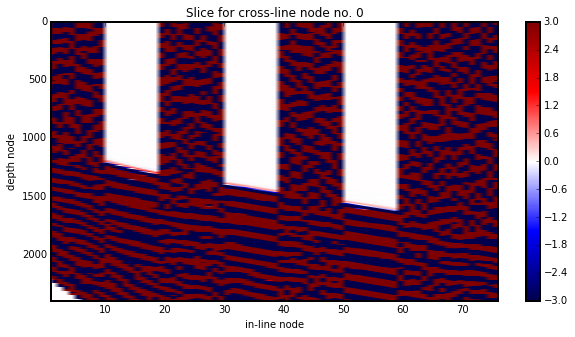

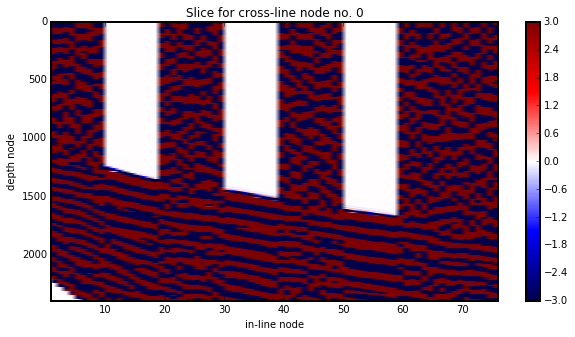

In [139]:
path = '/media/kmc3817/DATADRIVE1/heavy_PhD/PROJECTS/jm_checkerboard/phase-comparisons/old_lines/'

OBS = '160'
line = '26'
a = 3
fig_size = [10,5]

#### Jo's
file1 = path + '4' + OBS + 'obs_line' + line + '.vtr'
file2 = path + '4' + OBS + 'syn_line' + line + '.vtr'
Plot_Gridded_Data_From_File(file1, file2=file2, cmap='seismic', fig_size=fig_size, norm='rms', minn=-a, maxx=a)

#### Mine
file1 = path + '4' + OBS + 'obs_line' + line + '.vtr'
file2 = proj_path + '../output/proj18-Synthetic_4' + OBS + '_' + line + '.vtr'
Plot_Gridded_Data_From_File(file1, file2=file2, cmap='seismic', fig_size=fig_size, norm='rms', minn=-a, maxx=a)

#### Wavefield

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-fw-000900-csref04160-iter00001-taskid00001.vtr
lib_fwi_generic.py/Read_vtr: min value:  -156.02
lib_fwi_generic.py/Read_vtr: max value:  156.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


0

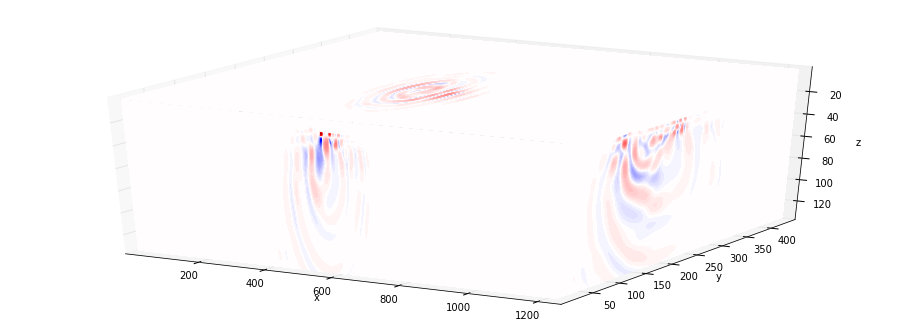

In [39]:
xcoord = 620
ycoord = 220
zcoord = 50
Plot_Gridded_Data_From_File(proj_path+'proj24-fw-000900-csref04160-iter00001-taskid00001.vtr', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cmap='seismic', cbar=0)

In [91]:
from lib_fwi_model import Model_Modify_Extend
from lib_fwi_generic import Set_Extra_Nodes

prefix = proj_path + proj_name
n1, n2, n3, model = Read_vtr(prefix + '-TrueVp.vtr')
etop, eleft, efront = Set_Extra_Nodes(prefix + '-Runfile.key')

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Runfile.key
lib_fwi_generic.py/Set_Extra_Nodes:  extratop, extraleft, extrafront 2.0 20.0 20.0


In [110]:
nm = Model_Modify_Extend(proj_path+proj_name, model)
print nm.shape

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-Runfile.key
lib_fwi_generic.py/Set_Extra_Nodes:  extratop, extraleft, extrafront 2 20 20
lib_fwi_generic.py/Set_Extra_Nodes:  extrabot, extraright, extraback 20 20 20
lib_fwi_model.py/Model_Modify_Extend:  etop, eleft, efront, ebot, eright, eback 2 20 20 20 20 20
(1241, 441, 135)


In [117]:
# Plot_Project_Output(proj_name, shot_id='4160', fw=True, gather=False, plot_fs=True, file_min=6, file_max=6, slice_coord='y', coord_value=ycoord, aspect='equal', fig_size=[25,10], xlim=[400,800])

lib_fwi_generic.py/Read_geo:  File to read:  ./proj24-Sources.geo
lib_fwi_generic.py/Read_geo:  File to read:  ./proj24-Receivers.geo
lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj24-Runfile.key
lib_fwi_generic.py/Set_Extra_Nodes:  extratop, extraleft, extrafront 2 20 20
lib_fwi_generic.py/Set_Extra_Nodes:  extrabot, extraright, extraback 20 20 20
libplot_fwi_generic.py/Plot_Wavefield_Propagation:  shift_x, shift_y, shift_z 0 0 0
lib_fwi_generic.py/Read_vtr:  File:  ./proj24-FreeSurf_exten.vtr


lib_fwi_generic.py/SR_Modify_Adapt_To_Extras: Warning. Adjusting sources & receivers.


lib_fwi_generic.py/Read_vtr: min value:  7.35126
lib_fwi_generic.py/Read_vtr: max value:  14.5
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 1
lib_fwi_generic.py/Read_vtr:  File:  ./proj24-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj24-Runfile.key
lib_fwi_generic.py/Set_Extra_Nodes:  extratop, extraleft, extrafront 2 20 20
lib_fwi_generic.py/Set_Extra_Nodes:  extrabot, extraright, extraback 20 20 20
lib_fwi_model.py/Model_Modify_Extend:  etop, eleft, efront, ebot, eright, eback 2 20 20 20 20 20
lib_fwi_generic.py/Wavefield_Extract_Shot_ID:  shot_id 4160
libplot_fwi_generic.py/Plot_Wavefield_Propagation:  shift_x 0
libplot_fwi_generic.py/Plot_Wavefield_Propagation:  shift_y=shift_z 0
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24_fw_startmo

libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr: min value:  -81.0408
lib_fwi_generic.py/Read_vtr: max value:  101.562
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


0

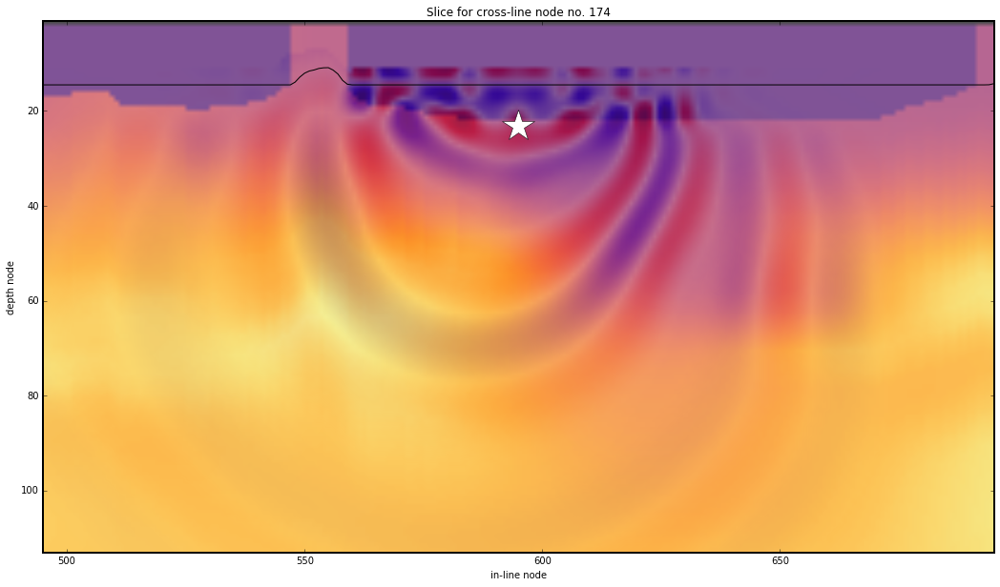

In [255]:
fnames = Get_Files(proj_path+'../output/proj24_fw_startmod/', proj_name + '*fw*160*vtr')
# shift_x, shift_y, shift_z = 0, 0, 0
# ycoord = 174
Plot_Wavefield_Propagation(proj_name, fnames, dx=50, plot_fs=True, plot_mod=True, file_min=6, file_max=6, aspect='equal', fig_size=[25,10], ylim=[1,113])#, xlim=[400,800])

### Inv

In [245]:
path = '../output/'
fnames = Get_Files(path, proj_name+'*CP*sgy')
# print fnames
# for fname in fnames:
#     !cd {path} && sgy2vtr.sh {fname} {nx1}

#### Automated

#### Models

In [257]:
print xcoord, ycoord, zcoord

620 174 50


620 174 50
lib_fwi_generic.py/Read_vtr:  File:  proj24-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


0

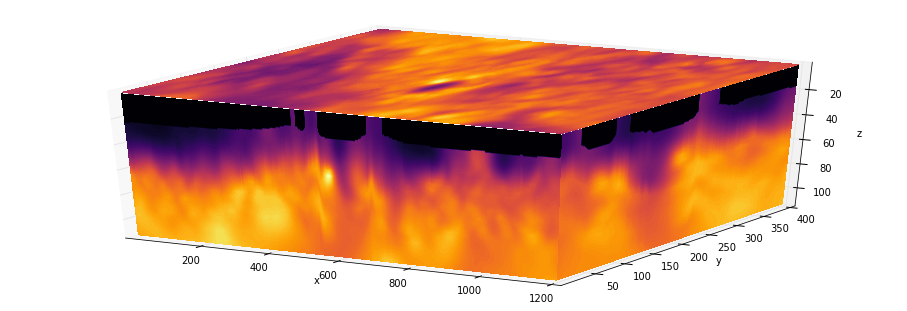

In [260]:
print xcoord, ycoord, zcoord
Plot_Gridded_Data_From_File('proj24-TrueVp.vtr', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

620 174 50
lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7606.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


0

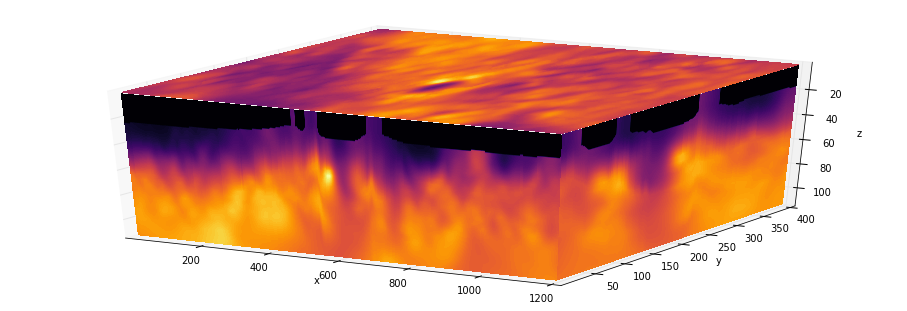

In [258]:
print xcoord, ycoord, zcoord
Plot_Gridded_Data_From_File('../output/proj24-CP00013-Vp.vtr', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

In [1]:
# print xcoord, ycoord, zcoord
# Plot_Gridded_Data_From_File('../output/proj24it13-CP00013-Vp.vtr', data_type='model', plot_type='cube', slices=[xcoord,ycoord,zcoord], cbar=0)

In [2]:
# print xcoord, ycoord, zcoord
# Plot_Gridded_Data_From_File('proj24-StartVp.vtr', slice_coord='x', coord_value=xcoord, data_type='model', cbar=0, aspect='equal')

620 174 50
lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


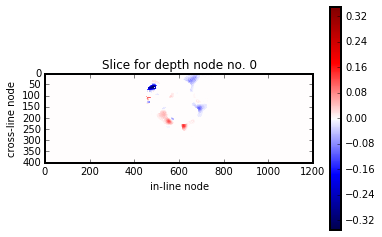

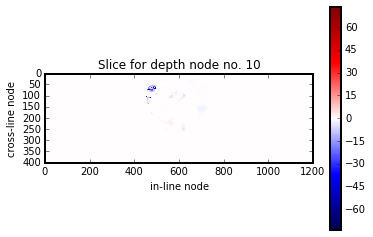

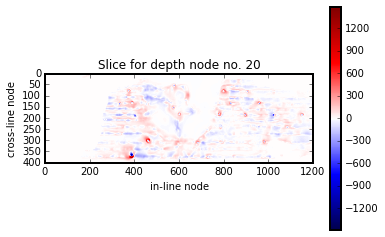

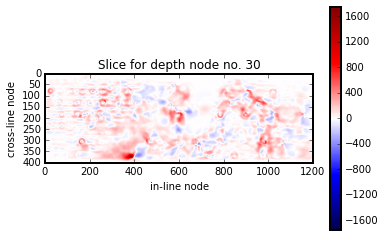

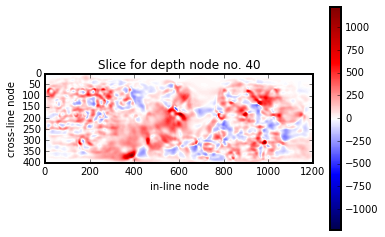

...

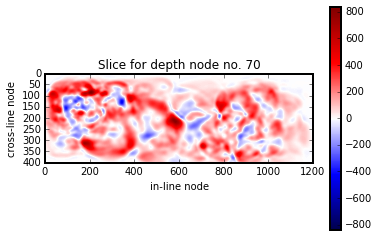

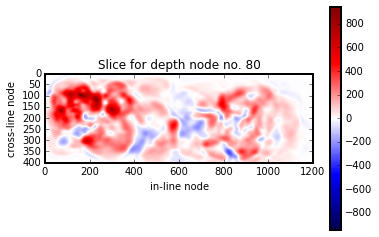

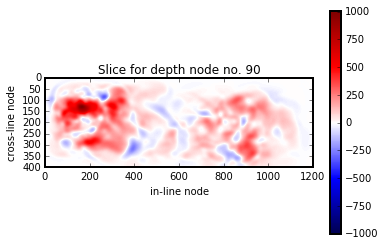

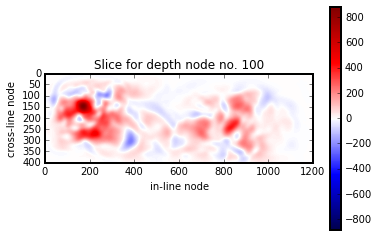

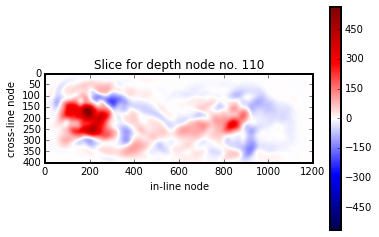

In [278]:
print xcoord, ycoord, zcoord
for z in range(0,113,10):
    plt.figure()
    Plot_Gridded_Data_From_File('../output/proj24it13-CP00013-Vp.vtr', file2='proj24-StartVp.vtr', juxt='diff', slice_coord='z', coord_value=z, data_type='model', cbar=1, aspect='equal')

620 174 50
lib_fwi_generic.py/Read_vtr:  File:  ../output/proj24it13-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7633.9
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.


0

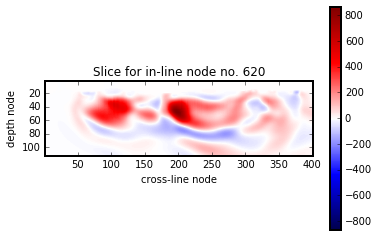

In [271]:
print xcoord, ycoord, zcoord
Plot_Gridded_Data_From_File('../output/proj24it13-CP00013-Vp.vtr', file2='proj24-StartVp.vtr', juxt='diff', slice_coord='x', coord_value=xcoord, data_type='model', cbar=1, aspect='equal')

#### proj24cp1 and proj24cp13 (after first and last iteration of the inversion)

In [239]:
proj_name = 'proj24cp1'
!ls {proj_name}*
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', q='mrwarn', hours=3, max_ram=2, nnodes=6, nprocesses=8)

proj24CP1-FreeSurf.vtr	   proj24CP1-Runfile_synth.key	proj24CP1-Sources.geo
proj24CP1-GhostData.bin    proj24CP1-Run.pbs		proj24CP1-StartVp.sgy
proj24CP1-Receivers.geo    proj24CP1-Signature.idx	proj24CP1-Template.idx
proj24CP1-Runfile_inv.key  proj24CP1-Signature.sgy	proj24CP1-Template.sgy
proj24CP1-Runfile.key	   proj24CP1-Skeleton.key	proj24CP1-TrueVp.sgy


In [242]:
proj_name = 'proj24cp13'
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', q='mrwarn', hours=3, max_ram=2, nnodes=6, nprocesses=8)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj24cp13

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj24cp13
#PBS -o proj24cp13-Out.log
#PBS -e proj24cp13-Err.log
#PBS -l walltime=03:00:00
#PBS -l select=6:mpiprocs=8:ompthreads=5:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

# PROJECT INFO
project_name=proj24cp13

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=5 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=2 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 
export SCHEDULER_DUMPRAWGRAD="yes"
export SLAVES_ERRSTREAM=stderr # DEFAULT IS stdout 

# LOAD MODULES
module load mpi
module lo

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40 and mem_gb to 128


0

#### proj24it13cp1 and proj24it13cp13 (after first and last iteration of the inversion)

In [244]:
proj_name = 'proj24it13cp1'
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', q='mrwarn', hours=3, max_ram=2, nnodes=6, nprocesses=8)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj24it13cp1

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj24it13cp1
#PBS -o proj24it13cp1-Out.log
#PBS -e proj24it13cp1-Err.log
#PBS -l walltime=03:00:00
#PBS -l select=6:mpiprocs=8:ompthreads=5:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

# PROJECT INFO
project_name=proj24it13cp1

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=5 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=2 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 
export SCHEDULER_DUMPRAWGRAD="yes"
export SLAVES_ERRSTREAM=stderr # DEFAULT IS stdout 

# LOAD MODULES
module loa

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40 and mem_gb to 128


0

In [243]:
proj_name = 'proj24it13cp13'
PBS_Script_Create(proj_name, problem='synth', code='rev688_test', q='mrwarn', hours=3, max_ram=2, nnodes=6, nprocesses=8)

proj24it13cp13-FreeSurf.vtr	  proj24it13cp13-Signature.idx
proj24it13cp13-GhostData.bin	  proj24it13cp13-Signature.sgy
proj24it13cp13-Receivers.geo	  proj24it13cp13-Skeleton.key
proj24it13cp13-Runfile_inv.key	  proj24it13cp13-Sources.geo
proj24it13cp13-Runfile.key	  proj24it13cp13-StartVp.sgy
proj24it13cp13-Runfile_synth.key  proj24it13cp13-Template.sgy
proj24it13cp13-Run.pbs		  proj24it13cp13-TrueVp.sgy
lib_fwi_generic.py/PBS_Script_Create: proj_name: proj24it13cp13

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj24it13cp13
#PBS -o proj24it13cp13-Out.log
#PBS -e proj24it13cp13-Err.log
#PBS -l walltime=03:00:00
#PBS -l select=6:mpiprocs=8:ompthreads=5:ncpus=40:mem=128gb
#PBS -l place=scatter:excl

# PROJECT INFO
project_name=proj24it13cp13

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHR

lib_fwi_generic.py/PBS_Script_Create: Warning. Automatically setting ncpus to 40 and mem_gb to 128


0

#### Old

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

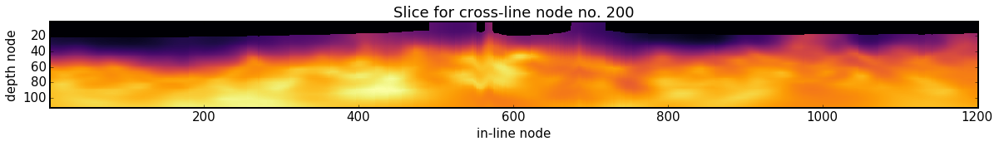

In [112]:
Plot_Gridded_Data_From_File(proj_path+'proj24-StartVp.vtr', aspect='equal', cbar=0, fig_size=[20,10])

In [141]:
print nx1, nx3

1201 113


In [155]:
fnames = Get_Files(path, proj_name+'-CP*vtr')

for fname in fnames:
    for coord, val in zip(['x', 'z'], [nx1/2, nx3/2]):    
        Plot_Gridded_Data_From_File(fname, aspect='equal', slice_coord=coord, coord_value=val, cbar=0, fig_size=[20,10])
        plt.savefig(fname[ :-len('.vtr')]+'_'+coord+'slice.png')
        plt.close()

lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00001-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7343.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00001-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7343.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00002-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00179576
lib_fwi_generic.py/Read_vtr: max value:  0.00246937
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00002-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00179576
lib_fwi_generic.py/Read_vtr: max value:  0.00246937
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00002-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7440.17
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00002-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7440.17
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00003-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00183135
lib_fwi_generic.py/Read_vtr: max value:  0.00229672
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00003-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00183135
lib_fwi_generic.py/Read_vtr: max value:  0.00229672
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00003-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7539.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00003-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7539.02
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00004-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00150767
lib_fwi_generic.py/Read_vtr: max value:  0.00281717
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00004-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00150767
lib_fwi_generic.py/Read_vtr: max value:  0.00281717
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


135
lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00004-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7527.41
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00004-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7527.41
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00005-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00156649
lib_fwi_generic.py/Read_vtr: max value:  0.00329974
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00005-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00156649
lib_fwi_generic.py/Read_vtr: max value:  0.00329974
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 135
lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00005-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7523.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00005-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7523.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00006-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00140622
lib_fwi_generic.py/Read_vtr: max value:  0.00320785
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00006-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00140622
lib_fwi_generic.py/Read_vtr: max value:  0.00320785
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00006-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.82
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00006-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.82
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00007-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00140467
lib_fwi_generic.py/Read_vtr: max value:  0.00323235
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00007-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00140467
lib_fwi_generic.py/Read_vtr: max value:  0.00323235
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00007-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00007-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00008-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00136271
lib_fwi_generic.py/Read_vtr: max value:  0.00322913
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00008-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00136271
lib_fwi_generic.py/Read_vtr: max value:  0.00322913
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 135
lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00008-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.69
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00008-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.69
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00009-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00136327
lib_fwi_generic.py/Read_vtr: max value:  0.00322992
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00009-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00136327
lib_fwi_generic.py/Read_vtr: max value:  0.00322992
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00009-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00009-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.59
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00010-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00136226
lib_fwi_generic.py/Read_vtr: max value:  0.00322857
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00010-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00136226
lib_fwi_generic.py/Read_vtr: max value:  0.00322857
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3: 

libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


 1241 441 135
lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00010-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.65
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00010-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.65
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00011-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00195996
lib_fwi_generic.py/Read_vtr: max value:  0.00354146
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00011-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00195996
lib_fwi_generic.py/Read_vtr: max value:  0.00354146
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00011-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7549.37
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00011-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7549.37
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00012-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00227753
lib_fwi_generic.py/Read_vtr: max value:  0.00303872
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00012-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00227753
lib_fwi_generic.py/Read_vtr: max value:  0.00303872
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00012-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7601.92
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00012-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7601.92
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00013-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00176614
lib_fwi_generic.py/Read_vtr: max value:  0.00338565
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00013-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00176614
lib_fwi_generic.py/Read_vtr: max value:  0.00338565
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7606.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  ../output//proj24-CP00013-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7606.94
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00007-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

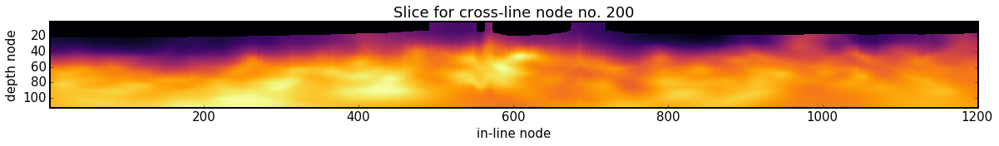

In [110]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00007-Vp.vtr', aspect='equal', cbar=0, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00007-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.62
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

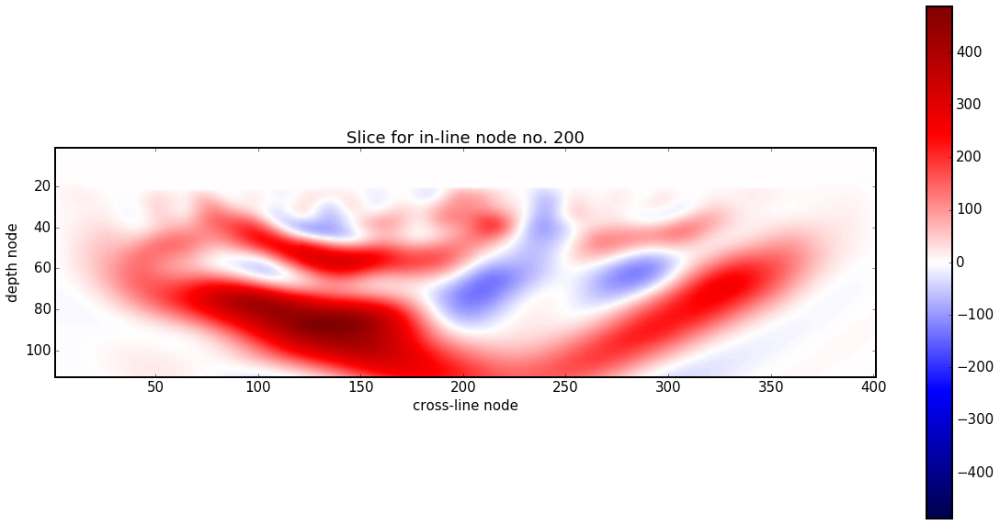

In [144]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00007-Vp.vtr', file2=proj_path+'proj24-StartVp.vtr', juxt='diff', aspect='equal', slice_coord='x', fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00006-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00140622
lib_fwi_generic.py/Read_vtr: max value:  0.00320785
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

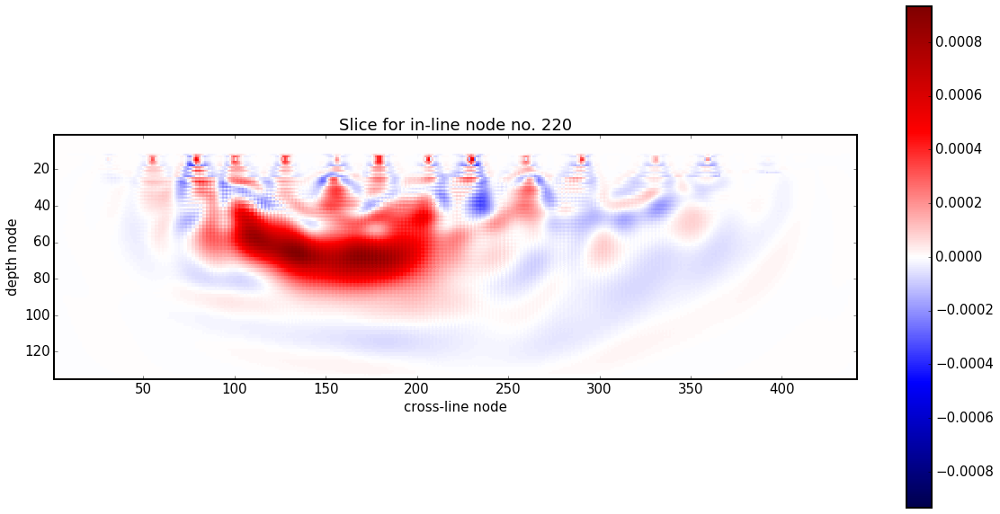

In [146]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00006-RawGrad.vtr', cmap='seismic', slice_coord='x', aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

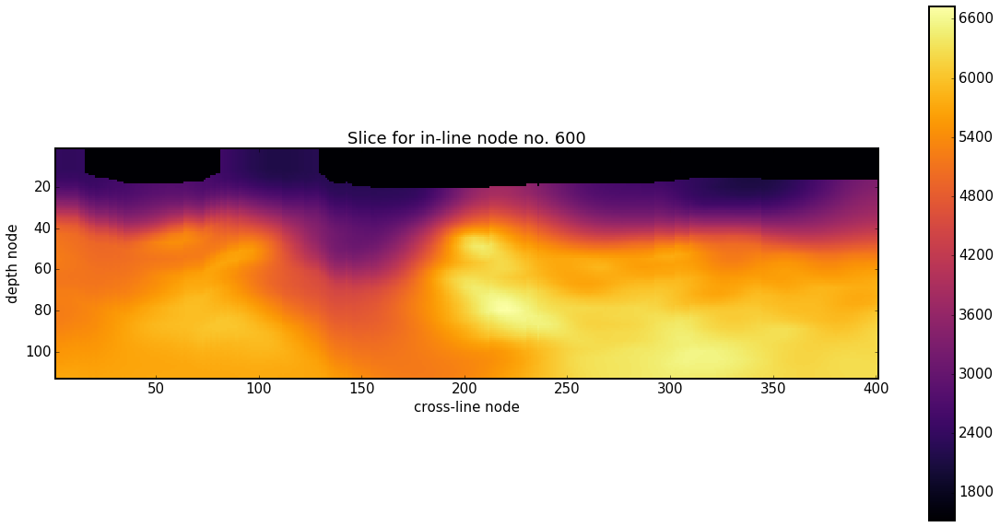

In [153]:
Plot_Gridded_Data_From_File(proj_path+proj_name+'-StartVp.vtr', slice_coord='x', coord_value=nx1/2, aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00006-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7522.82
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

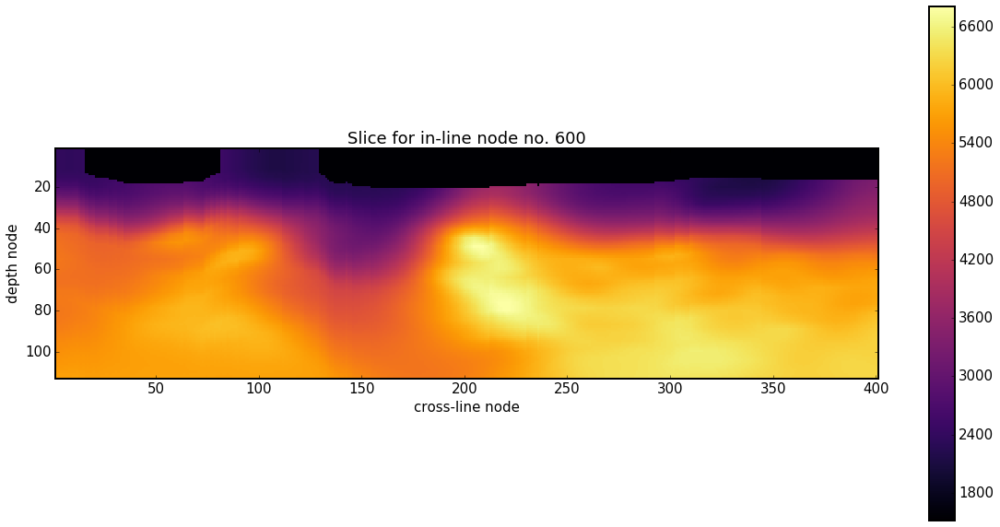

In [152]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00006-Vp.vtr', slice_coord='x', coord_value=nx1/2, aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

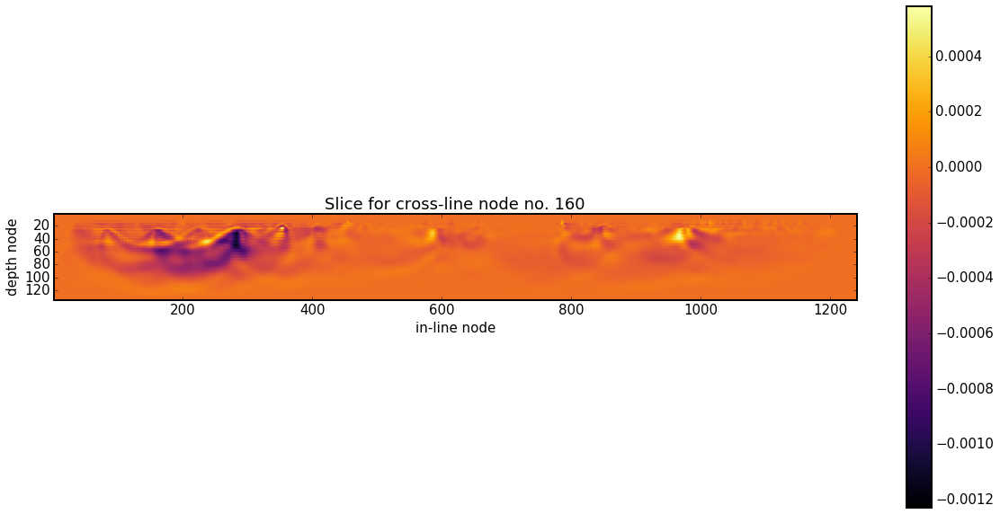

In [172]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00001-RawGrad.vtr', slice_coord='y', coord_value=160, aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

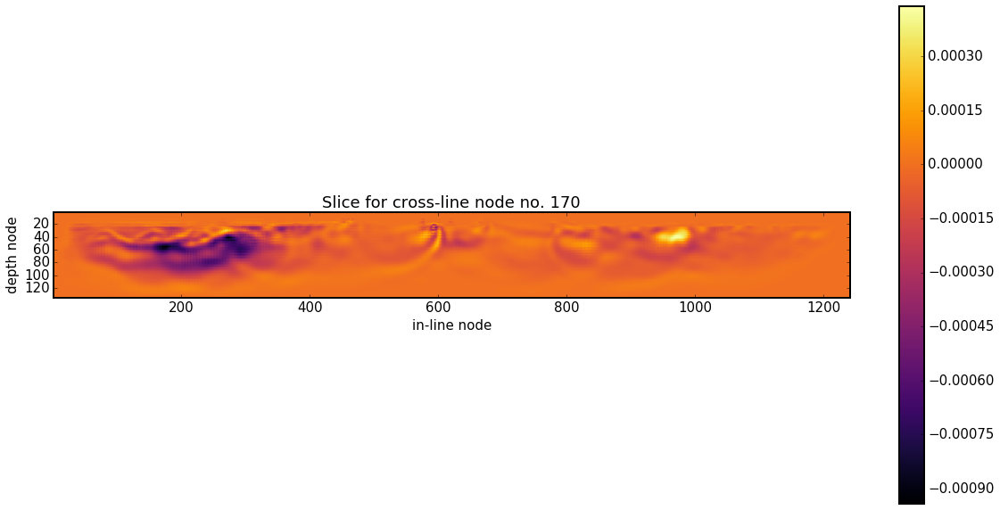

In [171]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00001-RawGrad.vtr', slice_coord='y', coord_value=170, aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

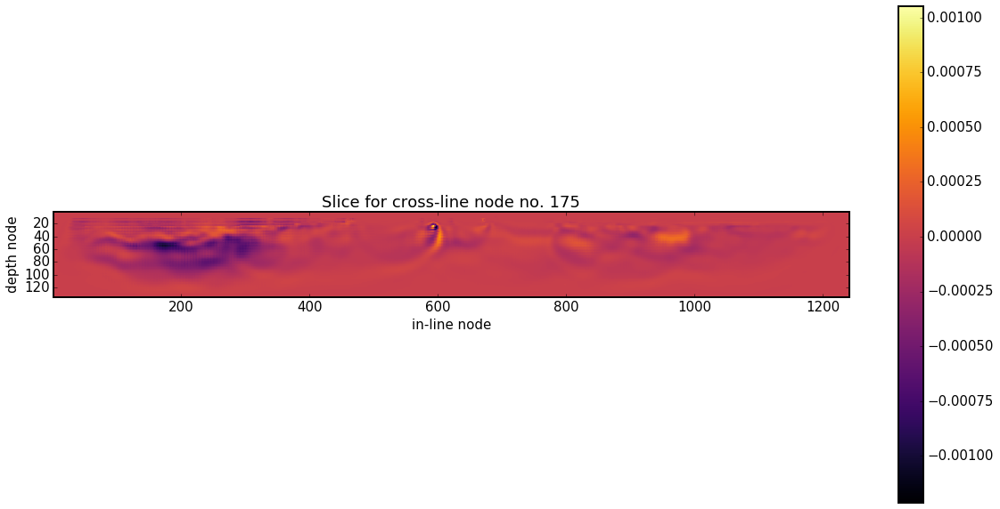

In [169]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00001-RawGrad.vtr', slice_coord='y', coord_value=175, aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

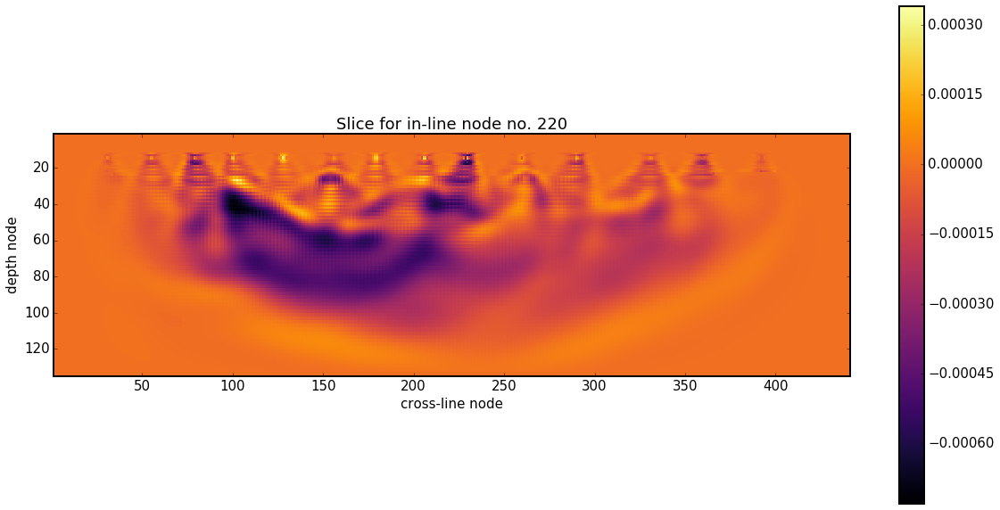

In [160]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00001-RawGrad.vtr', slice_coord='x', aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj27-CP00001-RawGrad.vtr
lib_fwi_generic.py/Read_vtr: min value:  -0.00270107
lib_fwi_generic.py/Read_vtr: max value:  0.00189532
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1241 441 135


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

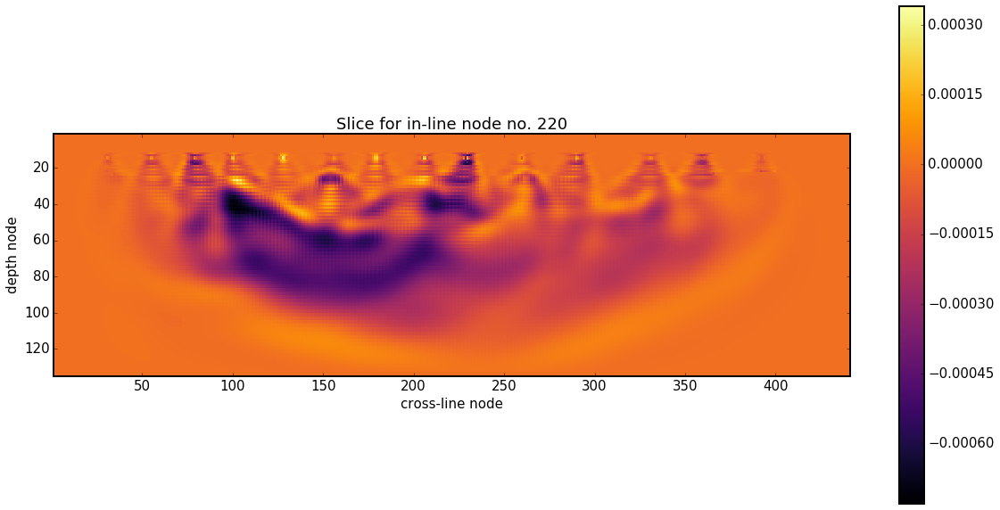

In [158]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj27-CP00001-RawGrad.vtr', slice_coord='x', aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24-CP00001-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7343.44
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

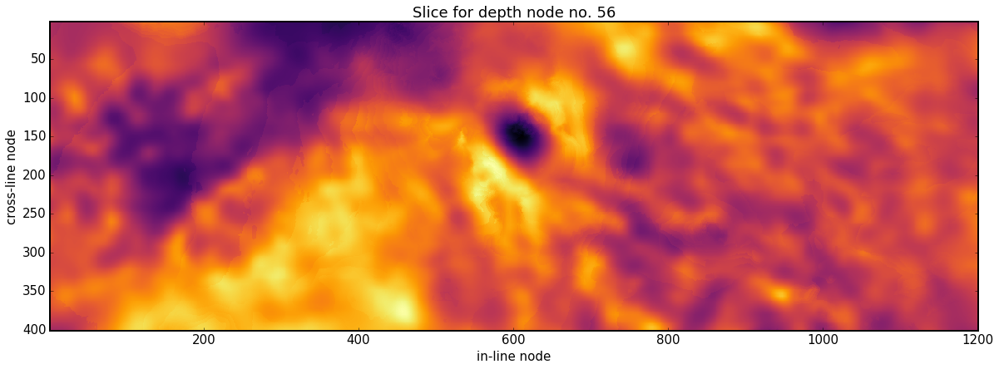

In [164]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24-CP00001-Vp.vtr', slice_coord='z', aspect='equal', coord_value=nx3/2, cbar=0, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj27-CP00001-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7313.18
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


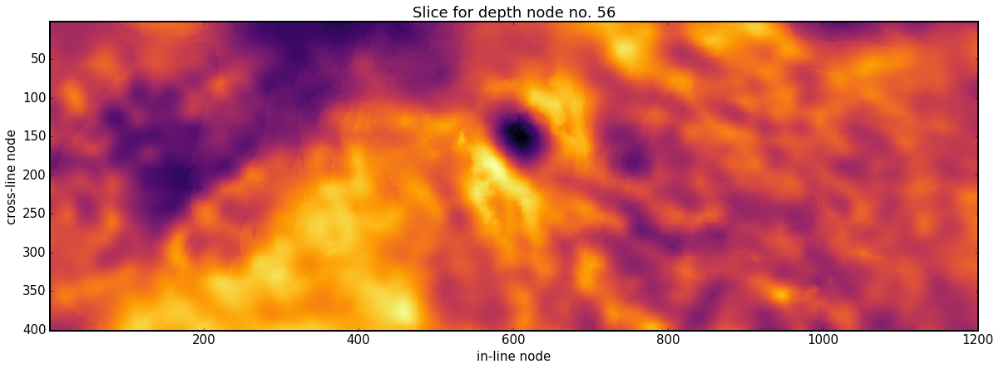

In [168]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj27-CP00001-Vp.vtr', slice_coord='z', aspect='equal', coord_value=nx3/2, cbar=0, fig_size=[20,10])
plt.savefig('../output/proj27-CP00001-Vp.png')

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj27-CP00001-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7313.18
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

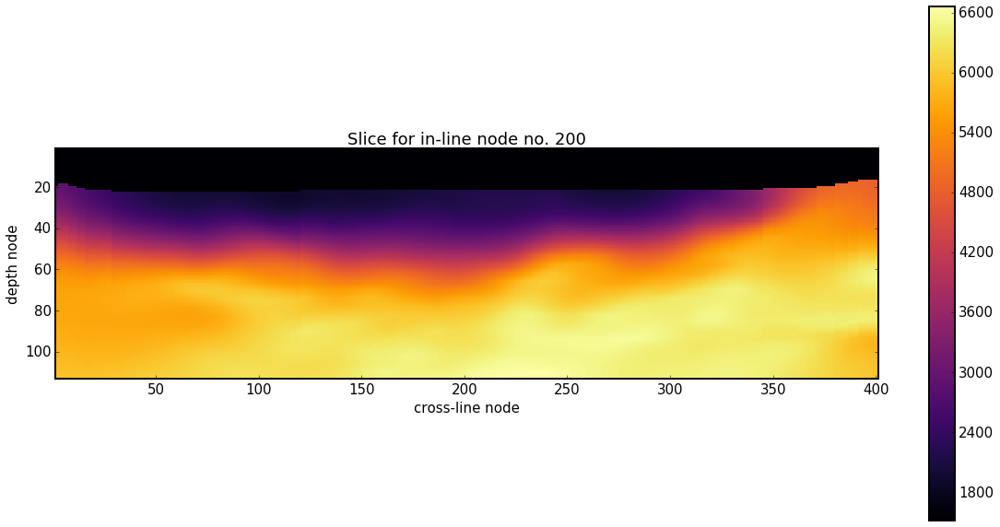

In [161]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj27-CP00001-Vp.vtr', slice_coord='x', aspect='equal', cbar=1, fig_size=[20,10])
# slice_coord=coord, coord_value=val

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

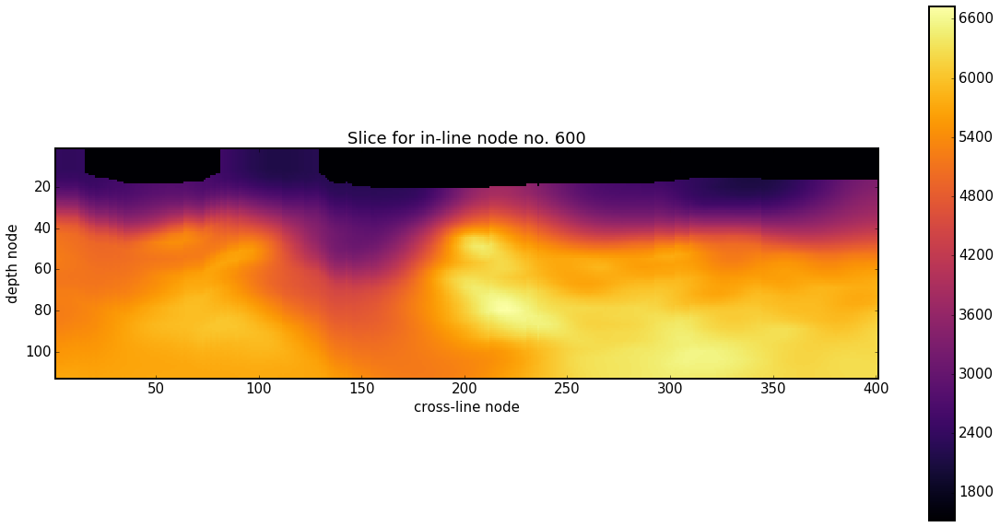

In [175]:
Plot_Gridded_Data_From_File(proj_path+proj_name+'-StartVp.vtr', slice_coord='x', coord_value=nx1/2, aspect='equal', cbar=1, fig_size=[20,10])

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24it13-CP00002-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7505.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

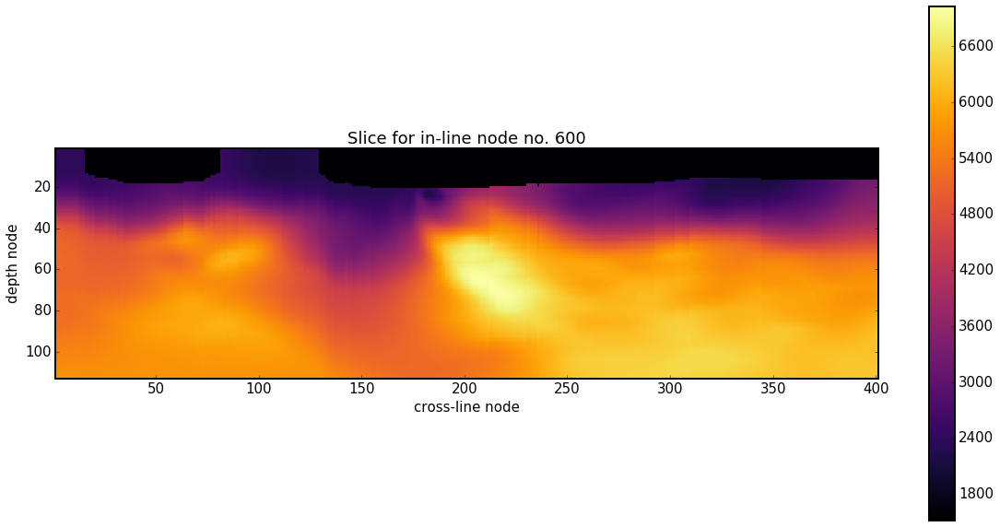

In [176]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24it13-CP00002-Vp.vtr', slice_coord='x', coord_value=nx1/2, aspect='equal', cbar=1, fig_size=[20,10])

# 'proj24it13-CP00001-Vp.sgy'

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/../output/proj24it13-CP00002-Vp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7505.3
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


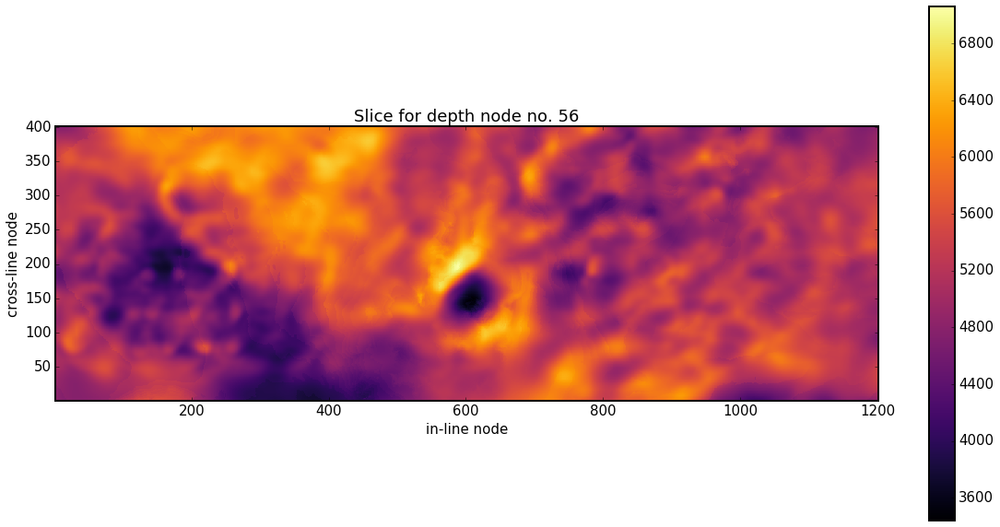

In [181]:
Plot_Gridded_Data_From_File(proj_path+'../output/proj24it13-CP00002-Vp.vtr', slice_coord='z', coord_value=nx3/2, aspect='equal', cbar=1, fig_size=[20,10])
plt.gca().invert_yaxis()

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj24-StartVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  1201 401 113


libplot_generic.py/Plot_Gridded_Data: Warning. data_type not specified - assuming 'model'. 
libplot_fwi_generic.py/Plot_Model_3D: Warning. plot_type not specified - assuming 'slice'.
libplot_generic.py/Plot_Slice: Warning. data_type not specified - assuming 'model'. 


0

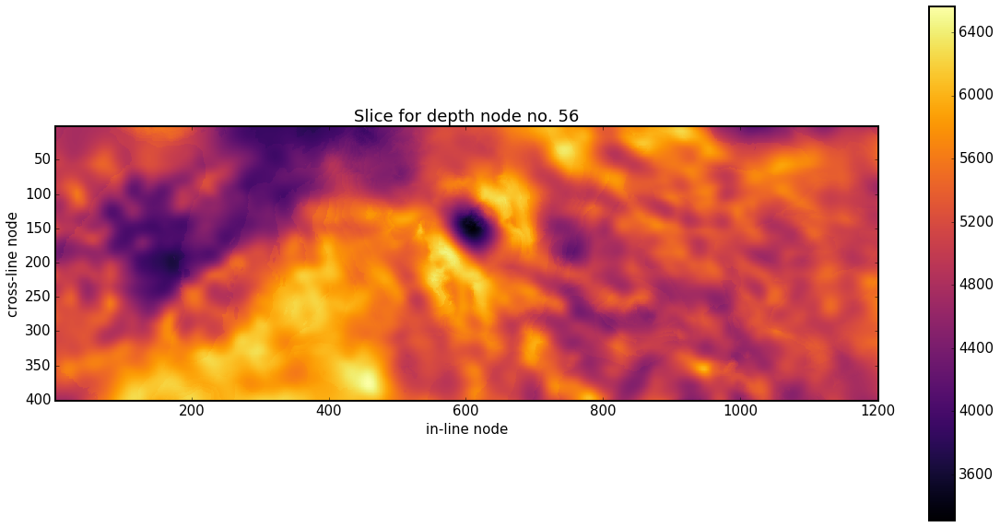

In [180]:
Plot_Gridded_Data_From_File(proj_path+'/proj24-StartVp.vtr', slice_coord='z', coord_value=nx3/2, aspect='equal', cbar=1, fig_size=[20,10])

# Proj 25 (-||- but smaller model)

In [32]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj25'
# !cd "{proj_path}" && pwd

## Input

### Model

#### Prepare

In [33]:
# SPACE-TIME DISCRETIZATION
dx = 50.000 # m
dt = 0.0025 # s
dt_ms = dt * 1000 # ms

# READ THE META DATA
gx_list, gy_list, sx_list, sy_list, obs_list, shot_lines = Read_FWI_Project_Meta_Data(meta_path)

# XY RANGES 
x1_box = -15e3 
x2_box = 15e3 
y1_box = -5e3 
y2_box =  10e3

# ROUNDING DOWN
x1_box, x2_box, y1_box, y2_box = [int(i / dx) * int(dx) for i in [x1_box, x2_box, y1_box, y2_box]]
print 'x1_box, x2_box, y1_box, y2_box', x1_box, x2_box, y1_box, y2_box
# NOTE: z IS YET TO BE DETERMINED

# PHYSICAL DIMENSIONS OF THE SPACE-TIME [meters, seconds]
mx1 = x2_box - x1_box # m 
mx2 = y2_box - y1_box # m
mx3 = (131 - 1) * dx # m # 131 IS NX3 OF THE MODEL FROM UO
ttime = 15 # s # 10 IS NOT ENOUGH TO INCLUDE ALL MANUAL PICKS!

# METRES->NODES CONVERSION
nx1 = int(mx1 / dx) + 1
nx2 = int(mx2 / dx) + 1
nx3_original = int(mx3 / dx) + 1
ns = int(ttime / dt)

print 'nx1', nx1
print 'nx2', nx2
print 'nx3_original', nx3_original
print 'ns', ns

# PLOTTING
minn = 0
maxx = 8000

lib_fwi_project.py/Read_OBS_Data:  No. of stations in current dataset:  89
lib_fwi_project.py/Read_OBS_Data:  Total no. of shot lines len(shot_lines):  52
x1_box, x2_box, y1_box, y2_box -15000 15000 -5000 10000
nx1 601
nx2 301
nx3_original 131
ns 6000


##### Cut in both XY and Z

In [38]:
# # CUT IN XY
# cut_mod_path = mod_path 
# cut_mod_file = mod_file[ : -len('.sgy')] + '_x' + str(x1_box) + '_' + str(x2_box) + '_y' + str(y1_box) + '_' + str(y2_box) + '.sgy'
# !segyread tape="{mod_path}"{mod_file} | suwind key=sx min={x1_box} max={x2_box} | suwind key=sy min={y1_box} max={y2_box} | segyhdrs | segywrite tape="{cut_mod_path}"{cut_mod_file}
# # !ls "{cut_mod_path}"{cut_mod_file}

# !cp "{cut_mod_path}"{cut_mod_file} "{proj_path}"/{proj_name}'-TrueVp.sgy'

# # FULL CONVERSION sgy TO vtr
# !cd "{proj_path}" && convert_sgy2vtr.sh {nx1} {nx2} {nx3_original} {proj_name}'-TrueVp.sgy'

# # CUT IN Z (MUST BE PROCEEDED WITH XY-CUTTING EVERY TIME)
# fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
# nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

v_air_ben = 0 
z_pad = 5
topo_min = Model_Check_Highest_Topo(model, v_air_ben)
z_min = topo_min[-1] - z_pad
print 'z_min', z_min

nx3 = nx3_original - z_min # IMPORTANT!
print 'nx3 after the cut(!= nx3_original)', nx3

zcut_model = np.array([[j[z_min : z_min + nx3_original] for j in i] for i in model]) # NEEDS ORIGINAL INPUT EVERY TIME
print 'zcut_model.shape', zcut_model.shape

!cd "{proj_path}" && cp {proj_name}'-TrueVp.vtr' {proj_name}'-TrueVp_uncut.vtr'
fname_core = proj_path + proj_name + '-TrueVp_zcut'
Save_vtr(fname_core, nx1, nx2, nx3, zcut_model)
!cd "{proj_path}" && cp "{fname_core}".vtr {proj_name}'-TrueVp.vtr'

topo_min (=highest peak) coordinates (x, y, z): [365  15  23]
z_min 18
nx3 after the cut(!= nx3_original) 113
zcut_model.shape (601, 301, 113)
lib_fwi_generic.py/Save_vtr: File to save:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj25-TrueVp_zcut.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 301 601


##### Determine the sea level

- free surface can only be determined from the model with the accuracy dx
- any value between n_air (no. of nodes of air) and (n_air+dx) is then equally justified
- therefore natural seems to be the choice of z_sea = n_air + 0.5*dx
- spread_bounce, however, requires integer values of FS => z_sea = n_air or z_sea = n_air + dx
- inspection of synthetics can help choosing one of the two.

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 113
There are 12 grid cells of air. First cell of water is a 13 th cell of the grid (counting from 1).


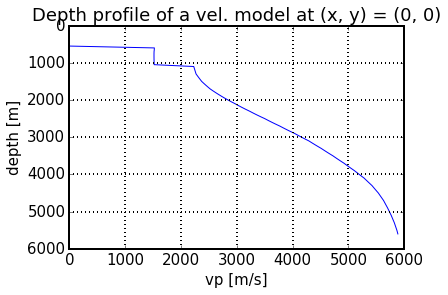

In [39]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

sea_x, sea_y = 0, 0
sea_xy = model[sea_x][sea_y] # THIS IS OFFSHORE (SEE PLOTS OF FS AND A PLOT BELOW)

x = np.array(range(len(sea_xy))) * dx
plt.plot(sea_xy, x)
plt.gca().invert_yaxis()
plt.xlabel('vp [m/s]')
plt.ylabel('depth [m]')
plt.title('Depth profile of a vel. model at (x, y) = (' + str(sea_x) + ', ' + str(sea_y) + ')')
plt.grid()

for i, v in enumerate(sea_xy):
    if v != 0:
        break
z_sea = i
print 'There are', z_sea - 1 + 1, 'grid cells of air. First cell of water is a', z_sea + 1, 'th cell of the grid (counting from 1).'

##### Fill the gaps below finer FS with non-air velocities

- apparently in Ben's model there are rock-gaps below FS due to coarser sampling (200 m) of FS used in tomography 

In [46]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

model = Model_Modify_Fill_Gaps(model, v_air_ben, proj_name)

# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0] # FIXME: NEEDS FS 
# nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

# for ix in range(nx1_mod):
#     for iy in range(nx2_mod):
#         for iz in np.arange(nx3_mod-1, -1, -1):
#             if (iz + 1) >= fs_z[ix][iy][0]:
#                 if model[ix][iy][iz] == 0:
#                     #print ix + 1, iy + 1, iz + 1, fs_z[ix][iy][0] 
#                     model[ix][iy][iz] = model[ix][iy][iz+1]
                    
fname_core = proj_path + proj_name + '-TrueVp'
Save_vtr(fname_core, nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 113
lib_fwi_generic.py/Read_vtr:  File:  .//proj25-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  4.85126
lib_fwi_generic.py/Read_vtr: max value:  12.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 1
lib_fwi_generic.py/Save_vtr: File to save:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj25-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 301 601


0

###### Plot

In [37]:
# fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]

# # plt.figure(figsize=[20, 10]) # 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'
# Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', yslice=ycoord)
# fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
# Plot_Gridded_Data_From_File(fname, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
# plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THE CANCEL OUT FOR FS & model
# plt.xlim(375, 384)
# plt.ylim(13, 11)
# plt.grid()

##### Set air velocity

- extrapolate above FS to avoid, just in case, possible 'air leaks' below FS
- it needs to be done after two previous steps because we exploit the v_air_ben = 0.

In [48]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
nx1_mod, nx2_mod, nx3_mod, model = Read_vtr(fname)

model = Model_Modify_Set_Air_Vel(model, v_air_ben, 'extrapol')
        
Save_vtr(proj_path + proj_name + '-TrueVp', nx1_mod, nx2_mod, nx3_mod, model)

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  0.0
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 113
lib_fwi_generic.py/Save_vtr: File to save:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj25-TrueVp.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  113 301 601


0

##### Convert vtr2segy

In [63]:
# !cd "{proj_path}" && vtr2sgy # DO IT IN THE CONSOLE INSTEAD

fname = proj_name + '-TrueVp.sgy'
fname_tmp = fname + '_tmp' # OTHERWISE SU FAILS TO SAVE CORRECTLY
!cd "{proj_path}" && sgyread.sh {fname} | sushw key=dt,ns a={int(dx)},{nx3} | segyhdrs | segywrite tape={fname_tmp}
!cd "{proj_path}" && mv {fname_tmp} {fname}

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00171962 s, 1.9 MB/s
6+1 records in
1+0 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 9.798e-05 s, 32.7 MB/s


In [50]:
!cd "{proj_path}" && sgyread.sh proj12-TrueVp.sgy | suwind key=ep min={ycoord} max={ycoord} | suximage

3200+0 records in
6+1 records out
3200 bytes (3.2 kB, 3.1 KiB) copied, 0.00162112 s, 2.0 MB/s
XIO:  fatal IO error 11 (Resource temporarily unavailable) on X server ":0"
      after 3874 requests (3874 known processed) with 0 events remaining.


#### Plot

In [ ]:
# COLORMAPS: 'nipy_spectral' 'brg' 'gist_stern' 'gist_earth' 'gist_ncar'

300 150 56
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 113
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  4.85126
lib_fwi_generic.py/Read_vtr: max value:  12.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 1
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-TrueVp.vtr
lib_fwi_generic.py/Read_vtr: min value:  1517.41
lib_fwi_generic.py/Read_vtr: max value:  7213.48
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 113
lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  4.85126
lib_fwi_generic.py/Read_vtr: max

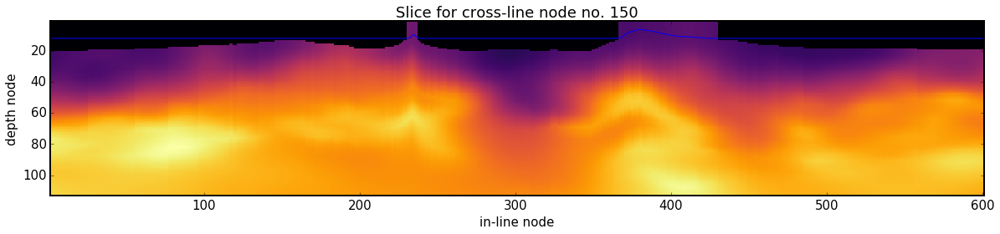

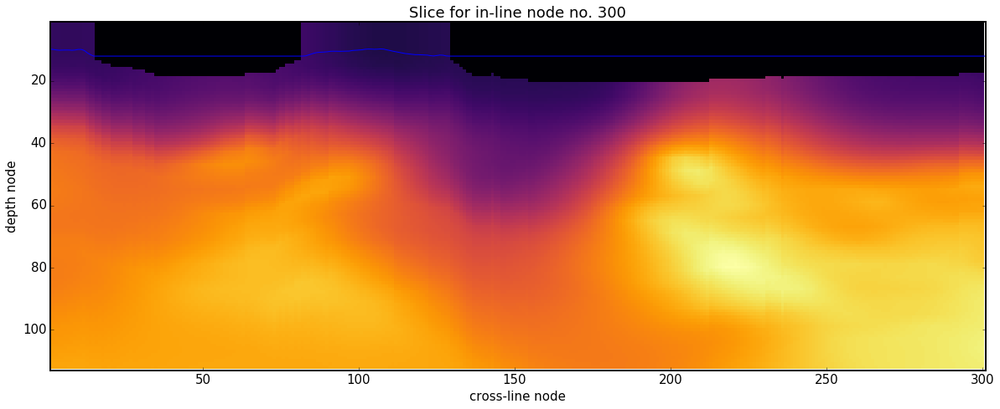

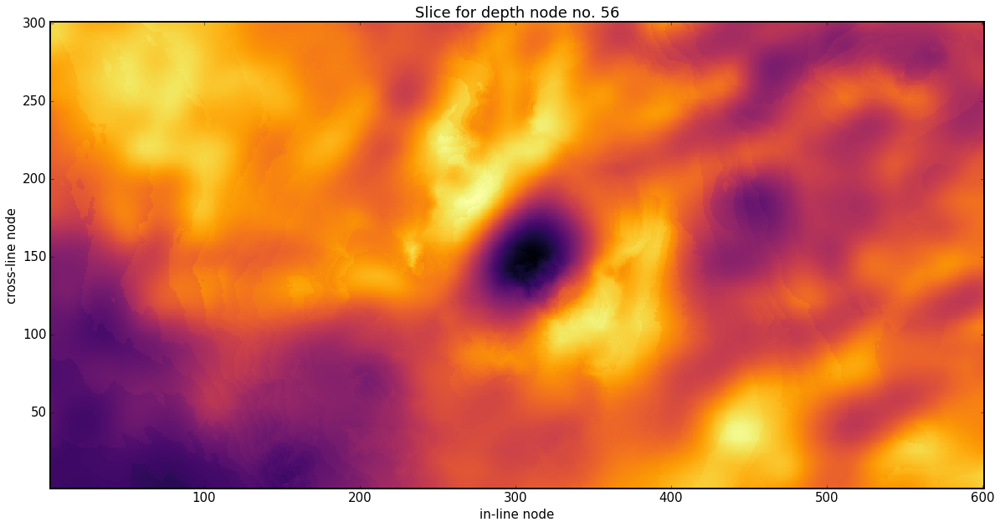

In [53]:
fname = Get_Files(proj_path, proj_name + '-TrueVp.vtr')[0]
fname_fs = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]

xcoord = nx1 / 2
ycoord = nx2 / 2
zcoord = nx3 / 2
print xcoord, ycoord, zcoord

# Y-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice', slice_coord='y', coord_value=ycoord, cbar=0)
Plot_Gridded_Data_From_File(fname_fs, data_type='FS', plot_type='slice',  slice_coord='y', coord_value=ycoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx1)
plt.ylim(nx3, 1)
plt.gca().set_aspect('equal')
    
# X-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice',  slice_coord='x', coord_value=xcoord, cbar=0)
Plot_Gridded_Data_From_File(fname_fs, data_type='FS', plot_type='slice',  slice_coord='x', coord_value=xcoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx2)
plt.ylim(nx3, 1)
plt.gca().set_aspect('equal')

# Z-SLICE
plt.figure(figsize=[20, 10])
Plot_Gridded_Data_From_File(fname, data_type='model', plot_type='slice',  slice_coord='z', coord_value=zcoord, cbar=0)
plt.gca().invert_yaxis() # MUST BE ADDED MANUALLY BECAUSE THEY CANCEL OUT FOR FS & model
plt.xlim(1, nx1)
plt.ylim(1, nx2)
plt.gca().set_aspect('equal')

### Free surface

- it needs z_sea => can't be before sect. 'Model'

#### Prepare

##### Cut in XY

In [42]:
fname_xyz = fs_file_grd[:-len('.grd')] + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
print fname_xyz

# !gmt grd2xyz "{fs_path}"{fs_file_grd} -R' '{x1_box}/{x2_box}/{y1_box}/{y2_box} > "{fs_path}"{fname_xyz}

santorini_merged_local_50_-15000_15000_-5000_10000.xyz


In [43]:
# AT THE MOMENT THERE IS NO gmt INSTALLED ON UBUNTU SO WE CAN'T RUN ABOVE CELL
# INSTEAD, HERE IS THE WORK-AROUND WHICH USES PREVIOUSLY CUT MODEL WHICH EMBRACES OUR BOX:

orig_fname_xyz = "santorini_merged_local_50_-60000_60000_-20000_20000.xyz"
fname = Get_Files(fs_path, orig_fname_xyz)[0]
c = Read_File(fname)

fname_xyz = 'santorini_merged_local_50' + '_' + str(x1_box) + '_' + str(x2_box) + '_' + str(y1_box) + '_' + str(y2_box) + '.xyz'
f = open(fs_path + fname_xyz, 'w')
print fname_xyz
for l in c:
    x = int(l[0])
    y = int(l[1])
    if x < x1_box or x > x2_box or y < y1_box or y > y2_box:
        continue
    line = ''
    for col in l:
        line += str(col) + ' '
    f.write(line + '\n')
    
f.close()

santorini_merged_local_50_-15000_15000_-5000_10000.xyz


In [32]:
# !cd "{fs_path}" && cat {fname_xyz}

##### Convert xyz2vtr

- this is not trivial; for details see the source code (lib_fwi_generic.py/Convert_xyz2vtr)
- among others, it needs to be provided with correct z_sea which is a Z coordinate of the sea surface in nodes
- it should be consistent with FS defined through air-velocity in the model file
- to ensure this, 2 things need to be considered:
    - FS of the model is defined only with accuracy dx, i.e. if z_sea determined in the Sect. 'Model' is equal to e.g. 12, then FS may be anywhere between 12 and 13. Value 12.5 is most obvious but...
    - ... Fullwave's spread_bounce procedure takes only integers 
- therefore it needs to be tuned through synthetic tests
- otherwise we risk an error of $\Delta t = \frac{\Delta x}{v} = \frac{50}{1500} = 1/30 \approx 0.033$ s $=33$ ms.

In [44]:
fname = Get_Files(fs_path, fname_xyz)[0]
fname_vtr = fname[ :-len('.xyz')] + '-FreeSurf.vtr'

# NOTE: WE START WITH z_origin=z_sea BUT IT CAN BE LATER CHANGED TO ANY VALUE [z_sea, z_sea+1]
Convert_xyz2vtr(fname, dx, z_origin=z_sea, z_clip_min=0, z_scale=-1) # NOTE: z_sea!

!cp "{fname_vtr}" "{proj_path}"/{proj_name}-'FreeSurf.vtr'
# !cd "{proj_path}" && ls -lth

lib_fwi_generic.py/Read_xyz: START
xmin, xmax -15000.0 15000.0
ymin, ymax -5000.0 10000.0
xdiff 30000.0
ydiff 15000.0
nx, ny 601 301
[-15000. -14950. -14900. -14850. -14800.]
[-5000. -5000. -5000. -5000. -5000.]
[-491.53262329 -491.95547485 -493.03591919 -494.78292847 -496.08859253]
lib_fwi_generic.py/Read_xyz: END
lib_fwi_generic.py/Save_vtr: File to save:  /home/kmc3817/heavy_PhD/PROJECTS/topo//santorini_merged_local_50_-15000_15000_-5000_10000-FreeSurf.vtr
lib_fwi_generic.py/Save_vtr: ndims:  3
lib_fwi_generic.py/Save_vtr: nx3, nx2, nx1:  1 301 601


#### Plot

lib_fwi_generic.py/Read_vtr:  File:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input//proj25-FreeSurf.vtr
lib_fwi_generic.py/Read_vtr: min value:  4.85126
lib_fwi_generic.py/Read_vtr: max value:  12.0
lib_fwi_generic.py/Read_vtr: nx1, nx2, nx3:  601 301 1


0

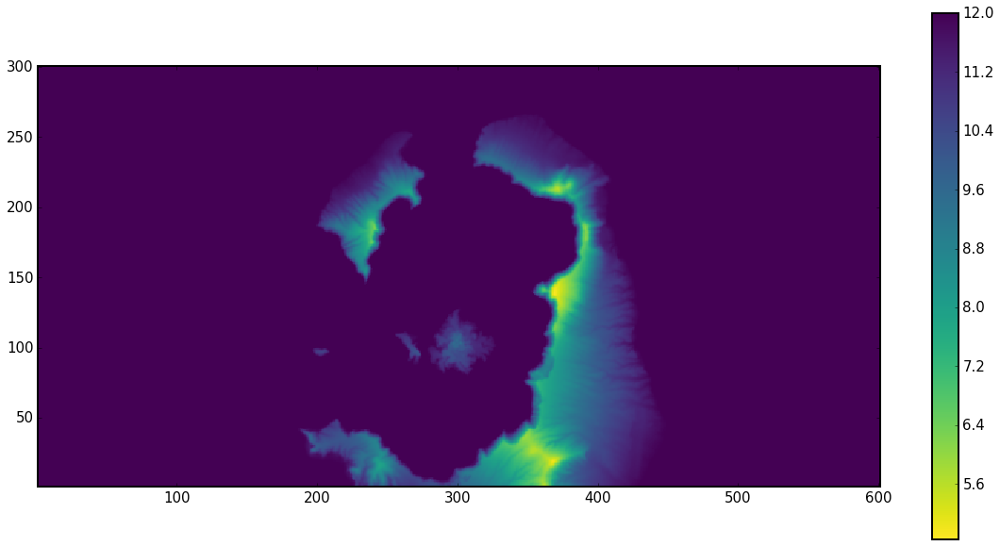

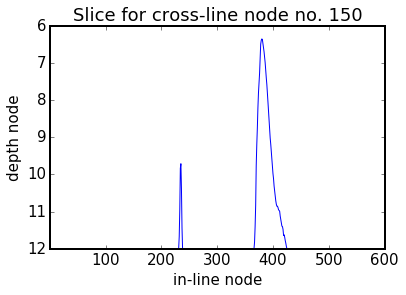

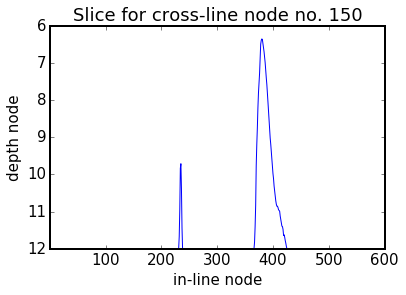

In [45]:
fname = Get_Files(proj_path, proj_name + '-FreeSurf.vtr')[0]
nx1_fs, nx2_fs, nx3_fs, fs_z = Read_vtr(fname)

plt.figure(figsize=[20, 10])
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='map', aspect='equal')
plt.xlim(1, nx1)
plt.ylim(1, nx2)

plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', yslice=ycoord, cbar=0)
plt.figure()
Plot_Gridded_Data(fs_z, data_type='FS', plot_type='slice', xslice=xcoord, cbar=0)

### Source wavelet

In [58]:
!cp proj24-RawSign.sgy {proj_name}-RawSign.sgy

### Observed data

In [59]:
!cp proj24-RawSeis.txt {proj_name}-RawSeis.txt

### SegyPrep

In [64]:
z_sea = 12.5
nx3 = 113
ttime_ms = 5e3 # 6s - 2400 time steps
segyprep = Make_SegyPrep(proj_name, proj_path=proj_path, io_api='both', geometry='segy', nx1=nx1, nx2=nx2, nx3=nx3, x1_box=x1_box, y1_box=y1_box, ttime_ms=ttime_ms, dt_ms=dt_ms)
Segyprep_Run(proj_name, z_sea, dx)

lib_generic.py/Save_Dict:  Saving:  /home/kmc3817/heavy_PhD/PROJECTS/fwi_3D_OBS_only/input/proj25-SegyPrep.key

segyprep.sh: START

Overwrite the TrueVp.vtr model? no

 SEGYPREP  -  Version 3.16.04                                                     
 ********

 Data preparation for 2D & 3D wavefield tomography

 Project name set to proj25
 Preparing files for synthetics...

 Grid points in-line:                    601
 Grid points cross-line:                 301
 Grid points vertically:                 113
 Horiz grid spacing (metres):      50.0000000    
 Vert grid spacing (metres):       50.0000000    
 Model length (metres):            30000.0000    
 Model width (metres):             15000.0000    
 Model depth (metres):             5600.00000    

 Modelling time step (ms):         2.50000000    
 Output data delta-T (ms):         2.50000000    
 Output data length (ms):          5000.00000    
 Output data length (samples):          2000
 Time steps to model:                   2

lib_fwi_generic.py/Segyprep_Run:  Contents of proj25-Sources.geo 

13 30000.0000 15000.0000 5600.0000 
4125 24146.0000 11925.0000 923.0
4138 29647.0000 9340.00000 968.0
4139 23863.0000 9208.00000 902.0
4140 15027.0000 9054.00000 1008.0
4141 8047.00000 8956.00000 697.0
4142 5098.00000 9436.00000 885.0
4158 26431.0000 6678.00000 917.0
4160 13699.0010 7667.00000 1008.0
4162 4395.00000 6575.00000 886.0
4163 1736.00000 6831.00000 978.0
4178 24821.0000 3959.99976 821.0
4179 13869.0000 2705.00000 914.0
4181 3748.00000 3896.00000 1005.0

lib_fwi_generic.py/Segyprep_Run:  Contents of proj25-Receivers.geo 

1423 30000.0000 15000.0000 5600.0000 
12612 14960.0010 14891.0000 637.0
12613 14962.0000 14725.9990 637.0
12614 14962.0000 14560.0010 637.0
12615 14964.0000 14395.0000 637.0
12616 14964.9990 14230.0000 637.0
12617 14964.9990 14064.9990 637.0
12618 14966.0000 13900.0000 637.0
12619 14967.9990 13733.0000 637.0
12620 14950.0000 13566.0000 637.0
12621 14911.0000 13399.0010 637.0
12622 14864.9990 

0

In [69]:
!mv {proj_name}'-OutSeis.sgy' {proj_name}'-Observed.sgy' 
!mv {proj_name}'-Template.idx' {proj_name}'-Observed.idx'

In [72]:
!cp {proj_name}'-TrueVp.sgy' {proj_name}'-StartVp.sgy'

### Runfile

In [65]:
Runfile_Prepare(proj_name, machine, z_sea, ibfs=1, b_abs=10, e_abs=20)

lib_fwi_generic.py/Read_Runfile:  Runfile to read:  ./proj25-Skeleton.key
lib_fwi_generic.py/Runfile_Prepare:  Contents of ./proj25-Runfile_synth.key:

! A. PROBLEM DEFINITION
 problem       : synthetic
 domain        : time
 dim           : 3D
 equation      : acoustic
 units         : metric
 anisotropy    : none
 kernel        : low
! B. MODEL DEFINITON
NX1 : 601
NX2 : 301
NX3 : 113
 DX            : 50.0
etime : 5.0
! X. FREE SURFACE
ibfs : 1
seaLevel : 12.5
 maxGhostIter  : 2
 vacuum        : 0
 accuracy      : 0.001
 minGhostFS    : 0.001
 minFictFS     : 0.5
 interpMode    : 1
! C. DATA DEFINITION
NCOMP : 13
NSHOTS : 13
NRECS : 1423
MAXRC : 1423
 MAXPS         : 1
io : SEGY
! D. BOUNDARY CONDITIONS
 btop          : 0
bbot : 10
bleft : 10
bright : 10
bfront : 10
bback : 10
 extratop      : 0
extrabot : 20
extraleft : 20
extraright : 20
extrafront : 20
extraback : 20
! F. INVERSION PARAMATERS (copied from Jo!!!)
 Slowness               : yes
 Normalise              : yes
 Amplitude

0

### PBS file

In [75]:
# PBS_Script_Create(proj_name, problem='inv', code='rev688_test', q='mrwarn', hours=1, nnodes=1, nprocesses=2) # WORKED, TERMINATED AFTER 3603 s WITHOUT THE MESSAGE OF TIME EXCEEDED BUT THIS MUST HAVE BEEN THE CASE'
PBS_Script_Create(proj_name, problem='inv', code='rev688_test', q='multi', hours=10, max_ram=2, nnodes=14, nprocesses=1)

lib_fwi_generic.py/PBS_Script_Create: proj_name: proj25

#!/bin/bash

##
# This script is supposed to be run in a 'PROJECTS/project/input' directory
#
# For more explanation, see lib_fwi_generic.py/PBS_Script_Create_Header.
#
##

#PBS -N proj25
#PBS -o proj25-Out.log
#PBS -e proj25-Err.log
#PBS -l walltime=10:00:00
#PBS -l select=14:mpiprocs=1:ompthreads=12:ncpus=12:mem=46gb
#PBS -l place=scatter:excl

# PROJECT INFO
project_name=proj25

# DISABLE PINNING OF THE PROCESSES
unset NCPUS
export I_MPI_PIN=no

# ARGUMENTS OF fullwave3D.exe
CPNUM=-1
NTHREAD=12 # EQUAL TO ompthreads

# FULLWAVE'S ENVIRONMENTAL VARIABLES
export SCHEDULER_SLAVESHAVEDATA="yes"
export SCHEDULER_SLAVESHAVEMODEL="yes"
export SLAVES_LOCALSTORETRIGGER=2 # MAX SIZE (Gb) OF ARRAY IN RAM BEFORE SWITCHING TO DISK STORAGE 
export SLAVES_LOCALSTORE=$TMPDIR # DIR FOR DISK STORAGE 
export SCHEDULER_DUMPRAWGRAD="yes"
export SLAVES_DUMPGRAD=${project_name}-GRAD # PREFIX FOR GRADIENT FILES 

# LOAD MODULES
module load mpi
module

lib_fwi_generic.py/PBS_Script_Create: Error. At least 2 processes (1 sched + 1 slave) needed per node
lib_fwi_generic.py/PBS_Script_Create: Warning. Setting ncpus and mem_gb


0

## Run

## Output

# Proj 26 (-||- but model not extended above the FS)

In [7]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj26'
# !cd "{proj_path}" && pwd

## Input

In [9]:
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 57 s


## Run

# Proj 27 (no smoothing)

- all smoothing switched off 

In [81]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj27'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 60 s


# Proj 28 (min offset 5 km)

In [84]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj28'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 76 s


# Proj 29 (max offset 10 km)

In [85]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj29'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 76 s


# Proj 30 (min offset 5 km, max offset 10 km)

In [86]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj30'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 78 s


# Proj 31 (freqs 3, 3.5, 4)

In [87]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj31'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 77 s


# Proj 32 (freqs 3, 4.5, 6)

In [88]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj32'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 79 s


# Proj 33 (freqs 2, 3.5, 5)

In [89]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj33'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 79 s


# Proj 34 (proj 30 + 33) 

In [90]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj34'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 80 s


# Proj 35 (proj 27 + 30 + 33)

In [91]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj35'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 88 s


# Proj 36 (velcut 2000 m/s)

In [92]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj36'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 200 s


# Proj 37 (double smoothing)

In [93]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj37'
!fwi_cp_project.sh -is -cp proj24 {proj_name} .


fwi_cp_project.sh: START

fwi_cp_project.sh: List of processed files (without the project name):
-Runfile.key
-Runfile_synth.key
-Runfile_inv.key
-Skeleton.key
-Run.pbs
-Signature.idx
-Signature.sgy
-Sources.geo
-Receivers.geo
-Template.idx
cp: cannot stat 'proj24-Template.idx': No such file or directory
-Template.sgy
-Synthetic.idx
cp: cannot stat 'proj24-Synthetic.idx': No such file or directory
-Synthetic.sgy
cp: cannot stat 'proj24-Synthetic.sgy': No such file or directory
-Observed.idx
-Observed.sgy
-TrueVp.sgy
cp: cannot stat 'proj24-TrueVp.sgy': No such file or directory
-TrueVs.sgy
cp: cannot stat 'proj24-TrueVs.sgy': No such file or directory
-StartVp.sgy
-StartVs.sgy
cp: cannot stat 'proj24-StartVs.sgy': No such file or directory
-FreeSurf.vtr
-GhostData.bin

fwi_cp_project.sh: END
Runtime of the fwi_cp_project.sh: 80 s


In [31]:
proj_path = projects_path + 'fwi_3D_OBS_only/input/'
proj_name = 'proj45'
# !cd "{proj_path}" && pwd

# Proj 38